In [1]:
import sys
import itertools
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import yfinance as yf
import plotly.graph_objects as go

from datetime import datetime
from tqdm import tqdm
from scipy.stats import mode
from scipy.spatial.distance import squareform

sns.set()
plt.rcParams["figure.figsize"] = (18,10)

plt.style.use('bmh')

try:
    from IPython.display import clear_output
    have_ipython = True
except ImportError:
    have_ipython = False


In [2]:
def ohlc_plot(df,start = '2018',end = '2021',Log = False):
    if Log:
        fig = go.Figure(data=[go.Candlestick(x=df.loc[start:end].index,
                        open=np.log(df.Open.loc[start:end]),
                        high=np.log(df.High.loc[start:end]),
                        low=np.log(df.Low.loc[start:end]),
                        close=np.log(df.Close.loc[start:end]))])
    else:
        fig = go.Figure(data=[go.Candlestick(x=df.loc[start:end].index,
                        open=(df.Open.loc[start:end]),
                        high=(df.High.loc[start:end]),
                        low=(df.Low.loc[start:end]),
                        close=(df.Close.loc[start:end]))])


    fig.update_layout(xaxis_rangeslider_visible=False)
    fig.show()
    return

In [3]:
ticker = yf.Ticker("BTC-USD")
df = ticker.history(period="max")[['Open','High','Low','Close','Volume']]
ohlc_plot(df,start = '2018-01',end = '2018-03',Log = False)

In [4]:
class KnnDtw(object):
    """K-nearest neighbor classifier using dynamic time warping
    as the distance measure between pairs of time series arrays
    
    Arguments
    ---------
    n_neighbors : int, optional (default = 5)
        Number of neighbors to use by default for KNN
        
    max_warping_window : int, optional (default = infinity)
        Maximum warping window allowed by the DTW dynamic
        programming function
            
    subsample_step : int, optional (default = 1)
        Step size for the timeseries array. By setting subsample_step = 2,
        the timeseries length will be reduced by 50% because every second
        item is skipped. Implemented by x[:, ::subsample_step]
    """
    
    def __init__(self, n_neighbors=5, max_warping_window=10000, subsample_step=1):
        self.n_neighbors = n_neighbors
        self.max_warping_window = max_warping_window
        self.subsample_step = subsample_step
    
    def fit(self, x, l):
        """Fit the model using x as training data and l as class labels
        
        Arguments
        ---------
        x : array of shape [n_samples, n_timepoints]
            Training data set for input into KNN classifer
            
        l : array of shape [n_samples]
            Training labels for input into KNN classifier
        """
        
        self.x = x
        self.l = l
        
    def _dtw_distance(self, ts_a, ts_b, d = lambda x,y: abs(x-y)):
        """Returns the DTW similarity distance between two 2-D
        timeseries numpy arrays.

        Arguments
        ---------
        ts_a, ts_b : array of shape [n_samples, n_timepoints]
            Two arrays containing n_samples of timeseries data
            whose DTW distance between each sample of A and B
            will be compared
        
        d : DistanceMetric object (default = abs(x-y))
            the distance measure used for A_i - B_j in the
            DTW dynamic programming function
        
        Returns
        -------
        DTW distance between A and B
        """

        # Create cost matrix via broadcasting with large int
        ts_a, ts_b = np.array(ts_a), np.array(ts_b)
        M, N = len(ts_a), len(ts_b)
        cost = sys.maxsize * np.ones((M, N))

        # Initialize the first row and column
        cost[0, 0] = d(ts_a[0], ts_b[0])
        for i in range(1, M):
            cost[i, 0] = cost[i-1, 0] + d(ts_a[i], ts_b[0])

        for j in range(1, N):
            cost[0, j] = cost[0, j-1] + d(ts_a[0], ts_b[j])

        # Populate rest of cost matrix within window
        for i in range(1, M):
            for j in range(max(1, i - self.max_warping_window),
                            min(N, i + self.max_warping_window)):
                choices = cost[i - 1, j - 1], cost[i, j-1], cost[i-1, j]
                cost[i, j] = min(choices) + d(ts_a[i], ts_b[j])

        # Return DTW distance given window 
        return cost[-1, -1]
    
    def _dist_matrix(self, x, y):
        """Computes the M x N distance matrix between the training
        dataset and testing dataset (y) using the DTW distance measure
        
        Arguments
        ---------
        x : array of shape [n_samples, n_timepoints]
        
        y : array of shape [n_samples, n_timepoints]
        
        Returns
        -------
        Distance matrix between each item of x and y with
            shape [training_n_samples, testing_n_samples]
        """
        
        # Compute the distance matrix        
        dm_count = 0
        
        # Compute condensed distance matrix (upper triangle) of pairwise dtw distances
        # when x and y are the same array
        if(np.array_equal(x, y)):
            x_s = np.shape(x)
            dm = np.zeros((x_s[0] * (x_s[0] - 1)) // 2, dtype=np.double)
            
            p = ProgressBar(shape(dm)[0])
            
            for i in range(0, x_s[0] - 1):
                for j in range(i + 1, x_s[0]):
                    dm[dm_count] = self._dtw_distance(x[i, ::self.subsample_step],
                                                      y[j, ::self.subsample_step])
                    
                    dm_count += 1
                    p.animate(dm_count)
            
            # Convert to squareform
            dm = squareform(dm)
            return dm
        
        # Compute full distance matrix of dtw distnces between x and y
        else:
            x_s = np.shape(x)
            y_s = np.shape(y)
            dm = np.zeros((x_s[0], y_s[0])) 
            dm_size = x_s[0]*y_s[0]
            
            p = ProgressBar(dm_size)
        
            for i in range(0, x_s[0]):
                for j in range(0, y_s[0]):
                    dm[i, j] = self._dtw_distance(x[i, ::self.subsample_step],
                                                  y[j, ::self.subsample_step])
                    # Update progress bar
                    dm_count += 1
                    p.animate(dm_count)
        
            return dm
        
    def predict(self, x):
        """Predict the class labels or probability estimates for 
        the provided data

        Arguments
        ---------
          x : array of shape [n_samples, n_timepoints]
              Array containing the testing data set to be classified
          
        Returns
        -------
          2 arrays representing:
              (1) the predicted class labels 
              (2) the knn label count probability
        """
        
        dm = self._dist_matrix(x, self.x)

        # Identify the k nearest neighbors
        knn_idx = dm.argsort()[:, :self.n_neighbors]

        # Identify k nearest labels
        knn_labels = self.l[knn_idx]
        
        # Model Label
        mode_data = mode(knn_labels, axis=1)
        mode_label = mode_data[0]
        mode_proba = mode_data[1]/self.n_neighbors

        return mode_label.ravel(), mode_proba.ravel()

class ProgressBar:
    """This progress bar was taken from PYMC
    """
    def __init__(self, iterations):
        self.iterations = iterations
        self.prog_bar = '[]'
        self.fill_char = '*'
        self.width = 40
        self.__update_amount(0)
        if have_ipython:
            self.animate = self.animate_ipython
        else:
            self.animate = self.animate_noipython

    def animate_ipython(self, iter):
        print( '\r', self,
        sys.stdout.flush() )
        self.update_iteration(iter + 1)

    def update_iteration(self, elapsed_iter):
        self.__update_amount((elapsed_iter / float(self.iterations)) * 100.0)
        self.prog_bar += '  %d of %s complete' % (elapsed_iter, self.iterations)

    def __update_amount(self, new_amount):
        percent_done = int(round((new_amount / 100.0) * 100.0))
        all_full = self.width - 2
        num_hashes = int(round((percent_done / 100.0) * all_full))
        self.prog_bar = '[' + self.fill_char * num_hashes + ' ' * (all_full - num_hashes) + ']'
        pct_place = (len(self.prog_bar) // 2) - len(str(percent_done))
        pct_string = '%d%%' % percent_done
        self.prog_bar = self.prog_bar[0:pct_place] + \
            (pct_string + self.prog_bar[pct_place + len(pct_string):])

    def __str__(self):
        return str(self.prog_bar)


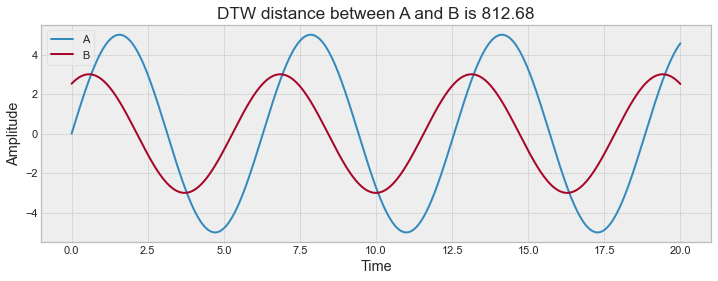

In [5]:
time = np.linspace(0,20,1000)
amplitude_a = 5*np.sin(time)
amplitude_b = 3*np.sin(time + 1)

m = KnnDtw()
distance = m._dtw_distance(amplitude_a, amplitude_b)

fig = plt.figure(figsize=(12,4))
_ = plt.plot(time, amplitude_a, label='A')
_ = plt.plot(time, amplitude_b, label='B')
_ = plt.title('DTW distance between A and B is %.2f' % distance)
_ = plt.ylabel('Amplitude')
_ = plt.xlabel('Time')
_ = plt.legend()


In [6]:
m._dist_matrix(np.random.random((4,50)), np.random.random((4,50)))


 [                  0%                  ] None
 [*****            12%                  ]  2 of 16 complete None
 [*******          19%                  ]  3 of 16 complete None
 [**********       25%                  ]  4 of 16 complete None
 [************     31%                  ]  5 of 16 complete None
 [**************   38%                  ]  6 of 16 complete None
 [*****************44%                  ]  7 of 16 complete None
 [*****************50%                  ]  8 of 16 complete None
 [*****************56%*                 ]  9 of 16 complete None
 [*****************62%****              ]  10 of 16 complete None
 [*****************69%******            ]  11 of 16 complete None
 [*****************75%********          ]  12 of 16 complete None
 [*****************81%***********       ]  13 of 16 complete None
 [*****************88%*************     ]  14 of 16 complete None
 [*****************94%****************  ]  15 of 16 complete None
 [****************100%***************

array([[8.85816285, 8.5384935 , 8.24009541, 8.41710521],
       [9.09850313, 9.20335554, 9.61803435, 8.82683235],
       [7.50059597, 8.34459565, 8.60627583, 8.03585058],
       [7.36989047, 9.46463347, 9.86776557, 9.3164221 ]])

In [12]:
x_train_file = open('data/UCI-HAR-Dataset/train/X_train.txt', 'r')
y_train_file = open('data/UCI-HAR-Dataset/train/y_train.txt', 'r')

x_test_file = open('data/UCI-HAR-Dataset/test/X_test.txt', 'r')
y_test_file = open('data/UCI-HAR-Dataset/test/y_test.txt', 'r')

# Create empty lists
x_train = []
y_train = []
x_test = []
y_test = []

# Mapping table for classes
labels = {1:'WALKING', 2:'WALKING UPSTAIRS', 3:'WALKING DOWNSTAIRS',
          4:'SITTING', 5:'STANDING', 6:'LAYING'}

for x in x_train_file:
    x_train.append([float(ts) for ts in x.split()])
    
for y in y_train_file:
    y_train.append(int(y.rstrip('\n')))
    
for x in x_test_file:
    x_test.append([float(ts) for ts in x.split()])
    
for y in y_test_file:
    y_test.append(int(y.rstrip('\n')))
    
# Convert to numpy for efficiency
x_train = np.array(x_train)
y_train = np.array(y_train)
x_test = np.array(x_test)
y_test = np.array(y_test)


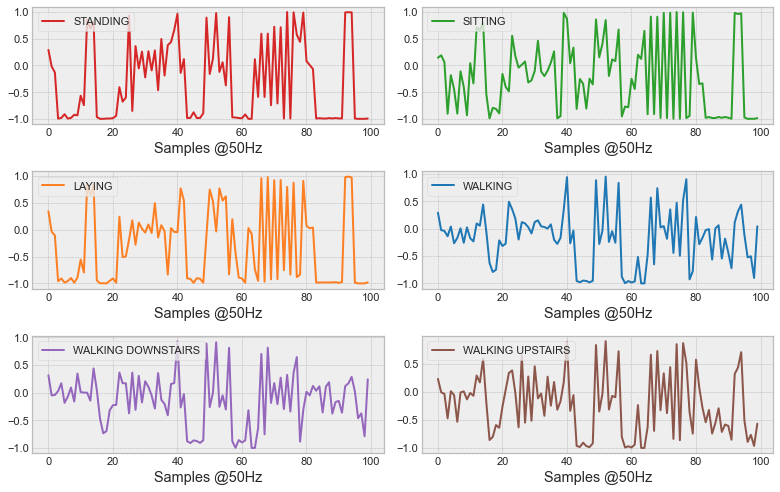

In [15]:
plt.figure(figsize=(11,7))
colors = ['#D62728','#2C9F2C','#FD7F23','#1F77B4','#9467BD',
          '#8C564A','#7F7F7F','#1FBECF','#E377C2','#BCBD27']

for i, r in enumerate([0,27,65,100,145,172]):
    plt.subplot(3,2,i+1)
    plt.plot(x_train[r][:100], label=labels[y_train[r]], color=colors[i], linewidth=2)
    plt.xlabel('Samples @50Hz')
    plt.legend(loc='upper left')
    plt.tight_layout()


In [16]:
m = KnnDtw(n_neighbors=1, max_warping_window=10)
m.fit(x_train[::10], y_train[::10])
label, proba = m.predict(x_test[::10])


 [                  0%                  ] None
 [                  0%                  ]  2 of 217120 complete None
 [                  0%                  ]  3 of 217120 complete None
 [                  0%                  ]  4 of 217120 complete None
 [                  0%                  ]  5 of 217120 complete None
 [                  0%                  ]  6 of 217120 complete None
 [                  0%                  ]  7 of 217120 complete None
 [                  0%                  ]  8 of 217120 complete None
 [                  0%                  ]  9 of 217120 complete None
 [                  0%                  ]  10 of 217120 complete None
 [                  0%                  ]  11 of 217120 complete None
 [                  0%                  ]  12 of 217120 complete None
 [                  0%                  ]  13 of 217120 complete None
 [                  0%                  ]  14 of 217120 complete None
 [                  0%                  ]  15 of 21

 [                  0%                  ]  119 of 217120 complete None
 [                  0%                  ]  120 of 217120 complete None
 [                  0%                  ]  121 of 217120 complete None
 [                  0%                  ]  122 of 217120 complete None
 [                  0%                  ]  123 of 217120 complete None
 [                  0%                  ]  124 of 217120 complete None
 [                  0%                  ]  125 of 217120 complete None
 [                  0%                  ]  126 of 217120 complete None
 [                  0%                  ]  127 of 217120 complete None
 [                  0%                  ]  128 of 217120 complete None
 [                  0%                  ]  129 of 217120 complete None
 [                  0%                  ]  130 of 217120 complete None
 [                  0%                  ]  131 of 217120 complete None
 [                  0%                  ]  132 of 217120 complete None
 [    

 [                  0%                  ]  235 of 217120 complete None
 [                  0%                  ]  236 of 217120 complete None
 [                  0%                  ]  237 of 217120 complete None
 [                  0%                  ]  238 of 217120 complete None
 [                  0%                  ]  239 of 217120 complete None
 [                  0%                  ]  240 of 217120 complete None
 [                  0%                  ]  241 of 217120 complete None
 [                  0%                  ]  242 of 217120 complete None
 [                  0%                  ]  243 of 217120 complete None
 [                  0%                  ]  244 of 217120 complete None
 [                  0%                  ]  245 of 217120 complete None
 [                  0%                  ]  246 of 217120 complete None
 [                  0%                  ]  247 of 217120 complete None
 [                  0%                  ]  248 of 217120 complete None
 [    

 [                  0%                  ]  351 of 217120 complete None
 [                  0%                  ]  352 of 217120 complete None
 [                  0%                  ]  353 of 217120 complete None
 [                  0%                  ]  354 of 217120 complete None
 [                  0%                  ]  355 of 217120 complete None
 [                  0%                  ]  356 of 217120 complete None
 [                  0%                  ]  357 of 217120 complete None
 [                  0%                  ]  358 of 217120 complete None
 [                  0%                  ]  359 of 217120 complete None
 [                  0%                  ]  360 of 217120 complete None
 [                  0%                  ]  361 of 217120 complete None
 [                  0%                  ]  362 of 217120 complete None
 [                  0%                  ]  363 of 217120 complete None
 [                  0%                  ]  364 of 217120 complete None
 [    

 [                  0%                  ]  467 of 217120 complete None
 [                  0%                  ]  468 of 217120 complete None
 [                  0%                  ]  469 of 217120 complete None
 [                  0%                  ]  470 of 217120 complete None
 [                  0%                  ]  471 of 217120 complete None
 [                  0%                  ]  472 of 217120 complete None
 [                  0%                  ]  473 of 217120 complete None
 [                  0%                  ]  474 of 217120 complete None
 [                  0%                  ]  475 of 217120 complete None
 [                  0%                  ]  476 of 217120 complete None
 [                  0%                  ]  477 of 217120 complete None
 [                  0%                  ]  478 of 217120 complete None
 [                  0%                  ]  479 of 217120 complete None
 [                  0%                  ]  480 of 217120 complete None
 [    

 [                  0%                  ]  583 of 217120 complete None
 [                  0%                  ]  584 of 217120 complete None
 [                  0%                  ]  585 of 217120 complete None
 [                  0%                  ]  586 of 217120 complete None
 [                  0%                  ]  587 of 217120 complete None
 [                  0%                  ]  588 of 217120 complete None
 [                  0%                  ]  589 of 217120 complete None
 [                  0%                  ]  590 of 217120 complete None
 [                  0%                  ]  591 of 217120 complete None
 [                  0%                  ]  592 of 217120 complete None
 [                  0%                  ]  593 of 217120 complete None
 [                  0%                  ]  594 of 217120 complete None
 [                  0%                  ]  595 of 217120 complete None
 [                  0%                  ]  596 of 217120 complete None
 [    

 [                  0%                  ]  699 of 217120 complete None
 [                  0%                  ]  700 of 217120 complete None
 [                  0%                  ]  701 of 217120 complete None
 [                  0%                  ]  702 of 217120 complete None
 [                  0%                  ]  703 of 217120 complete None
 [                  0%                  ]  704 of 217120 complete None
 [                  0%                  ]  705 of 217120 complete None
 [                  0%                  ]  706 of 217120 complete None
 [                  0%                  ]  707 of 217120 complete None
 [                  0%                  ]  708 of 217120 complete None
 [                  0%                  ]  709 of 217120 complete None
 [                  0%                  ]  710 of 217120 complete None
 [                  0%                  ]  711 of 217120 complete None
 [                  0%                  ]  712 of 217120 complete None
 [    

 [                  0%                  ]  815 of 217120 complete None
 [                  0%                  ]  816 of 217120 complete None
 [                  0%                  ]  817 of 217120 complete None
 [                  0%                  ]  818 of 217120 complete None
 [                  0%                  ]  819 of 217120 complete None
 [                  0%                  ]  820 of 217120 complete None
 [                  0%                  ]  821 of 217120 complete None
 [                  0%                  ]  822 of 217120 complete None
 [                  0%                  ]  823 of 217120 complete None
 [                  0%                  ]  824 of 217120 complete None
 [                  0%                  ]  825 of 217120 complete None
 [                  0%                  ]  826 of 217120 complete None
 [                  0%                  ]  827 of 217120 complete None
 [                  0%                  ]  828 of 217120 complete None
 [    

 [                  0%                  ]  931 of 217120 complete None
 [                  0%                  ]  932 of 217120 complete None
 [                  0%                  ]  933 of 217120 complete None
 [                  0%                  ]  934 of 217120 complete None
 [                  0%                  ]  935 of 217120 complete None
 [                  0%                  ]  936 of 217120 complete None
 [                  0%                  ]  937 of 217120 complete None
 [                  0%                  ]  938 of 217120 complete None
 [                  0%                  ]  939 of 217120 complete None
 [                  0%                  ]  940 of 217120 complete None
 [                  0%                  ]  941 of 217120 complete None
 [                  0%                  ]  942 of 217120 complete None
 [                  0%                  ]  943 of 217120 complete None
 [                  0%                  ]  944 of 217120 complete None
 [    

 [                  0%                  ]  1046 of 217120 complete None
 [                  0%                  ]  1047 of 217120 complete None
 [                  0%                  ]  1048 of 217120 complete None
 [                  0%                  ]  1049 of 217120 complete None
 [                  0%                  ]  1050 of 217120 complete None
 [                  0%                  ]  1051 of 217120 complete None
 [                  0%                  ]  1052 of 217120 complete None
 [                  0%                  ]  1053 of 217120 complete None
 [                  0%                  ]  1054 of 217120 complete None
 [                  0%                  ]  1055 of 217120 complete None
 [                  0%                  ]  1056 of 217120 complete None
 [                  0%                  ]  1057 of 217120 complete None
 [                  0%                  ]  1058 of 217120 complete None
 [                  0%                  ]  1059 of 217120 comple

 [                  1%                  ]  1160 of 217120 complete None
 [                  1%                  ]  1161 of 217120 complete None
 [                  1%                  ]  1162 of 217120 complete None
 [                  1%                  ]  1163 of 217120 complete None
 [                  1%                  ]  1164 of 217120 complete None
 [                  1%                  ]  1165 of 217120 complete None
 [                  1%                  ]  1166 of 217120 complete None
 [                  1%                  ]  1167 of 217120 complete None
 [                  1%                  ]  1168 of 217120 complete None
 [                  1%                  ]  1169 of 217120 complete None
 [                  1%                  ]  1170 of 217120 complete None
 [                  1%                  ]  1171 of 217120 complete None
 [                  1%                  ]  1172 of 217120 complete None
 [                  1%                  ]  1173 of 217120 comple

 [                  1%                  ]  1274 of 217120 complete None
 [                  1%                  ]  1275 of 217120 complete None
 [                  1%                  ]  1276 of 217120 complete None
 [                  1%                  ]  1277 of 217120 complete None
 [                  1%                  ]  1278 of 217120 complete None
 [                  1%                  ]  1279 of 217120 complete None
 [                  1%                  ]  1280 of 217120 complete None
 [                  1%                  ]  1281 of 217120 complete None
 [                  1%                  ]  1282 of 217120 complete None
 [                  1%                  ]  1283 of 217120 complete None
 [                  1%                  ]  1284 of 217120 complete None
 [                  1%                  ]  1285 of 217120 complete None
 [                  1%                  ]  1286 of 217120 complete None
 [                  1%                  ]  1287 of 217120 comple

 [                  1%                  ]  1388 of 217120 complete None
 [                  1%                  ]  1389 of 217120 complete None
 [                  1%                  ]  1390 of 217120 complete None
 [                  1%                  ]  1391 of 217120 complete None
 [                  1%                  ]  1392 of 217120 complete None
 [                  1%                  ]  1393 of 217120 complete None
 [                  1%                  ]  1394 of 217120 complete None
 [                  1%                  ]  1395 of 217120 complete None
 [                  1%                  ]  1396 of 217120 complete None
 [                  1%                  ]  1397 of 217120 complete None
 [                  1%                  ]  1398 of 217120 complete None
 [                  1%                  ]  1399 of 217120 complete None
 [                  1%                  ]  1400 of 217120 complete None
 [                  1%                  ]  1401 of 217120 comple

 [                  1%                  ]  1502 of 217120 complete None
 [                  1%                  ]  1503 of 217120 complete None
 [                  1%                  ]  1504 of 217120 complete None
 [                  1%                  ]  1505 of 217120 complete None
 [                  1%                  ]  1506 of 217120 complete None
 [                  1%                  ]  1507 of 217120 complete None
 [                  1%                  ]  1508 of 217120 complete None
 [                  1%                  ]  1509 of 217120 complete None
 [                  1%                  ]  1510 of 217120 complete None
 [                  1%                  ]  1511 of 217120 complete None
 [                  1%                  ]  1512 of 217120 complete None
 [                  1%                  ]  1513 of 217120 complete None
 [                  1%                  ]  1514 of 217120 complete None
 [                  1%                  ]  1515 of 217120 comple

 [                  1%                  ]  1616 of 217120 complete None
 [                  1%                  ]  1617 of 217120 complete None
 [                  1%                  ]  1618 of 217120 complete None
 [                  1%                  ]  1619 of 217120 complete None
 [                  1%                  ]  1620 of 217120 complete None
 [                  1%                  ]  1621 of 217120 complete None
 [                  1%                  ]  1622 of 217120 complete None
 [                  1%                  ]  1623 of 217120 complete None
 [                  1%                  ]  1624 of 217120 complete None
 [                  1%                  ]  1625 of 217120 complete None
 [                  1%                  ]  1626 of 217120 complete None
 [                  1%                  ]  1627 of 217120 complete None
 [                  1%                  ]  1628 of 217120 complete None
 [                  1%                  ]  1629 of 217120 comple

 [                  1%                  ]  1730 of 217120 complete None
 [                  1%                  ]  1731 of 217120 complete None
 [                  1%                  ]  1732 of 217120 complete None
 [                  1%                  ]  1733 of 217120 complete None
 [                  1%                  ]  1734 of 217120 complete None
 [                  1%                  ]  1735 of 217120 complete None
 [                  1%                  ]  1736 of 217120 complete None
 [                  1%                  ]  1737 of 217120 complete None
 [                  1%                  ]  1738 of 217120 complete None
 [                  1%                  ]  1739 of 217120 complete None
 [                  1%                  ]  1740 of 217120 complete None
 [                  1%                  ]  1741 of 217120 complete None
 [                  1%                  ]  1742 of 217120 complete None
 [                  1%                  ]  1743 of 217120 comple

 [                  1%                  ]  1844 of 217120 complete None
 [                  1%                  ]  1845 of 217120 complete None
 [                  1%                  ]  1846 of 217120 complete None
 [                  1%                  ]  1847 of 217120 complete None
 [                  1%                  ]  1848 of 217120 complete None
 [                  1%                  ]  1849 of 217120 complete None
 [                  1%                  ]  1850 of 217120 complete None
 [                  1%                  ]  1851 of 217120 complete None
 [                  1%                  ]  1852 of 217120 complete None
 [                  1%                  ]  1853 of 217120 complete None
 [                  1%                  ]  1854 of 217120 complete None
 [                  1%                  ]  1855 of 217120 complete None
 [                  1%                  ]  1856 of 217120 complete None
 [                  1%                  ]  1857 of 217120 comple

 [                  1%                  ]  1958 of 217120 complete None
 [                  1%                  ]  1959 of 217120 complete None
 [                  1%                  ]  1960 of 217120 complete None
 [                  1%                  ]  1961 of 217120 complete None
 [                  1%                  ]  1962 of 217120 complete None
 [                  1%                  ]  1963 of 217120 complete None
 [                  1%                  ]  1964 of 217120 complete None
 [                  1%                  ]  1965 of 217120 complete None
 [                  1%                  ]  1966 of 217120 complete None
 [                  1%                  ]  1967 of 217120 complete None
 [                  1%                  ]  1968 of 217120 complete None
 [                  1%                  ]  1969 of 217120 complete None
 [                  1%                  ]  1970 of 217120 complete None
 [                  1%                  ]  1971 of 217120 comple

 [                  1%                  ]  2072 of 217120 complete None
 [                  1%                  ]  2073 of 217120 complete None
 [                  1%                  ]  2074 of 217120 complete None
 [                  1%                  ]  2075 of 217120 complete None
 [                  1%                  ]  2076 of 217120 complete None
 [                  1%                  ]  2077 of 217120 complete None
 [                  1%                  ]  2078 of 217120 complete None
 [                  1%                  ]  2079 of 217120 complete None
 [                  1%                  ]  2080 of 217120 complete None
 [                  1%                  ]  2081 of 217120 complete None
 [                  1%                  ]  2082 of 217120 complete None
 [                  1%                  ]  2083 of 217120 complete None
 [                  1%                  ]  2084 of 217120 complete None
 [                  1%                  ]  2085 of 217120 comple

 [                  1%                  ]  2186 of 217120 complete None
 [                  1%                  ]  2187 of 217120 complete None
 [                  1%                  ]  2188 of 217120 complete None
 [                  1%                  ]  2189 of 217120 complete None
 [                  1%                  ]  2190 of 217120 complete None
 [                  1%                  ]  2191 of 217120 complete None
 [                  1%                  ]  2192 of 217120 complete None
 [                  1%                  ]  2193 of 217120 complete None
 [                  1%                  ]  2194 of 217120 complete None
 [                  1%                  ]  2195 of 217120 complete None
 [                  1%                  ]  2196 of 217120 complete None
 [                  1%                  ]  2197 of 217120 complete None
 [                  1%                  ]  2198 of 217120 complete None
 [                  1%                  ]  2199 of 217120 comple

 [                  1%                  ]  2300 of 217120 complete None
 [                  1%                  ]  2301 of 217120 complete None
 [                  1%                  ]  2302 of 217120 complete None
 [                  1%                  ]  2303 of 217120 complete None
 [                  1%                  ]  2304 of 217120 complete None
 [                  1%                  ]  2305 of 217120 complete None
 [                  1%                  ]  2306 of 217120 complete None
 [                  1%                  ]  2307 of 217120 complete None
 [                  1%                  ]  2308 of 217120 complete None
 [                  1%                  ]  2309 of 217120 complete None
 [                  1%                  ]  2310 of 217120 complete None
 [                  1%                  ]  2311 of 217120 complete None
 [                  1%                  ]  2312 of 217120 complete None
 [                  1%                  ]  2313 of 217120 comple

 [                  1%                  ]  2414 of 217120 complete None
 [                  1%                  ]  2415 of 217120 complete None
 [                  1%                  ]  2416 of 217120 complete None
 [                  1%                  ]  2417 of 217120 complete None
 [                  1%                  ]  2418 of 217120 complete None
 [                  1%                  ]  2419 of 217120 complete None
 [                  1%                  ]  2420 of 217120 complete None
 [                  1%                  ]  2421 of 217120 complete None
 [                  1%                  ]  2422 of 217120 complete None
 [                  1%                  ]  2423 of 217120 complete None
 [                  1%                  ]  2424 of 217120 complete None
 [                  1%                  ]  2425 of 217120 complete None
 [                  1%                  ]  2426 of 217120 complete None
 [                  1%                  ]  2427 of 217120 comple

 [                  1%                  ]  2528 of 217120 complete None
 [                  1%                  ]  2529 of 217120 complete None
 [                  1%                  ]  2530 of 217120 complete None
 [                  1%                  ]  2531 of 217120 complete None
 [                  1%                  ]  2532 of 217120 complete None
 [                  1%                  ]  2533 of 217120 complete None
 [                  1%                  ]  2534 of 217120 complete None
 [                  1%                  ]  2535 of 217120 complete None
 [                  1%                  ]  2536 of 217120 complete None
 [                  1%                  ]  2537 of 217120 complete None
 [                  1%                  ]  2538 of 217120 complete None
 [                  1%                  ]  2539 of 217120 complete None
 [                  1%                  ]  2540 of 217120 complete None
 [                  1%                  ]  2541 of 217120 comple

 [                  1%                  ]  2642 of 217120 complete None
 [                  1%                  ]  2643 of 217120 complete None
 [                  1%                  ]  2644 of 217120 complete None
 [                  1%                  ]  2645 of 217120 complete None
 [                  1%                  ]  2646 of 217120 complete None
 [                  1%                  ]  2647 of 217120 complete None
 [                  1%                  ]  2648 of 217120 complete None
 [                  1%                  ]  2649 of 217120 complete None
 [                  1%                  ]  2650 of 217120 complete None
 [                  1%                  ]  2651 of 217120 complete None
 [                  1%                  ]  2652 of 217120 complete None
 [                  1%                  ]  2653 of 217120 complete None
 [                  1%                  ]  2654 of 217120 complete None
 [                  1%                  ]  2655 of 217120 comple

 [                  1%                  ]  2756 of 217120 complete None
 [                  1%                  ]  2757 of 217120 complete None
 [                  1%                  ]  2758 of 217120 complete None
 [                  1%                  ]  2759 of 217120 complete None
 [                  1%                  ]  2760 of 217120 complete None
 [                  1%                  ]  2761 of 217120 complete None
 [                  1%                  ]  2762 of 217120 complete None
 [                  1%                  ]  2763 of 217120 complete None
 [                  1%                  ]  2764 of 217120 complete None
 [                  1%                  ]  2765 of 217120 complete None
 [                  1%                  ]  2766 of 217120 complete None
 [                  1%                  ]  2767 of 217120 complete None
 [                  1%                  ]  2768 of 217120 complete None
 [                  1%                  ]  2769 of 217120 comple

 [                  1%                  ]  2870 of 217120 complete None
 [                  1%                  ]  2871 of 217120 complete None
 [                  1%                  ]  2872 of 217120 complete None
 [                  1%                  ]  2873 of 217120 complete None
 [                  1%                  ]  2874 of 217120 complete None
 [                  1%                  ]  2875 of 217120 complete None
 [                  1%                  ]  2876 of 217120 complete None
 [                  1%                  ]  2877 of 217120 complete None
 [                  1%                  ]  2878 of 217120 complete None
 [                  1%                  ]  2879 of 217120 complete None
 [                  1%                  ]  2880 of 217120 complete None
 [                  1%                  ]  2881 of 217120 complete None
 [                  1%                  ]  2882 of 217120 complete None
 [                  1%                  ]  2883 of 217120 comple

 [                  1%                  ]  2984 of 217120 complete None
 [                  1%                  ]  2985 of 217120 complete None
 [                  1%                  ]  2986 of 217120 complete None
 [                  1%                  ]  2987 of 217120 complete None
 [                  1%                  ]  2988 of 217120 complete None
 [                  1%                  ]  2989 of 217120 complete None
 [                  1%                  ]  2990 of 217120 complete None
 [                  1%                  ]  2991 of 217120 complete None
 [                  1%                  ]  2992 of 217120 complete None
 [                  1%                  ]  2993 of 217120 complete None
 [                  1%                  ]  2994 of 217120 complete None
 [                  1%                  ]  2995 of 217120 complete None
 [                  1%                  ]  2996 of 217120 complete None
 [                  1%                  ]  2997 of 217120 comple

 [                  1%                  ]  3098 of 217120 complete None
 [                  1%                  ]  3099 of 217120 complete None
 [                  1%                  ]  3100 of 217120 complete None
 [                  1%                  ]  3101 of 217120 complete None
 [                  1%                  ]  3102 of 217120 complete None
 [                  1%                  ]  3103 of 217120 complete None
 [                  1%                  ]  3104 of 217120 complete None
 [                  1%                  ]  3105 of 217120 complete None
 [                  1%                  ]  3106 of 217120 complete None
 [                  1%                  ]  3107 of 217120 complete None
 [                  1%                  ]  3108 of 217120 complete None
 [                  1%                  ]  3109 of 217120 complete None
 [                  1%                  ]  3110 of 217120 complete None
 [                  1%                  ]  3111 of 217120 comple

 [                  1%                  ]  3212 of 217120 complete None
 [                  1%                  ]  3213 of 217120 complete None
 [                  1%                  ]  3214 of 217120 complete None
 [                  1%                  ]  3215 of 217120 complete None
 [                  1%                  ]  3216 of 217120 complete None
 [                  1%                  ]  3217 of 217120 complete None
 [                  1%                  ]  3218 of 217120 complete None
 [                  1%                  ]  3219 of 217120 complete None
 [                  1%                  ]  3220 of 217120 complete None
 [                  1%                  ]  3221 of 217120 complete None
 [                  1%                  ]  3222 of 217120 complete None
 [                  1%                  ]  3223 of 217120 complete None
 [                  1%                  ]  3224 of 217120 complete None
 [                  1%                  ]  3225 of 217120 comple

 [*                 2%                  ]  3326 of 217120 complete None
 [*                 2%                  ]  3327 of 217120 complete None
 [*                 2%                  ]  3328 of 217120 complete None
 [*                 2%                  ]  3329 of 217120 complete None
 [*                 2%                  ]  3330 of 217120 complete None
 [*                 2%                  ]  3331 of 217120 complete None
 [*                 2%                  ]  3332 of 217120 complete None
 [*                 2%                  ]  3333 of 217120 complete None
 [*                 2%                  ]  3334 of 217120 complete None
 [*                 2%                  ]  3335 of 217120 complete None
 [*                 2%                  ]  3336 of 217120 complete None
 [*                 2%                  ]  3337 of 217120 complete None
 [*                 2%                  ]  3338 of 217120 complete None
 [*                 2%                  ]  3339 of 217120 comple

 [*                 2%                  ]  3440 of 217120 complete None
 [*                 2%                  ]  3441 of 217120 complete None
 [*                 2%                  ]  3442 of 217120 complete None
 [*                 2%                  ]  3443 of 217120 complete None
 [*                 2%                  ]  3444 of 217120 complete None
 [*                 2%                  ]  3445 of 217120 complete None
 [*                 2%                  ]  3446 of 217120 complete None
 [*                 2%                  ]  3447 of 217120 complete None
 [*                 2%                  ]  3448 of 217120 complete None
 [*                 2%                  ]  3449 of 217120 complete None
 [*                 2%                  ]  3450 of 217120 complete None
 [*                 2%                  ]  3451 of 217120 complete None
 [*                 2%                  ]  3452 of 217120 complete None
 [*                 2%                  ]  3453 of 217120 comple

 [*                 2%                  ]  3554 of 217120 complete None
 [*                 2%                  ]  3555 of 217120 complete None
 [*                 2%                  ]  3556 of 217120 complete None
 [*                 2%                  ]  3557 of 217120 complete None
 [*                 2%                  ]  3558 of 217120 complete None
 [*                 2%                  ]  3559 of 217120 complete None
 [*                 2%                  ]  3560 of 217120 complete None
 [*                 2%                  ]  3561 of 217120 complete None
 [*                 2%                  ]  3562 of 217120 complete None
 [*                 2%                  ]  3563 of 217120 complete None
 [*                 2%                  ]  3564 of 217120 complete None
 [*                 2%                  ]  3565 of 217120 complete None
 [*                 2%                  ]  3566 of 217120 complete None
 [*                 2%                  ]  3567 of 217120 comple

 [*                 2%                  ]  3668 of 217120 complete None
 [*                 2%                  ]  3669 of 217120 complete None
 [*                 2%                  ]  3670 of 217120 complete None
 [*                 2%                  ]  3671 of 217120 complete None
 [*                 2%                  ]  3672 of 217120 complete None
 [*                 2%                  ]  3673 of 217120 complete None
 [*                 2%                  ]  3674 of 217120 complete None
 [*                 2%                  ]  3675 of 217120 complete None
 [*                 2%                  ]  3676 of 217120 complete None
 [*                 2%                  ]  3677 of 217120 complete None
 [*                 2%                  ]  3678 of 217120 complete None
 [*                 2%                  ]  3679 of 217120 complete None
 [*                 2%                  ]  3680 of 217120 complete None
 [*                 2%                  ]  3681 of 217120 comple

 [*                 2%                  ]  3782 of 217120 complete None
 [*                 2%                  ]  3783 of 217120 complete None
 [*                 2%                  ]  3784 of 217120 complete None
 [*                 2%                  ]  3785 of 217120 complete None
 [*                 2%                  ]  3786 of 217120 complete None
 [*                 2%                  ]  3787 of 217120 complete None
 [*                 2%                  ]  3788 of 217120 complete None
 [*                 2%                  ]  3789 of 217120 complete None
 [*                 2%                  ]  3790 of 217120 complete None
 [*                 2%                  ]  3791 of 217120 complete None
 [*                 2%                  ]  3792 of 217120 complete None
 [*                 2%                  ]  3793 of 217120 complete None
 [*                 2%                  ]  3794 of 217120 complete None
 [*                 2%                  ]  3795 of 217120 comple

 [*                 2%                  ]  3896 of 217120 complete None
 [*                 2%                  ]  3897 of 217120 complete None
 [*                 2%                  ]  3898 of 217120 complete None
 [*                 2%                  ]  3899 of 217120 complete None
 [*                 2%                  ]  3900 of 217120 complete None
 [*                 2%                  ]  3901 of 217120 complete None
 [*                 2%                  ]  3902 of 217120 complete None
 [*                 2%                  ]  3903 of 217120 complete None
 [*                 2%                  ]  3904 of 217120 complete None
 [*                 2%                  ]  3905 of 217120 complete None
 [*                 2%                  ]  3906 of 217120 complete None
 [*                 2%                  ]  3907 of 217120 complete None
 [*                 2%                  ]  3908 of 217120 complete None
 [*                 2%                  ]  3909 of 217120 comple

 [*                 2%                  ]  4010 of 217120 complete None
 [*                 2%                  ]  4011 of 217120 complete None
 [*                 2%                  ]  4012 of 217120 complete None
 [*                 2%                  ]  4013 of 217120 complete None
 [*                 2%                  ]  4014 of 217120 complete None
 [*                 2%                  ]  4015 of 217120 complete None
 [*                 2%                  ]  4016 of 217120 complete None
 [*                 2%                  ]  4017 of 217120 complete None
 [*                 2%                  ]  4018 of 217120 complete None
 [*                 2%                  ]  4019 of 217120 complete None
 [*                 2%                  ]  4020 of 217120 complete None
 [*                 2%                  ]  4021 of 217120 complete None
 [*                 2%                  ]  4022 of 217120 complete None
 [*                 2%                  ]  4023 of 217120 comple

 [*                 2%                  ]  4124 of 217120 complete None
 [*                 2%                  ]  4125 of 217120 complete None
 [*                 2%                  ]  4126 of 217120 complete None
 [*                 2%                  ]  4127 of 217120 complete None
 [*                 2%                  ]  4128 of 217120 complete None
 [*                 2%                  ]  4129 of 217120 complete None
 [*                 2%                  ]  4130 of 217120 complete None
 [*                 2%                  ]  4131 of 217120 complete None
 [*                 2%                  ]  4132 of 217120 complete None
 [*                 2%                  ]  4133 of 217120 complete None
 [*                 2%                  ]  4134 of 217120 complete None
 [*                 2%                  ]  4135 of 217120 complete None
 [*                 2%                  ]  4136 of 217120 complete None
 [*                 2%                  ]  4137 of 217120 comple

 [*                 2%                  ]  4238 of 217120 complete None
 [*                 2%                  ]  4239 of 217120 complete None
 [*                 2%                  ]  4240 of 217120 complete None
 [*                 2%                  ]  4241 of 217120 complete None
 [*                 2%                  ]  4242 of 217120 complete None
 [*                 2%                  ]  4243 of 217120 complete None
 [*                 2%                  ]  4244 of 217120 complete None
 [*                 2%                  ]  4245 of 217120 complete None
 [*                 2%                  ]  4246 of 217120 complete None
 [*                 2%                  ]  4247 of 217120 complete None
 [*                 2%                  ]  4248 of 217120 complete None
 [*                 2%                  ]  4249 of 217120 complete None
 [*                 2%                  ]  4250 of 217120 complete None
 [*                 2%                  ]  4251 of 217120 comple

 [*                 2%                  ]  4352 of 217120 complete None
 [*                 2%                  ]  4353 of 217120 complete None
 [*                 2%                  ]  4354 of 217120 complete None
 [*                 2%                  ]  4355 of 217120 complete None
 [*                 2%                  ]  4356 of 217120 complete None
 [*                 2%                  ]  4357 of 217120 complete None
 [*                 2%                  ]  4358 of 217120 complete None
 [*                 2%                  ]  4359 of 217120 complete None
 [*                 2%                  ]  4360 of 217120 complete None
 [*                 2%                  ]  4361 of 217120 complete None
 [*                 2%                  ]  4362 of 217120 complete None
 [*                 2%                  ]  4363 of 217120 complete None
 [*                 2%                  ]  4364 of 217120 complete None
 [*                 2%                  ]  4365 of 217120 comple

 [*                 2%                  ]  4466 of 217120 complete None
 [*                 2%                  ]  4467 of 217120 complete None
 [*                 2%                  ]  4468 of 217120 complete None
 [*                 2%                  ]  4469 of 217120 complete None
 [*                 2%                  ]  4470 of 217120 complete None
 [*                 2%                  ]  4471 of 217120 complete None
 [*                 2%                  ]  4472 of 217120 complete None
 [*                 2%                  ]  4473 of 217120 complete None
 [*                 2%                  ]  4474 of 217120 complete None
 [*                 2%                  ]  4475 of 217120 complete None
 [*                 2%                  ]  4476 of 217120 complete None
 [*                 2%                  ]  4477 of 217120 complete None
 [*                 2%                  ]  4478 of 217120 complete None
 [*                 2%                  ]  4479 of 217120 comple

 [*                 2%                  ]  4580 of 217120 complete None
 [*                 2%                  ]  4581 of 217120 complete None
 [*                 2%                  ]  4582 of 217120 complete None
 [*                 2%                  ]  4583 of 217120 complete None
 [*                 2%                  ]  4584 of 217120 complete None
 [*                 2%                  ]  4585 of 217120 complete None
 [*                 2%                  ]  4586 of 217120 complete None
 [*                 2%                  ]  4587 of 217120 complete None
 [*                 2%                  ]  4588 of 217120 complete None
 [*                 2%                  ]  4589 of 217120 complete None
 [*                 2%                  ]  4590 of 217120 complete None
 [*                 2%                  ]  4591 of 217120 complete None
 [*                 2%                  ]  4592 of 217120 complete None
 [*                 2%                  ]  4593 of 217120 comple

 [*                 2%                  ]  4694 of 217120 complete None
 [*                 2%                  ]  4695 of 217120 complete None
 [*                 2%                  ]  4696 of 217120 complete None
 [*                 2%                  ]  4697 of 217120 complete None
 [*                 2%                  ]  4698 of 217120 complete None
 [*                 2%                  ]  4699 of 217120 complete None
 [*                 2%                  ]  4700 of 217120 complete None
 [*                 2%                  ]  4701 of 217120 complete None
 [*                 2%                  ]  4702 of 217120 complete None
 [*                 2%                  ]  4703 of 217120 complete None
 [*                 2%                  ]  4704 of 217120 complete None
 [*                 2%                  ]  4705 of 217120 complete None
 [*                 2%                  ]  4706 of 217120 complete None
 [*                 2%                  ]  4707 of 217120 comple

 [*                 2%                  ]  4808 of 217120 complete None
 [*                 2%                  ]  4809 of 217120 complete None
 [*                 2%                  ]  4810 of 217120 complete None
 [*                 2%                  ]  4811 of 217120 complete None
 [*                 2%                  ]  4812 of 217120 complete None
 [*                 2%                  ]  4813 of 217120 complete None
 [*                 2%                  ]  4814 of 217120 complete None
 [*                 2%                  ]  4815 of 217120 complete None
 [*                 2%                  ]  4816 of 217120 complete None
 [*                 2%                  ]  4817 of 217120 complete None
 [*                 2%                  ]  4818 of 217120 complete None
 [*                 2%                  ]  4819 of 217120 complete None
 [*                 2%                  ]  4820 of 217120 complete None
 [*                 2%                  ]  4821 of 217120 comple

 [*                 2%                  ]  4922 of 217120 complete None
 [*                 2%                  ]  4923 of 217120 complete None
 [*                 2%                  ]  4924 of 217120 complete None
 [*                 2%                  ]  4925 of 217120 complete None
 [*                 2%                  ]  4926 of 217120 complete None
 [*                 2%                  ]  4927 of 217120 complete None
 [*                 2%                  ]  4928 of 217120 complete None
 [*                 2%                  ]  4929 of 217120 complete None
 [*                 2%                  ]  4930 of 217120 complete None
 [*                 2%                  ]  4931 of 217120 complete None
 [*                 2%                  ]  4932 of 217120 complete None
 [*                 2%                  ]  4933 of 217120 complete None
 [*                 2%                  ]  4934 of 217120 complete None
 [*                 2%                  ]  4935 of 217120 comple

 [*                 2%                  ]  5036 of 217120 complete None
 [*                 2%                  ]  5037 of 217120 complete None
 [*                 2%                  ]  5038 of 217120 complete None
 [*                 2%                  ]  5039 of 217120 complete None
 [*                 2%                  ]  5040 of 217120 complete None
 [*                 2%                  ]  5041 of 217120 complete None
 [*                 2%                  ]  5042 of 217120 complete None
 [*                 2%                  ]  5043 of 217120 complete None
 [*                 2%                  ]  5044 of 217120 complete None
 [*                 2%                  ]  5045 of 217120 complete None
 [*                 2%                  ]  5046 of 217120 complete None
 [*                 2%                  ]  5047 of 217120 complete None
 [*                 2%                  ]  5048 of 217120 complete None
 [*                 2%                  ]  5049 of 217120 comple

 [*                 2%                  ]  5150 of 217120 complete None
 [*                 2%                  ]  5151 of 217120 complete None
 [*                 2%                  ]  5152 of 217120 complete None
 [*                 2%                  ]  5153 of 217120 complete None
 [*                 2%                  ]  5154 of 217120 complete None
 [*                 2%                  ]  5155 of 217120 complete None
 [*                 2%                  ]  5156 of 217120 complete None
 [*                 2%                  ]  5157 of 217120 complete None
 [*                 2%                  ]  5158 of 217120 complete None
 [*                 2%                  ]  5159 of 217120 complete None
 [*                 2%                  ]  5160 of 217120 complete None
 [*                 2%                  ]  5161 of 217120 complete None
 [*                 2%                  ]  5162 of 217120 complete None
 [*                 2%                  ]  5163 of 217120 comple

 [*                 2%                  ]  5264 of 217120 complete None
 [*                 2%                  ]  5265 of 217120 complete None
 [*                 2%                  ]  5266 of 217120 complete None
 [*                 2%                  ]  5267 of 217120 complete None
 [*                 2%                  ]  5268 of 217120 complete None
 [*                 2%                  ]  5269 of 217120 complete None
 [*                 2%                  ]  5270 of 217120 complete None
 [*                 2%                  ]  5271 of 217120 complete None
 [*                 2%                  ]  5272 of 217120 complete None
 [*                 2%                  ]  5273 of 217120 complete None
 [*                 2%                  ]  5274 of 217120 complete None
 [*                 2%                  ]  5275 of 217120 complete None
 [*                 2%                  ]  5276 of 217120 complete None
 [*                 2%                  ]  5277 of 217120 comple

 [*                 2%                  ]  5378 of 217120 complete None
 [*                 2%                  ]  5379 of 217120 complete None
 [*                 2%                  ]  5380 of 217120 complete None
 [*                 2%                  ]  5381 of 217120 complete None
 [*                 2%                  ]  5382 of 217120 complete None
 [*                 2%                  ]  5383 of 217120 complete None
 [*                 2%                  ]  5384 of 217120 complete None
 [*                 2%                  ]  5385 of 217120 complete None
 [*                 2%                  ]  5386 of 217120 complete None
 [*                 2%                  ]  5387 of 217120 complete None
 [*                 2%                  ]  5388 of 217120 complete None
 [*                 2%                  ]  5389 of 217120 complete None
 [*                 2%                  ]  5390 of 217120 complete None
 [*                 2%                  ]  5391 of 217120 comple

 [*                 3%                  ]  5492 of 217120 complete None
 [*                 3%                  ]  5493 of 217120 complete None
 [*                 3%                  ]  5494 of 217120 complete None
 [*                 3%                  ]  5495 of 217120 complete None
 [*                 3%                  ]  5496 of 217120 complete None
 [*                 3%                  ]  5497 of 217120 complete None
 [*                 3%                  ]  5498 of 217120 complete None
 [*                 3%                  ]  5499 of 217120 complete None
 [*                 3%                  ]  5500 of 217120 complete None
 [*                 3%                  ]  5501 of 217120 complete None
 [*                 3%                  ]  5502 of 217120 complete None
 [*                 3%                  ]  5503 of 217120 complete None
 [*                 3%                  ]  5504 of 217120 complete None
 [*                 3%                  ]  5505 of 217120 comple

 [*                 3%                  ]  5606 of 217120 complete None
 [*                 3%                  ]  5607 of 217120 complete None
 [*                 3%                  ]  5608 of 217120 complete None
 [*                 3%                  ]  5609 of 217120 complete None
 [*                 3%                  ]  5610 of 217120 complete None
 [*                 3%                  ]  5611 of 217120 complete None
 [*                 3%                  ]  5612 of 217120 complete None
 [*                 3%                  ]  5613 of 217120 complete None
 [*                 3%                  ]  5614 of 217120 complete None
 [*                 3%                  ]  5615 of 217120 complete None
 [*                 3%                  ]  5616 of 217120 complete None
 [*                 3%                  ]  5617 of 217120 complete None
 [*                 3%                  ]  5618 of 217120 complete None
 [*                 3%                  ]  5619 of 217120 comple

 [*                 3%                  ]  5720 of 217120 complete None
 [*                 3%                  ]  5721 of 217120 complete None
 [*                 3%                  ]  5722 of 217120 complete None
 [*                 3%                  ]  5723 of 217120 complete None
 [*                 3%                  ]  5724 of 217120 complete None
 [*                 3%                  ]  5725 of 217120 complete None
 [*                 3%                  ]  5726 of 217120 complete None
 [*                 3%                  ]  5727 of 217120 complete None
 [*                 3%                  ]  5728 of 217120 complete None
 [*                 3%                  ]  5729 of 217120 complete None
 [*                 3%                  ]  5730 of 217120 complete None
 [*                 3%                  ]  5731 of 217120 complete None
 [*                 3%                  ]  5732 of 217120 complete None
 [*                 3%                  ]  5733 of 217120 comple

 [*                 3%                  ]  5834 of 217120 complete None
 [*                 3%                  ]  5835 of 217120 complete None
 [*                 3%                  ]  5836 of 217120 complete None
 [*                 3%                  ]  5837 of 217120 complete None
 [*                 3%                  ]  5838 of 217120 complete None
 [*                 3%                  ]  5839 of 217120 complete None
 [*                 3%                  ]  5840 of 217120 complete None
 [*                 3%                  ]  5841 of 217120 complete None
 [*                 3%                  ]  5842 of 217120 complete None
 [*                 3%                  ]  5843 of 217120 complete None
 [*                 3%                  ]  5844 of 217120 complete None
 [*                 3%                  ]  5845 of 217120 complete None
 [*                 3%                  ]  5846 of 217120 complete None
 [*                 3%                  ]  5847 of 217120 comple

 [*                 3%                  ]  5948 of 217120 complete None
 [*                 3%                  ]  5949 of 217120 complete None
 [*                 3%                  ]  5950 of 217120 complete None
 [*                 3%                  ]  5951 of 217120 complete None
 [*                 3%                  ]  5952 of 217120 complete None
 [*                 3%                  ]  5953 of 217120 complete None
 [*                 3%                  ]  5954 of 217120 complete None
 [*                 3%                  ]  5955 of 217120 complete None
 [*                 3%                  ]  5956 of 217120 complete None
 [*                 3%                  ]  5957 of 217120 complete None
 [*                 3%                  ]  5958 of 217120 complete None
 [*                 3%                  ]  5959 of 217120 complete None
 [*                 3%                  ]  5960 of 217120 complete None
 [*                 3%                  ]  5961 of 217120 comple

 [*                 3%                  ]  6062 of 217120 complete None
 [*                 3%                  ]  6063 of 217120 complete None
 [*                 3%                  ]  6064 of 217120 complete None
 [*                 3%                  ]  6065 of 217120 complete None
 [*                 3%                  ]  6066 of 217120 complete None
 [*                 3%                  ]  6067 of 217120 complete None
 [*                 3%                  ]  6068 of 217120 complete None
 [*                 3%                  ]  6069 of 217120 complete None
 [*                 3%                  ]  6070 of 217120 complete None
 [*                 3%                  ]  6071 of 217120 complete None
 [*                 3%                  ]  6072 of 217120 complete None
 [*                 3%                  ]  6073 of 217120 complete None
 [*                 3%                  ]  6074 of 217120 complete None
 [*                 3%                  ]  6075 of 217120 comple

 [*                 3%                  ]  6176 of 217120 complete None
 [*                 3%                  ]  6177 of 217120 complete None
 [*                 3%                  ]  6178 of 217120 complete None
 [*                 3%                  ]  6179 of 217120 complete None
 [*                 3%                  ]  6180 of 217120 complete None
 [*                 3%                  ]  6181 of 217120 complete None
 [*                 3%                  ]  6182 of 217120 complete None
 [*                 3%                  ]  6183 of 217120 complete None
 [*                 3%                  ]  6184 of 217120 complete None
 [*                 3%                  ]  6185 of 217120 complete None
 [*                 3%                  ]  6186 of 217120 complete None
 [*                 3%                  ]  6187 of 217120 complete None
 [*                 3%                  ]  6188 of 217120 complete None
 [*                 3%                  ]  6189 of 217120 comple

 [*                 3%                  ]  6290 of 217120 complete None
 [*                 3%                  ]  6291 of 217120 complete None
 [*                 3%                  ]  6292 of 217120 complete None
 [*                 3%                  ]  6293 of 217120 complete None
 [*                 3%                  ]  6294 of 217120 complete None
 [*                 3%                  ]  6295 of 217120 complete None
 [*                 3%                  ]  6296 of 217120 complete None
 [*                 3%                  ]  6297 of 217120 complete None
 [*                 3%                  ]  6298 of 217120 complete None
 [*                 3%                  ]  6299 of 217120 complete None
 [*                 3%                  ]  6300 of 217120 complete None
 [*                 3%                  ]  6301 of 217120 complete None
 [*                 3%                  ]  6302 of 217120 complete None
 [*                 3%                  ]  6303 of 217120 comple

 [*                 3%                  ]  6404 of 217120 complete None
 [*                 3%                  ]  6405 of 217120 complete None
 [*                 3%                  ]  6406 of 217120 complete None
 [*                 3%                  ]  6407 of 217120 complete None
 [*                 3%                  ]  6408 of 217120 complete None
 [*                 3%                  ]  6409 of 217120 complete None
 [*                 3%                  ]  6410 of 217120 complete None
 [*                 3%                  ]  6411 of 217120 complete None
 [*                 3%                  ]  6412 of 217120 complete None
 [*                 3%                  ]  6413 of 217120 complete None
 [*                 3%                  ]  6414 of 217120 complete None
 [*                 3%                  ]  6415 of 217120 complete None
 [*                 3%                  ]  6416 of 217120 complete None
 [*                 3%                  ]  6417 of 217120 comple

 [*                 3%                  ]  6518 of 217120 complete None
 [*                 3%                  ]  6519 of 217120 complete None
 [*                 3%                  ]  6520 of 217120 complete None
 [*                 3%                  ]  6521 of 217120 complete None
 [*                 3%                  ]  6522 of 217120 complete None
 [*                 3%                  ]  6523 of 217120 complete None
 [*                 3%                  ]  6524 of 217120 complete None
 [*                 3%                  ]  6525 of 217120 complete None
 [*                 3%                  ]  6526 of 217120 complete None
 [*                 3%                  ]  6527 of 217120 complete None
 [*                 3%                  ]  6528 of 217120 complete None
 [*                 3%                  ]  6529 of 217120 complete None
 [*                 3%                  ]  6530 of 217120 complete None
 [*                 3%                  ]  6531 of 217120 comple

 [*                 3%                  ]  6632 of 217120 complete None
 [*                 3%                  ]  6633 of 217120 complete None
 [*                 3%                  ]  6634 of 217120 complete None
 [*                 3%                  ]  6635 of 217120 complete None
 [*                 3%                  ]  6636 of 217120 complete None
 [*                 3%                  ]  6637 of 217120 complete None
 [*                 3%                  ]  6638 of 217120 complete None
 [*                 3%                  ]  6639 of 217120 complete None
 [*                 3%                  ]  6640 of 217120 complete None
 [*                 3%                  ]  6641 of 217120 complete None
 [*                 3%                  ]  6642 of 217120 complete None
 [*                 3%                  ]  6643 of 217120 complete None
 [*                 3%                  ]  6644 of 217120 complete None
 [*                 3%                  ]  6645 of 217120 comple

 [*                 3%                  ]  6746 of 217120 complete None
 [*                 3%                  ]  6747 of 217120 complete None
 [*                 3%                  ]  6748 of 217120 complete None
 [*                 3%                  ]  6749 of 217120 complete None
 [*                 3%                  ]  6750 of 217120 complete None
 [*                 3%                  ]  6751 of 217120 complete None
 [*                 3%                  ]  6752 of 217120 complete None
 [*                 3%                  ]  6753 of 217120 complete None
 [*                 3%                  ]  6754 of 217120 complete None
 [*                 3%                  ]  6755 of 217120 complete None
 [*                 3%                  ]  6756 of 217120 complete None
 [*                 3%                  ]  6757 of 217120 complete None
 [*                 3%                  ]  6758 of 217120 complete None
 [*                 3%                  ]  6759 of 217120 comple

 [*                 3%                  ]  6860 of 217120 complete None
 [*                 3%                  ]  6861 of 217120 complete None
 [*                 3%                  ]  6862 of 217120 complete None
 [*                 3%                  ]  6863 of 217120 complete None
 [*                 3%                  ]  6864 of 217120 complete None
 [*                 3%                  ]  6865 of 217120 complete None
 [*                 3%                  ]  6866 of 217120 complete None
 [*                 3%                  ]  6867 of 217120 complete None
 [*                 3%                  ]  6868 of 217120 complete None
 [*                 3%                  ]  6869 of 217120 complete None
 [*                 3%                  ]  6870 of 217120 complete None
 [*                 3%                  ]  6871 of 217120 complete None
 [*                 3%                  ]  6872 of 217120 complete None
 [*                 3%                  ]  6873 of 217120 comple

 [*                 3%                  ]  6974 of 217120 complete None
 [*                 3%                  ]  6975 of 217120 complete None
 [*                 3%                  ]  6976 of 217120 complete None
 [*                 3%                  ]  6977 of 217120 complete None
 [*                 3%                  ]  6978 of 217120 complete None
 [*                 3%                  ]  6979 of 217120 complete None
 [*                 3%                  ]  6980 of 217120 complete None
 [*                 3%                  ]  6981 of 217120 complete None
 [*                 3%                  ]  6982 of 217120 complete None
 [*                 3%                  ]  6983 of 217120 complete None
 [*                 3%                  ]  6984 of 217120 complete None
 [*                 3%                  ]  6985 of 217120 complete None
 [*                 3%                  ]  6986 of 217120 complete None
 [*                 3%                  ]  6987 of 217120 comple

 [*                 3%                  ]  7088 of 217120 complete None
 [*                 3%                  ]  7089 of 217120 complete None
 [*                 3%                  ]  7090 of 217120 complete None
 [*                 3%                  ]  7091 of 217120 complete None
 [*                 3%                  ]  7092 of 217120 complete None
 [*                 3%                  ]  7093 of 217120 complete None
 [*                 3%                  ]  7094 of 217120 complete None
 [*                 3%                  ]  7095 of 217120 complete None
 [*                 3%                  ]  7096 of 217120 complete None
 [*                 3%                  ]  7097 of 217120 complete None
 [*                 3%                  ]  7098 of 217120 complete None
 [*                 3%                  ]  7099 of 217120 complete None
 [*                 3%                  ]  7100 of 217120 complete None
 [*                 3%                  ]  7101 of 217120 comple

 [*                 3%                  ]  7202 of 217120 complete None
 [*                 3%                  ]  7203 of 217120 complete None
 [*                 3%                  ]  7204 of 217120 complete None
 [*                 3%                  ]  7205 of 217120 complete None
 [*                 3%                  ]  7206 of 217120 complete None
 [*                 3%                  ]  7207 of 217120 complete None
 [*                 3%                  ]  7208 of 217120 complete None
 [*                 3%                  ]  7209 of 217120 complete None
 [*                 3%                  ]  7210 of 217120 complete None
 [*                 3%                  ]  7211 of 217120 complete None
 [*                 3%                  ]  7212 of 217120 complete None
 [*                 3%                  ]  7213 of 217120 complete None
 [*                 3%                  ]  7214 of 217120 complete None
 [*                 3%                  ]  7215 of 217120 comple

 [*                 3%                  ]  7316 of 217120 complete None
 [*                 3%                  ]  7317 of 217120 complete None
 [*                 3%                  ]  7318 of 217120 complete None
 [*                 3%                  ]  7319 of 217120 complete None
 [*                 3%                  ]  7320 of 217120 complete None
 [*                 3%                  ]  7321 of 217120 complete None
 [*                 3%                  ]  7322 of 217120 complete None
 [*                 3%                  ]  7323 of 217120 complete None
 [*                 3%                  ]  7324 of 217120 complete None
 [*                 3%                  ]  7325 of 217120 complete None
 [*                 3%                  ]  7326 of 217120 complete None
 [*                 3%                  ]  7327 of 217120 complete None
 [*                 3%                  ]  7328 of 217120 complete None
 [*                 3%                  ]  7329 of 217120 comple

 [*                 3%                  ]  7430 of 217120 complete None
 [*                 3%                  ]  7431 of 217120 complete None
 [*                 3%                  ]  7432 of 217120 complete None
 [*                 3%                  ]  7433 of 217120 complete None
 [*                 3%                  ]  7434 of 217120 complete None
 [*                 3%                  ]  7435 of 217120 complete None
 [*                 3%                  ]  7436 of 217120 complete None
 [*                 3%                  ]  7437 of 217120 complete None
 [*                 3%                  ]  7438 of 217120 complete None
 [*                 3%                  ]  7439 of 217120 complete None
 [*                 3%                  ]  7440 of 217120 complete None
 [*                 3%                  ]  7441 of 217120 complete None
 [*                 3%                  ]  7442 of 217120 complete None
 [*                 3%                  ]  7443 of 217120 comple

 [*                 3%                  ]  7544 of 217120 complete None
 [*                 3%                  ]  7545 of 217120 complete None
 [*                 3%                  ]  7546 of 217120 complete None
 [*                 3%                  ]  7547 of 217120 complete None
 [*                 3%                  ]  7548 of 217120 complete None
 [*                 3%                  ]  7549 of 217120 complete None
 [*                 3%                  ]  7550 of 217120 complete None
 [*                 3%                  ]  7551 of 217120 complete None
 [*                 3%                  ]  7552 of 217120 complete None
 [*                 3%                  ]  7553 of 217120 complete None
 [*                 3%                  ]  7554 of 217120 complete None
 [*                 3%                  ]  7555 of 217120 complete None
 [*                 3%                  ]  7556 of 217120 complete None
 [*                 3%                  ]  7557 of 217120 comple

 [**                4%                  ]  7658 of 217120 complete None
 [**                4%                  ]  7659 of 217120 complete None
 [**                4%                  ]  7660 of 217120 complete None
 [**                4%                  ]  7661 of 217120 complete None
 [**                4%                  ]  7662 of 217120 complete None
 [**                4%                  ]  7663 of 217120 complete None
 [**                4%                  ]  7664 of 217120 complete None
 [**                4%                  ]  7665 of 217120 complete None
 [**                4%                  ]  7666 of 217120 complete None
 [**                4%                  ]  7667 of 217120 complete None
 [**                4%                  ]  7668 of 217120 complete None
 [**                4%                  ]  7669 of 217120 complete None
 [**                4%                  ]  7670 of 217120 complete None
 [**                4%                  ]  7671 of 217120 comple

 [**                4%                  ]  7772 of 217120 complete None
 [**                4%                  ]  7773 of 217120 complete None
 [**                4%                  ]  7774 of 217120 complete None
 [**                4%                  ]  7775 of 217120 complete None
 [**                4%                  ]  7776 of 217120 complete None
 [**                4%                  ]  7777 of 217120 complete None
 [**                4%                  ]  7778 of 217120 complete None
 [**                4%                  ]  7779 of 217120 complete None
 [**                4%                  ]  7780 of 217120 complete None
 [**                4%                  ]  7781 of 217120 complete None
 [**                4%                  ]  7782 of 217120 complete None
 [**                4%                  ]  7783 of 217120 complete None
 [**                4%                  ]  7784 of 217120 complete None
 [**                4%                  ]  7785 of 217120 comple

 [**                4%                  ]  7886 of 217120 complete None
 [**                4%                  ]  7887 of 217120 complete None
 [**                4%                  ]  7888 of 217120 complete None
 [**                4%                  ]  7889 of 217120 complete None
 [**                4%                  ]  7890 of 217120 complete None
 [**                4%                  ]  7891 of 217120 complete None
 [**                4%                  ]  7892 of 217120 complete None
 [**                4%                  ]  7893 of 217120 complete None
 [**                4%                  ]  7894 of 217120 complete None
 [**                4%                  ]  7895 of 217120 complete None
 [**                4%                  ]  7896 of 217120 complete None
 [**                4%                  ]  7897 of 217120 complete None
 [**                4%                  ]  7898 of 217120 complete None
 [**                4%                  ]  7899 of 217120 comple

 [**                4%                  ]  8000 of 217120 complete None
 [**                4%                  ]  8001 of 217120 complete None
 [**                4%                  ]  8002 of 217120 complete None
 [**                4%                  ]  8003 of 217120 complete None
 [**                4%                  ]  8004 of 217120 complete None
 [**                4%                  ]  8005 of 217120 complete None
 [**                4%                  ]  8006 of 217120 complete None
 [**                4%                  ]  8007 of 217120 complete None
 [**                4%                  ]  8008 of 217120 complete None
 [**                4%                  ]  8009 of 217120 complete None
 [**                4%                  ]  8010 of 217120 complete None
 [**                4%                  ]  8011 of 217120 complete None
 [**                4%                  ]  8012 of 217120 complete None
 [**                4%                  ]  8013 of 217120 comple

 [**                4%                  ]  8114 of 217120 complete None
 [**                4%                  ]  8115 of 217120 complete None
 [**                4%                  ]  8116 of 217120 complete None
 [**                4%                  ]  8117 of 217120 complete None
 [**                4%                  ]  8118 of 217120 complete None
 [**                4%                  ]  8119 of 217120 complete None
 [**                4%                  ]  8120 of 217120 complete None
 [**                4%                  ]  8121 of 217120 complete None
 [**                4%                  ]  8122 of 217120 complete None
 [**                4%                  ]  8123 of 217120 complete None
 [**                4%                  ]  8124 of 217120 complete None
 [**                4%                  ]  8125 of 217120 complete None
 [**                4%                  ]  8126 of 217120 complete None
 [**                4%                  ]  8127 of 217120 comple

 [**                4%                  ]  8228 of 217120 complete None
 [**                4%                  ]  8229 of 217120 complete None
 [**                4%                  ]  8230 of 217120 complete None
 [**                4%                  ]  8231 of 217120 complete None
 [**                4%                  ]  8232 of 217120 complete None
 [**                4%                  ]  8233 of 217120 complete None
 [**                4%                  ]  8234 of 217120 complete None
 [**                4%                  ]  8235 of 217120 complete None
 [**                4%                  ]  8236 of 217120 complete None
 [**                4%                  ]  8237 of 217120 complete None
 [**                4%                  ]  8238 of 217120 complete None
 [**                4%                  ]  8239 of 217120 complete None
 [**                4%                  ]  8240 of 217120 complete None
 [**                4%                  ]  8241 of 217120 comple

 [**                4%                  ]  8342 of 217120 complete None
 [**                4%                  ]  8343 of 217120 complete None
 [**                4%                  ]  8344 of 217120 complete None
 [**                4%                  ]  8345 of 217120 complete None
 [**                4%                  ]  8346 of 217120 complete None
 [**                4%                  ]  8347 of 217120 complete None
 [**                4%                  ]  8348 of 217120 complete None
 [**                4%                  ]  8349 of 217120 complete None
 [**                4%                  ]  8350 of 217120 complete None
 [**                4%                  ]  8351 of 217120 complete None
 [**                4%                  ]  8352 of 217120 complete None
 [**                4%                  ]  8353 of 217120 complete None
 [**                4%                  ]  8354 of 217120 complete None
 [**                4%                  ]  8355 of 217120 comple

 [**                4%                  ]  8456 of 217120 complete None
 [**                4%                  ]  8457 of 217120 complete None
 [**                4%                  ]  8458 of 217120 complete None
 [**                4%                  ]  8459 of 217120 complete None
 [**                4%                  ]  8460 of 217120 complete None
 [**                4%                  ]  8461 of 217120 complete None
 [**                4%                  ]  8462 of 217120 complete None
 [**                4%                  ]  8463 of 217120 complete None
 [**                4%                  ]  8464 of 217120 complete None
 [**                4%                  ]  8465 of 217120 complete None
 [**                4%                  ]  8466 of 217120 complete None
 [**                4%                  ]  8467 of 217120 complete None
 [**                4%                  ]  8468 of 217120 complete None
 [**                4%                  ]  8469 of 217120 comple

 [**                4%                  ]  8570 of 217120 complete None
 [**                4%                  ]  8571 of 217120 complete None
 [**                4%                  ]  8572 of 217120 complete None
 [**                4%                  ]  8573 of 217120 complete None
 [**                4%                  ]  8574 of 217120 complete None
 [**                4%                  ]  8575 of 217120 complete None
 [**                4%                  ]  8576 of 217120 complete None
 [**                4%                  ]  8577 of 217120 complete None
 [**                4%                  ]  8578 of 217120 complete None
 [**                4%                  ]  8579 of 217120 complete None
 [**                4%                  ]  8580 of 217120 complete None
 [**                4%                  ]  8581 of 217120 complete None
 [**                4%                  ]  8582 of 217120 complete None
 [**                4%                  ]  8583 of 217120 comple

 [**                4%                  ]  8684 of 217120 complete None
 [**                4%                  ]  8685 of 217120 complete None
 [**                4%                  ]  8686 of 217120 complete None
 [**                4%                  ]  8687 of 217120 complete None
 [**                4%                  ]  8688 of 217120 complete None
 [**                4%                  ]  8689 of 217120 complete None
 [**                4%                  ]  8690 of 217120 complete None
 [**                4%                  ]  8691 of 217120 complete None
 [**                4%                  ]  8692 of 217120 complete None
 [**                4%                  ]  8693 of 217120 complete None
 [**                4%                  ]  8694 of 217120 complete None
 [**                4%                  ]  8695 of 217120 complete None
 [**                4%                  ]  8696 of 217120 complete None
 [**                4%                  ]  8697 of 217120 comple

 [**                4%                  ]  8798 of 217120 complete None
 [**                4%                  ]  8799 of 217120 complete None
 [**                4%                  ]  8800 of 217120 complete None
 [**                4%                  ]  8801 of 217120 complete None
 [**                4%                  ]  8802 of 217120 complete None
 [**                4%                  ]  8803 of 217120 complete None
 [**                4%                  ]  8804 of 217120 complete None
 [**                4%                  ]  8805 of 217120 complete None
 [**                4%                  ]  8806 of 217120 complete None
 [**                4%                  ]  8807 of 217120 complete None
 [**                4%                  ]  8808 of 217120 complete None
 [**                4%                  ]  8809 of 217120 complete None
 [**                4%                  ]  8810 of 217120 complete None
 [**                4%                  ]  8811 of 217120 comple

 [**                4%                  ]  8912 of 217120 complete None
 [**                4%                  ]  8913 of 217120 complete None
 [**                4%                  ]  8914 of 217120 complete None
 [**                4%                  ]  8915 of 217120 complete None
 [**                4%                  ]  8916 of 217120 complete None
 [**                4%                  ]  8917 of 217120 complete None
 [**                4%                  ]  8918 of 217120 complete None
 [**                4%                  ]  8919 of 217120 complete None
 [**                4%                  ]  8920 of 217120 complete None
 [**                4%                  ]  8921 of 217120 complete None
 [**                4%                  ]  8922 of 217120 complete None
 [**                4%                  ]  8923 of 217120 complete None
 [**                4%                  ]  8924 of 217120 complete None
 [**                4%                  ]  8925 of 217120 comple

 [**                4%                  ]  9026 of 217120 complete None
 [**                4%                  ]  9027 of 217120 complete None
 [**                4%                  ]  9028 of 217120 complete None
 [**                4%                  ]  9029 of 217120 complete None
 [**                4%                  ]  9030 of 217120 complete None
 [**                4%                  ]  9031 of 217120 complete None
 [**                4%                  ]  9032 of 217120 complete None
 [**                4%                  ]  9033 of 217120 complete None
 [**                4%                  ]  9034 of 217120 complete None
 [**                4%                  ]  9035 of 217120 complete None
 [**                4%                  ]  9036 of 217120 complete None
 [**                4%                  ]  9037 of 217120 complete None
 [**                4%                  ]  9038 of 217120 complete None
 [**                4%                  ]  9039 of 217120 comple

 [**                4%                  ]  9140 of 217120 complete None
 [**                4%                  ]  9141 of 217120 complete None
 [**                4%                  ]  9142 of 217120 complete None
 [**                4%                  ]  9143 of 217120 complete None
 [**                4%                  ]  9144 of 217120 complete None
 [**                4%                  ]  9145 of 217120 complete None
 [**                4%                  ]  9146 of 217120 complete None
 [**                4%                  ]  9147 of 217120 complete None
 [**                4%                  ]  9148 of 217120 complete None
 [**                4%                  ]  9149 of 217120 complete None
 [**                4%                  ]  9150 of 217120 complete None
 [**                4%                  ]  9151 of 217120 complete None
 [**                4%                  ]  9152 of 217120 complete None
 [**                4%                  ]  9153 of 217120 comple

 [**                4%                  ]  9254 of 217120 complete None
 [**                4%                  ]  9255 of 217120 complete None
 [**                4%                  ]  9256 of 217120 complete None
 [**                4%                  ]  9257 of 217120 complete None
 [**                4%                  ]  9258 of 217120 complete None
 [**                4%                  ]  9259 of 217120 complete None
 [**                4%                  ]  9260 of 217120 complete None
 [**                4%                  ]  9261 of 217120 complete None
 [**                4%                  ]  9262 of 217120 complete None
 [**                4%                  ]  9263 of 217120 complete None
 [**                4%                  ]  9264 of 217120 complete None
 [**                4%                  ]  9265 of 217120 complete None
 [**                4%                  ]  9266 of 217120 complete None
 [**                4%                  ]  9267 of 217120 comple

 [**                4%                  ]  9368 of 217120 complete None
 [**                4%                  ]  9369 of 217120 complete None
 [**                4%                  ]  9370 of 217120 complete None
 [**                4%                  ]  9371 of 217120 complete None
 [**                4%                  ]  9372 of 217120 complete None
 [**                4%                  ]  9373 of 217120 complete None
 [**                4%                  ]  9374 of 217120 complete None
 [**                4%                  ]  9375 of 217120 complete None
 [**                4%                  ]  9376 of 217120 complete None
 [**                4%                  ]  9377 of 217120 complete None
 [**                4%                  ]  9378 of 217120 complete None
 [**                4%                  ]  9379 of 217120 complete None
 [**                4%                  ]  9380 of 217120 complete None
 [**                4%                  ]  9381 of 217120 comple

 [**                4%                  ]  9482 of 217120 complete None
 [**                4%                  ]  9483 of 217120 complete None
 [**                4%                  ]  9484 of 217120 complete None
 [**                4%                  ]  9485 of 217120 complete None
 [**                4%                  ]  9486 of 217120 complete None
 [**                4%                  ]  9487 of 217120 complete None
 [**                4%                  ]  9488 of 217120 complete None
 [**                4%                  ]  9489 of 217120 complete None
 [**                4%                  ]  9490 of 217120 complete None
 [**                4%                  ]  9491 of 217120 complete None
 [**                4%                  ]  9492 of 217120 complete None
 [**                4%                  ]  9493 of 217120 complete None
 [**                4%                  ]  9494 of 217120 complete None
 [**                4%                  ]  9495 of 217120 comple

 [**                4%                  ]  9596 of 217120 complete None
 [**                4%                  ]  9597 of 217120 complete None
 [**                4%                  ]  9598 of 217120 complete None
 [**                4%                  ]  9599 of 217120 complete None
 [**                4%                  ]  9600 of 217120 complete None
 [**                4%                  ]  9601 of 217120 complete None
 [**                4%                  ]  9602 of 217120 complete None
 [**                4%                  ]  9603 of 217120 complete None
 [**                4%                  ]  9604 of 217120 complete None
 [**                4%                  ]  9605 of 217120 complete None
 [**                4%                  ]  9606 of 217120 complete None
 [**                4%                  ]  9607 of 217120 complete None
 [**                4%                  ]  9608 of 217120 complete None
 [**                4%                  ]  9609 of 217120 comple

 [**                4%                  ]  9710 of 217120 complete None
 [**                4%                  ]  9711 of 217120 complete None
 [**                4%                  ]  9712 of 217120 complete None
 [**                4%                  ]  9713 of 217120 complete None
 [**                4%                  ]  9714 of 217120 complete None
 [**                4%                  ]  9715 of 217120 complete None
 [**                4%                  ]  9716 of 217120 complete None
 [**                4%                  ]  9717 of 217120 complete None
 [**                4%                  ]  9718 of 217120 complete None
 [**                4%                  ]  9719 of 217120 complete None
 [**                4%                  ]  9720 of 217120 complete None
 [**                4%                  ]  9721 of 217120 complete None
 [**                4%                  ]  9722 of 217120 complete None
 [**                4%                  ]  9723 of 217120 comple

 [**                5%                  ]  9824 of 217120 complete None
 [**                5%                  ]  9825 of 217120 complete None
 [**                5%                  ]  9826 of 217120 complete None
 [**                5%                  ]  9827 of 217120 complete None
 [**                5%                  ]  9828 of 217120 complete None
 [**                5%                  ]  9829 of 217120 complete None
 [**                5%                  ]  9830 of 217120 complete None
 [**                5%                  ]  9831 of 217120 complete None
 [**                5%                  ]  9832 of 217120 complete None
 [**                5%                  ]  9833 of 217120 complete None
 [**                5%                  ]  9834 of 217120 complete None
 [**                5%                  ]  9835 of 217120 complete None
 [**                5%                  ]  9836 of 217120 complete None
 [**                5%                  ]  9837 of 217120 comple

 [**                5%                  ]  9938 of 217120 complete None
 [**                5%                  ]  9939 of 217120 complete None
 [**                5%                  ]  9940 of 217120 complete None
 [**                5%                  ]  9941 of 217120 complete None
 [**                5%                  ]  9942 of 217120 complete None
 [**                5%                  ]  9943 of 217120 complete None
 [**                5%                  ]  9944 of 217120 complete None
 [**                5%                  ]  9945 of 217120 complete None
 [**                5%                  ]  9946 of 217120 complete None
 [**                5%                  ]  9947 of 217120 complete None
 [**                5%                  ]  9948 of 217120 complete None
 [**                5%                  ]  9949 of 217120 complete None
 [**                5%                  ]  9950 of 217120 complete None
 [**                5%                  ]  9951 of 217120 comple

 [**                5%                  ]  10052 of 217120 complete None
 [**                5%                  ]  10053 of 217120 complete None
 [**                5%                  ]  10054 of 217120 complete None
 [**                5%                  ]  10055 of 217120 complete None
 [**                5%                  ]  10056 of 217120 complete None
 [**                5%                  ]  10057 of 217120 complete None
 [**                5%                  ]  10058 of 217120 complete None
 [**                5%                  ]  10059 of 217120 complete None
 [**                5%                  ]  10060 of 217120 complete None
 [**                5%                  ]  10061 of 217120 complete None
 [**                5%                  ]  10062 of 217120 complete None
 [**                5%                  ]  10063 of 217120 complete None
 [**                5%                  ]  10064 of 217120 complete None
 [**                5%                  ]  10065 of

 [**                5%                  ]  10165 of 217120 complete None
 [**                5%                  ]  10166 of 217120 complete None
 [**                5%                  ]  10167 of 217120 complete None
 [**                5%                  ]  10168 of 217120 complete None
 [**                5%                  ]  10169 of 217120 complete None
 [**                5%                  ]  10170 of 217120 complete None
 [**                5%                  ]  10171 of 217120 complete None
 [**                5%                  ]  10172 of 217120 complete None
 [**                5%                  ]  10173 of 217120 complete None
 [**                5%                  ]  10174 of 217120 complete None
 [**                5%                  ]  10175 of 217120 complete None
 [**                5%                  ]  10176 of 217120 complete None
 [**                5%                  ]  10177 of 217120 complete None
 [**                5%                  ]  10178 of

 [**                5%                  ]  10278 of 217120 complete None
 [**                5%                  ]  10279 of 217120 complete None
 [**                5%                  ]  10280 of 217120 complete None
 [**                5%                  ]  10281 of 217120 complete None
 [**                5%                  ]  10282 of 217120 complete None
 [**                5%                  ]  10283 of 217120 complete None
 [**                5%                  ]  10284 of 217120 complete None
 [**                5%                  ]  10285 of 217120 complete None
 [**                5%                  ]  10286 of 217120 complete None
 [**                5%                  ]  10287 of 217120 complete None
 [**                5%                  ]  10288 of 217120 complete None
 [**                5%                  ]  10289 of 217120 complete None
 [**                5%                  ]  10290 of 217120 complete None
 [**                5%                  ]  10291 of

 [**                5%                  ]  10391 of 217120 complete None
 [**                5%                  ]  10392 of 217120 complete None
 [**                5%                  ]  10393 of 217120 complete None
 [**                5%                  ]  10394 of 217120 complete None
 [**                5%                  ]  10395 of 217120 complete None
 [**                5%                  ]  10396 of 217120 complete None
 [**                5%                  ]  10397 of 217120 complete None
 [**                5%                  ]  10398 of 217120 complete None
 [**                5%                  ]  10399 of 217120 complete None
 [**                5%                  ]  10400 of 217120 complete None
 [**                5%                  ]  10401 of 217120 complete None
 [**                5%                  ]  10402 of 217120 complete None
 [**                5%                  ]  10403 of 217120 complete None
 [**                5%                  ]  10404 of

 [**                5%                  ]  10504 of 217120 complete None
 [**                5%                  ]  10505 of 217120 complete None
 [**                5%                  ]  10506 of 217120 complete None
 [**                5%                  ]  10507 of 217120 complete None
 [**                5%                  ]  10508 of 217120 complete None
 [**                5%                  ]  10509 of 217120 complete None
 [**                5%                  ]  10510 of 217120 complete None
 [**                5%                  ]  10511 of 217120 complete None
 [**                5%                  ]  10512 of 217120 complete None
 [**                5%                  ]  10513 of 217120 complete None
 [**                5%                  ]  10514 of 217120 complete None
 [**                5%                  ]  10515 of 217120 complete None
 [**                5%                  ]  10516 of 217120 complete None
 [**                5%                  ]  10517 of

 [**                5%                  ]  10617 of 217120 complete None
 [**                5%                  ]  10618 of 217120 complete None
 [**                5%                  ]  10619 of 217120 complete None
 [**                5%                  ]  10620 of 217120 complete None
 [**                5%                  ]  10621 of 217120 complete None
 [**                5%                  ]  10622 of 217120 complete None
 [**                5%                  ]  10623 of 217120 complete None
 [**                5%                  ]  10624 of 217120 complete None
 [**                5%                  ]  10625 of 217120 complete None
 [**                5%                  ]  10626 of 217120 complete None
 [**                5%                  ]  10627 of 217120 complete None
 [**                5%                  ]  10628 of 217120 complete None
 [**                5%                  ]  10629 of 217120 complete None
 [**                5%                  ]  10630 of

 [**                5%                  ]  10730 of 217120 complete None
 [**                5%                  ]  10731 of 217120 complete None
 [**                5%                  ]  10732 of 217120 complete None
 [**                5%                  ]  10733 of 217120 complete None
 [**                5%                  ]  10734 of 217120 complete None
 [**                5%                  ]  10735 of 217120 complete None
 [**                5%                  ]  10736 of 217120 complete None
 [**                5%                  ]  10737 of 217120 complete None
 [**                5%                  ]  10738 of 217120 complete None
 [**                5%                  ]  10739 of 217120 complete None
 [**                5%                  ]  10740 of 217120 complete None
 [**                5%                  ]  10741 of 217120 complete None
 [**                5%                  ]  10742 of 217120 complete None
 [**                5%                  ]  10743 of

 [**                5%                  ]  10843 of 217120 complete None
 [**                5%                  ]  10844 of 217120 complete None
 [**                5%                  ]  10845 of 217120 complete None
 [**                5%                  ]  10846 of 217120 complete None
 [**                5%                  ]  10847 of 217120 complete None
 [**                5%                  ]  10848 of 217120 complete None
 [**                5%                  ]  10849 of 217120 complete None
 [**                5%                  ]  10850 of 217120 complete None
 [**                5%                  ]  10851 of 217120 complete None
 [**                5%                  ]  10852 of 217120 complete None
 [**                5%                  ]  10853 of 217120 complete None
 [**                5%                  ]  10854 of 217120 complete None
 [**                5%                  ]  10855 of 217120 complete None
 [**                5%                  ]  10856 of

 [**                5%                  ]  10956 of 217120 complete None
 [**                5%                  ]  10957 of 217120 complete None
 [**                5%                  ]  10958 of 217120 complete None
 [**                5%                  ]  10959 of 217120 complete None
 [**                5%                  ]  10960 of 217120 complete None
 [**                5%                  ]  10961 of 217120 complete None
 [**                5%                  ]  10962 of 217120 complete None
 [**                5%                  ]  10963 of 217120 complete None
 [**                5%                  ]  10964 of 217120 complete None
 [**                5%                  ]  10965 of 217120 complete None
 [**                5%                  ]  10966 of 217120 complete None
 [**                5%                  ]  10967 of 217120 complete None
 [**                5%                  ]  10968 of 217120 complete None
 [**                5%                  ]  10969 of

 [**                5%                  ]  11069 of 217120 complete None
 [**                5%                  ]  11070 of 217120 complete None
 [**                5%                  ]  11071 of 217120 complete None
 [**                5%                  ]  11072 of 217120 complete None
 [**                5%                  ]  11073 of 217120 complete None
 [**                5%                  ]  11074 of 217120 complete None
 [**                5%                  ]  11075 of 217120 complete None
 [**                5%                  ]  11076 of 217120 complete None
 [**                5%                  ]  11077 of 217120 complete None
 [**                5%                  ]  11078 of 217120 complete None
 [**                5%                  ]  11079 of 217120 complete None
 [**                5%                  ]  11080 of 217120 complete None
 [**                5%                  ]  11081 of 217120 complete None
 [**                5%                  ]  11082 of

 [**                5%                  ]  11182 of 217120 complete None
 [**                5%                  ]  11183 of 217120 complete None
 [**                5%                  ]  11184 of 217120 complete None
 [**                5%                  ]  11185 of 217120 complete None
 [**                5%                  ]  11186 of 217120 complete None
 [**                5%                  ]  11187 of 217120 complete None
 [**                5%                  ]  11188 of 217120 complete None
 [**                5%                  ]  11189 of 217120 complete None
 [**                5%                  ]  11190 of 217120 complete None
 [**                5%                  ]  11191 of 217120 complete None
 [**                5%                  ]  11192 of 217120 complete None
 [**                5%                  ]  11193 of 217120 complete None
 [**                5%                  ]  11194 of 217120 complete None
 [**                5%                  ]  11195 of

 [**                5%                  ]  11295 of 217120 complete None
 [**                5%                  ]  11296 of 217120 complete None
 [**                5%                  ]  11297 of 217120 complete None
 [**                5%                  ]  11298 of 217120 complete None
 [**                5%                  ]  11299 of 217120 complete None
 [**                5%                  ]  11300 of 217120 complete None
 [**                5%                  ]  11301 of 217120 complete None
 [**                5%                  ]  11302 of 217120 complete None
 [**                5%                  ]  11303 of 217120 complete None
 [**                5%                  ]  11304 of 217120 complete None
 [**                5%                  ]  11305 of 217120 complete None
 [**                5%                  ]  11306 of 217120 complete None
 [**                5%                  ]  11307 of 217120 complete None
 [**                5%                  ]  11308 of

 [**                5%                  ]  11408 of 217120 complete None
 [**                5%                  ]  11409 of 217120 complete None
 [**                5%                  ]  11410 of 217120 complete None
 [**                5%                  ]  11411 of 217120 complete None
 [**                5%                  ]  11412 of 217120 complete None
 [**                5%                  ]  11413 of 217120 complete None
 [**                5%                  ]  11414 of 217120 complete None
 [**                5%                  ]  11415 of 217120 complete None
 [**                5%                  ]  11416 of 217120 complete None
 [**                5%                  ]  11417 of 217120 complete None
 [**                5%                  ]  11418 of 217120 complete None
 [**                5%                  ]  11419 of 217120 complete None
 [**                5%                  ]  11420 of 217120 complete None
 [**                5%                  ]  11421 of

 [**                5%                  ]  11521 of 217120 complete None
 [**                5%                  ]  11522 of 217120 complete None
 [**                5%                  ]  11523 of 217120 complete None
 [**                5%                  ]  11524 of 217120 complete None
 [**                5%                  ]  11525 of 217120 complete None
 [**                5%                  ]  11526 of 217120 complete None
 [**                5%                  ]  11527 of 217120 complete None
 [**                5%                  ]  11528 of 217120 complete None
 [**                5%                  ]  11529 of 217120 complete None
 [**                5%                  ]  11530 of 217120 complete None
 [**                5%                  ]  11531 of 217120 complete None
 [**                5%                  ]  11532 of 217120 complete None
 [**                5%                  ]  11533 of 217120 complete None
 [**                5%                  ]  11534 of

 [**                5%                  ]  11634 of 217120 complete None
 [**                5%                  ]  11635 of 217120 complete None
 [**                5%                  ]  11636 of 217120 complete None
 [**                5%                  ]  11637 of 217120 complete None
 [**                5%                  ]  11638 of 217120 complete None
 [**                5%                  ]  11639 of 217120 complete None
 [**                5%                  ]  11640 of 217120 complete None
 [**                5%                  ]  11641 of 217120 complete None
 [**                5%                  ]  11642 of 217120 complete None
 [**                5%                  ]  11643 of 217120 complete None
 [**                5%                  ]  11644 of 217120 complete None
 [**                5%                  ]  11645 of 217120 complete None
 [**                5%                  ]  11646 of 217120 complete None
 [**                5%                  ]  11647 of

 [**                5%                  ]  11747 of 217120 complete None
 [**                5%                  ]  11748 of 217120 complete None
 [**                5%                  ]  11749 of 217120 complete None
 [**                5%                  ]  11750 of 217120 complete None
 [**                5%                  ]  11751 of 217120 complete None
 [**                5%                  ]  11752 of 217120 complete None
 [**                5%                  ]  11753 of 217120 complete None
 [**                5%                  ]  11754 of 217120 complete None
 [**                5%                  ]  11755 of 217120 complete None
 [**                5%                  ]  11756 of 217120 complete None
 [**                5%                  ]  11757 of 217120 complete None
 [**                5%                  ]  11758 of 217120 complete None
 [**                5%                  ]  11759 of 217120 complete None
 [**                5%                  ]  11760 of

 [**                5%                  ]  11860 of 217120 complete None
 [**                5%                  ]  11861 of 217120 complete None
 [**                5%                  ]  11862 of 217120 complete None
 [**                5%                  ]  11863 of 217120 complete None
 [**                5%                  ]  11864 of 217120 complete None
 [**                5%                  ]  11865 of 217120 complete None
 [**                5%                  ]  11866 of 217120 complete None
 [**                5%                  ]  11867 of 217120 complete None
 [**                5%                  ]  11868 of 217120 complete None
 [**                5%                  ]  11869 of 217120 complete None
 [**                5%                  ]  11870 of 217120 complete None
 [**                5%                  ]  11871 of 217120 complete None
 [**                5%                  ]  11872 of 217120 complete None
 [**                5%                  ]  11873 of

 [**                6%                  ]  11973 of 217120 complete None
 [**                6%                  ]  11974 of 217120 complete None
 [**                6%                  ]  11975 of 217120 complete None
 [**                6%                  ]  11976 of 217120 complete None
 [**                6%                  ]  11977 of 217120 complete None
 [**                6%                  ]  11978 of 217120 complete None
 [**                6%                  ]  11979 of 217120 complete None
 [**                6%                  ]  11980 of 217120 complete None
 [**                6%                  ]  11981 of 217120 complete None
 [**                6%                  ]  11982 of 217120 complete None
 [**                6%                  ]  11983 of 217120 complete None
 [**                6%                  ]  11984 of 217120 complete None
 [**                6%                  ]  11985 of 217120 complete None
 [**                6%                  ]  11986 of

 [**                6%                  ]  12086 of 217120 complete None
 [**                6%                  ]  12087 of 217120 complete None
 [**                6%                  ]  12088 of 217120 complete None
 [**                6%                  ]  12089 of 217120 complete None
 [**                6%                  ]  12090 of 217120 complete None
 [**                6%                  ]  12091 of 217120 complete None
 [**                6%                  ]  12092 of 217120 complete None
 [**                6%                  ]  12093 of 217120 complete None
 [**                6%                  ]  12094 of 217120 complete None
 [**                6%                  ]  12095 of 217120 complete None
 [**                6%                  ]  12096 of 217120 complete None
 [**                6%                  ]  12097 of 217120 complete None
 [**                6%                  ]  12098 of 217120 complete None
 [**                6%                  ]  12099 of

 [**                6%                  ]  12199 of 217120 complete None
 [**                6%                  ]  12200 of 217120 complete None
 [**                6%                  ]  12201 of 217120 complete None
 [**                6%                  ]  12202 of 217120 complete None
 [**                6%                  ]  12203 of 217120 complete None
 [**                6%                  ]  12204 of 217120 complete None
 [**                6%                  ]  12205 of 217120 complete None
 [**                6%                  ]  12206 of 217120 complete None
 [**                6%                  ]  12207 of 217120 complete None
 [**                6%                  ]  12208 of 217120 complete None
 [**                6%                  ]  12209 of 217120 complete None
 [**                6%                  ]  12210 of 217120 complete None
 [**                6%                  ]  12211 of 217120 complete None
 [**                6%                  ]  12212 of

 [**                6%                  ]  12312 of 217120 complete None
 [**                6%                  ]  12313 of 217120 complete None
 [**                6%                  ]  12314 of 217120 complete None
 [**                6%                  ]  12315 of 217120 complete None
 [**                6%                  ]  12316 of 217120 complete None
 [**                6%                  ]  12317 of 217120 complete None
 [**                6%                  ]  12318 of 217120 complete None
 [**                6%                  ]  12319 of 217120 complete None
 [**                6%                  ]  12320 of 217120 complete None
 [**                6%                  ]  12321 of 217120 complete None
 [**                6%                  ]  12322 of 217120 complete None
 [**                6%                  ]  12323 of 217120 complete None
 [**                6%                  ]  12324 of 217120 complete None
 [**                6%                  ]  12325 of

 [**                6%                  ]  12425 of 217120 complete None
 [**                6%                  ]  12426 of 217120 complete None
 [**                6%                  ]  12427 of 217120 complete None
 [**                6%                  ]  12428 of 217120 complete None
 [**                6%                  ]  12429 of 217120 complete None
 [**                6%                  ]  12430 of 217120 complete None
 [**                6%                  ]  12431 of 217120 complete None
 [**                6%                  ]  12432 of 217120 complete None
 [**                6%                  ]  12433 of 217120 complete None
 [**                6%                  ]  12434 of 217120 complete None
 [**                6%                  ]  12435 of 217120 complete None
 [**                6%                  ]  12436 of 217120 complete None
 [**                6%                  ]  12437 of 217120 complete None
 [**                6%                  ]  12438 of

 [**                6%                  ]  12538 of 217120 complete None
 [**                6%                  ]  12539 of 217120 complete None
 [**                6%                  ]  12540 of 217120 complete None
 [**                6%                  ]  12541 of 217120 complete None
 [**                6%                  ]  12542 of 217120 complete None
 [**                6%                  ]  12543 of 217120 complete None
 [**                6%                  ]  12544 of 217120 complete None
 [**                6%                  ]  12545 of 217120 complete None
 [**                6%                  ]  12546 of 217120 complete None
 [**                6%                  ]  12547 of 217120 complete None
 [**                6%                  ]  12548 of 217120 complete None
 [**                6%                  ]  12549 of 217120 complete None
 [**                6%                  ]  12550 of 217120 complete None
 [**                6%                  ]  12551 of

 [**                6%                  ]  12651 of 217120 complete None
 [**                6%                  ]  12652 of 217120 complete None
 [**                6%                  ]  12653 of 217120 complete None
 [**                6%                  ]  12654 of 217120 complete None
 [**                6%                  ]  12655 of 217120 complete None
 [**                6%                  ]  12656 of 217120 complete None
 [**                6%                  ]  12657 of 217120 complete None
 [**                6%                  ]  12658 of 217120 complete None
 [**                6%                  ]  12659 of 217120 complete None
 [**                6%                  ]  12660 of 217120 complete None
 [**                6%                  ]  12661 of 217120 complete None
 [**                6%                  ]  12662 of 217120 complete None
 [**                6%                  ]  12663 of 217120 complete None
 [**                6%                  ]  12664 of

 [**                6%                  ]  12764 of 217120 complete None
 [**                6%                  ]  12765 of 217120 complete None
 [**                6%                  ]  12766 of 217120 complete None
 [**                6%                  ]  12767 of 217120 complete None
 [**                6%                  ]  12768 of 217120 complete None
 [**                6%                  ]  12769 of 217120 complete None
 [**                6%                  ]  12770 of 217120 complete None
 [**                6%                  ]  12771 of 217120 complete None
 [**                6%                  ]  12772 of 217120 complete None
 [**                6%                  ]  12773 of 217120 complete None
 [**                6%                  ]  12774 of 217120 complete None
 [**                6%                  ]  12775 of 217120 complete None
 [**                6%                  ]  12776 of 217120 complete None
 [**                6%                  ]  12777 of

 [**                6%                  ]  12877 of 217120 complete None
 [**                6%                  ]  12878 of 217120 complete None
 [**                6%                  ]  12879 of 217120 complete None
 [**                6%                  ]  12880 of 217120 complete None
 [**                6%                  ]  12881 of 217120 complete None
 [**                6%                  ]  12882 of 217120 complete None
 [**                6%                  ]  12883 of 217120 complete None
 [**                6%                  ]  12884 of 217120 complete None
 [**                6%                  ]  12885 of 217120 complete None
 [**                6%                  ]  12886 of 217120 complete None
 [**                6%                  ]  12887 of 217120 complete None
 [**                6%                  ]  12888 of 217120 complete None
 [**                6%                  ]  12889 of 217120 complete None
 [**                6%                  ]  12890 of

 [**                6%                  ]  12990 of 217120 complete None
 [**                6%                  ]  12991 of 217120 complete None
 [**                6%                  ]  12992 of 217120 complete None
 [**                6%                  ]  12993 of 217120 complete None
 [**                6%                  ]  12994 of 217120 complete None
 [**                6%                  ]  12995 of 217120 complete None
 [**                6%                  ]  12996 of 217120 complete None
 [**                6%                  ]  12997 of 217120 complete None
 [**                6%                  ]  12998 of 217120 complete None
 [**                6%                  ]  12999 of 217120 complete None
 [**                6%                  ]  13000 of 217120 complete None
 [**                6%                  ]  13001 of 217120 complete None
 [**                6%                  ]  13002 of 217120 complete None
 [**                6%                  ]  13003 of

 [**                6%                  ]  13103 of 217120 complete None
 [**                6%                  ]  13104 of 217120 complete None
 [**                6%                  ]  13105 of 217120 complete None
 [**                6%                  ]  13106 of 217120 complete None
 [**                6%                  ]  13107 of 217120 complete None
 [**                6%                  ]  13108 of 217120 complete None
 [**                6%                  ]  13109 of 217120 complete None
 [**                6%                  ]  13110 of 217120 complete None
 [**                6%                  ]  13111 of 217120 complete None
 [**                6%                  ]  13112 of 217120 complete None
 [**                6%                  ]  13113 of 217120 complete None
 [**                6%                  ]  13114 of 217120 complete None
 [**                6%                  ]  13115 of 217120 complete None
 [**                6%                  ]  13116 of

 [**                6%                  ]  13216 of 217120 complete None
 [**                6%                  ]  13217 of 217120 complete None
 [**                6%                  ]  13218 of 217120 complete None
 [**                6%                  ]  13219 of 217120 complete None
 [**                6%                  ]  13220 of 217120 complete None
 [**                6%                  ]  13221 of 217120 complete None
 [**                6%                  ]  13222 of 217120 complete None
 [**                6%                  ]  13223 of 217120 complete None
 [**                6%                  ]  13224 of 217120 complete None
 [**                6%                  ]  13225 of 217120 complete None
 [**                6%                  ]  13226 of 217120 complete None
 [**                6%                  ]  13227 of 217120 complete None
 [**                6%                  ]  13228 of 217120 complete None
 [**                6%                  ]  13229 of

 [**                6%                  ]  13329 of 217120 complete None
 [**                6%                  ]  13330 of 217120 complete None
 [**                6%                  ]  13331 of 217120 complete None
 [**                6%                  ]  13332 of 217120 complete None
 [**                6%                  ]  13333 of 217120 complete None
 [**                6%                  ]  13334 of 217120 complete None
 [**                6%                  ]  13335 of 217120 complete None
 [**                6%                  ]  13336 of 217120 complete None
 [**                6%                  ]  13337 of 217120 complete None
 [**                6%                  ]  13338 of 217120 complete None
 [**                6%                  ]  13339 of 217120 complete None
 [**                6%                  ]  13340 of 217120 complete None
 [**                6%                  ]  13341 of 217120 complete None
 [**                6%                  ]  13342 of

 [**                6%                  ]  13442 of 217120 complete None
 [**                6%                  ]  13443 of 217120 complete None
 [**                6%                  ]  13444 of 217120 complete None
 [**                6%                  ]  13445 of 217120 complete None
 [**                6%                  ]  13446 of 217120 complete None
 [**                6%                  ]  13447 of 217120 complete None
 [**                6%                  ]  13448 of 217120 complete None
 [**                6%                  ]  13449 of 217120 complete None
 [**                6%                  ]  13450 of 217120 complete None
 [**                6%                  ]  13451 of 217120 complete None
 [**                6%                  ]  13452 of 217120 complete None
 [**                6%                  ]  13453 of 217120 complete None
 [**                6%                  ]  13454 of 217120 complete None
 [**                6%                  ]  13455 of

 [**                6%                  ]  13555 of 217120 complete None
 [**                6%                  ]  13556 of 217120 complete None
 [**                6%                  ]  13557 of 217120 complete None
 [**                6%                  ]  13558 of 217120 complete None
 [**                6%                  ]  13559 of 217120 complete None
 [**                6%                  ]  13560 of 217120 complete None
 [**                6%                  ]  13561 of 217120 complete None
 [**                6%                  ]  13562 of 217120 complete None
 [**                6%                  ]  13563 of 217120 complete None
 [**                6%                  ]  13564 of 217120 complete None
 [**                6%                  ]  13565 of 217120 complete None
 [**                6%                  ]  13566 of 217120 complete None
 [**                6%                  ]  13567 of 217120 complete None
 [**                6%                  ]  13568 of

 [**                6%                  ]  13668 of 217120 complete None
 [**                6%                  ]  13669 of 217120 complete None
 [**                6%                  ]  13670 of 217120 complete None
 [**                6%                  ]  13671 of 217120 complete None
 [**                6%                  ]  13672 of 217120 complete None
 [**                6%                  ]  13673 of 217120 complete None
 [**                6%                  ]  13674 of 217120 complete None
 [**                6%                  ]  13675 of 217120 complete None
 [**                6%                  ]  13676 of 217120 complete None
 [**                6%                  ]  13677 of 217120 complete None
 [**                6%                  ]  13678 of 217120 complete None
 [**                6%                  ]  13679 of 217120 complete None
 [**                6%                  ]  13680 of 217120 complete None
 [**                6%                  ]  13681 of

 [**                6%                  ]  13781 of 217120 complete None
 [**                6%                  ]  13782 of 217120 complete None
 [**                6%                  ]  13783 of 217120 complete None
 [**                6%                  ]  13784 of 217120 complete None
 [**                6%                  ]  13785 of 217120 complete None
 [**                6%                  ]  13786 of 217120 complete None
 [**                6%                  ]  13787 of 217120 complete None
 [**                6%                  ]  13788 of 217120 complete None
 [**                6%                  ]  13789 of 217120 complete None
 [**                6%                  ]  13790 of 217120 complete None
 [**                6%                  ]  13791 of 217120 complete None
 [**                6%                  ]  13792 of 217120 complete None
 [**                6%                  ]  13793 of 217120 complete None
 [**                6%                  ]  13794 of

 [**                6%                  ]  13894 of 217120 complete None
 [**                6%                  ]  13895 of 217120 complete None
 [**                6%                  ]  13896 of 217120 complete None
 [**                6%                  ]  13897 of 217120 complete None
 [**                6%                  ]  13898 of 217120 complete None
 [**                6%                  ]  13899 of 217120 complete None
 [**                6%                  ]  13900 of 217120 complete None
 [**                6%                  ]  13901 of 217120 complete None
 [**                6%                  ]  13902 of 217120 complete None
 [**                6%                  ]  13903 of 217120 complete None
 [**                6%                  ]  13904 of 217120 complete None
 [**                6%                  ]  13905 of 217120 complete None
 [**                6%                  ]  13906 of 217120 complete None
 [**                6%                  ]  13907 of

 [**                6%                  ]  14007 of 217120 complete None
 [**                6%                  ]  14008 of 217120 complete None
 [**                6%                  ]  14009 of 217120 complete None
 [**                6%                  ]  14010 of 217120 complete None
 [**                6%                  ]  14011 of 217120 complete None
 [**                6%                  ]  14012 of 217120 complete None
 [**                6%                  ]  14013 of 217120 complete None
 [**                6%                  ]  14014 of 217120 complete None
 [**                6%                  ]  14015 of 217120 complete None
 [**                6%                  ]  14016 of 217120 complete None
 [**                6%                  ]  14017 of 217120 complete None
 [**                6%                  ]  14018 of 217120 complete None
 [**                6%                  ]  14019 of 217120 complete None
 [**                6%                  ]  14020 of

 [***               7%                  ]  14120 of 217120 complete None
 [***               7%                  ]  14121 of 217120 complete None
 [***               7%                  ]  14122 of 217120 complete None
 [***               7%                  ]  14123 of 217120 complete None
 [***               7%                  ]  14124 of 217120 complete None
 [***               7%                  ]  14125 of 217120 complete None
 [***               7%                  ]  14126 of 217120 complete None
 [***               7%                  ]  14127 of 217120 complete None
 [***               7%                  ]  14128 of 217120 complete None
 [***               7%                  ]  14129 of 217120 complete None
 [***               7%                  ]  14130 of 217120 complete None
 [***               7%                  ]  14131 of 217120 complete None
 [***               7%                  ]  14132 of 217120 complete None
 [***               7%                  ]  14133 of

 [***               7%                  ]  14233 of 217120 complete None
 [***               7%                  ]  14234 of 217120 complete None
 [***               7%                  ]  14235 of 217120 complete None
 [***               7%                  ]  14236 of 217120 complete None
 [***               7%                  ]  14237 of 217120 complete None
 [***               7%                  ]  14238 of 217120 complete None
 [***               7%                  ]  14239 of 217120 complete None
 [***               7%                  ]  14240 of 217120 complete None
 [***               7%                  ]  14241 of 217120 complete None
 [***               7%                  ]  14242 of 217120 complete None
 [***               7%                  ]  14243 of 217120 complete None
 [***               7%                  ]  14244 of 217120 complete None
 [***               7%                  ]  14245 of 217120 complete None
 [***               7%                  ]  14246 of

 [***               7%                  ]  14346 of 217120 complete None
 [***               7%                  ]  14347 of 217120 complete None
 [***               7%                  ]  14348 of 217120 complete None
 [***               7%                  ]  14349 of 217120 complete None
 [***               7%                  ]  14350 of 217120 complete None
 [***               7%                  ]  14351 of 217120 complete None
 [***               7%                  ]  14352 of 217120 complete None
 [***               7%                  ]  14353 of 217120 complete None
 [***               7%                  ]  14354 of 217120 complete None
 [***               7%                  ]  14355 of 217120 complete None
 [***               7%                  ]  14356 of 217120 complete None
 [***               7%                  ]  14357 of 217120 complete None
 [***               7%                  ]  14358 of 217120 complete None
 [***               7%                  ]  14359 of

 [***               7%                  ]  14459 of 217120 complete None
 [***               7%                  ]  14460 of 217120 complete None
 [***               7%                  ]  14461 of 217120 complete None
 [***               7%                  ]  14462 of 217120 complete None
 [***               7%                  ]  14463 of 217120 complete None
 [***               7%                  ]  14464 of 217120 complete None
 [***               7%                  ]  14465 of 217120 complete None
 [***               7%                  ]  14466 of 217120 complete None
 [***               7%                  ]  14467 of 217120 complete None
 [***               7%                  ]  14468 of 217120 complete None
 [***               7%                  ]  14469 of 217120 complete None
 [***               7%                  ]  14470 of 217120 complete None
 [***               7%                  ]  14471 of 217120 complete None
 [***               7%                  ]  14472 of

 [***               7%                  ]  14572 of 217120 complete None
 [***               7%                  ]  14573 of 217120 complete None
 [***               7%                  ]  14574 of 217120 complete None
 [***               7%                  ]  14575 of 217120 complete None
 [***               7%                  ]  14576 of 217120 complete None
 [***               7%                  ]  14577 of 217120 complete None
 [***               7%                  ]  14578 of 217120 complete None
 [***               7%                  ]  14579 of 217120 complete None
 [***               7%                  ]  14580 of 217120 complete None
 [***               7%                  ]  14581 of 217120 complete None
 [***               7%                  ]  14582 of 217120 complete None
 [***               7%                  ]  14583 of 217120 complete None
 [***               7%                  ]  14584 of 217120 complete None
 [***               7%                  ]  14585 of

 [***               7%                  ]  14685 of 217120 complete None
 [***               7%                  ]  14686 of 217120 complete None
 [***               7%                  ]  14687 of 217120 complete None
 [***               7%                  ]  14688 of 217120 complete None
 [***               7%                  ]  14689 of 217120 complete None
 [***               7%                  ]  14690 of 217120 complete None
 [***               7%                  ]  14691 of 217120 complete None
 [***               7%                  ]  14692 of 217120 complete None
 [***               7%                  ]  14693 of 217120 complete None
 [***               7%                  ]  14694 of 217120 complete None
 [***               7%                  ]  14695 of 217120 complete None
 [***               7%                  ]  14696 of 217120 complete None
 [***               7%                  ]  14697 of 217120 complete None
 [***               7%                  ]  14698 of

 [***               7%                  ]  14798 of 217120 complete None
 [***               7%                  ]  14799 of 217120 complete None
 [***               7%                  ]  14800 of 217120 complete None
 [***               7%                  ]  14801 of 217120 complete None
 [***               7%                  ]  14802 of 217120 complete None
 [***               7%                  ]  14803 of 217120 complete None
 [***               7%                  ]  14804 of 217120 complete None
 [***               7%                  ]  14805 of 217120 complete None
 [***               7%                  ]  14806 of 217120 complete None
 [***               7%                  ]  14807 of 217120 complete None
 [***               7%                  ]  14808 of 217120 complete None
 [***               7%                  ]  14809 of 217120 complete None
 [***               7%                  ]  14810 of 217120 complete None
 [***               7%                  ]  14811 of

 [***               7%                  ]  14911 of 217120 complete None
 [***               7%                  ]  14912 of 217120 complete None
 [***               7%                  ]  14913 of 217120 complete None
 [***               7%                  ]  14914 of 217120 complete None
 [***               7%                  ]  14915 of 217120 complete None
 [***               7%                  ]  14916 of 217120 complete None
 [***               7%                  ]  14917 of 217120 complete None
 [***               7%                  ]  14918 of 217120 complete None
 [***               7%                  ]  14919 of 217120 complete None
 [***               7%                  ]  14920 of 217120 complete None
 [***               7%                  ]  14921 of 217120 complete None
 [***               7%                  ]  14922 of 217120 complete None
 [***               7%                  ]  14923 of 217120 complete None
 [***               7%                  ]  14924 of

 [***               7%                  ]  15024 of 217120 complete None
 [***               7%                  ]  15025 of 217120 complete None
 [***               7%                  ]  15026 of 217120 complete None
 [***               7%                  ]  15027 of 217120 complete None
 [***               7%                  ]  15028 of 217120 complete None
 [***               7%                  ]  15029 of 217120 complete None
 [***               7%                  ]  15030 of 217120 complete None
 [***               7%                  ]  15031 of 217120 complete None
 [***               7%                  ]  15032 of 217120 complete None
 [***               7%                  ]  15033 of 217120 complete None
 [***               7%                  ]  15034 of 217120 complete None
 [***               7%                  ]  15035 of 217120 complete None
 [***               7%                  ]  15036 of 217120 complete None
 [***               7%                  ]  15037 of

 [***               7%                  ]  15137 of 217120 complete None
 [***               7%                  ]  15138 of 217120 complete None
 [***               7%                  ]  15139 of 217120 complete None
 [***               7%                  ]  15140 of 217120 complete None
 [***               7%                  ]  15141 of 217120 complete None
 [***               7%                  ]  15142 of 217120 complete None
 [***               7%                  ]  15143 of 217120 complete None
 [***               7%                  ]  15144 of 217120 complete None
 [***               7%                  ]  15145 of 217120 complete None
 [***               7%                  ]  15146 of 217120 complete None
 [***               7%                  ]  15147 of 217120 complete None
 [***               7%                  ]  15148 of 217120 complete None
 [***               7%                  ]  15149 of 217120 complete None
 [***               7%                  ]  15150 of

 [***               7%                  ]  15250 of 217120 complete None
 [***               7%                  ]  15251 of 217120 complete None
 [***               7%                  ]  15252 of 217120 complete None
 [***               7%                  ]  15253 of 217120 complete None
 [***               7%                  ]  15254 of 217120 complete None
 [***               7%                  ]  15255 of 217120 complete None
 [***               7%                  ]  15256 of 217120 complete None
 [***               7%                  ]  15257 of 217120 complete None
 [***               7%                  ]  15258 of 217120 complete None
 [***               7%                  ]  15259 of 217120 complete None
 [***               7%                  ]  15260 of 217120 complete None
 [***               7%                  ]  15261 of 217120 complete None
 [***               7%                  ]  15262 of 217120 complete None
 [***               7%                  ]  15263 of

 [***               7%                  ]  15363 of 217120 complete None
 [***               7%                  ]  15364 of 217120 complete None
 [***               7%                  ]  15365 of 217120 complete None
 [***               7%                  ]  15366 of 217120 complete None
 [***               7%                  ]  15367 of 217120 complete None
 [***               7%                  ]  15368 of 217120 complete None
 [***               7%                  ]  15369 of 217120 complete None
 [***               7%                  ]  15370 of 217120 complete None
 [***               7%                  ]  15371 of 217120 complete None
 [***               7%                  ]  15372 of 217120 complete None
 [***               7%                  ]  15373 of 217120 complete None
 [***               7%                  ]  15374 of 217120 complete None
 [***               7%                  ]  15375 of 217120 complete None
 [***               7%                  ]  15376 of

 [***               7%                  ]  15476 of 217120 complete None
 [***               7%                  ]  15477 of 217120 complete None
 [***               7%                  ]  15478 of 217120 complete None
 [***               7%                  ]  15479 of 217120 complete None
 [***               7%                  ]  15480 of 217120 complete None
 [***               7%                  ]  15481 of 217120 complete None
 [***               7%                  ]  15482 of 217120 complete None
 [***               7%                  ]  15483 of 217120 complete None
 [***               7%                  ]  15484 of 217120 complete None
 [***               7%                  ]  15485 of 217120 complete None
 [***               7%                  ]  15486 of 217120 complete None
 [***               7%                  ]  15487 of 217120 complete None
 [***               7%                  ]  15488 of 217120 complete None
 [***               7%                  ]  15489 of

 [***               7%                  ]  15589 of 217120 complete None
 [***               7%                  ]  15590 of 217120 complete None
 [***               7%                  ]  15591 of 217120 complete None
 [***               7%                  ]  15592 of 217120 complete None
 [***               7%                  ]  15593 of 217120 complete None
 [***               7%                  ]  15594 of 217120 complete None
 [***               7%                  ]  15595 of 217120 complete None
 [***               7%                  ]  15596 of 217120 complete None
 [***               7%                  ]  15597 of 217120 complete None
 [***               7%                  ]  15598 of 217120 complete None
 [***               7%                  ]  15599 of 217120 complete None
 [***               7%                  ]  15600 of 217120 complete None
 [***               7%                  ]  15601 of 217120 complete None
 [***               7%                  ]  15602 of

 [***               7%                  ]  15702 of 217120 complete None
 [***               7%                  ]  15703 of 217120 complete None
 [***               7%                  ]  15704 of 217120 complete None
 [***               7%                  ]  15705 of 217120 complete None
 [***               7%                  ]  15706 of 217120 complete None
 [***               7%                  ]  15707 of 217120 complete None
 [***               7%                  ]  15708 of 217120 complete None
 [***               7%                  ]  15709 of 217120 complete None
 [***               7%                  ]  15710 of 217120 complete None
 [***               7%                  ]  15711 of 217120 complete None
 [***               7%                  ]  15712 of 217120 complete None
 [***               7%                  ]  15713 of 217120 complete None
 [***               7%                  ]  15714 of 217120 complete None
 [***               7%                  ]  15715 of

 [***               7%                  ]  15815 of 217120 complete None
 [***               7%                  ]  15816 of 217120 complete None
 [***               7%                  ]  15817 of 217120 complete None
 [***               7%                  ]  15818 of 217120 complete None
 [***               7%                  ]  15819 of 217120 complete None
 [***               7%                  ]  15820 of 217120 complete None
 [***               7%                  ]  15821 of 217120 complete None
 [***               7%                  ]  15822 of 217120 complete None
 [***               7%                  ]  15823 of 217120 complete None
 [***               7%                  ]  15824 of 217120 complete None
 [***               7%                  ]  15825 of 217120 complete None
 [***               7%                  ]  15826 of 217120 complete None
 [***               7%                  ]  15827 of 217120 complete None
 [***               7%                  ]  15828 of

 [***               7%                  ]  15928 of 217120 complete None
 [***               7%                  ]  15929 of 217120 complete None
 [***               7%                  ]  15930 of 217120 complete None
 [***               7%                  ]  15931 of 217120 complete None
 [***               7%                  ]  15932 of 217120 complete None
 [***               7%                  ]  15933 of 217120 complete None
 [***               7%                  ]  15934 of 217120 complete None
 [***               7%                  ]  15935 of 217120 complete None
 [***               7%                  ]  15936 of 217120 complete None
 [***               7%                  ]  15937 of 217120 complete None
 [***               7%                  ]  15938 of 217120 complete None
 [***               7%                  ]  15939 of 217120 complete None
 [***               7%                  ]  15940 of 217120 complete None
 [***               7%                  ]  15941 of

 [***               7%                  ]  16041 of 217120 complete None
 [***               7%                  ]  16042 of 217120 complete None
 [***               7%                  ]  16043 of 217120 complete None
 [***               7%                  ]  16044 of 217120 complete None
 [***               7%                  ]  16045 of 217120 complete None
 [***               7%                  ]  16046 of 217120 complete None
 [***               7%                  ]  16047 of 217120 complete None
 [***               7%                  ]  16048 of 217120 complete None
 [***               7%                  ]  16049 of 217120 complete None
 [***               7%                  ]  16050 of 217120 complete None
 [***               7%                  ]  16051 of 217120 complete None
 [***               7%                  ]  16052 of 217120 complete None
 [***               7%                  ]  16053 of 217120 complete None
 [***               7%                  ]  16054 of

 [***               7%                  ]  16154 of 217120 complete None
 [***               7%                  ]  16155 of 217120 complete None
 [***               7%                  ]  16156 of 217120 complete None
 [***               7%                  ]  16157 of 217120 complete None
 [***               7%                  ]  16158 of 217120 complete None
 [***               7%                  ]  16159 of 217120 complete None
 [***               7%                  ]  16160 of 217120 complete None
 [***               7%                  ]  16161 of 217120 complete None
 [***               7%                  ]  16162 of 217120 complete None
 [***               7%                  ]  16163 of 217120 complete None
 [***               7%                  ]  16164 of 217120 complete None
 [***               7%                  ]  16165 of 217120 complete None
 [***               7%                  ]  16166 of 217120 complete None
 [***               7%                  ]  16167 of

 [***               7%                  ]  16267 of 217120 complete None
 [***               7%                  ]  16268 of 217120 complete None
 [***               7%                  ]  16269 of 217120 complete None
 [***               7%                  ]  16270 of 217120 complete None
 [***               7%                  ]  16271 of 217120 complete None
 [***               7%                  ]  16272 of 217120 complete None
 [***               7%                  ]  16273 of 217120 complete None
 [***               7%                  ]  16274 of 217120 complete None
 [***               7%                  ]  16275 of 217120 complete None
 [***               7%                  ]  16276 of 217120 complete None
 [***               7%                  ]  16277 of 217120 complete None
 [***               7%                  ]  16278 of 217120 complete None
 [***               7%                  ]  16279 of 217120 complete None
 [***               7%                  ]  16280 of

 [***               8%                  ]  16380 of 217120 complete None
 [***               8%                  ]  16381 of 217120 complete None
 [***               8%                  ]  16382 of 217120 complete None
 [***               8%                  ]  16383 of 217120 complete None
 [***               8%                  ]  16384 of 217120 complete None
 [***               8%                  ]  16385 of 217120 complete None
 [***               8%                  ]  16386 of 217120 complete None
 [***               8%                  ]  16387 of 217120 complete None
 [***               8%                  ]  16388 of 217120 complete None
 [***               8%                  ]  16389 of 217120 complete None
 [***               8%                  ]  16390 of 217120 complete None
 [***               8%                  ]  16391 of 217120 complete None
 [***               8%                  ]  16392 of 217120 complete None
 [***               8%                  ]  16393 of

 [***               8%                  ]  16493 of 217120 complete None
 [***               8%                  ]  16494 of 217120 complete None
 [***               8%                  ]  16495 of 217120 complete None
 [***               8%                  ]  16496 of 217120 complete None
 [***               8%                  ]  16497 of 217120 complete None
 [***               8%                  ]  16498 of 217120 complete None
 [***               8%                  ]  16499 of 217120 complete None
 [***               8%                  ]  16500 of 217120 complete None
 [***               8%                  ]  16501 of 217120 complete None
 [***               8%                  ]  16502 of 217120 complete None
 [***               8%                  ]  16503 of 217120 complete None
 [***               8%                  ]  16504 of 217120 complete None
 [***               8%                  ]  16505 of 217120 complete None
 [***               8%                  ]  16506 of

 [***               8%                  ]  16606 of 217120 complete None
 [***               8%                  ]  16607 of 217120 complete None
 [***               8%                  ]  16608 of 217120 complete None
 [***               8%                  ]  16609 of 217120 complete None
 [***               8%                  ]  16610 of 217120 complete None
 [***               8%                  ]  16611 of 217120 complete None
 [***               8%                  ]  16612 of 217120 complete None
 [***               8%                  ]  16613 of 217120 complete None
 [***               8%                  ]  16614 of 217120 complete None
 [***               8%                  ]  16615 of 217120 complete None
 [***               8%                  ]  16616 of 217120 complete None
 [***               8%                  ]  16617 of 217120 complete None
 [***               8%                  ]  16618 of 217120 complete None
 [***               8%                  ]  16619 of

 [***               8%                  ]  16719 of 217120 complete None
 [***               8%                  ]  16720 of 217120 complete None
 [***               8%                  ]  16721 of 217120 complete None
 [***               8%                  ]  16722 of 217120 complete None
 [***               8%                  ]  16723 of 217120 complete None
 [***               8%                  ]  16724 of 217120 complete None
 [***               8%                  ]  16725 of 217120 complete None
 [***               8%                  ]  16726 of 217120 complete None
 [***               8%                  ]  16727 of 217120 complete None
 [***               8%                  ]  16728 of 217120 complete None
 [***               8%                  ]  16729 of 217120 complete None
 [***               8%                  ]  16730 of 217120 complete None
 [***               8%                  ]  16731 of 217120 complete None
 [***               8%                  ]  16732 of

 [***               8%                  ]  16832 of 217120 complete None
 [***               8%                  ]  16833 of 217120 complete None
 [***               8%                  ]  16834 of 217120 complete None
 [***               8%                  ]  16835 of 217120 complete None
 [***               8%                  ]  16836 of 217120 complete None
 [***               8%                  ]  16837 of 217120 complete None
 [***               8%                  ]  16838 of 217120 complete None
 [***               8%                  ]  16839 of 217120 complete None
 [***               8%                  ]  16840 of 217120 complete None
 [***               8%                  ]  16841 of 217120 complete None
 [***               8%                  ]  16842 of 217120 complete None
 [***               8%                  ]  16843 of 217120 complete None
 [***               8%                  ]  16844 of 217120 complete None
 [***               8%                  ]  16845 of

 [***               8%                  ]  16945 of 217120 complete None
 [***               8%                  ]  16946 of 217120 complete None
 [***               8%                  ]  16947 of 217120 complete None
 [***               8%                  ]  16948 of 217120 complete None
 [***               8%                  ]  16949 of 217120 complete None
 [***               8%                  ]  16950 of 217120 complete None
 [***               8%                  ]  16951 of 217120 complete None
 [***               8%                  ]  16952 of 217120 complete None
 [***               8%                  ]  16953 of 217120 complete None
 [***               8%                  ]  16954 of 217120 complete None
 [***               8%                  ]  16955 of 217120 complete None
 [***               8%                  ]  16956 of 217120 complete None
 [***               8%                  ]  16957 of 217120 complete None
 [***               8%                  ]  16958 of

 [***               8%                  ]  17058 of 217120 complete None
 [***               8%                  ]  17059 of 217120 complete None
 [***               8%                  ]  17060 of 217120 complete None
 [***               8%                  ]  17061 of 217120 complete None
 [***               8%                  ]  17062 of 217120 complete None
 [***               8%                  ]  17063 of 217120 complete None
 [***               8%                  ]  17064 of 217120 complete None
 [***               8%                  ]  17065 of 217120 complete None
 [***               8%                  ]  17066 of 217120 complete None
 [***               8%                  ]  17067 of 217120 complete None
 [***               8%                  ]  17068 of 217120 complete None
 [***               8%                  ]  17069 of 217120 complete None
 [***               8%                  ]  17070 of 217120 complete None
 [***               8%                  ]  17071 of

 [***               8%                  ]  17171 of 217120 complete None
 [***               8%                  ]  17172 of 217120 complete None
 [***               8%                  ]  17173 of 217120 complete None
 [***               8%                  ]  17174 of 217120 complete None
 [***               8%                  ]  17175 of 217120 complete None
 [***               8%                  ]  17176 of 217120 complete None
 [***               8%                  ]  17177 of 217120 complete None
 [***               8%                  ]  17178 of 217120 complete None
 [***               8%                  ]  17179 of 217120 complete None
 [***               8%                  ]  17180 of 217120 complete None
 [***               8%                  ]  17181 of 217120 complete None
 [***               8%                  ]  17182 of 217120 complete None
 [***               8%                  ]  17183 of 217120 complete None
 [***               8%                  ]  17184 of

 [***               8%                  ]  17284 of 217120 complete None
 [***               8%                  ]  17285 of 217120 complete None
 [***               8%                  ]  17286 of 217120 complete None
 [***               8%                  ]  17287 of 217120 complete None
 [***               8%                  ]  17288 of 217120 complete None
 [***               8%                  ]  17289 of 217120 complete None
 [***               8%                  ]  17290 of 217120 complete None
 [***               8%                  ]  17291 of 217120 complete None
 [***               8%                  ]  17292 of 217120 complete None
 [***               8%                  ]  17293 of 217120 complete None
 [***               8%                  ]  17294 of 217120 complete None
 [***               8%                  ]  17295 of 217120 complete None
 [***               8%                  ]  17296 of 217120 complete None
 [***               8%                  ]  17297 of

 [***               8%                  ]  17397 of 217120 complete None
 [***               8%                  ]  17398 of 217120 complete None
 [***               8%                  ]  17399 of 217120 complete None
 [***               8%                  ]  17400 of 217120 complete None
 [***               8%                  ]  17401 of 217120 complete None
 [***               8%                  ]  17402 of 217120 complete None
 [***               8%                  ]  17403 of 217120 complete None
 [***               8%                  ]  17404 of 217120 complete None
 [***               8%                  ]  17405 of 217120 complete None
 [***               8%                  ]  17406 of 217120 complete None
 [***               8%                  ]  17407 of 217120 complete None
 [***               8%                  ]  17408 of 217120 complete None
 [***               8%                  ]  17409 of 217120 complete None
 [***               8%                  ]  17410 of

 [***               8%                  ]  17510 of 217120 complete None
 [***               8%                  ]  17511 of 217120 complete None
 [***               8%                  ]  17512 of 217120 complete None
 [***               8%                  ]  17513 of 217120 complete None
 [***               8%                  ]  17514 of 217120 complete None
 [***               8%                  ]  17515 of 217120 complete None
 [***               8%                  ]  17516 of 217120 complete None
 [***               8%                  ]  17517 of 217120 complete None
 [***               8%                  ]  17518 of 217120 complete None
 [***               8%                  ]  17519 of 217120 complete None
 [***               8%                  ]  17520 of 217120 complete None
 [***               8%                  ]  17521 of 217120 complete None
 [***               8%                  ]  17522 of 217120 complete None
 [***               8%                  ]  17523 of

 [***               8%                  ]  17623 of 217120 complete None
 [***               8%                  ]  17624 of 217120 complete None
 [***               8%                  ]  17625 of 217120 complete None
 [***               8%                  ]  17626 of 217120 complete None
 [***               8%                  ]  17627 of 217120 complete None
 [***               8%                  ]  17628 of 217120 complete None
 [***               8%                  ]  17629 of 217120 complete None
 [***               8%                  ]  17630 of 217120 complete None
 [***               8%                  ]  17631 of 217120 complete None
 [***               8%                  ]  17632 of 217120 complete None
 [***               8%                  ]  17633 of 217120 complete None
 [***               8%                  ]  17634 of 217120 complete None
 [***               8%                  ]  17635 of 217120 complete None
 [***               8%                  ]  17636 of

 [***               8%                  ]  17736 of 217120 complete None
 [***               8%                  ]  17737 of 217120 complete None
 [***               8%                  ]  17738 of 217120 complete None
 [***               8%                  ]  17739 of 217120 complete None
 [***               8%                  ]  17740 of 217120 complete None
 [***               8%                  ]  17741 of 217120 complete None
 [***               8%                  ]  17742 of 217120 complete None
 [***               8%                  ]  17743 of 217120 complete None
 [***               8%                  ]  17744 of 217120 complete None
 [***               8%                  ]  17745 of 217120 complete None
 [***               8%                  ]  17746 of 217120 complete None
 [***               8%                  ]  17747 of 217120 complete None
 [***               8%                  ]  17748 of 217120 complete None
 [***               8%                  ]  17749 of

 [***               8%                  ]  17849 of 217120 complete None
 [***               8%                  ]  17850 of 217120 complete None
 [***               8%                  ]  17851 of 217120 complete None
 [***               8%                  ]  17852 of 217120 complete None
 [***               8%                  ]  17853 of 217120 complete None
 [***               8%                  ]  17854 of 217120 complete None
 [***               8%                  ]  17855 of 217120 complete None
 [***               8%                  ]  17856 of 217120 complete None
 [***               8%                  ]  17857 of 217120 complete None
 [***               8%                  ]  17858 of 217120 complete None
 [***               8%                  ]  17859 of 217120 complete None
 [***               8%                  ]  17860 of 217120 complete None
 [***               8%                  ]  17861 of 217120 complete None
 [***               8%                  ]  17862 of

 [***               8%                  ]  17962 of 217120 complete None
 [***               8%                  ]  17963 of 217120 complete None
 [***               8%                  ]  17964 of 217120 complete None
 [***               8%                  ]  17965 of 217120 complete None
 [***               8%                  ]  17966 of 217120 complete None
 [***               8%                  ]  17967 of 217120 complete None
 [***               8%                  ]  17968 of 217120 complete None
 [***               8%                  ]  17969 of 217120 complete None
 [***               8%                  ]  17970 of 217120 complete None
 [***               8%                  ]  17971 of 217120 complete None
 [***               8%                  ]  17972 of 217120 complete None
 [***               8%                  ]  17973 of 217120 complete None
 [***               8%                  ]  17974 of 217120 complete None
 [***               8%                  ]  17975 of

 [***               8%                  ]  18075 of 217120 complete None
 [***               8%                  ]  18076 of 217120 complete None
 [***               8%                  ]  18077 of 217120 complete None
 [***               8%                  ]  18078 of 217120 complete None
 [***               8%                  ]  18079 of 217120 complete None
 [***               8%                  ]  18080 of 217120 complete None
 [***               8%                  ]  18081 of 217120 complete None
 [***               8%                  ]  18082 of 217120 complete None
 [***               8%                  ]  18083 of 217120 complete None
 [***               8%                  ]  18084 of 217120 complete None
 [***               8%                  ]  18085 of 217120 complete None
 [***               8%                  ]  18086 of 217120 complete None
 [***               8%                  ]  18087 of 217120 complete None
 [***               8%                  ]  18088 of

 [***               8%                  ]  18188 of 217120 complete None
 [***               8%                  ]  18189 of 217120 complete None
 [***               8%                  ]  18190 of 217120 complete None
 [***               8%                  ]  18191 of 217120 complete None
 [***               8%                  ]  18192 of 217120 complete None
 [***               8%                  ]  18193 of 217120 complete None
 [***               8%                  ]  18194 of 217120 complete None
 [***               8%                  ]  18195 of 217120 complete None
 [***               8%                  ]  18196 of 217120 complete None
 [***               8%                  ]  18197 of 217120 complete None
 [***               8%                  ]  18198 of 217120 complete None
 [***               8%                  ]  18199 of 217120 complete None
 [***               8%                  ]  18200 of 217120 complete None
 [***               8%                  ]  18201 of

 [***               8%                  ]  18301 of 217120 complete None
 [***               8%                  ]  18302 of 217120 complete None
 [***               8%                  ]  18303 of 217120 complete None
 [***               8%                  ]  18304 of 217120 complete None
 [***               8%                  ]  18305 of 217120 complete None
 [***               8%                  ]  18306 of 217120 complete None
 [***               8%                  ]  18307 of 217120 complete None
 [***               8%                  ]  18308 of 217120 complete None
 [***               8%                  ]  18309 of 217120 complete None
 [***               8%                  ]  18310 of 217120 complete None
 [***               8%                  ]  18311 of 217120 complete None
 [***               8%                  ]  18312 of 217120 complete None
 [***               8%                  ]  18313 of 217120 complete None
 [***               8%                  ]  18314 of

 [***               8%                  ]  18414 of 217120 complete None
 [***               8%                  ]  18415 of 217120 complete None
 [***               8%                  ]  18416 of 217120 complete None
 [***               8%                  ]  18417 of 217120 complete None
 [***               8%                  ]  18418 of 217120 complete None
 [***               8%                  ]  18419 of 217120 complete None
 [***               8%                  ]  18420 of 217120 complete None
 [***               8%                  ]  18421 of 217120 complete None
 [***               8%                  ]  18422 of 217120 complete None
 [***               8%                  ]  18423 of 217120 complete None
 [***               8%                  ]  18424 of 217120 complete None
 [***               8%                  ]  18425 of 217120 complete None
 [***               8%                  ]  18426 of 217120 complete None
 [***               8%                  ]  18427 of

 [***               9%                  ]  18527 of 217120 complete None
 [***               9%                  ]  18528 of 217120 complete None
 [***               9%                  ]  18529 of 217120 complete None
 [***               9%                  ]  18530 of 217120 complete None
 [***               9%                  ]  18531 of 217120 complete None
 [***               9%                  ]  18532 of 217120 complete None
 [***               9%                  ]  18533 of 217120 complete None
 [***               9%                  ]  18534 of 217120 complete None
 [***               9%                  ]  18535 of 217120 complete None
 [***               9%                  ]  18536 of 217120 complete None
 [***               9%                  ]  18537 of 217120 complete None
 [***               9%                  ]  18538 of 217120 complete None
 [***               9%                  ]  18539 of 217120 complete None
 [***               9%                  ]  18540 of

 [***               9%                  ]  18640 of 217120 complete None
 [***               9%                  ]  18641 of 217120 complete None
 [***               9%                  ]  18642 of 217120 complete None
 [***               9%                  ]  18643 of 217120 complete None
 [***               9%                  ]  18644 of 217120 complete None
 [***               9%                  ]  18645 of 217120 complete None
 [***               9%                  ]  18646 of 217120 complete None
 [***               9%                  ]  18647 of 217120 complete None
 [***               9%                  ]  18648 of 217120 complete None
 [***               9%                  ]  18649 of 217120 complete None
 [***               9%                  ]  18650 of 217120 complete None
 [***               9%                  ]  18651 of 217120 complete None
 [***               9%                  ]  18652 of 217120 complete None
 [***               9%                  ]  18653 of

 [***               9%                  ]  18753 of 217120 complete None
 [***               9%                  ]  18754 of 217120 complete None
 [***               9%                  ]  18755 of 217120 complete None
 [***               9%                  ]  18756 of 217120 complete None
 [***               9%                  ]  18757 of 217120 complete None
 [***               9%                  ]  18758 of 217120 complete None
 [***               9%                  ]  18759 of 217120 complete None
 [***               9%                  ]  18760 of 217120 complete None
 [***               9%                  ]  18761 of 217120 complete None
 [***               9%                  ]  18762 of 217120 complete None
 [***               9%                  ]  18763 of 217120 complete None
 [***               9%                  ]  18764 of 217120 complete None
 [***               9%                  ]  18765 of 217120 complete None
 [***               9%                  ]  18766 of

 [***               9%                  ]  18866 of 217120 complete None
 [***               9%                  ]  18867 of 217120 complete None
 [***               9%                  ]  18868 of 217120 complete None
 [***               9%                  ]  18869 of 217120 complete None
 [***               9%                  ]  18870 of 217120 complete None
 [***               9%                  ]  18871 of 217120 complete None
 [***               9%                  ]  18872 of 217120 complete None
 [***               9%                  ]  18873 of 217120 complete None
 [***               9%                  ]  18874 of 217120 complete None
 [***               9%                  ]  18875 of 217120 complete None
 [***               9%                  ]  18876 of 217120 complete None
 [***               9%                  ]  18877 of 217120 complete None
 [***               9%                  ]  18878 of 217120 complete None
 [***               9%                  ]  18879 of

 [***               9%                  ]  18979 of 217120 complete None
 [***               9%                  ]  18980 of 217120 complete None
 [***               9%                  ]  18981 of 217120 complete None
 [***               9%                  ]  18982 of 217120 complete None
 [***               9%                  ]  18983 of 217120 complete None
 [***               9%                  ]  18984 of 217120 complete None
 [***               9%                  ]  18985 of 217120 complete None
 [***               9%                  ]  18986 of 217120 complete None
 [***               9%                  ]  18987 of 217120 complete None
 [***               9%                  ]  18988 of 217120 complete None
 [***               9%                  ]  18989 of 217120 complete None
 [***               9%                  ]  18990 of 217120 complete None
 [***               9%                  ]  18991 of 217120 complete None
 [***               9%                  ]  18992 of

 [***               9%                  ]  19092 of 217120 complete None
 [***               9%                  ]  19093 of 217120 complete None
 [***               9%                  ]  19094 of 217120 complete None
 [***               9%                  ]  19095 of 217120 complete None
 [***               9%                  ]  19096 of 217120 complete None
 [***               9%                  ]  19097 of 217120 complete None
 [***               9%                  ]  19098 of 217120 complete None
 [***               9%                  ]  19099 of 217120 complete None
 [***               9%                  ]  19100 of 217120 complete None
 [***               9%                  ]  19101 of 217120 complete None
 [***               9%                  ]  19102 of 217120 complete None
 [***               9%                  ]  19103 of 217120 complete None
 [***               9%                  ]  19104 of 217120 complete None
 [***               9%                  ]  19105 of

 [***               9%                  ]  19205 of 217120 complete None
 [***               9%                  ]  19206 of 217120 complete None
 [***               9%                  ]  19207 of 217120 complete None
 [***               9%                  ]  19208 of 217120 complete None
 [***               9%                  ]  19209 of 217120 complete None
 [***               9%                  ]  19210 of 217120 complete None
 [***               9%                  ]  19211 of 217120 complete None
 [***               9%                  ]  19212 of 217120 complete None
 [***               9%                  ]  19213 of 217120 complete None
 [***               9%                  ]  19214 of 217120 complete None
 [***               9%                  ]  19215 of 217120 complete None
 [***               9%                  ]  19216 of 217120 complete None
 [***               9%                  ]  19217 of 217120 complete None
 [***               9%                  ]  19218 of

 [***               9%                  ]  19318 of 217120 complete None
 [***               9%                  ]  19319 of 217120 complete None
 [***               9%                  ]  19320 of 217120 complete None
 [***               9%                  ]  19321 of 217120 complete None
 [***               9%                  ]  19322 of 217120 complete None
 [***               9%                  ]  19323 of 217120 complete None
 [***               9%                  ]  19324 of 217120 complete None
 [***               9%                  ]  19325 of 217120 complete None
 [***               9%                  ]  19326 of 217120 complete None
 [***               9%                  ]  19327 of 217120 complete None
 [***               9%                  ]  19328 of 217120 complete None
 [***               9%                  ]  19329 of 217120 complete None
 [***               9%                  ]  19330 of 217120 complete None
 [***               9%                  ]  19331 of

 [***               9%                  ]  19431 of 217120 complete None
 [***               9%                  ]  19432 of 217120 complete None
 [***               9%                  ]  19433 of 217120 complete None
 [***               9%                  ]  19434 of 217120 complete None
 [***               9%                  ]  19435 of 217120 complete None
 [***               9%                  ]  19436 of 217120 complete None
 [***               9%                  ]  19437 of 217120 complete None
 [***               9%                  ]  19438 of 217120 complete None
 [***               9%                  ]  19439 of 217120 complete None
 [***               9%                  ]  19440 of 217120 complete None
 [***               9%                  ]  19441 of 217120 complete None
 [***               9%                  ]  19442 of 217120 complete None
 [***               9%                  ]  19443 of 217120 complete None
 [***               9%                  ]  19444 of

 [***               9%                  ]  19544 of 217120 complete None
 [***               9%                  ]  19545 of 217120 complete None
 [***               9%                  ]  19546 of 217120 complete None
 [***               9%                  ]  19547 of 217120 complete None
 [***               9%                  ]  19548 of 217120 complete None
 [***               9%                  ]  19549 of 217120 complete None
 [***               9%                  ]  19550 of 217120 complete None
 [***               9%                  ]  19551 of 217120 complete None
 [***               9%                  ]  19552 of 217120 complete None
 [***               9%                  ]  19553 of 217120 complete None
 [***               9%                  ]  19554 of 217120 complete None
 [***               9%                  ]  19555 of 217120 complete None
 [***               9%                  ]  19556 of 217120 complete None
 [***               9%                  ]  19557 of

 [***               9%                  ]  19657 of 217120 complete None
 [***               9%                  ]  19658 of 217120 complete None
 [***               9%                  ]  19659 of 217120 complete None
 [***               9%                  ]  19660 of 217120 complete None
 [***               9%                  ]  19661 of 217120 complete None
 [***               9%                  ]  19662 of 217120 complete None
 [***               9%                  ]  19663 of 217120 complete None
 [***               9%                  ]  19664 of 217120 complete None
 [***               9%                  ]  19665 of 217120 complete None
 [***               9%                  ]  19666 of 217120 complete None
 [***               9%                  ]  19667 of 217120 complete None
 [***               9%                  ]  19668 of 217120 complete None
 [***               9%                  ]  19669 of 217120 complete None
 [***               9%                  ]  19670 of

 [***               9%                  ]  19770 of 217120 complete None
 [***               9%                  ]  19771 of 217120 complete None
 [***               9%                  ]  19772 of 217120 complete None
 [***               9%                  ]  19773 of 217120 complete None
 [***               9%                  ]  19774 of 217120 complete None
 [***               9%                  ]  19775 of 217120 complete None
 [***               9%                  ]  19776 of 217120 complete None
 [***               9%                  ]  19777 of 217120 complete None
 [***               9%                  ]  19778 of 217120 complete None
 [***               9%                  ]  19779 of 217120 complete None
 [***               9%                  ]  19780 of 217120 complete None
 [***               9%                  ]  19781 of 217120 complete None
 [***               9%                  ]  19782 of 217120 complete None
 [***               9%                  ]  19783 of

 [***               9%                  ]  19883 of 217120 complete None
 [***               9%                  ]  19884 of 217120 complete None
 [***               9%                  ]  19885 of 217120 complete None
 [***               9%                  ]  19886 of 217120 complete None
 [***               9%                  ]  19887 of 217120 complete None
 [***               9%                  ]  19888 of 217120 complete None
 [***               9%                  ]  19889 of 217120 complete None
 [***               9%                  ]  19890 of 217120 complete None
 [***               9%                  ]  19891 of 217120 complete None
 [***               9%                  ]  19892 of 217120 complete None
 [***               9%                  ]  19893 of 217120 complete None
 [***               9%                  ]  19894 of 217120 complete None
 [***               9%                  ]  19895 of 217120 complete None
 [***               9%                  ]  19896 of

 [***               9%                  ]  19996 of 217120 complete None
 [***               9%                  ]  19997 of 217120 complete None
 [***               9%                  ]  19998 of 217120 complete None
 [***               9%                  ]  19999 of 217120 complete None
 [***               9%                  ]  20000 of 217120 complete None
 [***               9%                  ]  20001 of 217120 complete None
 [***               9%                  ]  20002 of 217120 complete None
 [***               9%                  ]  20003 of 217120 complete None
 [***               9%                  ]  20004 of 217120 complete None
 [***               9%                  ]  20005 of 217120 complete None
 [***               9%                  ]  20006 of 217120 complete None
 [***               9%                  ]  20007 of 217120 complete None
 [***               9%                  ]  20008 of 217120 complete None
 [***               9%                  ]  20009 of

 [***               9%                  ]  20109 of 217120 complete None
 [***               9%                  ]  20110 of 217120 complete None
 [***               9%                  ]  20111 of 217120 complete None
 [***               9%                  ]  20112 of 217120 complete None
 [***               9%                  ]  20113 of 217120 complete None
 [***               9%                  ]  20114 of 217120 complete None
 [***               9%                  ]  20115 of 217120 complete None
 [***               9%                  ]  20116 of 217120 complete None
 [***               9%                  ]  20117 of 217120 complete None
 [***               9%                  ]  20118 of 217120 complete None
 [***               9%                  ]  20119 of 217120 complete None
 [***               9%                  ]  20120 of 217120 complete None
 [***               9%                  ]  20121 of 217120 complete None
 [***               9%                  ]  20122 of

 [***               9%                  ]  20222 of 217120 complete None
 [***               9%                  ]  20223 of 217120 complete None
 [***               9%                  ]  20224 of 217120 complete None
 [***               9%                  ]  20225 of 217120 complete None
 [***               9%                  ]  20226 of 217120 complete None
 [***               9%                  ]  20227 of 217120 complete None
 [***               9%                  ]  20228 of 217120 complete None
 [***               9%                  ]  20229 of 217120 complete None
 [***               9%                  ]  20230 of 217120 complete None
 [***               9%                  ]  20231 of 217120 complete None
 [***               9%                  ]  20232 of 217120 complete None
 [***               9%                  ]  20233 of 217120 complete None
 [***               9%                  ]  20234 of 217120 complete None
 [***               9%                  ]  20235 of

 [***               9%                  ]  20335 of 217120 complete None
 [***               9%                  ]  20336 of 217120 complete None
 [***               9%                  ]  20337 of 217120 complete None
 [***               9%                  ]  20338 of 217120 complete None
 [***               9%                  ]  20339 of 217120 complete None
 [***               9%                  ]  20340 of 217120 complete None
 [***               9%                  ]  20341 of 217120 complete None
 [***               9%                  ]  20342 of 217120 complete None
 [***               9%                  ]  20343 of 217120 complete None
 [***               9%                  ]  20344 of 217120 complete None
 [***               9%                  ]  20345 of 217120 complete None
 [***               9%                  ]  20346 of 217120 complete None
 [***               9%                  ]  20347 of 217120 complete None
 [***               9%                  ]  20348 of

 [***               9%                  ]  20448 of 217120 complete None
 [***               9%                  ]  20449 of 217120 complete None
 [***               9%                  ]  20450 of 217120 complete None
 [***               9%                  ]  20451 of 217120 complete None
 [***               9%                  ]  20452 of 217120 complete None
 [***               9%                  ]  20453 of 217120 complete None
 [***               9%                  ]  20454 of 217120 complete None
 [***               9%                  ]  20455 of 217120 complete None
 [***               9%                  ]  20456 of 217120 complete None
 [***               9%                  ]  20457 of 217120 complete None
 [***               9%                  ]  20458 of 217120 complete None
 [***               9%                  ]  20459 of 217120 complete None
 [***               9%                  ]  20460 of 217120 complete None
 [***               9%                  ]  20461 of

 [***               9%                  ]  20561 of 217120 complete None
 [***               9%                  ]  20562 of 217120 complete None
 [***               9%                  ]  20563 of 217120 complete None
 [***               9%                  ]  20564 of 217120 complete None
 [***               9%                  ]  20565 of 217120 complete None
 [***               9%                  ]  20566 of 217120 complete None
 [***               9%                  ]  20567 of 217120 complete None
 [***               9%                  ]  20568 of 217120 complete None
 [***               9%                  ]  20569 of 217120 complete None
 [***               9%                  ]  20570 of 217120 complete None
 [***               9%                  ]  20571 of 217120 complete None
 [***               9%                  ]  20572 of 217120 complete None
 [***               9%                  ]  20573 of 217120 complete None
 [***               9%                  ]  20574 of

 [****             10%                  ]  20674 of 217120 complete None
 [****             10%                  ]  20675 of 217120 complete None
 [****             10%                  ]  20676 of 217120 complete None
 [****             10%                  ]  20677 of 217120 complete None
 [****             10%                  ]  20678 of 217120 complete None
 [****             10%                  ]  20679 of 217120 complete None
 [****             10%                  ]  20680 of 217120 complete None
 [****             10%                  ]  20681 of 217120 complete None
 [****             10%                  ]  20682 of 217120 complete None
 [****             10%                  ]  20683 of 217120 complete None
 [****             10%                  ]  20684 of 217120 complete None
 [****             10%                  ]  20685 of 217120 complete None
 [****             10%                  ]  20686 of 217120 complete None
 [****             10%                  ]  20687 of

 [****             10%                  ]  20787 of 217120 complete None
 [****             10%                  ]  20788 of 217120 complete None
 [****             10%                  ]  20789 of 217120 complete None
 [****             10%                  ]  20790 of 217120 complete None
 [****             10%                  ]  20791 of 217120 complete None
 [****             10%                  ]  20792 of 217120 complete None
 [****             10%                  ]  20793 of 217120 complete None
 [****             10%                  ]  20794 of 217120 complete None
 [****             10%                  ]  20795 of 217120 complete None
 [****             10%                  ]  20796 of 217120 complete None
 [****             10%                  ]  20797 of 217120 complete None
 [****             10%                  ]  20798 of 217120 complete None
 [****             10%                  ]  20799 of 217120 complete None
 [****             10%                  ]  20800 of

 [****             10%                  ]  20900 of 217120 complete None
 [****             10%                  ]  20901 of 217120 complete None
 [****             10%                  ]  20902 of 217120 complete None
 [****             10%                  ]  20903 of 217120 complete None
 [****             10%                  ]  20904 of 217120 complete None
 [****             10%                  ]  20905 of 217120 complete None
 [****             10%                  ]  20906 of 217120 complete None
 [****             10%                  ]  20907 of 217120 complete None
 [****             10%                  ]  20908 of 217120 complete None
 [****             10%                  ]  20909 of 217120 complete None
 [****             10%                  ]  20910 of 217120 complete None
 [****             10%                  ]  20911 of 217120 complete None
 [****             10%                  ]  20912 of 217120 complete None
 [****             10%                  ]  20913 of

 [****             10%                  ]  21013 of 217120 complete None
 [****             10%                  ]  21014 of 217120 complete None
 [****             10%                  ]  21015 of 217120 complete None
 [****             10%                  ]  21016 of 217120 complete None
 [****             10%                  ]  21017 of 217120 complete None
 [****             10%                  ]  21018 of 217120 complete None
 [****             10%                  ]  21019 of 217120 complete None
 [****             10%                  ]  21020 of 217120 complete None
 [****             10%                  ]  21021 of 217120 complete None
 [****             10%                  ]  21022 of 217120 complete None
 [****             10%                  ]  21023 of 217120 complete None
 [****             10%                  ]  21024 of 217120 complete None
 [****             10%                  ]  21025 of 217120 complete None
 [****             10%                  ]  21026 of

 [****             10%                  ]  21126 of 217120 complete None
 [****             10%                  ]  21127 of 217120 complete None
 [****             10%                  ]  21128 of 217120 complete None
 [****             10%                  ]  21129 of 217120 complete None
 [****             10%                  ]  21130 of 217120 complete None
 [****             10%                  ]  21131 of 217120 complete None
 [****             10%                  ]  21132 of 217120 complete None
 [****             10%                  ]  21133 of 217120 complete None
 [****             10%                  ]  21134 of 217120 complete None
 [****             10%                  ]  21135 of 217120 complete None
 [****             10%                  ]  21136 of 217120 complete None
 [****             10%                  ]  21137 of 217120 complete None
 [****             10%                  ]  21138 of 217120 complete None
 [****             10%                  ]  21139 of

 [****             10%                  ]  21239 of 217120 complete None
 [****             10%                  ]  21240 of 217120 complete None
 [****             10%                  ]  21241 of 217120 complete None
 [****             10%                  ]  21242 of 217120 complete None
 [****             10%                  ]  21243 of 217120 complete None
 [****             10%                  ]  21244 of 217120 complete None
 [****             10%                  ]  21245 of 217120 complete None
 [****             10%                  ]  21246 of 217120 complete None
 [****             10%                  ]  21247 of 217120 complete None
 [****             10%                  ]  21248 of 217120 complete None
 [****             10%                  ]  21249 of 217120 complete None
 [****             10%                  ]  21250 of 217120 complete None
 [****             10%                  ]  21251 of 217120 complete None
 [****             10%                  ]  21252 of

 [****             10%                  ]  21352 of 217120 complete None
 [****             10%                  ]  21353 of 217120 complete None
 [****             10%                  ]  21354 of 217120 complete None
 [****             10%                  ]  21355 of 217120 complete None
 [****             10%                  ]  21356 of 217120 complete None
 [****             10%                  ]  21357 of 217120 complete None
 [****             10%                  ]  21358 of 217120 complete None
 [****             10%                  ]  21359 of 217120 complete None
 [****             10%                  ]  21360 of 217120 complete None
 [****             10%                  ]  21361 of 217120 complete None
 [****             10%                  ]  21362 of 217120 complete None
 [****             10%                  ]  21363 of 217120 complete None
 [****             10%                  ]  21364 of 217120 complete None
 [****             10%                  ]  21365 of

 [****             10%                  ]  21465 of 217120 complete None
 [****             10%                  ]  21466 of 217120 complete None
 [****             10%                  ]  21467 of 217120 complete None
 [****             10%                  ]  21468 of 217120 complete None
 [****             10%                  ]  21469 of 217120 complete None
 [****             10%                  ]  21470 of 217120 complete None
 [****             10%                  ]  21471 of 217120 complete None
 [****             10%                  ]  21472 of 217120 complete None
 [****             10%                  ]  21473 of 217120 complete None
 [****             10%                  ]  21474 of 217120 complete None
 [****             10%                  ]  21475 of 217120 complete None
 [****             10%                  ]  21476 of 217120 complete None
 [****             10%                  ]  21477 of 217120 complete None
 [****             10%                  ]  21478 of

 [****             10%                  ]  21578 of 217120 complete None
 [****             10%                  ]  21579 of 217120 complete None
 [****             10%                  ]  21580 of 217120 complete None
 [****             10%                  ]  21581 of 217120 complete None
 [****             10%                  ]  21582 of 217120 complete None
 [****             10%                  ]  21583 of 217120 complete None
 [****             10%                  ]  21584 of 217120 complete None
 [****             10%                  ]  21585 of 217120 complete None
 [****             10%                  ]  21586 of 217120 complete None
 [****             10%                  ]  21587 of 217120 complete None
 [****             10%                  ]  21588 of 217120 complete None
 [****             10%                  ]  21589 of 217120 complete None
 [****             10%                  ]  21590 of 217120 complete None
 [****             10%                  ]  21591 of

 [****             10%                  ]  21691 of 217120 complete None
 [****             10%                  ]  21692 of 217120 complete None
 [****             10%                  ]  21693 of 217120 complete None
 [****             10%                  ]  21694 of 217120 complete None
 [****             10%                  ]  21695 of 217120 complete None
 [****             10%                  ]  21696 of 217120 complete None
 [****             10%                  ]  21697 of 217120 complete None
 [****             10%                  ]  21698 of 217120 complete None
 [****             10%                  ]  21699 of 217120 complete None
 [****             10%                  ]  21700 of 217120 complete None
 [****             10%                  ]  21701 of 217120 complete None
 [****             10%                  ]  21702 of 217120 complete None
 [****             10%                  ]  21703 of 217120 complete None
 [****             10%                  ]  21704 of

 [****             10%                  ]  21804 of 217120 complete None
 [****             10%                  ]  21805 of 217120 complete None
 [****             10%                  ]  21806 of 217120 complete None
 [****             10%                  ]  21807 of 217120 complete None
 [****             10%                  ]  21808 of 217120 complete None
 [****             10%                  ]  21809 of 217120 complete None
 [****             10%                  ]  21810 of 217120 complete None
 [****             10%                  ]  21811 of 217120 complete None
 [****             10%                  ]  21812 of 217120 complete None
 [****             10%                  ]  21813 of 217120 complete None
 [****             10%                  ]  21814 of 217120 complete None
 [****             10%                  ]  21815 of 217120 complete None
 [****             10%                  ]  21816 of 217120 complete None
 [****             10%                  ]  21817 of

 [****             10%                  ]  21917 of 217120 complete None
 [****             10%                  ]  21918 of 217120 complete None
 [****             10%                  ]  21919 of 217120 complete None
 [****             10%                  ]  21920 of 217120 complete None
 [****             10%                  ]  21921 of 217120 complete None
 [****             10%                  ]  21922 of 217120 complete None
 [****             10%                  ]  21923 of 217120 complete None
 [****             10%                  ]  21924 of 217120 complete None
 [****             10%                  ]  21925 of 217120 complete None
 [****             10%                  ]  21926 of 217120 complete None
 [****             10%                  ]  21927 of 217120 complete None
 [****             10%                  ]  21928 of 217120 complete None
 [****             10%                  ]  21929 of 217120 complete None
 [****             10%                  ]  21930 of

 [****             10%                  ]  22030 of 217120 complete None
 [****             10%                  ]  22031 of 217120 complete None
 [****             10%                  ]  22032 of 217120 complete None
 [****             10%                  ]  22033 of 217120 complete None
 [****             10%                  ]  22034 of 217120 complete None
 [****             10%                  ]  22035 of 217120 complete None
 [****             10%                  ]  22036 of 217120 complete None
 [****             10%                  ]  22037 of 217120 complete None
 [****             10%                  ]  22038 of 217120 complete None
 [****             10%                  ]  22039 of 217120 complete None
 [****             10%                  ]  22040 of 217120 complete None
 [****             10%                  ]  22041 of 217120 complete None
 [****             10%                  ]  22042 of 217120 complete None
 [****             10%                  ]  22043 of

 [****             10%                  ]  22143 of 217120 complete None
 [****             10%                  ]  22144 of 217120 complete None
 [****             10%                  ]  22145 of 217120 complete None
 [****             10%                  ]  22146 of 217120 complete None
 [****             10%                  ]  22147 of 217120 complete None
 [****             10%                  ]  22148 of 217120 complete None
 [****             10%                  ]  22149 of 217120 complete None
 [****             10%                  ]  22150 of 217120 complete None
 [****             10%                  ]  22151 of 217120 complete None
 [****             10%                  ]  22152 of 217120 complete None
 [****             10%                  ]  22153 of 217120 complete None
 [****             10%                  ]  22154 of 217120 complete None
 [****             10%                  ]  22155 of 217120 complete None
 [****             10%                  ]  22156 of

 [****             10%                  ]  22256 of 217120 complete None
 [****             10%                  ]  22257 of 217120 complete None
 [****             10%                  ]  22258 of 217120 complete None
 [****             10%                  ]  22259 of 217120 complete None
 [****             10%                  ]  22260 of 217120 complete None
 [****             10%                  ]  22261 of 217120 complete None
 [****             10%                  ]  22262 of 217120 complete None
 [****             10%                  ]  22263 of 217120 complete None
 [****             10%                  ]  22264 of 217120 complete None
 [****             10%                  ]  22265 of 217120 complete None
 [****             10%                  ]  22266 of 217120 complete None
 [****             10%                  ]  22267 of 217120 complete None
 [****             10%                  ]  22268 of 217120 complete None
 [****             10%                  ]  22269 of

 [****             10%                  ]  22369 of 217120 complete None
 [****             10%                  ]  22370 of 217120 complete None
 [****             10%                  ]  22371 of 217120 complete None
 [****             10%                  ]  22372 of 217120 complete None
 [****             10%                  ]  22373 of 217120 complete None
 [****             10%                  ]  22374 of 217120 complete None
 [****             10%                  ]  22375 of 217120 complete None
 [****             10%                  ]  22376 of 217120 complete None
 [****             10%                  ]  22377 of 217120 complete None
 [****             10%                  ]  22378 of 217120 complete None
 [****             10%                  ]  22379 of 217120 complete None
 [****             10%                  ]  22380 of 217120 complete None
 [****             10%                  ]  22381 of 217120 complete None
 [****             10%                  ]  22382 of

 [****             10%                  ]  22482 of 217120 complete None
 [****             10%                  ]  22483 of 217120 complete None
 [****             10%                  ]  22484 of 217120 complete None
 [****             10%                  ]  22485 of 217120 complete None
 [****             10%                  ]  22486 of 217120 complete None
 [****             10%                  ]  22487 of 217120 complete None
 [****             10%                  ]  22488 of 217120 complete None
 [****             10%                  ]  22489 of 217120 complete None
 [****             10%                  ]  22490 of 217120 complete None
 [****             10%                  ]  22491 of 217120 complete None
 [****             10%                  ]  22492 of 217120 complete None
 [****             10%                  ]  22493 of 217120 complete None
 [****             10%                  ]  22494 of 217120 complete None
 [****             10%                  ]  22495 of

 [****             10%                  ]  22595 of 217120 complete None
 [****             10%                  ]  22596 of 217120 complete None
 [****             10%                  ]  22597 of 217120 complete None
 [****             10%                  ]  22598 of 217120 complete None
 [****             10%                  ]  22599 of 217120 complete None
 [****             10%                  ]  22600 of 217120 complete None
 [****             10%                  ]  22601 of 217120 complete None
 [****             10%                  ]  22602 of 217120 complete None
 [****             10%                  ]  22603 of 217120 complete None
 [****             10%                  ]  22604 of 217120 complete None
 [****             10%                  ]  22605 of 217120 complete None
 [****             10%                  ]  22606 of 217120 complete None
 [****             10%                  ]  22607 of 217120 complete None
 [****             10%                  ]  22608 of

 [****             10%                  ]  22708 of 217120 complete None
 [****             10%                  ]  22709 of 217120 complete None
 [****             10%                  ]  22710 of 217120 complete None
 [****             10%                  ]  22711 of 217120 complete None
 [****             10%                  ]  22712 of 217120 complete None
 [****             10%                  ]  22713 of 217120 complete None
 [****             10%                  ]  22714 of 217120 complete None
 [****             10%                  ]  22715 of 217120 complete None
 [****             10%                  ]  22716 of 217120 complete None
 [****             10%                  ]  22717 of 217120 complete None
 [****             10%                  ]  22718 of 217120 complete None
 [****             10%                  ]  22719 of 217120 complete None
 [****             10%                  ]  22720 of 217120 complete None
 [****             10%                  ]  22721 of

 [****             11%                  ]  22821 of 217120 complete None
 [****             11%                  ]  22822 of 217120 complete None
 [****             11%                  ]  22823 of 217120 complete None
 [****             11%                  ]  22824 of 217120 complete None
 [****             11%                  ]  22825 of 217120 complete None
 [****             11%                  ]  22826 of 217120 complete None
 [****             11%                  ]  22827 of 217120 complete None
 [****             11%                  ]  22828 of 217120 complete None
 [****             11%                  ]  22829 of 217120 complete None
 [****             11%                  ]  22830 of 217120 complete None
 [****             11%                  ]  22831 of 217120 complete None
 [****             11%                  ]  22832 of 217120 complete None
 [****             11%                  ]  22833 of 217120 complete None
 [****             11%                  ]  22834 of

 [****             11%                  ]  22934 of 217120 complete None
 [****             11%                  ]  22935 of 217120 complete None
 [****             11%                  ]  22936 of 217120 complete None
 [****             11%                  ]  22937 of 217120 complete None
 [****             11%                  ]  22938 of 217120 complete None
 [****             11%                  ]  22939 of 217120 complete None
 [****             11%                  ]  22940 of 217120 complete None
 [****             11%                  ]  22941 of 217120 complete None
 [****             11%                  ]  22942 of 217120 complete None
 [****             11%                  ]  22943 of 217120 complete None
 [****             11%                  ]  22944 of 217120 complete None
 [****             11%                  ]  22945 of 217120 complete None
 [****             11%                  ]  22946 of 217120 complete None
 [****             11%                  ]  22947 of

 [****             11%                  ]  23047 of 217120 complete None
 [****             11%                  ]  23048 of 217120 complete None
 [****             11%                  ]  23049 of 217120 complete None
 [****             11%                  ]  23050 of 217120 complete None
 [****             11%                  ]  23051 of 217120 complete None
 [****             11%                  ]  23052 of 217120 complete None
 [****             11%                  ]  23053 of 217120 complete None
 [****             11%                  ]  23054 of 217120 complete None
 [****             11%                  ]  23055 of 217120 complete None
 [****             11%                  ]  23056 of 217120 complete None
 [****             11%                  ]  23057 of 217120 complete None
 [****             11%                  ]  23058 of 217120 complete None
 [****             11%                  ]  23059 of 217120 complete None
 [****             11%                  ]  23060 of

 [****             11%                  ]  23160 of 217120 complete None
 [****             11%                  ]  23161 of 217120 complete None
 [****             11%                  ]  23162 of 217120 complete None
 [****             11%                  ]  23163 of 217120 complete None
 [****             11%                  ]  23164 of 217120 complete None
 [****             11%                  ]  23165 of 217120 complete None
 [****             11%                  ]  23166 of 217120 complete None
 [****             11%                  ]  23167 of 217120 complete None
 [****             11%                  ]  23168 of 217120 complete None
 [****             11%                  ]  23169 of 217120 complete None
 [****             11%                  ]  23170 of 217120 complete None
 [****             11%                  ]  23171 of 217120 complete None
 [****             11%                  ]  23172 of 217120 complete None
 [****             11%                  ]  23173 of

 [****             11%                  ]  23273 of 217120 complete None
 [****             11%                  ]  23274 of 217120 complete None
 [****             11%                  ]  23275 of 217120 complete None
 [****             11%                  ]  23276 of 217120 complete None
 [****             11%                  ]  23277 of 217120 complete None
 [****             11%                  ]  23278 of 217120 complete None
 [****             11%                  ]  23279 of 217120 complete None
 [****             11%                  ]  23280 of 217120 complete None
 [****             11%                  ]  23281 of 217120 complete None
 [****             11%                  ]  23282 of 217120 complete None
 [****             11%                  ]  23283 of 217120 complete None
 [****             11%                  ]  23284 of 217120 complete None
 [****             11%                  ]  23285 of 217120 complete None
 [****             11%                  ]  23286 of

 [****             11%                  ]  23386 of 217120 complete None
 [****             11%                  ]  23387 of 217120 complete None
 [****             11%                  ]  23388 of 217120 complete None
 [****             11%                  ]  23389 of 217120 complete None
 [****             11%                  ]  23390 of 217120 complete None
 [****             11%                  ]  23391 of 217120 complete None
 [****             11%                  ]  23392 of 217120 complete None
 [****             11%                  ]  23393 of 217120 complete None
 [****             11%                  ]  23394 of 217120 complete None
 [****             11%                  ]  23395 of 217120 complete None
 [****             11%                  ]  23396 of 217120 complete None
 [****             11%                  ]  23397 of 217120 complete None
 [****             11%                  ]  23398 of 217120 complete None
 [****             11%                  ]  23399 of

 [****             11%                  ]  23499 of 217120 complete None
 [****             11%                  ]  23500 of 217120 complete None
 [****             11%                  ]  23501 of 217120 complete None
 [****             11%                  ]  23502 of 217120 complete None
 [****             11%                  ]  23503 of 217120 complete None
 [****             11%                  ]  23504 of 217120 complete None
 [****             11%                  ]  23505 of 217120 complete None
 [****             11%                  ]  23506 of 217120 complete None
 [****             11%                  ]  23507 of 217120 complete None
 [****             11%                  ]  23508 of 217120 complete None
 [****             11%                  ]  23509 of 217120 complete None
 [****             11%                  ]  23510 of 217120 complete None
 [****             11%                  ]  23511 of 217120 complete None
 [****             11%                  ]  23512 of

 [****             11%                  ]  23612 of 217120 complete None
 [****             11%                  ]  23613 of 217120 complete None
 [****             11%                  ]  23614 of 217120 complete None
 [****             11%                  ]  23615 of 217120 complete None
 [****             11%                  ]  23616 of 217120 complete None
 [****             11%                  ]  23617 of 217120 complete None
 [****             11%                  ]  23618 of 217120 complete None
 [****             11%                  ]  23619 of 217120 complete None
 [****             11%                  ]  23620 of 217120 complete None
 [****             11%                  ]  23621 of 217120 complete None
 [****             11%                  ]  23622 of 217120 complete None
 [****             11%                  ]  23623 of 217120 complete None
 [****             11%                  ]  23624 of 217120 complete None
 [****             11%                  ]  23625 of

 [****             11%                  ]  23725 of 217120 complete None
 [****             11%                  ]  23726 of 217120 complete None
 [****             11%                  ]  23727 of 217120 complete None
 [****             11%                  ]  23728 of 217120 complete None
 [****             11%                  ]  23729 of 217120 complete None
 [****             11%                  ]  23730 of 217120 complete None
 [****             11%                  ]  23731 of 217120 complete None
 [****             11%                  ]  23732 of 217120 complete None
 [****             11%                  ]  23733 of 217120 complete None
 [****             11%                  ]  23734 of 217120 complete None
 [****             11%                  ]  23735 of 217120 complete None
 [****             11%                  ]  23736 of 217120 complete None
 [****             11%                  ]  23737 of 217120 complete None
 [****             11%                  ]  23738 of

 [****             11%                  ]  23838 of 217120 complete None
 [****             11%                  ]  23839 of 217120 complete None
 [****             11%                  ]  23840 of 217120 complete None
 [****             11%                  ]  23841 of 217120 complete None
 [****             11%                  ]  23842 of 217120 complete None
 [****             11%                  ]  23843 of 217120 complete None
 [****             11%                  ]  23844 of 217120 complete None
 [****             11%                  ]  23845 of 217120 complete None
 [****             11%                  ]  23846 of 217120 complete None
 [****             11%                  ]  23847 of 217120 complete None
 [****             11%                  ]  23848 of 217120 complete None
 [****             11%                  ]  23849 of 217120 complete None
 [****             11%                  ]  23850 of 217120 complete None
 [****             11%                  ]  23851 of

 [****             11%                  ]  23951 of 217120 complete None
 [****             11%                  ]  23952 of 217120 complete None
 [****             11%                  ]  23953 of 217120 complete None
 [****             11%                  ]  23954 of 217120 complete None
 [****             11%                  ]  23955 of 217120 complete None
 [****             11%                  ]  23956 of 217120 complete None
 [****             11%                  ]  23957 of 217120 complete None
 [****             11%                  ]  23958 of 217120 complete None
 [****             11%                  ]  23959 of 217120 complete None
 [****             11%                  ]  23960 of 217120 complete None
 [****             11%                  ]  23961 of 217120 complete None
 [****             11%                  ]  23962 of 217120 complete None
 [****             11%                  ]  23963 of 217120 complete None
 [****             11%                  ]  23964 of

 [****             11%                  ]  24064 of 217120 complete None
 [****             11%                  ]  24065 of 217120 complete None
 [****             11%                  ]  24066 of 217120 complete None
 [****             11%                  ]  24067 of 217120 complete None
 [****             11%                  ]  24068 of 217120 complete None
 [****             11%                  ]  24069 of 217120 complete None
 [****             11%                  ]  24070 of 217120 complete None
 [****             11%                  ]  24071 of 217120 complete None
 [****             11%                  ]  24072 of 217120 complete None
 [****             11%                  ]  24073 of 217120 complete None
 [****             11%                  ]  24074 of 217120 complete None
 [****             11%                  ]  24075 of 217120 complete None
 [****             11%                  ]  24076 of 217120 complete None
 [****             11%                  ]  24077 of

 [****             11%                  ]  24177 of 217120 complete None
 [****             11%                  ]  24178 of 217120 complete None
 [****             11%                  ]  24179 of 217120 complete None
 [****             11%                  ]  24180 of 217120 complete None
 [****             11%                  ]  24181 of 217120 complete None
 [****             11%                  ]  24182 of 217120 complete None
 [****             11%                  ]  24183 of 217120 complete None
 [****             11%                  ]  24184 of 217120 complete None
 [****             11%                  ]  24185 of 217120 complete None
 [****             11%                  ]  24186 of 217120 complete None
 [****             11%                  ]  24187 of 217120 complete None
 [****             11%                  ]  24188 of 217120 complete None
 [****             11%                  ]  24189 of 217120 complete None
 [****             11%                  ]  24190 of

 [****             11%                  ]  24290 of 217120 complete None
 [****             11%                  ]  24291 of 217120 complete None
 [****             11%                  ]  24292 of 217120 complete None
 [****             11%                  ]  24293 of 217120 complete None
 [****             11%                  ]  24294 of 217120 complete None
 [****             11%                  ]  24295 of 217120 complete None
 [****             11%                  ]  24296 of 217120 complete None
 [****             11%                  ]  24297 of 217120 complete None
 [****             11%                  ]  24298 of 217120 complete None
 [****             11%                  ]  24299 of 217120 complete None
 [****             11%                  ]  24300 of 217120 complete None
 [****             11%                  ]  24301 of 217120 complete None
 [****             11%                  ]  24302 of 217120 complete None
 [****             11%                  ]  24303 of

 [****             11%                  ]  24403 of 217120 complete None
 [****             11%                  ]  24404 of 217120 complete None
 [****             11%                  ]  24405 of 217120 complete None
 [****             11%                  ]  24406 of 217120 complete None
 [****             11%                  ]  24407 of 217120 complete None
 [****             11%                  ]  24408 of 217120 complete None
 [****             11%                  ]  24409 of 217120 complete None
 [****             11%                  ]  24410 of 217120 complete None
 [****             11%                  ]  24411 of 217120 complete None
 [****             11%                  ]  24412 of 217120 complete None
 [****             11%                  ]  24413 of 217120 complete None
 [****             11%                  ]  24414 of 217120 complete None
 [****             11%                  ]  24415 of 217120 complete None
 [****             11%                  ]  24416 of

 [****             11%                  ]  24516 of 217120 complete None
 [****             11%                  ]  24517 of 217120 complete None
 [****             11%                  ]  24518 of 217120 complete None
 [****             11%                  ]  24519 of 217120 complete None
 [****             11%                  ]  24520 of 217120 complete None
 [****             11%                  ]  24521 of 217120 complete None
 [****             11%                  ]  24522 of 217120 complete None
 [****             11%                  ]  24523 of 217120 complete None
 [****             11%                  ]  24524 of 217120 complete None
 [****             11%                  ]  24525 of 217120 complete None
 [****             11%                  ]  24526 of 217120 complete None
 [****             11%                  ]  24527 of 217120 complete None
 [****             11%                  ]  24528 of 217120 complete None
 [****             11%                  ]  24529 of

 [****             11%                  ]  24629 of 217120 complete None
 [****             11%                  ]  24630 of 217120 complete None
 [****             11%                  ]  24631 of 217120 complete None
 [****             11%                  ]  24632 of 217120 complete None
 [****             11%                  ]  24633 of 217120 complete None
 [****             11%                  ]  24634 of 217120 complete None
 [****             11%                  ]  24635 of 217120 complete None
 [****             11%                  ]  24636 of 217120 complete None
 [****             11%                  ]  24637 of 217120 complete None
 [****             11%                  ]  24638 of 217120 complete None
 [****             11%                  ]  24639 of 217120 complete None
 [****             11%                  ]  24640 of 217120 complete None
 [****             11%                  ]  24641 of 217120 complete None
 [****             11%                  ]  24642 of

 [****             11%                  ]  24742 of 217120 complete None
 [****             11%                  ]  24743 of 217120 complete None
 [****             11%                  ]  24744 of 217120 complete None
 [****             11%                  ]  24745 of 217120 complete None
 [****             11%                  ]  24746 of 217120 complete None
 [****             11%                  ]  24747 of 217120 complete None
 [****             11%                  ]  24748 of 217120 complete None
 [****             11%                  ]  24749 of 217120 complete None
 [****             11%                  ]  24750 of 217120 complete None
 [****             11%                  ]  24751 of 217120 complete None
 [****             11%                  ]  24752 of 217120 complete None
 [****             11%                  ]  24753 of 217120 complete None
 [****             11%                  ]  24754 of 217120 complete None
 [****             11%                  ]  24755 of

 [****             11%                  ]  24855 of 217120 complete None
 [****             11%                  ]  24856 of 217120 complete None
 [****             11%                  ]  24857 of 217120 complete None
 [****             11%                  ]  24858 of 217120 complete None
 [****             11%                  ]  24859 of 217120 complete None
 [****             11%                  ]  24860 of 217120 complete None
 [****             11%                  ]  24861 of 217120 complete None
 [****             11%                  ]  24862 of 217120 complete None
 [****             11%                  ]  24863 of 217120 complete None
 [****             11%                  ]  24864 of 217120 complete None
 [****             11%                  ]  24865 of 217120 complete None
 [****             11%                  ]  24866 of 217120 complete None
 [****             11%                  ]  24867 of 217120 complete None
 [****             11%                  ]  24868 of

 [****             11%                  ]  24968 of 217120 complete None
 [*****            12%                  ]  24969 of 217120 complete None
 [*****            12%                  ]  24970 of 217120 complete None
 [*****            12%                  ]  24971 of 217120 complete None
 [*****            12%                  ]  24972 of 217120 complete None
 [*****            12%                  ]  24973 of 217120 complete None
 [*****            12%                  ]  24974 of 217120 complete None
 [*****            12%                  ]  24975 of 217120 complete None
 [*****            12%                  ]  24976 of 217120 complete None
 [*****            12%                  ]  24977 of 217120 complete None
 [*****            12%                  ]  24978 of 217120 complete None
 [*****            12%                  ]  24979 of 217120 complete None
 [*****            12%                  ]  24980 of 217120 complete None
 [*****            12%                  ]  24981 of

 [*****            12%                  ]  25081 of 217120 complete None
 [*****            12%                  ]  25082 of 217120 complete None
 [*****            12%                  ]  25083 of 217120 complete None
 [*****            12%                  ]  25084 of 217120 complete None
 [*****            12%                  ]  25085 of 217120 complete None
 [*****            12%                  ]  25086 of 217120 complete None
 [*****            12%                  ]  25087 of 217120 complete None
 [*****            12%                  ]  25088 of 217120 complete None
 [*****            12%                  ]  25089 of 217120 complete None
 [*****            12%                  ]  25090 of 217120 complete None
 [*****            12%                  ]  25091 of 217120 complete None
 [*****            12%                  ]  25092 of 217120 complete None
 [*****            12%                  ]  25093 of 217120 complete None
 [*****            12%                  ]  25094 of

 [*****            12%                  ]  25194 of 217120 complete None
 [*****            12%                  ]  25195 of 217120 complete None
 [*****            12%                  ]  25196 of 217120 complete None
 [*****            12%                  ]  25197 of 217120 complete None
 [*****            12%                  ]  25198 of 217120 complete None
 [*****            12%                  ]  25199 of 217120 complete None
 [*****            12%                  ]  25200 of 217120 complete None
 [*****            12%                  ]  25201 of 217120 complete None
 [*****            12%                  ]  25202 of 217120 complete None
 [*****            12%                  ]  25203 of 217120 complete None
 [*****            12%                  ]  25204 of 217120 complete None
 [*****            12%                  ]  25205 of 217120 complete None
 [*****            12%                  ]  25206 of 217120 complete None
 [*****            12%                  ]  25207 of

 [*****            12%                  ]  25307 of 217120 complete None
 [*****            12%                  ]  25308 of 217120 complete None
 [*****            12%                  ]  25309 of 217120 complete None
 [*****            12%                  ]  25310 of 217120 complete None
 [*****            12%                  ]  25311 of 217120 complete None
 [*****            12%                  ]  25312 of 217120 complete None
 [*****            12%                  ]  25313 of 217120 complete None
 [*****            12%                  ]  25314 of 217120 complete None
 [*****            12%                  ]  25315 of 217120 complete None
 [*****            12%                  ]  25316 of 217120 complete None
 [*****            12%                  ]  25317 of 217120 complete None
 [*****            12%                  ]  25318 of 217120 complete None
 [*****            12%                  ]  25319 of 217120 complete None
 [*****            12%                  ]  25320 of

 [*****            12%                  ]  25420 of 217120 complete None
 [*****            12%                  ]  25421 of 217120 complete None
 [*****            12%                  ]  25422 of 217120 complete None
 [*****            12%                  ]  25423 of 217120 complete None
 [*****            12%                  ]  25424 of 217120 complete None
 [*****            12%                  ]  25425 of 217120 complete None
 [*****            12%                  ]  25426 of 217120 complete None
 [*****            12%                  ]  25427 of 217120 complete None
 [*****            12%                  ]  25428 of 217120 complete None
 [*****            12%                  ]  25429 of 217120 complete None
 [*****            12%                  ]  25430 of 217120 complete None
 [*****            12%                  ]  25431 of 217120 complete None
 [*****            12%                  ]  25432 of 217120 complete None
 [*****            12%                  ]  25433 of

 [*****            12%                  ]  25533 of 217120 complete None
 [*****            12%                  ]  25534 of 217120 complete None
 [*****            12%                  ]  25535 of 217120 complete None
 [*****            12%                  ]  25536 of 217120 complete None
 [*****            12%                  ]  25537 of 217120 complete None
 [*****            12%                  ]  25538 of 217120 complete None
 [*****            12%                  ]  25539 of 217120 complete None
 [*****            12%                  ]  25540 of 217120 complete None
 [*****            12%                  ]  25541 of 217120 complete None
 [*****            12%                  ]  25542 of 217120 complete None
 [*****            12%                  ]  25543 of 217120 complete None
 [*****            12%                  ]  25544 of 217120 complete None
 [*****            12%                  ]  25545 of 217120 complete None
 [*****            12%                  ]  25546 of

 [*****            12%                  ]  25646 of 217120 complete None
 [*****            12%                  ]  25647 of 217120 complete None
 [*****            12%                  ]  25648 of 217120 complete None
 [*****            12%                  ]  25649 of 217120 complete None
 [*****            12%                  ]  25650 of 217120 complete None
 [*****            12%                  ]  25651 of 217120 complete None
 [*****            12%                  ]  25652 of 217120 complete None
 [*****            12%                  ]  25653 of 217120 complete None
 [*****            12%                  ]  25654 of 217120 complete None
 [*****            12%                  ]  25655 of 217120 complete None
 [*****            12%                  ]  25656 of 217120 complete None
 [*****            12%                  ]  25657 of 217120 complete None
 [*****            12%                  ]  25658 of 217120 complete None
 [*****            12%                  ]  25659 of

 [*****            12%                  ]  25759 of 217120 complete None
 [*****            12%                  ]  25760 of 217120 complete None
 [*****            12%                  ]  25761 of 217120 complete None
 [*****            12%                  ]  25762 of 217120 complete None
 [*****            12%                  ]  25763 of 217120 complete None
 [*****            12%                  ]  25764 of 217120 complete None
 [*****            12%                  ]  25765 of 217120 complete None
 [*****            12%                  ]  25766 of 217120 complete None
 [*****            12%                  ]  25767 of 217120 complete None
 [*****            12%                  ]  25768 of 217120 complete None
 [*****            12%                  ]  25769 of 217120 complete None
 [*****            12%                  ]  25770 of 217120 complete None
 [*****            12%                  ]  25771 of 217120 complete None
 [*****            12%                  ]  25772 of

 [*****            12%                  ]  25872 of 217120 complete None
 [*****            12%                  ]  25873 of 217120 complete None
 [*****            12%                  ]  25874 of 217120 complete None
 [*****            12%                  ]  25875 of 217120 complete None
 [*****            12%                  ]  25876 of 217120 complete None
 [*****            12%                  ]  25877 of 217120 complete None
 [*****            12%                  ]  25878 of 217120 complete None
 [*****            12%                  ]  25879 of 217120 complete None
 [*****            12%                  ]  25880 of 217120 complete None
 [*****            12%                  ]  25881 of 217120 complete None
 [*****            12%                  ]  25882 of 217120 complete None
 [*****            12%                  ]  25883 of 217120 complete None
 [*****            12%                  ]  25884 of 217120 complete None
 [*****            12%                  ]  25885 of

 [*****            12%                  ]  25985 of 217120 complete None
 [*****            12%                  ]  25986 of 217120 complete None
 [*****            12%                  ]  25987 of 217120 complete None
 [*****            12%                  ]  25988 of 217120 complete None
 [*****            12%                  ]  25989 of 217120 complete None
 [*****            12%                  ]  25990 of 217120 complete None
 [*****            12%                  ]  25991 of 217120 complete None
 [*****            12%                  ]  25992 of 217120 complete None
 [*****            12%                  ]  25993 of 217120 complete None
 [*****            12%                  ]  25994 of 217120 complete None
 [*****            12%                  ]  25995 of 217120 complete None
 [*****            12%                  ]  25996 of 217120 complete None
 [*****            12%                  ]  25997 of 217120 complete None
 [*****            12%                  ]  25998 of

 [*****            12%                  ]  26098 of 217120 complete None
 [*****            12%                  ]  26099 of 217120 complete None
 [*****            12%                  ]  26100 of 217120 complete None
 [*****            12%                  ]  26101 of 217120 complete None
 [*****            12%                  ]  26102 of 217120 complete None
 [*****            12%                  ]  26103 of 217120 complete None
 [*****            12%                  ]  26104 of 217120 complete None
 [*****            12%                  ]  26105 of 217120 complete None
 [*****            12%                  ]  26106 of 217120 complete None
 [*****            12%                  ]  26107 of 217120 complete None
 [*****            12%                  ]  26108 of 217120 complete None
 [*****            12%                  ]  26109 of 217120 complete None
 [*****            12%                  ]  26110 of 217120 complete None
 [*****            12%                  ]  26111 of

 [*****            12%                  ]  26211 of 217120 complete None
 [*****            12%                  ]  26212 of 217120 complete None
 [*****            12%                  ]  26213 of 217120 complete None
 [*****            12%                  ]  26214 of 217120 complete None
 [*****            12%                  ]  26215 of 217120 complete None
 [*****            12%                  ]  26216 of 217120 complete None
 [*****            12%                  ]  26217 of 217120 complete None
 [*****            12%                  ]  26218 of 217120 complete None
 [*****            12%                  ]  26219 of 217120 complete None
 [*****            12%                  ]  26220 of 217120 complete None
 [*****            12%                  ]  26221 of 217120 complete None
 [*****            12%                  ]  26222 of 217120 complete None
 [*****            12%                  ]  26223 of 217120 complete None
 [*****            12%                  ]  26224 of

 [*****            12%                  ]  26324 of 217120 complete None
 [*****            12%                  ]  26325 of 217120 complete None
 [*****            12%                  ]  26326 of 217120 complete None
 [*****            12%                  ]  26327 of 217120 complete None
 [*****            12%                  ]  26328 of 217120 complete None
 [*****            12%                  ]  26329 of 217120 complete None
 [*****            12%                  ]  26330 of 217120 complete None
 [*****            12%                  ]  26331 of 217120 complete None
 [*****            12%                  ]  26332 of 217120 complete None
 [*****            12%                  ]  26333 of 217120 complete None
 [*****            12%                  ]  26334 of 217120 complete None
 [*****            12%                  ]  26335 of 217120 complete None
 [*****            12%                  ]  26336 of 217120 complete None
 [*****            12%                  ]  26337 of

 [*****            12%                  ]  26437 of 217120 complete None
 [*****            12%                  ]  26438 of 217120 complete None
 [*****            12%                  ]  26439 of 217120 complete None
 [*****            12%                  ]  26440 of 217120 complete None
 [*****            12%                  ]  26441 of 217120 complete None
 [*****            12%                  ]  26442 of 217120 complete None
 [*****            12%                  ]  26443 of 217120 complete None
 [*****            12%                  ]  26444 of 217120 complete None
 [*****            12%                  ]  26445 of 217120 complete None
 [*****            12%                  ]  26446 of 217120 complete None
 [*****            12%                  ]  26447 of 217120 complete None
 [*****            12%                  ]  26448 of 217120 complete None
 [*****            12%                  ]  26449 of 217120 complete None
 [*****            12%                  ]  26450 of

 [*****            12%                  ]  26550 of 217120 complete None
 [*****            12%                  ]  26551 of 217120 complete None
 [*****            12%                  ]  26552 of 217120 complete None
 [*****            12%                  ]  26553 of 217120 complete None
 [*****            12%                  ]  26554 of 217120 complete None
 [*****            12%                  ]  26555 of 217120 complete None
 [*****            12%                  ]  26556 of 217120 complete None
 [*****            12%                  ]  26557 of 217120 complete None
 [*****            12%                  ]  26558 of 217120 complete None
 [*****            12%                  ]  26559 of 217120 complete None
 [*****            12%                  ]  26560 of 217120 complete None
 [*****            12%                  ]  26561 of 217120 complete None
 [*****            12%                  ]  26562 of 217120 complete None
 [*****            12%                  ]  26563 of

 [*****            12%                  ]  26663 of 217120 complete None
 [*****            12%                  ]  26664 of 217120 complete None
 [*****            12%                  ]  26665 of 217120 complete None
 [*****            12%                  ]  26666 of 217120 complete None
 [*****            12%                  ]  26667 of 217120 complete None
 [*****            12%                  ]  26668 of 217120 complete None
 [*****            12%                  ]  26669 of 217120 complete None
 [*****            12%                  ]  26670 of 217120 complete None
 [*****            12%                  ]  26671 of 217120 complete None
 [*****            12%                  ]  26672 of 217120 complete None
 [*****            12%                  ]  26673 of 217120 complete None
 [*****            12%                  ]  26674 of 217120 complete None
 [*****            12%                  ]  26675 of 217120 complete None
 [*****            12%                  ]  26676 of

 [*****            12%                  ]  26776 of 217120 complete None
 [*****            12%                  ]  26777 of 217120 complete None
 [*****            12%                  ]  26778 of 217120 complete None
 [*****            12%                  ]  26779 of 217120 complete None
 [*****            12%                  ]  26780 of 217120 complete None
 [*****            12%                  ]  26781 of 217120 complete None
 [*****            12%                  ]  26782 of 217120 complete None
 [*****            12%                  ]  26783 of 217120 complete None
 [*****            12%                  ]  26784 of 217120 complete None
 [*****            12%                  ]  26785 of 217120 complete None
 [*****            12%                  ]  26786 of 217120 complete None
 [*****            12%                  ]  26787 of 217120 complete None
 [*****            12%                  ]  26788 of 217120 complete None
 [*****            12%                  ]  26789 of

 [*****            12%                  ]  26889 of 217120 complete None
 [*****            12%                  ]  26890 of 217120 complete None
 [*****            12%                  ]  26891 of 217120 complete None
 [*****            12%                  ]  26892 of 217120 complete None
 [*****            12%                  ]  26893 of 217120 complete None
 [*****            12%                  ]  26894 of 217120 complete None
 [*****            12%                  ]  26895 of 217120 complete None
 [*****            12%                  ]  26896 of 217120 complete None
 [*****            12%                  ]  26897 of 217120 complete None
 [*****            12%                  ]  26898 of 217120 complete None
 [*****            12%                  ]  26899 of 217120 complete None
 [*****            12%                  ]  26900 of 217120 complete None
 [*****            12%                  ]  26901 of 217120 complete None
 [*****            12%                  ]  26902 of

 [*****            12%                  ]  27002 of 217120 complete None
 [*****            12%                  ]  27003 of 217120 complete None
 [*****            12%                  ]  27004 of 217120 complete None
 [*****            12%                  ]  27005 of 217120 complete None
 [*****            12%                  ]  27006 of 217120 complete None
 [*****            12%                  ]  27007 of 217120 complete None
 [*****            12%                  ]  27008 of 217120 complete None
 [*****            12%                  ]  27009 of 217120 complete None
 [*****            12%                  ]  27010 of 217120 complete None
 [*****            12%                  ]  27011 of 217120 complete None
 [*****            12%                  ]  27012 of 217120 complete None
 [*****            12%                  ]  27013 of 217120 complete None
 [*****            12%                  ]  27014 of 217120 complete None
 [*****            12%                  ]  27015 of

 [*****            12%                  ]  27115 of 217120 complete None
 [*****            12%                  ]  27116 of 217120 complete None
 [*****            12%                  ]  27117 of 217120 complete None
 [*****            12%                  ]  27118 of 217120 complete None
 [*****            12%                  ]  27119 of 217120 complete None
 [*****            12%                  ]  27120 of 217120 complete None
 [*****            12%                  ]  27121 of 217120 complete None
 [*****            12%                  ]  27122 of 217120 complete None
 [*****            12%                  ]  27123 of 217120 complete None
 [*****            12%                  ]  27124 of 217120 complete None
 [*****            12%                  ]  27125 of 217120 complete None
 [*****            12%                  ]  27126 of 217120 complete None
 [*****            12%                  ]  27127 of 217120 complete None
 [*****            12%                  ]  27128 of

 [*****            13%                  ]  27228 of 217120 complete None
 [*****            13%                  ]  27229 of 217120 complete None
 [*****            13%                  ]  27230 of 217120 complete None
 [*****            13%                  ]  27231 of 217120 complete None
 [*****            13%                  ]  27232 of 217120 complete None
 [*****            13%                  ]  27233 of 217120 complete None
 [*****            13%                  ]  27234 of 217120 complete None
 [*****            13%                  ]  27235 of 217120 complete None
 [*****            13%                  ]  27236 of 217120 complete None
 [*****            13%                  ]  27237 of 217120 complete None
 [*****            13%                  ]  27238 of 217120 complete None
 [*****            13%                  ]  27239 of 217120 complete None
 [*****            13%                  ]  27240 of 217120 complete None
 [*****            13%                  ]  27241 of

 [*****            13%                  ]  27341 of 217120 complete None
 [*****            13%                  ]  27342 of 217120 complete None
 [*****            13%                  ]  27343 of 217120 complete None
 [*****            13%                  ]  27344 of 217120 complete None
 [*****            13%                  ]  27345 of 217120 complete None
 [*****            13%                  ]  27346 of 217120 complete None
 [*****            13%                  ]  27347 of 217120 complete None
 [*****            13%                  ]  27348 of 217120 complete None
 [*****            13%                  ]  27349 of 217120 complete None
 [*****            13%                  ]  27350 of 217120 complete None
 [*****            13%                  ]  27351 of 217120 complete None
 [*****            13%                  ]  27352 of 217120 complete None
 [*****            13%                  ]  27353 of 217120 complete None
 [*****            13%                  ]  27354 of

 [*****            13%                  ]  27454 of 217120 complete None
 [*****            13%                  ]  27455 of 217120 complete None
 [*****            13%                  ]  27456 of 217120 complete None
 [*****            13%                  ]  27457 of 217120 complete None
 [*****            13%                  ]  27458 of 217120 complete None
 [*****            13%                  ]  27459 of 217120 complete None
 [*****            13%                  ]  27460 of 217120 complete None
 [*****            13%                  ]  27461 of 217120 complete None
 [*****            13%                  ]  27462 of 217120 complete None
 [*****            13%                  ]  27463 of 217120 complete None
 [*****            13%                  ]  27464 of 217120 complete None
 [*****            13%                  ]  27465 of 217120 complete None
 [*****            13%                  ]  27466 of 217120 complete None
 [*****            13%                  ]  27467 of

 [*****            13%                  ]  27567 of 217120 complete None
 [*****            13%                  ]  27568 of 217120 complete None
 [*****            13%                  ]  27569 of 217120 complete None
 [*****            13%                  ]  27570 of 217120 complete None
 [*****            13%                  ]  27571 of 217120 complete None
 [*****            13%                  ]  27572 of 217120 complete None
 [*****            13%                  ]  27573 of 217120 complete None
 [*****            13%                  ]  27574 of 217120 complete None
 [*****            13%                  ]  27575 of 217120 complete None
 [*****            13%                  ]  27576 of 217120 complete None
 [*****            13%                  ]  27577 of 217120 complete None
 [*****            13%                  ]  27578 of 217120 complete None
 [*****            13%                  ]  27579 of 217120 complete None
 [*****            13%                  ]  27580 of

 [*****            13%                  ]  27680 of 217120 complete None
 [*****            13%                  ]  27681 of 217120 complete None
 [*****            13%                  ]  27682 of 217120 complete None
 [*****            13%                  ]  27683 of 217120 complete None
 [*****            13%                  ]  27684 of 217120 complete None
 [*****            13%                  ]  27685 of 217120 complete None
 [*****            13%                  ]  27686 of 217120 complete None
 [*****            13%                  ]  27687 of 217120 complete None
 [*****            13%                  ]  27688 of 217120 complete None
 [*****            13%                  ]  27689 of 217120 complete None
 [*****            13%                  ]  27690 of 217120 complete None
 [*****            13%                  ]  27691 of 217120 complete None
 [*****            13%                  ]  27692 of 217120 complete None
 [*****            13%                  ]  27693 of

 [*****            13%                  ]  27793 of 217120 complete None
 [*****            13%                  ]  27794 of 217120 complete None
 [*****            13%                  ]  27795 of 217120 complete None
 [*****            13%                  ]  27796 of 217120 complete None
 [*****            13%                  ]  27797 of 217120 complete None
 [*****            13%                  ]  27798 of 217120 complete None
 [*****            13%                  ]  27799 of 217120 complete None
 [*****            13%                  ]  27800 of 217120 complete None
 [*****            13%                  ]  27801 of 217120 complete None
 [*****            13%                  ]  27802 of 217120 complete None
 [*****            13%                  ]  27803 of 217120 complete None
 [*****            13%                  ]  27804 of 217120 complete None
 [*****            13%                  ]  27805 of 217120 complete None
 [*****            13%                  ]  27806 of

 [*****            13%                  ]  27906 of 217120 complete None
 [*****            13%                  ]  27907 of 217120 complete None
 [*****            13%                  ]  27908 of 217120 complete None
 [*****            13%                  ]  27909 of 217120 complete None
 [*****            13%                  ]  27910 of 217120 complete None
 [*****            13%                  ]  27911 of 217120 complete None
 [*****            13%                  ]  27912 of 217120 complete None
 [*****            13%                  ]  27913 of 217120 complete None
 [*****            13%                  ]  27914 of 217120 complete None
 [*****            13%                  ]  27915 of 217120 complete None
 [*****            13%                  ]  27916 of 217120 complete None
 [*****            13%                  ]  27917 of 217120 complete None
 [*****            13%                  ]  27918 of 217120 complete None
 [*****            13%                  ]  27919 of

 [*****            13%                  ]  28019 of 217120 complete None
 [*****            13%                  ]  28020 of 217120 complete None
 [*****            13%                  ]  28021 of 217120 complete None
 [*****            13%                  ]  28022 of 217120 complete None
 [*****            13%                  ]  28023 of 217120 complete None
 [*****            13%                  ]  28024 of 217120 complete None
 [*****            13%                  ]  28025 of 217120 complete None
 [*****            13%                  ]  28026 of 217120 complete None
 [*****            13%                  ]  28027 of 217120 complete None
 [*****            13%                  ]  28028 of 217120 complete None
 [*****            13%                  ]  28029 of 217120 complete None
 [*****            13%                  ]  28030 of 217120 complete None
 [*****            13%                  ]  28031 of 217120 complete None
 [*****            13%                  ]  28032 of

 [*****            13%                  ]  28132 of 217120 complete None
 [*****            13%                  ]  28133 of 217120 complete None
 [*****            13%                  ]  28134 of 217120 complete None
 [*****            13%                  ]  28135 of 217120 complete None
 [*****            13%                  ]  28136 of 217120 complete None
 [*****            13%                  ]  28137 of 217120 complete None
 [*****            13%                  ]  28138 of 217120 complete None
 [*****            13%                  ]  28139 of 217120 complete None
 [*****            13%                  ]  28140 of 217120 complete None
 [*****            13%                  ]  28141 of 217120 complete None
 [*****            13%                  ]  28142 of 217120 complete None
 [*****            13%                  ]  28143 of 217120 complete None
 [*****            13%                  ]  28144 of 217120 complete None
 [*****            13%                  ]  28145 of

 [*****            13%                  ]  28245 of 217120 complete None
 [*****            13%                  ]  28246 of 217120 complete None
 [*****            13%                  ]  28247 of 217120 complete None
 [*****            13%                  ]  28248 of 217120 complete None
 [*****            13%                  ]  28249 of 217120 complete None
 [*****            13%                  ]  28250 of 217120 complete None
 [*****            13%                  ]  28251 of 217120 complete None
 [*****            13%                  ]  28252 of 217120 complete None
 [*****            13%                  ]  28253 of 217120 complete None
 [*****            13%                  ]  28254 of 217120 complete None
 [*****            13%                  ]  28255 of 217120 complete None
 [*****            13%                  ]  28256 of 217120 complete None
 [*****            13%                  ]  28257 of 217120 complete None
 [*****            13%                  ]  28258 of

 [*****            13%                  ]  28358 of 217120 complete None
 [*****            13%                  ]  28359 of 217120 complete None
 [*****            13%                  ]  28360 of 217120 complete None
 [*****            13%                  ]  28361 of 217120 complete None
 [*****            13%                  ]  28362 of 217120 complete None
 [*****            13%                  ]  28363 of 217120 complete None
 [*****            13%                  ]  28364 of 217120 complete None
 [*****            13%                  ]  28365 of 217120 complete None
 [*****            13%                  ]  28366 of 217120 complete None
 [*****            13%                  ]  28367 of 217120 complete None
 [*****            13%                  ]  28368 of 217120 complete None
 [*****            13%                  ]  28369 of 217120 complete None
 [*****            13%                  ]  28370 of 217120 complete None
 [*****            13%                  ]  28371 of

 [*****            13%                  ]  28471 of 217120 complete None
 [*****            13%                  ]  28472 of 217120 complete None
 [*****            13%                  ]  28473 of 217120 complete None
 [*****            13%                  ]  28474 of 217120 complete None
 [*****            13%                  ]  28475 of 217120 complete None
 [*****            13%                  ]  28476 of 217120 complete None
 [*****            13%                  ]  28477 of 217120 complete None
 [*****            13%                  ]  28478 of 217120 complete None
 [*****            13%                  ]  28479 of 217120 complete None
 [*****            13%                  ]  28480 of 217120 complete None
 [*****            13%                  ]  28481 of 217120 complete None
 [*****            13%                  ]  28482 of 217120 complete None
 [*****            13%                  ]  28483 of 217120 complete None
 [*****            13%                  ]  28484 of

 [*****            13%                  ]  28584 of 217120 complete None
 [*****            13%                  ]  28585 of 217120 complete None
 [*****            13%                  ]  28586 of 217120 complete None
 [*****            13%                  ]  28587 of 217120 complete None
 [*****            13%                  ]  28588 of 217120 complete None
 [*****            13%                  ]  28589 of 217120 complete None
 [*****            13%                  ]  28590 of 217120 complete None
 [*****            13%                  ]  28591 of 217120 complete None
 [*****            13%                  ]  28592 of 217120 complete None
 [*****            13%                  ]  28593 of 217120 complete None
 [*****            13%                  ]  28594 of 217120 complete None
 [*****            13%                  ]  28595 of 217120 complete None
 [*****            13%                  ]  28596 of 217120 complete None
 [*****            13%                  ]  28597 of

 [*****            13%                  ]  28697 of 217120 complete None
 [*****            13%                  ]  28698 of 217120 complete None
 [*****            13%                  ]  28699 of 217120 complete None
 [*****            13%                  ]  28700 of 217120 complete None
 [*****            13%                  ]  28701 of 217120 complete None
 [*****            13%                  ]  28702 of 217120 complete None
 [*****            13%                  ]  28703 of 217120 complete None
 [*****            13%                  ]  28704 of 217120 complete None
 [*****            13%                  ]  28705 of 217120 complete None
 [*****            13%                  ]  28706 of 217120 complete None
 [*****            13%                  ]  28707 of 217120 complete None
 [*****            13%                  ]  28708 of 217120 complete None
 [*****            13%                  ]  28709 of 217120 complete None
 [*****            13%                  ]  28710 of

 [*****            13%                  ]  28810 of 217120 complete None
 [*****            13%                  ]  28811 of 217120 complete None
 [*****            13%                  ]  28812 of 217120 complete None
 [*****            13%                  ]  28813 of 217120 complete None
 [*****            13%                  ]  28814 of 217120 complete None
 [*****            13%                  ]  28815 of 217120 complete None
 [*****            13%                  ]  28816 of 217120 complete None
 [*****            13%                  ]  28817 of 217120 complete None
 [*****            13%                  ]  28818 of 217120 complete None
 [*****            13%                  ]  28819 of 217120 complete None
 [*****            13%                  ]  28820 of 217120 complete None
 [*****            13%                  ]  28821 of 217120 complete None
 [*****            13%                  ]  28822 of 217120 complete None
 [*****            13%                  ]  28823 of

 [*****            13%                  ]  28923 of 217120 complete None
 [*****            13%                  ]  28924 of 217120 complete None
 [*****            13%                  ]  28925 of 217120 complete None
 [*****            13%                  ]  28926 of 217120 complete None
 [*****            13%                  ]  28927 of 217120 complete None
 [*****            13%                  ]  28928 of 217120 complete None
 [*****            13%                  ]  28929 of 217120 complete None
 [*****            13%                  ]  28930 of 217120 complete None
 [*****            13%                  ]  28931 of 217120 complete None
 [*****            13%                  ]  28932 of 217120 complete None
 [*****            13%                  ]  28933 of 217120 complete None
 [*****            13%                  ]  28934 of 217120 complete None
 [*****            13%                  ]  28935 of 217120 complete None
 [*****            13%                  ]  28936 of

 [*****            13%                  ]  29036 of 217120 complete None
 [*****            13%                  ]  29037 of 217120 complete None
 [*****            13%                  ]  29038 of 217120 complete None
 [*****            13%                  ]  29039 of 217120 complete None
 [*****            13%                  ]  29040 of 217120 complete None
 [*****            13%                  ]  29041 of 217120 complete None
 [*****            13%                  ]  29042 of 217120 complete None
 [*****            13%                  ]  29043 of 217120 complete None
 [*****            13%                  ]  29044 of 217120 complete None
 [*****            13%                  ]  29045 of 217120 complete None
 [*****            13%                  ]  29046 of 217120 complete None
 [*****            13%                  ]  29047 of 217120 complete None
 [*****            13%                  ]  29048 of 217120 complete None
 [*****            13%                  ]  29049 of

 [*****            13%                  ]  29149 of 217120 complete None
 [*****            13%                  ]  29150 of 217120 complete None
 [*****            13%                  ]  29151 of 217120 complete None
 [*****            13%                  ]  29152 of 217120 complete None
 [*****            13%                  ]  29153 of 217120 complete None
 [*****            13%                  ]  29154 of 217120 complete None
 [*****            13%                  ]  29155 of 217120 complete None
 [*****            13%                  ]  29156 of 217120 complete None
 [*****            13%                  ]  29157 of 217120 complete None
 [*****            13%                  ]  29158 of 217120 complete None
 [*****            13%                  ]  29159 of 217120 complete None
 [*****            13%                  ]  29160 of 217120 complete None
 [*****            13%                  ]  29161 of 217120 complete None
 [*****            13%                  ]  29162 of

 [*****            13%                  ]  29262 of 217120 complete None
 [*****            13%                  ]  29263 of 217120 complete None
 [*****            13%                  ]  29264 of 217120 complete None
 [*****            13%                  ]  29265 of 217120 complete None
 [*****            13%                  ]  29266 of 217120 complete None
 [*****            13%                  ]  29267 of 217120 complete None
 [*****            13%                  ]  29268 of 217120 complete None
 [*****            13%                  ]  29269 of 217120 complete None
 [*****            13%                  ]  29270 of 217120 complete None
 [*****            13%                  ]  29271 of 217120 complete None
 [*****            13%                  ]  29272 of 217120 complete None
 [*****            13%                  ]  29273 of 217120 complete None
 [*****            13%                  ]  29274 of 217120 complete None
 [*****            13%                  ]  29275 of

 [*****            14%                  ]  29375 of 217120 complete None
 [*****            14%                  ]  29376 of 217120 complete None
 [*****            14%                  ]  29377 of 217120 complete None
 [*****            14%                  ]  29378 of 217120 complete None
 [*****            14%                  ]  29379 of 217120 complete None
 [*****            14%                  ]  29380 of 217120 complete None
 [*****            14%                  ]  29381 of 217120 complete None
 [*****            14%                  ]  29382 of 217120 complete None
 [*****            14%                  ]  29383 of 217120 complete None
 [*****            14%                  ]  29384 of 217120 complete None
 [*****            14%                  ]  29385 of 217120 complete None
 [*****            14%                  ]  29386 of 217120 complete None
 [*****            14%                  ]  29387 of 217120 complete None
 [*****            14%                  ]  29388 of

 [*****            14%                  ]  29488 of 217120 complete None
 [*****            14%                  ]  29489 of 217120 complete None
 [*****            14%                  ]  29490 of 217120 complete None
 [*****            14%                  ]  29491 of 217120 complete None
 [*****            14%                  ]  29492 of 217120 complete None
 [*****            14%                  ]  29493 of 217120 complete None
 [*****            14%                  ]  29494 of 217120 complete None
 [*****            14%                  ]  29495 of 217120 complete None
 [*****            14%                  ]  29496 of 217120 complete None
 [*****            14%                  ]  29497 of 217120 complete None
 [*****            14%                  ]  29498 of 217120 complete None
 [*****            14%                  ]  29499 of 217120 complete None
 [*****            14%                  ]  29500 of 217120 complete None
 [*****            14%                  ]  29501 of

 [*****            14%                  ]  29601 of 217120 complete None
 [*****            14%                  ]  29602 of 217120 complete None
 [*****            14%                  ]  29603 of 217120 complete None
 [*****            14%                  ]  29604 of 217120 complete None
 [*****            14%                  ]  29605 of 217120 complete None
 [*****            14%                  ]  29606 of 217120 complete None
 [*****            14%                  ]  29607 of 217120 complete None
 [*****            14%                  ]  29608 of 217120 complete None
 [*****            14%                  ]  29609 of 217120 complete None
 [*****            14%                  ]  29610 of 217120 complete None
 [*****            14%                  ]  29611 of 217120 complete None
 [*****            14%                  ]  29612 of 217120 complete None
 [*****            14%                  ]  29613 of 217120 complete None
 [*****            14%                  ]  29614 of

 [*****            14%                  ]  29714 of 217120 complete None
 [*****            14%                  ]  29715 of 217120 complete None
 [*****            14%                  ]  29716 of 217120 complete None
 [*****            14%                  ]  29717 of 217120 complete None
 [*****            14%                  ]  29718 of 217120 complete None
 [*****            14%                  ]  29719 of 217120 complete None
 [*****            14%                  ]  29720 of 217120 complete None
 [*****            14%                  ]  29721 of 217120 complete None
 [*****            14%                  ]  29722 of 217120 complete None
 [*****            14%                  ]  29723 of 217120 complete None
 [*****            14%                  ]  29724 of 217120 complete None
 [*****            14%                  ]  29725 of 217120 complete None
 [*****            14%                  ]  29726 of 217120 complete None
 [*****            14%                  ]  29727 of

 [*****            14%                  ]  29827 of 217120 complete None
 [*****            14%                  ]  29828 of 217120 complete None
 [*****            14%                  ]  29829 of 217120 complete None
 [*****            14%                  ]  29830 of 217120 complete None
 [*****            14%                  ]  29831 of 217120 complete None
 [*****            14%                  ]  29832 of 217120 complete None
 [*****            14%                  ]  29833 of 217120 complete None
 [*****            14%                  ]  29834 of 217120 complete None
 [*****            14%                  ]  29835 of 217120 complete None
 [*****            14%                  ]  29836 of 217120 complete None
 [*****            14%                  ]  29837 of 217120 complete None
 [*****            14%                  ]  29838 of 217120 complete None
 [*****            14%                  ]  29839 of 217120 complete None
 [*****            14%                  ]  29840 of

 [*****            14%                  ]  29940 of 217120 complete None
 [*****            14%                  ]  29941 of 217120 complete None
 [*****            14%                  ]  29942 of 217120 complete None
 [*****            14%                  ]  29943 of 217120 complete None
 [*****            14%                  ]  29944 of 217120 complete None
 [*****            14%                  ]  29945 of 217120 complete None
 [*****            14%                  ]  29946 of 217120 complete None
 [*****            14%                  ]  29947 of 217120 complete None
 [*****            14%                  ]  29948 of 217120 complete None
 [*****            14%                  ]  29949 of 217120 complete None
 [*****            14%                  ]  29950 of 217120 complete None
 [*****            14%                  ]  29951 of 217120 complete None
 [*****            14%                  ]  29952 of 217120 complete None
 [*****            14%                  ]  29953 of

 [*****            14%                  ]  30053 of 217120 complete None
 [*****            14%                  ]  30054 of 217120 complete None
 [*****            14%                  ]  30055 of 217120 complete None
 [*****            14%                  ]  30056 of 217120 complete None
 [*****            14%                  ]  30057 of 217120 complete None
 [*****            14%                  ]  30058 of 217120 complete None
 [*****            14%                  ]  30059 of 217120 complete None
 [*****            14%                  ]  30060 of 217120 complete None
 [*****            14%                  ]  30061 of 217120 complete None
 [*****            14%                  ]  30062 of 217120 complete None
 [*****            14%                  ]  30063 of 217120 complete None
 [*****            14%                  ]  30064 of 217120 complete None
 [*****            14%                  ]  30065 of 217120 complete None
 [*****            14%                  ]  30066 of

 [*****            14%                  ]  30166 of 217120 complete None
 [*****            14%                  ]  30167 of 217120 complete None
 [*****            14%                  ]  30168 of 217120 complete None
 [*****            14%                  ]  30169 of 217120 complete None
 [*****            14%                  ]  30170 of 217120 complete None
 [*****            14%                  ]  30171 of 217120 complete None
 [*****            14%                  ]  30172 of 217120 complete None
 [*****            14%                  ]  30173 of 217120 complete None
 [*****            14%                  ]  30174 of 217120 complete None
 [*****            14%                  ]  30175 of 217120 complete None
 [*****            14%                  ]  30176 of 217120 complete None
 [*****            14%                  ]  30177 of 217120 complete None
 [*****            14%                  ]  30178 of 217120 complete None
 [*****            14%                  ]  30179 of

 [*****            14%                  ]  30279 of 217120 complete None
 [*****            14%                  ]  30280 of 217120 complete None
 [*****            14%                  ]  30281 of 217120 complete None
 [*****            14%                  ]  30282 of 217120 complete None
 [*****            14%                  ]  30283 of 217120 complete None
 [*****            14%                  ]  30284 of 217120 complete None
 [*****            14%                  ]  30285 of 217120 complete None
 [*****            14%                  ]  30286 of 217120 complete None
 [*****            14%                  ]  30287 of 217120 complete None
 [*****            14%                  ]  30288 of 217120 complete None
 [*****            14%                  ]  30289 of 217120 complete None
 [*****            14%                  ]  30290 of 217120 complete None
 [*****            14%                  ]  30291 of 217120 complete None
 [*****            14%                  ]  30292 of

 [*****            14%                  ]  30392 of 217120 complete None
 [*****            14%                  ]  30393 of 217120 complete None
 [*****            14%                  ]  30394 of 217120 complete None
 [*****            14%                  ]  30395 of 217120 complete None
 [*****            14%                  ]  30396 of 217120 complete None
 [*****            14%                  ]  30397 of 217120 complete None
 [*****            14%                  ]  30398 of 217120 complete None
 [*****            14%                  ]  30399 of 217120 complete None
 [*****            14%                  ]  30400 of 217120 complete None
 [*****            14%                  ]  30401 of 217120 complete None
 [*****            14%                  ]  30402 of 217120 complete None
 [*****            14%                  ]  30403 of 217120 complete None
 [*****            14%                  ]  30404 of 217120 complete None
 [*****            14%                  ]  30405 of

 [*****            14%                  ]  30505 of 217120 complete None
 [*****            14%                  ]  30506 of 217120 complete None
 [*****            14%                  ]  30507 of 217120 complete None
 [*****            14%                  ]  30508 of 217120 complete None
 [*****            14%                  ]  30509 of 217120 complete None
 [*****            14%                  ]  30510 of 217120 complete None
 [*****            14%                  ]  30511 of 217120 complete None
 [*****            14%                  ]  30512 of 217120 complete None
 [*****            14%                  ]  30513 of 217120 complete None
 [*****            14%                  ]  30514 of 217120 complete None
 [*****            14%                  ]  30515 of 217120 complete None
 [*****            14%                  ]  30516 of 217120 complete None
 [*****            14%                  ]  30517 of 217120 complete None
 [*****            14%                  ]  30518 of

 [*****            14%                  ]  30618 of 217120 complete None
 [*****            14%                  ]  30619 of 217120 complete None
 [*****            14%                  ]  30620 of 217120 complete None
 [*****            14%                  ]  30621 of 217120 complete None
 [*****            14%                  ]  30622 of 217120 complete None
 [*****            14%                  ]  30623 of 217120 complete None
 [*****            14%                  ]  30624 of 217120 complete None
 [*****            14%                  ]  30625 of 217120 complete None
 [*****            14%                  ]  30626 of 217120 complete None
 [*****            14%                  ]  30627 of 217120 complete None
 [*****            14%                  ]  30628 of 217120 complete None
 [*****            14%                  ]  30629 of 217120 complete None
 [*****            14%                  ]  30630 of 217120 complete None
 [*****            14%                  ]  30631 of

 [*****            14%                  ]  30731 of 217120 complete None
 [*****            14%                  ]  30732 of 217120 complete None
 [*****            14%                  ]  30733 of 217120 complete None
 [*****            14%                  ]  30734 of 217120 complete None
 [*****            14%                  ]  30735 of 217120 complete None
 [*****            14%                  ]  30736 of 217120 complete None
 [*****            14%                  ]  30737 of 217120 complete None
 [*****            14%                  ]  30738 of 217120 complete None
 [*****            14%                  ]  30739 of 217120 complete None
 [*****            14%                  ]  30740 of 217120 complete None
 [*****            14%                  ]  30741 of 217120 complete None
 [*****            14%                  ]  30742 of 217120 complete None
 [*****            14%                  ]  30743 of 217120 complete None
 [*****            14%                  ]  30744 of

 [*****            14%                  ]  30844 of 217120 complete None
 [*****            14%                  ]  30845 of 217120 complete None
 [*****            14%                  ]  30846 of 217120 complete None
 [*****            14%                  ]  30847 of 217120 complete None
 [*****            14%                  ]  30848 of 217120 complete None
 [*****            14%                  ]  30849 of 217120 complete None
 [*****            14%                  ]  30850 of 217120 complete None
 [*****            14%                  ]  30851 of 217120 complete None
 [*****            14%                  ]  30852 of 217120 complete None
 [*****            14%                  ]  30853 of 217120 complete None
 [*****            14%                  ]  30854 of 217120 complete None
 [*****            14%                  ]  30855 of 217120 complete None
 [*****            14%                  ]  30856 of 217120 complete None
 [*****            14%                  ]  30857 of

 [*****            14%                  ]  30957 of 217120 complete None
 [*****            14%                  ]  30958 of 217120 complete None
 [*****            14%                  ]  30959 of 217120 complete None
 [*****            14%                  ]  30960 of 217120 complete None
 [*****            14%                  ]  30961 of 217120 complete None
 [*****            14%                  ]  30962 of 217120 complete None
 [*****            14%                  ]  30963 of 217120 complete None
 [*****            14%                  ]  30964 of 217120 complete None
 [*****            14%                  ]  30965 of 217120 complete None
 [*****            14%                  ]  30966 of 217120 complete None
 [*****            14%                  ]  30967 of 217120 complete None
 [*****            14%                  ]  30968 of 217120 complete None
 [*****            14%                  ]  30969 of 217120 complete None
 [*****            14%                  ]  30970 of

 [*****            14%                  ]  31070 of 217120 complete None
 [*****            14%                  ]  31071 of 217120 complete None
 [*****            14%                  ]  31072 of 217120 complete None
 [*****            14%                  ]  31073 of 217120 complete None
 [*****            14%                  ]  31074 of 217120 complete None
 [*****            14%                  ]  31075 of 217120 complete None
 [*****            14%                  ]  31076 of 217120 complete None
 [*****            14%                  ]  31077 of 217120 complete None
 [*****            14%                  ]  31078 of 217120 complete None
 [*****            14%                  ]  31079 of 217120 complete None
 [*****            14%                  ]  31080 of 217120 complete None
 [*****            14%                  ]  31081 of 217120 complete None
 [*****            14%                  ]  31082 of 217120 complete None
 [*****            14%                  ]  31083 of

 [*****            14%                  ]  31183 of 217120 complete None
 [*****            14%                  ]  31184 of 217120 complete None
 [*****            14%                  ]  31185 of 217120 complete None
 [*****            14%                  ]  31186 of 217120 complete None
 [*****            14%                  ]  31187 of 217120 complete None
 [*****            14%                  ]  31188 of 217120 complete None
 [*****            14%                  ]  31189 of 217120 complete None
 [*****            14%                  ]  31190 of 217120 complete None
 [*****            14%                  ]  31191 of 217120 complete None
 [*****            14%                  ]  31192 of 217120 complete None
 [*****            14%                  ]  31193 of 217120 complete None
 [*****            14%                  ]  31194 of 217120 complete None
 [*****            14%                  ]  31195 of 217120 complete None
 [*****            14%                  ]  31196 of

 [*****            14%                  ]  31296 of 217120 complete None
 [*****            14%                  ]  31297 of 217120 complete None
 [*****            14%                  ]  31298 of 217120 complete None
 [*****            14%                  ]  31299 of 217120 complete None
 [*****            14%                  ]  31300 of 217120 complete None
 [*****            14%                  ]  31301 of 217120 complete None
 [*****            14%                  ]  31302 of 217120 complete None
 [*****            14%                  ]  31303 of 217120 complete None
 [*****            14%                  ]  31304 of 217120 complete None
 [*****            14%                  ]  31305 of 217120 complete None
 [*****            14%                  ]  31306 of 217120 complete None
 [*****            14%                  ]  31307 of 217120 complete None
 [*****            14%                  ]  31308 of 217120 complete None
 [*****            14%                  ]  31309 of

 [*****            14%                  ]  31409 of 217120 complete None
 [*****            14%                  ]  31410 of 217120 complete None
 [*****            14%                  ]  31411 of 217120 complete None
 [*****            14%                  ]  31412 of 217120 complete None
 [*****            14%                  ]  31413 of 217120 complete None
 [*****            14%                  ]  31414 of 217120 complete None
 [*****            14%                  ]  31415 of 217120 complete None
 [*****            14%                  ]  31416 of 217120 complete None
 [*****            14%                  ]  31417 of 217120 complete None
 [*****            14%                  ]  31418 of 217120 complete None
 [*****            14%                  ]  31419 of 217120 complete None
 [*****            14%                  ]  31420 of 217120 complete None
 [*****            14%                  ]  31421 of 217120 complete None
 [*****            14%                  ]  31422 of

 [******           15%                  ]  31522 of 217120 complete None
 [******           15%                  ]  31523 of 217120 complete None
 [******           15%                  ]  31524 of 217120 complete None
 [******           15%                  ]  31525 of 217120 complete None
 [******           15%                  ]  31526 of 217120 complete None
 [******           15%                  ]  31527 of 217120 complete None
 [******           15%                  ]  31528 of 217120 complete None
 [******           15%                  ]  31529 of 217120 complete None
 [******           15%                  ]  31530 of 217120 complete None
 [******           15%                  ]  31531 of 217120 complete None
 [******           15%                  ]  31532 of 217120 complete None
 [******           15%                  ]  31533 of 217120 complete None
 [******           15%                  ]  31534 of 217120 complete None
 [******           15%                  ]  31535 of

 [******           15%                  ]  31635 of 217120 complete None
 [******           15%                  ]  31636 of 217120 complete None
 [******           15%                  ]  31637 of 217120 complete None
 [******           15%                  ]  31638 of 217120 complete None
 [******           15%                  ]  31639 of 217120 complete None
 [******           15%                  ]  31640 of 217120 complete None
 [******           15%                  ]  31641 of 217120 complete None
 [******           15%                  ]  31642 of 217120 complete None
 [******           15%                  ]  31643 of 217120 complete None
 [******           15%                  ]  31644 of 217120 complete None
 [******           15%                  ]  31645 of 217120 complete None
 [******           15%                  ]  31646 of 217120 complete None
 [******           15%                  ]  31647 of 217120 complete None
 [******           15%                  ]  31648 of

 [******           15%                  ]  31748 of 217120 complete None
 [******           15%                  ]  31749 of 217120 complete None
 [******           15%                  ]  31750 of 217120 complete None
 [******           15%                  ]  31751 of 217120 complete None
 [******           15%                  ]  31752 of 217120 complete None
 [******           15%                  ]  31753 of 217120 complete None
 [******           15%                  ]  31754 of 217120 complete None
 [******           15%                  ]  31755 of 217120 complete None
 [******           15%                  ]  31756 of 217120 complete None
 [******           15%                  ]  31757 of 217120 complete None
 [******           15%                  ]  31758 of 217120 complete None
 [******           15%                  ]  31759 of 217120 complete None
 [******           15%                  ]  31760 of 217120 complete None
 [******           15%                  ]  31761 of

 [******           15%                  ]  31861 of 217120 complete None
 [******           15%                  ]  31862 of 217120 complete None
 [******           15%                  ]  31863 of 217120 complete None
 [******           15%                  ]  31864 of 217120 complete None
 [******           15%                  ]  31865 of 217120 complete None
 [******           15%                  ]  31866 of 217120 complete None
 [******           15%                  ]  31867 of 217120 complete None
 [******           15%                  ]  31868 of 217120 complete None
 [******           15%                  ]  31869 of 217120 complete None
 [******           15%                  ]  31870 of 217120 complete None
 [******           15%                  ]  31871 of 217120 complete None
 [******           15%                  ]  31872 of 217120 complete None
 [******           15%                  ]  31873 of 217120 complete None
 [******           15%                  ]  31874 of

 [******           15%                  ]  31974 of 217120 complete None
 [******           15%                  ]  31975 of 217120 complete None
 [******           15%                  ]  31976 of 217120 complete None
 [******           15%                  ]  31977 of 217120 complete None
 [******           15%                  ]  31978 of 217120 complete None
 [******           15%                  ]  31979 of 217120 complete None
 [******           15%                  ]  31980 of 217120 complete None
 [******           15%                  ]  31981 of 217120 complete None
 [******           15%                  ]  31982 of 217120 complete None
 [******           15%                  ]  31983 of 217120 complete None
 [******           15%                  ]  31984 of 217120 complete None
 [******           15%                  ]  31985 of 217120 complete None
 [******           15%                  ]  31986 of 217120 complete None
 [******           15%                  ]  31987 of

 [******           15%                  ]  32087 of 217120 complete None
 [******           15%                  ]  32088 of 217120 complete None
 [******           15%                  ]  32089 of 217120 complete None
 [******           15%                  ]  32090 of 217120 complete None
 [******           15%                  ]  32091 of 217120 complete None
 [******           15%                  ]  32092 of 217120 complete None
 [******           15%                  ]  32093 of 217120 complete None
 [******           15%                  ]  32094 of 217120 complete None
 [******           15%                  ]  32095 of 217120 complete None
 [******           15%                  ]  32096 of 217120 complete None
 [******           15%                  ]  32097 of 217120 complete None
 [******           15%                  ]  32098 of 217120 complete None
 [******           15%                  ]  32099 of 217120 complete None
 [******           15%                  ]  32100 of

 [******           15%                  ]  32200 of 217120 complete None
 [******           15%                  ]  32201 of 217120 complete None
 [******           15%                  ]  32202 of 217120 complete None
 [******           15%                  ]  32203 of 217120 complete None
 [******           15%                  ]  32204 of 217120 complete None
 [******           15%                  ]  32205 of 217120 complete None
 [******           15%                  ]  32206 of 217120 complete None
 [******           15%                  ]  32207 of 217120 complete None
 [******           15%                  ]  32208 of 217120 complete None
 [******           15%                  ]  32209 of 217120 complete None
 [******           15%                  ]  32210 of 217120 complete None
 [******           15%                  ]  32211 of 217120 complete None
 [******           15%                  ]  32212 of 217120 complete None
 [******           15%                  ]  32213 of

 [******           15%                  ]  32313 of 217120 complete None
 [******           15%                  ]  32314 of 217120 complete None
 [******           15%                  ]  32315 of 217120 complete None
 [******           15%                  ]  32316 of 217120 complete None
 [******           15%                  ]  32317 of 217120 complete None
 [******           15%                  ]  32318 of 217120 complete None
 [******           15%                  ]  32319 of 217120 complete None
 [******           15%                  ]  32320 of 217120 complete None
 [******           15%                  ]  32321 of 217120 complete None
 [******           15%                  ]  32322 of 217120 complete None
 [******           15%                  ]  32323 of 217120 complete None
 [******           15%                  ]  32324 of 217120 complete None
 [******           15%                  ]  32325 of 217120 complete None
 [******           15%                  ]  32326 of

 [******           15%                  ]  32426 of 217120 complete None
 [******           15%                  ]  32427 of 217120 complete None
 [******           15%                  ]  32428 of 217120 complete None
 [******           15%                  ]  32429 of 217120 complete None
 [******           15%                  ]  32430 of 217120 complete None
 [******           15%                  ]  32431 of 217120 complete None
 [******           15%                  ]  32432 of 217120 complete None
 [******           15%                  ]  32433 of 217120 complete None
 [******           15%                  ]  32434 of 217120 complete None
 [******           15%                  ]  32435 of 217120 complete None
 [******           15%                  ]  32436 of 217120 complete None
 [******           15%                  ]  32437 of 217120 complete None
 [******           15%                  ]  32438 of 217120 complete None
 [******           15%                  ]  32439 of

 [******           15%                  ]  32539 of 217120 complete None
 [******           15%                  ]  32540 of 217120 complete None
 [******           15%                  ]  32541 of 217120 complete None
 [******           15%                  ]  32542 of 217120 complete None
 [******           15%                  ]  32543 of 217120 complete None
 [******           15%                  ]  32544 of 217120 complete None
 [******           15%                  ]  32545 of 217120 complete None
 [******           15%                  ]  32546 of 217120 complete None
 [******           15%                  ]  32547 of 217120 complete None
 [******           15%                  ]  32548 of 217120 complete None
 [******           15%                  ]  32549 of 217120 complete None
 [******           15%                  ]  32550 of 217120 complete None
 [******           15%                  ]  32551 of 217120 complete None
 [******           15%                  ]  32552 of

 [******           15%                  ]  32652 of 217120 complete None
 [******           15%                  ]  32653 of 217120 complete None
 [******           15%                  ]  32654 of 217120 complete None
 [******           15%                  ]  32655 of 217120 complete None
 [******           15%                  ]  32656 of 217120 complete None
 [******           15%                  ]  32657 of 217120 complete None
 [******           15%                  ]  32658 of 217120 complete None
 [******           15%                  ]  32659 of 217120 complete None
 [******           15%                  ]  32660 of 217120 complete None
 [******           15%                  ]  32661 of 217120 complete None
 [******           15%                  ]  32662 of 217120 complete None
 [******           15%                  ]  32663 of 217120 complete None
 [******           15%                  ]  32664 of 217120 complete None
 [******           15%                  ]  32665 of

 [******           15%                  ]  32765 of 217120 complete None
 [******           15%                  ]  32766 of 217120 complete None
 [******           15%                  ]  32767 of 217120 complete None
 [******           15%                  ]  32768 of 217120 complete None
 [******           15%                  ]  32769 of 217120 complete None
 [******           15%                  ]  32770 of 217120 complete None
 [******           15%                  ]  32771 of 217120 complete None
 [******           15%                  ]  32772 of 217120 complete None
 [******           15%                  ]  32773 of 217120 complete None
 [******           15%                  ]  32774 of 217120 complete None
 [******           15%                  ]  32775 of 217120 complete None
 [******           15%                  ]  32776 of 217120 complete None
 [******           15%                  ]  32777 of 217120 complete None
 [******           15%                  ]  32778 of

 [******           15%                  ]  32878 of 217120 complete None
 [******           15%                  ]  32879 of 217120 complete None
 [******           15%                  ]  32880 of 217120 complete None
 [******           15%                  ]  32881 of 217120 complete None
 [******           15%                  ]  32882 of 217120 complete None
 [******           15%                  ]  32883 of 217120 complete None
 [******           15%                  ]  32884 of 217120 complete None
 [******           15%                  ]  32885 of 217120 complete None
 [******           15%                  ]  32886 of 217120 complete None
 [******           15%                  ]  32887 of 217120 complete None
 [******           15%                  ]  32888 of 217120 complete None
 [******           15%                  ]  32889 of 217120 complete None
 [******           15%                  ]  32890 of 217120 complete None
 [******           15%                  ]  32891 of

 [******           15%                  ]  32991 of 217120 complete None
 [******           15%                  ]  32992 of 217120 complete None
 [******           15%                  ]  32993 of 217120 complete None
 [******           15%                  ]  32994 of 217120 complete None
 [******           15%                  ]  32995 of 217120 complete None
 [******           15%                  ]  32996 of 217120 complete None
 [******           15%                  ]  32997 of 217120 complete None
 [******           15%                  ]  32998 of 217120 complete None
 [******           15%                  ]  32999 of 217120 complete None
 [******           15%                  ]  33000 of 217120 complete None
 [******           15%                  ]  33001 of 217120 complete None
 [******           15%                  ]  33002 of 217120 complete None
 [******           15%                  ]  33003 of 217120 complete None
 [******           15%                  ]  33004 of

 [******           15%                  ]  33104 of 217120 complete None
 [******           15%                  ]  33105 of 217120 complete None
 [******           15%                  ]  33106 of 217120 complete None
 [******           15%                  ]  33107 of 217120 complete None
 [******           15%                  ]  33108 of 217120 complete None
 [******           15%                  ]  33109 of 217120 complete None
 [******           15%                  ]  33110 of 217120 complete None
 [******           15%                  ]  33111 of 217120 complete None
 [******           15%                  ]  33112 of 217120 complete None
 [******           15%                  ]  33113 of 217120 complete None
 [******           15%                  ]  33114 of 217120 complete None
 [******           15%                  ]  33115 of 217120 complete None
 [******           15%                  ]  33116 of 217120 complete None
 [******           15%                  ]  33117 of

 [******           15%                  ]  33217 of 217120 complete None
 [******           15%                  ]  33218 of 217120 complete None
 [******           15%                  ]  33219 of 217120 complete None
 [******           15%                  ]  33220 of 217120 complete None
 [******           15%                  ]  33221 of 217120 complete None
 [******           15%                  ]  33222 of 217120 complete None
 [******           15%                  ]  33223 of 217120 complete None
 [******           15%                  ]  33224 of 217120 complete None
 [******           15%                  ]  33225 of 217120 complete None
 [******           15%                  ]  33226 of 217120 complete None
 [******           15%                  ]  33227 of 217120 complete None
 [******           15%                  ]  33228 of 217120 complete None
 [******           15%                  ]  33229 of 217120 complete None
 [******           15%                  ]  33230 of

 [******           15%                  ]  33330 of 217120 complete None
 [******           15%                  ]  33331 of 217120 complete None
 [******           15%                  ]  33332 of 217120 complete None
 [******           15%                  ]  33333 of 217120 complete None
 [******           15%                  ]  33334 of 217120 complete None
 [******           15%                  ]  33335 of 217120 complete None
 [******           15%                  ]  33336 of 217120 complete None
 [******           15%                  ]  33337 of 217120 complete None
 [******           15%                  ]  33338 of 217120 complete None
 [******           15%                  ]  33339 of 217120 complete None
 [******           15%                  ]  33340 of 217120 complete None
 [******           15%                  ]  33341 of 217120 complete None
 [******           15%                  ]  33342 of 217120 complete None
 [******           15%                  ]  33343 of

 [******           15%                  ]  33443 of 217120 complete None
 [******           15%                  ]  33444 of 217120 complete None
 [******           15%                  ]  33445 of 217120 complete None
 [******           15%                  ]  33446 of 217120 complete None
 [******           15%                  ]  33447 of 217120 complete None
 [******           15%                  ]  33448 of 217120 complete None
 [******           15%                  ]  33449 of 217120 complete None
 [******           15%                  ]  33450 of 217120 complete None
 [******           15%                  ]  33451 of 217120 complete None
 [******           15%                  ]  33452 of 217120 complete None
 [******           15%                  ]  33453 of 217120 complete None
 [******           15%                  ]  33454 of 217120 complete None
 [******           15%                  ]  33455 of 217120 complete None
 [******           15%                  ]  33456 of

 [******           15%                  ]  33556 of 217120 complete None
 [******           15%                  ]  33557 of 217120 complete None
 [******           15%                  ]  33558 of 217120 complete None
 [******           15%                  ]  33559 of 217120 complete None
 [******           15%                  ]  33560 of 217120 complete None
 [******           15%                  ]  33561 of 217120 complete None
 [******           15%                  ]  33562 of 217120 complete None
 [******           15%                  ]  33563 of 217120 complete None
 [******           15%                  ]  33564 of 217120 complete None
 [******           15%                  ]  33565 of 217120 complete None
 [******           15%                  ]  33566 of 217120 complete None
 [******           15%                  ]  33567 of 217120 complete None
 [******           15%                  ]  33568 of 217120 complete None
 [******           15%                  ]  33569 of

 [******           16%                  ]  33669 of 217120 complete None
 [******           16%                  ]  33670 of 217120 complete None
 [******           16%                  ]  33671 of 217120 complete None
 [******           16%                  ]  33672 of 217120 complete None
 [******           16%                  ]  33673 of 217120 complete None
 [******           16%                  ]  33674 of 217120 complete None
 [******           16%                  ]  33675 of 217120 complete None
 [******           16%                  ]  33676 of 217120 complete None
 [******           16%                  ]  33677 of 217120 complete None
 [******           16%                  ]  33678 of 217120 complete None
 [******           16%                  ]  33679 of 217120 complete None
 [******           16%                  ]  33680 of 217120 complete None
 [******           16%                  ]  33681 of 217120 complete None
 [******           16%                  ]  33682 of

 [******           16%                  ]  33782 of 217120 complete None
 [******           16%                  ]  33783 of 217120 complete None
 [******           16%                  ]  33784 of 217120 complete None
 [******           16%                  ]  33785 of 217120 complete None
 [******           16%                  ]  33786 of 217120 complete None
 [******           16%                  ]  33787 of 217120 complete None
 [******           16%                  ]  33788 of 217120 complete None
 [******           16%                  ]  33789 of 217120 complete None
 [******           16%                  ]  33790 of 217120 complete None
 [******           16%                  ]  33791 of 217120 complete None
 [******           16%                  ]  33792 of 217120 complete None
 [******           16%                  ]  33793 of 217120 complete None
 [******           16%                  ]  33794 of 217120 complete None
 [******           16%                  ]  33795 of

 [******           16%                  ]  33895 of 217120 complete None
 [******           16%                  ]  33896 of 217120 complete None
 [******           16%                  ]  33897 of 217120 complete None
 [******           16%                  ]  33898 of 217120 complete None
 [******           16%                  ]  33899 of 217120 complete None
 [******           16%                  ]  33900 of 217120 complete None
 [******           16%                  ]  33901 of 217120 complete None
 [******           16%                  ]  33902 of 217120 complete None
 [******           16%                  ]  33903 of 217120 complete None
 [******           16%                  ]  33904 of 217120 complete None
 [******           16%                  ]  33905 of 217120 complete None
 [******           16%                  ]  33906 of 217120 complete None
 [******           16%                  ]  33907 of 217120 complete None
 [******           16%                  ]  33908 of

 [******           16%                  ]  34008 of 217120 complete None
 [******           16%                  ]  34009 of 217120 complete None
 [******           16%                  ]  34010 of 217120 complete None
 [******           16%                  ]  34011 of 217120 complete None
 [******           16%                  ]  34012 of 217120 complete None
 [******           16%                  ]  34013 of 217120 complete None
 [******           16%                  ]  34014 of 217120 complete None
 [******           16%                  ]  34015 of 217120 complete None
 [******           16%                  ]  34016 of 217120 complete None
 [******           16%                  ]  34017 of 217120 complete None
 [******           16%                  ]  34018 of 217120 complete None
 [******           16%                  ]  34019 of 217120 complete None
 [******           16%                  ]  34020 of 217120 complete None
 [******           16%                  ]  34021 of

 [******           16%                  ]  34121 of 217120 complete None
 [******           16%                  ]  34122 of 217120 complete None
 [******           16%                  ]  34123 of 217120 complete None
 [******           16%                  ]  34124 of 217120 complete None
 [******           16%                  ]  34125 of 217120 complete None
 [******           16%                  ]  34126 of 217120 complete None
 [******           16%                  ]  34127 of 217120 complete None
 [******           16%                  ]  34128 of 217120 complete None
 [******           16%                  ]  34129 of 217120 complete None
 [******           16%                  ]  34130 of 217120 complete None
 [******           16%                  ]  34131 of 217120 complete None
 [******           16%                  ]  34132 of 217120 complete None
 [******           16%                  ]  34133 of 217120 complete None
 [******           16%                  ]  34134 of

 [******           16%                  ]  34234 of 217120 complete None
 [******           16%                  ]  34235 of 217120 complete None
 [******           16%                  ]  34236 of 217120 complete None
 [******           16%                  ]  34237 of 217120 complete None
 [******           16%                  ]  34238 of 217120 complete None
 [******           16%                  ]  34239 of 217120 complete None
 [******           16%                  ]  34240 of 217120 complete None
 [******           16%                  ]  34241 of 217120 complete None
 [******           16%                  ]  34242 of 217120 complete None
 [******           16%                  ]  34243 of 217120 complete None
 [******           16%                  ]  34244 of 217120 complete None
 [******           16%                  ]  34245 of 217120 complete None
 [******           16%                  ]  34246 of 217120 complete None
 [******           16%                  ]  34247 of

 [******           16%                  ]  34347 of 217120 complete None
 [******           16%                  ]  34348 of 217120 complete None
 [******           16%                  ]  34349 of 217120 complete None
 [******           16%                  ]  34350 of 217120 complete None
 [******           16%                  ]  34351 of 217120 complete None
 [******           16%                  ]  34352 of 217120 complete None
 [******           16%                  ]  34353 of 217120 complete None
 [******           16%                  ]  34354 of 217120 complete None
 [******           16%                  ]  34355 of 217120 complete None
 [******           16%                  ]  34356 of 217120 complete None
 [******           16%                  ]  34357 of 217120 complete None
 [******           16%                  ]  34358 of 217120 complete None
 [******           16%                  ]  34359 of 217120 complete None
 [******           16%                  ]  34360 of

 [******           16%                  ]  34460 of 217120 complete None
 [******           16%                  ]  34461 of 217120 complete None
 [******           16%                  ]  34462 of 217120 complete None
 [******           16%                  ]  34463 of 217120 complete None
 [******           16%                  ]  34464 of 217120 complete None
 [******           16%                  ]  34465 of 217120 complete None
 [******           16%                  ]  34466 of 217120 complete None
 [******           16%                  ]  34467 of 217120 complete None
 [******           16%                  ]  34468 of 217120 complete None
 [******           16%                  ]  34469 of 217120 complete None
 [******           16%                  ]  34470 of 217120 complete None
 [******           16%                  ]  34471 of 217120 complete None
 [******           16%                  ]  34472 of 217120 complete None
 [******           16%                  ]  34473 of

 [******           16%                  ]  34573 of 217120 complete None
 [******           16%                  ]  34574 of 217120 complete None
 [******           16%                  ]  34575 of 217120 complete None
 [******           16%                  ]  34576 of 217120 complete None
 [******           16%                  ]  34577 of 217120 complete None
 [******           16%                  ]  34578 of 217120 complete None
 [******           16%                  ]  34579 of 217120 complete None
 [******           16%                  ]  34580 of 217120 complete None
 [******           16%                  ]  34581 of 217120 complete None
 [******           16%                  ]  34582 of 217120 complete None
 [******           16%                  ]  34583 of 217120 complete None
 [******           16%                  ]  34584 of 217120 complete None
 [******           16%                  ]  34585 of 217120 complete None
 [******           16%                  ]  34586 of

 [******           16%                  ]  34686 of 217120 complete None
 [******           16%                  ]  34687 of 217120 complete None
 [******           16%                  ]  34688 of 217120 complete None
 [******           16%                  ]  34689 of 217120 complete None
 [******           16%                  ]  34690 of 217120 complete None
 [******           16%                  ]  34691 of 217120 complete None
 [******           16%                  ]  34692 of 217120 complete None
 [******           16%                  ]  34693 of 217120 complete None
 [******           16%                  ]  34694 of 217120 complete None
 [******           16%                  ]  34695 of 217120 complete None
 [******           16%                  ]  34696 of 217120 complete None
 [******           16%                  ]  34697 of 217120 complete None
 [******           16%                  ]  34698 of 217120 complete None
 [******           16%                  ]  34699 of

 [******           16%                  ]  34799 of 217120 complete None
 [******           16%                  ]  34800 of 217120 complete None
 [******           16%                  ]  34801 of 217120 complete None
 [******           16%                  ]  34802 of 217120 complete None
 [******           16%                  ]  34803 of 217120 complete None
 [******           16%                  ]  34804 of 217120 complete None
 [******           16%                  ]  34805 of 217120 complete None
 [******           16%                  ]  34806 of 217120 complete None
 [******           16%                  ]  34807 of 217120 complete None
 [******           16%                  ]  34808 of 217120 complete None
 [******           16%                  ]  34809 of 217120 complete None
 [******           16%                  ]  34810 of 217120 complete None
 [******           16%                  ]  34811 of 217120 complete None
 [******           16%                  ]  34812 of

 [******           16%                  ]  34912 of 217120 complete None
 [******           16%                  ]  34913 of 217120 complete None
 [******           16%                  ]  34914 of 217120 complete None
 [******           16%                  ]  34915 of 217120 complete None
 [******           16%                  ]  34916 of 217120 complete None
 [******           16%                  ]  34917 of 217120 complete None
 [******           16%                  ]  34918 of 217120 complete None
 [******           16%                  ]  34919 of 217120 complete None
 [******           16%                  ]  34920 of 217120 complete None
 [******           16%                  ]  34921 of 217120 complete None
 [******           16%                  ]  34922 of 217120 complete None
 [******           16%                  ]  34923 of 217120 complete None
 [******           16%                  ]  34924 of 217120 complete None
 [******           16%                  ]  34925 of

 [******           16%                  ]  35025 of 217120 complete None
 [******           16%                  ]  35026 of 217120 complete None
 [******           16%                  ]  35027 of 217120 complete None
 [******           16%                  ]  35028 of 217120 complete None
 [******           16%                  ]  35029 of 217120 complete None
 [******           16%                  ]  35030 of 217120 complete None
 [******           16%                  ]  35031 of 217120 complete None
 [******           16%                  ]  35032 of 217120 complete None
 [******           16%                  ]  35033 of 217120 complete None
 [******           16%                  ]  35034 of 217120 complete None
 [******           16%                  ]  35035 of 217120 complete None
 [******           16%                  ]  35036 of 217120 complete None
 [******           16%                  ]  35037 of 217120 complete None
 [******           16%                  ]  35038 of

 [******           16%                  ]  35138 of 217120 complete None
 [******           16%                  ]  35139 of 217120 complete None
 [******           16%                  ]  35140 of 217120 complete None
 [******           16%                  ]  35141 of 217120 complete None
 [******           16%                  ]  35142 of 217120 complete None
 [******           16%                  ]  35143 of 217120 complete None
 [******           16%                  ]  35144 of 217120 complete None
 [******           16%                  ]  35145 of 217120 complete None
 [******           16%                  ]  35146 of 217120 complete None
 [******           16%                  ]  35147 of 217120 complete None
 [******           16%                  ]  35148 of 217120 complete None
 [******           16%                  ]  35149 of 217120 complete None
 [******           16%                  ]  35150 of 217120 complete None
 [******           16%                  ]  35151 of

 [******           16%                  ]  35251 of 217120 complete None
 [******           16%                  ]  35252 of 217120 complete None
 [******           16%                  ]  35253 of 217120 complete None
 [******           16%                  ]  35254 of 217120 complete None
 [******           16%                  ]  35255 of 217120 complete None
 [******           16%                  ]  35256 of 217120 complete None
 [******           16%                  ]  35257 of 217120 complete None
 [******           16%                  ]  35258 of 217120 complete None
 [******           16%                  ]  35259 of 217120 complete None
 [******           16%                  ]  35260 of 217120 complete None
 [******           16%                  ]  35261 of 217120 complete None
 [******           16%                  ]  35262 of 217120 complete None
 [******           16%                  ]  35263 of 217120 complete None
 [******           16%                  ]  35264 of

 [******           16%                  ]  35364 of 217120 complete None
 [******           16%                  ]  35365 of 217120 complete None
 [******           16%                  ]  35366 of 217120 complete None
 [******           16%                  ]  35367 of 217120 complete None
 [******           16%                  ]  35368 of 217120 complete None
 [******           16%                  ]  35369 of 217120 complete None
 [******           16%                  ]  35370 of 217120 complete None
 [******           16%                  ]  35371 of 217120 complete None
 [******           16%                  ]  35372 of 217120 complete None
 [******           16%                  ]  35373 of 217120 complete None
 [******           16%                  ]  35374 of 217120 complete None
 [******           16%                  ]  35375 of 217120 complete None
 [******           16%                  ]  35376 of 217120 complete None
 [******           16%                  ]  35377 of

 [******           16%                  ]  35477 of 217120 complete None
 [******           16%                  ]  35478 of 217120 complete None
 [******           16%                  ]  35479 of 217120 complete None
 [******           16%                  ]  35480 of 217120 complete None
 [******           16%                  ]  35481 of 217120 complete None
 [******           16%                  ]  35482 of 217120 complete None
 [******           16%                  ]  35483 of 217120 complete None
 [******           16%                  ]  35484 of 217120 complete None
 [******           16%                  ]  35485 of 217120 complete None
 [******           16%                  ]  35486 of 217120 complete None
 [******           16%                  ]  35487 of 217120 complete None
 [******           16%                  ]  35488 of 217120 complete None
 [******           16%                  ]  35489 of 217120 complete None
 [******           16%                  ]  35490 of

 [******           16%                  ]  35590 of 217120 complete None
 [******           16%                  ]  35591 of 217120 complete None
 [******           16%                  ]  35592 of 217120 complete None
 [******           16%                  ]  35593 of 217120 complete None
 [******           16%                  ]  35594 of 217120 complete None
 [******           16%                  ]  35595 of 217120 complete None
 [******           16%                  ]  35596 of 217120 complete None
 [******           16%                  ]  35597 of 217120 complete None
 [******           16%                  ]  35598 of 217120 complete None
 [******           16%                  ]  35599 of 217120 complete None
 [******           16%                  ]  35600 of 217120 complete None
 [******           16%                  ]  35601 of 217120 complete None
 [******           16%                  ]  35602 of 217120 complete None
 [******           16%                  ]  35603 of

 [******           16%                  ]  35703 of 217120 complete None
 [******           16%                  ]  35704 of 217120 complete None
 [******           16%                  ]  35705 of 217120 complete None
 [******           16%                  ]  35706 of 217120 complete None
 [******           16%                  ]  35707 of 217120 complete None
 [******           16%                  ]  35708 of 217120 complete None
 [******           16%                  ]  35709 of 217120 complete None
 [******           16%                  ]  35710 of 217120 complete None
 [******           16%                  ]  35711 of 217120 complete None
 [******           16%                  ]  35712 of 217120 complete None
 [******           16%                  ]  35713 of 217120 complete None
 [******           16%                  ]  35714 of 217120 complete None
 [******           16%                  ]  35715 of 217120 complete None
 [******           16%                  ]  35716 of

 [******           16%                  ]  35816 of 217120 complete None
 [******           16%                  ]  35817 of 217120 complete None
 [******           16%                  ]  35818 of 217120 complete None
 [******           16%                  ]  35819 of 217120 complete None
 [******           16%                  ]  35820 of 217120 complete None
 [******           16%                  ]  35821 of 217120 complete None
 [******           16%                  ]  35822 of 217120 complete None
 [******           16%                  ]  35823 of 217120 complete None
 [******           16%                  ]  35824 of 217120 complete None
 [******           17%                  ]  35825 of 217120 complete None
 [******           17%                  ]  35826 of 217120 complete None
 [******           17%                  ]  35827 of 217120 complete None
 [******           17%                  ]  35828 of 217120 complete None
 [******           17%                  ]  35829 of

 [******           17%                  ]  35929 of 217120 complete None
 [******           17%                  ]  35930 of 217120 complete None
 [******           17%                  ]  35931 of 217120 complete None
 [******           17%                  ]  35932 of 217120 complete None
 [******           17%                  ]  35933 of 217120 complete None
 [******           17%                  ]  35934 of 217120 complete None
 [******           17%                  ]  35935 of 217120 complete None
 [******           17%                  ]  35936 of 217120 complete None
 [******           17%                  ]  35937 of 217120 complete None
 [******           17%                  ]  35938 of 217120 complete None
 [******           17%                  ]  35939 of 217120 complete None
 [******           17%                  ]  35940 of 217120 complete None
 [******           17%                  ]  35941 of 217120 complete None
 [******           17%                  ]  35942 of

 [******           17%                  ]  36042 of 217120 complete None
 [******           17%                  ]  36043 of 217120 complete None
 [******           17%                  ]  36044 of 217120 complete None
 [******           17%                  ]  36045 of 217120 complete None
 [******           17%                  ]  36046 of 217120 complete None
 [******           17%                  ]  36047 of 217120 complete None
 [******           17%                  ]  36048 of 217120 complete None
 [******           17%                  ]  36049 of 217120 complete None
 [******           17%                  ]  36050 of 217120 complete None
 [******           17%                  ]  36051 of 217120 complete None
 [******           17%                  ]  36052 of 217120 complete None
 [******           17%                  ]  36053 of 217120 complete None
 [******           17%                  ]  36054 of 217120 complete None
 [******           17%                  ]  36055 of

 [******           17%                  ]  36155 of 217120 complete None
 [******           17%                  ]  36156 of 217120 complete None
 [******           17%                  ]  36157 of 217120 complete None
 [******           17%                  ]  36158 of 217120 complete None
 [******           17%                  ]  36159 of 217120 complete None
 [******           17%                  ]  36160 of 217120 complete None
 [******           17%                  ]  36161 of 217120 complete None
 [******           17%                  ]  36162 of 217120 complete None
 [******           17%                  ]  36163 of 217120 complete None
 [******           17%                  ]  36164 of 217120 complete None
 [******           17%                  ]  36165 of 217120 complete None
 [******           17%                  ]  36166 of 217120 complete None
 [******           17%                  ]  36167 of 217120 complete None
 [******           17%                  ]  36168 of

 [******           17%                  ]  36268 of 217120 complete None
 [******           17%                  ]  36269 of 217120 complete None
 [******           17%                  ]  36270 of 217120 complete None
 [******           17%                  ]  36271 of 217120 complete None
 [******           17%                  ]  36272 of 217120 complete None
 [******           17%                  ]  36273 of 217120 complete None
 [******           17%                  ]  36274 of 217120 complete None
 [******           17%                  ]  36275 of 217120 complete None
 [******           17%                  ]  36276 of 217120 complete None
 [******           17%                  ]  36277 of 217120 complete None
 [******           17%                  ]  36278 of 217120 complete None
 [******           17%                  ]  36279 of 217120 complete None
 [******           17%                  ]  36280 of 217120 complete None
 [******           17%                  ]  36281 of

 [******           17%                  ]  36381 of 217120 complete None
 [******           17%                  ]  36382 of 217120 complete None
 [******           17%                  ]  36383 of 217120 complete None
 [******           17%                  ]  36384 of 217120 complete None
 [******           17%                  ]  36385 of 217120 complete None
 [******           17%                  ]  36386 of 217120 complete None
 [******           17%                  ]  36387 of 217120 complete None
 [******           17%                  ]  36388 of 217120 complete None
 [******           17%                  ]  36389 of 217120 complete None
 [******           17%                  ]  36390 of 217120 complete None
 [******           17%                  ]  36391 of 217120 complete None
 [******           17%                  ]  36392 of 217120 complete None
 [******           17%                  ]  36393 of 217120 complete None
 [******           17%                  ]  36394 of

 [******           17%                  ]  36494 of 217120 complete None
 [******           17%                  ]  36495 of 217120 complete None
 [******           17%                  ]  36496 of 217120 complete None
 [******           17%                  ]  36497 of 217120 complete None
 [******           17%                  ]  36498 of 217120 complete None
 [******           17%                  ]  36499 of 217120 complete None
 [******           17%                  ]  36500 of 217120 complete None
 [******           17%                  ]  36501 of 217120 complete None
 [******           17%                  ]  36502 of 217120 complete None
 [******           17%                  ]  36503 of 217120 complete None
 [******           17%                  ]  36504 of 217120 complete None
 [******           17%                  ]  36505 of 217120 complete None
 [******           17%                  ]  36506 of 217120 complete None
 [******           17%                  ]  36507 of

 [******           17%                  ]  36607 of 217120 complete None
 [******           17%                  ]  36608 of 217120 complete None
 [******           17%                  ]  36609 of 217120 complete None
 [******           17%                  ]  36610 of 217120 complete None
 [******           17%                  ]  36611 of 217120 complete None
 [******           17%                  ]  36612 of 217120 complete None
 [******           17%                  ]  36613 of 217120 complete None
 [******           17%                  ]  36614 of 217120 complete None
 [******           17%                  ]  36615 of 217120 complete None
 [******           17%                  ]  36616 of 217120 complete None
 [******           17%                  ]  36617 of 217120 complete None
 [******           17%                  ]  36618 of 217120 complete None
 [******           17%                  ]  36619 of 217120 complete None
 [******           17%                  ]  36620 of

 [******           17%                  ]  36720 of 217120 complete None
 [******           17%                  ]  36721 of 217120 complete None
 [******           17%                  ]  36722 of 217120 complete None
 [******           17%                  ]  36723 of 217120 complete None
 [******           17%                  ]  36724 of 217120 complete None
 [******           17%                  ]  36725 of 217120 complete None
 [******           17%                  ]  36726 of 217120 complete None
 [******           17%                  ]  36727 of 217120 complete None
 [******           17%                  ]  36728 of 217120 complete None
 [******           17%                  ]  36729 of 217120 complete None
 [******           17%                  ]  36730 of 217120 complete None
 [******           17%                  ]  36731 of 217120 complete None
 [******           17%                  ]  36732 of 217120 complete None
 [******           17%                  ]  36733 of

 [******           17%                  ]  36833 of 217120 complete None
 [******           17%                  ]  36834 of 217120 complete None
 [******           17%                  ]  36835 of 217120 complete None
 [******           17%                  ]  36836 of 217120 complete None
 [******           17%                  ]  36837 of 217120 complete None
 [******           17%                  ]  36838 of 217120 complete None
 [******           17%                  ]  36839 of 217120 complete None
 [******           17%                  ]  36840 of 217120 complete None
 [******           17%                  ]  36841 of 217120 complete None
 [******           17%                  ]  36842 of 217120 complete None
 [******           17%                  ]  36843 of 217120 complete None
 [******           17%                  ]  36844 of 217120 complete None
 [******           17%                  ]  36845 of 217120 complete None
 [******           17%                  ]  36846 of

 [******           17%                  ]  36946 of 217120 complete None
 [******           17%                  ]  36947 of 217120 complete None
 [******           17%                  ]  36948 of 217120 complete None
 [******           17%                  ]  36949 of 217120 complete None
 [******           17%                  ]  36950 of 217120 complete None
 [******           17%                  ]  36951 of 217120 complete None
 [******           17%                  ]  36952 of 217120 complete None
 [******           17%                  ]  36953 of 217120 complete None
 [******           17%                  ]  36954 of 217120 complete None
 [******           17%                  ]  36955 of 217120 complete None
 [******           17%                  ]  36956 of 217120 complete None
 [******           17%                  ]  36957 of 217120 complete None
 [******           17%                  ]  36958 of 217120 complete None
 [******           17%                  ]  36959 of

 [******           17%                  ]  37059 of 217120 complete None
 [******           17%                  ]  37060 of 217120 complete None
 [******           17%                  ]  37061 of 217120 complete None
 [******           17%                  ]  37062 of 217120 complete None
 [******           17%                  ]  37063 of 217120 complete None
 [******           17%                  ]  37064 of 217120 complete None
 [******           17%                  ]  37065 of 217120 complete None
 [******           17%                  ]  37066 of 217120 complete None
 [******           17%                  ]  37067 of 217120 complete None
 [******           17%                  ]  37068 of 217120 complete None
 [******           17%                  ]  37069 of 217120 complete None
 [******           17%                  ]  37070 of 217120 complete None
 [******           17%                  ]  37071 of 217120 complete None
 [******           17%                  ]  37072 of

 [******           17%                  ]  37172 of 217120 complete None
 [******           17%                  ]  37173 of 217120 complete None
 [******           17%                  ]  37174 of 217120 complete None
 [******           17%                  ]  37175 of 217120 complete None
 [******           17%                  ]  37176 of 217120 complete None
 [******           17%                  ]  37177 of 217120 complete None
 [******           17%                  ]  37178 of 217120 complete None
 [******           17%                  ]  37179 of 217120 complete None
 [******           17%                  ]  37180 of 217120 complete None
 [******           17%                  ]  37181 of 217120 complete None
 [******           17%                  ]  37182 of 217120 complete None
 [******           17%                  ]  37183 of 217120 complete None
 [******           17%                  ]  37184 of 217120 complete None
 [******           17%                  ]  37185 of

 [******           17%                  ]  37285 of 217120 complete None
 [******           17%                  ]  37286 of 217120 complete None
 [******           17%                  ]  37287 of 217120 complete None
 [******           17%                  ]  37288 of 217120 complete None
 [******           17%                  ]  37289 of 217120 complete None
 [******           17%                  ]  37290 of 217120 complete None
 [******           17%                  ]  37291 of 217120 complete None
 [******           17%                  ]  37292 of 217120 complete None
 [******           17%                  ]  37293 of 217120 complete None
 [******           17%                  ]  37294 of 217120 complete None
 [******           17%                  ]  37295 of 217120 complete None
 [******           17%                  ]  37296 of 217120 complete None
 [******           17%                  ]  37297 of 217120 complete None
 [******           17%                  ]  37298 of

 [******           17%                  ]  37398 of 217120 complete None
 [******           17%                  ]  37399 of 217120 complete None
 [******           17%                  ]  37400 of 217120 complete None
 [******           17%                  ]  37401 of 217120 complete None
 [******           17%                  ]  37402 of 217120 complete None
 [******           17%                  ]  37403 of 217120 complete None
 [******           17%                  ]  37404 of 217120 complete None
 [******           17%                  ]  37405 of 217120 complete None
 [******           17%                  ]  37406 of 217120 complete None
 [******           17%                  ]  37407 of 217120 complete None
 [******           17%                  ]  37408 of 217120 complete None
 [******           17%                  ]  37409 of 217120 complete None
 [******           17%                  ]  37410 of 217120 complete None
 [******           17%                  ]  37411 of

 [******           17%                  ]  37511 of 217120 complete None
 [******           17%                  ]  37512 of 217120 complete None
 [******           17%                  ]  37513 of 217120 complete None
 [******           17%                  ]  37514 of 217120 complete None
 [******           17%                  ]  37515 of 217120 complete None
 [******           17%                  ]  37516 of 217120 complete None
 [******           17%                  ]  37517 of 217120 complete None
 [******           17%                  ]  37518 of 217120 complete None
 [******           17%                  ]  37519 of 217120 complete None
 [******           17%                  ]  37520 of 217120 complete None
 [******           17%                  ]  37521 of 217120 complete None
 [******           17%                  ]  37522 of 217120 complete None
 [******           17%                  ]  37523 of 217120 complete None
 [******           17%                  ]  37524 of

 [******           17%                  ]  37624 of 217120 complete None
 [******           17%                  ]  37625 of 217120 complete None
 [******           17%                  ]  37626 of 217120 complete None
 [******           17%                  ]  37627 of 217120 complete None
 [******           17%                  ]  37628 of 217120 complete None
 [******           17%                  ]  37629 of 217120 complete None
 [******           17%                  ]  37630 of 217120 complete None
 [******           17%                  ]  37631 of 217120 complete None
 [******           17%                  ]  37632 of 217120 complete None
 [******           17%                  ]  37633 of 217120 complete None
 [******           17%                  ]  37634 of 217120 complete None
 [******           17%                  ]  37635 of 217120 complete None
 [******           17%                  ]  37636 of 217120 complete None
 [******           17%                  ]  37637 of

 [******           17%                  ]  37737 of 217120 complete None
 [******           17%                  ]  37738 of 217120 complete None
 [******           17%                  ]  37739 of 217120 complete None
 [******           17%                  ]  37740 of 217120 complete None
 [******           17%                  ]  37741 of 217120 complete None
 [******           17%                  ]  37742 of 217120 complete None
 [******           17%                  ]  37743 of 217120 complete None
 [******           17%                  ]  37744 of 217120 complete None
 [******           17%                  ]  37745 of 217120 complete None
 [******           17%                  ]  37746 of 217120 complete None
 [******           17%                  ]  37747 of 217120 complete None
 [******           17%                  ]  37748 of 217120 complete None
 [******           17%                  ]  37749 of 217120 complete None
 [******           17%                  ]  37750 of

 [******           17%                  ]  37850 of 217120 complete None
 [******           17%                  ]  37851 of 217120 complete None
 [******           17%                  ]  37852 of 217120 complete None
 [******           17%                  ]  37853 of 217120 complete None
 [******           17%                  ]  37854 of 217120 complete None
 [******           17%                  ]  37855 of 217120 complete None
 [******           17%                  ]  37856 of 217120 complete None
 [******           17%                  ]  37857 of 217120 complete None
 [******           17%                  ]  37858 of 217120 complete None
 [******           17%                  ]  37859 of 217120 complete None
 [******           17%                  ]  37860 of 217120 complete None
 [******           17%                  ]  37861 of 217120 complete None
 [******           17%                  ]  37862 of 217120 complete None
 [******           17%                  ]  37863 of

 [******           17%                  ]  37963 of 217120 complete None
 [******           17%                  ]  37964 of 217120 complete None
 [******           17%                  ]  37965 of 217120 complete None
 [******           17%                  ]  37966 of 217120 complete None
 [******           17%                  ]  37967 of 217120 complete None
 [******           17%                  ]  37968 of 217120 complete None
 [******           17%                  ]  37969 of 217120 complete None
 [******           17%                  ]  37970 of 217120 complete None
 [******           17%                  ]  37971 of 217120 complete None
 [******           17%                  ]  37972 of 217120 complete None
 [******           17%                  ]  37973 of 217120 complete None
 [******           17%                  ]  37974 of 217120 complete None
 [******           17%                  ]  37975 of 217120 complete None
 [******           17%                  ]  37976 of

 [*******          18%                  ]  38076 of 217120 complete None
 [*******          18%                  ]  38077 of 217120 complete None
 [*******          18%                  ]  38078 of 217120 complete None
 [*******          18%                  ]  38079 of 217120 complete None
 [*******          18%                  ]  38080 of 217120 complete None
 [*******          18%                  ]  38081 of 217120 complete None
 [*******          18%                  ]  38082 of 217120 complete None
 [*******          18%                  ]  38083 of 217120 complete None
 [*******          18%                  ]  38084 of 217120 complete None
 [*******          18%                  ]  38085 of 217120 complete None
 [*******          18%                  ]  38086 of 217120 complete None
 [*******          18%                  ]  38087 of 217120 complete None
 [*******          18%                  ]  38088 of 217120 complete None
 [*******          18%                  ]  38089 of

 [*******          18%                  ]  38189 of 217120 complete None
 [*******          18%                  ]  38190 of 217120 complete None
 [*******          18%                  ]  38191 of 217120 complete None
 [*******          18%                  ]  38192 of 217120 complete None
 [*******          18%                  ]  38193 of 217120 complete None
 [*******          18%                  ]  38194 of 217120 complete None
 [*******          18%                  ]  38195 of 217120 complete None
 [*******          18%                  ]  38196 of 217120 complete None
 [*******          18%                  ]  38197 of 217120 complete None
 [*******          18%                  ]  38198 of 217120 complete None
 [*******          18%                  ]  38199 of 217120 complete None
 [*******          18%                  ]  38200 of 217120 complete None
 [*******          18%                  ]  38201 of 217120 complete None
 [*******          18%                  ]  38202 of

 [*******          18%                  ]  38302 of 217120 complete None
 [*******          18%                  ]  38303 of 217120 complete None
 [*******          18%                  ]  38304 of 217120 complete None
 [*******          18%                  ]  38305 of 217120 complete None
 [*******          18%                  ]  38306 of 217120 complete None
 [*******          18%                  ]  38307 of 217120 complete None
 [*******          18%                  ]  38308 of 217120 complete None
 [*******          18%                  ]  38309 of 217120 complete None
 [*******          18%                  ]  38310 of 217120 complete None
 [*******          18%                  ]  38311 of 217120 complete None
 [*******          18%                  ]  38312 of 217120 complete None
 [*******          18%                  ]  38313 of 217120 complete None
 [*******          18%                  ]  38314 of 217120 complete None
 [*******          18%                  ]  38315 of

 [*******          18%                  ]  38415 of 217120 complete None
 [*******          18%                  ]  38416 of 217120 complete None
 [*******          18%                  ]  38417 of 217120 complete None
 [*******          18%                  ]  38418 of 217120 complete None
 [*******          18%                  ]  38419 of 217120 complete None
 [*******          18%                  ]  38420 of 217120 complete None
 [*******          18%                  ]  38421 of 217120 complete None
 [*******          18%                  ]  38422 of 217120 complete None
 [*******          18%                  ]  38423 of 217120 complete None
 [*******          18%                  ]  38424 of 217120 complete None
 [*******          18%                  ]  38425 of 217120 complete None
 [*******          18%                  ]  38426 of 217120 complete None
 [*******          18%                  ]  38427 of 217120 complete None
 [*******          18%                  ]  38428 of

 [*******          18%                  ]  38528 of 217120 complete None
 [*******          18%                  ]  38529 of 217120 complete None
 [*******          18%                  ]  38530 of 217120 complete None
 [*******          18%                  ]  38531 of 217120 complete None
 [*******          18%                  ]  38532 of 217120 complete None
 [*******          18%                  ]  38533 of 217120 complete None
 [*******          18%                  ]  38534 of 217120 complete None
 [*******          18%                  ]  38535 of 217120 complete None
 [*******          18%                  ]  38536 of 217120 complete None
 [*******          18%                  ]  38537 of 217120 complete None
 [*******          18%                  ]  38538 of 217120 complete None
 [*******          18%                  ]  38539 of 217120 complete None
 [*******          18%                  ]  38540 of 217120 complete None
 [*******          18%                  ]  38541 of

 [*******          18%                  ]  38641 of 217120 complete None
 [*******          18%                  ]  38642 of 217120 complete None
 [*******          18%                  ]  38643 of 217120 complete None
 [*******          18%                  ]  38644 of 217120 complete None
 [*******          18%                  ]  38645 of 217120 complete None
 [*******          18%                  ]  38646 of 217120 complete None
 [*******          18%                  ]  38647 of 217120 complete None
 [*******          18%                  ]  38648 of 217120 complete None
 [*******          18%                  ]  38649 of 217120 complete None
 [*******          18%                  ]  38650 of 217120 complete None
 [*******          18%                  ]  38651 of 217120 complete None
 [*******          18%                  ]  38652 of 217120 complete None
 [*******          18%                  ]  38653 of 217120 complete None
 [*******          18%                  ]  38654 of

 [*******          18%                  ]  38754 of 217120 complete None
 [*******          18%                  ]  38755 of 217120 complete None
 [*******          18%                  ]  38756 of 217120 complete None
 [*******          18%                  ]  38757 of 217120 complete None
 [*******          18%                  ]  38758 of 217120 complete None
 [*******          18%                  ]  38759 of 217120 complete None
 [*******          18%                  ]  38760 of 217120 complete None
 [*******          18%                  ]  38761 of 217120 complete None
 [*******          18%                  ]  38762 of 217120 complete None
 [*******          18%                  ]  38763 of 217120 complete None
 [*******          18%                  ]  38764 of 217120 complete None
 [*******          18%                  ]  38765 of 217120 complete None
 [*******          18%                  ]  38766 of 217120 complete None
 [*******          18%                  ]  38767 of

 [*******          18%                  ]  38867 of 217120 complete None
 [*******          18%                  ]  38868 of 217120 complete None
 [*******          18%                  ]  38869 of 217120 complete None
 [*******          18%                  ]  38870 of 217120 complete None
 [*******          18%                  ]  38871 of 217120 complete None
 [*******          18%                  ]  38872 of 217120 complete None
 [*******          18%                  ]  38873 of 217120 complete None
 [*******          18%                  ]  38874 of 217120 complete None
 [*******          18%                  ]  38875 of 217120 complete None
 [*******          18%                  ]  38876 of 217120 complete None
 [*******          18%                  ]  38877 of 217120 complete None
 [*******          18%                  ]  38878 of 217120 complete None
 [*******          18%                  ]  38879 of 217120 complete None
 [*******          18%                  ]  38880 of

 [*******          18%                  ]  38980 of 217120 complete None
 [*******          18%                  ]  38981 of 217120 complete None
 [*******          18%                  ]  38982 of 217120 complete None
 [*******          18%                  ]  38983 of 217120 complete None
 [*******          18%                  ]  38984 of 217120 complete None
 [*******          18%                  ]  38985 of 217120 complete None
 [*******          18%                  ]  38986 of 217120 complete None
 [*******          18%                  ]  38987 of 217120 complete None
 [*******          18%                  ]  38988 of 217120 complete None
 [*******          18%                  ]  38989 of 217120 complete None
 [*******          18%                  ]  38990 of 217120 complete None
 [*******          18%                  ]  38991 of 217120 complete None
 [*******          18%                  ]  38992 of 217120 complete None
 [*******          18%                  ]  38993 of

 [*******          18%                  ]  39093 of 217120 complete None
 [*******          18%                  ]  39094 of 217120 complete None
 [*******          18%                  ]  39095 of 217120 complete None
 [*******          18%                  ]  39096 of 217120 complete None
 [*******          18%                  ]  39097 of 217120 complete None
 [*******          18%                  ]  39098 of 217120 complete None
 [*******          18%                  ]  39099 of 217120 complete None
 [*******          18%                  ]  39100 of 217120 complete None
 [*******          18%                  ]  39101 of 217120 complete None
 [*******          18%                  ]  39102 of 217120 complete None
 [*******          18%                  ]  39103 of 217120 complete None
 [*******          18%                  ]  39104 of 217120 complete None
 [*******          18%                  ]  39105 of 217120 complete None
 [*******          18%                  ]  39106 of

 [*******          18%                  ]  39206 of 217120 complete None
 [*******          18%                  ]  39207 of 217120 complete None
 [*******          18%                  ]  39208 of 217120 complete None
 [*******          18%                  ]  39209 of 217120 complete None
 [*******          18%                  ]  39210 of 217120 complete None
 [*******          18%                  ]  39211 of 217120 complete None
 [*******          18%                  ]  39212 of 217120 complete None
 [*******          18%                  ]  39213 of 217120 complete None
 [*******          18%                  ]  39214 of 217120 complete None
 [*******          18%                  ]  39215 of 217120 complete None
 [*******          18%                  ]  39216 of 217120 complete None
 [*******          18%                  ]  39217 of 217120 complete None
 [*******          18%                  ]  39218 of 217120 complete None
 [*******          18%                  ]  39219 of

 [*******          18%                  ]  39319 of 217120 complete None
 [*******          18%                  ]  39320 of 217120 complete None
 [*******          18%                  ]  39321 of 217120 complete None
 [*******          18%                  ]  39322 of 217120 complete None
 [*******          18%                  ]  39323 of 217120 complete None
 [*******          18%                  ]  39324 of 217120 complete None
 [*******          18%                  ]  39325 of 217120 complete None
 [*******          18%                  ]  39326 of 217120 complete None
 [*******          18%                  ]  39327 of 217120 complete None
 [*******          18%                  ]  39328 of 217120 complete None
 [*******          18%                  ]  39329 of 217120 complete None
 [*******          18%                  ]  39330 of 217120 complete None
 [*******          18%                  ]  39331 of 217120 complete None
 [*******          18%                  ]  39332 of

 [*******          18%                  ]  39432 of 217120 complete None
 [*******          18%                  ]  39433 of 217120 complete None
 [*******          18%                  ]  39434 of 217120 complete None
 [*******          18%                  ]  39435 of 217120 complete None
 [*******          18%                  ]  39436 of 217120 complete None
 [*******          18%                  ]  39437 of 217120 complete None
 [*******          18%                  ]  39438 of 217120 complete None
 [*******          18%                  ]  39439 of 217120 complete None
 [*******          18%                  ]  39440 of 217120 complete None
 [*******          18%                  ]  39441 of 217120 complete None
 [*******          18%                  ]  39442 of 217120 complete None
 [*******          18%                  ]  39443 of 217120 complete None
 [*******          18%                  ]  39444 of 217120 complete None
 [*******          18%                  ]  39445 of

 [*******          18%                  ]  39545 of 217120 complete None
 [*******          18%                  ]  39546 of 217120 complete None
 [*******          18%                  ]  39547 of 217120 complete None
 [*******          18%                  ]  39548 of 217120 complete None
 [*******          18%                  ]  39549 of 217120 complete None
 [*******          18%                  ]  39550 of 217120 complete None
 [*******          18%                  ]  39551 of 217120 complete None
 [*******          18%                  ]  39552 of 217120 complete None
 [*******          18%                  ]  39553 of 217120 complete None
 [*******          18%                  ]  39554 of 217120 complete None
 [*******          18%                  ]  39555 of 217120 complete None
 [*******          18%                  ]  39556 of 217120 complete None
 [*******          18%                  ]  39557 of 217120 complete None
 [*******          18%                  ]  39558 of

 [*******          18%                  ]  39658 of 217120 complete None
 [*******          18%                  ]  39659 of 217120 complete None
 [*******          18%                  ]  39660 of 217120 complete None
 [*******          18%                  ]  39661 of 217120 complete None
 [*******          18%                  ]  39662 of 217120 complete None
 [*******          18%                  ]  39663 of 217120 complete None
 [*******          18%                  ]  39664 of 217120 complete None
 [*******          18%                  ]  39665 of 217120 complete None
 [*******          18%                  ]  39666 of 217120 complete None
 [*******          18%                  ]  39667 of 217120 complete None
 [*******          18%                  ]  39668 of 217120 complete None
 [*******          18%                  ]  39669 of 217120 complete None
 [*******          18%                  ]  39670 of 217120 complete None
 [*******          18%                  ]  39671 of

 [*******          18%                  ]  39771 of 217120 complete None
 [*******          18%                  ]  39772 of 217120 complete None
 [*******          18%                  ]  39773 of 217120 complete None
 [*******          18%                  ]  39774 of 217120 complete None
 [*******          18%                  ]  39775 of 217120 complete None
 [*******          18%                  ]  39776 of 217120 complete None
 [*******          18%                  ]  39777 of 217120 complete None
 [*******          18%                  ]  39778 of 217120 complete None
 [*******          18%                  ]  39779 of 217120 complete None
 [*******          18%                  ]  39780 of 217120 complete None
 [*******          18%                  ]  39781 of 217120 complete None
 [*******          18%                  ]  39782 of 217120 complete None
 [*******          18%                  ]  39783 of 217120 complete None
 [*******          18%                  ]  39784 of

 [*******          18%                  ]  39884 of 217120 complete None
 [*******          18%                  ]  39885 of 217120 complete None
 [*******          18%                  ]  39886 of 217120 complete None
 [*******          18%                  ]  39887 of 217120 complete None
 [*******          18%                  ]  39888 of 217120 complete None
 [*******          18%                  ]  39889 of 217120 complete None
 [*******          18%                  ]  39890 of 217120 complete None
 [*******          18%                  ]  39891 of 217120 complete None
 [*******          18%                  ]  39892 of 217120 complete None
 [*******          18%                  ]  39893 of 217120 complete None
 [*******          18%                  ]  39894 of 217120 complete None
 [*******          18%                  ]  39895 of 217120 complete None
 [*******          18%                  ]  39896 of 217120 complete None
 [*******          18%                  ]  39897 of

 [*******          18%                  ]  39997 of 217120 complete None
 [*******          18%                  ]  39998 of 217120 complete None
 [*******          18%                  ]  39999 of 217120 complete None
 [*******          18%                  ]  40000 of 217120 complete None
 [*******          18%                  ]  40001 of 217120 complete None
 [*******          18%                  ]  40002 of 217120 complete None
 [*******          18%                  ]  40003 of 217120 complete None
 [*******          18%                  ]  40004 of 217120 complete None
 [*******          18%                  ]  40005 of 217120 complete None
 [*******          18%                  ]  40006 of 217120 complete None
 [*******          18%                  ]  40007 of 217120 complete None
 [*******          18%                  ]  40008 of 217120 complete None
 [*******          18%                  ]  40009 of 217120 complete None
 [*******          18%                  ]  40010 of

 [*******          18%                  ]  40110 of 217120 complete None
 [*******          18%                  ]  40111 of 217120 complete None
 [*******          18%                  ]  40112 of 217120 complete None
 [*******          18%                  ]  40113 of 217120 complete None
 [*******          18%                  ]  40114 of 217120 complete None
 [*******          18%                  ]  40115 of 217120 complete None
 [*******          18%                  ]  40116 of 217120 complete None
 [*******          18%                  ]  40117 of 217120 complete None
 [*******          18%                  ]  40118 of 217120 complete None
 [*******          18%                  ]  40119 of 217120 complete None
 [*******          18%                  ]  40120 of 217120 complete None
 [*******          18%                  ]  40121 of 217120 complete None
 [*******          18%                  ]  40122 of 217120 complete None
 [*******          18%                  ]  40123 of

 [*******          19%                  ]  40223 of 217120 complete None
 [*******          19%                  ]  40224 of 217120 complete None
 [*******          19%                  ]  40225 of 217120 complete None
 [*******          19%                  ]  40226 of 217120 complete None
 [*******          19%                  ]  40227 of 217120 complete None
 [*******          19%                  ]  40228 of 217120 complete None
 [*******          19%                  ]  40229 of 217120 complete None
 [*******          19%                  ]  40230 of 217120 complete None
 [*******          19%                  ]  40231 of 217120 complete None
 [*******          19%                  ]  40232 of 217120 complete None
 [*******          19%                  ]  40233 of 217120 complete None
 [*******          19%                  ]  40234 of 217120 complete None
 [*******          19%                  ]  40235 of 217120 complete None
 [*******          19%                  ]  40236 of

 [*******          19%                  ]  40336 of 217120 complete None
 [*******          19%                  ]  40337 of 217120 complete None
 [*******          19%                  ]  40338 of 217120 complete None
 [*******          19%                  ]  40339 of 217120 complete None
 [*******          19%                  ]  40340 of 217120 complete None
 [*******          19%                  ]  40341 of 217120 complete None
 [*******          19%                  ]  40342 of 217120 complete None
 [*******          19%                  ]  40343 of 217120 complete None
 [*******          19%                  ]  40344 of 217120 complete None
 [*******          19%                  ]  40345 of 217120 complete None
 [*******          19%                  ]  40346 of 217120 complete None
 [*******          19%                  ]  40347 of 217120 complete None
 [*******          19%                  ]  40348 of 217120 complete None
 [*******          19%                  ]  40349 of

 [*******          19%                  ]  40449 of 217120 complete None
 [*******          19%                  ]  40450 of 217120 complete None
 [*******          19%                  ]  40451 of 217120 complete None
 [*******          19%                  ]  40452 of 217120 complete None
 [*******          19%                  ]  40453 of 217120 complete None
 [*******          19%                  ]  40454 of 217120 complete None
 [*******          19%                  ]  40455 of 217120 complete None
 [*******          19%                  ]  40456 of 217120 complete None
 [*******          19%                  ]  40457 of 217120 complete None
 [*******          19%                  ]  40458 of 217120 complete None
 [*******          19%                  ]  40459 of 217120 complete None
 [*******          19%                  ]  40460 of 217120 complete None
 [*******          19%                  ]  40461 of 217120 complete None
 [*******          19%                  ]  40462 of

 [*******          19%                  ]  40562 of 217120 complete None
 [*******          19%                  ]  40563 of 217120 complete None
 [*******          19%                  ]  40564 of 217120 complete None
 [*******          19%                  ]  40565 of 217120 complete None
 [*******          19%                  ]  40566 of 217120 complete None
 [*******          19%                  ]  40567 of 217120 complete None
 [*******          19%                  ]  40568 of 217120 complete None
 [*******          19%                  ]  40569 of 217120 complete None
 [*******          19%                  ]  40570 of 217120 complete None
 [*******          19%                  ]  40571 of 217120 complete None
 [*******          19%                  ]  40572 of 217120 complete None
 [*******          19%                  ]  40573 of 217120 complete None
 [*******          19%                  ]  40574 of 217120 complete None
 [*******          19%                  ]  40575 of

 [*******          19%                  ]  40675 of 217120 complete None
 [*******          19%                  ]  40676 of 217120 complete None
 [*******          19%                  ]  40677 of 217120 complete None
 [*******          19%                  ]  40678 of 217120 complete None
 [*******          19%                  ]  40679 of 217120 complete None
 [*******          19%                  ]  40680 of 217120 complete None
 [*******          19%                  ]  40681 of 217120 complete None
 [*******          19%                  ]  40682 of 217120 complete None
 [*******          19%                  ]  40683 of 217120 complete None
 [*******          19%                  ]  40684 of 217120 complete None
 [*******          19%                  ]  40685 of 217120 complete None
 [*******          19%                  ]  40686 of 217120 complete None
 [*******          19%                  ]  40687 of 217120 complete None
 [*******          19%                  ]  40688 of

 [*******          19%                  ]  40788 of 217120 complete None
 [*******          19%                  ]  40789 of 217120 complete None
 [*******          19%                  ]  40790 of 217120 complete None
 [*******          19%                  ]  40791 of 217120 complete None
 [*******          19%                  ]  40792 of 217120 complete None
 [*******          19%                  ]  40793 of 217120 complete None
 [*******          19%                  ]  40794 of 217120 complete None
 [*******          19%                  ]  40795 of 217120 complete None
 [*******          19%                  ]  40796 of 217120 complete None
 [*******          19%                  ]  40797 of 217120 complete None
 [*******          19%                  ]  40798 of 217120 complete None
 [*******          19%                  ]  40799 of 217120 complete None
 [*******          19%                  ]  40800 of 217120 complete None
 [*******          19%                  ]  40801 of

 [*******          19%                  ]  40901 of 217120 complete None
 [*******          19%                  ]  40902 of 217120 complete None
 [*******          19%                  ]  40903 of 217120 complete None
 [*******          19%                  ]  40904 of 217120 complete None
 [*******          19%                  ]  40905 of 217120 complete None
 [*******          19%                  ]  40906 of 217120 complete None
 [*******          19%                  ]  40907 of 217120 complete None
 [*******          19%                  ]  40908 of 217120 complete None
 [*******          19%                  ]  40909 of 217120 complete None
 [*******          19%                  ]  40910 of 217120 complete None
 [*******          19%                  ]  40911 of 217120 complete None
 [*******          19%                  ]  40912 of 217120 complete None
 [*******          19%                  ]  40913 of 217120 complete None
 [*******          19%                  ]  40914 of

 [*******          19%                  ]  41014 of 217120 complete None
 [*******          19%                  ]  41015 of 217120 complete None
 [*******          19%                  ]  41016 of 217120 complete None
 [*******          19%                  ]  41017 of 217120 complete None
 [*******          19%                  ]  41018 of 217120 complete None
 [*******          19%                  ]  41019 of 217120 complete None
 [*******          19%                  ]  41020 of 217120 complete None
 [*******          19%                  ]  41021 of 217120 complete None
 [*******          19%                  ]  41022 of 217120 complete None
 [*******          19%                  ]  41023 of 217120 complete None
 [*******          19%                  ]  41024 of 217120 complete None
 [*******          19%                  ]  41025 of 217120 complete None
 [*******          19%                  ]  41026 of 217120 complete None
 [*******          19%                  ]  41027 of

 [*******          19%                  ]  41127 of 217120 complete None
 [*******          19%                  ]  41128 of 217120 complete None
 [*******          19%                  ]  41129 of 217120 complete None
 [*******          19%                  ]  41130 of 217120 complete None
 [*******          19%                  ]  41131 of 217120 complete None
 [*******          19%                  ]  41132 of 217120 complete None
 [*******          19%                  ]  41133 of 217120 complete None
 [*******          19%                  ]  41134 of 217120 complete None
 [*******          19%                  ]  41135 of 217120 complete None
 [*******          19%                  ]  41136 of 217120 complete None
 [*******          19%                  ]  41137 of 217120 complete None
 [*******          19%                  ]  41138 of 217120 complete None
 [*******          19%                  ]  41139 of 217120 complete None
 [*******          19%                  ]  41140 of

 [*******          19%                  ]  41240 of 217120 complete None
 [*******          19%                  ]  41241 of 217120 complete None
 [*******          19%                  ]  41242 of 217120 complete None
 [*******          19%                  ]  41243 of 217120 complete None
 [*******          19%                  ]  41244 of 217120 complete None
 [*******          19%                  ]  41245 of 217120 complete None
 [*******          19%                  ]  41246 of 217120 complete None
 [*******          19%                  ]  41247 of 217120 complete None
 [*******          19%                  ]  41248 of 217120 complete None
 [*******          19%                  ]  41249 of 217120 complete None
 [*******          19%                  ]  41250 of 217120 complete None
 [*******          19%                  ]  41251 of 217120 complete None
 [*******          19%                  ]  41252 of 217120 complete None
 [*******          19%                  ]  41253 of

 [*******          19%                  ]  41353 of 217120 complete None
 [*******          19%                  ]  41354 of 217120 complete None
 [*******          19%                  ]  41355 of 217120 complete None
 [*******          19%                  ]  41356 of 217120 complete None
 [*******          19%                  ]  41357 of 217120 complete None
 [*******          19%                  ]  41358 of 217120 complete None
 [*******          19%                  ]  41359 of 217120 complete None
 [*******          19%                  ]  41360 of 217120 complete None
 [*******          19%                  ]  41361 of 217120 complete None
 [*******          19%                  ]  41362 of 217120 complete None
 [*******          19%                  ]  41363 of 217120 complete None
 [*******          19%                  ]  41364 of 217120 complete None
 [*******          19%                  ]  41365 of 217120 complete None
 [*******          19%                  ]  41366 of

 [*******          19%                  ]  41466 of 217120 complete None
 [*******          19%                  ]  41467 of 217120 complete None
 [*******          19%                  ]  41468 of 217120 complete None
 [*******          19%                  ]  41469 of 217120 complete None
 [*******          19%                  ]  41470 of 217120 complete None
 [*******          19%                  ]  41471 of 217120 complete None
 [*******          19%                  ]  41472 of 217120 complete None
 [*******          19%                  ]  41473 of 217120 complete None
 [*******          19%                  ]  41474 of 217120 complete None
 [*******          19%                  ]  41475 of 217120 complete None
 [*******          19%                  ]  41476 of 217120 complete None
 [*******          19%                  ]  41477 of 217120 complete None
 [*******          19%                  ]  41478 of 217120 complete None
 [*******          19%                  ]  41479 of

 [*******          19%                  ]  41579 of 217120 complete None
 [*******          19%                  ]  41580 of 217120 complete None
 [*******          19%                  ]  41581 of 217120 complete None
 [*******          19%                  ]  41582 of 217120 complete None
 [*******          19%                  ]  41583 of 217120 complete None
 [*******          19%                  ]  41584 of 217120 complete None
 [*******          19%                  ]  41585 of 217120 complete None
 [*******          19%                  ]  41586 of 217120 complete None
 [*******          19%                  ]  41587 of 217120 complete None
 [*******          19%                  ]  41588 of 217120 complete None
 [*******          19%                  ]  41589 of 217120 complete None
 [*******          19%                  ]  41590 of 217120 complete None
 [*******          19%                  ]  41591 of 217120 complete None
 [*******          19%                  ]  41592 of

 [*******          19%                  ]  41692 of 217120 complete None
 [*******          19%                  ]  41693 of 217120 complete None
 [*******          19%                  ]  41694 of 217120 complete None
 [*******          19%                  ]  41695 of 217120 complete None
 [*******          19%                  ]  41696 of 217120 complete None
 [*******          19%                  ]  41697 of 217120 complete None
 [*******          19%                  ]  41698 of 217120 complete None
 [*******          19%                  ]  41699 of 217120 complete None
 [*******          19%                  ]  41700 of 217120 complete None
 [*******          19%                  ]  41701 of 217120 complete None
 [*******          19%                  ]  41702 of 217120 complete None
 [*******          19%                  ]  41703 of 217120 complete None
 [*******          19%                  ]  41704 of 217120 complete None
 [*******          19%                  ]  41705 of

 [*******          19%                  ]  41805 of 217120 complete None
 [*******          19%                  ]  41806 of 217120 complete None
 [*******          19%                  ]  41807 of 217120 complete None
 [*******          19%                  ]  41808 of 217120 complete None
 [*******          19%                  ]  41809 of 217120 complete None
 [*******          19%                  ]  41810 of 217120 complete None
 [*******          19%                  ]  41811 of 217120 complete None
 [*******          19%                  ]  41812 of 217120 complete None
 [*******          19%                  ]  41813 of 217120 complete None
 [*******          19%                  ]  41814 of 217120 complete None
 [*******          19%                  ]  41815 of 217120 complete None
 [*******          19%                  ]  41816 of 217120 complete None
 [*******          19%                  ]  41817 of 217120 complete None
 [*******          19%                  ]  41818 of

 [*******          19%                  ]  41918 of 217120 complete None
 [*******          19%                  ]  41919 of 217120 complete None
 [*******          19%                  ]  41920 of 217120 complete None
 [*******          19%                  ]  41921 of 217120 complete None
 [*******          19%                  ]  41922 of 217120 complete None
 [*******          19%                  ]  41923 of 217120 complete None
 [*******          19%                  ]  41924 of 217120 complete None
 [*******          19%                  ]  41925 of 217120 complete None
 [*******          19%                  ]  41926 of 217120 complete None
 [*******          19%                  ]  41927 of 217120 complete None
 [*******          19%                  ]  41928 of 217120 complete None
 [*******          19%                  ]  41929 of 217120 complete None
 [*******          19%                  ]  41930 of 217120 complete None
 [*******          19%                  ]  41931 of

 [*******          19%                  ]  42031 of 217120 complete None
 [*******          19%                  ]  42032 of 217120 complete None
 [*******          19%                  ]  42033 of 217120 complete None
 [*******          19%                  ]  42034 of 217120 complete None
 [*******          19%                  ]  42035 of 217120 complete None
 [*******          19%                  ]  42036 of 217120 complete None
 [*******          19%                  ]  42037 of 217120 complete None
 [*******          19%                  ]  42038 of 217120 complete None
 [*******          19%                  ]  42039 of 217120 complete None
 [*******          19%                  ]  42040 of 217120 complete None
 [*******          19%                  ]  42041 of 217120 complete None
 [*******          19%                  ]  42042 of 217120 complete None
 [*******          19%                  ]  42043 of 217120 complete None
 [*******          19%                  ]  42044 of

 [*******          19%                  ]  42144 of 217120 complete None
 [*******          19%                  ]  42145 of 217120 complete None
 [*******          19%                  ]  42146 of 217120 complete None
 [*******          19%                  ]  42147 of 217120 complete None
 [*******          19%                  ]  42148 of 217120 complete None
 [*******          19%                  ]  42149 of 217120 complete None
 [*******          19%                  ]  42150 of 217120 complete None
 [*******          19%                  ]  42151 of 217120 complete None
 [*******          19%                  ]  42152 of 217120 complete None
 [*******          19%                  ]  42153 of 217120 complete None
 [*******          19%                  ]  42154 of 217120 complete None
 [*******          19%                  ]  42155 of 217120 complete None
 [*******          19%                  ]  42156 of 217120 complete None
 [*******          19%                  ]  42157 of

 [*******          19%                  ]  42257 of 217120 complete None
 [*******          19%                  ]  42258 of 217120 complete None
 [*******          19%                  ]  42259 of 217120 complete None
 [*******          19%                  ]  42260 of 217120 complete None
 [*******          19%                  ]  42261 of 217120 complete None
 [*******          19%                  ]  42262 of 217120 complete None
 [*******          19%                  ]  42263 of 217120 complete None
 [*******          19%                  ]  42264 of 217120 complete None
 [*******          19%                  ]  42265 of 217120 complete None
 [*******          19%                  ]  42266 of 217120 complete None
 [*******          19%                  ]  42267 of 217120 complete None
 [*******          19%                  ]  42268 of 217120 complete None
 [*******          19%                  ]  42269 of 217120 complete None
 [*******          19%                  ]  42270 of

 [********         20%                  ]  42370 of 217120 complete None
 [********         20%                  ]  42371 of 217120 complete None
 [********         20%                  ]  42372 of 217120 complete None
 [********         20%                  ]  42373 of 217120 complete None
 [********         20%                  ]  42374 of 217120 complete None
 [********         20%                  ]  42375 of 217120 complete None
 [********         20%                  ]  42376 of 217120 complete None
 [********         20%                  ]  42377 of 217120 complete None
 [********         20%                  ]  42378 of 217120 complete None
 [********         20%                  ]  42379 of 217120 complete None
 [********         20%                  ]  42380 of 217120 complete None
 [********         20%                  ]  42381 of 217120 complete None
 [********         20%                  ]  42382 of 217120 complete None
 [********         20%                  ]  42383 of

 [********         20%                  ]  42483 of 217120 complete None
 [********         20%                  ]  42484 of 217120 complete None
 [********         20%                  ]  42485 of 217120 complete None
 [********         20%                  ]  42486 of 217120 complete None
 [********         20%                  ]  42487 of 217120 complete None
 [********         20%                  ]  42488 of 217120 complete None
 [********         20%                  ]  42489 of 217120 complete None
 [********         20%                  ]  42490 of 217120 complete None
 [********         20%                  ]  42491 of 217120 complete None
 [********         20%                  ]  42492 of 217120 complete None
 [********         20%                  ]  42493 of 217120 complete None
 [********         20%                  ]  42494 of 217120 complete None
 [********         20%                  ]  42495 of 217120 complete None
 [********         20%                  ]  42496 of

 [********         20%                  ]  42596 of 217120 complete None
 [********         20%                  ]  42597 of 217120 complete None
 [********         20%                  ]  42598 of 217120 complete None
 [********         20%                  ]  42599 of 217120 complete None
 [********         20%                  ]  42600 of 217120 complete None
 [********         20%                  ]  42601 of 217120 complete None
 [********         20%                  ]  42602 of 217120 complete None
 [********         20%                  ]  42603 of 217120 complete None
 [********         20%                  ]  42604 of 217120 complete None
 [********         20%                  ]  42605 of 217120 complete None
 [********         20%                  ]  42606 of 217120 complete None
 [********         20%                  ]  42607 of 217120 complete None
 [********         20%                  ]  42608 of 217120 complete None
 [********         20%                  ]  42609 of

 [********         20%                  ]  42709 of 217120 complete None
 [********         20%                  ]  42710 of 217120 complete None
 [********         20%                  ]  42711 of 217120 complete None
 [********         20%                  ]  42712 of 217120 complete None
 [********         20%                  ]  42713 of 217120 complete None
 [********         20%                  ]  42714 of 217120 complete None
 [********         20%                  ]  42715 of 217120 complete None
 [********         20%                  ]  42716 of 217120 complete None
 [********         20%                  ]  42717 of 217120 complete None
 [********         20%                  ]  42718 of 217120 complete None
 [********         20%                  ]  42719 of 217120 complete None
 [********         20%                  ]  42720 of 217120 complete None
 [********         20%                  ]  42721 of 217120 complete None
 [********         20%                  ]  42722 of

 [********         20%                  ]  42822 of 217120 complete None
 [********         20%                  ]  42823 of 217120 complete None
 [********         20%                  ]  42824 of 217120 complete None
 [********         20%                  ]  42825 of 217120 complete None
 [********         20%                  ]  42826 of 217120 complete None
 [********         20%                  ]  42827 of 217120 complete None
 [********         20%                  ]  42828 of 217120 complete None
 [********         20%                  ]  42829 of 217120 complete None
 [********         20%                  ]  42830 of 217120 complete None
 [********         20%                  ]  42831 of 217120 complete None
 [********         20%                  ]  42832 of 217120 complete None
 [********         20%                  ]  42833 of 217120 complete None
 [********         20%                  ]  42834 of 217120 complete None
 [********         20%                  ]  42835 of

 [********         20%                  ]  42935 of 217120 complete None
 [********         20%                  ]  42936 of 217120 complete None
 [********         20%                  ]  42937 of 217120 complete None
 [********         20%                  ]  42938 of 217120 complete None
 [********         20%                  ]  42939 of 217120 complete None
 [********         20%                  ]  42940 of 217120 complete None
 [********         20%                  ]  42941 of 217120 complete None
 [********         20%                  ]  42942 of 217120 complete None
 [********         20%                  ]  42943 of 217120 complete None
 [********         20%                  ]  42944 of 217120 complete None
 [********         20%                  ]  42945 of 217120 complete None
 [********         20%                  ]  42946 of 217120 complete None
 [********         20%                  ]  42947 of 217120 complete None
 [********         20%                  ]  42948 of

 [********         20%                  ]  43048 of 217120 complete None
 [********         20%                  ]  43049 of 217120 complete None
 [********         20%                  ]  43050 of 217120 complete None
 [********         20%                  ]  43051 of 217120 complete None
 [********         20%                  ]  43052 of 217120 complete None
 [********         20%                  ]  43053 of 217120 complete None
 [********         20%                  ]  43054 of 217120 complete None
 [********         20%                  ]  43055 of 217120 complete None
 [********         20%                  ]  43056 of 217120 complete None
 [********         20%                  ]  43057 of 217120 complete None
 [********         20%                  ]  43058 of 217120 complete None
 [********         20%                  ]  43059 of 217120 complete None
 [********         20%                  ]  43060 of 217120 complete None
 [********         20%                  ]  43061 of

 [********         20%                  ]  43161 of 217120 complete None
 [********         20%                  ]  43162 of 217120 complete None
 [********         20%                  ]  43163 of 217120 complete None
 [********         20%                  ]  43164 of 217120 complete None
 [********         20%                  ]  43165 of 217120 complete None
 [********         20%                  ]  43166 of 217120 complete None
 [********         20%                  ]  43167 of 217120 complete None
 [********         20%                  ]  43168 of 217120 complete None
 [********         20%                  ]  43169 of 217120 complete None
 [********         20%                  ]  43170 of 217120 complete None
 [********         20%                  ]  43171 of 217120 complete None
 [********         20%                  ]  43172 of 217120 complete None
 [********         20%                  ]  43173 of 217120 complete None
 [********         20%                  ]  43174 of

 [********         20%                  ]  43274 of 217120 complete None
 [********         20%                  ]  43275 of 217120 complete None
 [********         20%                  ]  43276 of 217120 complete None
 [********         20%                  ]  43277 of 217120 complete None
 [********         20%                  ]  43278 of 217120 complete None
 [********         20%                  ]  43279 of 217120 complete None
 [********         20%                  ]  43280 of 217120 complete None
 [********         20%                  ]  43281 of 217120 complete None
 [********         20%                  ]  43282 of 217120 complete None
 [********         20%                  ]  43283 of 217120 complete None
 [********         20%                  ]  43284 of 217120 complete None
 [********         20%                  ]  43285 of 217120 complete None
 [********         20%                  ]  43286 of 217120 complete None
 [********         20%                  ]  43287 of

 [********         20%                  ]  43387 of 217120 complete None
 [********         20%                  ]  43388 of 217120 complete None
 [********         20%                  ]  43389 of 217120 complete None
 [********         20%                  ]  43390 of 217120 complete None
 [********         20%                  ]  43391 of 217120 complete None
 [********         20%                  ]  43392 of 217120 complete None
 [********         20%                  ]  43393 of 217120 complete None
 [********         20%                  ]  43394 of 217120 complete None
 [********         20%                  ]  43395 of 217120 complete None
 [********         20%                  ]  43396 of 217120 complete None
 [********         20%                  ]  43397 of 217120 complete None
 [********         20%                  ]  43398 of 217120 complete None
 [********         20%                  ]  43399 of 217120 complete None
 [********         20%                  ]  43400 of

 [********         20%                  ]  43500 of 217120 complete None
 [********         20%                  ]  43501 of 217120 complete None
 [********         20%                  ]  43502 of 217120 complete None
 [********         20%                  ]  43503 of 217120 complete None
 [********         20%                  ]  43504 of 217120 complete None
 [********         20%                  ]  43505 of 217120 complete None
 [********         20%                  ]  43506 of 217120 complete None
 [********         20%                  ]  43507 of 217120 complete None
 [********         20%                  ]  43508 of 217120 complete None
 [********         20%                  ]  43509 of 217120 complete None
 [********         20%                  ]  43510 of 217120 complete None
 [********         20%                  ]  43511 of 217120 complete None
 [********         20%                  ]  43512 of 217120 complete None
 [********         20%                  ]  43513 of

 [********         20%                  ]  43613 of 217120 complete None
 [********         20%                  ]  43614 of 217120 complete None
 [********         20%                  ]  43615 of 217120 complete None
 [********         20%                  ]  43616 of 217120 complete None
 [********         20%                  ]  43617 of 217120 complete None
 [********         20%                  ]  43618 of 217120 complete None
 [********         20%                  ]  43619 of 217120 complete None
 [********         20%                  ]  43620 of 217120 complete None
 [********         20%                  ]  43621 of 217120 complete None
 [********         20%                  ]  43622 of 217120 complete None
 [********         20%                  ]  43623 of 217120 complete None
 [********         20%                  ]  43624 of 217120 complete None
 [********         20%                  ]  43625 of 217120 complete None
 [********         20%                  ]  43626 of

 [********         20%                  ]  43726 of 217120 complete None
 [********         20%                  ]  43727 of 217120 complete None
 [********         20%                  ]  43728 of 217120 complete None
 [********         20%                  ]  43729 of 217120 complete None
 [********         20%                  ]  43730 of 217120 complete None
 [********         20%                  ]  43731 of 217120 complete None
 [********         20%                  ]  43732 of 217120 complete None
 [********         20%                  ]  43733 of 217120 complete None
 [********         20%                  ]  43734 of 217120 complete None
 [********         20%                  ]  43735 of 217120 complete None
 [********         20%                  ]  43736 of 217120 complete None
 [********         20%                  ]  43737 of 217120 complete None
 [********         20%                  ]  43738 of 217120 complete None
 [********         20%                  ]  43739 of

 [********         20%                  ]  43839 of 217120 complete None
 [********         20%                  ]  43840 of 217120 complete None
 [********         20%                  ]  43841 of 217120 complete None
 [********         20%                  ]  43842 of 217120 complete None
 [********         20%                  ]  43843 of 217120 complete None
 [********         20%                  ]  43844 of 217120 complete None
 [********         20%                  ]  43845 of 217120 complete None
 [********         20%                  ]  43846 of 217120 complete None
 [********         20%                  ]  43847 of 217120 complete None
 [********         20%                  ]  43848 of 217120 complete None
 [********         20%                  ]  43849 of 217120 complete None
 [********         20%                  ]  43850 of 217120 complete None
 [********         20%                  ]  43851 of 217120 complete None
 [********         20%                  ]  43852 of

 [********         20%                  ]  43952 of 217120 complete None
 [********         20%                  ]  43953 of 217120 complete None
 [********         20%                  ]  43954 of 217120 complete None
 [********         20%                  ]  43955 of 217120 complete None
 [********         20%                  ]  43956 of 217120 complete None
 [********         20%                  ]  43957 of 217120 complete None
 [********         20%                  ]  43958 of 217120 complete None
 [********         20%                  ]  43959 of 217120 complete None
 [********         20%                  ]  43960 of 217120 complete None
 [********         20%                  ]  43961 of 217120 complete None
 [********         20%                  ]  43962 of 217120 complete None
 [********         20%                  ]  43963 of 217120 complete None
 [********         20%                  ]  43964 of 217120 complete None
 [********         20%                  ]  43965 of

 [********         20%                  ]  44065 of 217120 complete None
 [********         20%                  ]  44066 of 217120 complete None
 [********         20%                  ]  44067 of 217120 complete None
 [********         20%                  ]  44068 of 217120 complete None
 [********         20%                  ]  44069 of 217120 complete None
 [********         20%                  ]  44070 of 217120 complete None
 [********         20%                  ]  44071 of 217120 complete None
 [********         20%                  ]  44072 of 217120 complete None
 [********         20%                  ]  44073 of 217120 complete None
 [********         20%                  ]  44074 of 217120 complete None
 [********         20%                  ]  44075 of 217120 complete None
 [********         20%                  ]  44076 of 217120 complete None
 [********         20%                  ]  44077 of 217120 complete None
 [********         20%                  ]  44078 of

 [********         20%                  ]  44178 of 217120 complete None
 [********         20%                  ]  44179 of 217120 complete None
 [********         20%                  ]  44180 of 217120 complete None
 [********         20%                  ]  44181 of 217120 complete None
 [********         20%                  ]  44182 of 217120 complete None
 [********         20%                  ]  44183 of 217120 complete None
 [********         20%                  ]  44184 of 217120 complete None
 [********         20%                  ]  44185 of 217120 complete None
 [********         20%                  ]  44186 of 217120 complete None
 [********         20%                  ]  44187 of 217120 complete None
 [********         20%                  ]  44188 of 217120 complete None
 [********         20%                  ]  44189 of 217120 complete None
 [********         20%                  ]  44190 of 217120 complete None
 [********         20%                  ]  44191 of

 [********         20%                  ]  44291 of 217120 complete None
 [********         20%                  ]  44292 of 217120 complete None
 [********         20%                  ]  44293 of 217120 complete None
 [********         20%                  ]  44294 of 217120 complete None
 [********         20%                  ]  44295 of 217120 complete None
 [********         20%                  ]  44296 of 217120 complete None
 [********         20%                  ]  44297 of 217120 complete None
 [********         20%                  ]  44298 of 217120 complete None
 [********         20%                  ]  44299 of 217120 complete None
 [********         20%                  ]  44300 of 217120 complete None
 [********         20%                  ]  44301 of 217120 complete None
 [********         20%                  ]  44302 of 217120 complete None
 [********         20%                  ]  44303 of 217120 complete None
 [********         20%                  ]  44304 of

 [********         20%                  ]  44404 of 217120 complete None
 [********         20%                  ]  44405 of 217120 complete None
 [********         20%                  ]  44406 of 217120 complete None
 [********         20%                  ]  44407 of 217120 complete None
 [********         20%                  ]  44408 of 217120 complete None
 [********         20%                  ]  44409 of 217120 complete None
 [********         20%                  ]  44410 of 217120 complete None
 [********         20%                  ]  44411 of 217120 complete None
 [********         20%                  ]  44412 of 217120 complete None
 [********         20%                  ]  44413 of 217120 complete None
 [********         20%                  ]  44414 of 217120 complete None
 [********         20%                  ]  44415 of 217120 complete None
 [********         20%                  ]  44416 of 217120 complete None
 [********         20%                  ]  44417 of

 [********         21%                  ]  44517 of 217120 complete None
 [********         21%                  ]  44518 of 217120 complete None
 [********         21%                  ]  44519 of 217120 complete None
 [********         21%                  ]  44520 of 217120 complete None
 [********         21%                  ]  44521 of 217120 complete None
 [********         21%                  ]  44522 of 217120 complete None
 [********         21%                  ]  44523 of 217120 complete None
 [********         21%                  ]  44524 of 217120 complete None
 [********         21%                  ]  44525 of 217120 complete None
 [********         21%                  ]  44526 of 217120 complete None
 [********         21%                  ]  44527 of 217120 complete None
 [********         21%                  ]  44528 of 217120 complete None
 [********         21%                  ]  44529 of 217120 complete None
 [********         21%                  ]  44530 of

 [********         21%                  ]  44630 of 217120 complete None
 [********         21%                  ]  44631 of 217120 complete None
 [********         21%                  ]  44632 of 217120 complete None
 [********         21%                  ]  44633 of 217120 complete None
 [********         21%                  ]  44634 of 217120 complete None
 [********         21%                  ]  44635 of 217120 complete None
 [********         21%                  ]  44636 of 217120 complete None
 [********         21%                  ]  44637 of 217120 complete None
 [********         21%                  ]  44638 of 217120 complete None
 [********         21%                  ]  44639 of 217120 complete None
 [********         21%                  ]  44640 of 217120 complete None
 [********         21%                  ]  44641 of 217120 complete None
 [********         21%                  ]  44642 of 217120 complete None
 [********         21%                  ]  44643 of

 [********         21%                  ]  44743 of 217120 complete None
 [********         21%                  ]  44744 of 217120 complete None
 [********         21%                  ]  44745 of 217120 complete None
 [********         21%                  ]  44746 of 217120 complete None
 [********         21%                  ]  44747 of 217120 complete None
 [********         21%                  ]  44748 of 217120 complete None
 [********         21%                  ]  44749 of 217120 complete None
 [********         21%                  ]  44750 of 217120 complete None
 [********         21%                  ]  44751 of 217120 complete None
 [********         21%                  ]  44752 of 217120 complete None
 [********         21%                  ]  44753 of 217120 complete None
 [********         21%                  ]  44754 of 217120 complete None
 [********         21%                  ]  44755 of 217120 complete None
 [********         21%                  ]  44756 of

 [********         21%                  ]  44856 of 217120 complete None
 [********         21%                  ]  44857 of 217120 complete None
 [********         21%                  ]  44858 of 217120 complete None
 [********         21%                  ]  44859 of 217120 complete None
 [********         21%                  ]  44860 of 217120 complete None
 [********         21%                  ]  44861 of 217120 complete None
 [********         21%                  ]  44862 of 217120 complete None
 [********         21%                  ]  44863 of 217120 complete None
 [********         21%                  ]  44864 of 217120 complete None
 [********         21%                  ]  44865 of 217120 complete None
 [********         21%                  ]  44866 of 217120 complete None
 [********         21%                  ]  44867 of 217120 complete None
 [********         21%                  ]  44868 of 217120 complete None
 [********         21%                  ]  44869 of

 [********         21%                  ]  44969 of 217120 complete None
 [********         21%                  ]  44970 of 217120 complete None
 [********         21%                  ]  44971 of 217120 complete None
 [********         21%                  ]  44972 of 217120 complete None
 [********         21%                  ]  44973 of 217120 complete None
 [********         21%                  ]  44974 of 217120 complete None
 [********         21%                  ]  44975 of 217120 complete None
 [********         21%                  ]  44976 of 217120 complete None
 [********         21%                  ]  44977 of 217120 complete None
 [********         21%                  ]  44978 of 217120 complete None
 [********         21%                  ]  44979 of 217120 complete None
 [********         21%                  ]  44980 of 217120 complete None
 [********         21%                  ]  44981 of 217120 complete None
 [********         21%                  ]  44982 of

 [********         21%                  ]  45082 of 217120 complete None
 [********         21%                  ]  45083 of 217120 complete None
 [********         21%                  ]  45084 of 217120 complete None
 [********         21%                  ]  45085 of 217120 complete None
 [********         21%                  ]  45086 of 217120 complete None
 [********         21%                  ]  45087 of 217120 complete None
 [********         21%                  ]  45088 of 217120 complete None
 [********         21%                  ]  45089 of 217120 complete None
 [********         21%                  ]  45090 of 217120 complete None
 [********         21%                  ]  45091 of 217120 complete None
 [********         21%                  ]  45092 of 217120 complete None
 [********         21%                  ]  45093 of 217120 complete None
 [********         21%                  ]  45094 of 217120 complete None
 [********         21%                  ]  45095 of

 [********         21%                  ]  45195 of 217120 complete None
 [********         21%                  ]  45196 of 217120 complete None
 [********         21%                  ]  45197 of 217120 complete None
 [********         21%                  ]  45198 of 217120 complete None
 [********         21%                  ]  45199 of 217120 complete None
 [********         21%                  ]  45200 of 217120 complete None
 [********         21%                  ]  45201 of 217120 complete None
 [********         21%                  ]  45202 of 217120 complete None
 [********         21%                  ]  45203 of 217120 complete None
 [********         21%                  ]  45204 of 217120 complete None
 [********         21%                  ]  45205 of 217120 complete None
 [********         21%                  ]  45206 of 217120 complete None
 [********         21%                  ]  45207 of 217120 complete None
 [********         21%                  ]  45208 of

 [********         21%                  ]  45308 of 217120 complete None
 [********         21%                  ]  45309 of 217120 complete None
 [********         21%                  ]  45310 of 217120 complete None
 [********         21%                  ]  45311 of 217120 complete None
 [********         21%                  ]  45312 of 217120 complete None
 [********         21%                  ]  45313 of 217120 complete None
 [********         21%                  ]  45314 of 217120 complete None
 [********         21%                  ]  45315 of 217120 complete None
 [********         21%                  ]  45316 of 217120 complete None
 [********         21%                  ]  45317 of 217120 complete None
 [********         21%                  ]  45318 of 217120 complete None
 [********         21%                  ]  45319 of 217120 complete None
 [********         21%                  ]  45320 of 217120 complete None
 [********         21%                  ]  45321 of

 [********         21%                  ]  45421 of 217120 complete None
 [********         21%                  ]  45422 of 217120 complete None
 [********         21%                  ]  45423 of 217120 complete None
 [********         21%                  ]  45424 of 217120 complete None
 [********         21%                  ]  45425 of 217120 complete None
 [********         21%                  ]  45426 of 217120 complete None
 [********         21%                  ]  45427 of 217120 complete None
 [********         21%                  ]  45428 of 217120 complete None
 [********         21%                  ]  45429 of 217120 complete None
 [********         21%                  ]  45430 of 217120 complete None
 [********         21%                  ]  45431 of 217120 complete None
 [********         21%                  ]  45432 of 217120 complete None
 [********         21%                  ]  45433 of 217120 complete None
 [********         21%                  ]  45434 of

 [********         21%                  ]  45534 of 217120 complete None
 [********         21%                  ]  45535 of 217120 complete None
 [********         21%                  ]  45536 of 217120 complete None
 [********         21%                  ]  45537 of 217120 complete None
 [********         21%                  ]  45538 of 217120 complete None
 [********         21%                  ]  45539 of 217120 complete None
 [********         21%                  ]  45540 of 217120 complete None
 [********         21%                  ]  45541 of 217120 complete None
 [********         21%                  ]  45542 of 217120 complete None
 [********         21%                  ]  45543 of 217120 complete None
 [********         21%                  ]  45544 of 217120 complete None
 [********         21%                  ]  45545 of 217120 complete None
 [********         21%                  ]  45546 of 217120 complete None
 [********         21%                  ]  45547 of

 [********         21%                  ]  45647 of 217120 complete None
 [********         21%                  ]  45648 of 217120 complete None
 [********         21%                  ]  45649 of 217120 complete None
 [********         21%                  ]  45650 of 217120 complete None
 [********         21%                  ]  45651 of 217120 complete None
 [********         21%                  ]  45652 of 217120 complete None
 [********         21%                  ]  45653 of 217120 complete None
 [********         21%                  ]  45654 of 217120 complete None
 [********         21%                  ]  45655 of 217120 complete None
 [********         21%                  ]  45656 of 217120 complete None
 [********         21%                  ]  45657 of 217120 complete None
 [********         21%                  ]  45658 of 217120 complete None
 [********         21%                  ]  45659 of 217120 complete None
 [********         21%                  ]  45660 of

 [********         21%                  ]  45760 of 217120 complete None
 [********         21%                  ]  45761 of 217120 complete None
 [********         21%                  ]  45762 of 217120 complete None
 [********         21%                  ]  45763 of 217120 complete None
 [********         21%                  ]  45764 of 217120 complete None
 [********         21%                  ]  45765 of 217120 complete None
 [********         21%                  ]  45766 of 217120 complete None
 [********         21%                  ]  45767 of 217120 complete None
 [********         21%                  ]  45768 of 217120 complete None
 [********         21%                  ]  45769 of 217120 complete None
 [********         21%                  ]  45770 of 217120 complete None
 [********         21%                  ]  45771 of 217120 complete None
 [********         21%                  ]  45772 of 217120 complete None
 [********         21%                  ]  45773 of

 [********         21%                  ]  45873 of 217120 complete None
 [********         21%                  ]  45874 of 217120 complete None
 [********         21%                  ]  45875 of 217120 complete None
 [********         21%                  ]  45876 of 217120 complete None
 [********         21%                  ]  45877 of 217120 complete None
 [********         21%                  ]  45878 of 217120 complete None
 [********         21%                  ]  45879 of 217120 complete None
 [********         21%                  ]  45880 of 217120 complete None
 [********         21%                  ]  45881 of 217120 complete None
 [********         21%                  ]  45882 of 217120 complete None
 [********         21%                  ]  45883 of 217120 complete None
 [********         21%                  ]  45884 of 217120 complete None
 [********         21%                  ]  45885 of 217120 complete None
 [********         21%                  ]  45886 of

 [********         21%                  ]  45986 of 217120 complete None
 [********         21%                  ]  45987 of 217120 complete None
 [********         21%                  ]  45988 of 217120 complete None
 [********         21%                  ]  45989 of 217120 complete None
 [********         21%                  ]  45990 of 217120 complete None
 [********         21%                  ]  45991 of 217120 complete None
 [********         21%                  ]  45992 of 217120 complete None
 [********         21%                  ]  45993 of 217120 complete None
 [********         21%                  ]  45994 of 217120 complete None
 [********         21%                  ]  45995 of 217120 complete None
 [********         21%                  ]  45996 of 217120 complete None
 [********         21%                  ]  45997 of 217120 complete None
 [********         21%                  ]  45998 of 217120 complete None
 [********         21%                  ]  45999 of

 [********         21%                  ]  46099 of 217120 complete None
 [********         21%                  ]  46100 of 217120 complete None
 [********         21%                  ]  46101 of 217120 complete None
 [********         21%                  ]  46102 of 217120 complete None
 [********         21%                  ]  46103 of 217120 complete None
 [********         21%                  ]  46104 of 217120 complete None
 [********         21%                  ]  46105 of 217120 complete None
 [********         21%                  ]  46106 of 217120 complete None
 [********         21%                  ]  46107 of 217120 complete None
 [********         21%                  ]  46108 of 217120 complete None
 [********         21%                  ]  46109 of 217120 complete None
 [********         21%                  ]  46110 of 217120 complete None
 [********         21%                  ]  46111 of 217120 complete None
 [********         21%                  ]  46112 of

 [********         21%                  ]  46212 of 217120 complete None
 [********         21%                  ]  46213 of 217120 complete None
 [********         21%                  ]  46214 of 217120 complete None
 [********         21%                  ]  46215 of 217120 complete None
 [********         21%                  ]  46216 of 217120 complete None
 [********         21%                  ]  46217 of 217120 complete None
 [********         21%                  ]  46218 of 217120 complete None
 [********         21%                  ]  46219 of 217120 complete None
 [********         21%                  ]  46220 of 217120 complete None
 [********         21%                  ]  46221 of 217120 complete None
 [********         21%                  ]  46222 of 217120 complete None
 [********         21%                  ]  46223 of 217120 complete None
 [********         21%                  ]  46224 of 217120 complete None
 [********         21%                  ]  46225 of

 [********         21%                  ]  46325 of 217120 complete None
 [********         21%                  ]  46326 of 217120 complete None
 [********         21%                  ]  46327 of 217120 complete None
 [********         21%                  ]  46328 of 217120 complete None
 [********         21%                  ]  46329 of 217120 complete None
 [********         21%                  ]  46330 of 217120 complete None
 [********         21%                  ]  46331 of 217120 complete None
 [********         21%                  ]  46332 of 217120 complete None
 [********         21%                  ]  46333 of 217120 complete None
 [********         21%                  ]  46334 of 217120 complete None
 [********         21%                  ]  46335 of 217120 complete None
 [********         21%                  ]  46336 of 217120 complete None
 [********         21%                  ]  46337 of 217120 complete None
 [********         21%                  ]  46338 of

 [********         21%                  ]  46438 of 217120 complete None
 [********         21%                  ]  46439 of 217120 complete None
 [********         21%                  ]  46440 of 217120 complete None
 [********         21%                  ]  46441 of 217120 complete None
 [********         21%                  ]  46442 of 217120 complete None
 [********         21%                  ]  46443 of 217120 complete None
 [********         21%                  ]  46444 of 217120 complete None
 [********         21%                  ]  46445 of 217120 complete None
 [********         21%                  ]  46446 of 217120 complete None
 [********         21%                  ]  46447 of 217120 complete None
 [********         21%                  ]  46448 of 217120 complete None
 [********         21%                  ]  46449 of 217120 complete None
 [********         21%                  ]  46450 of 217120 complete None
 [********         21%                  ]  46451 of

 [********         21%                  ]  46551 of 217120 complete None
 [********         21%                  ]  46552 of 217120 complete None
 [********         21%                  ]  46553 of 217120 complete None
 [********         21%                  ]  46554 of 217120 complete None
 [********         21%                  ]  46555 of 217120 complete None
 [********         21%                  ]  46556 of 217120 complete None
 [********         21%                  ]  46557 of 217120 complete None
 [********         21%                  ]  46558 of 217120 complete None
 [********         21%                  ]  46559 of 217120 complete None
 [********         21%                  ]  46560 of 217120 complete None
 [********         21%                  ]  46561 of 217120 complete None
 [********         21%                  ]  46562 of 217120 complete None
 [********         21%                  ]  46563 of 217120 complete None
 [********         21%                  ]  46564 of

 [********         21%                  ]  46664 of 217120 complete None
 [********         21%                  ]  46665 of 217120 complete None
 [********         21%                  ]  46666 of 217120 complete None
 [********         21%                  ]  46667 of 217120 complete None
 [********         21%                  ]  46668 of 217120 complete None
 [********         21%                  ]  46669 of 217120 complete None
 [********         21%                  ]  46670 of 217120 complete None
 [********         21%                  ]  46671 of 217120 complete None
 [********         21%                  ]  46672 of 217120 complete None
 [********         21%                  ]  46673 of 217120 complete None
 [********         21%                  ]  46674 of 217120 complete None
 [********         21%                  ]  46675 of 217120 complete None
 [********         21%                  ]  46676 of 217120 complete None
 [********         21%                  ]  46677 of

 [********         22%                  ]  46777 of 217120 complete None
 [********         22%                  ]  46778 of 217120 complete None
 [********         22%                  ]  46779 of 217120 complete None
 [********         22%                  ]  46780 of 217120 complete None
 [********         22%                  ]  46781 of 217120 complete None
 [********         22%                  ]  46782 of 217120 complete None
 [********         22%                  ]  46783 of 217120 complete None
 [********         22%                  ]  46784 of 217120 complete None
 [********         22%                  ]  46785 of 217120 complete None
 [********         22%                  ]  46786 of 217120 complete None
 [********         22%                  ]  46787 of 217120 complete None
 [********         22%                  ]  46788 of 217120 complete None
 [********         22%                  ]  46789 of 217120 complete None
 [********         22%                  ]  46790 of

 [********         22%                  ]  46890 of 217120 complete None
 [********         22%                  ]  46891 of 217120 complete None
 [********         22%                  ]  46892 of 217120 complete None
 [********         22%                  ]  46893 of 217120 complete None
 [********         22%                  ]  46894 of 217120 complete None
 [********         22%                  ]  46895 of 217120 complete None
 [********         22%                  ]  46896 of 217120 complete None
 [********         22%                  ]  46897 of 217120 complete None
 [********         22%                  ]  46898 of 217120 complete None
 [********         22%                  ]  46899 of 217120 complete None
 [********         22%                  ]  46900 of 217120 complete None
 [********         22%                  ]  46901 of 217120 complete None
 [********         22%                  ]  46902 of 217120 complete None
 [********         22%                  ]  46903 of

 [********         22%                  ]  47003 of 217120 complete None
 [********         22%                  ]  47004 of 217120 complete None
 [********         22%                  ]  47005 of 217120 complete None
 [********         22%                  ]  47006 of 217120 complete None
 [********         22%                  ]  47007 of 217120 complete None
 [********         22%                  ]  47008 of 217120 complete None
 [********         22%                  ]  47009 of 217120 complete None
 [********         22%                  ]  47010 of 217120 complete None
 [********         22%                  ]  47011 of 217120 complete None
 [********         22%                  ]  47012 of 217120 complete None
 [********         22%                  ]  47013 of 217120 complete None
 [********         22%                  ]  47014 of 217120 complete None
 [********         22%                  ]  47015 of 217120 complete None
 [********         22%                  ]  47016 of

 [********         22%                  ]  47116 of 217120 complete None
 [********         22%                  ]  47117 of 217120 complete None
 [********         22%                  ]  47118 of 217120 complete None
 [********         22%                  ]  47119 of 217120 complete None
 [********         22%                  ]  47120 of 217120 complete None
 [********         22%                  ]  47121 of 217120 complete None
 [********         22%                  ]  47122 of 217120 complete None
 [********         22%                  ]  47123 of 217120 complete None
 [********         22%                  ]  47124 of 217120 complete None
 [********         22%                  ]  47125 of 217120 complete None
 [********         22%                  ]  47126 of 217120 complete None
 [********         22%                  ]  47127 of 217120 complete None
 [********         22%                  ]  47128 of 217120 complete None
 [********         22%                  ]  47129 of

 [********         22%                  ]  47229 of 217120 complete None
 [********         22%                  ]  47230 of 217120 complete None
 [********         22%                  ]  47231 of 217120 complete None
 [********         22%                  ]  47232 of 217120 complete None
 [********         22%                  ]  47233 of 217120 complete None
 [********         22%                  ]  47234 of 217120 complete None
 [********         22%                  ]  47235 of 217120 complete None
 [********         22%                  ]  47236 of 217120 complete None
 [********         22%                  ]  47237 of 217120 complete None
 [********         22%                  ]  47238 of 217120 complete None
 [********         22%                  ]  47239 of 217120 complete None
 [********         22%                  ]  47240 of 217120 complete None
 [********         22%                  ]  47241 of 217120 complete None
 [********         22%                  ]  47242 of

 [********         22%                  ]  47342 of 217120 complete None
 [********         22%                  ]  47343 of 217120 complete None
 [********         22%                  ]  47344 of 217120 complete None
 [********         22%                  ]  47345 of 217120 complete None
 [********         22%                  ]  47346 of 217120 complete None
 [********         22%                  ]  47347 of 217120 complete None
 [********         22%                  ]  47348 of 217120 complete None
 [********         22%                  ]  47349 of 217120 complete None
 [********         22%                  ]  47350 of 217120 complete None
 [********         22%                  ]  47351 of 217120 complete None
 [********         22%                  ]  47352 of 217120 complete None
 [********         22%                  ]  47353 of 217120 complete None
 [********         22%                  ]  47354 of 217120 complete None
 [********         22%                  ]  47355 of

 [********         22%                  ]  47455 of 217120 complete None
 [********         22%                  ]  47456 of 217120 complete None
 [********         22%                  ]  47457 of 217120 complete None
 [********         22%                  ]  47458 of 217120 complete None
 [********         22%                  ]  47459 of 217120 complete None
 [********         22%                  ]  47460 of 217120 complete None
 [********         22%                  ]  47461 of 217120 complete None
 [********         22%                  ]  47462 of 217120 complete None
 [********         22%                  ]  47463 of 217120 complete None
 [********         22%                  ]  47464 of 217120 complete None
 [********         22%                  ]  47465 of 217120 complete None
 [********         22%                  ]  47466 of 217120 complete None
 [********         22%                  ]  47467 of 217120 complete None
 [********         22%                  ]  47468 of

 [********         22%                  ]  47568 of 217120 complete None
 [********         22%                  ]  47569 of 217120 complete None
 [********         22%                  ]  47570 of 217120 complete None
 [********         22%                  ]  47571 of 217120 complete None
 [********         22%                  ]  47572 of 217120 complete None
 [********         22%                  ]  47573 of 217120 complete None
 [********         22%                  ]  47574 of 217120 complete None
 [********         22%                  ]  47575 of 217120 complete None
 [********         22%                  ]  47576 of 217120 complete None
 [********         22%                  ]  47577 of 217120 complete None
 [********         22%                  ]  47578 of 217120 complete None
 [********         22%                  ]  47579 of 217120 complete None
 [********         22%                  ]  47580 of 217120 complete None
 [********         22%                  ]  47581 of

 [********         22%                  ]  47681 of 217120 complete None
 [********         22%                  ]  47682 of 217120 complete None
 [********         22%                  ]  47683 of 217120 complete None
 [********         22%                  ]  47684 of 217120 complete None
 [********         22%                  ]  47685 of 217120 complete None
 [********         22%                  ]  47686 of 217120 complete None
 [********         22%                  ]  47687 of 217120 complete None
 [********         22%                  ]  47688 of 217120 complete None
 [********         22%                  ]  47689 of 217120 complete None
 [********         22%                  ]  47690 of 217120 complete None
 [********         22%                  ]  47691 of 217120 complete None
 [********         22%                  ]  47692 of 217120 complete None
 [********         22%                  ]  47693 of 217120 complete None
 [********         22%                  ]  47694 of

 [********         22%                  ]  47794 of 217120 complete None
 [********         22%                  ]  47795 of 217120 complete None
 [********         22%                  ]  47796 of 217120 complete None
 [********         22%                  ]  47797 of 217120 complete None
 [********         22%                  ]  47798 of 217120 complete None
 [********         22%                  ]  47799 of 217120 complete None
 [********         22%                  ]  47800 of 217120 complete None
 [********         22%                  ]  47801 of 217120 complete None
 [********         22%                  ]  47802 of 217120 complete None
 [********         22%                  ]  47803 of 217120 complete None
 [********         22%                  ]  47804 of 217120 complete None
 [********         22%                  ]  47805 of 217120 complete None
 [********         22%                  ]  47806 of 217120 complete None
 [********         22%                  ]  47807 of

 [********         22%                  ]  47907 of 217120 complete None
 [********         22%                  ]  47908 of 217120 complete None
 [********         22%                  ]  47909 of 217120 complete None
 [********         22%                  ]  47910 of 217120 complete None
 [********         22%                  ]  47911 of 217120 complete None
 [********         22%                  ]  47912 of 217120 complete None
 [********         22%                  ]  47913 of 217120 complete None
 [********         22%                  ]  47914 of 217120 complete None
 [********         22%                  ]  47915 of 217120 complete None
 [********         22%                  ]  47916 of 217120 complete None
 [********         22%                  ]  47917 of 217120 complete None
 [********         22%                  ]  47918 of 217120 complete None
 [********         22%                  ]  47919 of 217120 complete None
 [********         22%                  ]  47920 of

 [********         22%                  ]  48020 of 217120 complete None
 [********         22%                  ]  48021 of 217120 complete None
 [********         22%                  ]  48022 of 217120 complete None
 [********         22%                  ]  48023 of 217120 complete None
 [********         22%                  ]  48024 of 217120 complete None
 [********         22%                  ]  48025 of 217120 complete None
 [********         22%                  ]  48026 of 217120 complete None
 [********         22%                  ]  48027 of 217120 complete None
 [********         22%                  ]  48028 of 217120 complete None
 [********         22%                  ]  48029 of 217120 complete None
 [********         22%                  ]  48030 of 217120 complete None
 [********         22%                  ]  48031 of 217120 complete None
 [********         22%                  ]  48032 of 217120 complete None
 [********         22%                  ]  48033 of

 [********         22%                  ]  48133 of 217120 complete None
 [********         22%                  ]  48134 of 217120 complete None
 [********         22%                  ]  48135 of 217120 complete None
 [********         22%                  ]  48136 of 217120 complete None
 [********         22%                  ]  48137 of 217120 complete None
 [********         22%                  ]  48138 of 217120 complete None
 [********         22%                  ]  48139 of 217120 complete None
 [********         22%                  ]  48140 of 217120 complete None
 [********         22%                  ]  48141 of 217120 complete None
 [********         22%                  ]  48142 of 217120 complete None
 [********         22%                  ]  48143 of 217120 complete None
 [********         22%                  ]  48144 of 217120 complete None
 [********         22%                  ]  48145 of 217120 complete None
 [********         22%                  ]  48146 of

 [********         22%                  ]  48246 of 217120 complete None
 [********         22%                  ]  48247 of 217120 complete None
 [********         22%                  ]  48248 of 217120 complete None
 [********         22%                  ]  48249 of 217120 complete None
 [********         22%                  ]  48250 of 217120 complete None
 [********         22%                  ]  48251 of 217120 complete None
 [********         22%                  ]  48252 of 217120 complete None
 [********         22%                  ]  48253 of 217120 complete None
 [********         22%                  ]  48254 of 217120 complete None
 [********         22%                  ]  48255 of 217120 complete None
 [********         22%                  ]  48256 of 217120 complete None
 [********         22%                  ]  48257 of 217120 complete None
 [********         22%                  ]  48258 of 217120 complete None
 [********         22%                  ]  48259 of

 [********         22%                  ]  48359 of 217120 complete None
 [********         22%                  ]  48360 of 217120 complete None
 [********         22%                  ]  48361 of 217120 complete None
 [********         22%                  ]  48362 of 217120 complete None
 [********         22%                  ]  48363 of 217120 complete None
 [********         22%                  ]  48364 of 217120 complete None
 [********         22%                  ]  48365 of 217120 complete None
 [********         22%                  ]  48366 of 217120 complete None
 [********         22%                  ]  48367 of 217120 complete None
 [********         22%                  ]  48368 of 217120 complete None
 [********         22%                  ]  48369 of 217120 complete None
 [********         22%                  ]  48370 of 217120 complete None
 [********         22%                  ]  48371 of 217120 complete None
 [********         22%                  ]  48372 of

 [********         22%                  ]  48472 of 217120 complete None
 [********         22%                  ]  48473 of 217120 complete None
 [********         22%                  ]  48474 of 217120 complete None
 [********         22%                  ]  48475 of 217120 complete None
 [********         22%                  ]  48476 of 217120 complete None
 [********         22%                  ]  48477 of 217120 complete None
 [********         22%                  ]  48478 of 217120 complete None
 [********         22%                  ]  48479 of 217120 complete None
 [********         22%                  ]  48480 of 217120 complete None
 [********         22%                  ]  48481 of 217120 complete None
 [********         22%                  ]  48482 of 217120 complete None
 [********         22%                  ]  48483 of 217120 complete None
 [********         22%                  ]  48484 of 217120 complete None
 [********         22%                  ]  48485 of

 [********         22%                  ]  48585 of 217120 complete None
 [********         22%                  ]  48586 of 217120 complete None
 [********         22%                  ]  48587 of 217120 complete None
 [********         22%                  ]  48588 of 217120 complete None
 [********         22%                  ]  48589 of 217120 complete None
 [********         22%                  ]  48590 of 217120 complete None
 [********         22%                  ]  48591 of 217120 complete None
 [********         22%                  ]  48592 of 217120 complete None
 [********         22%                  ]  48593 of 217120 complete None
 [********         22%                  ]  48594 of 217120 complete None
 [********         22%                  ]  48595 of 217120 complete None
 [********         22%                  ]  48596 of 217120 complete None
 [********         22%                  ]  48597 of 217120 complete None
 [********         22%                  ]  48598 of

 [********         22%                  ]  48698 of 217120 complete None
 [********         22%                  ]  48699 of 217120 complete None
 [********         22%                  ]  48700 of 217120 complete None
 [********         22%                  ]  48701 of 217120 complete None
 [********         22%                  ]  48702 of 217120 complete None
 [********         22%                  ]  48703 of 217120 complete None
 [********         22%                  ]  48704 of 217120 complete None
 [********         22%                  ]  48705 of 217120 complete None
 [********         22%                  ]  48706 of 217120 complete None
 [********         22%                  ]  48707 of 217120 complete None
 [********         22%                  ]  48708 of 217120 complete None
 [********         22%                  ]  48709 of 217120 complete None
 [********         22%                  ]  48710 of 217120 complete None
 [********         22%                  ]  48711 of

 [********         22%                  ]  48811 of 217120 complete None
 [********         22%                  ]  48812 of 217120 complete None
 [********         22%                  ]  48813 of 217120 complete None
 [********         22%                  ]  48814 of 217120 complete None
 [********         22%                  ]  48815 of 217120 complete None
 [********         22%                  ]  48816 of 217120 complete None
 [********         22%                  ]  48817 of 217120 complete None
 [********         22%                  ]  48818 of 217120 complete None
 [********         22%                  ]  48819 of 217120 complete None
 [********         22%                  ]  48820 of 217120 complete None
 [********         22%                  ]  48821 of 217120 complete None
 [********         22%                  ]  48822 of 217120 complete None
 [********         22%                  ]  48823 of 217120 complete None
 [********         22%                  ]  48824 of

 [*********        23%                  ]  48924 of 217120 complete None
 [*********        23%                  ]  48925 of 217120 complete None
 [*********        23%                  ]  48926 of 217120 complete None
 [*********        23%                  ]  48927 of 217120 complete None
 [*********        23%                  ]  48928 of 217120 complete None
 [*********        23%                  ]  48929 of 217120 complete None
 [*********        23%                  ]  48930 of 217120 complete None
 [*********        23%                  ]  48931 of 217120 complete None
 [*********        23%                  ]  48932 of 217120 complete None
 [*********        23%                  ]  48933 of 217120 complete None
 [*********        23%                  ]  48934 of 217120 complete None
 [*********        23%                  ]  48935 of 217120 complete None
 [*********        23%                  ]  48936 of 217120 complete None
 [*********        23%                  ]  48937 of

 [*********        23%                  ]  49037 of 217120 complete None
 [*********        23%                  ]  49038 of 217120 complete None
 [*********        23%                  ]  49039 of 217120 complete None
 [*********        23%                  ]  49040 of 217120 complete None
 [*********        23%                  ]  49041 of 217120 complete None
 [*********        23%                  ]  49042 of 217120 complete None
 [*********        23%                  ]  49043 of 217120 complete None
 [*********        23%                  ]  49044 of 217120 complete None
 [*********        23%                  ]  49045 of 217120 complete None
 [*********        23%                  ]  49046 of 217120 complete None
 [*********        23%                  ]  49047 of 217120 complete None
 [*********        23%                  ]  49048 of 217120 complete None
 [*********        23%                  ]  49049 of 217120 complete None
 [*********        23%                  ]  49050 of

 [*********        23%                  ]  49150 of 217120 complete None
 [*********        23%                  ]  49151 of 217120 complete None
 [*********        23%                  ]  49152 of 217120 complete None
 [*********        23%                  ]  49153 of 217120 complete None
 [*********        23%                  ]  49154 of 217120 complete None
 [*********        23%                  ]  49155 of 217120 complete None
 [*********        23%                  ]  49156 of 217120 complete None
 [*********        23%                  ]  49157 of 217120 complete None
 [*********        23%                  ]  49158 of 217120 complete None
 [*********        23%                  ]  49159 of 217120 complete None
 [*********        23%                  ]  49160 of 217120 complete None
 [*********        23%                  ]  49161 of 217120 complete None
 [*********        23%                  ]  49162 of 217120 complete None
 [*********        23%                  ]  49163 of

 [*********        23%                  ]  49263 of 217120 complete None
 [*********        23%                  ]  49264 of 217120 complete None
 [*********        23%                  ]  49265 of 217120 complete None
 [*********        23%                  ]  49266 of 217120 complete None
 [*********        23%                  ]  49267 of 217120 complete None
 [*********        23%                  ]  49268 of 217120 complete None
 [*********        23%                  ]  49269 of 217120 complete None
 [*********        23%                  ]  49270 of 217120 complete None
 [*********        23%                  ]  49271 of 217120 complete None
 [*********        23%                  ]  49272 of 217120 complete None
 [*********        23%                  ]  49273 of 217120 complete None
 [*********        23%                  ]  49274 of 217120 complete None
 [*********        23%                  ]  49275 of 217120 complete None
 [*********        23%                  ]  49276 of

 [*********        23%                  ]  49376 of 217120 complete None
 [*********        23%                  ]  49377 of 217120 complete None
 [*********        23%                  ]  49378 of 217120 complete None
 [*********        23%                  ]  49379 of 217120 complete None
 [*********        23%                  ]  49380 of 217120 complete None
 [*********        23%                  ]  49381 of 217120 complete None
 [*********        23%                  ]  49382 of 217120 complete None
 [*********        23%                  ]  49383 of 217120 complete None
 [*********        23%                  ]  49384 of 217120 complete None
 [*********        23%                  ]  49385 of 217120 complete None
 [*********        23%                  ]  49386 of 217120 complete None
 [*********        23%                  ]  49387 of 217120 complete None
 [*********        23%                  ]  49388 of 217120 complete None
 [*********        23%                  ]  49389 of

 [*********        23%                  ]  49489 of 217120 complete None
 [*********        23%                  ]  49490 of 217120 complete None
 [*********        23%                  ]  49491 of 217120 complete None
 [*********        23%                  ]  49492 of 217120 complete None
 [*********        23%                  ]  49493 of 217120 complete None
 [*********        23%                  ]  49494 of 217120 complete None
 [*********        23%                  ]  49495 of 217120 complete None
 [*********        23%                  ]  49496 of 217120 complete None
 [*********        23%                  ]  49497 of 217120 complete None
 [*********        23%                  ]  49498 of 217120 complete None
 [*********        23%                  ]  49499 of 217120 complete None
 [*********        23%                  ]  49500 of 217120 complete None
 [*********        23%                  ]  49501 of 217120 complete None
 [*********        23%                  ]  49502 of

 [*********        23%                  ]  49602 of 217120 complete None
 [*********        23%                  ]  49603 of 217120 complete None
 [*********        23%                  ]  49604 of 217120 complete None
 [*********        23%                  ]  49605 of 217120 complete None
 [*********        23%                  ]  49606 of 217120 complete None
 [*********        23%                  ]  49607 of 217120 complete None
 [*********        23%                  ]  49608 of 217120 complete None
 [*********        23%                  ]  49609 of 217120 complete None
 [*********        23%                  ]  49610 of 217120 complete None
 [*********        23%                  ]  49611 of 217120 complete None
 [*********        23%                  ]  49612 of 217120 complete None
 [*********        23%                  ]  49613 of 217120 complete None
 [*********        23%                  ]  49614 of 217120 complete None
 [*********        23%                  ]  49615 of

 [*********        23%                  ]  49715 of 217120 complete None
 [*********        23%                  ]  49716 of 217120 complete None
 [*********        23%                  ]  49717 of 217120 complete None
 [*********        23%                  ]  49718 of 217120 complete None
 [*********        23%                  ]  49719 of 217120 complete None
 [*********        23%                  ]  49720 of 217120 complete None
 [*********        23%                  ]  49721 of 217120 complete None
 [*********        23%                  ]  49722 of 217120 complete None
 [*********        23%                  ]  49723 of 217120 complete None
 [*********        23%                  ]  49724 of 217120 complete None
 [*********        23%                  ]  49725 of 217120 complete None
 [*********        23%                  ]  49726 of 217120 complete None
 [*********        23%                  ]  49727 of 217120 complete None
 [*********        23%                  ]  49728 of

 [*********        23%                  ]  49828 of 217120 complete None
 [*********        23%                  ]  49829 of 217120 complete None
 [*********        23%                  ]  49830 of 217120 complete None
 [*********        23%                  ]  49831 of 217120 complete None
 [*********        23%                  ]  49832 of 217120 complete None
 [*********        23%                  ]  49833 of 217120 complete None
 [*********        23%                  ]  49834 of 217120 complete None
 [*********        23%                  ]  49835 of 217120 complete None
 [*********        23%                  ]  49836 of 217120 complete None
 [*********        23%                  ]  49837 of 217120 complete None
 [*********        23%                  ]  49838 of 217120 complete None
 [*********        23%                  ]  49839 of 217120 complete None
 [*********        23%                  ]  49840 of 217120 complete None
 [*********        23%                  ]  49841 of

 [*********        23%                  ]  49941 of 217120 complete None
 [*********        23%                  ]  49942 of 217120 complete None
 [*********        23%                  ]  49943 of 217120 complete None
 [*********        23%                  ]  49944 of 217120 complete None
 [*********        23%                  ]  49945 of 217120 complete None
 [*********        23%                  ]  49946 of 217120 complete None
 [*********        23%                  ]  49947 of 217120 complete None
 [*********        23%                  ]  49948 of 217120 complete None
 [*********        23%                  ]  49949 of 217120 complete None
 [*********        23%                  ]  49950 of 217120 complete None
 [*********        23%                  ]  49951 of 217120 complete None
 [*********        23%                  ]  49952 of 217120 complete None
 [*********        23%                  ]  49953 of 217120 complete None
 [*********        23%                  ]  49954 of

 [*********        23%                  ]  50054 of 217120 complete None
 [*********        23%                  ]  50055 of 217120 complete None
 [*********        23%                  ]  50056 of 217120 complete None
 [*********        23%                  ]  50057 of 217120 complete None
 [*********        23%                  ]  50058 of 217120 complete None
 [*********        23%                  ]  50059 of 217120 complete None
 [*********        23%                  ]  50060 of 217120 complete None
 [*********        23%                  ]  50061 of 217120 complete None
 [*********        23%                  ]  50062 of 217120 complete None
 [*********        23%                  ]  50063 of 217120 complete None
 [*********        23%                  ]  50064 of 217120 complete None
 [*********        23%                  ]  50065 of 217120 complete None
 [*********        23%                  ]  50066 of 217120 complete None
 [*********        23%                  ]  50067 of

 [*********        23%                  ]  50167 of 217120 complete None
 [*********        23%                  ]  50168 of 217120 complete None
 [*********        23%                  ]  50169 of 217120 complete None
 [*********        23%                  ]  50170 of 217120 complete None
 [*********        23%                  ]  50171 of 217120 complete None
 [*********        23%                  ]  50172 of 217120 complete None
 [*********        23%                  ]  50173 of 217120 complete None
 [*********        23%                  ]  50174 of 217120 complete None
 [*********        23%                  ]  50175 of 217120 complete None
 [*********        23%                  ]  50176 of 217120 complete None
 [*********        23%                  ]  50177 of 217120 complete None
 [*********        23%                  ]  50178 of 217120 complete None
 [*********        23%                  ]  50179 of 217120 complete None
 [*********        23%                  ]  50180 of

 [*********        23%                  ]  50280 of 217120 complete None
 [*********        23%                  ]  50281 of 217120 complete None
 [*********        23%                  ]  50282 of 217120 complete None
 [*********        23%                  ]  50283 of 217120 complete None
 [*********        23%                  ]  50284 of 217120 complete None
 [*********        23%                  ]  50285 of 217120 complete None
 [*********        23%                  ]  50286 of 217120 complete None
 [*********        23%                  ]  50287 of 217120 complete None
 [*********        23%                  ]  50288 of 217120 complete None
 [*********        23%                  ]  50289 of 217120 complete None
 [*********        23%                  ]  50290 of 217120 complete None
 [*********        23%                  ]  50291 of 217120 complete None
 [*********        23%                  ]  50292 of 217120 complete None
 [*********        23%                  ]  50293 of

 [*********        23%                  ]  50393 of 217120 complete None
 [*********        23%                  ]  50394 of 217120 complete None
 [*********        23%                  ]  50395 of 217120 complete None
 [*********        23%                  ]  50396 of 217120 complete None
 [*********        23%                  ]  50397 of 217120 complete None
 [*********        23%                  ]  50398 of 217120 complete None
 [*********        23%                  ]  50399 of 217120 complete None
 [*********        23%                  ]  50400 of 217120 complete None
 [*********        23%                  ]  50401 of 217120 complete None
 [*********        23%                  ]  50402 of 217120 complete None
 [*********        23%                  ]  50403 of 217120 complete None
 [*********        23%                  ]  50404 of 217120 complete None
 [*********        23%                  ]  50405 of 217120 complete None
 [*********        23%                  ]  50406 of

 [*********        23%                  ]  50506 of 217120 complete None
 [*********        23%                  ]  50507 of 217120 complete None
 [*********        23%                  ]  50508 of 217120 complete None
 [*********        23%                  ]  50509 of 217120 complete None
 [*********        23%                  ]  50510 of 217120 complete None
 [*********        23%                  ]  50511 of 217120 complete None
 [*********        23%                  ]  50512 of 217120 complete None
 [*********        23%                  ]  50513 of 217120 complete None
 [*********        23%                  ]  50514 of 217120 complete None
 [*********        23%                  ]  50515 of 217120 complete None
 [*********        23%                  ]  50516 of 217120 complete None
 [*********        23%                  ]  50517 of 217120 complete None
 [*********        23%                  ]  50518 of 217120 complete None
 [*********        23%                  ]  50519 of

 [*********        23%                  ]  50619 of 217120 complete None
 [*********        23%                  ]  50620 of 217120 complete None
 [*********        23%                  ]  50621 of 217120 complete None
 [*********        23%                  ]  50622 of 217120 complete None
 [*********        23%                  ]  50623 of 217120 complete None
 [*********        23%                  ]  50624 of 217120 complete None
 [*********        23%                  ]  50625 of 217120 complete None
 [*********        23%                  ]  50626 of 217120 complete None
 [*********        23%                  ]  50627 of 217120 complete None
 [*********        23%                  ]  50628 of 217120 complete None
 [*********        23%                  ]  50629 of 217120 complete None
 [*********        23%                  ]  50630 of 217120 complete None
 [*********        23%                  ]  50631 of 217120 complete None
 [*********        23%                  ]  50632 of

 [*********        23%                  ]  50732 of 217120 complete None
 [*********        23%                  ]  50733 of 217120 complete None
 [*********        23%                  ]  50734 of 217120 complete None
 [*********        23%                  ]  50735 of 217120 complete None
 [*********        23%                  ]  50736 of 217120 complete None
 [*********        23%                  ]  50737 of 217120 complete None
 [*********        23%                  ]  50738 of 217120 complete None
 [*********        23%                  ]  50739 of 217120 complete None
 [*********        23%                  ]  50740 of 217120 complete None
 [*********        23%                  ]  50741 of 217120 complete None
 [*********        23%                  ]  50742 of 217120 complete None
 [*********        23%                  ]  50743 of 217120 complete None
 [*********        23%                  ]  50744 of 217120 complete None
 [*********        23%                  ]  50745 of

 [*********        23%                  ]  50845 of 217120 complete None
 [*********        23%                  ]  50846 of 217120 complete None
 [*********        23%                  ]  50847 of 217120 complete None
 [*********        23%                  ]  50848 of 217120 complete None
 [*********        23%                  ]  50849 of 217120 complete None
 [*********        23%                  ]  50850 of 217120 complete None
 [*********        23%                  ]  50851 of 217120 complete None
 [*********        23%                  ]  50852 of 217120 complete None
 [*********        23%                  ]  50853 of 217120 complete None
 [*********        23%                  ]  50854 of 217120 complete None
 [*********        23%                  ]  50855 of 217120 complete None
 [*********        23%                  ]  50856 of 217120 complete None
 [*********        23%                  ]  50857 of 217120 complete None
 [*********        23%                  ]  50858 of

 [*********        23%                  ]  50958 of 217120 complete None
 [*********        23%                  ]  50959 of 217120 complete None
 [*********        23%                  ]  50960 of 217120 complete None
 [*********        23%                  ]  50961 of 217120 complete None
 [*********        23%                  ]  50962 of 217120 complete None
 [*********        23%                  ]  50963 of 217120 complete None
 [*********        23%                  ]  50964 of 217120 complete None
 [*********        23%                  ]  50965 of 217120 complete None
 [*********        23%                  ]  50966 of 217120 complete None
 [*********        23%                  ]  50967 of 217120 complete None
 [*********        23%                  ]  50968 of 217120 complete None
 [*********        23%                  ]  50969 of 217120 complete None
 [*********        23%                  ]  50970 of 217120 complete None
 [*********        23%                  ]  50971 of

 [*********        24%                  ]  51071 of 217120 complete None
 [*********        24%                  ]  51072 of 217120 complete None
 [*********        24%                  ]  51073 of 217120 complete None
 [*********        24%                  ]  51074 of 217120 complete None
 [*********        24%                  ]  51075 of 217120 complete None
 [*********        24%                  ]  51076 of 217120 complete None
 [*********        24%                  ]  51077 of 217120 complete None
 [*********        24%                  ]  51078 of 217120 complete None
 [*********        24%                  ]  51079 of 217120 complete None
 [*********        24%                  ]  51080 of 217120 complete None
 [*********        24%                  ]  51081 of 217120 complete None
 [*********        24%                  ]  51082 of 217120 complete None
 [*********        24%                  ]  51083 of 217120 complete None
 [*********        24%                  ]  51084 of

 [*********        24%                  ]  51184 of 217120 complete None
 [*********        24%                  ]  51185 of 217120 complete None
 [*********        24%                  ]  51186 of 217120 complete None
 [*********        24%                  ]  51187 of 217120 complete None
 [*********        24%                  ]  51188 of 217120 complete None
 [*********        24%                  ]  51189 of 217120 complete None
 [*********        24%                  ]  51190 of 217120 complete None
 [*********        24%                  ]  51191 of 217120 complete None
 [*********        24%                  ]  51192 of 217120 complete None
 [*********        24%                  ]  51193 of 217120 complete None
 [*********        24%                  ]  51194 of 217120 complete None
 [*********        24%                  ]  51195 of 217120 complete None
 [*********        24%                  ]  51196 of 217120 complete None
 [*********        24%                  ]  51197 of

 [*********        24%                  ]  51297 of 217120 complete None
 [*********        24%                  ]  51298 of 217120 complete None
 [*********        24%                  ]  51299 of 217120 complete None
 [*********        24%                  ]  51300 of 217120 complete None
 [*********        24%                  ]  51301 of 217120 complete None
 [*********        24%                  ]  51302 of 217120 complete None
 [*********        24%                  ]  51303 of 217120 complete None
 [*********        24%                  ]  51304 of 217120 complete None
 [*********        24%                  ]  51305 of 217120 complete None
 [*********        24%                  ]  51306 of 217120 complete None
 [*********        24%                  ]  51307 of 217120 complete None
 [*********        24%                  ]  51308 of 217120 complete None
 [*********        24%                  ]  51309 of 217120 complete None
 [*********        24%                  ]  51310 of

 [*********        24%                  ]  51410 of 217120 complete None
 [*********        24%                  ]  51411 of 217120 complete None
 [*********        24%                  ]  51412 of 217120 complete None
 [*********        24%                  ]  51413 of 217120 complete None
 [*********        24%                  ]  51414 of 217120 complete None
 [*********        24%                  ]  51415 of 217120 complete None
 [*********        24%                  ]  51416 of 217120 complete None
 [*********        24%                  ]  51417 of 217120 complete None
 [*********        24%                  ]  51418 of 217120 complete None
 [*********        24%                  ]  51419 of 217120 complete None
 [*********        24%                  ]  51420 of 217120 complete None
 [*********        24%                  ]  51421 of 217120 complete None
 [*********        24%                  ]  51422 of 217120 complete None
 [*********        24%                  ]  51423 of

 [*********        24%                  ]  51523 of 217120 complete None
 [*********        24%                  ]  51524 of 217120 complete None
 [*********        24%                  ]  51525 of 217120 complete None
 [*********        24%                  ]  51526 of 217120 complete None
 [*********        24%                  ]  51527 of 217120 complete None
 [*********        24%                  ]  51528 of 217120 complete None
 [*********        24%                  ]  51529 of 217120 complete None
 [*********        24%                  ]  51530 of 217120 complete None
 [*********        24%                  ]  51531 of 217120 complete None
 [*********        24%                  ]  51532 of 217120 complete None
 [*********        24%                  ]  51533 of 217120 complete None
 [*********        24%                  ]  51534 of 217120 complete None
 [*********        24%                  ]  51535 of 217120 complete None
 [*********        24%                  ]  51536 of

 [*********        24%                  ]  51636 of 217120 complete None
 [*********        24%                  ]  51637 of 217120 complete None
 [*********        24%                  ]  51638 of 217120 complete None
 [*********        24%                  ]  51639 of 217120 complete None
 [*********        24%                  ]  51640 of 217120 complete None
 [*********        24%                  ]  51641 of 217120 complete None
 [*********        24%                  ]  51642 of 217120 complete None
 [*********        24%                  ]  51643 of 217120 complete None
 [*********        24%                  ]  51644 of 217120 complete None
 [*********        24%                  ]  51645 of 217120 complete None
 [*********        24%                  ]  51646 of 217120 complete None
 [*********        24%                  ]  51647 of 217120 complete None
 [*********        24%                  ]  51648 of 217120 complete None
 [*********        24%                  ]  51649 of

 [*********        24%                  ]  51749 of 217120 complete None
 [*********        24%                  ]  51750 of 217120 complete None
 [*********        24%                  ]  51751 of 217120 complete None
 [*********        24%                  ]  51752 of 217120 complete None
 [*********        24%                  ]  51753 of 217120 complete None
 [*********        24%                  ]  51754 of 217120 complete None
 [*********        24%                  ]  51755 of 217120 complete None
 [*********        24%                  ]  51756 of 217120 complete None
 [*********        24%                  ]  51757 of 217120 complete None
 [*********        24%                  ]  51758 of 217120 complete None
 [*********        24%                  ]  51759 of 217120 complete None
 [*********        24%                  ]  51760 of 217120 complete None
 [*********        24%                  ]  51761 of 217120 complete None
 [*********        24%                  ]  51762 of

 [*********        24%                  ]  51862 of 217120 complete None
 [*********        24%                  ]  51863 of 217120 complete None
 [*********        24%                  ]  51864 of 217120 complete None
 [*********        24%                  ]  51865 of 217120 complete None
 [*********        24%                  ]  51866 of 217120 complete None
 [*********        24%                  ]  51867 of 217120 complete None
 [*********        24%                  ]  51868 of 217120 complete None
 [*********        24%                  ]  51869 of 217120 complete None
 [*********        24%                  ]  51870 of 217120 complete None
 [*********        24%                  ]  51871 of 217120 complete None
 [*********        24%                  ]  51872 of 217120 complete None
 [*********        24%                  ]  51873 of 217120 complete None
 [*********        24%                  ]  51874 of 217120 complete None
 [*********        24%                  ]  51875 of

 [*********        24%                  ]  51975 of 217120 complete None
 [*********        24%                  ]  51976 of 217120 complete None
 [*********        24%                  ]  51977 of 217120 complete None
 [*********        24%                  ]  51978 of 217120 complete None
 [*********        24%                  ]  51979 of 217120 complete None
 [*********        24%                  ]  51980 of 217120 complete None
 [*********        24%                  ]  51981 of 217120 complete None
 [*********        24%                  ]  51982 of 217120 complete None
 [*********        24%                  ]  51983 of 217120 complete None
 [*********        24%                  ]  51984 of 217120 complete None
 [*********        24%                  ]  51985 of 217120 complete None
 [*********        24%                  ]  51986 of 217120 complete None
 [*********        24%                  ]  51987 of 217120 complete None
 [*********        24%                  ]  51988 of

 [*********        24%                  ]  52088 of 217120 complete None
 [*********        24%                  ]  52089 of 217120 complete None
 [*********        24%                  ]  52090 of 217120 complete None
 [*********        24%                  ]  52091 of 217120 complete None
 [*********        24%                  ]  52092 of 217120 complete None
 [*********        24%                  ]  52093 of 217120 complete None
 [*********        24%                  ]  52094 of 217120 complete None
 [*********        24%                  ]  52095 of 217120 complete None
 [*********        24%                  ]  52096 of 217120 complete None
 [*********        24%                  ]  52097 of 217120 complete None
 [*********        24%                  ]  52098 of 217120 complete None
 [*********        24%                  ]  52099 of 217120 complete None
 [*********        24%                  ]  52100 of 217120 complete None
 [*********        24%                  ]  52101 of

 [*********        24%                  ]  52201 of 217120 complete None
 [*********        24%                  ]  52202 of 217120 complete None
 [*********        24%                  ]  52203 of 217120 complete None
 [*********        24%                  ]  52204 of 217120 complete None
 [*********        24%                  ]  52205 of 217120 complete None
 [*********        24%                  ]  52206 of 217120 complete None
 [*********        24%                  ]  52207 of 217120 complete None
 [*********        24%                  ]  52208 of 217120 complete None
 [*********        24%                  ]  52209 of 217120 complete None
 [*********        24%                  ]  52210 of 217120 complete None
 [*********        24%                  ]  52211 of 217120 complete None
 [*********        24%                  ]  52212 of 217120 complete None
 [*********        24%                  ]  52213 of 217120 complete None
 [*********        24%                  ]  52214 of

 [*********        24%                  ]  52314 of 217120 complete None
 [*********        24%                  ]  52315 of 217120 complete None
 [*********        24%                  ]  52316 of 217120 complete None
 [*********        24%                  ]  52317 of 217120 complete None
 [*********        24%                  ]  52318 of 217120 complete None
 [*********        24%                  ]  52319 of 217120 complete None
 [*********        24%                  ]  52320 of 217120 complete None
 [*********        24%                  ]  52321 of 217120 complete None
 [*********        24%                  ]  52322 of 217120 complete None
 [*********        24%                  ]  52323 of 217120 complete None
 [*********        24%                  ]  52324 of 217120 complete None
 [*********        24%                  ]  52325 of 217120 complete None
 [*********        24%                  ]  52326 of 217120 complete None
 [*********        24%                  ]  52327 of

 [*********        24%                  ]  52427 of 217120 complete None
 [*********        24%                  ]  52428 of 217120 complete None
 [*********        24%                  ]  52429 of 217120 complete None
 [*********        24%                  ]  52430 of 217120 complete None
 [*********        24%                  ]  52431 of 217120 complete None
 [*********        24%                  ]  52432 of 217120 complete None
 [*********        24%                  ]  52433 of 217120 complete None
 [*********        24%                  ]  52434 of 217120 complete None
 [*********        24%                  ]  52435 of 217120 complete None
 [*********        24%                  ]  52436 of 217120 complete None
 [*********        24%                  ]  52437 of 217120 complete None
 [*********        24%                  ]  52438 of 217120 complete None
 [*********        24%                  ]  52439 of 217120 complete None
 [*********        24%                  ]  52440 of

 [*********        24%                  ]  52540 of 217120 complete None
 [*********        24%                  ]  52541 of 217120 complete None
 [*********        24%                  ]  52542 of 217120 complete None
 [*********        24%                  ]  52543 of 217120 complete None
 [*********        24%                  ]  52544 of 217120 complete None
 [*********        24%                  ]  52545 of 217120 complete None
 [*********        24%                  ]  52546 of 217120 complete None
 [*********        24%                  ]  52547 of 217120 complete None
 [*********        24%                  ]  52548 of 217120 complete None
 [*********        24%                  ]  52549 of 217120 complete None
 [*********        24%                  ]  52550 of 217120 complete None
 [*********        24%                  ]  52551 of 217120 complete None
 [*********        24%                  ]  52552 of 217120 complete None
 [*********        24%                  ]  52553 of

 [*********        24%                  ]  52653 of 217120 complete None
 [*********        24%                  ]  52654 of 217120 complete None
 [*********        24%                  ]  52655 of 217120 complete None
 [*********        24%                  ]  52656 of 217120 complete None
 [*********        24%                  ]  52657 of 217120 complete None
 [*********        24%                  ]  52658 of 217120 complete None
 [*********        24%                  ]  52659 of 217120 complete None
 [*********        24%                  ]  52660 of 217120 complete None
 [*********        24%                  ]  52661 of 217120 complete None
 [*********        24%                  ]  52662 of 217120 complete None
 [*********        24%                  ]  52663 of 217120 complete None
 [*********        24%                  ]  52664 of 217120 complete None
 [*********        24%                  ]  52665 of 217120 complete None
 [*********        24%                  ]  52666 of

 [*********        24%                  ]  52766 of 217120 complete None
 [*********        24%                  ]  52767 of 217120 complete None
 [*********        24%                  ]  52768 of 217120 complete None
 [*********        24%                  ]  52769 of 217120 complete None
 [*********        24%                  ]  52770 of 217120 complete None
 [*********        24%                  ]  52771 of 217120 complete None
 [*********        24%                  ]  52772 of 217120 complete None
 [*********        24%                  ]  52773 of 217120 complete None
 [*********        24%                  ]  52774 of 217120 complete None
 [*********        24%                  ]  52775 of 217120 complete None
 [*********        24%                  ]  52776 of 217120 complete None
 [*********        24%                  ]  52777 of 217120 complete None
 [*********        24%                  ]  52778 of 217120 complete None
 [*********        24%                  ]  52779 of

 [*********        24%                  ]  52879 of 217120 complete None
 [*********        24%                  ]  52880 of 217120 complete None
 [*********        24%                  ]  52881 of 217120 complete None
 [*********        24%                  ]  52882 of 217120 complete None
 [*********        24%                  ]  52883 of 217120 complete None
 [*********        24%                  ]  52884 of 217120 complete None
 [*********        24%                  ]  52885 of 217120 complete None
 [*********        24%                  ]  52886 of 217120 complete None
 [*********        24%                  ]  52887 of 217120 complete None
 [*********        24%                  ]  52888 of 217120 complete None
 [*********        24%                  ]  52889 of 217120 complete None
 [*********        24%                  ]  52890 of 217120 complete None
 [*********        24%                  ]  52891 of 217120 complete None
 [*********        24%                  ]  52892 of

 [*********        24%                  ]  52992 of 217120 complete None
 [*********        24%                  ]  52993 of 217120 complete None
 [*********        24%                  ]  52994 of 217120 complete None
 [*********        24%                  ]  52995 of 217120 complete None
 [*********        24%                  ]  52996 of 217120 complete None
 [*********        24%                  ]  52997 of 217120 complete None
 [*********        24%                  ]  52998 of 217120 complete None
 [*********        24%                  ]  52999 of 217120 complete None
 [*********        24%                  ]  53000 of 217120 complete None
 [*********        24%                  ]  53001 of 217120 complete None
 [*********        24%                  ]  53002 of 217120 complete None
 [*********        24%                  ]  53003 of 217120 complete None
 [*********        24%                  ]  53004 of 217120 complete None
 [*********        24%                  ]  53005 of

 [*********        24%                  ]  53105 of 217120 complete None
 [*********        24%                  ]  53106 of 217120 complete None
 [*********        24%                  ]  53107 of 217120 complete None
 [*********        24%                  ]  53108 of 217120 complete None
 [*********        24%                  ]  53109 of 217120 complete None
 [*********        24%                  ]  53110 of 217120 complete None
 [*********        24%                  ]  53111 of 217120 complete None
 [*********        24%                  ]  53112 of 217120 complete None
 [*********        24%                  ]  53113 of 217120 complete None
 [*********        24%                  ]  53114 of 217120 complete None
 [*********        24%                  ]  53115 of 217120 complete None
 [*********        24%                  ]  53116 of 217120 complete None
 [*********        24%                  ]  53117 of 217120 complete None
 [*********        24%                  ]  53118 of

 [**********       25%                  ]  53218 of 217120 complete None
 [**********       25%                  ]  53219 of 217120 complete None
 [**********       25%                  ]  53220 of 217120 complete None
 [**********       25%                  ]  53221 of 217120 complete None
 [**********       25%                  ]  53222 of 217120 complete None
 [**********       25%                  ]  53223 of 217120 complete None
 [**********       25%                  ]  53224 of 217120 complete None
 [**********       25%                  ]  53225 of 217120 complete None
 [**********       25%                  ]  53226 of 217120 complete None
 [**********       25%                  ]  53227 of 217120 complete None
 [**********       25%                  ]  53228 of 217120 complete None
 [**********       25%                  ]  53229 of 217120 complete None
 [**********       25%                  ]  53230 of 217120 complete None
 [**********       25%                  ]  53231 of

 [**********       25%                  ]  53331 of 217120 complete None
 [**********       25%                  ]  53332 of 217120 complete None
 [**********       25%                  ]  53333 of 217120 complete None
 [**********       25%                  ]  53334 of 217120 complete None
 [**********       25%                  ]  53335 of 217120 complete None
 [**********       25%                  ]  53336 of 217120 complete None
 [**********       25%                  ]  53337 of 217120 complete None
 [**********       25%                  ]  53338 of 217120 complete None
 [**********       25%                  ]  53339 of 217120 complete None
 [**********       25%                  ]  53340 of 217120 complete None
 [**********       25%                  ]  53341 of 217120 complete None
 [**********       25%                  ]  53342 of 217120 complete None
 [**********       25%                  ]  53343 of 217120 complete None
 [**********       25%                  ]  53344 of

 [**********       25%                  ]  53444 of 217120 complete None
 [**********       25%                  ]  53445 of 217120 complete None
 [**********       25%                  ]  53446 of 217120 complete None
 [**********       25%                  ]  53447 of 217120 complete None
 [**********       25%                  ]  53448 of 217120 complete None
 [**********       25%                  ]  53449 of 217120 complete None
 [**********       25%                  ]  53450 of 217120 complete None
 [**********       25%                  ]  53451 of 217120 complete None
 [**********       25%                  ]  53452 of 217120 complete None
 [**********       25%                  ]  53453 of 217120 complete None
 [**********       25%                  ]  53454 of 217120 complete None
 [**********       25%                  ]  53455 of 217120 complete None
 [**********       25%                  ]  53456 of 217120 complete None
 [**********       25%                  ]  53457 of

 [**********       25%                  ]  53557 of 217120 complete None
 [**********       25%                  ]  53558 of 217120 complete None
 [**********       25%                  ]  53559 of 217120 complete None
 [**********       25%                  ]  53560 of 217120 complete None
 [**********       25%                  ]  53561 of 217120 complete None
 [**********       25%                  ]  53562 of 217120 complete None
 [**********       25%                  ]  53563 of 217120 complete None
 [**********       25%                  ]  53564 of 217120 complete None
 [**********       25%                  ]  53565 of 217120 complete None
 [**********       25%                  ]  53566 of 217120 complete None
 [**********       25%                  ]  53567 of 217120 complete None
 [**********       25%                  ]  53568 of 217120 complete None
 [**********       25%                  ]  53569 of 217120 complete None
 [**********       25%                  ]  53570 of

 [**********       25%                  ]  53670 of 217120 complete None
 [**********       25%                  ]  53671 of 217120 complete None
 [**********       25%                  ]  53672 of 217120 complete None
 [**********       25%                  ]  53673 of 217120 complete None
 [**********       25%                  ]  53674 of 217120 complete None
 [**********       25%                  ]  53675 of 217120 complete None
 [**********       25%                  ]  53676 of 217120 complete None
 [**********       25%                  ]  53677 of 217120 complete None
 [**********       25%                  ]  53678 of 217120 complete None
 [**********       25%                  ]  53679 of 217120 complete None
 [**********       25%                  ]  53680 of 217120 complete None
 [**********       25%                  ]  53681 of 217120 complete None
 [**********       25%                  ]  53682 of 217120 complete None
 [**********       25%                  ]  53683 of

 [**********       25%                  ]  53783 of 217120 complete None
 [**********       25%                  ]  53784 of 217120 complete None
 [**********       25%                  ]  53785 of 217120 complete None
 [**********       25%                  ]  53786 of 217120 complete None
 [**********       25%                  ]  53787 of 217120 complete None
 [**********       25%                  ]  53788 of 217120 complete None
 [**********       25%                  ]  53789 of 217120 complete None
 [**********       25%                  ]  53790 of 217120 complete None
 [**********       25%                  ]  53791 of 217120 complete None
 [**********       25%                  ]  53792 of 217120 complete None
 [**********       25%                  ]  53793 of 217120 complete None
 [**********       25%                  ]  53794 of 217120 complete None
 [**********       25%                  ]  53795 of 217120 complete None
 [**********       25%                  ]  53796 of

 [**********       25%                  ]  53896 of 217120 complete None
 [**********       25%                  ]  53897 of 217120 complete None
 [**********       25%                  ]  53898 of 217120 complete None
 [**********       25%                  ]  53899 of 217120 complete None
 [**********       25%                  ]  53900 of 217120 complete None
 [**********       25%                  ]  53901 of 217120 complete None
 [**********       25%                  ]  53902 of 217120 complete None
 [**********       25%                  ]  53903 of 217120 complete None
 [**********       25%                  ]  53904 of 217120 complete None
 [**********       25%                  ]  53905 of 217120 complete None
 [**********       25%                  ]  53906 of 217120 complete None
 [**********       25%                  ]  53907 of 217120 complete None
 [**********       25%                  ]  53908 of 217120 complete None
 [**********       25%                  ]  53909 of

 [**********       25%                  ]  54009 of 217120 complete None
 [**********       25%                  ]  54010 of 217120 complete None
 [**********       25%                  ]  54011 of 217120 complete None
 [**********       25%                  ]  54012 of 217120 complete None
 [**********       25%                  ]  54013 of 217120 complete None
 [**********       25%                  ]  54014 of 217120 complete None
 [**********       25%                  ]  54015 of 217120 complete None
 [**********       25%                  ]  54016 of 217120 complete None
 [**********       25%                  ]  54017 of 217120 complete None
 [**********       25%                  ]  54018 of 217120 complete None
 [**********       25%                  ]  54019 of 217120 complete None
 [**********       25%                  ]  54020 of 217120 complete None
 [**********       25%                  ]  54021 of 217120 complete None
 [**********       25%                  ]  54022 of

 [**********       25%                  ]  54122 of 217120 complete None
 [**********       25%                  ]  54123 of 217120 complete None
 [**********       25%                  ]  54124 of 217120 complete None
 [**********       25%                  ]  54125 of 217120 complete None
 [**********       25%                  ]  54126 of 217120 complete None
 [**********       25%                  ]  54127 of 217120 complete None
 [**********       25%                  ]  54128 of 217120 complete None
 [**********       25%                  ]  54129 of 217120 complete None
 [**********       25%                  ]  54130 of 217120 complete None
 [**********       25%                  ]  54131 of 217120 complete None
 [**********       25%                  ]  54132 of 217120 complete None
 [**********       25%                  ]  54133 of 217120 complete None
 [**********       25%                  ]  54134 of 217120 complete None
 [**********       25%                  ]  54135 of

 [**********       25%                  ]  54235 of 217120 complete None
 [**********       25%                  ]  54236 of 217120 complete None
 [**********       25%                  ]  54237 of 217120 complete None
 [**********       25%                  ]  54238 of 217120 complete None
 [**********       25%                  ]  54239 of 217120 complete None
 [**********       25%                  ]  54240 of 217120 complete None
 [**********       25%                  ]  54241 of 217120 complete None
 [**********       25%                  ]  54242 of 217120 complete None
 [**********       25%                  ]  54243 of 217120 complete None
 [**********       25%                  ]  54244 of 217120 complete None
 [**********       25%                  ]  54245 of 217120 complete None
 [**********       25%                  ]  54246 of 217120 complete None
 [**********       25%                  ]  54247 of 217120 complete None
 [**********       25%                  ]  54248 of

 [**********       25%                  ]  54348 of 217120 complete None
 [**********       25%                  ]  54349 of 217120 complete None
 [**********       25%                  ]  54350 of 217120 complete None
 [**********       25%                  ]  54351 of 217120 complete None
 [**********       25%                  ]  54352 of 217120 complete None
 [**********       25%                  ]  54353 of 217120 complete None
 [**********       25%                  ]  54354 of 217120 complete None
 [**********       25%                  ]  54355 of 217120 complete None
 [**********       25%                  ]  54356 of 217120 complete None
 [**********       25%                  ]  54357 of 217120 complete None
 [**********       25%                  ]  54358 of 217120 complete None
 [**********       25%                  ]  54359 of 217120 complete None
 [**********       25%                  ]  54360 of 217120 complete None
 [**********       25%                  ]  54361 of

 [**********       25%                  ]  54461 of 217120 complete None
 [**********       25%                  ]  54462 of 217120 complete None
 [**********       25%                  ]  54463 of 217120 complete None
 [**********       25%                  ]  54464 of 217120 complete None
 [**********       25%                  ]  54465 of 217120 complete None
 [**********       25%                  ]  54466 of 217120 complete None
 [**********       25%                  ]  54467 of 217120 complete None
 [**********       25%                  ]  54468 of 217120 complete None
 [**********       25%                  ]  54469 of 217120 complete None
 [**********       25%                  ]  54470 of 217120 complete None
 [**********       25%                  ]  54471 of 217120 complete None
 [**********       25%                  ]  54472 of 217120 complete None
 [**********       25%                  ]  54473 of 217120 complete None
 [**********       25%                  ]  54474 of

 [**********       25%                  ]  54574 of 217120 complete None
 [**********       25%                  ]  54575 of 217120 complete None
 [**********       25%                  ]  54576 of 217120 complete None
 [**********       25%                  ]  54577 of 217120 complete None
 [**********       25%                  ]  54578 of 217120 complete None
 [**********       25%                  ]  54579 of 217120 complete None
 [**********       25%                  ]  54580 of 217120 complete None
 [**********       25%                  ]  54581 of 217120 complete None
 [**********       25%                  ]  54582 of 217120 complete None
 [**********       25%                  ]  54583 of 217120 complete None
 [**********       25%                  ]  54584 of 217120 complete None
 [**********       25%                  ]  54585 of 217120 complete None
 [**********       25%                  ]  54586 of 217120 complete None
 [**********       25%                  ]  54587 of

 [**********       25%                  ]  54687 of 217120 complete None
 [**********       25%                  ]  54688 of 217120 complete None
 [**********       25%                  ]  54689 of 217120 complete None
 [**********       25%                  ]  54690 of 217120 complete None
 [**********       25%                  ]  54691 of 217120 complete None
 [**********       25%                  ]  54692 of 217120 complete None
 [**********       25%                  ]  54693 of 217120 complete None
 [**********       25%                  ]  54694 of 217120 complete None
 [**********       25%                  ]  54695 of 217120 complete None
 [**********       25%                  ]  54696 of 217120 complete None
 [**********       25%                  ]  54697 of 217120 complete None
 [**********       25%                  ]  54698 of 217120 complete None
 [**********       25%                  ]  54699 of 217120 complete None
 [**********       25%                  ]  54700 of

 [**********       25%                  ]  54800 of 217120 complete None
 [**********       25%                  ]  54801 of 217120 complete None
 [**********       25%                  ]  54802 of 217120 complete None
 [**********       25%                  ]  54803 of 217120 complete None
 [**********       25%                  ]  54804 of 217120 complete None
 [**********       25%                  ]  54805 of 217120 complete None
 [**********       25%                  ]  54806 of 217120 complete None
 [**********       25%                  ]  54807 of 217120 complete None
 [**********       25%                  ]  54808 of 217120 complete None
 [**********       25%                  ]  54809 of 217120 complete None
 [**********       25%                  ]  54810 of 217120 complete None
 [**********       25%                  ]  54811 of 217120 complete None
 [**********       25%                  ]  54812 of 217120 complete None
 [**********       25%                  ]  54813 of

 [**********       25%                  ]  54913 of 217120 complete None
 [**********       25%                  ]  54914 of 217120 complete None
 [**********       25%                  ]  54915 of 217120 complete None
 [**********       25%                  ]  54916 of 217120 complete None
 [**********       25%                  ]  54917 of 217120 complete None
 [**********       25%                  ]  54918 of 217120 complete None
 [**********       25%                  ]  54919 of 217120 complete None
 [**********       25%                  ]  54920 of 217120 complete None
 [**********       25%                  ]  54921 of 217120 complete None
 [**********       25%                  ]  54922 of 217120 complete None
 [**********       25%                  ]  54923 of 217120 complete None
 [**********       25%                  ]  54924 of 217120 complete None
 [**********       25%                  ]  54925 of 217120 complete None
 [**********       25%                  ]  54926 of

 [**********       25%                  ]  55026 of 217120 complete None
 [**********       25%                  ]  55027 of 217120 complete None
 [**********       25%                  ]  55028 of 217120 complete None
 [**********       25%                  ]  55029 of 217120 complete None
 [**********       25%                  ]  55030 of 217120 complete None
 [**********       25%                  ]  55031 of 217120 complete None
 [**********       25%                  ]  55032 of 217120 complete None
 [**********       25%                  ]  55033 of 217120 complete None
 [**********       25%                  ]  55034 of 217120 complete None
 [**********       25%                  ]  55035 of 217120 complete None
 [**********       25%                  ]  55036 of 217120 complete None
 [**********       25%                  ]  55037 of 217120 complete None
 [**********       25%                  ]  55038 of 217120 complete None
 [**********       25%                  ]  55039 of

 [**********       25%                  ]  55139 of 217120 complete None
 [**********       25%                  ]  55140 of 217120 complete None
 [**********       25%                  ]  55141 of 217120 complete None
 [**********       25%                  ]  55142 of 217120 complete None
 [**********       25%                  ]  55143 of 217120 complete None
 [**********       25%                  ]  55144 of 217120 complete None
 [**********       25%                  ]  55145 of 217120 complete None
 [**********       25%                  ]  55146 of 217120 complete None
 [**********       25%                  ]  55147 of 217120 complete None
 [**********       25%                  ]  55148 of 217120 complete None
 [**********       25%                  ]  55149 of 217120 complete None
 [**********       25%                  ]  55150 of 217120 complete None
 [**********       25%                  ]  55151 of 217120 complete None
 [**********       25%                  ]  55152 of

 [**********       25%                  ]  55252 of 217120 complete None
 [**********       25%                  ]  55253 of 217120 complete None
 [**********       25%                  ]  55254 of 217120 complete None
 [**********       25%                  ]  55255 of 217120 complete None
 [**********       25%                  ]  55256 of 217120 complete None
 [**********       25%                  ]  55257 of 217120 complete None
 [**********       25%                  ]  55258 of 217120 complete None
 [**********       25%                  ]  55259 of 217120 complete None
 [**********       25%                  ]  55260 of 217120 complete None
 [**********       25%                  ]  55261 of 217120 complete None
 [**********       25%                  ]  55262 of 217120 complete None
 [**********       25%                  ]  55263 of 217120 complete None
 [**********       25%                  ]  55264 of 217120 complete None
 [**********       25%                  ]  55265 of

 [**********       25%                  ]  55365 of 217120 complete None
 [**********       26%                  ]  55366 of 217120 complete None
 [**********       26%                  ]  55367 of 217120 complete None
 [**********       26%                  ]  55368 of 217120 complete None
 [**********       26%                  ]  55369 of 217120 complete None
 [**********       26%                  ]  55370 of 217120 complete None
 [**********       26%                  ]  55371 of 217120 complete None
 [**********       26%                  ]  55372 of 217120 complete None
 [**********       26%                  ]  55373 of 217120 complete None
 [**********       26%                  ]  55374 of 217120 complete None
 [**********       26%                  ]  55375 of 217120 complete None
 [**********       26%                  ]  55376 of 217120 complete None
 [**********       26%                  ]  55377 of 217120 complete None
 [**********       26%                  ]  55378 of

 [**********       26%                  ]  55478 of 217120 complete None
 [**********       26%                  ]  55479 of 217120 complete None
 [**********       26%                  ]  55480 of 217120 complete None
 [**********       26%                  ]  55481 of 217120 complete None
 [**********       26%                  ]  55482 of 217120 complete None
 [**********       26%                  ]  55483 of 217120 complete None
 [**********       26%                  ]  55484 of 217120 complete None
 [**********       26%                  ]  55485 of 217120 complete None
 [**********       26%                  ]  55486 of 217120 complete None
 [**********       26%                  ]  55487 of 217120 complete None
 [**********       26%                  ]  55488 of 217120 complete None
 [**********       26%                  ]  55489 of 217120 complete None
 [**********       26%                  ]  55490 of 217120 complete None
 [**********       26%                  ]  55491 of

 [**********       26%                  ]  55591 of 217120 complete None
 [**********       26%                  ]  55592 of 217120 complete None
 [**********       26%                  ]  55593 of 217120 complete None
 [**********       26%                  ]  55594 of 217120 complete None
 [**********       26%                  ]  55595 of 217120 complete None
 [**********       26%                  ]  55596 of 217120 complete None
 [**********       26%                  ]  55597 of 217120 complete None
 [**********       26%                  ]  55598 of 217120 complete None
 [**********       26%                  ]  55599 of 217120 complete None
 [**********       26%                  ]  55600 of 217120 complete None
 [**********       26%                  ]  55601 of 217120 complete None
 [**********       26%                  ]  55602 of 217120 complete None
 [**********       26%                  ]  55603 of 217120 complete None
 [**********       26%                  ]  55604 of

 [**********       26%                  ]  55704 of 217120 complete None
 [**********       26%                  ]  55705 of 217120 complete None
 [**********       26%                  ]  55706 of 217120 complete None
 [**********       26%                  ]  55707 of 217120 complete None
 [**********       26%                  ]  55708 of 217120 complete None
 [**********       26%                  ]  55709 of 217120 complete None
 [**********       26%                  ]  55710 of 217120 complete None
 [**********       26%                  ]  55711 of 217120 complete None
 [**********       26%                  ]  55712 of 217120 complete None
 [**********       26%                  ]  55713 of 217120 complete None
 [**********       26%                  ]  55714 of 217120 complete None
 [**********       26%                  ]  55715 of 217120 complete None
 [**********       26%                  ]  55716 of 217120 complete None
 [**********       26%                  ]  55717 of

 [**********       26%                  ]  55817 of 217120 complete None
 [**********       26%                  ]  55818 of 217120 complete None
 [**********       26%                  ]  55819 of 217120 complete None
 [**********       26%                  ]  55820 of 217120 complete None
 [**********       26%                  ]  55821 of 217120 complete None
 [**********       26%                  ]  55822 of 217120 complete None
 [**********       26%                  ]  55823 of 217120 complete None
 [**********       26%                  ]  55824 of 217120 complete None
 [**********       26%                  ]  55825 of 217120 complete None
 [**********       26%                  ]  55826 of 217120 complete None
 [**********       26%                  ]  55827 of 217120 complete None
 [**********       26%                  ]  55828 of 217120 complete None
 [**********       26%                  ]  55829 of 217120 complete None
 [**********       26%                  ]  55830 of

 [**********       26%                  ]  55930 of 217120 complete None
 [**********       26%                  ]  55931 of 217120 complete None
 [**********       26%                  ]  55932 of 217120 complete None
 [**********       26%                  ]  55933 of 217120 complete None
 [**********       26%                  ]  55934 of 217120 complete None
 [**********       26%                  ]  55935 of 217120 complete None
 [**********       26%                  ]  55936 of 217120 complete None
 [**********       26%                  ]  55937 of 217120 complete None
 [**********       26%                  ]  55938 of 217120 complete None
 [**********       26%                  ]  55939 of 217120 complete None
 [**********       26%                  ]  55940 of 217120 complete None
 [**********       26%                  ]  55941 of 217120 complete None
 [**********       26%                  ]  55942 of 217120 complete None
 [**********       26%                  ]  55943 of

 [**********       26%                  ]  56043 of 217120 complete None
 [**********       26%                  ]  56044 of 217120 complete None
 [**********       26%                  ]  56045 of 217120 complete None
 [**********       26%                  ]  56046 of 217120 complete None
 [**********       26%                  ]  56047 of 217120 complete None
 [**********       26%                  ]  56048 of 217120 complete None
 [**********       26%                  ]  56049 of 217120 complete None
 [**********       26%                  ]  56050 of 217120 complete None
 [**********       26%                  ]  56051 of 217120 complete None
 [**********       26%                  ]  56052 of 217120 complete None
 [**********       26%                  ]  56053 of 217120 complete None
 [**********       26%                  ]  56054 of 217120 complete None
 [**********       26%                  ]  56055 of 217120 complete None
 [**********       26%                  ]  56056 of

 [**********       26%                  ]  56156 of 217120 complete None
 [**********       26%                  ]  56157 of 217120 complete None
 [**********       26%                  ]  56158 of 217120 complete None
 [**********       26%                  ]  56159 of 217120 complete None
 [**********       26%                  ]  56160 of 217120 complete None
 [**********       26%                  ]  56161 of 217120 complete None
 [**********       26%                  ]  56162 of 217120 complete None
 [**********       26%                  ]  56163 of 217120 complete None
 [**********       26%                  ]  56164 of 217120 complete None
 [**********       26%                  ]  56165 of 217120 complete None
 [**********       26%                  ]  56166 of 217120 complete None
 [**********       26%                  ]  56167 of 217120 complete None
 [**********       26%                  ]  56168 of 217120 complete None
 [**********       26%                  ]  56169 of

 [**********       26%                  ]  56269 of 217120 complete None
 [**********       26%                  ]  56270 of 217120 complete None
 [**********       26%                  ]  56271 of 217120 complete None
 [**********       26%                  ]  56272 of 217120 complete None
 [**********       26%                  ]  56273 of 217120 complete None
 [**********       26%                  ]  56274 of 217120 complete None
 [**********       26%                  ]  56275 of 217120 complete None
 [**********       26%                  ]  56276 of 217120 complete None
 [**********       26%                  ]  56277 of 217120 complete None
 [**********       26%                  ]  56278 of 217120 complete None
 [**********       26%                  ]  56279 of 217120 complete None
 [**********       26%                  ]  56280 of 217120 complete None
 [**********       26%                  ]  56281 of 217120 complete None
 [**********       26%                  ]  56282 of

 [**********       26%                  ]  56382 of 217120 complete None
 [**********       26%                  ]  56383 of 217120 complete None
 [**********       26%                  ]  56384 of 217120 complete None
 [**********       26%                  ]  56385 of 217120 complete None
 [**********       26%                  ]  56386 of 217120 complete None
 [**********       26%                  ]  56387 of 217120 complete None
 [**********       26%                  ]  56388 of 217120 complete None
 [**********       26%                  ]  56389 of 217120 complete None
 [**********       26%                  ]  56390 of 217120 complete None
 [**********       26%                  ]  56391 of 217120 complete None
 [**********       26%                  ]  56392 of 217120 complete None
 [**********       26%                  ]  56393 of 217120 complete None
 [**********       26%                  ]  56394 of 217120 complete None
 [**********       26%                  ]  56395 of

 [**********       26%                  ]  56495 of 217120 complete None
 [**********       26%                  ]  56496 of 217120 complete None
 [**********       26%                  ]  56497 of 217120 complete None
 [**********       26%                  ]  56498 of 217120 complete None
 [**********       26%                  ]  56499 of 217120 complete None
 [**********       26%                  ]  56500 of 217120 complete None
 [**********       26%                  ]  56501 of 217120 complete None
 [**********       26%                  ]  56502 of 217120 complete None
 [**********       26%                  ]  56503 of 217120 complete None
 [**********       26%                  ]  56504 of 217120 complete None
 [**********       26%                  ]  56505 of 217120 complete None
 [**********       26%                  ]  56506 of 217120 complete None
 [**********       26%                  ]  56507 of 217120 complete None
 [**********       26%                  ]  56508 of

 [**********       26%                  ]  56608 of 217120 complete None
 [**********       26%                  ]  56609 of 217120 complete None
 [**********       26%                  ]  56610 of 217120 complete None
 [**********       26%                  ]  56611 of 217120 complete None
 [**********       26%                  ]  56612 of 217120 complete None
 [**********       26%                  ]  56613 of 217120 complete None
 [**********       26%                  ]  56614 of 217120 complete None
 [**********       26%                  ]  56615 of 217120 complete None
 [**********       26%                  ]  56616 of 217120 complete None
 [**********       26%                  ]  56617 of 217120 complete None
 [**********       26%                  ]  56618 of 217120 complete None
 [**********       26%                  ]  56619 of 217120 complete None
 [**********       26%                  ]  56620 of 217120 complete None
 [**********       26%                  ]  56621 of

 [**********       26%                  ]  56721 of 217120 complete None
 [**********       26%                  ]  56722 of 217120 complete None
 [**********       26%                  ]  56723 of 217120 complete None
 [**********       26%                  ]  56724 of 217120 complete None
 [**********       26%                  ]  56725 of 217120 complete None
 [**********       26%                  ]  56726 of 217120 complete None
 [**********       26%                  ]  56727 of 217120 complete None
 [**********       26%                  ]  56728 of 217120 complete None
 [**********       26%                  ]  56729 of 217120 complete None
 [**********       26%                  ]  56730 of 217120 complete None
 [**********       26%                  ]  56731 of 217120 complete None
 [**********       26%                  ]  56732 of 217120 complete None
 [**********       26%                  ]  56733 of 217120 complete None
 [**********       26%                  ]  56734 of

 [**********       26%                  ]  56834 of 217120 complete None
 [**********       26%                  ]  56835 of 217120 complete None
 [**********       26%                  ]  56836 of 217120 complete None
 [**********       26%                  ]  56837 of 217120 complete None
 [**********       26%                  ]  56838 of 217120 complete None
 [**********       26%                  ]  56839 of 217120 complete None
 [**********       26%                  ]  56840 of 217120 complete None
 [**********       26%                  ]  56841 of 217120 complete None
 [**********       26%                  ]  56842 of 217120 complete None
 [**********       26%                  ]  56843 of 217120 complete None
 [**********       26%                  ]  56844 of 217120 complete None
 [**********       26%                  ]  56845 of 217120 complete None
 [**********       26%                  ]  56846 of 217120 complete None
 [**********       26%                  ]  56847 of

 [**********       26%                  ]  56947 of 217120 complete None
 [**********       26%                  ]  56948 of 217120 complete None
 [**********       26%                  ]  56949 of 217120 complete None
 [**********       26%                  ]  56950 of 217120 complete None
 [**********       26%                  ]  56951 of 217120 complete None
 [**********       26%                  ]  56952 of 217120 complete None
 [**********       26%                  ]  56953 of 217120 complete None
 [**********       26%                  ]  56954 of 217120 complete None
 [**********       26%                  ]  56955 of 217120 complete None
 [**********       26%                  ]  56956 of 217120 complete None
 [**********       26%                  ]  56957 of 217120 complete None
 [**********       26%                  ]  56958 of 217120 complete None
 [**********       26%                  ]  56959 of 217120 complete None
 [**********       26%                  ]  56960 of

 [**********       26%                  ]  57060 of 217120 complete None
 [**********       26%                  ]  57061 of 217120 complete None
 [**********       26%                  ]  57062 of 217120 complete None
 [**********       26%                  ]  57063 of 217120 complete None
 [**********       26%                  ]  57064 of 217120 complete None
 [**********       26%                  ]  57065 of 217120 complete None
 [**********       26%                  ]  57066 of 217120 complete None
 [**********       26%                  ]  57067 of 217120 complete None
 [**********       26%                  ]  57068 of 217120 complete None
 [**********       26%                  ]  57069 of 217120 complete None
 [**********       26%                  ]  57070 of 217120 complete None
 [**********       26%                  ]  57071 of 217120 complete None
 [**********       26%                  ]  57072 of 217120 complete None
 [**********       26%                  ]  57073 of

 [**********       26%                  ]  57173 of 217120 complete None
 [**********       26%                  ]  57174 of 217120 complete None
 [**********       26%                  ]  57175 of 217120 complete None
 [**********       26%                  ]  57176 of 217120 complete None
 [**********       26%                  ]  57177 of 217120 complete None
 [**********       26%                  ]  57178 of 217120 complete None
 [**********       26%                  ]  57179 of 217120 complete None
 [**********       26%                  ]  57180 of 217120 complete None
 [**********       26%                  ]  57181 of 217120 complete None
 [**********       26%                  ]  57182 of 217120 complete None
 [**********       26%                  ]  57183 of 217120 complete None
 [**********       26%                  ]  57184 of 217120 complete None
 [**********       26%                  ]  57185 of 217120 complete None
 [**********       26%                  ]  57186 of

 [**********       26%                  ]  57286 of 217120 complete None
 [**********       26%                  ]  57287 of 217120 complete None
 [**********       26%                  ]  57288 of 217120 complete None
 [**********       26%                  ]  57289 of 217120 complete None
 [**********       26%                  ]  57290 of 217120 complete None
 [**********       26%                  ]  57291 of 217120 complete None
 [**********       26%                  ]  57292 of 217120 complete None
 [**********       26%                  ]  57293 of 217120 complete None
 [**********       26%                  ]  57294 of 217120 complete None
 [**********       26%                  ]  57295 of 217120 complete None
 [**********       26%                  ]  57296 of 217120 complete None
 [**********       26%                  ]  57297 of 217120 complete None
 [**********       26%                  ]  57298 of 217120 complete None
 [**********       26%                  ]  57299 of

 [**********       26%                  ]  57399 of 217120 complete None
 [**********       26%                  ]  57400 of 217120 complete None
 [**********       26%                  ]  57401 of 217120 complete None
 [**********       26%                  ]  57402 of 217120 complete None
 [**********       26%                  ]  57403 of 217120 complete None
 [**********       26%                  ]  57404 of 217120 complete None
 [**********       26%                  ]  57405 of 217120 complete None
 [**********       26%                  ]  57406 of 217120 complete None
 [**********       26%                  ]  57407 of 217120 complete None
 [**********       26%                  ]  57408 of 217120 complete None
 [**********       26%                  ]  57409 of 217120 complete None
 [**********       26%                  ]  57410 of 217120 complete None
 [**********       26%                  ]  57411 of 217120 complete None
 [**********       26%                  ]  57412 of

 [**********       26%                  ]  57512 of 217120 complete None
 [**********       26%                  ]  57513 of 217120 complete None
 [**********       26%                  ]  57514 of 217120 complete None
 [**********       26%                  ]  57515 of 217120 complete None
 [**********       26%                  ]  57516 of 217120 complete None
 [**********       26%                  ]  57517 of 217120 complete None
 [**********       26%                  ]  57518 of 217120 complete None
 [**********       26%                  ]  57519 of 217120 complete None
 [**********       26%                  ]  57520 of 217120 complete None
 [**********       26%                  ]  57521 of 217120 complete None
 [**********       26%                  ]  57522 of 217120 complete None
 [**********       26%                  ]  57523 of 217120 complete None
 [**********       26%                  ]  57524 of 217120 complete None
 [**********       26%                  ]  57525 of

 [**********       27%                  ]  57625 of 217120 complete None
 [**********       27%                  ]  57626 of 217120 complete None
 [**********       27%                  ]  57627 of 217120 complete None
 [**********       27%                  ]  57628 of 217120 complete None
 [**********       27%                  ]  57629 of 217120 complete None
 [**********       27%                  ]  57630 of 217120 complete None
 [**********       27%                  ]  57631 of 217120 complete None
 [**********       27%                  ]  57632 of 217120 complete None
 [**********       27%                  ]  57633 of 217120 complete None
 [**********       27%                  ]  57634 of 217120 complete None
 [**********       27%                  ]  57635 of 217120 complete None
 [**********       27%                  ]  57636 of 217120 complete None
 [**********       27%                  ]  57637 of 217120 complete None
 [**********       27%                  ]  57638 of

 [**********       27%                  ]  57738 of 217120 complete None
 [**********       27%                  ]  57739 of 217120 complete None
 [**********       27%                  ]  57740 of 217120 complete None
 [**********       27%                  ]  57741 of 217120 complete None
 [**********       27%                  ]  57742 of 217120 complete None
 [**********       27%                  ]  57743 of 217120 complete None
 [**********       27%                  ]  57744 of 217120 complete None
 [**********       27%                  ]  57745 of 217120 complete None
 [**********       27%                  ]  57746 of 217120 complete None
 [**********       27%                  ]  57747 of 217120 complete None
 [**********       27%                  ]  57748 of 217120 complete None
 [**********       27%                  ]  57749 of 217120 complete None
 [**********       27%                  ]  57750 of 217120 complete None
 [**********       27%                  ]  57751 of

 [**********       27%                  ]  57851 of 217120 complete None
 [**********       27%                  ]  57852 of 217120 complete None
 [**********       27%                  ]  57853 of 217120 complete None
 [**********       27%                  ]  57854 of 217120 complete None
 [**********       27%                  ]  57855 of 217120 complete None
 [**********       27%                  ]  57856 of 217120 complete None
 [**********       27%                  ]  57857 of 217120 complete None
 [**********       27%                  ]  57858 of 217120 complete None
 [**********       27%                  ]  57859 of 217120 complete None
 [**********       27%                  ]  57860 of 217120 complete None
 [**********       27%                  ]  57861 of 217120 complete None
 [**********       27%                  ]  57862 of 217120 complete None
 [**********       27%                  ]  57863 of 217120 complete None
 [**********       27%                  ]  57864 of

 [**********       27%                  ]  57964 of 217120 complete None
 [**********       27%                  ]  57965 of 217120 complete None
 [**********       27%                  ]  57966 of 217120 complete None
 [**********       27%                  ]  57967 of 217120 complete None
 [**********       27%                  ]  57968 of 217120 complete None
 [**********       27%                  ]  57969 of 217120 complete None
 [**********       27%                  ]  57970 of 217120 complete None
 [**********       27%                  ]  57971 of 217120 complete None
 [**********       27%                  ]  57972 of 217120 complete None
 [**********       27%                  ]  57973 of 217120 complete None
 [**********       27%                  ]  57974 of 217120 complete None
 [**********       27%                  ]  57975 of 217120 complete None
 [**********       27%                  ]  57976 of 217120 complete None
 [**********       27%                  ]  57977 of

 [**********       27%                  ]  58077 of 217120 complete None
 [**********       27%                  ]  58078 of 217120 complete None
 [**********       27%                  ]  58079 of 217120 complete None
 [**********       27%                  ]  58080 of 217120 complete None
 [**********       27%                  ]  58081 of 217120 complete None
 [**********       27%                  ]  58082 of 217120 complete None
 [**********       27%                  ]  58083 of 217120 complete None
 [**********       27%                  ]  58084 of 217120 complete None
 [**********       27%                  ]  58085 of 217120 complete None
 [**********       27%                  ]  58086 of 217120 complete None
 [**********       27%                  ]  58087 of 217120 complete None
 [**********       27%                  ]  58088 of 217120 complete None
 [**********       27%                  ]  58089 of 217120 complete None
 [**********       27%                  ]  58090 of

 [**********       27%                  ]  58190 of 217120 complete None
 [**********       27%                  ]  58191 of 217120 complete None
 [**********       27%                  ]  58192 of 217120 complete None
 [**********       27%                  ]  58193 of 217120 complete None
 [**********       27%                  ]  58194 of 217120 complete None
 [**********       27%                  ]  58195 of 217120 complete None
 [**********       27%                  ]  58196 of 217120 complete None
 [**********       27%                  ]  58197 of 217120 complete None
 [**********       27%                  ]  58198 of 217120 complete None
 [**********       27%                  ]  58199 of 217120 complete None
 [**********       27%                  ]  58200 of 217120 complete None
 [**********       27%                  ]  58201 of 217120 complete None
 [**********       27%                  ]  58202 of 217120 complete None
 [**********       27%                  ]  58203 of

 [**********       27%                  ]  58303 of 217120 complete None
 [**********       27%                  ]  58304 of 217120 complete None
 [**********       27%                  ]  58305 of 217120 complete None
 [**********       27%                  ]  58306 of 217120 complete None
 [**********       27%                  ]  58307 of 217120 complete None
 [**********       27%                  ]  58308 of 217120 complete None
 [**********       27%                  ]  58309 of 217120 complete None
 [**********       27%                  ]  58310 of 217120 complete None
 [**********       27%                  ]  58311 of 217120 complete None
 [**********       27%                  ]  58312 of 217120 complete None
 [**********       27%                  ]  58313 of 217120 complete None
 [**********       27%                  ]  58314 of 217120 complete None
 [**********       27%                  ]  58315 of 217120 complete None
 [**********       27%                  ]  58316 of

 [**********       27%                  ]  58416 of 217120 complete None
 [**********       27%                  ]  58417 of 217120 complete None
 [**********       27%                  ]  58418 of 217120 complete None
 [**********       27%                  ]  58419 of 217120 complete None
 [**********       27%                  ]  58420 of 217120 complete None
 [**********       27%                  ]  58421 of 217120 complete None
 [**********       27%                  ]  58422 of 217120 complete None
 [**********       27%                  ]  58423 of 217120 complete None
 [**********       27%                  ]  58424 of 217120 complete None
 [**********       27%                  ]  58425 of 217120 complete None
 [**********       27%                  ]  58426 of 217120 complete None
 [**********       27%                  ]  58427 of 217120 complete None
 [**********       27%                  ]  58428 of 217120 complete None
 [**********       27%                  ]  58429 of

 [**********       27%                  ]  58529 of 217120 complete None
 [**********       27%                  ]  58530 of 217120 complete None
 [**********       27%                  ]  58531 of 217120 complete None
 [**********       27%                  ]  58532 of 217120 complete None
 [**********       27%                  ]  58533 of 217120 complete None
 [**********       27%                  ]  58534 of 217120 complete None
 [**********       27%                  ]  58535 of 217120 complete None
 [**********       27%                  ]  58536 of 217120 complete None
 [**********       27%                  ]  58537 of 217120 complete None
 [**********       27%                  ]  58538 of 217120 complete None
 [**********       27%                  ]  58539 of 217120 complete None
 [**********       27%                  ]  58540 of 217120 complete None
 [**********       27%                  ]  58541 of 217120 complete None
 [**********       27%                  ]  58542 of

 [**********       27%                  ]  58642 of 217120 complete None
 [**********       27%                  ]  58643 of 217120 complete None
 [**********       27%                  ]  58644 of 217120 complete None
 [**********       27%                  ]  58645 of 217120 complete None
 [**********       27%                  ]  58646 of 217120 complete None
 [**********       27%                  ]  58647 of 217120 complete None
 [**********       27%                  ]  58648 of 217120 complete None
 [**********       27%                  ]  58649 of 217120 complete None
 [**********       27%                  ]  58650 of 217120 complete None
 [**********       27%                  ]  58651 of 217120 complete None
 [**********       27%                  ]  58652 of 217120 complete None
 [**********       27%                  ]  58653 of 217120 complete None
 [**********       27%                  ]  58654 of 217120 complete None
 [**********       27%                  ]  58655 of

 [**********       27%                  ]  58755 of 217120 complete None
 [**********       27%                  ]  58756 of 217120 complete None
 [**********       27%                  ]  58757 of 217120 complete None
 [**********       27%                  ]  58758 of 217120 complete None
 [**********       27%                  ]  58759 of 217120 complete None
 [**********       27%                  ]  58760 of 217120 complete None
 [**********       27%                  ]  58761 of 217120 complete None
 [**********       27%                  ]  58762 of 217120 complete None
 [**********       27%                  ]  58763 of 217120 complete None
 [**********       27%                  ]  58764 of 217120 complete None
 [**********       27%                  ]  58765 of 217120 complete None
 [**********       27%                  ]  58766 of 217120 complete None
 [**********       27%                  ]  58767 of 217120 complete None
 [**********       27%                  ]  58768 of

 [**********       27%                  ]  58868 of 217120 complete None
 [**********       27%                  ]  58869 of 217120 complete None
 [**********       27%                  ]  58870 of 217120 complete None
 [**********       27%                  ]  58871 of 217120 complete None
 [**********       27%                  ]  58872 of 217120 complete None
 [**********       27%                  ]  58873 of 217120 complete None
 [**********       27%                  ]  58874 of 217120 complete None
 [**********       27%                  ]  58875 of 217120 complete None
 [**********       27%                  ]  58876 of 217120 complete None
 [**********       27%                  ]  58877 of 217120 complete None
 [**********       27%                  ]  58878 of 217120 complete None
 [**********       27%                  ]  58879 of 217120 complete None
 [**********       27%                  ]  58880 of 217120 complete None
 [**********       27%                  ]  58881 of

 [**********       27%                  ]  58981 of 217120 complete None
 [**********       27%                  ]  58982 of 217120 complete None
 [**********       27%                  ]  58983 of 217120 complete None
 [**********       27%                  ]  58984 of 217120 complete None
 [**********       27%                  ]  58985 of 217120 complete None
 [**********       27%                  ]  58986 of 217120 complete None
 [**********       27%                  ]  58987 of 217120 complete None
 [**********       27%                  ]  58988 of 217120 complete None
 [**********       27%                  ]  58989 of 217120 complete None
 [**********       27%                  ]  58990 of 217120 complete None
 [**********       27%                  ]  58991 of 217120 complete None
 [**********       27%                  ]  58992 of 217120 complete None
 [**********       27%                  ]  58993 of 217120 complete None
 [**********       27%                  ]  58994 of

 [**********       27%                  ]  59094 of 217120 complete None
 [**********       27%                  ]  59095 of 217120 complete None
 [**********       27%                  ]  59096 of 217120 complete None
 [**********       27%                  ]  59097 of 217120 complete None
 [**********       27%                  ]  59098 of 217120 complete None
 [**********       27%                  ]  59099 of 217120 complete None
 [**********       27%                  ]  59100 of 217120 complete None
 [**********       27%                  ]  59101 of 217120 complete None
 [**********       27%                  ]  59102 of 217120 complete None
 [**********       27%                  ]  59103 of 217120 complete None
 [**********       27%                  ]  59104 of 217120 complete None
 [**********       27%                  ]  59105 of 217120 complete None
 [**********       27%                  ]  59106 of 217120 complete None
 [**********       27%                  ]  59107 of

 [**********       27%                  ]  59207 of 217120 complete None
 [**********       27%                  ]  59208 of 217120 complete None
 [**********       27%                  ]  59209 of 217120 complete None
 [**********       27%                  ]  59210 of 217120 complete None
 [**********       27%                  ]  59211 of 217120 complete None
 [**********       27%                  ]  59212 of 217120 complete None
 [**********       27%                  ]  59213 of 217120 complete None
 [**********       27%                  ]  59214 of 217120 complete None
 [**********       27%                  ]  59215 of 217120 complete None
 [**********       27%                  ]  59216 of 217120 complete None
 [**********       27%                  ]  59217 of 217120 complete None
 [**********       27%                  ]  59218 of 217120 complete None
 [**********       27%                  ]  59219 of 217120 complete None
 [**********       27%                  ]  59220 of

 [**********       27%                  ]  59320 of 217120 complete None
 [**********       27%                  ]  59321 of 217120 complete None
 [**********       27%                  ]  59322 of 217120 complete None
 [**********       27%                  ]  59323 of 217120 complete None
 [**********       27%                  ]  59324 of 217120 complete None
 [**********       27%                  ]  59325 of 217120 complete None
 [**********       27%                  ]  59326 of 217120 complete None
 [**********       27%                  ]  59327 of 217120 complete None
 [**********       27%                  ]  59328 of 217120 complete None
 [**********       27%                  ]  59329 of 217120 complete None
 [**********       27%                  ]  59330 of 217120 complete None
 [**********       27%                  ]  59331 of 217120 complete None
 [**********       27%                  ]  59332 of 217120 complete None
 [**********       27%                  ]  59333 of

 [**********       27%                  ]  59433 of 217120 complete None
 [**********       27%                  ]  59434 of 217120 complete None
 [**********       27%                  ]  59435 of 217120 complete None
 [**********       27%                  ]  59436 of 217120 complete None
 [**********       27%                  ]  59437 of 217120 complete None
 [**********       27%                  ]  59438 of 217120 complete None
 [**********       27%                  ]  59439 of 217120 complete None
 [**********       27%                  ]  59440 of 217120 complete None
 [**********       27%                  ]  59441 of 217120 complete None
 [**********       27%                  ]  59442 of 217120 complete None
 [**********       27%                  ]  59443 of 217120 complete None
 [**********       27%                  ]  59444 of 217120 complete None
 [**********       27%                  ]  59445 of 217120 complete None
 [**********       27%                  ]  59446 of

 [**********       27%                  ]  59546 of 217120 complete None
 [**********       27%                  ]  59547 of 217120 complete None
 [**********       27%                  ]  59548 of 217120 complete None
 [**********       27%                  ]  59549 of 217120 complete None
 [**********       27%                  ]  59550 of 217120 complete None
 [**********       27%                  ]  59551 of 217120 complete None
 [**********       27%                  ]  59552 of 217120 complete None
 [**********       27%                  ]  59553 of 217120 complete None
 [**********       27%                  ]  59554 of 217120 complete None
 [**********       27%                  ]  59555 of 217120 complete None
 [**********       27%                  ]  59556 of 217120 complete None
 [**********       27%                  ]  59557 of 217120 complete None
 [**********       27%                  ]  59558 of 217120 complete None
 [**********       27%                  ]  59559 of

 [**********       27%                  ]  59659 of 217120 complete None
 [**********       27%                  ]  59660 of 217120 complete None
 [**********       27%                  ]  59661 of 217120 complete None
 [**********       27%                  ]  59662 of 217120 complete None
 [**********       27%                  ]  59663 of 217120 complete None
 [**********       27%                  ]  59664 of 217120 complete None
 [**********       27%                  ]  59665 of 217120 complete None
 [**********       27%                  ]  59666 of 217120 complete None
 [**********       27%                  ]  59667 of 217120 complete None
 [**********       27%                  ]  59668 of 217120 complete None
 [**********       27%                  ]  59669 of 217120 complete None
 [**********       27%                  ]  59670 of 217120 complete None
 [**********       27%                  ]  59671 of 217120 complete None
 [**********       27%                  ]  59672 of

 [***********      28%                  ]  59772 of 217120 complete None
 [***********      28%                  ]  59773 of 217120 complete None
 [***********      28%                  ]  59774 of 217120 complete None
 [***********      28%                  ]  59775 of 217120 complete None
 [***********      28%                  ]  59776 of 217120 complete None
 [***********      28%                  ]  59777 of 217120 complete None
 [***********      28%                  ]  59778 of 217120 complete None
 [***********      28%                  ]  59779 of 217120 complete None
 [***********      28%                  ]  59780 of 217120 complete None
 [***********      28%                  ]  59781 of 217120 complete None
 [***********      28%                  ]  59782 of 217120 complete None
 [***********      28%                  ]  59783 of 217120 complete None
 [***********      28%                  ]  59784 of 217120 complete None
 [***********      28%                  ]  59785 of

 [***********      28%                  ]  59885 of 217120 complete None
 [***********      28%                  ]  59886 of 217120 complete None
 [***********      28%                  ]  59887 of 217120 complete None
 [***********      28%                  ]  59888 of 217120 complete None
 [***********      28%                  ]  59889 of 217120 complete None
 [***********      28%                  ]  59890 of 217120 complete None
 [***********      28%                  ]  59891 of 217120 complete None
 [***********      28%                  ]  59892 of 217120 complete None
 [***********      28%                  ]  59893 of 217120 complete None
 [***********      28%                  ]  59894 of 217120 complete None
 [***********      28%                  ]  59895 of 217120 complete None
 [***********      28%                  ]  59896 of 217120 complete None
 [***********      28%                  ]  59897 of 217120 complete None
 [***********      28%                  ]  59898 of

 [***********      28%                  ]  59998 of 217120 complete None
 [***********      28%                  ]  59999 of 217120 complete None
 [***********      28%                  ]  60000 of 217120 complete None
 [***********      28%                  ]  60001 of 217120 complete None
 [***********      28%                  ]  60002 of 217120 complete None
 [***********      28%                  ]  60003 of 217120 complete None
 [***********      28%                  ]  60004 of 217120 complete None
 [***********      28%                  ]  60005 of 217120 complete None
 [***********      28%                  ]  60006 of 217120 complete None
 [***********      28%                  ]  60007 of 217120 complete None
 [***********      28%                  ]  60008 of 217120 complete None
 [***********      28%                  ]  60009 of 217120 complete None
 [***********      28%                  ]  60010 of 217120 complete None
 [***********      28%                  ]  60011 of

 [***********      28%                  ]  60111 of 217120 complete None
 [***********      28%                  ]  60112 of 217120 complete None
 [***********      28%                  ]  60113 of 217120 complete None
 [***********      28%                  ]  60114 of 217120 complete None
 [***********      28%                  ]  60115 of 217120 complete None
 [***********      28%                  ]  60116 of 217120 complete None
 [***********      28%                  ]  60117 of 217120 complete None
 [***********      28%                  ]  60118 of 217120 complete None
 [***********      28%                  ]  60119 of 217120 complete None
 [***********      28%                  ]  60120 of 217120 complete None
 [***********      28%                  ]  60121 of 217120 complete None
 [***********      28%                  ]  60122 of 217120 complete None
 [***********      28%                  ]  60123 of 217120 complete None
 [***********      28%                  ]  60124 of

 [***********      28%                  ]  60224 of 217120 complete None
 [***********      28%                  ]  60225 of 217120 complete None
 [***********      28%                  ]  60226 of 217120 complete None
 [***********      28%                  ]  60227 of 217120 complete None
 [***********      28%                  ]  60228 of 217120 complete None
 [***********      28%                  ]  60229 of 217120 complete None
 [***********      28%                  ]  60230 of 217120 complete None
 [***********      28%                  ]  60231 of 217120 complete None
 [***********      28%                  ]  60232 of 217120 complete None
 [***********      28%                  ]  60233 of 217120 complete None
 [***********      28%                  ]  60234 of 217120 complete None
 [***********      28%                  ]  60235 of 217120 complete None
 [***********      28%                  ]  60236 of 217120 complete None
 [***********      28%                  ]  60237 of

 [***********      28%                  ]  60337 of 217120 complete None
 [***********      28%                  ]  60338 of 217120 complete None
 [***********      28%                  ]  60339 of 217120 complete None
 [***********      28%                  ]  60340 of 217120 complete None
 [***********      28%                  ]  60341 of 217120 complete None
 [***********      28%                  ]  60342 of 217120 complete None
 [***********      28%                  ]  60343 of 217120 complete None
 [***********      28%                  ]  60344 of 217120 complete None
 [***********      28%                  ]  60345 of 217120 complete None
 [***********      28%                  ]  60346 of 217120 complete None
 [***********      28%                  ]  60347 of 217120 complete None
 [***********      28%                  ]  60348 of 217120 complete None
 [***********      28%                  ]  60349 of 217120 complete None
 [***********      28%                  ]  60350 of

 [***********      28%                  ]  60450 of 217120 complete None
 [***********      28%                  ]  60451 of 217120 complete None
 [***********      28%                  ]  60452 of 217120 complete None
 [***********      28%                  ]  60453 of 217120 complete None
 [***********      28%                  ]  60454 of 217120 complete None
 [***********      28%                  ]  60455 of 217120 complete None
 [***********      28%                  ]  60456 of 217120 complete None
 [***********      28%                  ]  60457 of 217120 complete None
 [***********      28%                  ]  60458 of 217120 complete None
 [***********      28%                  ]  60459 of 217120 complete None
 [***********      28%                  ]  60460 of 217120 complete None
 [***********      28%                  ]  60461 of 217120 complete None
 [***********      28%                  ]  60462 of 217120 complete None
 [***********      28%                  ]  60463 of

 [***********      28%                  ]  60563 of 217120 complete None
 [***********      28%                  ]  60564 of 217120 complete None
 [***********      28%                  ]  60565 of 217120 complete None
 [***********      28%                  ]  60566 of 217120 complete None
 [***********      28%                  ]  60567 of 217120 complete None
 [***********      28%                  ]  60568 of 217120 complete None
 [***********      28%                  ]  60569 of 217120 complete None
 [***********      28%                  ]  60570 of 217120 complete None
 [***********      28%                  ]  60571 of 217120 complete None
 [***********      28%                  ]  60572 of 217120 complete None
 [***********      28%                  ]  60573 of 217120 complete None
 [***********      28%                  ]  60574 of 217120 complete None
 [***********      28%                  ]  60575 of 217120 complete None
 [***********      28%                  ]  60576 of

 [***********      28%                  ]  60676 of 217120 complete None
 [***********      28%                  ]  60677 of 217120 complete None
 [***********      28%                  ]  60678 of 217120 complete None
 [***********      28%                  ]  60679 of 217120 complete None
 [***********      28%                  ]  60680 of 217120 complete None
 [***********      28%                  ]  60681 of 217120 complete None
 [***********      28%                  ]  60682 of 217120 complete None
 [***********      28%                  ]  60683 of 217120 complete None
 [***********      28%                  ]  60684 of 217120 complete None
 [***********      28%                  ]  60685 of 217120 complete None
 [***********      28%                  ]  60686 of 217120 complete None
 [***********      28%                  ]  60687 of 217120 complete None
 [***********      28%                  ]  60688 of 217120 complete None
 [***********      28%                  ]  60689 of

 [***********      28%                  ]  60789 of 217120 complete None
 [***********      28%                  ]  60790 of 217120 complete None
 [***********      28%                  ]  60791 of 217120 complete None
 [***********      28%                  ]  60792 of 217120 complete None
 [***********      28%                  ]  60793 of 217120 complete None
 [***********      28%                  ]  60794 of 217120 complete None
 [***********      28%                  ]  60795 of 217120 complete None
 [***********      28%                  ]  60796 of 217120 complete None
 [***********      28%                  ]  60797 of 217120 complete None
 [***********      28%                  ]  60798 of 217120 complete None
 [***********      28%                  ]  60799 of 217120 complete None
 [***********      28%                  ]  60800 of 217120 complete None
 [***********      28%                  ]  60801 of 217120 complete None
 [***********      28%                  ]  60802 of

 [***********      28%                  ]  60902 of 217120 complete None
 [***********      28%                  ]  60903 of 217120 complete None
 [***********      28%                  ]  60904 of 217120 complete None
 [***********      28%                  ]  60905 of 217120 complete None
 [***********      28%                  ]  60906 of 217120 complete None
 [***********      28%                  ]  60907 of 217120 complete None
 [***********      28%                  ]  60908 of 217120 complete None
 [***********      28%                  ]  60909 of 217120 complete None
 [***********      28%                  ]  60910 of 217120 complete None
 [***********      28%                  ]  60911 of 217120 complete None
 [***********      28%                  ]  60912 of 217120 complete None
 [***********      28%                  ]  60913 of 217120 complete None
 [***********      28%                  ]  60914 of 217120 complete None
 [***********      28%                  ]  60915 of

 [***********      28%                  ]  61015 of 217120 complete None
 [***********      28%                  ]  61016 of 217120 complete None
 [***********      28%                  ]  61017 of 217120 complete None
 [***********      28%                  ]  61018 of 217120 complete None
 [***********      28%                  ]  61019 of 217120 complete None
 [***********      28%                  ]  61020 of 217120 complete None
 [***********      28%                  ]  61021 of 217120 complete None
 [***********      28%                  ]  61022 of 217120 complete None
 [***********      28%                  ]  61023 of 217120 complete None
 [***********      28%                  ]  61024 of 217120 complete None
 [***********      28%                  ]  61025 of 217120 complete None
 [***********      28%                  ]  61026 of 217120 complete None
 [***********      28%                  ]  61027 of 217120 complete None
 [***********      28%                  ]  61028 of

 [***********      28%                  ]  61128 of 217120 complete None
 [***********      28%                  ]  61129 of 217120 complete None
 [***********      28%                  ]  61130 of 217120 complete None
 [***********      28%                  ]  61131 of 217120 complete None
 [***********      28%                  ]  61132 of 217120 complete None
 [***********      28%                  ]  61133 of 217120 complete None
 [***********      28%                  ]  61134 of 217120 complete None
 [***********      28%                  ]  61135 of 217120 complete None
 [***********      28%                  ]  61136 of 217120 complete None
 [***********      28%                  ]  61137 of 217120 complete None
 [***********      28%                  ]  61138 of 217120 complete None
 [***********      28%                  ]  61139 of 217120 complete None
 [***********      28%                  ]  61140 of 217120 complete None
 [***********      28%                  ]  61141 of

 [***********      28%                  ]  61241 of 217120 complete None
 [***********      28%                  ]  61242 of 217120 complete None
 [***********      28%                  ]  61243 of 217120 complete None
 [***********      28%                  ]  61244 of 217120 complete None
 [***********      28%                  ]  61245 of 217120 complete None
 [***********      28%                  ]  61246 of 217120 complete None
 [***********      28%                  ]  61247 of 217120 complete None
 [***********      28%                  ]  61248 of 217120 complete None
 [***********      28%                  ]  61249 of 217120 complete None
 [***********      28%                  ]  61250 of 217120 complete None
 [***********      28%                  ]  61251 of 217120 complete None
 [***********      28%                  ]  61252 of 217120 complete None
 [***********      28%                  ]  61253 of 217120 complete None
 [***********      28%                  ]  61254 of

 [***********      28%                  ]  61354 of 217120 complete None
 [***********      28%                  ]  61355 of 217120 complete None
 [***********      28%                  ]  61356 of 217120 complete None
 [***********      28%                  ]  61357 of 217120 complete None
 [***********      28%                  ]  61358 of 217120 complete None
 [***********      28%                  ]  61359 of 217120 complete None
 [***********      28%                  ]  61360 of 217120 complete None
 [***********      28%                  ]  61361 of 217120 complete None
 [***********      28%                  ]  61362 of 217120 complete None
 [***********      28%                  ]  61363 of 217120 complete None
 [***********      28%                  ]  61364 of 217120 complete None
 [***********      28%                  ]  61365 of 217120 complete None
 [***********      28%                  ]  61366 of 217120 complete None
 [***********      28%                  ]  61367 of

 [***********      28%                  ]  61467 of 217120 complete None
 [***********      28%                  ]  61468 of 217120 complete None
 [***********      28%                  ]  61469 of 217120 complete None
 [***********      28%                  ]  61470 of 217120 complete None
 [***********      28%                  ]  61471 of 217120 complete None
 [***********      28%                  ]  61472 of 217120 complete None
 [***********      28%                  ]  61473 of 217120 complete None
 [***********      28%                  ]  61474 of 217120 complete None
 [***********      28%                  ]  61475 of 217120 complete None
 [***********      28%                  ]  61476 of 217120 complete None
 [***********      28%                  ]  61477 of 217120 complete None
 [***********      28%                  ]  61478 of 217120 complete None
 [***********      28%                  ]  61479 of 217120 complete None
 [***********      28%                  ]  61480 of

 [***********      28%                  ]  61580 of 217120 complete None
 [***********      28%                  ]  61581 of 217120 complete None
 [***********      28%                  ]  61582 of 217120 complete None
 [***********      28%                  ]  61583 of 217120 complete None
 [***********      28%                  ]  61584 of 217120 complete None
 [***********      28%                  ]  61585 of 217120 complete None
 [***********      28%                  ]  61586 of 217120 complete None
 [***********      28%                  ]  61587 of 217120 complete None
 [***********      28%                  ]  61588 of 217120 complete None
 [***********      28%                  ]  61589 of 217120 complete None
 [***********      28%                  ]  61590 of 217120 complete None
 [***********      28%                  ]  61591 of 217120 complete None
 [***********      28%                  ]  61592 of 217120 complete None
 [***********      28%                  ]  61593 of

 [***********      28%                  ]  61693 of 217120 complete None
 [***********      28%                  ]  61694 of 217120 complete None
 [***********      28%                  ]  61695 of 217120 complete None
 [***********      28%                  ]  61696 of 217120 complete None
 [***********      28%                  ]  61697 of 217120 complete None
 [***********      28%                  ]  61698 of 217120 complete None
 [***********      28%                  ]  61699 of 217120 complete None
 [***********      28%                  ]  61700 of 217120 complete None
 [***********      28%                  ]  61701 of 217120 complete None
 [***********      28%                  ]  61702 of 217120 complete None
 [***********      28%                  ]  61703 of 217120 complete None
 [***********      28%                  ]  61704 of 217120 complete None
 [***********      28%                  ]  61705 of 217120 complete None
 [***********      28%                  ]  61706 of

 [***********      28%                  ]  61806 of 217120 complete None
 [***********      28%                  ]  61807 of 217120 complete None
 [***********      28%                  ]  61808 of 217120 complete None
 [***********      28%                  ]  61809 of 217120 complete None
 [***********      28%                  ]  61810 of 217120 complete None
 [***********      28%                  ]  61811 of 217120 complete None
 [***********      28%                  ]  61812 of 217120 complete None
 [***********      28%                  ]  61813 of 217120 complete None
 [***********      28%                  ]  61814 of 217120 complete None
 [***********      28%                  ]  61815 of 217120 complete None
 [***********      28%                  ]  61816 of 217120 complete None
 [***********      28%                  ]  61817 of 217120 complete None
 [***********      28%                  ]  61818 of 217120 complete None
 [***********      28%                  ]  61819 of

 [***********      29%                  ]  61919 of 217120 complete None
 [***********      29%                  ]  61920 of 217120 complete None
 [***********      29%                  ]  61921 of 217120 complete None
 [***********      29%                  ]  61922 of 217120 complete None
 [***********      29%                  ]  61923 of 217120 complete None
 [***********      29%                  ]  61924 of 217120 complete None
 [***********      29%                  ]  61925 of 217120 complete None
 [***********      29%                  ]  61926 of 217120 complete None
 [***********      29%                  ]  61927 of 217120 complete None
 [***********      29%                  ]  61928 of 217120 complete None
 [***********      29%                  ]  61929 of 217120 complete None
 [***********      29%                  ]  61930 of 217120 complete None
 [***********      29%                  ]  61931 of 217120 complete None
 [***********      29%                  ]  61932 of

 [***********      29%                  ]  62032 of 217120 complete None
 [***********      29%                  ]  62033 of 217120 complete None
 [***********      29%                  ]  62034 of 217120 complete None
 [***********      29%                  ]  62035 of 217120 complete None
 [***********      29%                  ]  62036 of 217120 complete None
 [***********      29%                  ]  62037 of 217120 complete None
 [***********      29%                  ]  62038 of 217120 complete None
 [***********      29%                  ]  62039 of 217120 complete None
 [***********      29%                  ]  62040 of 217120 complete None
 [***********      29%                  ]  62041 of 217120 complete None
 [***********      29%                  ]  62042 of 217120 complete None
 [***********      29%                  ]  62043 of 217120 complete None
 [***********      29%                  ]  62044 of 217120 complete None
 [***********      29%                  ]  62045 of

 [***********      29%                  ]  62145 of 217120 complete None
 [***********      29%                  ]  62146 of 217120 complete None
 [***********      29%                  ]  62147 of 217120 complete None
 [***********      29%                  ]  62148 of 217120 complete None
 [***********      29%                  ]  62149 of 217120 complete None
 [***********      29%                  ]  62150 of 217120 complete None
 [***********      29%                  ]  62151 of 217120 complete None
 [***********      29%                  ]  62152 of 217120 complete None
 [***********      29%                  ]  62153 of 217120 complete None
 [***********      29%                  ]  62154 of 217120 complete None
 [***********      29%                  ]  62155 of 217120 complete None
 [***********      29%                  ]  62156 of 217120 complete None
 [***********      29%                  ]  62157 of 217120 complete None
 [***********      29%                  ]  62158 of

 [***********      29%                  ]  62258 of 217120 complete None
 [***********      29%                  ]  62259 of 217120 complete None
 [***********      29%                  ]  62260 of 217120 complete None
 [***********      29%                  ]  62261 of 217120 complete None
 [***********      29%                  ]  62262 of 217120 complete None
 [***********      29%                  ]  62263 of 217120 complete None
 [***********      29%                  ]  62264 of 217120 complete None
 [***********      29%                  ]  62265 of 217120 complete None
 [***********      29%                  ]  62266 of 217120 complete None
 [***********      29%                  ]  62267 of 217120 complete None
 [***********      29%                  ]  62268 of 217120 complete None
 [***********      29%                  ]  62269 of 217120 complete None
 [***********      29%                  ]  62270 of 217120 complete None
 [***********      29%                  ]  62271 of

 [***********      29%                  ]  62371 of 217120 complete None
 [***********      29%                  ]  62372 of 217120 complete None
 [***********      29%                  ]  62373 of 217120 complete None
 [***********      29%                  ]  62374 of 217120 complete None
 [***********      29%                  ]  62375 of 217120 complete None
 [***********      29%                  ]  62376 of 217120 complete None
 [***********      29%                  ]  62377 of 217120 complete None
 [***********      29%                  ]  62378 of 217120 complete None
 [***********      29%                  ]  62379 of 217120 complete None
 [***********      29%                  ]  62380 of 217120 complete None
 [***********      29%                  ]  62381 of 217120 complete None
 [***********      29%                  ]  62382 of 217120 complete None
 [***********      29%                  ]  62383 of 217120 complete None
 [***********      29%                  ]  62384 of

 [***********      29%                  ]  62484 of 217120 complete None
 [***********      29%                  ]  62485 of 217120 complete None
 [***********      29%                  ]  62486 of 217120 complete None
 [***********      29%                  ]  62487 of 217120 complete None
 [***********      29%                  ]  62488 of 217120 complete None
 [***********      29%                  ]  62489 of 217120 complete None
 [***********      29%                  ]  62490 of 217120 complete None
 [***********      29%                  ]  62491 of 217120 complete None
 [***********      29%                  ]  62492 of 217120 complete None
 [***********      29%                  ]  62493 of 217120 complete None
 [***********      29%                  ]  62494 of 217120 complete None
 [***********      29%                  ]  62495 of 217120 complete None
 [***********      29%                  ]  62496 of 217120 complete None
 [***********      29%                  ]  62497 of

 [***********      29%                  ]  62597 of 217120 complete None
 [***********      29%                  ]  62598 of 217120 complete None
 [***********      29%                  ]  62599 of 217120 complete None
 [***********      29%                  ]  62600 of 217120 complete None
 [***********      29%                  ]  62601 of 217120 complete None
 [***********      29%                  ]  62602 of 217120 complete None
 [***********      29%                  ]  62603 of 217120 complete None
 [***********      29%                  ]  62604 of 217120 complete None
 [***********      29%                  ]  62605 of 217120 complete None
 [***********      29%                  ]  62606 of 217120 complete None
 [***********      29%                  ]  62607 of 217120 complete None
 [***********      29%                  ]  62608 of 217120 complete None
 [***********      29%                  ]  62609 of 217120 complete None
 [***********      29%                  ]  62610 of

 [***********      29%                  ]  62710 of 217120 complete None
 [***********      29%                  ]  62711 of 217120 complete None
 [***********      29%                  ]  62712 of 217120 complete None
 [***********      29%                  ]  62713 of 217120 complete None
 [***********      29%                  ]  62714 of 217120 complete None
 [***********      29%                  ]  62715 of 217120 complete None
 [***********      29%                  ]  62716 of 217120 complete None
 [***********      29%                  ]  62717 of 217120 complete None
 [***********      29%                  ]  62718 of 217120 complete None
 [***********      29%                  ]  62719 of 217120 complete None
 [***********      29%                  ]  62720 of 217120 complete None
 [***********      29%                  ]  62721 of 217120 complete None
 [***********      29%                  ]  62722 of 217120 complete None
 [***********      29%                  ]  62723 of

 [***********      29%                  ]  62823 of 217120 complete None
 [***********      29%                  ]  62824 of 217120 complete None
 [***********      29%                  ]  62825 of 217120 complete None
 [***********      29%                  ]  62826 of 217120 complete None
 [***********      29%                  ]  62827 of 217120 complete None
 [***********      29%                  ]  62828 of 217120 complete None
 [***********      29%                  ]  62829 of 217120 complete None
 [***********      29%                  ]  62830 of 217120 complete None
 [***********      29%                  ]  62831 of 217120 complete None
 [***********      29%                  ]  62832 of 217120 complete None
 [***********      29%                  ]  62833 of 217120 complete None
 [***********      29%                  ]  62834 of 217120 complete None
 [***********      29%                  ]  62835 of 217120 complete None
 [***********      29%                  ]  62836 of

 [***********      29%                  ]  62936 of 217120 complete None
 [***********      29%                  ]  62937 of 217120 complete None
 [***********      29%                  ]  62938 of 217120 complete None
 [***********      29%                  ]  62939 of 217120 complete None
 [***********      29%                  ]  62940 of 217120 complete None
 [***********      29%                  ]  62941 of 217120 complete None
 [***********      29%                  ]  62942 of 217120 complete None
 [***********      29%                  ]  62943 of 217120 complete None
 [***********      29%                  ]  62944 of 217120 complete None
 [***********      29%                  ]  62945 of 217120 complete None
 [***********      29%                  ]  62946 of 217120 complete None
 [***********      29%                  ]  62947 of 217120 complete None
 [***********      29%                  ]  62948 of 217120 complete None
 [***********      29%                  ]  62949 of

 [***********      29%                  ]  63049 of 217120 complete None
 [***********      29%                  ]  63050 of 217120 complete None
 [***********      29%                  ]  63051 of 217120 complete None
 [***********      29%                  ]  63052 of 217120 complete None
 [***********      29%                  ]  63053 of 217120 complete None
 [***********      29%                  ]  63054 of 217120 complete None
 [***********      29%                  ]  63055 of 217120 complete None
 [***********      29%                  ]  63056 of 217120 complete None
 [***********      29%                  ]  63057 of 217120 complete None
 [***********      29%                  ]  63058 of 217120 complete None
 [***********      29%                  ]  63059 of 217120 complete None
 [***********      29%                  ]  63060 of 217120 complete None
 [***********      29%                  ]  63061 of 217120 complete None
 [***********      29%                  ]  63062 of

 [***********      29%                  ]  63162 of 217120 complete None
 [***********      29%                  ]  63163 of 217120 complete None
 [***********      29%                  ]  63164 of 217120 complete None
 [***********      29%                  ]  63165 of 217120 complete None
 [***********      29%                  ]  63166 of 217120 complete None
 [***********      29%                  ]  63167 of 217120 complete None
 [***********      29%                  ]  63168 of 217120 complete None
 [***********      29%                  ]  63169 of 217120 complete None
 [***********      29%                  ]  63170 of 217120 complete None
 [***********      29%                  ]  63171 of 217120 complete None
 [***********      29%                  ]  63172 of 217120 complete None
 [***********      29%                  ]  63173 of 217120 complete None
 [***********      29%                  ]  63174 of 217120 complete None
 [***********      29%                  ]  63175 of

 [***********      29%                  ]  63275 of 217120 complete None
 [***********      29%                  ]  63276 of 217120 complete None
 [***********      29%                  ]  63277 of 217120 complete None
 [***********      29%                  ]  63278 of 217120 complete None
 [***********      29%                  ]  63279 of 217120 complete None
 [***********      29%                  ]  63280 of 217120 complete None
 [***********      29%                  ]  63281 of 217120 complete None
 [***********      29%                  ]  63282 of 217120 complete None
 [***********      29%                  ]  63283 of 217120 complete None
 [***********      29%                  ]  63284 of 217120 complete None
 [***********      29%                  ]  63285 of 217120 complete None
 [***********      29%                  ]  63286 of 217120 complete None
 [***********      29%                  ]  63287 of 217120 complete None
 [***********      29%                  ]  63288 of

 [***********      29%                  ]  63388 of 217120 complete None
 [***********      29%                  ]  63389 of 217120 complete None
 [***********      29%                  ]  63390 of 217120 complete None
 [***********      29%                  ]  63391 of 217120 complete None
 [***********      29%                  ]  63392 of 217120 complete None
 [***********      29%                  ]  63393 of 217120 complete None
 [***********      29%                  ]  63394 of 217120 complete None
 [***********      29%                  ]  63395 of 217120 complete None
 [***********      29%                  ]  63396 of 217120 complete None
 [***********      29%                  ]  63397 of 217120 complete None
 [***********      29%                  ]  63398 of 217120 complete None
 [***********      29%                  ]  63399 of 217120 complete None
 [***********      29%                  ]  63400 of 217120 complete None
 [***********      29%                  ]  63401 of

 [***********      29%                  ]  63501 of 217120 complete None
 [***********      29%                  ]  63502 of 217120 complete None
 [***********      29%                  ]  63503 of 217120 complete None
 [***********      29%                  ]  63504 of 217120 complete None
 [***********      29%                  ]  63505 of 217120 complete None
 [***********      29%                  ]  63506 of 217120 complete None
 [***********      29%                  ]  63507 of 217120 complete None
 [***********      29%                  ]  63508 of 217120 complete None
 [***********      29%                  ]  63509 of 217120 complete None
 [***********      29%                  ]  63510 of 217120 complete None
 [***********      29%                  ]  63511 of 217120 complete None
 [***********      29%                  ]  63512 of 217120 complete None
 [***********      29%                  ]  63513 of 217120 complete None
 [***********      29%                  ]  63514 of

 [***********      29%                  ]  63614 of 217120 complete None
 [***********      29%                  ]  63615 of 217120 complete None
 [***********      29%                  ]  63616 of 217120 complete None
 [***********      29%                  ]  63617 of 217120 complete None
 [***********      29%                  ]  63618 of 217120 complete None
 [***********      29%                  ]  63619 of 217120 complete None
 [***********      29%                  ]  63620 of 217120 complete None
 [***********      29%                  ]  63621 of 217120 complete None
 [***********      29%                  ]  63622 of 217120 complete None
 [***********      29%                  ]  63623 of 217120 complete None
 [***********      29%                  ]  63624 of 217120 complete None
 [***********      29%                  ]  63625 of 217120 complete None
 [***********      29%                  ]  63626 of 217120 complete None
 [***********      29%                  ]  63627 of

 [***********      29%                  ]  63727 of 217120 complete None
 [***********      29%                  ]  63728 of 217120 complete None
 [***********      29%                  ]  63729 of 217120 complete None
 [***********      29%                  ]  63730 of 217120 complete None
 [***********      29%                  ]  63731 of 217120 complete None
 [***********      29%                  ]  63732 of 217120 complete None
 [***********      29%                  ]  63733 of 217120 complete None
 [***********      29%                  ]  63734 of 217120 complete None
 [***********      29%                  ]  63735 of 217120 complete None
 [***********      29%                  ]  63736 of 217120 complete None
 [***********      29%                  ]  63737 of 217120 complete None
 [***********      29%                  ]  63738 of 217120 complete None
 [***********      29%                  ]  63739 of 217120 complete None
 [***********      29%                  ]  63740 of

 [***********      29%                  ]  63840 of 217120 complete None
 [***********      29%                  ]  63841 of 217120 complete None
 [***********      29%                  ]  63842 of 217120 complete None
 [***********      29%                  ]  63843 of 217120 complete None
 [***********      29%                  ]  63844 of 217120 complete None
 [***********      29%                  ]  63845 of 217120 complete None
 [***********      29%                  ]  63846 of 217120 complete None
 [***********      29%                  ]  63847 of 217120 complete None
 [***********      29%                  ]  63848 of 217120 complete None
 [***********      29%                  ]  63849 of 217120 complete None
 [***********      29%                  ]  63850 of 217120 complete None
 [***********      29%                  ]  63851 of 217120 complete None
 [***********      29%                  ]  63852 of 217120 complete None
 [***********      29%                  ]  63853 of

 [***********      29%                  ]  63953 of 217120 complete None
 [***********      29%                  ]  63954 of 217120 complete None
 [***********      29%                  ]  63955 of 217120 complete None
 [***********      29%                  ]  63956 of 217120 complete None
 [***********      29%                  ]  63957 of 217120 complete None
 [***********      29%                  ]  63958 of 217120 complete None
 [***********      29%                  ]  63959 of 217120 complete None
 [***********      29%                  ]  63960 of 217120 complete None
 [***********      29%                  ]  63961 of 217120 complete None
 [***********      29%                  ]  63962 of 217120 complete None
 [***********      29%                  ]  63963 of 217120 complete None
 [***********      29%                  ]  63964 of 217120 complete None
 [***********      29%                  ]  63965 of 217120 complete None
 [***********      29%                  ]  63966 of

 [***********      30%                  ]  64066 of 217120 complete None
 [***********      30%                  ]  64067 of 217120 complete None
 [***********      30%                  ]  64068 of 217120 complete None
 [***********      30%                  ]  64069 of 217120 complete None
 [***********      30%                  ]  64070 of 217120 complete None
 [***********      30%                  ]  64071 of 217120 complete None
 [***********      30%                  ]  64072 of 217120 complete None
 [***********      30%                  ]  64073 of 217120 complete None
 [***********      30%                  ]  64074 of 217120 complete None
 [***********      30%                  ]  64075 of 217120 complete None
 [***********      30%                  ]  64076 of 217120 complete None
 [***********      30%                  ]  64077 of 217120 complete None
 [***********      30%                  ]  64078 of 217120 complete None
 [***********      30%                  ]  64079 of

 [***********      30%                  ]  64179 of 217120 complete None
 [***********      30%                  ]  64180 of 217120 complete None
 [***********      30%                  ]  64181 of 217120 complete None
 [***********      30%                  ]  64182 of 217120 complete None
 [***********      30%                  ]  64183 of 217120 complete None
 [***********      30%                  ]  64184 of 217120 complete None
 [***********      30%                  ]  64185 of 217120 complete None
 [***********      30%                  ]  64186 of 217120 complete None
 [***********      30%                  ]  64187 of 217120 complete None
 [***********      30%                  ]  64188 of 217120 complete None
 [***********      30%                  ]  64189 of 217120 complete None
 [***********      30%                  ]  64190 of 217120 complete None
 [***********      30%                  ]  64191 of 217120 complete None
 [***********      30%                  ]  64192 of

 [***********      30%                  ]  64292 of 217120 complete None
 [***********      30%                  ]  64293 of 217120 complete None
 [***********      30%                  ]  64294 of 217120 complete None
 [***********      30%                  ]  64295 of 217120 complete None
 [***********      30%                  ]  64296 of 217120 complete None
 [***********      30%                  ]  64297 of 217120 complete None
 [***********      30%                  ]  64298 of 217120 complete None
 [***********      30%                  ]  64299 of 217120 complete None
 [***********      30%                  ]  64300 of 217120 complete None
 [***********      30%                  ]  64301 of 217120 complete None
 [***********      30%                  ]  64302 of 217120 complete None
 [***********      30%                  ]  64303 of 217120 complete None
 [***********      30%                  ]  64304 of 217120 complete None
 [***********      30%                  ]  64305 of

 [***********      30%                  ]  64405 of 217120 complete None
 [***********      30%                  ]  64406 of 217120 complete None
 [***********      30%                  ]  64407 of 217120 complete None
 [***********      30%                  ]  64408 of 217120 complete None
 [***********      30%                  ]  64409 of 217120 complete None
 [***********      30%                  ]  64410 of 217120 complete None
 [***********      30%                  ]  64411 of 217120 complete None
 [***********      30%                  ]  64412 of 217120 complete None
 [***********      30%                  ]  64413 of 217120 complete None
 [***********      30%                  ]  64414 of 217120 complete None
 [***********      30%                  ]  64415 of 217120 complete None
 [***********      30%                  ]  64416 of 217120 complete None
 [***********      30%                  ]  64417 of 217120 complete None
 [***********      30%                  ]  64418 of

 [***********      30%                  ]  64518 of 217120 complete None
 [***********      30%                  ]  64519 of 217120 complete None
 [***********      30%                  ]  64520 of 217120 complete None
 [***********      30%                  ]  64521 of 217120 complete None
 [***********      30%                  ]  64522 of 217120 complete None
 [***********      30%                  ]  64523 of 217120 complete None
 [***********      30%                  ]  64524 of 217120 complete None
 [***********      30%                  ]  64525 of 217120 complete None
 [***********      30%                  ]  64526 of 217120 complete None
 [***********      30%                  ]  64527 of 217120 complete None
 [***********      30%                  ]  64528 of 217120 complete None
 [***********      30%                  ]  64529 of 217120 complete None
 [***********      30%                  ]  64530 of 217120 complete None
 [***********      30%                  ]  64531 of

 [***********      30%                  ]  64631 of 217120 complete None
 [***********      30%                  ]  64632 of 217120 complete None
 [***********      30%                  ]  64633 of 217120 complete None
 [***********      30%                  ]  64634 of 217120 complete None
 [***********      30%                  ]  64635 of 217120 complete None
 [***********      30%                  ]  64636 of 217120 complete None
 [***********      30%                  ]  64637 of 217120 complete None
 [***********      30%                  ]  64638 of 217120 complete None
 [***********      30%                  ]  64639 of 217120 complete None
 [***********      30%                  ]  64640 of 217120 complete None
 [***********      30%                  ]  64641 of 217120 complete None
 [***********      30%                  ]  64642 of 217120 complete None
 [***********      30%                  ]  64643 of 217120 complete None
 [***********      30%                  ]  64644 of

 [***********      30%                  ]  64744 of 217120 complete None
 [***********      30%                  ]  64745 of 217120 complete None
 [***********      30%                  ]  64746 of 217120 complete None
 [***********      30%                  ]  64747 of 217120 complete None
 [***********      30%                  ]  64748 of 217120 complete None
 [***********      30%                  ]  64749 of 217120 complete None
 [***********      30%                  ]  64750 of 217120 complete None
 [***********      30%                  ]  64751 of 217120 complete None
 [***********      30%                  ]  64752 of 217120 complete None
 [***********      30%                  ]  64753 of 217120 complete None
 [***********      30%                  ]  64754 of 217120 complete None
 [***********      30%                  ]  64755 of 217120 complete None
 [***********      30%                  ]  64756 of 217120 complete None
 [***********      30%                  ]  64757 of

 [***********      30%                  ]  64857 of 217120 complete None
 [***********      30%                  ]  64858 of 217120 complete None
 [***********      30%                  ]  64859 of 217120 complete None
 [***********      30%                  ]  64860 of 217120 complete None
 [***********      30%                  ]  64861 of 217120 complete None
 [***********      30%                  ]  64862 of 217120 complete None
 [***********      30%                  ]  64863 of 217120 complete None
 [***********      30%                  ]  64864 of 217120 complete None
 [***********      30%                  ]  64865 of 217120 complete None
 [***********      30%                  ]  64866 of 217120 complete None
 [***********      30%                  ]  64867 of 217120 complete None
 [***********      30%                  ]  64868 of 217120 complete None
 [***********      30%                  ]  64869 of 217120 complete None
 [***********      30%                  ]  64870 of

 [***********      30%                  ]  64970 of 217120 complete None
 [***********      30%                  ]  64971 of 217120 complete None
 [***********      30%                  ]  64972 of 217120 complete None
 [***********      30%                  ]  64973 of 217120 complete None
 [***********      30%                  ]  64974 of 217120 complete None
 [***********      30%                  ]  64975 of 217120 complete None
 [***********      30%                  ]  64976 of 217120 complete None
 [***********      30%                  ]  64977 of 217120 complete None
 [***********      30%                  ]  64978 of 217120 complete None
 [***********      30%                  ]  64979 of 217120 complete None
 [***********      30%                  ]  64980 of 217120 complete None
 [***********      30%                  ]  64981 of 217120 complete None
 [***********      30%                  ]  64982 of 217120 complete None
 [***********      30%                  ]  64983 of

 [***********      30%                  ]  65083 of 217120 complete None
 [***********      30%                  ]  65084 of 217120 complete None
 [***********      30%                  ]  65085 of 217120 complete None
 [***********      30%                  ]  65086 of 217120 complete None
 [***********      30%                  ]  65087 of 217120 complete None
 [***********      30%                  ]  65088 of 217120 complete None
 [***********      30%                  ]  65089 of 217120 complete None
 [***********      30%                  ]  65090 of 217120 complete None
 [***********      30%                  ]  65091 of 217120 complete None
 [***********      30%                  ]  65092 of 217120 complete None
 [***********      30%                  ]  65093 of 217120 complete None
 [***********      30%                  ]  65094 of 217120 complete None
 [***********      30%                  ]  65095 of 217120 complete None
 [***********      30%                  ]  65096 of

 [***********      30%                  ]  65196 of 217120 complete None
 [***********      30%                  ]  65197 of 217120 complete None
 [***********      30%                  ]  65198 of 217120 complete None
 [***********      30%                  ]  65199 of 217120 complete None
 [***********      30%                  ]  65200 of 217120 complete None
 [***********      30%                  ]  65201 of 217120 complete None
 [***********      30%                  ]  65202 of 217120 complete None
 [***********      30%                  ]  65203 of 217120 complete None
 [***********      30%                  ]  65204 of 217120 complete None
 [***********      30%                  ]  65205 of 217120 complete None
 [***********      30%                  ]  65206 of 217120 complete None
 [***********      30%                  ]  65207 of 217120 complete None
 [***********      30%                  ]  65208 of 217120 complete None
 [***********      30%                  ]  65209 of

 [***********      30%                  ]  65309 of 217120 complete None
 [***********      30%                  ]  65310 of 217120 complete None
 [***********      30%                  ]  65311 of 217120 complete None
 [***********      30%                  ]  65312 of 217120 complete None
 [***********      30%                  ]  65313 of 217120 complete None
 [***********      30%                  ]  65314 of 217120 complete None
 [***********      30%                  ]  65315 of 217120 complete None
 [***********      30%                  ]  65316 of 217120 complete None
 [***********      30%                  ]  65317 of 217120 complete None
 [***********      30%                  ]  65318 of 217120 complete None
 [***********      30%                  ]  65319 of 217120 complete None
 [***********      30%                  ]  65320 of 217120 complete None
 [***********      30%                  ]  65321 of 217120 complete None
 [***********      30%                  ]  65322 of

 [***********      30%                  ]  65422 of 217120 complete None
 [***********      30%                  ]  65423 of 217120 complete None
 [***********      30%                  ]  65424 of 217120 complete None
 [***********      30%                  ]  65425 of 217120 complete None
 [***********      30%                  ]  65426 of 217120 complete None
 [***********      30%                  ]  65427 of 217120 complete None
 [***********      30%                  ]  65428 of 217120 complete None
 [***********      30%                  ]  65429 of 217120 complete None
 [***********      30%                  ]  65430 of 217120 complete None
 [***********      30%                  ]  65431 of 217120 complete None
 [***********      30%                  ]  65432 of 217120 complete None
 [***********      30%                  ]  65433 of 217120 complete None
 [***********      30%                  ]  65434 of 217120 complete None
 [***********      30%                  ]  65435 of

 [***********      30%                  ]  65535 of 217120 complete None
 [***********      30%                  ]  65536 of 217120 complete None
 [***********      30%                  ]  65537 of 217120 complete None
 [***********      30%                  ]  65538 of 217120 complete None
 [***********      30%                  ]  65539 of 217120 complete None
 [***********      30%                  ]  65540 of 217120 complete None
 [***********      30%                  ]  65541 of 217120 complete None
 [***********      30%                  ]  65542 of 217120 complete None
 [***********      30%                  ]  65543 of 217120 complete None
 [***********      30%                  ]  65544 of 217120 complete None
 [***********      30%                  ]  65545 of 217120 complete None
 [***********      30%                  ]  65546 of 217120 complete None
 [***********      30%                  ]  65547 of 217120 complete None
 [***********      30%                  ]  65548 of

 [***********      30%                  ]  65648 of 217120 complete None
 [***********      30%                  ]  65649 of 217120 complete None
 [***********      30%                  ]  65650 of 217120 complete None
 [***********      30%                  ]  65651 of 217120 complete None
 [***********      30%                  ]  65652 of 217120 complete None
 [***********      30%                  ]  65653 of 217120 complete None
 [***********      30%                  ]  65654 of 217120 complete None
 [***********      30%                  ]  65655 of 217120 complete None
 [***********      30%                  ]  65656 of 217120 complete None
 [***********      30%                  ]  65657 of 217120 complete None
 [***********      30%                  ]  65658 of 217120 complete None
 [***********      30%                  ]  65659 of 217120 complete None
 [***********      30%                  ]  65660 of 217120 complete None
 [***********      30%                  ]  65661 of

 [***********      30%                  ]  65761 of 217120 complete None
 [***********      30%                  ]  65762 of 217120 complete None
 [***********      30%                  ]  65763 of 217120 complete None
 [***********      30%                  ]  65764 of 217120 complete None
 [***********      30%                  ]  65765 of 217120 complete None
 [***********      30%                  ]  65766 of 217120 complete None
 [***********      30%                  ]  65767 of 217120 complete None
 [***********      30%                  ]  65768 of 217120 complete None
 [***********      30%                  ]  65769 of 217120 complete None
 [***********      30%                  ]  65770 of 217120 complete None
 [***********      30%                  ]  65771 of 217120 complete None
 [***********      30%                  ]  65772 of 217120 complete None
 [***********      30%                  ]  65773 of 217120 complete None
 [***********      30%                  ]  65774 of

 [***********      30%                  ]  65874 of 217120 complete None
 [***********      30%                  ]  65875 of 217120 complete None
 [***********      30%                  ]  65876 of 217120 complete None
 [***********      30%                  ]  65877 of 217120 complete None
 [***********      30%                  ]  65878 of 217120 complete None
 [***********      30%                  ]  65879 of 217120 complete None
 [***********      30%                  ]  65880 of 217120 complete None
 [***********      30%                  ]  65881 of 217120 complete None
 [***********      30%                  ]  65882 of 217120 complete None
 [***********      30%                  ]  65883 of 217120 complete None
 [***********      30%                  ]  65884 of 217120 complete None
 [***********      30%                  ]  65885 of 217120 complete None
 [***********      30%                  ]  65886 of 217120 complete None
 [***********      30%                  ]  65887 of

 [***********      30%                  ]  65987 of 217120 complete None
 [***********      30%                  ]  65988 of 217120 complete None
 [***********      30%                  ]  65989 of 217120 complete None
 [***********      30%                  ]  65990 of 217120 complete None
 [***********      30%                  ]  65991 of 217120 complete None
 [***********      30%                  ]  65992 of 217120 complete None
 [***********      30%                  ]  65993 of 217120 complete None
 [***********      30%                  ]  65994 of 217120 complete None
 [***********      30%                  ]  65995 of 217120 complete None
 [***********      30%                  ]  65996 of 217120 complete None
 [***********      30%                  ]  65997 of 217120 complete None
 [***********      30%                  ]  65998 of 217120 complete None
 [***********      30%                  ]  65999 of 217120 complete None
 [***********      30%                  ]  66000 of

 [***********      30%                  ]  66100 of 217120 complete None
 [***********      30%                  ]  66101 of 217120 complete None
 [***********      30%                  ]  66102 of 217120 complete None
 [***********      30%                  ]  66103 of 217120 complete None
 [***********      30%                  ]  66104 of 217120 complete None
 [***********      30%                  ]  66105 of 217120 complete None
 [***********      30%                  ]  66106 of 217120 complete None
 [***********      30%                  ]  66107 of 217120 complete None
 [***********      30%                  ]  66108 of 217120 complete None
 [***********      30%                  ]  66109 of 217120 complete None
 [***********      30%                  ]  66110 of 217120 complete None
 [***********      30%                  ]  66111 of 217120 complete None
 [***********      30%                  ]  66112 of 217120 complete None
 [***********      30%                  ]  66113 of

 [***********      30%                  ]  66213 of 217120 complete None
 [***********      30%                  ]  66214 of 217120 complete None
 [***********      30%                  ]  66215 of 217120 complete None
 [***********      30%                  ]  66216 of 217120 complete None
 [***********      30%                  ]  66217 of 217120 complete None
 [***********      30%                  ]  66218 of 217120 complete None
 [***********      30%                  ]  66219 of 217120 complete None
 [***********      30%                  ]  66220 of 217120 complete None
 [***********      30%                  ]  66221 of 217120 complete None
 [************     31%                  ]  66222 of 217120 complete None
 [************     31%                  ]  66223 of 217120 complete None
 [************     31%                  ]  66224 of 217120 complete None
 [************     31%                  ]  66225 of 217120 complete None
 [************     31%                  ]  66226 of

 [************     31%                  ]  66326 of 217120 complete None
 [************     31%                  ]  66327 of 217120 complete None
 [************     31%                  ]  66328 of 217120 complete None
 [************     31%                  ]  66329 of 217120 complete None
 [************     31%                  ]  66330 of 217120 complete None
 [************     31%                  ]  66331 of 217120 complete None
 [************     31%                  ]  66332 of 217120 complete None
 [************     31%                  ]  66333 of 217120 complete None
 [************     31%                  ]  66334 of 217120 complete None
 [************     31%                  ]  66335 of 217120 complete None
 [************     31%                  ]  66336 of 217120 complete None
 [************     31%                  ]  66337 of 217120 complete None
 [************     31%                  ]  66338 of 217120 complete None
 [************     31%                  ]  66339 of

 [************     31%                  ]  66439 of 217120 complete None
 [************     31%                  ]  66440 of 217120 complete None
 [************     31%                  ]  66441 of 217120 complete None
 [************     31%                  ]  66442 of 217120 complete None
 [************     31%                  ]  66443 of 217120 complete None
 [************     31%                  ]  66444 of 217120 complete None
 [************     31%                  ]  66445 of 217120 complete None
 [************     31%                  ]  66446 of 217120 complete None
 [************     31%                  ]  66447 of 217120 complete None
 [************     31%                  ]  66448 of 217120 complete None
 [************     31%                  ]  66449 of 217120 complete None
 [************     31%                  ]  66450 of 217120 complete None
 [************     31%                  ]  66451 of 217120 complete None
 [************     31%                  ]  66452 of

 [************     31%                  ]  66552 of 217120 complete None
 [************     31%                  ]  66553 of 217120 complete None
 [************     31%                  ]  66554 of 217120 complete None
 [************     31%                  ]  66555 of 217120 complete None
 [************     31%                  ]  66556 of 217120 complete None
 [************     31%                  ]  66557 of 217120 complete None
 [************     31%                  ]  66558 of 217120 complete None
 [************     31%                  ]  66559 of 217120 complete None
 [************     31%                  ]  66560 of 217120 complete None
 [************     31%                  ]  66561 of 217120 complete None
 [************     31%                  ]  66562 of 217120 complete None
 [************     31%                  ]  66563 of 217120 complete None
 [************     31%                  ]  66564 of 217120 complete None
 [************     31%                  ]  66565 of

 [************     31%                  ]  66665 of 217120 complete None
 [************     31%                  ]  66666 of 217120 complete None
 [************     31%                  ]  66667 of 217120 complete None
 [************     31%                  ]  66668 of 217120 complete None
 [************     31%                  ]  66669 of 217120 complete None
 [************     31%                  ]  66670 of 217120 complete None
 [************     31%                  ]  66671 of 217120 complete None
 [************     31%                  ]  66672 of 217120 complete None
 [************     31%                  ]  66673 of 217120 complete None
 [************     31%                  ]  66674 of 217120 complete None
 [************     31%                  ]  66675 of 217120 complete None
 [************     31%                  ]  66676 of 217120 complete None
 [************     31%                  ]  66677 of 217120 complete None
 [************     31%                  ]  66678 of

 [************     31%                  ]  66778 of 217120 complete None
 [************     31%                  ]  66779 of 217120 complete None
 [************     31%                  ]  66780 of 217120 complete None
 [************     31%                  ]  66781 of 217120 complete None
 [************     31%                  ]  66782 of 217120 complete None
 [************     31%                  ]  66783 of 217120 complete None
 [************     31%                  ]  66784 of 217120 complete None
 [************     31%                  ]  66785 of 217120 complete None
 [************     31%                  ]  66786 of 217120 complete None
 [************     31%                  ]  66787 of 217120 complete None
 [************     31%                  ]  66788 of 217120 complete None
 [************     31%                  ]  66789 of 217120 complete None
 [************     31%                  ]  66790 of 217120 complete None
 [************     31%                  ]  66791 of

 [************     31%                  ]  66891 of 217120 complete None
 [************     31%                  ]  66892 of 217120 complete None
 [************     31%                  ]  66893 of 217120 complete None
 [************     31%                  ]  66894 of 217120 complete None
 [************     31%                  ]  66895 of 217120 complete None
 [************     31%                  ]  66896 of 217120 complete None
 [************     31%                  ]  66897 of 217120 complete None
 [************     31%                  ]  66898 of 217120 complete None
 [************     31%                  ]  66899 of 217120 complete None
 [************     31%                  ]  66900 of 217120 complete None
 [************     31%                  ]  66901 of 217120 complete None
 [************     31%                  ]  66902 of 217120 complete None
 [************     31%                  ]  66903 of 217120 complete None
 [************     31%                  ]  66904 of

 [************     31%                  ]  67004 of 217120 complete None
 [************     31%                  ]  67005 of 217120 complete None
 [************     31%                  ]  67006 of 217120 complete None
 [************     31%                  ]  67007 of 217120 complete None
 [************     31%                  ]  67008 of 217120 complete None
 [************     31%                  ]  67009 of 217120 complete None
 [************     31%                  ]  67010 of 217120 complete None
 [************     31%                  ]  67011 of 217120 complete None
 [************     31%                  ]  67012 of 217120 complete None
 [************     31%                  ]  67013 of 217120 complete None
 [************     31%                  ]  67014 of 217120 complete None
 [************     31%                  ]  67015 of 217120 complete None
 [************     31%                  ]  67016 of 217120 complete None
 [************     31%                  ]  67017 of

 [************     31%                  ]  67117 of 217120 complete None
 [************     31%                  ]  67118 of 217120 complete None
 [************     31%                  ]  67119 of 217120 complete None
 [************     31%                  ]  67120 of 217120 complete None
 [************     31%                  ]  67121 of 217120 complete None
 [************     31%                  ]  67122 of 217120 complete None
 [************     31%                  ]  67123 of 217120 complete None
 [************     31%                  ]  67124 of 217120 complete None
 [************     31%                  ]  67125 of 217120 complete None
 [************     31%                  ]  67126 of 217120 complete None
 [************     31%                  ]  67127 of 217120 complete None
 [************     31%                  ]  67128 of 217120 complete None
 [************     31%                  ]  67129 of 217120 complete None
 [************     31%                  ]  67130 of

 [************     31%                  ]  67230 of 217120 complete None
 [************     31%                  ]  67231 of 217120 complete None
 [************     31%                  ]  67232 of 217120 complete None
 [************     31%                  ]  67233 of 217120 complete None
 [************     31%                  ]  67234 of 217120 complete None
 [************     31%                  ]  67235 of 217120 complete None
 [************     31%                  ]  67236 of 217120 complete None
 [************     31%                  ]  67237 of 217120 complete None
 [************     31%                  ]  67238 of 217120 complete None
 [************     31%                  ]  67239 of 217120 complete None
 [************     31%                  ]  67240 of 217120 complete None
 [************     31%                  ]  67241 of 217120 complete None
 [************     31%                  ]  67242 of 217120 complete None
 [************     31%                  ]  67243 of

 [************     31%                  ]  67343 of 217120 complete None
 [************     31%                  ]  67344 of 217120 complete None
 [************     31%                  ]  67345 of 217120 complete None
 [************     31%                  ]  67346 of 217120 complete None
 [************     31%                  ]  67347 of 217120 complete None
 [************     31%                  ]  67348 of 217120 complete None
 [************     31%                  ]  67349 of 217120 complete None
 [************     31%                  ]  67350 of 217120 complete None
 [************     31%                  ]  67351 of 217120 complete None
 [************     31%                  ]  67352 of 217120 complete None
 [************     31%                  ]  67353 of 217120 complete None
 [************     31%                  ]  67354 of 217120 complete None
 [************     31%                  ]  67355 of 217120 complete None
 [************     31%                  ]  67356 of

 [************     31%                  ]  67456 of 217120 complete None
 [************     31%                  ]  67457 of 217120 complete None
 [************     31%                  ]  67458 of 217120 complete None
 [************     31%                  ]  67459 of 217120 complete None
 [************     31%                  ]  67460 of 217120 complete None
 [************     31%                  ]  67461 of 217120 complete None
 [************     31%                  ]  67462 of 217120 complete None
 [************     31%                  ]  67463 of 217120 complete None
 [************     31%                  ]  67464 of 217120 complete None
 [************     31%                  ]  67465 of 217120 complete None
 [************     31%                  ]  67466 of 217120 complete None
 [************     31%                  ]  67467 of 217120 complete None
 [************     31%                  ]  67468 of 217120 complete None
 [************     31%                  ]  67469 of

 [************     31%                  ]  67569 of 217120 complete None
 [************     31%                  ]  67570 of 217120 complete None
 [************     31%                  ]  67571 of 217120 complete None
 [************     31%                  ]  67572 of 217120 complete None
 [************     31%                  ]  67573 of 217120 complete None
 [************     31%                  ]  67574 of 217120 complete None
 [************     31%                  ]  67575 of 217120 complete None
 [************     31%                  ]  67576 of 217120 complete None
 [************     31%                  ]  67577 of 217120 complete None
 [************     31%                  ]  67578 of 217120 complete None
 [************     31%                  ]  67579 of 217120 complete None
 [************     31%                  ]  67580 of 217120 complete None
 [************     31%                  ]  67581 of 217120 complete None
 [************     31%                  ]  67582 of

 [************     31%                  ]  67682 of 217120 complete None
 [************     31%                  ]  67683 of 217120 complete None
 [************     31%                  ]  67684 of 217120 complete None
 [************     31%                  ]  67685 of 217120 complete None
 [************     31%                  ]  67686 of 217120 complete None
 [************     31%                  ]  67687 of 217120 complete None
 [************     31%                  ]  67688 of 217120 complete None
 [************     31%                  ]  67689 of 217120 complete None
 [************     31%                  ]  67690 of 217120 complete None
 [************     31%                  ]  67691 of 217120 complete None
 [************     31%                  ]  67692 of 217120 complete None
 [************     31%                  ]  67693 of 217120 complete None
 [************     31%                  ]  67694 of 217120 complete None
 [************     31%                  ]  67695 of

 [************     31%                  ]  67795 of 217120 complete None
 [************     31%                  ]  67796 of 217120 complete None
 [************     31%                  ]  67797 of 217120 complete None
 [************     31%                  ]  67798 of 217120 complete None
 [************     31%                  ]  67799 of 217120 complete None
 [************     31%                  ]  67800 of 217120 complete None
 [************     31%                  ]  67801 of 217120 complete None
 [************     31%                  ]  67802 of 217120 complete None
 [************     31%                  ]  67803 of 217120 complete None
 [************     31%                  ]  67804 of 217120 complete None
 [************     31%                  ]  67805 of 217120 complete None
 [************     31%                  ]  67806 of 217120 complete None
 [************     31%                  ]  67807 of 217120 complete None
 [************     31%                  ]  67808 of

 [************     31%                  ]  67908 of 217120 complete None
 [************     31%                  ]  67909 of 217120 complete None
 [************     31%                  ]  67910 of 217120 complete None
 [************     31%                  ]  67911 of 217120 complete None
 [************     31%                  ]  67912 of 217120 complete None
 [************     31%                  ]  67913 of 217120 complete None
 [************     31%                  ]  67914 of 217120 complete None
 [************     31%                  ]  67915 of 217120 complete None
 [************     31%                  ]  67916 of 217120 complete None
 [************     31%                  ]  67917 of 217120 complete None
 [************     31%                  ]  67918 of 217120 complete None
 [************     31%                  ]  67919 of 217120 complete None
 [************     31%                  ]  67920 of 217120 complete None
 [************     31%                  ]  67921 of

 [************     31%                  ]  68021 of 217120 complete None
 [************     31%                  ]  68022 of 217120 complete None
 [************     31%                  ]  68023 of 217120 complete None
 [************     31%                  ]  68024 of 217120 complete None
 [************     31%                  ]  68025 of 217120 complete None
 [************     31%                  ]  68026 of 217120 complete None
 [************     31%                  ]  68027 of 217120 complete None
 [************     31%                  ]  68028 of 217120 complete None
 [************     31%                  ]  68029 of 217120 complete None
 [************     31%                  ]  68030 of 217120 complete None
 [************     31%                  ]  68031 of 217120 complete None
 [************     31%                  ]  68032 of 217120 complete None
 [************     31%                  ]  68033 of 217120 complete None
 [************     31%                  ]  68034 of

 [************     31%                  ]  68134 of 217120 complete None
 [************     31%                  ]  68135 of 217120 complete None
 [************     31%                  ]  68136 of 217120 complete None
 [************     31%                  ]  68137 of 217120 complete None
 [************     31%                  ]  68138 of 217120 complete None
 [************     31%                  ]  68139 of 217120 complete None
 [************     31%                  ]  68140 of 217120 complete None
 [************     31%                  ]  68141 of 217120 complete None
 [************     31%                  ]  68142 of 217120 complete None
 [************     31%                  ]  68143 of 217120 complete None
 [************     31%                  ]  68144 of 217120 complete None
 [************     31%                  ]  68145 of 217120 complete None
 [************     31%                  ]  68146 of 217120 complete None
 [************     31%                  ]  68147 of

 [************     31%                  ]  68247 of 217120 complete None
 [************     31%                  ]  68248 of 217120 complete None
 [************     31%                  ]  68249 of 217120 complete None
 [************     31%                  ]  68250 of 217120 complete None
 [************     31%                  ]  68251 of 217120 complete None
 [************     31%                  ]  68252 of 217120 complete None
 [************     31%                  ]  68253 of 217120 complete None
 [************     31%                  ]  68254 of 217120 complete None
 [************     31%                  ]  68255 of 217120 complete None
 [************     31%                  ]  68256 of 217120 complete None
 [************     31%                  ]  68257 of 217120 complete None
 [************     31%                  ]  68258 of 217120 complete None
 [************     31%                  ]  68259 of 217120 complete None
 [************     31%                  ]  68260 of

 [************     31%                  ]  68360 of 217120 complete None
 [************     31%                  ]  68361 of 217120 complete None
 [************     31%                  ]  68362 of 217120 complete None
 [************     31%                  ]  68363 of 217120 complete None
 [************     31%                  ]  68364 of 217120 complete None
 [************     31%                  ]  68365 of 217120 complete None
 [************     31%                  ]  68366 of 217120 complete None
 [************     31%                  ]  68367 of 217120 complete None
 [************     31%                  ]  68368 of 217120 complete None
 [************     31%                  ]  68369 of 217120 complete None
 [************     31%                  ]  68370 of 217120 complete None
 [************     31%                  ]  68371 of 217120 complete None
 [************     31%                  ]  68372 of 217120 complete None
 [************     31%                  ]  68373 of

 [************     32%                  ]  68473 of 217120 complete None
 [************     32%                  ]  68474 of 217120 complete None
 [************     32%                  ]  68475 of 217120 complete None
 [************     32%                  ]  68476 of 217120 complete None
 [************     32%                  ]  68477 of 217120 complete None
 [************     32%                  ]  68478 of 217120 complete None
 [************     32%                  ]  68479 of 217120 complete None
 [************     32%                  ]  68480 of 217120 complete None
 [************     32%                  ]  68481 of 217120 complete None
 [************     32%                  ]  68482 of 217120 complete None
 [************     32%                  ]  68483 of 217120 complete None
 [************     32%                  ]  68484 of 217120 complete None
 [************     32%                  ]  68485 of 217120 complete None
 [************     32%                  ]  68486 of

 [************     32%                  ]  68586 of 217120 complete None
 [************     32%                  ]  68587 of 217120 complete None
 [************     32%                  ]  68588 of 217120 complete None
 [************     32%                  ]  68589 of 217120 complete None
 [************     32%                  ]  68590 of 217120 complete None
 [************     32%                  ]  68591 of 217120 complete None
 [************     32%                  ]  68592 of 217120 complete None
 [************     32%                  ]  68593 of 217120 complete None
 [************     32%                  ]  68594 of 217120 complete None
 [************     32%                  ]  68595 of 217120 complete None
 [************     32%                  ]  68596 of 217120 complete None
 [************     32%                  ]  68597 of 217120 complete None
 [************     32%                  ]  68598 of 217120 complete None
 [************     32%                  ]  68599 of

 [************     32%                  ]  68699 of 217120 complete None
 [************     32%                  ]  68700 of 217120 complete None
 [************     32%                  ]  68701 of 217120 complete None
 [************     32%                  ]  68702 of 217120 complete None
 [************     32%                  ]  68703 of 217120 complete None
 [************     32%                  ]  68704 of 217120 complete None
 [************     32%                  ]  68705 of 217120 complete None
 [************     32%                  ]  68706 of 217120 complete None
 [************     32%                  ]  68707 of 217120 complete None
 [************     32%                  ]  68708 of 217120 complete None
 [************     32%                  ]  68709 of 217120 complete None
 [************     32%                  ]  68710 of 217120 complete None
 [************     32%                  ]  68711 of 217120 complete None
 [************     32%                  ]  68712 of

 [************     32%                  ]  68812 of 217120 complete None
 [************     32%                  ]  68813 of 217120 complete None
 [************     32%                  ]  68814 of 217120 complete None
 [************     32%                  ]  68815 of 217120 complete None
 [************     32%                  ]  68816 of 217120 complete None
 [************     32%                  ]  68817 of 217120 complete None
 [************     32%                  ]  68818 of 217120 complete None
 [************     32%                  ]  68819 of 217120 complete None
 [************     32%                  ]  68820 of 217120 complete None
 [************     32%                  ]  68821 of 217120 complete None
 [************     32%                  ]  68822 of 217120 complete None
 [************     32%                  ]  68823 of 217120 complete None
 [************     32%                  ]  68824 of 217120 complete None
 [************     32%                  ]  68825 of

 [************     32%                  ]  68925 of 217120 complete None
 [************     32%                  ]  68926 of 217120 complete None
 [************     32%                  ]  68927 of 217120 complete None
 [************     32%                  ]  68928 of 217120 complete None
 [************     32%                  ]  68929 of 217120 complete None
 [************     32%                  ]  68930 of 217120 complete None
 [************     32%                  ]  68931 of 217120 complete None
 [************     32%                  ]  68932 of 217120 complete None
 [************     32%                  ]  68933 of 217120 complete None
 [************     32%                  ]  68934 of 217120 complete None
 [************     32%                  ]  68935 of 217120 complete None
 [************     32%                  ]  68936 of 217120 complete None
 [************     32%                  ]  68937 of 217120 complete None
 [************     32%                  ]  68938 of

 [************     32%                  ]  69038 of 217120 complete None
 [************     32%                  ]  69039 of 217120 complete None
 [************     32%                  ]  69040 of 217120 complete None
 [************     32%                  ]  69041 of 217120 complete None
 [************     32%                  ]  69042 of 217120 complete None
 [************     32%                  ]  69043 of 217120 complete None
 [************     32%                  ]  69044 of 217120 complete None
 [************     32%                  ]  69045 of 217120 complete None
 [************     32%                  ]  69046 of 217120 complete None
 [************     32%                  ]  69047 of 217120 complete None
 [************     32%                  ]  69048 of 217120 complete None
 [************     32%                  ]  69049 of 217120 complete None
 [************     32%                  ]  69050 of 217120 complete None
 [************     32%                  ]  69051 of

 [************     32%                  ]  69151 of 217120 complete None
 [************     32%                  ]  69152 of 217120 complete None
 [************     32%                  ]  69153 of 217120 complete None
 [************     32%                  ]  69154 of 217120 complete None
 [************     32%                  ]  69155 of 217120 complete None
 [************     32%                  ]  69156 of 217120 complete None
 [************     32%                  ]  69157 of 217120 complete None
 [************     32%                  ]  69158 of 217120 complete None
 [************     32%                  ]  69159 of 217120 complete None
 [************     32%                  ]  69160 of 217120 complete None
 [************     32%                  ]  69161 of 217120 complete None
 [************     32%                  ]  69162 of 217120 complete None
 [************     32%                  ]  69163 of 217120 complete None
 [************     32%                  ]  69164 of

 [************     32%                  ]  69264 of 217120 complete None
 [************     32%                  ]  69265 of 217120 complete None
 [************     32%                  ]  69266 of 217120 complete None
 [************     32%                  ]  69267 of 217120 complete None
 [************     32%                  ]  69268 of 217120 complete None
 [************     32%                  ]  69269 of 217120 complete None
 [************     32%                  ]  69270 of 217120 complete None
 [************     32%                  ]  69271 of 217120 complete None
 [************     32%                  ]  69272 of 217120 complete None
 [************     32%                  ]  69273 of 217120 complete None
 [************     32%                  ]  69274 of 217120 complete None
 [************     32%                  ]  69275 of 217120 complete None
 [************     32%                  ]  69276 of 217120 complete None
 [************     32%                  ]  69277 of

 [************     32%                  ]  69377 of 217120 complete None
 [************     32%                  ]  69378 of 217120 complete None
 [************     32%                  ]  69379 of 217120 complete None
 [************     32%                  ]  69380 of 217120 complete None
 [************     32%                  ]  69381 of 217120 complete None
 [************     32%                  ]  69382 of 217120 complete None
 [************     32%                  ]  69383 of 217120 complete None
 [************     32%                  ]  69384 of 217120 complete None
 [************     32%                  ]  69385 of 217120 complete None
 [************     32%                  ]  69386 of 217120 complete None
 [************     32%                  ]  69387 of 217120 complete None
 [************     32%                  ]  69388 of 217120 complete None
 [************     32%                  ]  69389 of 217120 complete None
 [************     32%                  ]  69390 of

 [************     32%                  ]  69490 of 217120 complete None
 [************     32%                  ]  69491 of 217120 complete None
 [************     32%                  ]  69492 of 217120 complete None
 [************     32%                  ]  69493 of 217120 complete None
 [************     32%                  ]  69494 of 217120 complete None
 [************     32%                  ]  69495 of 217120 complete None
 [************     32%                  ]  69496 of 217120 complete None
 [************     32%                  ]  69497 of 217120 complete None
 [************     32%                  ]  69498 of 217120 complete None
 [************     32%                  ]  69499 of 217120 complete None
 [************     32%                  ]  69500 of 217120 complete None
 [************     32%                  ]  69501 of 217120 complete None
 [************     32%                  ]  69502 of 217120 complete None
 [************     32%                  ]  69503 of

 [************     32%                  ]  69603 of 217120 complete None
 [************     32%                  ]  69604 of 217120 complete None
 [************     32%                  ]  69605 of 217120 complete None
 [************     32%                  ]  69606 of 217120 complete None
 [************     32%                  ]  69607 of 217120 complete None
 [************     32%                  ]  69608 of 217120 complete None
 [************     32%                  ]  69609 of 217120 complete None
 [************     32%                  ]  69610 of 217120 complete None
 [************     32%                  ]  69611 of 217120 complete None
 [************     32%                  ]  69612 of 217120 complete None
 [************     32%                  ]  69613 of 217120 complete None
 [************     32%                  ]  69614 of 217120 complete None
 [************     32%                  ]  69615 of 217120 complete None
 [************     32%                  ]  69616 of

 [************     32%                  ]  69716 of 217120 complete None
 [************     32%                  ]  69717 of 217120 complete None
 [************     32%                  ]  69718 of 217120 complete None
 [************     32%                  ]  69719 of 217120 complete None
 [************     32%                  ]  69720 of 217120 complete None
 [************     32%                  ]  69721 of 217120 complete None
 [************     32%                  ]  69722 of 217120 complete None
 [************     32%                  ]  69723 of 217120 complete None
 [************     32%                  ]  69724 of 217120 complete None
 [************     32%                  ]  69725 of 217120 complete None
 [************     32%                  ]  69726 of 217120 complete None
 [************     32%                  ]  69727 of 217120 complete None
 [************     32%                  ]  69728 of 217120 complete None
 [************     32%                  ]  69729 of

 [************     32%                  ]  69829 of 217120 complete None
 [************     32%                  ]  69830 of 217120 complete None
 [************     32%                  ]  69831 of 217120 complete None
 [************     32%                  ]  69832 of 217120 complete None
 [************     32%                  ]  69833 of 217120 complete None
 [************     32%                  ]  69834 of 217120 complete None
 [************     32%                  ]  69835 of 217120 complete None
 [************     32%                  ]  69836 of 217120 complete None
 [************     32%                  ]  69837 of 217120 complete None
 [************     32%                  ]  69838 of 217120 complete None
 [************     32%                  ]  69839 of 217120 complete None
 [************     32%                  ]  69840 of 217120 complete None
 [************     32%                  ]  69841 of 217120 complete None
 [************     32%                  ]  69842 of

 [************     32%                  ]  69942 of 217120 complete None
 [************     32%                  ]  69943 of 217120 complete None
 [************     32%                  ]  69944 of 217120 complete None
 [************     32%                  ]  69945 of 217120 complete None
 [************     32%                  ]  69946 of 217120 complete None
 [************     32%                  ]  69947 of 217120 complete None
 [************     32%                  ]  69948 of 217120 complete None
 [************     32%                  ]  69949 of 217120 complete None
 [************     32%                  ]  69950 of 217120 complete None
 [************     32%                  ]  69951 of 217120 complete None
 [************     32%                  ]  69952 of 217120 complete None
 [************     32%                  ]  69953 of 217120 complete None
 [************     32%                  ]  69954 of 217120 complete None
 [************     32%                  ]  69955 of

 [************     32%                  ]  70055 of 217120 complete None
 [************     32%                  ]  70056 of 217120 complete None
 [************     32%                  ]  70057 of 217120 complete None
 [************     32%                  ]  70058 of 217120 complete None
 [************     32%                  ]  70059 of 217120 complete None
 [************     32%                  ]  70060 of 217120 complete None
 [************     32%                  ]  70061 of 217120 complete None
 [************     32%                  ]  70062 of 217120 complete None
 [************     32%                  ]  70063 of 217120 complete None
 [************     32%                  ]  70064 of 217120 complete None
 [************     32%                  ]  70065 of 217120 complete None
 [************     32%                  ]  70066 of 217120 complete None
 [************     32%                  ]  70067 of 217120 complete None
 [************     32%                  ]  70068 of

 [************     32%                  ]  70168 of 217120 complete None
 [************     32%                  ]  70169 of 217120 complete None
 [************     32%                  ]  70170 of 217120 complete None
 [************     32%                  ]  70171 of 217120 complete None
 [************     32%                  ]  70172 of 217120 complete None
 [************     32%                  ]  70173 of 217120 complete None
 [************     32%                  ]  70174 of 217120 complete None
 [************     32%                  ]  70175 of 217120 complete None
 [************     32%                  ]  70176 of 217120 complete None
 [************     32%                  ]  70177 of 217120 complete None
 [************     32%                  ]  70178 of 217120 complete None
 [************     32%                  ]  70179 of 217120 complete None
 [************     32%                  ]  70180 of 217120 complete None
 [************     32%                  ]  70181 of

 [************     32%                  ]  70281 of 217120 complete None
 [************     32%                  ]  70282 of 217120 complete None
 [************     32%                  ]  70283 of 217120 complete None
 [************     32%                  ]  70284 of 217120 complete None
 [************     32%                  ]  70285 of 217120 complete None
 [************     32%                  ]  70286 of 217120 complete None
 [************     32%                  ]  70287 of 217120 complete None
 [************     32%                  ]  70288 of 217120 complete None
 [************     32%                  ]  70289 of 217120 complete None
 [************     32%                  ]  70290 of 217120 complete None
 [************     32%                  ]  70291 of 217120 complete None
 [************     32%                  ]  70292 of 217120 complete None
 [************     32%                  ]  70293 of 217120 complete None
 [************     32%                  ]  70294 of

 [************     32%                  ]  70394 of 217120 complete None
 [************     32%                  ]  70395 of 217120 complete None
 [************     32%                  ]  70396 of 217120 complete None
 [************     32%                  ]  70397 of 217120 complete None
 [************     32%                  ]  70398 of 217120 complete None
 [************     32%                  ]  70399 of 217120 complete None
 [************     32%                  ]  70400 of 217120 complete None
 [************     32%                  ]  70401 of 217120 complete None
 [************     32%                  ]  70402 of 217120 complete None
 [************     32%                  ]  70403 of 217120 complete None
 [************     32%                  ]  70404 of 217120 complete None
 [************     32%                  ]  70405 of 217120 complete None
 [************     32%                  ]  70406 of 217120 complete None
 [************     32%                  ]  70407 of

 [************     32%                  ]  70507 of 217120 complete None
 [************     32%                  ]  70508 of 217120 complete None
 [************     32%                  ]  70509 of 217120 complete None
 [************     32%                  ]  70510 of 217120 complete None
 [************     32%                  ]  70511 of 217120 complete None
 [************     32%                  ]  70512 of 217120 complete None
 [************     32%                  ]  70513 of 217120 complete None
 [************     32%                  ]  70514 of 217120 complete None
 [************     32%                  ]  70515 of 217120 complete None
 [************     32%                  ]  70516 of 217120 complete None
 [************     32%                  ]  70517 of 217120 complete None
 [************     32%                  ]  70518 of 217120 complete None
 [************     32%                  ]  70519 of 217120 complete None
 [************     32%                  ]  70520 of

 [*************    33%                  ]  70620 of 217120 complete None
 [*************    33%                  ]  70621 of 217120 complete None
 [*************    33%                  ]  70622 of 217120 complete None
 [*************    33%                  ]  70623 of 217120 complete None
 [*************    33%                  ]  70624 of 217120 complete None
 [*************    33%                  ]  70625 of 217120 complete None
 [*************    33%                  ]  70626 of 217120 complete None
 [*************    33%                  ]  70627 of 217120 complete None
 [*************    33%                  ]  70628 of 217120 complete None
 [*************    33%                  ]  70629 of 217120 complete None
 [*************    33%                  ]  70630 of 217120 complete None
 [*************    33%                  ]  70631 of 217120 complete None
 [*************    33%                  ]  70632 of 217120 complete None
 [*************    33%                  ]  70633 of

 [*************    33%                  ]  70733 of 217120 complete None
 [*************    33%                  ]  70734 of 217120 complete None
 [*************    33%                  ]  70735 of 217120 complete None
 [*************    33%                  ]  70736 of 217120 complete None
 [*************    33%                  ]  70737 of 217120 complete None
 [*************    33%                  ]  70738 of 217120 complete None
 [*************    33%                  ]  70739 of 217120 complete None
 [*************    33%                  ]  70740 of 217120 complete None
 [*************    33%                  ]  70741 of 217120 complete None
 [*************    33%                  ]  70742 of 217120 complete None
 [*************    33%                  ]  70743 of 217120 complete None
 [*************    33%                  ]  70744 of 217120 complete None
 [*************    33%                  ]  70745 of 217120 complete None
 [*************    33%                  ]  70746 of

 [*************    33%                  ]  70846 of 217120 complete None
 [*************    33%                  ]  70847 of 217120 complete None
 [*************    33%                  ]  70848 of 217120 complete None
 [*************    33%                  ]  70849 of 217120 complete None
 [*************    33%                  ]  70850 of 217120 complete None
 [*************    33%                  ]  70851 of 217120 complete None
 [*************    33%                  ]  70852 of 217120 complete None
 [*************    33%                  ]  70853 of 217120 complete None
 [*************    33%                  ]  70854 of 217120 complete None
 [*************    33%                  ]  70855 of 217120 complete None
 [*************    33%                  ]  70856 of 217120 complete None
 [*************    33%                  ]  70857 of 217120 complete None
 [*************    33%                  ]  70858 of 217120 complete None
 [*************    33%                  ]  70859 of

 [*************    33%                  ]  70959 of 217120 complete None
 [*************    33%                  ]  70960 of 217120 complete None
 [*************    33%                  ]  70961 of 217120 complete None
 [*************    33%                  ]  70962 of 217120 complete None
 [*************    33%                  ]  70963 of 217120 complete None
 [*************    33%                  ]  70964 of 217120 complete None
 [*************    33%                  ]  70965 of 217120 complete None
 [*************    33%                  ]  70966 of 217120 complete None
 [*************    33%                  ]  70967 of 217120 complete None
 [*************    33%                  ]  70968 of 217120 complete None
 [*************    33%                  ]  70969 of 217120 complete None
 [*************    33%                  ]  70970 of 217120 complete None
 [*************    33%                  ]  70971 of 217120 complete None
 [*************    33%                  ]  70972 of

 [*************    33%                  ]  71072 of 217120 complete None
 [*************    33%                  ]  71073 of 217120 complete None
 [*************    33%                  ]  71074 of 217120 complete None
 [*************    33%                  ]  71075 of 217120 complete None
 [*************    33%                  ]  71076 of 217120 complete None
 [*************    33%                  ]  71077 of 217120 complete None
 [*************    33%                  ]  71078 of 217120 complete None
 [*************    33%                  ]  71079 of 217120 complete None
 [*************    33%                  ]  71080 of 217120 complete None
 [*************    33%                  ]  71081 of 217120 complete None
 [*************    33%                  ]  71082 of 217120 complete None
 [*************    33%                  ]  71083 of 217120 complete None
 [*************    33%                  ]  71084 of 217120 complete None
 [*************    33%                  ]  71085 of

 [*************    33%                  ]  71185 of 217120 complete None
 [*************    33%                  ]  71186 of 217120 complete None
 [*************    33%                  ]  71187 of 217120 complete None
 [*************    33%                  ]  71188 of 217120 complete None
 [*************    33%                  ]  71189 of 217120 complete None
 [*************    33%                  ]  71190 of 217120 complete None
 [*************    33%                  ]  71191 of 217120 complete None
 [*************    33%                  ]  71192 of 217120 complete None
 [*************    33%                  ]  71193 of 217120 complete None
 [*************    33%                  ]  71194 of 217120 complete None
 [*************    33%                  ]  71195 of 217120 complete None
 [*************    33%                  ]  71196 of 217120 complete None
 [*************    33%                  ]  71197 of 217120 complete None
 [*************    33%                  ]  71198 of

 [*************    33%                  ]  71298 of 217120 complete None
 [*************    33%                  ]  71299 of 217120 complete None
 [*************    33%                  ]  71300 of 217120 complete None
 [*************    33%                  ]  71301 of 217120 complete None
 [*************    33%                  ]  71302 of 217120 complete None
 [*************    33%                  ]  71303 of 217120 complete None
 [*************    33%                  ]  71304 of 217120 complete None
 [*************    33%                  ]  71305 of 217120 complete None
 [*************    33%                  ]  71306 of 217120 complete None
 [*************    33%                  ]  71307 of 217120 complete None
 [*************    33%                  ]  71308 of 217120 complete None
 [*************    33%                  ]  71309 of 217120 complete None
 [*************    33%                  ]  71310 of 217120 complete None
 [*************    33%                  ]  71311 of

 [*************    33%                  ]  71411 of 217120 complete None
 [*************    33%                  ]  71412 of 217120 complete None
 [*************    33%                  ]  71413 of 217120 complete None
 [*************    33%                  ]  71414 of 217120 complete None
 [*************    33%                  ]  71415 of 217120 complete None
 [*************    33%                  ]  71416 of 217120 complete None
 [*************    33%                  ]  71417 of 217120 complete None
 [*************    33%                  ]  71418 of 217120 complete None
 [*************    33%                  ]  71419 of 217120 complete None
 [*************    33%                  ]  71420 of 217120 complete None
 [*************    33%                  ]  71421 of 217120 complete None
 [*************    33%                  ]  71422 of 217120 complete None
 [*************    33%                  ]  71423 of 217120 complete None
 [*************    33%                  ]  71424 of

 [*************    33%                  ]  71524 of 217120 complete None
 [*************    33%                  ]  71525 of 217120 complete None
 [*************    33%                  ]  71526 of 217120 complete None
 [*************    33%                  ]  71527 of 217120 complete None
 [*************    33%                  ]  71528 of 217120 complete None
 [*************    33%                  ]  71529 of 217120 complete None
 [*************    33%                  ]  71530 of 217120 complete None
 [*************    33%                  ]  71531 of 217120 complete None
 [*************    33%                  ]  71532 of 217120 complete None
 [*************    33%                  ]  71533 of 217120 complete None
 [*************    33%                  ]  71534 of 217120 complete None
 [*************    33%                  ]  71535 of 217120 complete None
 [*************    33%                  ]  71536 of 217120 complete None
 [*************    33%                  ]  71537 of

 [*************    33%                  ]  71637 of 217120 complete None
 [*************    33%                  ]  71638 of 217120 complete None
 [*************    33%                  ]  71639 of 217120 complete None
 [*************    33%                  ]  71640 of 217120 complete None
 [*************    33%                  ]  71641 of 217120 complete None
 [*************    33%                  ]  71642 of 217120 complete None
 [*************    33%                  ]  71643 of 217120 complete None
 [*************    33%                  ]  71644 of 217120 complete None
 [*************    33%                  ]  71645 of 217120 complete None
 [*************    33%                  ]  71646 of 217120 complete None
 [*************    33%                  ]  71647 of 217120 complete None
 [*************    33%                  ]  71648 of 217120 complete None
 [*************    33%                  ]  71649 of 217120 complete None
 [*************    33%                  ]  71650 of

 [*************    33%                  ]  71750 of 217120 complete None
 [*************    33%                  ]  71751 of 217120 complete None
 [*************    33%                  ]  71752 of 217120 complete None
 [*************    33%                  ]  71753 of 217120 complete None
 [*************    33%                  ]  71754 of 217120 complete None
 [*************    33%                  ]  71755 of 217120 complete None
 [*************    33%                  ]  71756 of 217120 complete None
 [*************    33%                  ]  71757 of 217120 complete None
 [*************    33%                  ]  71758 of 217120 complete None
 [*************    33%                  ]  71759 of 217120 complete None
 [*************    33%                  ]  71760 of 217120 complete None
 [*************    33%                  ]  71761 of 217120 complete None
 [*************    33%                  ]  71762 of 217120 complete None
 [*************    33%                  ]  71763 of

 [*************    33%                  ]  71863 of 217120 complete None
 [*************    33%                  ]  71864 of 217120 complete None
 [*************    33%                  ]  71865 of 217120 complete None
 [*************    33%                  ]  71866 of 217120 complete None
 [*************    33%                  ]  71867 of 217120 complete None
 [*************    33%                  ]  71868 of 217120 complete None
 [*************    33%                  ]  71869 of 217120 complete None
 [*************    33%                  ]  71870 of 217120 complete None
 [*************    33%                  ]  71871 of 217120 complete None
 [*************    33%                  ]  71872 of 217120 complete None
 [*************    33%                  ]  71873 of 217120 complete None
 [*************    33%                  ]  71874 of 217120 complete None
 [*************    33%                  ]  71875 of 217120 complete None
 [*************    33%                  ]  71876 of

 [*************    33%                  ]  71976 of 217120 complete None
 [*************    33%                  ]  71977 of 217120 complete None
 [*************    33%                  ]  71978 of 217120 complete None
 [*************    33%                  ]  71979 of 217120 complete None
 [*************    33%                  ]  71980 of 217120 complete None
 [*************    33%                  ]  71981 of 217120 complete None
 [*************    33%                  ]  71982 of 217120 complete None
 [*************    33%                  ]  71983 of 217120 complete None
 [*************    33%                  ]  71984 of 217120 complete None
 [*************    33%                  ]  71985 of 217120 complete None
 [*************    33%                  ]  71986 of 217120 complete None
 [*************    33%                  ]  71987 of 217120 complete None
 [*************    33%                  ]  71988 of 217120 complete None
 [*************    33%                  ]  71989 of

 [*************    33%                  ]  72089 of 217120 complete None
 [*************    33%                  ]  72090 of 217120 complete None
 [*************    33%                  ]  72091 of 217120 complete None
 [*************    33%                  ]  72092 of 217120 complete None
 [*************    33%                  ]  72093 of 217120 complete None
 [*************    33%                  ]  72094 of 217120 complete None
 [*************    33%                  ]  72095 of 217120 complete None
 [*************    33%                  ]  72096 of 217120 complete None
 [*************    33%                  ]  72097 of 217120 complete None
 [*************    33%                  ]  72098 of 217120 complete None
 [*************    33%                  ]  72099 of 217120 complete None
 [*************    33%                  ]  72100 of 217120 complete None
 [*************    33%                  ]  72101 of 217120 complete None
 [*************    33%                  ]  72102 of

 [*************    33%                  ]  72202 of 217120 complete None
 [*************    33%                  ]  72203 of 217120 complete None
 [*************    33%                  ]  72204 of 217120 complete None
 [*************    33%                  ]  72205 of 217120 complete None
 [*************    33%                  ]  72206 of 217120 complete None
 [*************    33%                  ]  72207 of 217120 complete None
 [*************    33%                  ]  72208 of 217120 complete None
 [*************    33%                  ]  72209 of 217120 complete None
 [*************    33%                  ]  72210 of 217120 complete None
 [*************    33%                  ]  72211 of 217120 complete None
 [*************    33%                  ]  72212 of 217120 complete None
 [*************    33%                  ]  72213 of 217120 complete None
 [*************    33%                  ]  72214 of 217120 complete None
 [*************    33%                  ]  72215 of

 [*************    33%                  ]  72315 of 217120 complete None
 [*************    33%                  ]  72316 of 217120 complete None
 [*************    33%                  ]  72317 of 217120 complete None
 [*************    33%                  ]  72318 of 217120 complete None
 [*************    33%                  ]  72319 of 217120 complete None
 [*************    33%                  ]  72320 of 217120 complete None
 [*************    33%                  ]  72321 of 217120 complete None
 [*************    33%                  ]  72322 of 217120 complete None
 [*************    33%                  ]  72323 of 217120 complete None
 [*************    33%                  ]  72324 of 217120 complete None
 [*************    33%                  ]  72325 of 217120 complete None
 [*************    33%                  ]  72326 of 217120 complete None
 [*************    33%                  ]  72327 of 217120 complete None
 [*************    33%                  ]  72328 of

 [*************    33%                  ]  72428 of 217120 complete None
 [*************    33%                  ]  72429 of 217120 complete None
 [*************    33%                  ]  72430 of 217120 complete None
 [*************    33%                  ]  72431 of 217120 complete None
 [*************    33%                  ]  72432 of 217120 complete None
 [*************    33%                  ]  72433 of 217120 complete None
 [*************    33%                  ]  72434 of 217120 complete None
 [*************    33%                  ]  72435 of 217120 complete None
 [*************    33%                  ]  72436 of 217120 complete None
 [*************    33%                  ]  72437 of 217120 complete None
 [*************    33%                  ]  72438 of 217120 complete None
 [*************    33%                  ]  72439 of 217120 complete None
 [*************    33%                  ]  72440 of 217120 complete None
 [*************    33%                  ]  72441 of

 [*************    33%                  ]  72541 of 217120 complete None
 [*************    33%                  ]  72542 of 217120 complete None
 [*************    33%                  ]  72543 of 217120 complete None
 [*************    33%                  ]  72544 of 217120 complete None
 [*************    33%                  ]  72545 of 217120 complete None
 [*************    33%                  ]  72546 of 217120 complete None
 [*************    33%                  ]  72547 of 217120 complete None
 [*************    33%                  ]  72548 of 217120 complete None
 [*************    33%                  ]  72549 of 217120 complete None
 [*************    33%                  ]  72550 of 217120 complete None
 [*************    33%                  ]  72551 of 217120 complete None
 [*************    33%                  ]  72552 of 217120 complete None
 [*************    33%                  ]  72553 of 217120 complete None
 [*************    33%                  ]  72554 of

 [*************    33%                  ]  72654 of 217120 complete None
 [*************    33%                  ]  72655 of 217120 complete None
 [*************    33%                  ]  72656 of 217120 complete None
 [*************    33%                  ]  72657 of 217120 complete None
 [*************    33%                  ]  72658 of 217120 complete None
 [*************    33%                  ]  72659 of 217120 complete None
 [*************    33%                  ]  72660 of 217120 complete None
 [*************    33%                  ]  72661 of 217120 complete None
 [*************    33%                  ]  72662 of 217120 complete None
 [*************    33%                  ]  72663 of 217120 complete None
 [*************    33%                  ]  72664 of 217120 complete None
 [*************    33%                  ]  72665 of 217120 complete None
 [*************    33%                  ]  72666 of 217120 complete None
 [*************    33%                  ]  72667 of

 [*************    34%                  ]  72767 of 217120 complete None
 [*************    34%                  ]  72768 of 217120 complete None
 [*************    34%                  ]  72769 of 217120 complete None
 [*************    34%                  ]  72770 of 217120 complete None
 [*************    34%                  ]  72771 of 217120 complete None
 [*************    34%                  ]  72772 of 217120 complete None
 [*************    34%                  ]  72773 of 217120 complete None
 [*************    34%                  ]  72774 of 217120 complete None
 [*************    34%                  ]  72775 of 217120 complete None
 [*************    34%                  ]  72776 of 217120 complete None
 [*************    34%                  ]  72777 of 217120 complete None
 [*************    34%                  ]  72778 of 217120 complete None
 [*************    34%                  ]  72779 of 217120 complete None
 [*************    34%                  ]  72780 of

 [*************    34%                  ]  72880 of 217120 complete None
 [*************    34%                  ]  72881 of 217120 complete None
 [*************    34%                  ]  72882 of 217120 complete None
 [*************    34%                  ]  72883 of 217120 complete None
 [*************    34%                  ]  72884 of 217120 complete None
 [*************    34%                  ]  72885 of 217120 complete None
 [*************    34%                  ]  72886 of 217120 complete None
 [*************    34%                  ]  72887 of 217120 complete None
 [*************    34%                  ]  72888 of 217120 complete None
 [*************    34%                  ]  72889 of 217120 complete None
 [*************    34%                  ]  72890 of 217120 complete None
 [*************    34%                  ]  72891 of 217120 complete None
 [*************    34%                  ]  72892 of 217120 complete None
 [*************    34%                  ]  72893 of

 [*************    34%                  ]  72993 of 217120 complete None
 [*************    34%                  ]  72994 of 217120 complete None
 [*************    34%                  ]  72995 of 217120 complete None
 [*************    34%                  ]  72996 of 217120 complete None
 [*************    34%                  ]  72997 of 217120 complete None
 [*************    34%                  ]  72998 of 217120 complete None
 [*************    34%                  ]  72999 of 217120 complete None
 [*************    34%                  ]  73000 of 217120 complete None
 [*************    34%                  ]  73001 of 217120 complete None
 [*************    34%                  ]  73002 of 217120 complete None
 [*************    34%                  ]  73003 of 217120 complete None
 [*************    34%                  ]  73004 of 217120 complete None
 [*************    34%                  ]  73005 of 217120 complete None
 [*************    34%                  ]  73006 of

 [*************    34%                  ]  73106 of 217120 complete None
 [*************    34%                  ]  73107 of 217120 complete None
 [*************    34%                  ]  73108 of 217120 complete None
 [*************    34%                  ]  73109 of 217120 complete None
 [*************    34%                  ]  73110 of 217120 complete None
 [*************    34%                  ]  73111 of 217120 complete None
 [*************    34%                  ]  73112 of 217120 complete None
 [*************    34%                  ]  73113 of 217120 complete None
 [*************    34%                  ]  73114 of 217120 complete None
 [*************    34%                  ]  73115 of 217120 complete None
 [*************    34%                  ]  73116 of 217120 complete None
 [*************    34%                  ]  73117 of 217120 complete None
 [*************    34%                  ]  73118 of 217120 complete None
 [*************    34%                  ]  73119 of

 [*************    34%                  ]  73219 of 217120 complete None
 [*************    34%                  ]  73220 of 217120 complete None
 [*************    34%                  ]  73221 of 217120 complete None
 [*************    34%                  ]  73222 of 217120 complete None
 [*************    34%                  ]  73223 of 217120 complete None
 [*************    34%                  ]  73224 of 217120 complete None
 [*************    34%                  ]  73225 of 217120 complete None
 [*************    34%                  ]  73226 of 217120 complete None
 [*************    34%                  ]  73227 of 217120 complete None
 [*************    34%                  ]  73228 of 217120 complete None
 [*************    34%                  ]  73229 of 217120 complete None
 [*************    34%                  ]  73230 of 217120 complete None
 [*************    34%                  ]  73231 of 217120 complete None
 [*************    34%                  ]  73232 of

 [*************    34%                  ]  73332 of 217120 complete None
 [*************    34%                  ]  73333 of 217120 complete None
 [*************    34%                  ]  73334 of 217120 complete None
 [*************    34%                  ]  73335 of 217120 complete None
 [*************    34%                  ]  73336 of 217120 complete None
 [*************    34%                  ]  73337 of 217120 complete None
 [*************    34%                  ]  73338 of 217120 complete None
 [*************    34%                  ]  73339 of 217120 complete None
 [*************    34%                  ]  73340 of 217120 complete None
 [*************    34%                  ]  73341 of 217120 complete None
 [*************    34%                  ]  73342 of 217120 complete None
 [*************    34%                  ]  73343 of 217120 complete None
 [*************    34%                  ]  73344 of 217120 complete None
 [*************    34%                  ]  73345 of

 [*************    34%                  ]  73445 of 217120 complete None
 [*************    34%                  ]  73446 of 217120 complete None
 [*************    34%                  ]  73447 of 217120 complete None
 [*************    34%                  ]  73448 of 217120 complete None
 [*************    34%                  ]  73449 of 217120 complete None
 [*************    34%                  ]  73450 of 217120 complete None
 [*************    34%                  ]  73451 of 217120 complete None
 [*************    34%                  ]  73452 of 217120 complete None
 [*************    34%                  ]  73453 of 217120 complete None
 [*************    34%                  ]  73454 of 217120 complete None
 [*************    34%                  ]  73455 of 217120 complete None
 [*************    34%                  ]  73456 of 217120 complete None
 [*************    34%                  ]  73457 of 217120 complete None
 [*************    34%                  ]  73458 of

 [*************    34%                  ]  73558 of 217120 complete None
 [*************    34%                  ]  73559 of 217120 complete None
 [*************    34%                  ]  73560 of 217120 complete None
 [*************    34%                  ]  73561 of 217120 complete None
 [*************    34%                  ]  73562 of 217120 complete None
 [*************    34%                  ]  73563 of 217120 complete None
 [*************    34%                  ]  73564 of 217120 complete None
 [*************    34%                  ]  73565 of 217120 complete None
 [*************    34%                  ]  73566 of 217120 complete None
 [*************    34%                  ]  73567 of 217120 complete None
 [*************    34%                  ]  73568 of 217120 complete None
 [*************    34%                  ]  73569 of 217120 complete None
 [*************    34%                  ]  73570 of 217120 complete None
 [*************    34%                  ]  73571 of

 [*************    34%                  ]  73671 of 217120 complete None
 [*************    34%                  ]  73672 of 217120 complete None
 [*************    34%                  ]  73673 of 217120 complete None
 [*************    34%                  ]  73674 of 217120 complete None
 [*************    34%                  ]  73675 of 217120 complete None
 [*************    34%                  ]  73676 of 217120 complete None
 [*************    34%                  ]  73677 of 217120 complete None
 [*************    34%                  ]  73678 of 217120 complete None
 [*************    34%                  ]  73679 of 217120 complete None
 [*************    34%                  ]  73680 of 217120 complete None
 [*************    34%                  ]  73681 of 217120 complete None
 [*************    34%                  ]  73682 of 217120 complete None
 [*************    34%                  ]  73683 of 217120 complete None
 [*************    34%                  ]  73684 of

 [*************    34%                  ]  73784 of 217120 complete None
 [*************    34%                  ]  73785 of 217120 complete None
 [*************    34%                  ]  73786 of 217120 complete None
 [*************    34%                  ]  73787 of 217120 complete None
 [*************    34%                  ]  73788 of 217120 complete None
 [*************    34%                  ]  73789 of 217120 complete None
 [*************    34%                  ]  73790 of 217120 complete None
 [*************    34%                  ]  73791 of 217120 complete None
 [*************    34%                  ]  73792 of 217120 complete None
 [*************    34%                  ]  73793 of 217120 complete None
 [*************    34%                  ]  73794 of 217120 complete None
 [*************    34%                  ]  73795 of 217120 complete None
 [*************    34%                  ]  73796 of 217120 complete None
 [*************    34%                  ]  73797 of

 [*************    34%                  ]  73897 of 217120 complete None
 [*************    34%                  ]  73898 of 217120 complete None
 [*************    34%                  ]  73899 of 217120 complete None
 [*************    34%                  ]  73900 of 217120 complete None
 [*************    34%                  ]  73901 of 217120 complete None
 [*************    34%                  ]  73902 of 217120 complete None
 [*************    34%                  ]  73903 of 217120 complete None
 [*************    34%                  ]  73904 of 217120 complete None
 [*************    34%                  ]  73905 of 217120 complete None
 [*************    34%                  ]  73906 of 217120 complete None
 [*************    34%                  ]  73907 of 217120 complete None
 [*************    34%                  ]  73908 of 217120 complete None
 [*************    34%                  ]  73909 of 217120 complete None
 [*************    34%                  ]  73910 of

 [*************    34%                  ]  74010 of 217120 complete None
 [*************    34%                  ]  74011 of 217120 complete None
 [*************    34%                  ]  74012 of 217120 complete None
 [*************    34%                  ]  74013 of 217120 complete None
 [*************    34%                  ]  74014 of 217120 complete None
 [*************    34%                  ]  74015 of 217120 complete None
 [*************    34%                  ]  74016 of 217120 complete None
 [*************    34%                  ]  74017 of 217120 complete None
 [*************    34%                  ]  74018 of 217120 complete None
 [*************    34%                  ]  74019 of 217120 complete None
 [*************    34%                  ]  74020 of 217120 complete None
 [*************    34%                  ]  74021 of 217120 complete None
 [*************    34%                  ]  74022 of 217120 complete None
 [*************    34%                  ]  74023 of

 [*************    34%                  ]  74123 of 217120 complete None
 [*************    34%                  ]  74124 of 217120 complete None
 [*************    34%                  ]  74125 of 217120 complete None
 [*************    34%                  ]  74126 of 217120 complete None
 [*************    34%                  ]  74127 of 217120 complete None
 [*************    34%                  ]  74128 of 217120 complete None
 [*************    34%                  ]  74129 of 217120 complete None
 [*************    34%                  ]  74130 of 217120 complete None
 [*************    34%                  ]  74131 of 217120 complete None
 [*************    34%                  ]  74132 of 217120 complete None
 [*************    34%                  ]  74133 of 217120 complete None
 [*************    34%                  ]  74134 of 217120 complete None
 [*************    34%                  ]  74135 of 217120 complete None
 [*************    34%                  ]  74136 of

 [*************    34%                  ]  74236 of 217120 complete None
 [*************    34%                  ]  74237 of 217120 complete None
 [*************    34%                  ]  74238 of 217120 complete None
 [*************    34%                  ]  74239 of 217120 complete None
 [*************    34%                  ]  74240 of 217120 complete None
 [*************    34%                  ]  74241 of 217120 complete None
 [*************    34%                  ]  74242 of 217120 complete None
 [*************    34%                  ]  74243 of 217120 complete None
 [*************    34%                  ]  74244 of 217120 complete None
 [*************    34%                  ]  74245 of 217120 complete None
 [*************    34%                  ]  74246 of 217120 complete None
 [*************    34%                  ]  74247 of 217120 complete None
 [*************    34%                  ]  74248 of 217120 complete None
 [*************    34%                  ]  74249 of

 [*************    34%                  ]  74349 of 217120 complete None
 [*************    34%                  ]  74350 of 217120 complete None
 [*************    34%                  ]  74351 of 217120 complete None
 [*************    34%                  ]  74352 of 217120 complete None
 [*************    34%                  ]  74353 of 217120 complete None
 [*************    34%                  ]  74354 of 217120 complete None
 [*************    34%                  ]  74355 of 217120 complete None
 [*************    34%                  ]  74356 of 217120 complete None
 [*************    34%                  ]  74357 of 217120 complete None
 [*************    34%                  ]  74358 of 217120 complete None
 [*************    34%                  ]  74359 of 217120 complete None
 [*************    34%                  ]  74360 of 217120 complete None
 [*************    34%                  ]  74361 of 217120 complete None
 [*************    34%                  ]  74362 of

 [*************    34%                  ]  74462 of 217120 complete None
 [*************    34%                  ]  74463 of 217120 complete None
 [*************    34%                  ]  74464 of 217120 complete None
 [*************    34%                  ]  74465 of 217120 complete None
 [*************    34%                  ]  74466 of 217120 complete None
 [*************    34%                  ]  74467 of 217120 complete None
 [*************    34%                  ]  74468 of 217120 complete None
 [*************    34%                  ]  74469 of 217120 complete None
 [*************    34%                  ]  74470 of 217120 complete None
 [*************    34%                  ]  74471 of 217120 complete None
 [*************    34%                  ]  74472 of 217120 complete None
 [*************    34%                  ]  74473 of 217120 complete None
 [*************    34%                  ]  74474 of 217120 complete None
 [*************    34%                  ]  74475 of

 [*************    34%                  ]  74575 of 217120 complete None
 [*************    34%                  ]  74576 of 217120 complete None
 [*************    34%                  ]  74577 of 217120 complete None
 [*************    34%                  ]  74578 of 217120 complete None
 [*************    34%                  ]  74579 of 217120 complete None
 [*************    34%                  ]  74580 of 217120 complete None
 [*************    34%                  ]  74581 of 217120 complete None
 [*************    34%                  ]  74582 of 217120 complete None
 [*************    34%                  ]  74583 of 217120 complete None
 [*************    34%                  ]  74584 of 217120 complete None
 [*************    34%                  ]  74585 of 217120 complete None
 [*************    34%                  ]  74586 of 217120 complete None
 [*************    34%                  ]  74587 of 217120 complete None
 [*************    34%                  ]  74588 of

 [*************    34%                  ]  74688 of 217120 complete None
 [*************    34%                  ]  74689 of 217120 complete None
 [*************    34%                  ]  74690 of 217120 complete None
 [*************    34%                  ]  74691 of 217120 complete None
 [*************    34%                  ]  74692 of 217120 complete None
 [*************    34%                  ]  74693 of 217120 complete None
 [*************    34%                  ]  74694 of 217120 complete None
 [*************    34%                  ]  74695 of 217120 complete None
 [*************    34%                  ]  74696 of 217120 complete None
 [*************    34%                  ]  74697 of 217120 complete None
 [*************    34%                  ]  74698 of 217120 complete None
 [*************    34%                  ]  74699 of 217120 complete None
 [*************    34%                  ]  74700 of 217120 complete None
 [*************    34%                  ]  74701 of

 [*************    34%                  ]  74801 of 217120 complete None
 [*************    34%                  ]  74802 of 217120 complete None
 [*************    34%                  ]  74803 of 217120 complete None
 [*************    34%                  ]  74804 of 217120 complete None
 [*************    34%                  ]  74805 of 217120 complete None
 [*************    34%                  ]  74806 of 217120 complete None
 [*************    34%                  ]  74807 of 217120 complete None
 [*************    34%                  ]  74808 of 217120 complete None
 [*************    34%                  ]  74809 of 217120 complete None
 [*************    34%                  ]  74810 of 217120 complete None
 [*************    34%                  ]  74811 of 217120 complete None
 [*************    34%                  ]  74812 of 217120 complete None
 [*************    34%                  ]  74813 of 217120 complete None
 [*************    34%                  ]  74814 of

 [*************    35%                  ]  74914 of 217120 complete None
 [*************    35%                  ]  74915 of 217120 complete None
 [*************    35%                  ]  74916 of 217120 complete None
 [*************    35%                  ]  74917 of 217120 complete None
 [*************    35%                  ]  74918 of 217120 complete None
 [*************    35%                  ]  74919 of 217120 complete None
 [*************    35%                  ]  74920 of 217120 complete None
 [*************    35%                  ]  74921 of 217120 complete None
 [*************    35%                  ]  74922 of 217120 complete None
 [*************    35%                  ]  74923 of 217120 complete None
 [*************    35%                  ]  74924 of 217120 complete None
 [*************    35%                  ]  74925 of 217120 complete None
 [*************    35%                  ]  74926 of 217120 complete None
 [*************    35%                  ]  74927 of

 [*************    35%                  ]  75027 of 217120 complete None
 [*************    35%                  ]  75028 of 217120 complete None
 [*************    35%                  ]  75029 of 217120 complete None
 [*************    35%                  ]  75030 of 217120 complete None
 [*************    35%                  ]  75031 of 217120 complete None
 [*************    35%                  ]  75032 of 217120 complete None
 [*************    35%                  ]  75033 of 217120 complete None
 [*************    35%                  ]  75034 of 217120 complete None
 [*************    35%                  ]  75035 of 217120 complete None
 [*************    35%                  ]  75036 of 217120 complete None
 [*************    35%                  ]  75037 of 217120 complete None
 [*************    35%                  ]  75038 of 217120 complete None
 [*************    35%                  ]  75039 of 217120 complete None
 [*************    35%                  ]  75040 of

 [*************    35%                  ]  75140 of 217120 complete None
 [*************    35%                  ]  75141 of 217120 complete None
 [*************    35%                  ]  75142 of 217120 complete None
 [*************    35%                  ]  75143 of 217120 complete None
 [*************    35%                  ]  75144 of 217120 complete None
 [*************    35%                  ]  75145 of 217120 complete None
 [*************    35%                  ]  75146 of 217120 complete None
 [*************    35%                  ]  75147 of 217120 complete None
 [*************    35%                  ]  75148 of 217120 complete None
 [*************    35%                  ]  75149 of 217120 complete None
 [*************    35%                  ]  75150 of 217120 complete None
 [*************    35%                  ]  75151 of 217120 complete None
 [*************    35%                  ]  75152 of 217120 complete None
 [*************    35%                  ]  75153 of

 [*************    35%                  ]  75253 of 217120 complete None
 [*************    35%                  ]  75254 of 217120 complete None
 [*************    35%                  ]  75255 of 217120 complete None
 [*************    35%                  ]  75256 of 217120 complete None
 [*************    35%                  ]  75257 of 217120 complete None
 [*************    35%                  ]  75258 of 217120 complete None
 [*************    35%                  ]  75259 of 217120 complete None
 [*************    35%                  ]  75260 of 217120 complete None
 [*************    35%                  ]  75261 of 217120 complete None
 [*************    35%                  ]  75262 of 217120 complete None
 [*************    35%                  ]  75263 of 217120 complete None
 [*************    35%                  ]  75264 of 217120 complete None
 [*************    35%                  ]  75265 of 217120 complete None
 [*************    35%                  ]  75266 of

 [*************    35%                  ]  75366 of 217120 complete None
 [*************    35%                  ]  75367 of 217120 complete None
 [*************    35%                  ]  75368 of 217120 complete None
 [*************    35%                  ]  75369 of 217120 complete None
 [*************    35%                  ]  75370 of 217120 complete None
 [*************    35%                  ]  75371 of 217120 complete None
 [*************    35%                  ]  75372 of 217120 complete None
 [*************    35%                  ]  75373 of 217120 complete None
 [*************    35%                  ]  75374 of 217120 complete None
 [*************    35%                  ]  75375 of 217120 complete None
 [*************    35%                  ]  75376 of 217120 complete None
 [*************    35%                  ]  75377 of 217120 complete None
 [*************    35%                  ]  75378 of 217120 complete None
 [*************    35%                  ]  75379 of

 [*************    35%                  ]  75479 of 217120 complete None
 [*************    35%                  ]  75480 of 217120 complete None
 [*************    35%                  ]  75481 of 217120 complete None
 [*************    35%                  ]  75482 of 217120 complete None
 [*************    35%                  ]  75483 of 217120 complete None
 [*************    35%                  ]  75484 of 217120 complete None
 [*************    35%                  ]  75485 of 217120 complete None
 [*************    35%                  ]  75486 of 217120 complete None
 [*************    35%                  ]  75487 of 217120 complete None
 [*************    35%                  ]  75488 of 217120 complete None
 [*************    35%                  ]  75489 of 217120 complete None
 [*************    35%                  ]  75490 of 217120 complete None
 [*************    35%                  ]  75491 of 217120 complete None
 [*************    35%                  ]  75492 of

 [*************    35%                  ]  75592 of 217120 complete None
 [*************    35%                  ]  75593 of 217120 complete None
 [*************    35%                  ]  75594 of 217120 complete None
 [*************    35%                  ]  75595 of 217120 complete None
 [*************    35%                  ]  75596 of 217120 complete None
 [*************    35%                  ]  75597 of 217120 complete None
 [*************    35%                  ]  75598 of 217120 complete None
 [*************    35%                  ]  75599 of 217120 complete None
 [*************    35%                  ]  75600 of 217120 complete None
 [*************    35%                  ]  75601 of 217120 complete None
 [*************    35%                  ]  75602 of 217120 complete None
 [*************    35%                  ]  75603 of 217120 complete None
 [*************    35%                  ]  75604 of 217120 complete None
 [*************    35%                  ]  75605 of

 [*************    35%                  ]  75705 of 217120 complete None
 [*************    35%                  ]  75706 of 217120 complete None
 [*************    35%                  ]  75707 of 217120 complete None
 [*************    35%                  ]  75708 of 217120 complete None
 [*************    35%                  ]  75709 of 217120 complete None
 [*************    35%                  ]  75710 of 217120 complete None
 [*************    35%                  ]  75711 of 217120 complete None
 [*************    35%                  ]  75712 of 217120 complete None
 [*************    35%                  ]  75713 of 217120 complete None
 [*************    35%                  ]  75714 of 217120 complete None
 [*************    35%                  ]  75715 of 217120 complete None
 [*************    35%                  ]  75716 of 217120 complete None
 [*************    35%                  ]  75717 of 217120 complete None
 [*************    35%                  ]  75718 of

 [*************    35%                  ]  75818 of 217120 complete None
 [*************    35%                  ]  75819 of 217120 complete None
 [*************    35%                  ]  75820 of 217120 complete None
 [*************    35%                  ]  75821 of 217120 complete None
 [*************    35%                  ]  75822 of 217120 complete None
 [*************    35%                  ]  75823 of 217120 complete None
 [*************    35%                  ]  75824 of 217120 complete None
 [*************    35%                  ]  75825 of 217120 complete None
 [*************    35%                  ]  75826 of 217120 complete None
 [*************    35%                  ]  75827 of 217120 complete None
 [*************    35%                  ]  75828 of 217120 complete None
 [*************    35%                  ]  75829 of 217120 complete None
 [*************    35%                  ]  75830 of 217120 complete None
 [*************    35%                  ]  75831 of

 [*************    35%                  ]  75931 of 217120 complete None
 [*************    35%                  ]  75932 of 217120 complete None
 [*************    35%                  ]  75933 of 217120 complete None
 [*************    35%                  ]  75934 of 217120 complete None
 [*************    35%                  ]  75935 of 217120 complete None
 [*************    35%                  ]  75936 of 217120 complete None
 [*************    35%                  ]  75937 of 217120 complete None
 [*************    35%                  ]  75938 of 217120 complete None
 [*************    35%                  ]  75939 of 217120 complete None
 [*************    35%                  ]  75940 of 217120 complete None
 [*************    35%                  ]  75941 of 217120 complete None
 [*************    35%                  ]  75942 of 217120 complete None
 [*************    35%                  ]  75943 of 217120 complete None
 [*************    35%                  ]  75944 of

 [*************    35%                  ]  76044 of 217120 complete None
 [*************    35%                  ]  76045 of 217120 complete None
 [*************    35%                  ]  76046 of 217120 complete None
 [*************    35%                  ]  76047 of 217120 complete None
 [*************    35%                  ]  76048 of 217120 complete None
 [*************    35%                  ]  76049 of 217120 complete None
 [*************    35%                  ]  76050 of 217120 complete None
 [*************    35%                  ]  76051 of 217120 complete None
 [*************    35%                  ]  76052 of 217120 complete None
 [*************    35%                  ]  76053 of 217120 complete None
 [*************    35%                  ]  76054 of 217120 complete None
 [*************    35%                  ]  76055 of 217120 complete None
 [*************    35%                  ]  76056 of 217120 complete None
 [*************    35%                  ]  76057 of

 [*************    35%                  ]  76157 of 217120 complete None
 [*************    35%                  ]  76158 of 217120 complete None
 [*************    35%                  ]  76159 of 217120 complete None
 [*************    35%                  ]  76160 of 217120 complete None
 [*************    35%                  ]  76161 of 217120 complete None
 [*************    35%                  ]  76162 of 217120 complete None
 [*************    35%                  ]  76163 of 217120 complete None
 [*************    35%                  ]  76164 of 217120 complete None
 [*************    35%                  ]  76165 of 217120 complete None
 [*************    35%                  ]  76166 of 217120 complete None
 [*************    35%                  ]  76167 of 217120 complete None
 [*************    35%                  ]  76168 of 217120 complete None
 [*************    35%                  ]  76169 of 217120 complete None
 [*************    35%                  ]  76170 of

 [*************    35%                  ]  76270 of 217120 complete None
 [*************    35%                  ]  76271 of 217120 complete None
 [*************    35%                  ]  76272 of 217120 complete None
 [*************    35%                  ]  76273 of 217120 complete None
 [*************    35%                  ]  76274 of 217120 complete None
 [*************    35%                  ]  76275 of 217120 complete None
 [*************    35%                  ]  76276 of 217120 complete None
 [*************    35%                  ]  76277 of 217120 complete None
 [*************    35%                  ]  76278 of 217120 complete None
 [*************    35%                  ]  76279 of 217120 complete None
 [*************    35%                  ]  76280 of 217120 complete None
 [*************    35%                  ]  76281 of 217120 complete None
 [*************    35%                  ]  76282 of 217120 complete None
 [*************    35%                  ]  76283 of

 [*************    35%                  ]  76383 of 217120 complete None
 [*************    35%                  ]  76384 of 217120 complete None
 [*************    35%                  ]  76385 of 217120 complete None
 [*************    35%                  ]  76386 of 217120 complete None
 [*************    35%                  ]  76387 of 217120 complete None
 [*************    35%                  ]  76388 of 217120 complete None
 [*************    35%                  ]  76389 of 217120 complete None
 [*************    35%                  ]  76390 of 217120 complete None
 [*************    35%                  ]  76391 of 217120 complete None
 [*************    35%                  ]  76392 of 217120 complete None
 [*************    35%                  ]  76393 of 217120 complete None
 [*************    35%                  ]  76394 of 217120 complete None
 [*************    35%                  ]  76395 of 217120 complete None
 [*************    35%                  ]  76396 of

 [*************    35%                  ]  76496 of 217120 complete None
 [*************    35%                  ]  76497 of 217120 complete None
 [*************    35%                  ]  76498 of 217120 complete None
 [*************    35%                  ]  76499 of 217120 complete None
 [*************    35%                  ]  76500 of 217120 complete None
 [*************    35%                  ]  76501 of 217120 complete None
 [*************    35%                  ]  76502 of 217120 complete None
 [*************    35%                  ]  76503 of 217120 complete None
 [*************    35%                  ]  76504 of 217120 complete None
 [*************    35%                  ]  76505 of 217120 complete None
 [*************    35%                  ]  76506 of 217120 complete None
 [*************    35%                  ]  76507 of 217120 complete None
 [*************    35%                  ]  76508 of 217120 complete None
 [*************    35%                  ]  76509 of

 [*************    35%                  ]  76609 of 217120 complete None
 [*************    35%                  ]  76610 of 217120 complete None
 [*************    35%                  ]  76611 of 217120 complete None
 [*************    35%                  ]  76612 of 217120 complete None
 [*************    35%                  ]  76613 of 217120 complete None
 [*************    35%                  ]  76614 of 217120 complete None
 [*************    35%                  ]  76615 of 217120 complete None
 [*************    35%                  ]  76616 of 217120 complete None
 [*************    35%                  ]  76617 of 217120 complete None
 [*************    35%                  ]  76618 of 217120 complete None
 [*************    35%                  ]  76619 of 217120 complete None
 [*************    35%                  ]  76620 of 217120 complete None
 [*************    35%                  ]  76621 of 217120 complete None
 [*************    35%                  ]  76622 of

 [*************    35%                  ]  76722 of 217120 complete None
 [*************    35%                  ]  76723 of 217120 complete None
 [*************    35%                  ]  76724 of 217120 complete None
 [*************    35%                  ]  76725 of 217120 complete None
 [*************    35%                  ]  76726 of 217120 complete None
 [*************    35%                  ]  76727 of 217120 complete None
 [*************    35%                  ]  76728 of 217120 complete None
 [*************    35%                  ]  76729 of 217120 complete None
 [*************    35%                  ]  76730 of 217120 complete None
 [*************    35%                  ]  76731 of 217120 complete None
 [*************    35%                  ]  76732 of 217120 complete None
 [*************    35%                  ]  76733 of 217120 complete None
 [*************    35%                  ]  76734 of 217120 complete None
 [*************    35%                  ]  76735 of

 [*************    35%                  ]  76835 of 217120 complete None
 [*************    35%                  ]  76836 of 217120 complete None
 [*************    35%                  ]  76837 of 217120 complete None
 [*************    35%                  ]  76838 of 217120 complete None
 [*************    35%                  ]  76839 of 217120 complete None
 [*************    35%                  ]  76840 of 217120 complete None
 [*************    35%                  ]  76841 of 217120 complete None
 [*************    35%                  ]  76842 of 217120 complete None
 [*************    35%                  ]  76843 of 217120 complete None
 [*************    35%                  ]  76844 of 217120 complete None
 [*************    35%                  ]  76845 of 217120 complete None
 [*************    35%                  ]  76846 of 217120 complete None
 [*************    35%                  ]  76847 of 217120 complete None
 [*************    35%                  ]  76848 of

 [*************    35%                  ]  76948 of 217120 complete None
 [*************    35%                  ]  76949 of 217120 complete None
 [*************    35%                  ]  76950 of 217120 complete None
 [*************    35%                  ]  76951 of 217120 complete None
 [*************    35%                  ]  76952 of 217120 complete None
 [*************    35%                  ]  76953 of 217120 complete None
 [*************    35%                  ]  76954 of 217120 complete None
 [*************    35%                  ]  76955 of 217120 complete None
 [*************    35%                  ]  76956 of 217120 complete None
 [*************    35%                  ]  76957 of 217120 complete None
 [*************    35%                  ]  76958 of 217120 complete None
 [*************    35%                  ]  76959 of 217120 complete None
 [*************    35%                  ]  76960 of 217120 complete None
 [*************    35%                  ]  76961 of

 [*************    35%                  ]  77061 of 217120 complete None
 [*************    35%                  ]  77062 of 217120 complete None
 [*************    35%                  ]  77063 of 217120 complete None
 [*************    35%                  ]  77064 of 217120 complete None
 [*************    35%                  ]  77065 of 217120 complete None
 [*************    35%                  ]  77066 of 217120 complete None
 [*************    35%                  ]  77067 of 217120 complete None
 [*************    35%                  ]  77068 of 217120 complete None
 [*************    35%                  ]  77069 of 217120 complete None
 [*************    35%                  ]  77070 of 217120 complete None
 [*************    35%                  ]  77071 of 217120 complete None
 [*************    35%                  ]  77072 of 217120 complete None
 [*************    35%                  ]  77073 of 217120 complete None
 [*************    35%                  ]  77074 of

 [**************   36%                  ]  77174 of 217120 complete None
 [**************   36%                  ]  77175 of 217120 complete None
 [**************   36%                  ]  77176 of 217120 complete None
 [**************   36%                  ]  77177 of 217120 complete None
 [**************   36%                  ]  77178 of 217120 complete None
 [**************   36%                  ]  77179 of 217120 complete None
 [**************   36%                  ]  77180 of 217120 complete None
 [**************   36%                  ]  77181 of 217120 complete None
 [**************   36%                  ]  77182 of 217120 complete None
 [**************   36%                  ]  77183 of 217120 complete None
 [**************   36%                  ]  77184 of 217120 complete None
 [**************   36%                  ]  77185 of 217120 complete None
 [**************   36%                  ]  77186 of 217120 complete None
 [**************   36%                  ]  77187 of

 [**************   36%                  ]  77287 of 217120 complete None
 [**************   36%                  ]  77288 of 217120 complete None
 [**************   36%                  ]  77289 of 217120 complete None
 [**************   36%                  ]  77290 of 217120 complete None
 [**************   36%                  ]  77291 of 217120 complete None
 [**************   36%                  ]  77292 of 217120 complete None
 [**************   36%                  ]  77293 of 217120 complete None
 [**************   36%                  ]  77294 of 217120 complete None
 [**************   36%                  ]  77295 of 217120 complete None
 [**************   36%                  ]  77296 of 217120 complete None
 [**************   36%                  ]  77297 of 217120 complete None
 [**************   36%                  ]  77298 of 217120 complete None
 [**************   36%                  ]  77299 of 217120 complete None
 [**************   36%                  ]  77300 of

 [**************   36%                  ]  77400 of 217120 complete None
 [**************   36%                  ]  77401 of 217120 complete None
 [**************   36%                  ]  77402 of 217120 complete None
 [**************   36%                  ]  77403 of 217120 complete None
 [**************   36%                  ]  77404 of 217120 complete None
 [**************   36%                  ]  77405 of 217120 complete None
 [**************   36%                  ]  77406 of 217120 complete None
 [**************   36%                  ]  77407 of 217120 complete None
 [**************   36%                  ]  77408 of 217120 complete None
 [**************   36%                  ]  77409 of 217120 complete None
 [**************   36%                  ]  77410 of 217120 complete None
 [**************   36%                  ]  77411 of 217120 complete None
 [**************   36%                  ]  77412 of 217120 complete None
 [**************   36%                  ]  77413 of

 [**************   36%                  ]  77513 of 217120 complete None
 [**************   36%                  ]  77514 of 217120 complete None
 [**************   36%                  ]  77515 of 217120 complete None
 [**************   36%                  ]  77516 of 217120 complete None
 [**************   36%                  ]  77517 of 217120 complete None
 [**************   36%                  ]  77518 of 217120 complete None
 [**************   36%                  ]  77519 of 217120 complete None
 [**************   36%                  ]  77520 of 217120 complete None
 [**************   36%                  ]  77521 of 217120 complete None
 [**************   36%                  ]  77522 of 217120 complete None
 [**************   36%                  ]  77523 of 217120 complete None
 [**************   36%                  ]  77524 of 217120 complete None
 [**************   36%                  ]  77525 of 217120 complete None
 [**************   36%                  ]  77526 of

 [**************   36%                  ]  77626 of 217120 complete None
 [**************   36%                  ]  77627 of 217120 complete None
 [**************   36%                  ]  77628 of 217120 complete None
 [**************   36%                  ]  77629 of 217120 complete None
 [**************   36%                  ]  77630 of 217120 complete None
 [**************   36%                  ]  77631 of 217120 complete None
 [**************   36%                  ]  77632 of 217120 complete None
 [**************   36%                  ]  77633 of 217120 complete None
 [**************   36%                  ]  77634 of 217120 complete None
 [**************   36%                  ]  77635 of 217120 complete None
 [**************   36%                  ]  77636 of 217120 complete None
 [**************   36%                  ]  77637 of 217120 complete None
 [**************   36%                  ]  77638 of 217120 complete None
 [**************   36%                  ]  77639 of

 [**************   36%                  ]  77739 of 217120 complete None
 [**************   36%                  ]  77740 of 217120 complete None
 [**************   36%                  ]  77741 of 217120 complete None
 [**************   36%                  ]  77742 of 217120 complete None
 [**************   36%                  ]  77743 of 217120 complete None
 [**************   36%                  ]  77744 of 217120 complete None
 [**************   36%                  ]  77745 of 217120 complete None
 [**************   36%                  ]  77746 of 217120 complete None
 [**************   36%                  ]  77747 of 217120 complete None
 [**************   36%                  ]  77748 of 217120 complete None
 [**************   36%                  ]  77749 of 217120 complete None
 [**************   36%                  ]  77750 of 217120 complete None
 [**************   36%                  ]  77751 of 217120 complete None
 [**************   36%                  ]  77752 of

 [**************   36%                  ]  77852 of 217120 complete None
 [**************   36%                  ]  77853 of 217120 complete None
 [**************   36%                  ]  77854 of 217120 complete None
 [**************   36%                  ]  77855 of 217120 complete None
 [**************   36%                  ]  77856 of 217120 complete None
 [**************   36%                  ]  77857 of 217120 complete None
 [**************   36%                  ]  77858 of 217120 complete None
 [**************   36%                  ]  77859 of 217120 complete None
 [**************   36%                  ]  77860 of 217120 complete None
 [**************   36%                  ]  77861 of 217120 complete None
 [**************   36%                  ]  77862 of 217120 complete None
 [**************   36%                  ]  77863 of 217120 complete None
 [**************   36%                  ]  77864 of 217120 complete None
 [**************   36%                  ]  77865 of

 [**************   36%                  ]  77965 of 217120 complete None
 [**************   36%                  ]  77966 of 217120 complete None
 [**************   36%                  ]  77967 of 217120 complete None
 [**************   36%                  ]  77968 of 217120 complete None
 [**************   36%                  ]  77969 of 217120 complete None
 [**************   36%                  ]  77970 of 217120 complete None
 [**************   36%                  ]  77971 of 217120 complete None
 [**************   36%                  ]  77972 of 217120 complete None
 [**************   36%                  ]  77973 of 217120 complete None
 [**************   36%                  ]  77974 of 217120 complete None
 [**************   36%                  ]  77975 of 217120 complete None
 [**************   36%                  ]  77976 of 217120 complete None
 [**************   36%                  ]  77977 of 217120 complete None
 [**************   36%                  ]  77978 of

 [**************   36%                  ]  78078 of 217120 complete None
 [**************   36%                  ]  78079 of 217120 complete None
 [**************   36%                  ]  78080 of 217120 complete None
 [**************   36%                  ]  78081 of 217120 complete None
 [**************   36%                  ]  78082 of 217120 complete None
 [**************   36%                  ]  78083 of 217120 complete None
 [**************   36%                  ]  78084 of 217120 complete None
 [**************   36%                  ]  78085 of 217120 complete None
 [**************   36%                  ]  78086 of 217120 complete None
 [**************   36%                  ]  78087 of 217120 complete None
 [**************   36%                  ]  78088 of 217120 complete None
 [**************   36%                  ]  78089 of 217120 complete None
 [**************   36%                  ]  78090 of 217120 complete None
 [**************   36%                  ]  78091 of

 [**************   36%                  ]  78191 of 217120 complete None
 [**************   36%                  ]  78192 of 217120 complete None
 [**************   36%                  ]  78193 of 217120 complete None
 [**************   36%                  ]  78194 of 217120 complete None
 [**************   36%                  ]  78195 of 217120 complete None
 [**************   36%                  ]  78196 of 217120 complete None
 [**************   36%                  ]  78197 of 217120 complete None
 [**************   36%                  ]  78198 of 217120 complete None
 [**************   36%                  ]  78199 of 217120 complete None
 [**************   36%                  ]  78200 of 217120 complete None
 [**************   36%                  ]  78201 of 217120 complete None
 [**************   36%                  ]  78202 of 217120 complete None
 [**************   36%                  ]  78203 of 217120 complete None
 [**************   36%                  ]  78204 of

 [**************   36%                  ]  78304 of 217120 complete None
 [**************   36%                  ]  78305 of 217120 complete None
 [**************   36%                  ]  78306 of 217120 complete None
 [**************   36%                  ]  78307 of 217120 complete None
 [**************   36%                  ]  78308 of 217120 complete None
 [**************   36%                  ]  78309 of 217120 complete None
 [**************   36%                  ]  78310 of 217120 complete None
 [**************   36%                  ]  78311 of 217120 complete None
 [**************   36%                  ]  78312 of 217120 complete None
 [**************   36%                  ]  78313 of 217120 complete None
 [**************   36%                  ]  78314 of 217120 complete None
 [**************   36%                  ]  78315 of 217120 complete None
 [**************   36%                  ]  78316 of 217120 complete None
 [**************   36%                  ]  78317 of

 [**************   36%                  ]  78417 of 217120 complete None
 [**************   36%                  ]  78418 of 217120 complete None
 [**************   36%                  ]  78419 of 217120 complete None
 [**************   36%                  ]  78420 of 217120 complete None
 [**************   36%                  ]  78421 of 217120 complete None
 [**************   36%                  ]  78422 of 217120 complete None
 [**************   36%                  ]  78423 of 217120 complete None
 [**************   36%                  ]  78424 of 217120 complete None
 [**************   36%                  ]  78425 of 217120 complete None
 [**************   36%                  ]  78426 of 217120 complete None
 [**************   36%                  ]  78427 of 217120 complete None
 [**************   36%                  ]  78428 of 217120 complete None
 [**************   36%                  ]  78429 of 217120 complete None
 [**************   36%                  ]  78430 of

 [**************   36%                  ]  78530 of 217120 complete None
 [**************   36%                  ]  78531 of 217120 complete None
 [**************   36%                  ]  78532 of 217120 complete None
 [**************   36%                  ]  78533 of 217120 complete None
 [**************   36%                  ]  78534 of 217120 complete None
 [**************   36%                  ]  78535 of 217120 complete None
 [**************   36%                  ]  78536 of 217120 complete None
 [**************   36%                  ]  78537 of 217120 complete None
 [**************   36%                  ]  78538 of 217120 complete None
 [**************   36%                  ]  78539 of 217120 complete None
 [**************   36%                  ]  78540 of 217120 complete None
 [**************   36%                  ]  78541 of 217120 complete None
 [**************   36%                  ]  78542 of 217120 complete None
 [**************   36%                  ]  78543 of

 [**************   36%                  ]  78643 of 217120 complete None
 [**************   36%                  ]  78644 of 217120 complete None
 [**************   36%                  ]  78645 of 217120 complete None
 [**************   36%                  ]  78646 of 217120 complete None
 [**************   36%                  ]  78647 of 217120 complete None
 [**************   36%                  ]  78648 of 217120 complete None
 [**************   36%                  ]  78649 of 217120 complete None
 [**************   36%                  ]  78650 of 217120 complete None
 [**************   36%                  ]  78651 of 217120 complete None
 [**************   36%                  ]  78652 of 217120 complete None
 [**************   36%                  ]  78653 of 217120 complete None
 [**************   36%                  ]  78654 of 217120 complete None
 [**************   36%                  ]  78655 of 217120 complete None
 [**************   36%                  ]  78656 of

 [**************   36%                  ]  78756 of 217120 complete None
 [**************   36%                  ]  78757 of 217120 complete None
 [**************   36%                  ]  78758 of 217120 complete None
 [**************   36%                  ]  78759 of 217120 complete None
 [**************   36%                  ]  78760 of 217120 complete None
 [**************   36%                  ]  78761 of 217120 complete None
 [**************   36%                  ]  78762 of 217120 complete None
 [**************   36%                  ]  78763 of 217120 complete None
 [**************   36%                  ]  78764 of 217120 complete None
 [**************   36%                  ]  78765 of 217120 complete None
 [**************   36%                  ]  78766 of 217120 complete None
 [**************   36%                  ]  78767 of 217120 complete None
 [**************   36%                  ]  78768 of 217120 complete None
 [**************   36%                  ]  78769 of

 [**************   36%                  ]  78869 of 217120 complete None
 [**************   36%                  ]  78870 of 217120 complete None
 [**************   36%                  ]  78871 of 217120 complete None
 [**************   36%                  ]  78872 of 217120 complete None
 [**************   36%                  ]  78873 of 217120 complete None
 [**************   36%                  ]  78874 of 217120 complete None
 [**************   36%                  ]  78875 of 217120 complete None
 [**************   36%                  ]  78876 of 217120 complete None
 [**************   36%                  ]  78877 of 217120 complete None
 [**************   36%                  ]  78878 of 217120 complete None
 [**************   36%                  ]  78879 of 217120 complete None
 [**************   36%                  ]  78880 of 217120 complete None
 [**************   36%                  ]  78881 of 217120 complete None
 [**************   36%                  ]  78882 of

 [**************   36%                  ]  78982 of 217120 complete None
 [**************   36%                  ]  78983 of 217120 complete None
 [**************   36%                  ]  78984 of 217120 complete None
 [**************   36%                  ]  78985 of 217120 complete None
 [**************   36%                  ]  78986 of 217120 complete None
 [**************   36%                  ]  78987 of 217120 complete None
 [**************   36%                  ]  78988 of 217120 complete None
 [**************   36%                  ]  78989 of 217120 complete None
 [**************   36%                  ]  78990 of 217120 complete None
 [**************   36%                  ]  78991 of 217120 complete None
 [**************   36%                  ]  78992 of 217120 complete None
 [**************   36%                  ]  78993 of 217120 complete None
 [**************   36%                  ]  78994 of 217120 complete None
 [**************   36%                  ]  78995 of

 [**************   36%                  ]  79095 of 217120 complete None
 [**************   36%                  ]  79096 of 217120 complete None
 [**************   36%                  ]  79097 of 217120 complete None
 [**************   36%                  ]  79098 of 217120 complete None
 [**************   36%                  ]  79099 of 217120 complete None
 [**************   36%                  ]  79100 of 217120 complete None
 [**************   36%                  ]  79101 of 217120 complete None
 [**************   36%                  ]  79102 of 217120 complete None
 [**************   36%                  ]  79103 of 217120 complete None
 [**************   36%                  ]  79104 of 217120 complete None
 [**************   36%                  ]  79105 of 217120 complete None
 [**************   36%                  ]  79106 of 217120 complete None
 [**************   36%                  ]  79107 of 217120 complete None
 [**************   36%                  ]  79108 of

 [**************   36%                  ]  79208 of 217120 complete None
 [**************   36%                  ]  79209 of 217120 complete None
 [**************   36%                  ]  79210 of 217120 complete None
 [**************   36%                  ]  79211 of 217120 complete None
 [**************   36%                  ]  79212 of 217120 complete None
 [**************   36%                  ]  79213 of 217120 complete None
 [**************   36%                  ]  79214 of 217120 complete None
 [**************   36%                  ]  79215 of 217120 complete None
 [**************   36%                  ]  79216 of 217120 complete None
 [**************   36%                  ]  79217 of 217120 complete None
 [**************   36%                  ]  79218 of 217120 complete None
 [**************   36%                  ]  79219 of 217120 complete None
 [**************   36%                  ]  79220 of 217120 complete None
 [**************   36%                  ]  79221 of

 [**************   37%                  ]  79321 of 217120 complete None
 [**************   37%                  ]  79322 of 217120 complete None
 [**************   37%                  ]  79323 of 217120 complete None
 [**************   37%                  ]  79324 of 217120 complete None
 [**************   37%                  ]  79325 of 217120 complete None
 [**************   37%                  ]  79326 of 217120 complete None
 [**************   37%                  ]  79327 of 217120 complete None
 [**************   37%                  ]  79328 of 217120 complete None
 [**************   37%                  ]  79329 of 217120 complete None
 [**************   37%                  ]  79330 of 217120 complete None
 [**************   37%                  ]  79331 of 217120 complete None
 [**************   37%                  ]  79332 of 217120 complete None
 [**************   37%                  ]  79333 of 217120 complete None
 [**************   37%                  ]  79334 of

 [**************   37%                  ]  79434 of 217120 complete None
 [**************   37%                  ]  79435 of 217120 complete None
 [**************   37%                  ]  79436 of 217120 complete None
 [**************   37%                  ]  79437 of 217120 complete None
 [**************   37%                  ]  79438 of 217120 complete None
 [**************   37%                  ]  79439 of 217120 complete None
 [**************   37%                  ]  79440 of 217120 complete None
 [**************   37%                  ]  79441 of 217120 complete None
 [**************   37%                  ]  79442 of 217120 complete None
 [**************   37%                  ]  79443 of 217120 complete None
 [**************   37%                  ]  79444 of 217120 complete None
 [**************   37%                  ]  79445 of 217120 complete None
 [**************   37%                  ]  79446 of 217120 complete None
 [**************   37%                  ]  79447 of

 [**************   37%                  ]  79547 of 217120 complete None
 [**************   37%                  ]  79548 of 217120 complete None
 [**************   37%                  ]  79549 of 217120 complete None
 [**************   37%                  ]  79550 of 217120 complete None
 [**************   37%                  ]  79551 of 217120 complete None
 [**************   37%                  ]  79552 of 217120 complete None
 [**************   37%                  ]  79553 of 217120 complete None
 [**************   37%                  ]  79554 of 217120 complete None
 [**************   37%                  ]  79555 of 217120 complete None
 [**************   37%                  ]  79556 of 217120 complete None
 [**************   37%                  ]  79557 of 217120 complete None
 [**************   37%                  ]  79558 of 217120 complete None
 [**************   37%                  ]  79559 of 217120 complete None
 [**************   37%                  ]  79560 of

 [**************   37%                  ]  79660 of 217120 complete None
 [**************   37%                  ]  79661 of 217120 complete None
 [**************   37%                  ]  79662 of 217120 complete None
 [**************   37%                  ]  79663 of 217120 complete None
 [**************   37%                  ]  79664 of 217120 complete None
 [**************   37%                  ]  79665 of 217120 complete None
 [**************   37%                  ]  79666 of 217120 complete None
 [**************   37%                  ]  79667 of 217120 complete None
 [**************   37%                  ]  79668 of 217120 complete None
 [**************   37%                  ]  79669 of 217120 complete None
 [**************   37%                  ]  79670 of 217120 complete None
 [**************   37%                  ]  79671 of 217120 complete None
 [**************   37%                  ]  79672 of 217120 complete None
 [**************   37%                  ]  79673 of

 [**************   37%                  ]  79773 of 217120 complete None
 [**************   37%                  ]  79774 of 217120 complete None
 [**************   37%                  ]  79775 of 217120 complete None
 [**************   37%                  ]  79776 of 217120 complete None
 [**************   37%                  ]  79777 of 217120 complete None
 [**************   37%                  ]  79778 of 217120 complete None
 [**************   37%                  ]  79779 of 217120 complete None
 [**************   37%                  ]  79780 of 217120 complete None
 [**************   37%                  ]  79781 of 217120 complete None
 [**************   37%                  ]  79782 of 217120 complete None
 [**************   37%                  ]  79783 of 217120 complete None
 [**************   37%                  ]  79784 of 217120 complete None
 [**************   37%                  ]  79785 of 217120 complete None
 [**************   37%                  ]  79786 of

 [**************   37%                  ]  79886 of 217120 complete None
 [**************   37%                  ]  79887 of 217120 complete None
 [**************   37%                  ]  79888 of 217120 complete None
 [**************   37%                  ]  79889 of 217120 complete None
 [**************   37%                  ]  79890 of 217120 complete None
 [**************   37%                  ]  79891 of 217120 complete None
 [**************   37%                  ]  79892 of 217120 complete None
 [**************   37%                  ]  79893 of 217120 complete None
 [**************   37%                  ]  79894 of 217120 complete None
 [**************   37%                  ]  79895 of 217120 complete None
 [**************   37%                  ]  79896 of 217120 complete None
 [**************   37%                  ]  79897 of 217120 complete None
 [**************   37%                  ]  79898 of 217120 complete None
 [**************   37%                  ]  79899 of

 [**************   37%                  ]  79999 of 217120 complete None
 [**************   37%                  ]  80000 of 217120 complete None
 [**************   37%                  ]  80001 of 217120 complete None
 [**************   37%                  ]  80002 of 217120 complete None
 [**************   37%                  ]  80003 of 217120 complete None
 [**************   37%                  ]  80004 of 217120 complete None
 [**************   37%                  ]  80005 of 217120 complete None
 [**************   37%                  ]  80006 of 217120 complete None
 [**************   37%                  ]  80007 of 217120 complete None
 [**************   37%                  ]  80008 of 217120 complete None
 [**************   37%                  ]  80009 of 217120 complete None
 [**************   37%                  ]  80010 of 217120 complete None
 [**************   37%                  ]  80011 of 217120 complete None
 [**************   37%                  ]  80012 of

 [**************   37%                  ]  80112 of 217120 complete None
 [**************   37%                  ]  80113 of 217120 complete None
 [**************   37%                  ]  80114 of 217120 complete None
 [**************   37%                  ]  80115 of 217120 complete None
 [**************   37%                  ]  80116 of 217120 complete None
 [**************   37%                  ]  80117 of 217120 complete None
 [**************   37%                  ]  80118 of 217120 complete None
 [**************   37%                  ]  80119 of 217120 complete None
 [**************   37%                  ]  80120 of 217120 complete None
 [**************   37%                  ]  80121 of 217120 complete None
 [**************   37%                  ]  80122 of 217120 complete None
 [**************   37%                  ]  80123 of 217120 complete None
 [**************   37%                  ]  80124 of 217120 complete None
 [**************   37%                  ]  80125 of

 [**************   37%                  ]  80225 of 217120 complete None
 [**************   37%                  ]  80226 of 217120 complete None
 [**************   37%                  ]  80227 of 217120 complete None
 [**************   37%                  ]  80228 of 217120 complete None
 [**************   37%                  ]  80229 of 217120 complete None
 [**************   37%                  ]  80230 of 217120 complete None
 [**************   37%                  ]  80231 of 217120 complete None
 [**************   37%                  ]  80232 of 217120 complete None
 [**************   37%                  ]  80233 of 217120 complete None
 [**************   37%                  ]  80234 of 217120 complete None
 [**************   37%                  ]  80235 of 217120 complete None
 [**************   37%                  ]  80236 of 217120 complete None
 [**************   37%                  ]  80237 of 217120 complete None
 [**************   37%                  ]  80238 of

 [**************   37%                  ]  80338 of 217120 complete None
 [**************   37%                  ]  80339 of 217120 complete None
 [**************   37%                  ]  80340 of 217120 complete None
 [**************   37%                  ]  80341 of 217120 complete None
 [**************   37%                  ]  80342 of 217120 complete None
 [**************   37%                  ]  80343 of 217120 complete None
 [**************   37%                  ]  80344 of 217120 complete None
 [**************   37%                  ]  80345 of 217120 complete None
 [**************   37%                  ]  80346 of 217120 complete None
 [**************   37%                  ]  80347 of 217120 complete None
 [**************   37%                  ]  80348 of 217120 complete None
 [**************   37%                  ]  80349 of 217120 complete None
 [**************   37%                  ]  80350 of 217120 complete None
 [**************   37%                  ]  80351 of

 [**************   37%                  ]  80451 of 217120 complete None
 [**************   37%                  ]  80452 of 217120 complete None
 [**************   37%                  ]  80453 of 217120 complete None
 [**************   37%                  ]  80454 of 217120 complete None
 [**************   37%                  ]  80455 of 217120 complete None
 [**************   37%                  ]  80456 of 217120 complete None
 [**************   37%                  ]  80457 of 217120 complete None
 [**************   37%                  ]  80458 of 217120 complete None
 [**************   37%                  ]  80459 of 217120 complete None
 [**************   37%                  ]  80460 of 217120 complete None
 [**************   37%                  ]  80461 of 217120 complete None
 [**************   37%                  ]  80462 of 217120 complete None
 [**************   37%                  ]  80463 of 217120 complete None
 [**************   37%                  ]  80464 of

 [**************   37%                  ]  80564 of 217120 complete None
 [**************   37%                  ]  80565 of 217120 complete None
 [**************   37%                  ]  80566 of 217120 complete None
 [**************   37%                  ]  80567 of 217120 complete None
 [**************   37%                  ]  80568 of 217120 complete None
 [**************   37%                  ]  80569 of 217120 complete None
 [**************   37%                  ]  80570 of 217120 complete None
 [**************   37%                  ]  80571 of 217120 complete None
 [**************   37%                  ]  80572 of 217120 complete None
 [**************   37%                  ]  80573 of 217120 complete None
 [**************   37%                  ]  80574 of 217120 complete None
 [**************   37%                  ]  80575 of 217120 complete None
 [**************   37%                  ]  80576 of 217120 complete None
 [**************   37%                  ]  80577 of

 [**************   37%                  ]  80677 of 217120 complete None
 [**************   37%                  ]  80678 of 217120 complete None
 [**************   37%                  ]  80679 of 217120 complete None
 [**************   37%                  ]  80680 of 217120 complete None
 [**************   37%                  ]  80681 of 217120 complete None
 [**************   37%                  ]  80682 of 217120 complete None
 [**************   37%                  ]  80683 of 217120 complete None
 [**************   37%                  ]  80684 of 217120 complete None
 [**************   37%                  ]  80685 of 217120 complete None
 [**************   37%                  ]  80686 of 217120 complete None
 [**************   37%                  ]  80687 of 217120 complete None
 [**************   37%                  ]  80688 of 217120 complete None
 [**************   37%                  ]  80689 of 217120 complete None
 [**************   37%                  ]  80690 of

 [**************   37%                  ]  80790 of 217120 complete None
 [**************   37%                  ]  80791 of 217120 complete None
 [**************   37%                  ]  80792 of 217120 complete None
 [**************   37%                  ]  80793 of 217120 complete None
 [**************   37%                  ]  80794 of 217120 complete None
 [**************   37%                  ]  80795 of 217120 complete None
 [**************   37%                  ]  80796 of 217120 complete None
 [**************   37%                  ]  80797 of 217120 complete None
 [**************   37%                  ]  80798 of 217120 complete None
 [**************   37%                  ]  80799 of 217120 complete None
 [**************   37%                  ]  80800 of 217120 complete None
 [**************   37%                  ]  80801 of 217120 complete None
 [**************   37%                  ]  80802 of 217120 complete None
 [**************   37%                  ]  80803 of

 [**************   37%                  ]  80903 of 217120 complete None
 [**************   37%                  ]  80904 of 217120 complete None
 [**************   37%                  ]  80905 of 217120 complete None
 [**************   37%                  ]  80906 of 217120 complete None
 [**************   37%                  ]  80907 of 217120 complete None
 [**************   37%                  ]  80908 of 217120 complete None
 [**************   37%                  ]  80909 of 217120 complete None
 [**************   37%                  ]  80910 of 217120 complete None
 [**************   37%                  ]  80911 of 217120 complete None
 [**************   37%                  ]  80912 of 217120 complete None
 [**************   37%                  ]  80913 of 217120 complete None
 [**************   37%                  ]  80914 of 217120 complete None
 [**************   37%                  ]  80915 of 217120 complete None
 [**************   37%                  ]  80916 of

 [**************   37%                  ]  81016 of 217120 complete None
 [**************   37%                  ]  81017 of 217120 complete None
 [**************   37%                  ]  81018 of 217120 complete None
 [**************   37%                  ]  81019 of 217120 complete None
 [**************   37%                  ]  81020 of 217120 complete None
 [**************   37%                  ]  81021 of 217120 complete None
 [**************   37%                  ]  81022 of 217120 complete None
 [**************   37%                  ]  81023 of 217120 complete None
 [**************   37%                  ]  81024 of 217120 complete None
 [**************   37%                  ]  81025 of 217120 complete None
 [**************   37%                  ]  81026 of 217120 complete None
 [**************   37%                  ]  81027 of 217120 complete None
 [**************   37%                  ]  81028 of 217120 complete None
 [**************   37%                  ]  81029 of

 [**************   37%                  ]  81129 of 217120 complete None
 [**************   37%                  ]  81130 of 217120 complete None
 [**************   37%                  ]  81131 of 217120 complete None
 [**************   37%                  ]  81132 of 217120 complete None
 [**************   37%                  ]  81133 of 217120 complete None
 [**************   37%                  ]  81134 of 217120 complete None
 [**************   37%                  ]  81135 of 217120 complete None
 [**************   37%                  ]  81136 of 217120 complete None
 [**************   37%                  ]  81137 of 217120 complete None
 [**************   37%                  ]  81138 of 217120 complete None
 [**************   37%                  ]  81139 of 217120 complete None
 [**************   37%                  ]  81140 of 217120 complete None
 [**************   37%                  ]  81141 of 217120 complete None
 [**************   37%                  ]  81142 of

 [**************   37%                  ]  81242 of 217120 complete None
 [**************   37%                  ]  81243 of 217120 complete None
 [**************   37%                  ]  81244 of 217120 complete None
 [**************   37%                  ]  81245 of 217120 complete None
 [**************   37%                  ]  81246 of 217120 complete None
 [**************   37%                  ]  81247 of 217120 complete None
 [**************   37%                  ]  81248 of 217120 complete None
 [**************   37%                  ]  81249 of 217120 complete None
 [**************   37%                  ]  81250 of 217120 complete None
 [**************   37%                  ]  81251 of 217120 complete None
 [**************   37%                  ]  81252 of 217120 complete None
 [**************   37%                  ]  81253 of 217120 complete None
 [**************   37%                  ]  81254 of 217120 complete None
 [**************   37%                  ]  81255 of

 [**************   37%                  ]  81355 of 217120 complete None
 [**************   37%                  ]  81356 of 217120 complete None
 [**************   37%                  ]  81357 of 217120 complete None
 [**************   37%                  ]  81358 of 217120 complete None
 [**************   37%                  ]  81359 of 217120 complete None
 [**************   37%                  ]  81360 of 217120 complete None
 [**************   37%                  ]  81361 of 217120 complete None
 [**************   37%                  ]  81362 of 217120 complete None
 [**************   37%                  ]  81363 of 217120 complete None
 [**************   37%                  ]  81364 of 217120 complete None
 [**************   37%                  ]  81365 of 217120 complete None
 [**************   37%                  ]  81366 of 217120 complete None
 [**************   37%                  ]  81367 of 217120 complete None
 [**************   37%                  ]  81368 of

 [**************   38%                  ]  81468 of 217120 complete None
 [**************   38%                  ]  81469 of 217120 complete None
 [**************   38%                  ]  81470 of 217120 complete None
 [**************   38%                  ]  81471 of 217120 complete None
 [**************   38%                  ]  81472 of 217120 complete None
 [**************   38%                  ]  81473 of 217120 complete None
 [**************   38%                  ]  81474 of 217120 complete None
 [**************   38%                  ]  81475 of 217120 complete None
 [**************   38%                  ]  81476 of 217120 complete None
 [**************   38%                  ]  81477 of 217120 complete None
 [**************   38%                  ]  81478 of 217120 complete None
 [**************   38%                  ]  81479 of 217120 complete None
 [**************   38%                  ]  81480 of 217120 complete None
 [**************   38%                  ]  81481 of

 [**************   38%                  ]  81581 of 217120 complete None
 [**************   38%                  ]  81582 of 217120 complete None
 [**************   38%                  ]  81583 of 217120 complete None
 [**************   38%                  ]  81584 of 217120 complete None
 [**************   38%                  ]  81585 of 217120 complete None
 [**************   38%                  ]  81586 of 217120 complete None
 [**************   38%                  ]  81587 of 217120 complete None
 [**************   38%                  ]  81588 of 217120 complete None
 [**************   38%                  ]  81589 of 217120 complete None
 [**************   38%                  ]  81590 of 217120 complete None
 [**************   38%                  ]  81591 of 217120 complete None
 [**************   38%                  ]  81592 of 217120 complete None
 [**************   38%                  ]  81593 of 217120 complete None
 [**************   38%                  ]  81594 of

 [**************   38%                  ]  81694 of 217120 complete None
 [**************   38%                  ]  81695 of 217120 complete None
 [**************   38%                  ]  81696 of 217120 complete None
 [**************   38%                  ]  81697 of 217120 complete None
 [**************   38%                  ]  81698 of 217120 complete None
 [**************   38%                  ]  81699 of 217120 complete None
 [**************   38%                  ]  81700 of 217120 complete None
 [**************   38%                  ]  81701 of 217120 complete None
 [**************   38%                  ]  81702 of 217120 complete None
 [**************   38%                  ]  81703 of 217120 complete None
 [**************   38%                  ]  81704 of 217120 complete None
 [**************   38%                  ]  81705 of 217120 complete None
 [**************   38%                  ]  81706 of 217120 complete None
 [**************   38%                  ]  81707 of

 [**************   38%                  ]  81807 of 217120 complete None
 [**************   38%                  ]  81808 of 217120 complete None
 [**************   38%                  ]  81809 of 217120 complete None
 [**************   38%                  ]  81810 of 217120 complete None
 [**************   38%                  ]  81811 of 217120 complete None
 [**************   38%                  ]  81812 of 217120 complete None
 [**************   38%                  ]  81813 of 217120 complete None
 [**************   38%                  ]  81814 of 217120 complete None
 [**************   38%                  ]  81815 of 217120 complete None
 [**************   38%                  ]  81816 of 217120 complete None
 [**************   38%                  ]  81817 of 217120 complete None
 [**************   38%                  ]  81818 of 217120 complete None
 [**************   38%                  ]  81819 of 217120 complete None
 [**************   38%                  ]  81820 of

 [**************   38%                  ]  81920 of 217120 complete None
 [**************   38%                  ]  81921 of 217120 complete None
 [**************   38%                  ]  81922 of 217120 complete None
 [**************   38%                  ]  81923 of 217120 complete None
 [**************   38%                  ]  81924 of 217120 complete None
 [**************   38%                  ]  81925 of 217120 complete None
 [**************   38%                  ]  81926 of 217120 complete None
 [**************   38%                  ]  81927 of 217120 complete None
 [**************   38%                  ]  81928 of 217120 complete None
 [**************   38%                  ]  81929 of 217120 complete None
 [**************   38%                  ]  81930 of 217120 complete None
 [**************   38%                  ]  81931 of 217120 complete None
 [**************   38%                  ]  81932 of 217120 complete None
 [**************   38%                  ]  81933 of

 [**************   38%                  ]  82033 of 217120 complete None
 [**************   38%                  ]  82034 of 217120 complete None
 [**************   38%                  ]  82035 of 217120 complete None
 [**************   38%                  ]  82036 of 217120 complete None
 [**************   38%                  ]  82037 of 217120 complete None
 [**************   38%                  ]  82038 of 217120 complete None
 [**************   38%                  ]  82039 of 217120 complete None
 [**************   38%                  ]  82040 of 217120 complete None
 [**************   38%                  ]  82041 of 217120 complete None
 [**************   38%                  ]  82042 of 217120 complete None
 [**************   38%                  ]  82043 of 217120 complete None
 [**************   38%                  ]  82044 of 217120 complete None
 [**************   38%                  ]  82045 of 217120 complete None
 [**************   38%                  ]  82046 of

 [**************   38%                  ]  82146 of 217120 complete None
 [**************   38%                  ]  82147 of 217120 complete None
 [**************   38%                  ]  82148 of 217120 complete None
 [**************   38%                  ]  82149 of 217120 complete None
 [**************   38%                  ]  82150 of 217120 complete None
 [**************   38%                  ]  82151 of 217120 complete None
 [**************   38%                  ]  82152 of 217120 complete None
 [**************   38%                  ]  82153 of 217120 complete None
 [**************   38%                  ]  82154 of 217120 complete None
 [**************   38%                  ]  82155 of 217120 complete None
 [**************   38%                  ]  82156 of 217120 complete None
 [**************   38%                  ]  82157 of 217120 complete None
 [**************   38%                  ]  82158 of 217120 complete None
 [**************   38%                  ]  82159 of

 [**************   38%                  ]  82259 of 217120 complete None
 [**************   38%                  ]  82260 of 217120 complete None
 [**************   38%                  ]  82261 of 217120 complete None
 [**************   38%                  ]  82262 of 217120 complete None
 [**************   38%                  ]  82263 of 217120 complete None
 [**************   38%                  ]  82264 of 217120 complete None
 [**************   38%                  ]  82265 of 217120 complete None
 [**************   38%                  ]  82266 of 217120 complete None
 [**************   38%                  ]  82267 of 217120 complete None
 [**************   38%                  ]  82268 of 217120 complete None
 [**************   38%                  ]  82269 of 217120 complete None
 [**************   38%                  ]  82270 of 217120 complete None
 [**************   38%                  ]  82271 of 217120 complete None
 [**************   38%                  ]  82272 of

 [**************   38%                  ]  82372 of 217120 complete None
 [**************   38%                  ]  82373 of 217120 complete None
 [**************   38%                  ]  82374 of 217120 complete None
 [**************   38%                  ]  82375 of 217120 complete None
 [**************   38%                  ]  82376 of 217120 complete None
 [**************   38%                  ]  82377 of 217120 complete None
 [**************   38%                  ]  82378 of 217120 complete None
 [**************   38%                  ]  82379 of 217120 complete None
 [**************   38%                  ]  82380 of 217120 complete None
 [**************   38%                  ]  82381 of 217120 complete None
 [**************   38%                  ]  82382 of 217120 complete None
 [**************   38%                  ]  82383 of 217120 complete None
 [**************   38%                  ]  82384 of 217120 complete None
 [**************   38%                  ]  82385 of

 [**************   38%                  ]  82485 of 217120 complete None
 [**************   38%                  ]  82486 of 217120 complete None
 [**************   38%                  ]  82487 of 217120 complete None
 [**************   38%                  ]  82488 of 217120 complete None
 [**************   38%                  ]  82489 of 217120 complete None
 [**************   38%                  ]  82490 of 217120 complete None
 [**************   38%                  ]  82491 of 217120 complete None
 [**************   38%                  ]  82492 of 217120 complete None
 [**************   38%                  ]  82493 of 217120 complete None
 [**************   38%                  ]  82494 of 217120 complete None
 [**************   38%                  ]  82495 of 217120 complete None
 [**************   38%                  ]  82496 of 217120 complete None
 [**************   38%                  ]  82497 of 217120 complete None
 [**************   38%                  ]  82498 of

 [**************   38%                  ]  82598 of 217120 complete None
 [**************   38%                  ]  82599 of 217120 complete None
 [**************   38%                  ]  82600 of 217120 complete None
 [**************   38%                  ]  82601 of 217120 complete None
 [**************   38%                  ]  82602 of 217120 complete None
 [**************   38%                  ]  82603 of 217120 complete None
 [**************   38%                  ]  82604 of 217120 complete None
 [**************   38%                  ]  82605 of 217120 complete None
 [**************   38%                  ]  82606 of 217120 complete None
 [**************   38%                  ]  82607 of 217120 complete None
 [**************   38%                  ]  82608 of 217120 complete None
 [**************   38%                  ]  82609 of 217120 complete None
 [**************   38%                  ]  82610 of 217120 complete None
 [**************   38%                  ]  82611 of

 [**************   38%                  ]  82711 of 217120 complete None
 [**************   38%                  ]  82712 of 217120 complete None
 [**************   38%                  ]  82713 of 217120 complete None
 [**************   38%                  ]  82714 of 217120 complete None
 [**************   38%                  ]  82715 of 217120 complete None
 [**************   38%                  ]  82716 of 217120 complete None
 [**************   38%                  ]  82717 of 217120 complete None
 [**************   38%                  ]  82718 of 217120 complete None
 [**************   38%                  ]  82719 of 217120 complete None
 [**************   38%                  ]  82720 of 217120 complete None
 [**************   38%                  ]  82721 of 217120 complete None
 [**************   38%                  ]  82722 of 217120 complete None
 [**************   38%                  ]  82723 of 217120 complete None
 [**************   38%                  ]  82724 of

 [**************   38%                  ]  82824 of 217120 complete None
 [**************   38%                  ]  82825 of 217120 complete None
 [**************   38%                  ]  82826 of 217120 complete None
 [**************   38%                  ]  82827 of 217120 complete None
 [**************   38%                  ]  82828 of 217120 complete None
 [**************   38%                  ]  82829 of 217120 complete None
 [**************   38%                  ]  82830 of 217120 complete None
 [**************   38%                  ]  82831 of 217120 complete None
 [**************   38%                  ]  82832 of 217120 complete None
 [**************   38%                  ]  82833 of 217120 complete None
 [**************   38%                  ]  82834 of 217120 complete None
 [**************   38%                  ]  82835 of 217120 complete None
 [**************   38%                  ]  82836 of 217120 complete None
 [**************   38%                  ]  82837 of

 [**************   38%                  ]  82937 of 217120 complete None
 [**************   38%                  ]  82938 of 217120 complete None
 [**************   38%                  ]  82939 of 217120 complete None
 [**************   38%                  ]  82940 of 217120 complete None
 [**************   38%                  ]  82941 of 217120 complete None
 [**************   38%                  ]  82942 of 217120 complete None
 [**************   38%                  ]  82943 of 217120 complete None
 [**************   38%                  ]  82944 of 217120 complete None
 [**************   38%                  ]  82945 of 217120 complete None
 [**************   38%                  ]  82946 of 217120 complete None
 [**************   38%                  ]  82947 of 217120 complete None
 [**************   38%                  ]  82948 of 217120 complete None
 [**************   38%                  ]  82949 of 217120 complete None
 [**************   38%                  ]  82950 of

 [**************   38%                  ]  83050 of 217120 complete None
 [**************   38%                  ]  83051 of 217120 complete None
 [**************   38%                  ]  83052 of 217120 complete None
 [**************   38%                  ]  83053 of 217120 complete None
 [**************   38%                  ]  83054 of 217120 complete None
 [**************   38%                  ]  83055 of 217120 complete None
 [**************   38%                  ]  83056 of 217120 complete None
 [**************   38%                  ]  83057 of 217120 complete None
 [**************   38%                  ]  83058 of 217120 complete None
 [**************   38%                  ]  83059 of 217120 complete None
 [**************   38%                  ]  83060 of 217120 complete None
 [**************   38%                  ]  83061 of 217120 complete None
 [**************   38%                  ]  83062 of 217120 complete None
 [**************   38%                  ]  83063 of

 [**************   38%                  ]  83163 of 217120 complete None
 [**************   38%                  ]  83164 of 217120 complete None
 [**************   38%                  ]  83165 of 217120 complete None
 [**************   38%                  ]  83166 of 217120 complete None
 [**************   38%                  ]  83167 of 217120 complete None
 [**************   38%                  ]  83168 of 217120 complete None
 [**************   38%                  ]  83169 of 217120 complete None
 [**************   38%                  ]  83170 of 217120 complete None
 [**************   38%                  ]  83171 of 217120 complete None
 [**************   38%                  ]  83172 of 217120 complete None
 [**************   38%                  ]  83173 of 217120 complete None
 [**************   38%                  ]  83174 of 217120 complete None
 [**************   38%                  ]  83175 of 217120 complete None
 [**************   38%                  ]  83176 of

 [**************   38%                  ]  83276 of 217120 complete None
 [**************   38%                  ]  83277 of 217120 complete None
 [**************   38%                  ]  83278 of 217120 complete None
 [**************   38%                  ]  83279 of 217120 complete None
 [**************   38%                  ]  83280 of 217120 complete None
 [**************   38%                  ]  83281 of 217120 complete None
 [**************   38%                  ]  83282 of 217120 complete None
 [**************   38%                  ]  83283 of 217120 complete None
 [**************   38%                  ]  83284 of 217120 complete None
 [**************   38%                  ]  83285 of 217120 complete None
 [**************   38%                  ]  83286 of 217120 complete None
 [**************   38%                  ]  83287 of 217120 complete None
 [**************   38%                  ]  83288 of 217120 complete None
 [**************   38%                  ]  83289 of

 [**************   38%                  ]  83389 of 217120 complete None
 [**************   38%                  ]  83390 of 217120 complete None
 [**************   38%                  ]  83391 of 217120 complete None
 [**************   38%                  ]  83392 of 217120 complete None
 [**************   38%                  ]  83393 of 217120 complete None
 [**************   38%                  ]  83394 of 217120 complete None
 [**************   38%                  ]  83395 of 217120 complete None
 [**************   38%                  ]  83396 of 217120 complete None
 [**************   38%                  ]  83397 of 217120 complete None
 [**************   38%                  ]  83398 of 217120 complete None
 [**************   38%                  ]  83399 of 217120 complete None
 [**************   38%                  ]  83400 of 217120 complete None
 [**************   38%                  ]  83401 of 217120 complete None
 [**************   38%                  ]  83402 of

 [**************   38%                  ]  83502 of 217120 complete None
 [**************   38%                  ]  83503 of 217120 complete None
 [**************   38%                  ]  83504 of 217120 complete None
 [**************   38%                  ]  83505 of 217120 complete None
 [**************   38%                  ]  83506 of 217120 complete None
 [**************   38%                  ]  83507 of 217120 complete None
 [**************   38%                  ]  83508 of 217120 complete None
 [**************   38%                  ]  83509 of 217120 complete None
 [**************   38%                  ]  83510 of 217120 complete None
 [**************   38%                  ]  83511 of 217120 complete None
 [**************   38%                  ]  83512 of 217120 complete None
 [**************   38%                  ]  83513 of 217120 complete None
 [**************   38%                  ]  83514 of 217120 complete None
 [**************   38%                  ]  83515 of

 [***************  39%                  ]  83615 of 217120 complete None
 [***************  39%                  ]  83616 of 217120 complete None
 [***************  39%                  ]  83617 of 217120 complete None
 [***************  39%                  ]  83618 of 217120 complete None
 [***************  39%                  ]  83619 of 217120 complete None
 [***************  39%                  ]  83620 of 217120 complete None
 [***************  39%                  ]  83621 of 217120 complete None
 [***************  39%                  ]  83622 of 217120 complete None
 [***************  39%                  ]  83623 of 217120 complete None
 [***************  39%                  ]  83624 of 217120 complete None
 [***************  39%                  ]  83625 of 217120 complete None
 [***************  39%                  ]  83626 of 217120 complete None
 [***************  39%                  ]  83627 of 217120 complete None
 [***************  39%                  ]  83628 of

 [***************  39%                  ]  83728 of 217120 complete None
 [***************  39%                  ]  83729 of 217120 complete None
 [***************  39%                  ]  83730 of 217120 complete None
 [***************  39%                  ]  83731 of 217120 complete None
 [***************  39%                  ]  83732 of 217120 complete None
 [***************  39%                  ]  83733 of 217120 complete None
 [***************  39%                  ]  83734 of 217120 complete None
 [***************  39%                  ]  83735 of 217120 complete None
 [***************  39%                  ]  83736 of 217120 complete None
 [***************  39%                  ]  83737 of 217120 complete None
 [***************  39%                  ]  83738 of 217120 complete None
 [***************  39%                  ]  83739 of 217120 complete None
 [***************  39%                  ]  83740 of 217120 complete None
 [***************  39%                  ]  83741 of

 [***************  39%                  ]  83841 of 217120 complete None
 [***************  39%                  ]  83842 of 217120 complete None
 [***************  39%                  ]  83843 of 217120 complete None
 [***************  39%                  ]  83844 of 217120 complete None
 [***************  39%                  ]  83845 of 217120 complete None
 [***************  39%                  ]  83846 of 217120 complete None
 [***************  39%                  ]  83847 of 217120 complete None
 [***************  39%                  ]  83848 of 217120 complete None
 [***************  39%                  ]  83849 of 217120 complete None
 [***************  39%                  ]  83850 of 217120 complete None
 [***************  39%                  ]  83851 of 217120 complete None
 [***************  39%                  ]  83852 of 217120 complete None
 [***************  39%                  ]  83853 of 217120 complete None
 [***************  39%                  ]  83854 of

 [***************  39%                  ]  83954 of 217120 complete None
 [***************  39%                  ]  83955 of 217120 complete None
 [***************  39%                  ]  83956 of 217120 complete None
 [***************  39%                  ]  83957 of 217120 complete None
 [***************  39%                  ]  83958 of 217120 complete None
 [***************  39%                  ]  83959 of 217120 complete None
 [***************  39%                  ]  83960 of 217120 complete None
 [***************  39%                  ]  83961 of 217120 complete None
 [***************  39%                  ]  83962 of 217120 complete None
 [***************  39%                  ]  83963 of 217120 complete None
 [***************  39%                  ]  83964 of 217120 complete None
 [***************  39%                  ]  83965 of 217120 complete None
 [***************  39%                  ]  83966 of 217120 complete None
 [***************  39%                  ]  83967 of

 [***************  39%                  ]  84067 of 217120 complete None
 [***************  39%                  ]  84068 of 217120 complete None
 [***************  39%                  ]  84069 of 217120 complete None
 [***************  39%                  ]  84070 of 217120 complete None
 [***************  39%                  ]  84071 of 217120 complete None
 [***************  39%                  ]  84072 of 217120 complete None
 [***************  39%                  ]  84073 of 217120 complete None
 [***************  39%                  ]  84074 of 217120 complete None
 [***************  39%                  ]  84075 of 217120 complete None
 [***************  39%                  ]  84076 of 217120 complete None
 [***************  39%                  ]  84077 of 217120 complete None
 [***************  39%                  ]  84078 of 217120 complete None
 [***************  39%                  ]  84079 of 217120 complete None
 [***************  39%                  ]  84080 of

 [***************  39%                  ]  84180 of 217120 complete None
 [***************  39%                  ]  84181 of 217120 complete None
 [***************  39%                  ]  84182 of 217120 complete None
 [***************  39%                  ]  84183 of 217120 complete None
 [***************  39%                  ]  84184 of 217120 complete None
 [***************  39%                  ]  84185 of 217120 complete None
 [***************  39%                  ]  84186 of 217120 complete None
 [***************  39%                  ]  84187 of 217120 complete None
 [***************  39%                  ]  84188 of 217120 complete None
 [***************  39%                  ]  84189 of 217120 complete None
 [***************  39%                  ]  84190 of 217120 complete None
 [***************  39%                  ]  84191 of 217120 complete None
 [***************  39%                  ]  84192 of 217120 complete None
 [***************  39%                  ]  84193 of

 [***************  39%                  ]  84293 of 217120 complete None
 [***************  39%                  ]  84294 of 217120 complete None
 [***************  39%                  ]  84295 of 217120 complete None
 [***************  39%                  ]  84296 of 217120 complete None
 [***************  39%                  ]  84297 of 217120 complete None
 [***************  39%                  ]  84298 of 217120 complete None
 [***************  39%                  ]  84299 of 217120 complete None
 [***************  39%                  ]  84300 of 217120 complete None
 [***************  39%                  ]  84301 of 217120 complete None
 [***************  39%                  ]  84302 of 217120 complete None
 [***************  39%                  ]  84303 of 217120 complete None
 [***************  39%                  ]  84304 of 217120 complete None
 [***************  39%                  ]  84305 of 217120 complete None
 [***************  39%                  ]  84306 of

 [***************  39%                  ]  84406 of 217120 complete None
 [***************  39%                  ]  84407 of 217120 complete None
 [***************  39%                  ]  84408 of 217120 complete None
 [***************  39%                  ]  84409 of 217120 complete None
 [***************  39%                  ]  84410 of 217120 complete None
 [***************  39%                  ]  84411 of 217120 complete None
 [***************  39%                  ]  84412 of 217120 complete None
 [***************  39%                  ]  84413 of 217120 complete None
 [***************  39%                  ]  84414 of 217120 complete None
 [***************  39%                  ]  84415 of 217120 complete None
 [***************  39%                  ]  84416 of 217120 complete None
 [***************  39%                  ]  84417 of 217120 complete None
 [***************  39%                  ]  84418 of 217120 complete None
 [***************  39%                  ]  84419 of

 [***************  39%                  ]  84519 of 217120 complete None
 [***************  39%                  ]  84520 of 217120 complete None
 [***************  39%                  ]  84521 of 217120 complete None
 [***************  39%                  ]  84522 of 217120 complete None
 [***************  39%                  ]  84523 of 217120 complete None
 [***************  39%                  ]  84524 of 217120 complete None
 [***************  39%                  ]  84525 of 217120 complete None
 [***************  39%                  ]  84526 of 217120 complete None
 [***************  39%                  ]  84527 of 217120 complete None
 [***************  39%                  ]  84528 of 217120 complete None
 [***************  39%                  ]  84529 of 217120 complete None
 [***************  39%                  ]  84530 of 217120 complete None
 [***************  39%                  ]  84531 of 217120 complete None
 [***************  39%                  ]  84532 of

 [***************  39%                  ]  84632 of 217120 complete None
 [***************  39%                  ]  84633 of 217120 complete None
 [***************  39%                  ]  84634 of 217120 complete None
 [***************  39%                  ]  84635 of 217120 complete None
 [***************  39%                  ]  84636 of 217120 complete None
 [***************  39%                  ]  84637 of 217120 complete None
 [***************  39%                  ]  84638 of 217120 complete None
 [***************  39%                  ]  84639 of 217120 complete None
 [***************  39%                  ]  84640 of 217120 complete None
 [***************  39%                  ]  84641 of 217120 complete None
 [***************  39%                  ]  84642 of 217120 complete None
 [***************  39%                  ]  84643 of 217120 complete None
 [***************  39%                  ]  84644 of 217120 complete None
 [***************  39%                  ]  84645 of

 [***************  39%                  ]  84745 of 217120 complete None
 [***************  39%                  ]  84746 of 217120 complete None
 [***************  39%                  ]  84747 of 217120 complete None
 [***************  39%                  ]  84748 of 217120 complete None
 [***************  39%                  ]  84749 of 217120 complete None
 [***************  39%                  ]  84750 of 217120 complete None
 [***************  39%                  ]  84751 of 217120 complete None
 [***************  39%                  ]  84752 of 217120 complete None
 [***************  39%                  ]  84753 of 217120 complete None
 [***************  39%                  ]  84754 of 217120 complete None
 [***************  39%                  ]  84755 of 217120 complete None
 [***************  39%                  ]  84756 of 217120 complete None
 [***************  39%                  ]  84757 of 217120 complete None
 [***************  39%                  ]  84758 of

 [***************  39%                  ]  84858 of 217120 complete None
 [***************  39%                  ]  84859 of 217120 complete None
 [***************  39%                  ]  84860 of 217120 complete None
 [***************  39%                  ]  84861 of 217120 complete None
 [***************  39%                  ]  84862 of 217120 complete None
 [***************  39%                  ]  84863 of 217120 complete None
 [***************  39%                  ]  84864 of 217120 complete None
 [***************  39%                  ]  84865 of 217120 complete None
 [***************  39%                  ]  84866 of 217120 complete None
 [***************  39%                  ]  84867 of 217120 complete None
 [***************  39%                  ]  84868 of 217120 complete None
 [***************  39%                  ]  84869 of 217120 complete None
 [***************  39%                  ]  84870 of 217120 complete None
 [***************  39%                  ]  84871 of

 [***************  39%                  ]  84971 of 217120 complete None
 [***************  39%                  ]  84972 of 217120 complete None
 [***************  39%                  ]  84973 of 217120 complete None
 [***************  39%                  ]  84974 of 217120 complete None
 [***************  39%                  ]  84975 of 217120 complete None
 [***************  39%                  ]  84976 of 217120 complete None
 [***************  39%                  ]  84977 of 217120 complete None
 [***************  39%                  ]  84978 of 217120 complete None
 [***************  39%                  ]  84979 of 217120 complete None
 [***************  39%                  ]  84980 of 217120 complete None
 [***************  39%                  ]  84981 of 217120 complete None
 [***************  39%                  ]  84982 of 217120 complete None
 [***************  39%                  ]  84983 of 217120 complete None
 [***************  39%                  ]  84984 of

 [***************  39%                  ]  85084 of 217120 complete None
 [***************  39%                  ]  85085 of 217120 complete None
 [***************  39%                  ]  85086 of 217120 complete None
 [***************  39%                  ]  85087 of 217120 complete None
 [***************  39%                  ]  85088 of 217120 complete None
 [***************  39%                  ]  85089 of 217120 complete None
 [***************  39%                  ]  85090 of 217120 complete None
 [***************  39%                  ]  85091 of 217120 complete None
 [***************  39%                  ]  85092 of 217120 complete None
 [***************  39%                  ]  85093 of 217120 complete None
 [***************  39%                  ]  85094 of 217120 complete None
 [***************  39%                  ]  85095 of 217120 complete None
 [***************  39%                  ]  85096 of 217120 complete None
 [***************  39%                  ]  85097 of

 [***************  39%                  ]  85197 of 217120 complete None
 [***************  39%                  ]  85198 of 217120 complete None
 [***************  39%                  ]  85199 of 217120 complete None
 [***************  39%                  ]  85200 of 217120 complete None
 [***************  39%                  ]  85201 of 217120 complete None
 [***************  39%                  ]  85202 of 217120 complete None
 [***************  39%                  ]  85203 of 217120 complete None
 [***************  39%                  ]  85204 of 217120 complete None
 [***************  39%                  ]  85205 of 217120 complete None
 [***************  39%                  ]  85206 of 217120 complete None
 [***************  39%                  ]  85207 of 217120 complete None
 [***************  39%                  ]  85208 of 217120 complete None
 [***************  39%                  ]  85209 of 217120 complete None
 [***************  39%                  ]  85210 of

 [***************  39%                  ]  85310 of 217120 complete None
 [***************  39%                  ]  85311 of 217120 complete None
 [***************  39%                  ]  85312 of 217120 complete None
 [***************  39%                  ]  85313 of 217120 complete None
 [***************  39%                  ]  85314 of 217120 complete None
 [***************  39%                  ]  85315 of 217120 complete None
 [***************  39%                  ]  85316 of 217120 complete None
 [***************  39%                  ]  85317 of 217120 complete None
 [***************  39%                  ]  85318 of 217120 complete None
 [***************  39%                  ]  85319 of 217120 complete None
 [***************  39%                  ]  85320 of 217120 complete None
 [***************  39%                  ]  85321 of 217120 complete None
 [***************  39%                  ]  85322 of 217120 complete None
 [***************  39%                  ]  85323 of

 [***************  39%                  ]  85423 of 217120 complete None
 [***************  39%                  ]  85424 of 217120 complete None
 [***************  39%                  ]  85425 of 217120 complete None
 [***************  39%                  ]  85426 of 217120 complete None
 [***************  39%                  ]  85427 of 217120 complete None
 [***************  39%                  ]  85428 of 217120 complete None
 [***************  39%                  ]  85429 of 217120 complete None
 [***************  39%                  ]  85430 of 217120 complete None
 [***************  39%                  ]  85431 of 217120 complete None
 [***************  39%                  ]  85432 of 217120 complete None
 [***************  39%                  ]  85433 of 217120 complete None
 [***************  39%                  ]  85434 of 217120 complete None
 [***************  39%                  ]  85435 of 217120 complete None
 [***************  39%                  ]  85436 of

 [***************  39%                  ]  85536 of 217120 complete None
 [***************  39%                  ]  85537 of 217120 complete None
 [***************  39%                  ]  85538 of 217120 complete None
 [***************  39%                  ]  85539 of 217120 complete None
 [***************  39%                  ]  85540 of 217120 complete None
 [***************  39%                  ]  85541 of 217120 complete None
 [***************  39%                  ]  85542 of 217120 complete None
 [***************  39%                  ]  85543 of 217120 complete None
 [***************  39%                  ]  85544 of 217120 complete None
 [***************  39%                  ]  85545 of 217120 complete None
 [***************  39%                  ]  85546 of 217120 complete None
 [***************  39%                  ]  85547 of 217120 complete None
 [***************  39%                  ]  85548 of 217120 complete None
 [***************  39%                  ]  85549 of

 [***************  39%                  ]  85649 of 217120 complete None
 [***************  39%                  ]  85650 of 217120 complete None
 [***************  39%                  ]  85651 of 217120 complete None
 [***************  39%                  ]  85652 of 217120 complete None
 [***************  39%                  ]  85653 of 217120 complete None
 [***************  39%                  ]  85654 of 217120 complete None
 [***************  39%                  ]  85655 of 217120 complete None
 [***************  39%                  ]  85656 of 217120 complete None
 [***************  39%                  ]  85657 of 217120 complete None
 [***************  39%                  ]  85658 of 217120 complete None
 [***************  39%                  ]  85659 of 217120 complete None
 [***************  39%                  ]  85660 of 217120 complete None
 [***************  39%                  ]  85661 of 217120 complete None
 [***************  39%                  ]  85662 of

 [***************  39%                  ]  85762 of 217120 complete None
 [***************  40%                  ]  85763 of 217120 complete None
 [***************  40%                  ]  85764 of 217120 complete None
 [***************  40%                  ]  85765 of 217120 complete None
 [***************  40%                  ]  85766 of 217120 complete None
 [***************  40%                  ]  85767 of 217120 complete None
 [***************  40%                  ]  85768 of 217120 complete None
 [***************  40%                  ]  85769 of 217120 complete None
 [***************  40%                  ]  85770 of 217120 complete None
 [***************  40%                  ]  85771 of 217120 complete None
 [***************  40%                  ]  85772 of 217120 complete None
 [***************  40%                  ]  85773 of 217120 complete None
 [***************  40%                  ]  85774 of 217120 complete None
 [***************  40%                  ]  85775 of

 [***************  40%                  ]  85875 of 217120 complete None
 [***************  40%                  ]  85876 of 217120 complete None
 [***************  40%                  ]  85877 of 217120 complete None
 [***************  40%                  ]  85878 of 217120 complete None
 [***************  40%                  ]  85879 of 217120 complete None
 [***************  40%                  ]  85880 of 217120 complete None
 [***************  40%                  ]  85881 of 217120 complete None
 [***************  40%                  ]  85882 of 217120 complete None
 [***************  40%                  ]  85883 of 217120 complete None
 [***************  40%                  ]  85884 of 217120 complete None
 [***************  40%                  ]  85885 of 217120 complete None
 [***************  40%                  ]  85886 of 217120 complete None
 [***************  40%                  ]  85887 of 217120 complete None
 [***************  40%                  ]  85888 of

 [***************  40%                  ]  85988 of 217120 complete None
 [***************  40%                  ]  85989 of 217120 complete None
 [***************  40%                  ]  85990 of 217120 complete None
 [***************  40%                  ]  85991 of 217120 complete None
 [***************  40%                  ]  85992 of 217120 complete None
 [***************  40%                  ]  85993 of 217120 complete None
 [***************  40%                  ]  85994 of 217120 complete None
 [***************  40%                  ]  85995 of 217120 complete None
 [***************  40%                  ]  85996 of 217120 complete None
 [***************  40%                  ]  85997 of 217120 complete None
 [***************  40%                  ]  85998 of 217120 complete None
 [***************  40%                  ]  85999 of 217120 complete None
 [***************  40%                  ]  86000 of 217120 complete None
 [***************  40%                  ]  86001 of

 [***************  40%                  ]  86101 of 217120 complete None
 [***************  40%                  ]  86102 of 217120 complete None
 [***************  40%                  ]  86103 of 217120 complete None
 [***************  40%                  ]  86104 of 217120 complete None
 [***************  40%                  ]  86105 of 217120 complete None
 [***************  40%                  ]  86106 of 217120 complete None
 [***************  40%                  ]  86107 of 217120 complete None
 [***************  40%                  ]  86108 of 217120 complete None
 [***************  40%                  ]  86109 of 217120 complete None
 [***************  40%                  ]  86110 of 217120 complete None
 [***************  40%                  ]  86111 of 217120 complete None
 [***************  40%                  ]  86112 of 217120 complete None
 [***************  40%                  ]  86113 of 217120 complete None
 [***************  40%                  ]  86114 of

 [***************  40%                  ]  86214 of 217120 complete None
 [***************  40%                  ]  86215 of 217120 complete None
 [***************  40%                  ]  86216 of 217120 complete None
 [***************  40%                  ]  86217 of 217120 complete None
 [***************  40%                  ]  86218 of 217120 complete None
 [***************  40%                  ]  86219 of 217120 complete None
 [***************  40%                  ]  86220 of 217120 complete None
 [***************  40%                  ]  86221 of 217120 complete None
 [***************  40%                  ]  86222 of 217120 complete None
 [***************  40%                  ]  86223 of 217120 complete None
 [***************  40%                  ]  86224 of 217120 complete None
 [***************  40%                  ]  86225 of 217120 complete None
 [***************  40%                  ]  86226 of 217120 complete None
 [***************  40%                  ]  86227 of

 [***************  40%                  ]  86327 of 217120 complete None
 [***************  40%                  ]  86328 of 217120 complete None
 [***************  40%                  ]  86329 of 217120 complete None
 [***************  40%                  ]  86330 of 217120 complete None
 [***************  40%                  ]  86331 of 217120 complete None
 [***************  40%                  ]  86332 of 217120 complete None
 [***************  40%                  ]  86333 of 217120 complete None
 [***************  40%                  ]  86334 of 217120 complete None
 [***************  40%                  ]  86335 of 217120 complete None
 [***************  40%                  ]  86336 of 217120 complete None
 [***************  40%                  ]  86337 of 217120 complete None
 [***************  40%                  ]  86338 of 217120 complete None
 [***************  40%                  ]  86339 of 217120 complete None
 [***************  40%                  ]  86340 of

 [***************  40%                  ]  86440 of 217120 complete None
 [***************  40%                  ]  86441 of 217120 complete None
 [***************  40%                  ]  86442 of 217120 complete None
 [***************  40%                  ]  86443 of 217120 complete None
 [***************  40%                  ]  86444 of 217120 complete None
 [***************  40%                  ]  86445 of 217120 complete None
 [***************  40%                  ]  86446 of 217120 complete None
 [***************  40%                  ]  86447 of 217120 complete None
 [***************  40%                  ]  86448 of 217120 complete None
 [***************  40%                  ]  86449 of 217120 complete None
 [***************  40%                  ]  86450 of 217120 complete None
 [***************  40%                  ]  86451 of 217120 complete None
 [***************  40%                  ]  86452 of 217120 complete None
 [***************  40%                  ]  86453 of

 [***************  40%                  ]  86553 of 217120 complete None
 [***************  40%                  ]  86554 of 217120 complete None
 [***************  40%                  ]  86555 of 217120 complete None
 [***************  40%                  ]  86556 of 217120 complete None
 [***************  40%                  ]  86557 of 217120 complete None
 [***************  40%                  ]  86558 of 217120 complete None
 [***************  40%                  ]  86559 of 217120 complete None
 [***************  40%                  ]  86560 of 217120 complete None
 [***************  40%                  ]  86561 of 217120 complete None
 [***************  40%                  ]  86562 of 217120 complete None
 [***************  40%                  ]  86563 of 217120 complete None
 [***************  40%                  ]  86564 of 217120 complete None
 [***************  40%                  ]  86565 of 217120 complete None
 [***************  40%                  ]  86566 of

 [***************  40%                  ]  86666 of 217120 complete None
 [***************  40%                  ]  86667 of 217120 complete None
 [***************  40%                  ]  86668 of 217120 complete None
 [***************  40%                  ]  86669 of 217120 complete None
 [***************  40%                  ]  86670 of 217120 complete None
 [***************  40%                  ]  86671 of 217120 complete None
 [***************  40%                  ]  86672 of 217120 complete None
 [***************  40%                  ]  86673 of 217120 complete None
 [***************  40%                  ]  86674 of 217120 complete None
 [***************  40%                  ]  86675 of 217120 complete None
 [***************  40%                  ]  86676 of 217120 complete None
 [***************  40%                  ]  86677 of 217120 complete None
 [***************  40%                  ]  86678 of 217120 complete None
 [***************  40%                  ]  86679 of

 [***************  40%                  ]  86779 of 217120 complete None
 [***************  40%                  ]  86780 of 217120 complete None
 [***************  40%                  ]  86781 of 217120 complete None
 [***************  40%                  ]  86782 of 217120 complete None
 [***************  40%                  ]  86783 of 217120 complete None
 [***************  40%                  ]  86784 of 217120 complete None
 [***************  40%                  ]  86785 of 217120 complete None
 [***************  40%                  ]  86786 of 217120 complete None
 [***************  40%                  ]  86787 of 217120 complete None
 [***************  40%                  ]  86788 of 217120 complete None
 [***************  40%                  ]  86789 of 217120 complete None
 [***************  40%                  ]  86790 of 217120 complete None
 [***************  40%                  ]  86791 of 217120 complete None
 [***************  40%                  ]  86792 of

 [***************  40%                  ]  86892 of 217120 complete None
 [***************  40%                  ]  86893 of 217120 complete None
 [***************  40%                  ]  86894 of 217120 complete None
 [***************  40%                  ]  86895 of 217120 complete None
 [***************  40%                  ]  86896 of 217120 complete None
 [***************  40%                  ]  86897 of 217120 complete None
 [***************  40%                  ]  86898 of 217120 complete None
 [***************  40%                  ]  86899 of 217120 complete None
 [***************  40%                  ]  86900 of 217120 complete None
 [***************  40%                  ]  86901 of 217120 complete None
 [***************  40%                  ]  86902 of 217120 complete None
 [***************  40%                  ]  86903 of 217120 complete None
 [***************  40%                  ]  86904 of 217120 complete None
 [***************  40%                  ]  86905 of

 [***************  40%                  ]  87005 of 217120 complete None
 [***************  40%                  ]  87006 of 217120 complete None
 [***************  40%                  ]  87007 of 217120 complete None
 [***************  40%                  ]  87008 of 217120 complete None
 [***************  40%                  ]  87009 of 217120 complete None
 [***************  40%                  ]  87010 of 217120 complete None
 [***************  40%                  ]  87011 of 217120 complete None
 [***************  40%                  ]  87012 of 217120 complete None
 [***************  40%                  ]  87013 of 217120 complete None
 [***************  40%                  ]  87014 of 217120 complete None
 [***************  40%                  ]  87015 of 217120 complete None
 [***************  40%                  ]  87016 of 217120 complete None
 [***************  40%                  ]  87017 of 217120 complete None
 [***************  40%                  ]  87018 of

 [***************  40%                  ]  87118 of 217120 complete None
 [***************  40%                  ]  87119 of 217120 complete None
 [***************  40%                  ]  87120 of 217120 complete None
 [***************  40%                  ]  87121 of 217120 complete None
 [***************  40%                  ]  87122 of 217120 complete None
 [***************  40%                  ]  87123 of 217120 complete None
 [***************  40%                  ]  87124 of 217120 complete None
 [***************  40%                  ]  87125 of 217120 complete None
 [***************  40%                  ]  87126 of 217120 complete None
 [***************  40%                  ]  87127 of 217120 complete None
 [***************  40%                  ]  87128 of 217120 complete None
 [***************  40%                  ]  87129 of 217120 complete None
 [***************  40%                  ]  87130 of 217120 complete None
 [***************  40%                  ]  87131 of

 [***************  40%                  ]  87231 of 217120 complete None
 [***************  40%                  ]  87232 of 217120 complete None
 [***************  40%                  ]  87233 of 217120 complete None
 [***************  40%                  ]  87234 of 217120 complete None
 [***************  40%                  ]  87235 of 217120 complete None
 [***************  40%                  ]  87236 of 217120 complete None
 [***************  40%                  ]  87237 of 217120 complete None
 [***************  40%                  ]  87238 of 217120 complete None
 [***************  40%                  ]  87239 of 217120 complete None
 [***************  40%                  ]  87240 of 217120 complete None
 [***************  40%                  ]  87241 of 217120 complete None
 [***************  40%                  ]  87242 of 217120 complete None
 [***************  40%                  ]  87243 of 217120 complete None
 [***************  40%                  ]  87244 of

 [***************  40%                  ]  87344 of 217120 complete None
 [***************  40%                  ]  87345 of 217120 complete None
 [***************  40%                  ]  87346 of 217120 complete None
 [***************  40%                  ]  87347 of 217120 complete None
 [***************  40%                  ]  87348 of 217120 complete None
 [***************  40%                  ]  87349 of 217120 complete None
 [***************  40%                  ]  87350 of 217120 complete None
 [***************  40%                  ]  87351 of 217120 complete None
 [***************  40%                  ]  87352 of 217120 complete None
 [***************  40%                  ]  87353 of 217120 complete None
 [***************  40%                  ]  87354 of 217120 complete None
 [***************  40%                  ]  87355 of 217120 complete None
 [***************  40%                  ]  87356 of 217120 complete None
 [***************  40%                  ]  87357 of

 [***************  40%                  ]  87457 of 217120 complete None
 [***************  40%                  ]  87458 of 217120 complete None
 [***************  40%                  ]  87459 of 217120 complete None
 [***************  40%                  ]  87460 of 217120 complete None
 [***************  40%                  ]  87461 of 217120 complete None
 [***************  40%                  ]  87462 of 217120 complete None
 [***************  40%                  ]  87463 of 217120 complete None
 [***************  40%                  ]  87464 of 217120 complete None
 [***************  40%                  ]  87465 of 217120 complete None
 [***************  40%                  ]  87466 of 217120 complete None
 [***************  40%                  ]  87467 of 217120 complete None
 [***************  40%                  ]  87468 of 217120 complete None
 [***************  40%                  ]  87469 of 217120 complete None
 [***************  40%                  ]  87470 of

 [***************  40%                  ]  87570 of 217120 complete None
 [***************  40%                  ]  87571 of 217120 complete None
 [***************  40%                  ]  87572 of 217120 complete None
 [***************  40%                  ]  87573 of 217120 complete None
 [***************  40%                  ]  87574 of 217120 complete None
 [***************  40%                  ]  87575 of 217120 complete None
 [***************  40%                  ]  87576 of 217120 complete None
 [***************  40%                  ]  87577 of 217120 complete None
 [***************  40%                  ]  87578 of 217120 complete None
 [***************  40%                  ]  87579 of 217120 complete None
 [***************  40%                  ]  87580 of 217120 complete None
 [***************  40%                  ]  87581 of 217120 complete None
 [***************  40%                  ]  87582 of 217120 complete None
 [***************  40%                  ]  87583 of

 [***************  40%                  ]  87683 of 217120 complete None
 [***************  40%                  ]  87684 of 217120 complete None
 [***************  40%                  ]  87685 of 217120 complete None
 [***************  40%                  ]  87686 of 217120 complete None
 [***************  40%                  ]  87687 of 217120 complete None
 [***************  40%                  ]  87688 of 217120 complete None
 [***************  40%                  ]  87689 of 217120 complete None
 [***************  40%                  ]  87690 of 217120 complete None
 [***************  40%                  ]  87691 of 217120 complete None
 [***************  40%                  ]  87692 of 217120 complete None
 [***************  40%                  ]  87693 of 217120 complete None
 [***************  40%                  ]  87694 of 217120 complete None
 [***************  40%                  ]  87695 of 217120 complete None
 [***************  40%                  ]  87696 of

 [***************  40%                  ]  87796 of 217120 complete None
 [***************  40%                  ]  87797 of 217120 complete None
 [***************  40%                  ]  87798 of 217120 complete None
 [***************  40%                  ]  87799 of 217120 complete None
 [***************  40%                  ]  87800 of 217120 complete None
 [***************  40%                  ]  87801 of 217120 complete None
 [***************  40%                  ]  87802 of 217120 complete None
 [***************  40%                  ]  87803 of 217120 complete None
 [***************  40%                  ]  87804 of 217120 complete None
 [***************  40%                  ]  87805 of 217120 complete None
 [***************  40%                  ]  87806 of 217120 complete None
 [***************  40%                  ]  87807 of 217120 complete None
 [***************  40%                  ]  87808 of 217120 complete None
 [***************  40%                  ]  87809 of

 [***************  40%                  ]  87909 of 217120 complete None
 [***************  40%                  ]  87910 of 217120 complete None
 [***************  40%                  ]  87911 of 217120 complete None
 [***************  40%                  ]  87912 of 217120 complete None
 [***************  40%                  ]  87913 of 217120 complete None
 [***************  40%                  ]  87914 of 217120 complete None
 [***************  40%                  ]  87915 of 217120 complete None
 [***************  40%                  ]  87916 of 217120 complete None
 [***************  40%                  ]  87917 of 217120 complete None
 [***************  40%                  ]  87918 of 217120 complete None
 [***************  40%                  ]  87919 of 217120 complete None
 [***************  40%                  ]  87920 of 217120 complete None
 [***************  40%                  ]  87921 of 217120 complete None
 [***************  40%                  ]  87922 of

 [**************** 41%                  ]  88022 of 217120 complete None
 [**************** 41%                  ]  88023 of 217120 complete None
 [**************** 41%                  ]  88024 of 217120 complete None
 [**************** 41%                  ]  88025 of 217120 complete None
 [**************** 41%                  ]  88026 of 217120 complete None
 [**************** 41%                  ]  88027 of 217120 complete None
 [**************** 41%                  ]  88028 of 217120 complete None
 [**************** 41%                  ]  88029 of 217120 complete None
 [**************** 41%                  ]  88030 of 217120 complete None
 [**************** 41%                  ]  88031 of 217120 complete None
 [**************** 41%                  ]  88032 of 217120 complete None
 [**************** 41%                  ]  88033 of 217120 complete None
 [**************** 41%                  ]  88034 of 217120 complete None
 [**************** 41%                  ]  88035 of

 [**************** 41%                  ]  88135 of 217120 complete None
 [**************** 41%                  ]  88136 of 217120 complete None
 [**************** 41%                  ]  88137 of 217120 complete None
 [**************** 41%                  ]  88138 of 217120 complete None
 [**************** 41%                  ]  88139 of 217120 complete None
 [**************** 41%                  ]  88140 of 217120 complete None
 [**************** 41%                  ]  88141 of 217120 complete None
 [**************** 41%                  ]  88142 of 217120 complete None
 [**************** 41%                  ]  88143 of 217120 complete None
 [**************** 41%                  ]  88144 of 217120 complete None
 [**************** 41%                  ]  88145 of 217120 complete None
 [**************** 41%                  ]  88146 of 217120 complete None
 [**************** 41%                  ]  88147 of 217120 complete None
 [**************** 41%                  ]  88148 of

 [**************** 41%                  ]  88248 of 217120 complete None
 [**************** 41%                  ]  88249 of 217120 complete None
 [**************** 41%                  ]  88250 of 217120 complete None
 [**************** 41%                  ]  88251 of 217120 complete None
 [**************** 41%                  ]  88252 of 217120 complete None
 [**************** 41%                  ]  88253 of 217120 complete None
 [**************** 41%                  ]  88254 of 217120 complete None
 [**************** 41%                  ]  88255 of 217120 complete None
 [**************** 41%                  ]  88256 of 217120 complete None
 [**************** 41%                  ]  88257 of 217120 complete None
 [**************** 41%                  ]  88258 of 217120 complete None
 [**************** 41%                  ]  88259 of 217120 complete None
 [**************** 41%                  ]  88260 of 217120 complete None
 [**************** 41%                  ]  88261 of

 [**************** 41%                  ]  88361 of 217120 complete None
 [**************** 41%                  ]  88362 of 217120 complete None
 [**************** 41%                  ]  88363 of 217120 complete None
 [**************** 41%                  ]  88364 of 217120 complete None
 [**************** 41%                  ]  88365 of 217120 complete None
 [**************** 41%                  ]  88366 of 217120 complete None
 [**************** 41%                  ]  88367 of 217120 complete None
 [**************** 41%                  ]  88368 of 217120 complete None
 [**************** 41%                  ]  88369 of 217120 complete None
 [**************** 41%                  ]  88370 of 217120 complete None
 [**************** 41%                  ]  88371 of 217120 complete None
 [**************** 41%                  ]  88372 of 217120 complete None
 [**************** 41%                  ]  88373 of 217120 complete None
 [**************** 41%                  ]  88374 of

 [**************** 41%                  ]  88474 of 217120 complete None
 [**************** 41%                  ]  88475 of 217120 complete None
 [**************** 41%                  ]  88476 of 217120 complete None
 [**************** 41%                  ]  88477 of 217120 complete None
 [**************** 41%                  ]  88478 of 217120 complete None
 [**************** 41%                  ]  88479 of 217120 complete None
 [**************** 41%                  ]  88480 of 217120 complete None
 [**************** 41%                  ]  88481 of 217120 complete None
 [**************** 41%                  ]  88482 of 217120 complete None
 [**************** 41%                  ]  88483 of 217120 complete None
 [**************** 41%                  ]  88484 of 217120 complete None
 [**************** 41%                  ]  88485 of 217120 complete None
 [**************** 41%                  ]  88486 of 217120 complete None
 [**************** 41%                  ]  88487 of

 [**************** 41%                  ]  88587 of 217120 complete None
 [**************** 41%                  ]  88588 of 217120 complete None
 [**************** 41%                  ]  88589 of 217120 complete None
 [**************** 41%                  ]  88590 of 217120 complete None
 [**************** 41%                  ]  88591 of 217120 complete None
 [**************** 41%                  ]  88592 of 217120 complete None
 [**************** 41%                  ]  88593 of 217120 complete None
 [**************** 41%                  ]  88594 of 217120 complete None
 [**************** 41%                  ]  88595 of 217120 complete None
 [**************** 41%                  ]  88596 of 217120 complete None
 [**************** 41%                  ]  88597 of 217120 complete None
 [**************** 41%                  ]  88598 of 217120 complete None
 [**************** 41%                  ]  88599 of 217120 complete None
 [**************** 41%                  ]  88600 of

 [**************** 41%                  ]  88700 of 217120 complete None
 [**************** 41%                  ]  88701 of 217120 complete None
 [**************** 41%                  ]  88702 of 217120 complete None
 [**************** 41%                  ]  88703 of 217120 complete None
 [**************** 41%                  ]  88704 of 217120 complete None
 [**************** 41%                  ]  88705 of 217120 complete None
 [**************** 41%                  ]  88706 of 217120 complete None
 [**************** 41%                  ]  88707 of 217120 complete None
 [**************** 41%                  ]  88708 of 217120 complete None
 [**************** 41%                  ]  88709 of 217120 complete None
 [**************** 41%                  ]  88710 of 217120 complete None
 [**************** 41%                  ]  88711 of 217120 complete None
 [**************** 41%                  ]  88712 of 217120 complete None
 [**************** 41%                  ]  88713 of

 [**************** 41%                  ]  88813 of 217120 complete None
 [**************** 41%                  ]  88814 of 217120 complete None
 [**************** 41%                  ]  88815 of 217120 complete None
 [**************** 41%                  ]  88816 of 217120 complete None
 [**************** 41%                  ]  88817 of 217120 complete None
 [**************** 41%                  ]  88818 of 217120 complete None
 [**************** 41%                  ]  88819 of 217120 complete None
 [**************** 41%                  ]  88820 of 217120 complete None
 [**************** 41%                  ]  88821 of 217120 complete None
 [**************** 41%                  ]  88822 of 217120 complete None
 [**************** 41%                  ]  88823 of 217120 complete None
 [**************** 41%                  ]  88824 of 217120 complete None
 [**************** 41%                  ]  88825 of 217120 complete None
 [**************** 41%                  ]  88826 of

 [**************** 41%                  ]  88926 of 217120 complete None
 [**************** 41%                  ]  88927 of 217120 complete None
 [**************** 41%                  ]  88928 of 217120 complete None
 [**************** 41%                  ]  88929 of 217120 complete None
 [**************** 41%                  ]  88930 of 217120 complete None
 [**************** 41%                  ]  88931 of 217120 complete None
 [**************** 41%                  ]  88932 of 217120 complete None
 [**************** 41%                  ]  88933 of 217120 complete None
 [**************** 41%                  ]  88934 of 217120 complete None
 [**************** 41%                  ]  88935 of 217120 complete None
 [**************** 41%                  ]  88936 of 217120 complete None
 [**************** 41%                  ]  88937 of 217120 complete None
 [**************** 41%                  ]  88938 of 217120 complete None
 [**************** 41%                  ]  88939 of

 [**************** 41%                  ]  89039 of 217120 complete None
 [**************** 41%                  ]  89040 of 217120 complete None
 [**************** 41%                  ]  89041 of 217120 complete None
 [**************** 41%                  ]  89042 of 217120 complete None
 [**************** 41%                  ]  89043 of 217120 complete None
 [**************** 41%                  ]  89044 of 217120 complete None
 [**************** 41%                  ]  89045 of 217120 complete None
 [**************** 41%                  ]  89046 of 217120 complete None
 [**************** 41%                  ]  89047 of 217120 complete None
 [**************** 41%                  ]  89048 of 217120 complete None
 [**************** 41%                  ]  89049 of 217120 complete None
 [**************** 41%                  ]  89050 of 217120 complete None
 [**************** 41%                  ]  89051 of 217120 complete None
 [**************** 41%                  ]  89052 of

 [**************** 41%                  ]  89152 of 217120 complete None
 [**************** 41%                  ]  89153 of 217120 complete None
 [**************** 41%                  ]  89154 of 217120 complete None
 [**************** 41%                  ]  89155 of 217120 complete None
 [**************** 41%                  ]  89156 of 217120 complete None
 [**************** 41%                  ]  89157 of 217120 complete None
 [**************** 41%                  ]  89158 of 217120 complete None
 [**************** 41%                  ]  89159 of 217120 complete None
 [**************** 41%                  ]  89160 of 217120 complete None
 [**************** 41%                  ]  89161 of 217120 complete None
 [**************** 41%                  ]  89162 of 217120 complete None
 [**************** 41%                  ]  89163 of 217120 complete None
 [**************** 41%                  ]  89164 of 217120 complete None
 [**************** 41%                  ]  89165 of

 [**************** 41%                  ]  89265 of 217120 complete None
 [**************** 41%                  ]  89266 of 217120 complete None
 [**************** 41%                  ]  89267 of 217120 complete None
 [**************** 41%                  ]  89268 of 217120 complete None
 [**************** 41%                  ]  89269 of 217120 complete None
 [**************** 41%                  ]  89270 of 217120 complete None
 [**************** 41%                  ]  89271 of 217120 complete None
 [**************** 41%                  ]  89272 of 217120 complete None
 [**************** 41%                  ]  89273 of 217120 complete None
 [**************** 41%                  ]  89274 of 217120 complete None
 [**************** 41%                  ]  89275 of 217120 complete None
 [**************** 41%                  ]  89276 of 217120 complete None
 [**************** 41%                  ]  89277 of 217120 complete None
 [**************** 41%                  ]  89278 of

 [**************** 41%                  ]  89378 of 217120 complete None
 [**************** 41%                  ]  89379 of 217120 complete None
 [**************** 41%                  ]  89380 of 217120 complete None
 [**************** 41%                  ]  89381 of 217120 complete None
 [**************** 41%                  ]  89382 of 217120 complete None
 [**************** 41%                  ]  89383 of 217120 complete None
 [**************** 41%                  ]  89384 of 217120 complete None
 [**************** 41%                  ]  89385 of 217120 complete None
 [**************** 41%                  ]  89386 of 217120 complete None
 [**************** 41%                  ]  89387 of 217120 complete None
 [**************** 41%                  ]  89388 of 217120 complete None
 [**************** 41%                  ]  89389 of 217120 complete None
 [**************** 41%                  ]  89390 of 217120 complete None
 [**************** 41%                  ]  89391 of

 [**************** 41%                  ]  89491 of 217120 complete None
 [**************** 41%                  ]  89492 of 217120 complete None
 [**************** 41%                  ]  89493 of 217120 complete None
 [**************** 41%                  ]  89494 of 217120 complete None
 [**************** 41%                  ]  89495 of 217120 complete None
 [**************** 41%                  ]  89496 of 217120 complete None
 [**************** 41%                  ]  89497 of 217120 complete None
 [**************** 41%                  ]  89498 of 217120 complete None
 [**************** 41%                  ]  89499 of 217120 complete None
 [**************** 41%                  ]  89500 of 217120 complete None
 [**************** 41%                  ]  89501 of 217120 complete None
 [**************** 41%                  ]  89502 of 217120 complete None
 [**************** 41%                  ]  89503 of 217120 complete None
 [**************** 41%                  ]  89504 of

 [**************** 41%                  ]  89604 of 217120 complete None
 [**************** 41%                  ]  89605 of 217120 complete None
 [**************** 41%                  ]  89606 of 217120 complete None
 [**************** 41%                  ]  89607 of 217120 complete None
 [**************** 41%                  ]  89608 of 217120 complete None
 [**************** 41%                  ]  89609 of 217120 complete None
 [**************** 41%                  ]  89610 of 217120 complete None
 [**************** 41%                  ]  89611 of 217120 complete None
 [**************** 41%                  ]  89612 of 217120 complete None
 [**************** 41%                  ]  89613 of 217120 complete None
 [**************** 41%                  ]  89614 of 217120 complete None
 [**************** 41%                  ]  89615 of 217120 complete None
 [**************** 41%                  ]  89616 of 217120 complete None
 [**************** 41%                  ]  89617 of

 [**************** 41%                  ]  89717 of 217120 complete None
 [**************** 41%                  ]  89718 of 217120 complete None
 [**************** 41%                  ]  89719 of 217120 complete None
 [**************** 41%                  ]  89720 of 217120 complete None
 [**************** 41%                  ]  89721 of 217120 complete None
 [**************** 41%                  ]  89722 of 217120 complete None
 [**************** 41%                  ]  89723 of 217120 complete None
 [**************** 41%                  ]  89724 of 217120 complete None
 [**************** 41%                  ]  89725 of 217120 complete None
 [**************** 41%                  ]  89726 of 217120 complete None
 [**************** 41%                  ]  89727 of 217120 complete None
 [**************** 41%                  ]  89728 of 217120 complete None
 [**************** 41%                  ]  89729 of 217120 complete None
 [**************** 41%                  ]  89730 of

 [**************** 41%                  ]  89830 of 217120 complete None
 [**************** 41%                  ]  89831 of 217120 complete None
 [**************** 41%                  ]  89832 of 217120 complete None
 [**************** 41%                  ]  89833 of 217120 complete None
 [**************** 41%                  ]  89834 of 217120 complete None
 [**************** 41%                  ]  89835 of 217120 complete None
 [**************** 41%                  ]  89836 of 217120 complete None
 [**************** 41%                  ]  89837 of 217120 complete None
 [**************** 41%                  ]  89838 of 217120 complete None
 [**************** 41%                  ]  89839 of 217120 complete None
 [**************** 41%                  ]  89840 of 217120 complete None
 [**************** 41%                  ]  89841 of 217120 complete None
 [**************** 41%                  ]  89842 of 217120 complete None
 [**************** 41%                  ]  89843 of

 [**************** 41%                  ]  89943 of 217120 complete None
 [**************** 41%                  ]  89944 of 217120 complete None
 [**************** 41%                  ]  89945 of 217120 complete None
 [**************** 41%                  ]  89946 of 217120 complete None
 [**************** 41%                  ]  89947 of 217120 complete None
 [**************** 41%                  ]  89948 of 217120 complete None
 [**************** 41%                  ]  89949 of 217120 complete None
 [**************** 41%                  ]  89950 of 217120 complete None
 [**************** 41%                  ]  89951 of 217120 complete None
 [**************** 41%                  ]  89952 of 217120 complete None
 [**************** 41%                  ]  89953 of 217120 complete None
 [**************** 41%                  ]  89954 of 217120 complete None
 [**************** 41%                  ]  89955 of 217120 complete None
 [**************** 41%                  ]  89956 of

 [**************** 41%                  ]  90056 of 217120 complete None
 [**************** 41%                  ]  90057 of 217120 complete None
 [**************** 41%                  ]  90058 of 217120 complete None
 [**************** 41%                  ]  90059 of 217120 complete None
 [**************** 41%                  ]  90060 of 217120 complete None
 [**************** 41%                  ]  90061 of 217120 complete None
 [**************** 41%                  ]  90062 of 217120 complete None
 [**************** 41%                  ]  90063 of 217120 complete None
 [**************** 41%                  ]  90064 of 217120 complete None
 [**************** 41%                  ]  90065 of 217120 complete None
 [**************** 41%                  ]  90066 of 217120 complete None
 [**************** 41%                  ]  90067 of 217120 complete None
 [**************** 41%                  ]  90068 of 217120 complete None
 [**************** 41%                  ]  90069 of

 [**************** 42%                  ]  90169 of 217120 complete None
 [**************** 42%                  ]  90170 of 217120 complete None
 [**************** 42%                  ]  90171 of 217120 complete None
 [**************** 42%                  ]  90172 of 217120 complete None
 [**************** 42%                  ]  90173 of 217120 complete None
 [**************** 42%                  ]  90174 of 217120 complete None
 [**************** 42%                  ]  90175 of 217120 complete None
 [**************** 42%                  ]  90176 of 217120 complete None
 [**************** 42%                  ]  90177 of 217120 complete None
 [**************** 42%                  ]  90178 of 217120 complete None
 [**************** 42%                  ]  90179 of 217120 complete None
 [**************** 42%                  ]  90180 of 217120 complete None
 [**************** 42%                  ]  90181 of 217120 complete None
 [**************** 42%                  ]  90182 of

 [**************** 42%                  ]  90282 of 217120 complete None
 [**************** 42%                  ]  90283 of 217120 complete None
 [**************** 42%                  ]  90284 of 217120 complete None
 [**************** 42%                  ]  90285 of 217120 complete None
 [**************** 42%                  ]  90286 of 217120 complete None
 [**************** 42%                  ]  90287 of 217120 complete None
 [**************** 42%                  ]  90288 of 217120 complete None
 [**************** 42%                  ]  90289 of 217120 complete None
 [**************** 42%                  ]  90290 of 217120 complete None
 [**************** 42%                  ]  90291 of 217120 complete None
 [**************** 42%                  ]  90292 of 217120 complete None
 [**************** 42%                  ]  90293 of 217120 complete None
 [**************** 42%                  ]  90294 of 217120 complete None
 [**************** 42%                  ]  90295 of

 [**************** 42%                  ]  90395 of 217120 complete None
 [**************** 42%                  ]  90396 of 217120 complete None
 [**************** 42%                  ]  90397 of 217120 complete None
 [**************** 42%                  ]  90398 of 217120 complete None
 [**************** 42%                  ]  90399 of 217120 complete None
 [**************** 42%                  ]  90400 of 217120 complete None
 [**************** 42%                  ]  90401 of 217120 complete None
 [**************** 42%                  ]  90402 of 217120 complete None
 [**************** 42%                  ]  90403 of 217120 complete None
 [**************** 42%                  ]  90404 of 217120 complete None
 [**************** 42%                  ]  90405 of 217120 complete None
 [**************** 42%                  ]  90406 of 217120 complete None
 [**************** 42%                  ]  90407 of 217120 complete None
 [**************** 42%                  ]  90408 of

 [**************** 42%                  ]  90508 of 217120 complete None
 [**************** 42%                  ]  90509 of 217120 complete None
 [**************** 42%                  ]  90510 of 217120 complete None
 [**************** 42%                  ]  90511 of 217120 complete None
 [**************** 42%                  ]  90512 of 217120 complete None
 [**************** 42%                  ]  90513 of 217120 complete None
 [**************** 42%                  ]  90514 of 217120 complete None
 [**************** 42%                  ]  90515 of 217120 complete None
 [**************** 42%                  ]  90516 of 217120 complete None
 [**************** 42%                  ]  90517 of 217120 complete None
 [**************** 42%                  ]  90518 of 217120 complete None
 [**************** 42%                  ]  90519 of 217120 complete None
 [**************** 42%                  ]  90520 of 217120 complete None
 [**************** 42%                  ]  90521 of

 [**************** 42%                  ]  90621 of 217120 complete None
 [**************** 42%                  ]  90622 of 217120 complete None
 [**************** 42%                  ]  90623 of 217120 complete None
 [**************** 42%                  ]  90624 of 217120 complete None
 [**************** 42%                  ]  90625 of 217120 complete None
 [**************** 42%                  ]  90626 of 217120 complete None
 [**************** 42%                  ]  90627 of 217120 complete None
 [**************** 42%                  ]  90628 of 217120 complete None
 [**************** 42%                  ]  90629 of 217120 complete None
 [**************** 42%                  ]  90630 of 217120 complete None
 [**************** 42%                  ]  90631 of 217120 complete None
 [**************** 42%                  ]  90632 of 217120 complete None
 [**************** 42%                  ]  90633 of 217120 complete None
 [**************** 42%                  ]  90634 of

 [**************** 42%                  ]  90734 of 217120 complete None
 [**************** 42%                  ]  90735 of 217120 complete None
 [**************** 42%                  ]  90736 of 217120 complete None
 [**************** 42%                  ]  90737 of 217120 complete None
 [**************** 42%                  ]  90738 of 217120 complete None
 [**************** 42%                  ]  90739 of 217120 complete None
 [**************** 42%                  ]  90740 of 217120 complete None
 [**************** 42%                  ]  90741 of 217120 complete None
 [**************** 42%                  ]  90742 of 217120 complete None
 [**************** 42%                  ]  90743 of 217120 complete None
 [**************** 42%                  ]  90744 of 217120 complete None
 [**************** 42%                  ]  90745 of 217120 complete None
 [**************** 42%                  ]  90746 of 217120 complete None
 [**************** 42%                  ]  90747 of

 [**************** 42%                  ]  90847 of 217120 complete None
 [**************** 42%                  ]  90848 of 217120 complete None
 [**************** 42%                  ]  90849 of 217120 complete None
 [**************** 42%                  ]  90850 of 217120 complete None
 [**************** 42%                  ]  90851 of 217120 complete None
 [**************** 42%                  ]  90852 of 217120 complete None
 [**************** 42%                  ]  90853 of 217120 complete None
 [**************** 42%                  ]  90854 of 217120 complete None
 [**************** 42%                  ]  90855 of 217120 complete None
 [**************** 42%                  ]  90856 of 217120 complete None
 [**************** 42%                  ]  90857 of 217120 complete None
 [**************** 42%                  ]  90858 of 217120 complete None
 [**************** 42%                  ]  90859 of 217120 complete None
 [**************** 42%                  ]  90860 of

 [**************** 42%                  ]  90960 of 217120 complete None
 [**************** 42%                  ]  90961 of 217120 complete None
 [**************** 42%                  ]  90962 of 217120 complete None
 [**************** 42%                  ]  90963 of 217120 complete None
 [**************** 42%                  ]  90964 of 217120 complete None
 [**************** 42%                  ]  90965 of 217120 complete None
 [**************** 42%                  ]  90966 of 217120 complete None
 [**************** 42%                  ]  90967 of 217120 complete None
 [**************** 42%                  ]  90968 of 217120 complete None
 [**************** 42%                  ]  90969 of 217120 complete None
 [**************** 42%                  ]  90970 of 217120 complete None
 [**************** 42%                  ]  90971 of 217120 complete None
 [**************** 42%                  ]  90972 of 217120 complete None
 [**************** 42%                  ]  90973 of

 [**************** 42%                  ]  91073 of 217120 complete None
 [**************** 42%                  ]  91074 of 217120 complete None
 [**************** 42%                  ]  91075 of 217120 complete None
 [**************** 42%                  ]  91076 of 217120 complete None
 [**************** 42%                  ]  91077 of 217120 complete None
 [**************** 42%                  ]  91078 of 217120 complete None
 [**************** 42%                  ]  91079 of 217120 complete None
 [**************** 42%                  ]  91080 of 217120 complete None
 [**************** 42%                  ]  91081 of 217120 complete None
 [**************** 42%                  ]  91082 of 217120 complete None
 [**************** 42%                  ]  91083 of 217120 complete None
 [**************** 42%                  ]  91084 of 217120 complete None
 [**************** 42%                  ]  91085 of 217120 complete None
 [**************** 42%                  ]  91086 of

 [**************** 42%                  ]  91186 of 217120 complete None
 [**************** 42%                  ]  91187 of 217120 complete None
 [**************** 42%                  ]  91188 of 217120 complete None
 [**************** 42%                  ]  91189 of 217120 complete None
 [**************** 42%                  ]  91190 of 217120 complete None
 [**************** 42%                  ]  91191 of 217120 complete None
 [**************** 42%                  ]  91192 of 217120 complete None
 [**************** 42%                  ]  91193 of 217120 complete None
 [**************** 42%                  ]  91194 of 217120 complete None
 [**************** 42%                  ]  91195 of 217120 complete None
 [**************** 42%                  ]  91196 of 217120 complete None
 [**************** 42%                  ]  91197 of 217120 complete None
 [**************** 42%                  ]  91198 of 217120 complete None
 [**************** 42%                  ]  91199 of

 [**************** 42%                  ]  91299 of 217120 complete None
 [**************** 42%                  ]  91300 of 217120 complete None
 [**************** 42%                  ]  91301 of 217120 complete None
 [**************** 42%                  ]  91302 of 217120 complete None
 [**************** 42%                  ]  91303 of 217120 complete None
 [**************** 42%                  ]  91304 of 217120 complete None
 [**************** 42%                  ]  91305 of 217120 complete None
 [**************** 42%                  ]  91306 of 217120 complete None
 [**************** 42%                  ]  91307 of 217120 complete None
 [**************** 42%                  ]  91308 of 217120 complete None
 [**************** 42%                  ]  91309 of 217120 complete None
 [**************** 42%                  ]  91310 of 217120 complete None
 [**************** 42%                  ]  91311 of 217120 complete None
 [**************** 42%                  ]  91312 of

 [**************** 42%                  ]  91412 of 217120 complete None
 [**************** 42%                  ]  91413 of 217120 complete None
 [**************** 42%                  ]  91414 of 217120 complete None
 [**************** 42%                  ]  91415 of 217120 complete None
 [**************** 42%                  ]  91416 of 217120 complete None
 [**************** 42%                  ]  91417 of 217120 complete None
 [**************** 42%                  ]  91418 of 217120 complete None
 [**************** 42%                  ]  91419 of 217120 complete None
 [**************** 42%                  ]  91420 of 217120 complete None
 [**************** 42%                  ]  91421 of 217120 complete None
 [**************** 42%                  ]  91422 of 217120 complete None
 [**************** 42%                  ]  91423 of 217120 complete None
 [**************** 42%                  ]  91424 of 217120 complete None
 [**************** 42%                  ]  91425 of

 [**************** 42%                  ]  91525 of 217120 complete None
 [**************** 42%                  ]  91526 of 217120 complete None
 [**************** 42%                  ]  91527 of 217120 complete None
 [**************** 42%                  ]  91528 of 217120 complete None
 [**************** 42%                  ]  91529 of 217120 complete None
 [**************** 42%                  ]  91530 of 217120 complete None
 [**************** 42%                  ]  91531 of 217120 complete None
 [**************** 42%                  ]  91532 of 217120 complete None
 [**************** 42%                  ]  91533 of 217120 complete None
 [**************** 42%                  ]  91534 of 217120 complete None
 [**************** 42%                  ]  91535 of 217120 complete None
 [**************** 42%                  ]  91536 of 217120 complete None
 [**************** 42%                  ]  91537 of 217120 complete None
 [**************** 42%                  ]  91538 of

 [**************** 42%                  ]  91638 of 217120 complete None
 [**************** 42%                  ]  91639 of 217120 complete None
 [**************** 42%                  ]  91640 of 217120 complete None
 [**************** 42%                  ]  91641 of 217120 complete None
 [**************** 42%                  ]  91642 of 217120 complete None
 [**************** 42%                  ]  91643 of 217120 complete None
 [**************** 42%                  ]  91644 of 217120 complete None
 [**************** 42%                  ]  91645 of 217120 complete None
 [**************** 42%                  ]  91646 of 217120 complete None
 [**************** 42%                  ]  91647 of 217120 complete None
 [**************** 42%                  ]  91648 of 217120 complete None
 [**************** 42%                  ]  91649 of 217120 complete None
 [**************** 42%                  ]  91650 of 217120 complete None
 [**************** 42%                  ]  91651 of

 [**************** 42%                  ]  91751 of 217120 complete None
 [**************** 42%                  ]  91752 of 217120 complete None
 [**************** 42%                  ]  91753 of 217120 complete None
 [**************** 42%                  ]  91754 of 217120 complete None
 [**************** 42%                  ]  91755 of 217120 complete None
 [**************** 42%                  ]  91756 of 217120 complete None
 [**************** 42%                  ]  91757 of 217120 complete None
 [**************** 42%                  ]  91758 of 217120 complete None
 [**************** 42%                  ]  91759 of 217120 complete None
 [**************** 42%                  ]  91760 of 217120 complete None
 [**************** 42%                  ]  91761 of 217120 complete None
 [**************** 42%                  ]  91762 of 217120 complete None
 [**************** 42%                  ]  91763 of 217120 complete None
 [**************** 42%                  ]  91764 of

 [**************** 42%                  ]  91864 of 217120 complete None
 [**************** 42%                  ]  91865 of 217120 complete None
 [**************** 42%                  ]  91866 of 217120 complete None
 [**************** 42%                  ]  91867 of 217120 complete None
 [**************** 42%                  ]  91868 of 217120 complete None
 [**************** 42%                  ]  91869 of 217120 complete None
 [**************** 42%                  ]  91870 of 217120 complete None
 [**************** 42%                  ]  91871 of 217120 complete None
 [**************** 42%                  ]  91872 of 217120 complete None
 [**************** 42%                  ]  91873 of 217120 complete None
 [**************** 42%                  ]  91874 of 217120 complete None
 [**************** 42%                  ]  91875 of 217120 complete None
 [**************** 42%                  ]  91876 of 217120 complete None
 [**************** 42%                  ]  91877 of

 [**************** 42%                  ]  91977 of 217120 complete None
 [**************** 42%                  ]  91978 of 217120 complete None
 [**************** 42%                  ]  91979 of 217120 complete None
 [**************** 42%                  ]  91980 of 217120 complete None
 [**************** 42%                  ]  91981 of 217120 complete None
 [**************** 42%                  ]  91982 of 217120 complete None
 [**************** 42%                  ]  91983 of 217120 complete None
 [**************** 42%                  ]  91984 of 217120 complete None
 [**************** 42%                  ]  91985 of 217120 complete None
 [**************** 42%                  ]  91986 of 217120 complete None
 [**************** 42%                  ]  91987 of 217120 complete None
 [**************** 42%                  ]  91988 of 217120 complete None
 [**************** 42%                  ]  91989 of 217120 complete None
 [**************** 42%                  ]  91990 of

 [**************** 42%                  ]  92090 of 217120 complete None
 [**************** 42%                  ]  92091 of 217120 complete None
 [**************** 42%                  ]  92092 of 217120 complete None
 [**************** 42%                  ]  92093 of 217120 complete None
 [**************** 42%                  ]  92094 of 217120 complete None
 [**************** 42%                  ]  92095 of 217120 complete None
 [**************** 42%                  ]  92096 of 217120 complete None
 [**************** 42%                  ]  92097 of 217120 complete None
 [**************** 42%                  ]  92098 of 217120 complete None
 [**************** 42%                  ]  92099 of 217120 complete None
 [**************** 42%                  ]  92100 of 217120 complete None
 [**************** 42%                  ]  92101 of 217120 complete None
 [**************** 42%                  ]  92102 of 217120 complete None
 [**************** 42%                  ]  92103 of

 [**************** 42%                  ]  92203 of 217120 complete None
 [**************** 42%                  ]  92204 of 217120 complete None
 [**************** 42%                  ]  92205 of 217120 complete None
 [**************** 42%                  ]  92206 of 217120 complete None
 [**************** 42%                  ]  92207 of 217120 complete None
 [**************** 42%                  ]  92208 of 217120 complete None
 [**************** 42%                  ]  92209 of 217120 complete None
 [**************** 42%                  ]  92210 of 217120 complete None
 [**************** 42%                  ]  92211 of 217120 complete None
 [**************** 42%                  ]  92212 of 217120 complete None
 [**************** 42%                  ]  92213 of 217120 complete None
 [**************** 42%                  ]  92214 of 217120 complete None
 [**************** 42%                  ]  92215 of 217120 complete None
 [**************** 42%                  ]  92216 of

 [**************** 43%                  ]  92316 of 217120 complete None
 [**************** 43%                  ]  92317 of 217120 complete None
 [**************** 43%                  ]  92318 of 217120 complete None
 [**************** 43%                  ]  92319 of 217120 complete None
 [**************** 43%                  ]  92320 of 217120 complete None
 [**************** 43%                  ]  92321 of 217120 complete None
 [**************** 43%                  ]  92322 of 217120 complete None
 [**************** 43%                  ]  92323 of 217120 complete None
 [**************** 43%                  ]  92324 of 217120 complete None
 [**************** 43%                  ]  92325 of 217120 complete None
 [**************** 43%                  ]  92326 of 217120 complete None
 [**************** 43%                  ]  92327 of 217120 complete None
 [**************** 43%                  ]  92328 of 217120 complete None
 [**************** 43%                  ]  92329 of

 [**************** 43%                  ]  92429 of 217120 complete None
 [**************** 43%                  ]  92430 of 217120 complete None
 [**************** 43%                  ]  92431 of 217120 complete None
 [**************** 43%                  ]  92432 of 217120 complete None
 [**************** 43%                  ]  92433 of 217120 complete None
 [**************** 43%                  ]  92434 of 217120 complete None
 [**************** 43%                  ]  92435 of 217120 complete None
 [**************** 43%                  ]  92436 of 217120 complete None
 [**************** 43%                  ]  92437 of 217120 complete None
 [**************** 43%                  ]  92438 of 217120 complete None
 [**************** 43%                  ]  92439 of 217120 complete None
 [**************** 43%                  ]  92440 of 217120 complete None
 [**************** 43%                  ]  92441 of 217120 complete None
 [**************** 43%                  ]  92442 of

 [**************** 43%                  ]  92542 of 217120 complete None
 [**************** 43%                  ]  92543 of 217120 complete None
 [**************** 43%                  ]  92544 of 217120 complete None
 [**************** 43%                  ]  92545 of 217120 complete None
 [**************** 43%                  ]  92546 of 217120 complete None
 [**************** 43%                  ]  92547 of 217120 complete None
 [**************** 43%                  ]  92548 of 217120 complete None
 [**************** 43%                  ]  92549 of 217120 complete None
 [**************** 43%                  ]  92550 of 217120 complete None
 [**************** 43%                  ]  92551 of 217120 complete None
 [**************** 43%                  ]  92552 of 217120 complete None
 [**************** 43%                  ]  92553 of 217120 complete None
 [**************** 43%                  ]  92554 of 217120 complete None
 [**************** 43%                  ]  92555 of

 [**************** 43%                  ]  92655 of 217120 complete None
 [**************** 43%                  ]  92656 of 217120 complete None
 [**************** 43%                  ]  92657 of 217120 complete None
 [**************** 43%                  ]  92658 of 217120 complete None
 [**************** 43%                  ]  92659 of 217120 complete None
 [**************** 43%                  ]  92660 of 217120 complete None
 [**************** 43%                  ]  92661 of 217120 complete None
 [**************** 43%                  ]  92662 of 217120 complete None
 [**************** 43%                  ]  92663 of 217120 complete None
 [**************** 43%                  ]  92664 of 217120 complete None
 [**************** 43%                  ]  92665 of 217120 complete None
 [**************** 43%                  ]  92666 of 217120 complete None
 [**************** 43%                  ]  92667 of 217120 complete None
 [**************** 43%                  ]  92668 of

 [**************** 43%                  ]  92768 of 217120 complete None
 [**************** 43%                  ]  92769 of 217120 complete None
 [**************** 43%                  ]  92770 of 217120 complete None
 [**************** 43%                  ]  92771 of 217120 complete None
 [**************** 43%                  ]  92772 of 217120 complete None
 [**************** 43%                  ]  92773 of 217120 complete None
 [**************** 43%                  ]  92774 of 217120 complete None
 [**************** 43%                  ]  92775 of 217120 complete None
 [**************** 43%                  ]  92776 of 217120 complete None
 [**************** 43%                  ]  92777 of 217120 complete None
 [**************** 43%                  ]  92778 of 217120 complete None
 [**************** 43%                  ]  92779 of 217120 complete None
 [**************** 43%                  ]  92780 of 217120 complete None
 [**************** 43%                  ]  92781 of

 [**************** 43%                  ]  92881 of 217120 complete None
 [**************** 43%                  ]  92882 of 217120 complete None
 [**************** 43%                  ]  92883 of 217120 complete None
 [**************** 43%                  ]  92884 of 217120 complete None
 [**************** 43%                  ]  92885 of 217120 complete None
 [**************** 43%                  ]  92886 of 217120 complete None
 [**************** 43%                  ]  92887 of 217120 complete None
 [**************** 43%                  ]  92888 of 217120 complete None
 [**************** 43%                  ]  92889 of 217120 complete None
 [**************** 43%                  ]  92890 of 217120 complete None
 [**************** 43%                  ]  92891 of 217120 complete None
 [**************** 43%                  ]  92892 of 217120 complete None
 [**************** 43%                  ]  92893 of 217120 complete None
 [**************** 43%                  ]  92894 of

 [**************** 43%                  ]  92994 of 217120 complete None
 [**************** 43%                  ]  92995 of 217120 complete None
 [**************** 43%                  ]  92996 of 217120 complete None
 [**************** 43%                  ]  92997 of 217120 complete None
 [**************** 43%                  ]  92998 of 217120 complete None
 [**************** 43%                  ]  92999 of 217120 complete None
 [**************** 43%                  ]  93000 of 217120 complete None
 [**************** 43%                  ]  93001 of 217120 complete None
 [**************** 43%                  ]  93002 of 217120 complete None
 [**************** 43%                  ]  93003 of 217120 complete None
 [**************** 43%                  ]  93004 of 217120 complete None
 [**************** 43%                  ]  93005 of 217120 complete None
 [**************** 43%                  ]  93006 of 217120 complete None
 [**************** 43%                  ]  93007 of

 [**************** 43%                  ]  93107 of 217120 complete None
 [**************** 43%                  ]  93108 of 217120 complete None
 [**************** 43%                  ]  93109 of 217120 complete None
 [**************** 43%                  ]  93110 of 217120 complete None
 [**************** 43%                  ]  93111 of 217120 complete None
 [**************** 43%                  ]  93112 of 217120 complete None
 [**************** 43%                  ]  93113 of 217120 complete None
 [**************** 43%                  ]  93114 of 217120 complete None
 [**************** 43%                  ]  93115 of 217120 complete None
 [**************** 43%                  ]  93116 of 217120 complete None
 [**************** 43%                  ]  93117 of 217120 complete None
 [**************** 43%                  ]  93118 of 217120 complete None
 [**************** 43%                  ]  93119 of 217120 complete None
 [**************** 43%                  ]  93120 of

 [**************** 43%                  ]  93220 of 217120 complete None
 [**************** 43%                  ]  93221 of 217120 complete None
 [**************** 43%                  ]  93222 of 217120 complete None
 [**************** 43%                  ]  93223 of 217120 complete None
 [**************** 43%                  ]  93224 of 217120 complete None
 [**************** 43%                  ]  93225 of 217120 complete None
 [**************** 43%                  ]  93226 of 217120 complete None
 [**************** 43%                  ]  93227 of 217120 complete None
 [**************** 43%                  ]  93228 of 217120 complete None
 [**************** 43%                  ]  93229 of 217120 complete None
 [**************** 43%                  ]  93230 of 217120 complete None
 [**************** 43%                  ]  93231 of 217120 complete None
 [**************** 43%                  ]  93232 of 217120 complete None
 [**************** 43%                  ]  93233 of

 [**************** 43%                  ]  93333 of 217120 complete None
 [**************** 43%                  ]  93334 of 217120 complete None
 [**************** 43%                  ]  93335 of 217120 complete None
 [**************** 43%                  ]  93336 of 217120 complete None
 [**************** 43%                  ]  93337 of 217120 complete None
 [**************** 43%                  ]  93338 of 217120 complete None
 [**************** 43%                  ]  93339 of 217120 complete None
 [**************** 43%                  ]  93340 of 217120 complete None
 [**************** 43%                  ]  93341 of 217120 complete None
 [**************** 43%                  ]  93342 of 217120 complete None
 [**************** 43%                  ]  93343 of 217120 complete None
 [**************** 43%                  ]  93344 of 217120 complete None
 [**************** 43%                  ]  93345 of 217120 complete None
 [**************** 43%                  ]  93346 of

 [**************** 43%                  ]  93446 of 217120 complete None
 [**************** 43%                  ]  93447 of 217120 complete None
 [**************** 43%                  ]  93448 of 217120 complete None
 [**************** 43%                  ]  93449 of 217120 complete None
 [**************** 43%                  ]  93450 of 217120 complete None
 [**************** 43%                  ]  93451 of 217120 complete None
 [**************** 43%                  ]  93452 of 217120 complete None
 [**************** 43%                  ]  93453 of 217120 complete None
 [**************** 43%                  ]  93454 of 217120 complete None
 [**************** 43%                  ]  93455 of 217120 complete None
 [**************** 43%                  ]  93456 of 217120 complete None
 [**************** 43%                  ]  93457 of 217120 complete None
 [**************** 43%                  ]  93458 of 217120 complete None
 [**************** 43%                  ]  93459 of

 [**************** 43%                  ]  93559 of 217120 complete None
 [**************** 43%                  ]  93560 of 217120 complete None
 [**************** 43%                  ]  93561 of 217120 complete None
 [**************** 43%                  ]  93562 of 217120 complete None
 [**************** 43%                  ]  93563 of 217120 complete None
 [**************** 43%                  ]  93564 of 217120 complete None
 [**************** 43%                  ]  93565 of 217120 complete None
 [**************** 43%                  ]  93566 of 217120 complete None
 [**************** 43%                  ]  93567 of 217120 complete None
 [**************** 43%                  ]  93568 of 217120 complete None
 [**************** 43%                  ]  93569 of 217120 complete None
 [**************** 43%                  ]  93570 of 217120 complete None
 [**************** 43%                  ]  93571 of 217120 complete None
 [**************** 43%                  ]  93572 of

 [**************** 43%                  ]  93672 of 217120 complete None
 [**************** 43%                  ]  93673 of 217120 complete None
 [**************** 43%                  ]  93674 of 217120 complete None
 [**************** 43%                  ]  93675 of 217120 complete None
 [**************** 43%                  ]  93676 of 217120 complete None
 [**************** 43%                  ]  93677 of 217120 complete None
 [**************** 43%                  ]  93678 of 217120 complete None
 [**************** 43%                  ]  93679 of 217120 complete None
 [**************** 43%                  ]  93680 of 217120 complete None
 [**************** 43%                  ]  93681 of 217120 complete None
 [**************** 43%                  ]  93682 of 217120 complete None
 [**************** 43%                  ]  93683 of 217120 complete None
 [**************** 43%                  ]  93684 of 217120 complete None
 [**************** 43%                  ]  93685 of

 [**************** 43%                  ]  93785 of 217120 complete None
 [**************** 43%                  ]  93786 of 217120 complete None
 [**************** 43%                  ]  93787 of 217120 complete None
 [**************** 43%                  ]  93788 of 217120 complete None
 [**************** 43%                  ]  93789 of 217120 complete None
 [**************** 43%                  ]  93790 of 217120 complete None
 [**************** 43%                  ]  93791 of 217120 complete None
 [**************** 43%                  ]  93792 of 217120 complete None
 [**************** 43%                  ]  93793 of 217120 complete None
 [**************** 43%                  ]  93794 of 217120 complete None
 [**************** 43%                  ]  93795 of 217120 complete None
 [**************** 43%                  ]  93796 of 217120 complete None
 [**************** 43%                  ]  93797 of 217120 complete None
 [**************** 43%                  ]  93798 of

 [**************** 43%                  ]  93898 of 217120 complete None
 [**************** 43%                  ]  93899 of 217120 complete None
 [**************** 43%                  ]  93900 of 217120 complete None
 [**************** 43%                  ]  93901 of 217120 complete None
 [**************** 43%                  ]  93902 of 217120 complete None
 [**************** 43%                  ]  93903 of 217120 complete None
 [**************** 43%                  ]  93904 of 217120 complete None
 [**************** 43%                  ]  93905 of 217120 complete None
 [**************** 43%                  ]  93906 of 217120 complete None
 [**************** 43%                  ]  93907 of 217120 complete None
 [**************** 43%                  ]  93908 of 217120 complete None
 [**************** 43%                  ]  93909 of 217120 complete None
 [**************** 43%                  ]  93910 of 217120 complete None
 [**************** 43%                  ]  93911 of

 [**************** 43%                  ]  94011 of 217120 complete None
 [**************** 43%                  ]  94012 of 217120 complete None
 [**************** 43%                  ]  94013 of 217120 complete None
 [**************** 43%                  ]  94014 of 217120 complete None
 [**************** 43%                  ]  94015 of 217120 complete None
 [**************** 43%                  ]  94016 of 217120 complete None
 [**************** 43%                  ]  94017 of 217120 complete None
 [**************** 43%                  ]  94018 of 217120 complete None
 [**************** 43%                  ]  94019 of 217120 complete None
 [**************** 43%                  ]  94020 of 217120 complete None
 [**************** 43%                  ]  94021 of 217120 complete None
 [**************** 43%                  ]  94022 of 217120 complete None
 [**************** 43%                  ]  94023 of 217120 complete None
 [**************** 43%                  ]  94024 of

 [**************** 43%                  ]  94124 of 217120 complete None
 [**************** 43%                  ]  94125 of 217120 complete None
 [**************** 43%                  ]  94126 of 217120 complete None
 [**************** 43%                  ]  94127 of 217120 complete None
 [**************** 43%                  ]  94128 of 217120 complete None
 [**************** 43%                  ]  94129 of 217120 complete None
 [**************** 43%                  ]  94130 of 217120 complete None
 [**************** 43%                  ]  94131 of 217120 complete None
 [**************** 43%                  ]  94132 of 217120 complete None
 [**************** 43%                  ]  94133 of 217120 complete None
 [**************** 43%                  ]  94134 of 217120 complete None
 [**************** 43%                  ]  94135 of 217120 complete None
 [**************** 43%                  ]  94136 of 217120 complete None
 [**************** 43%                  ]  94137 of

 [**************** 43%                  ]  94237 of 217120 complete None
 [**************** 43%                  ]  94238 of 217120 complete None
 [**************** 43%                  ]  94239 of 217120 complete None
 [**************** 43%                  ]  94240 of 217120 complete None
 [**************** 43%                  ]  94241 of 217120 complete None
 [**************** 43%                  ]  94242 of 217120 complete None
 [**************** 43%                  ]  94243 of 217120 complete None
 [**************** 43%                  ]  94244 of 217120 complete None
 [**************** 43%                  ]  94245 of 217120 complete None
 [**************** 43%                  ]  94246 of 217120 complete None
 [**************** 43%                  ]  94247 of 217120 complete None
 [**************** 43%                  ]  94248 of 217120 complete None
 [**************** 43%                  ]  94249 of 217120 complete None
 [**************** 43%                  ]  94250 of

 [**************** 43%                  ]  94350 of 217120 complete None
 [**************** 43%                  ]  94351 of 217120 complete None
 [**************** 43%                  ]  94352 of 217120 complete None
 [**************** 43%                  ]  94353 of 217120 complete None
 [**************** 43%                  ]  94354 of 217120 complete None
 [**************** 43%                  ]  94355 of 217120 complete None
 [**************** 43%                  ]  94356 of 217120 complete None
 [**************** 43%                  ]  94357 of 217120 complete None
 [**************** 43%                  ]  94358 of 217120 complete None
 [**************** 43%                  ]  94359 of 217120 complete None
 [**************** 43%                  ]  94360 of 217120 complete None
 [**************** 43%                  ]  94361 of 217120 complete None
 [**************** 43%                  ]  94362 of 217120 complete None
 [**************** 43%                  ]  94363 of

 [*****************44%                  ]  94463 of 217120 complete None
 [*****************44%                  ]  94464 of 217120 complete None
 [*****************44%                  ]  94465 of 217120 complete None
 [*****************44%                  ]  94466 of 217120 complete None
 [*****************44%                  ]  94467 of 217120 complete None
 [*****************44%                  ]  94468 of 217120 complete None
 [*****************44%                  ]  94469 of 217120 complete None
 [*****************44%                  ]  94470 of 217120 complete None
 [*****************44%                  ]  94471 of 217120 complete None
 [*****************44%                  ]  94472 of 217120 complete None
 [*****************44%                  ]  94473 of 217120 complete None
 [*****************44%                  ]  94474 of 217120 complete None
 [*****************44%                  ]  94475 of 217120 complete None
 [*****************44%                  ]  94476 of

 [*****************44%                  ]  94576 of 217120 complete None
 [*****************44%                  ]  94577 of 217120 complete None
 [*****************44%                  ]  94578 of 217120 complete None
 [*****************44%                  ]  94579 of 217120 complete None
 [*****************44%                  ]  94580 of 217120 complete None
 [*****************44%                  ]  94581 of 217120 complete None
 [*****************44%                  ]  94582 of 217120 complete None
 [*****************44%                  ]  94583 of 217120 complete None
 [*****************44%                  ]  94584 of 217120 complete None
 [*****************44%                  ]  94585 of 217120 complete None
 [*****************44%                  ]  94586 of 217120 complete None
 [*****************44%                  ]  94587 of 217120 complete None
 [*****************44%                  ]  94588 of 217120 complete None
 [*****************44%                  ]  94589 of

 [*****************44%                  ]  94689 of 217120 complete None
 [*****************44%                  ]  94690 of 217120 complete None
 [*****************44%                  ]  94691 of 217120 complete None
 [*****************44%                  ]  94692 of 217120 complete None
 [*****************44%                  ]  94693 of 217120 complete None
 [*****************44%                  ]  94694 of 217120 complete None
 [*****************44%                  ]  94695 of 217120 complete None
 [*****************44%                  ]  94696 of 217120 complete None
 [*****************44%                  ]  94697 of 217120 complete None
 [*****************44%                  ]  94698 of 217120 complete None
 [*****************44%                  ]  94699 of 217120 complete None
 [*****************44%                  ]  94700 of 217120 complete None
 [*****************44%                  ]  94701 of 217120 complete None
 [*****************44%                  ]  94702 of

 [*****************44%                  ]  94802 of 217120 complete None
 [*****************44%                  ]  94803 of 217120 complete None
 [*****************44%                  ]  94804 of 217120 complete None
 [*****************44%                  ]  94805 of 217120 complete None
 [*****************44%                  ]  94806 of 217120 complete None
 [*****************44%                  ]  94807 of 217120 complete None
 [*****************44%                  ]  94808 of 217120 complete None
 [*****************44%                  ]  94809 of 217120 complete None
 [*****************44%                  ]  94810 of 217120 complete None
 [*****************44%                  ]  94811 of 217120 complete None
 [*****************44%                  ]  94812 of 217120 complete None
 [*****************44%                  ]  94813 of 217120 complete None
 [*****************44%                  ]  94814 of 217120 complete None
 [*****************44%                  ]  94815 of

 [*****************44%                  ]  94915 of 217120 complete None
 [*****************44%                  ]  94916 of 217120 complete None
 [*****************44%                  ]  94917 of 217120 complete None
 [*****************44%                  ]  94918 of 217120 complete None
 [*****************44%                  ]  94919 of 217120 complete None
 [*****************44%                  ]  94920 of 217120 complete None
 [*****************44%                  ]  94921 of 217120 complete None
 [*****************44%                  ]  94922 of 217120 complete None
 [*****************44%                  ]  94923 of 217120 complete None
 [*****************44%                  ]  94924 of 217120 complete None
 [*****************44%                  ]  94925 of 217120 complete None
 [*****************44%                  ]  94926 of 217120 complete None
 [*****************44%                  ]  94927 of 217120 complete None
 [*****************44%                  ]  94928 of

 [*****************44%                  ]  95028 of 217120 complete None
 [*****************44%                  ]  95029 of 217120 complete None
 [*****************44%                  ]  95030 of 217120 complete None
 [*****************44%                  ]  95031 of 217120 complete None
 [*****************44%                  ]  95032 of 217120 complete None
 [*****************44%                  ]  95033 of 217120 complete None
 [*****************44%                  ]  95034 of 217120 complete None
 [*****************44%                  ]  95035 of 217120 complete None
 [*****************44%                  ]  95036 of 217120 complete None
 [*****************44%                  ]  95037 of 217120 complete None
 [*****************44%                  ]  95038 of 217120 complete None
 [*****************44%                  ]  95039 of 217120 complete None
 [*****************44%                  ]  95040 of 217120 complete None
 [*****************44%                  ]  95041 of

 [*****************44%                  ]  95141 of 217120 complete None
 [*****************44%                  ]  95142 of 217120 complete None
 [*****************44%                  ]  95143 of 217120 complete None
 [*****************44%                  ]  95144 of 217120 complete None
 [*****************44%                  ]  95145 of 217120 complete None
 [*****************44%                  ]  95146 of 217120 complete None
 [*****************44%                  ]  95147 of 217120 complete None
 [*****************44%                  ]  95148 of 217120 complete None
 [*****************44%                  ]  95149 of 217120 complete None
 [*****************44%                  ]  95150 of 217120 complete None
 [*****************44%                  ]  95151 of 217120 complete None
 [*****************44%                  ]  95152 of 217120 complete None
 [*****************44%                  ]  95153 of 217120 complete None
 [*****************44%                  ]  95154 of

 [*****************44%                  ]  95254 of 217120 complete None
 [*****************44%                  ]  95255 of 217120 complete None
 [*****************44%                  ]  95256 of 217120 complete None
 [*****************44%                  ]  95257 of 217120 complete None
 [*****************44%                  ]  95258 of 217120 complete None
 [*****************44%                  ]  95259 of 217120 complete None
 [*****************44%                  ]  95260 of 217120 complete None
 [*****************44%                  ]  95261 of 217120 complete None
 [*****************44%                  ]  95262 of 217120 complete None
 [*****************44%                  ]  95263 of 217120 complete None
 [*****************44%                  ]  95264 of 217120 complete None
 [*****************44%                  ]  95265 of 217120 complete None
 [*****************44%                  ]  95266 of 217120 complete None
 [*****************44%                  ]  95267 of

 [*****************44%                  ]  95367 of 217120 complete None
 [*****************44%                  ]  95368 of 217120 complete None
 [*****************44%                  ]  95369 of 217120 complete None
 [*****************44%                  ]  95370 of 217120 complete None
 [*****************44%                  ]  95371 of 217120 complete None
 [*****************44%                  ]  95372 of 217120 complete None
 [*****************44%                  ]  95373 of 217120 complete None
 [*****************44%                  ]  95374 of 217120 complete None
 [*****************44%                  ]  95375 of 217120 complete None
 [*****************44%                  ]  95376 of 217120 complete None
 [*****************44%                  ]  95377 of 217120 complete None
 [*****************44%                  ]  95378 of 217120 complete None
 [*****************44%                  ]  95379 of 217120 complete None
 [*****************44%                  ]  95380 of

 [*****************44%                  ]  95480 of 217120 complete None
 [*****************44%                  ]  95481 of 217120 complete None
 [*****************44%                  ]  95482 of 217120 complete None
 [*****************44%                  ]  95483 of 217120 complete None
 [*****************44%                  ]  95484 of 217120 complete None
 [*****************44%                  ]  95485 of 217120 complete None
 [*****************44%                  ]  95486 of 217120 complete None
 [*****************44%                  ]  95487 of 217120 complete None
 [*****************44%                  ]  95488 of 217120 complete None
 [*****************44%                  ]  95489 of 217120 complete None
 [*****************44%                  ]  95490 of 217120 complete None
 [*****************44%                  ]  95491 of 217120 complete None
 [*****************44%                  ]  95492 of 217120 complete None
 [*****************44%                  ]  95493 of

 [*****************44%                  ]  95593 of 217120 complete None
 [*****************44%                  ]  95594 of 217120 complete None
 [*****************44%                  ]  95595 of 217120 complete None
 [*****************44%                  ]  95596 of 217120 complete None
 [*****************44%                  ]  95597 of 217120 complete None
 [*****************44%                  ]  95598 of 217120 complete None
 [*****************44%                  ]  95599 of 217120 complete None
 [*****************44%                  ]  95600 of 217120 complete None
 [*****************44%                  ]  95601 of 217120 complete None
 [*****************44%                  ]  95602 of 217120 complete None
 [*****************44%                  ]  95603 of 217120 complete None
 [*****************44%                  ]  95604 of 217120 complete None
 [*****************44%                  ]  95605 of 217120 complete None
 [*****************44%                  ]  95606 of

 [*****************44%                  ]  95706 of 217120 complete None
 [*****************44%                  ]  95707 of 217120 complete None
 [*****************44%                  ]  95708 of 217120 complete None
 [*****************44%                  ]  95709 of 217120 complete None
 [*****************44%                  ]  95710 of 217120 complete None
 [*****************44%                  ]  95711 of 217120 complete None
 [*****************44%                  ]  95712 of 217120 complete None
 [*****************44%                  ]  95713 of 217120 complete None
 [*****************44%                  ]  95714 of 217120 complete None
 [*****************44%                  ]  95715 of 217120 complete None
 [*****************44%                  ]  95716 of 217120 complete None
 [*****************44%                  ]  95717 of 217120 complete None
 [*****************44%                  ]  95718 of 217120 complete None
 [*****************44%                  ]  95719 of

 [*****************44%                  ]  95819 of 217120 complete None
 [*****************44%                  ]  95820 of 217120 complete None
 [*****************44%                  ]  95821 of 217120 complete None
 [*****************44%                  ]  95822 of 217120 complete None
 [*****************44%                  ]  95823 of 217120 complete None
 [*****************44%                  ]  95824 of 217120 complete None
 [*****************44%                  ]  95825 of 217120 complete None
 [*****************44%                  ]  95826 of 217120 complete None
 [*****************44%                  ]  95827 of 217120 complete None
 [*****************44%                  ]  95828 of 217120 complete None
 [*****************44%                  ]  95829 of 217120 complete None
 [*****************44%                  ]  95830 of 217120 complete None
 [*****************44%                  ]  95831 of 217120 complete None
 [*****************44%                  ]  95832 of

 [*****************44%                  ]  95932 of 217120 complete None
 [*****************44%                  ]  95933 of 217120 complete None
 [*****************44%                  ]  95934 of 217120 complete None
 [*****************44%                  ]  95935 of 217120 complete None
 [*****************44%                  ]  95936 of 217120 complete None
 [*****************44%                  ]  95937 of 217120 complete None
 [*****************44%                  ]  95938 of 217120 complete None
 [*****************44%                  ]  95939 of 217120 complete None
 [*****************44%                  ]  95940 of 217120 complete None
 [*****************44%                  ]  95941 of 217120 complete None
 [*****************44%                  ]  95942 of 217120 complete None
 [*****************44%                  ]  95943 of 217120 complete None
 [*****************44%                  ]  95944 of 217120 complete None
 [*****************44%                  ]  95945 of

 [*****************44%                  ]  96045 of 217120 complete None
 [*****************44%                  ]  96046 of 217120 complete None
 [*****************44%                  ]  96047 of 217120 complete None
 [*****************44%                  ]  96048 of 217120 complete None
 [*****************44%                  ]  96049 of 217120 complete None
 [*****************44%                  ]  96050 of 217120 complete None
 [*****************44%                  ]  96051 of 217120 complete None
 [*****************44%                  ]  96052 of 217120 complete None
 [*****************44%                  ]  96053 of 217120 complete None
 [*****************44%                  ]  96054 of 217120 complete None
 [*****************44%                  ]  96055 of 217120 complete None
 [*****************44%                  ]  96056 of 217120 complete None
 [*****************44%                  ]  96057 of 217120 complete None
 [*****************44%                  ]  96058 of

 [*****************44%                  ]  96158 of 217120 complete None
 [*****************44%                  ]  96159 of 217120 complete None
 [*****************44%                  ]  96160 of 217120 complete None
 [*****************44%                  ]  96161 of 217120 complete None
 [*****************44%                  ]  96162 of 217120 complete None
 [*****************44%                  ]  96163 of 217120 complete None
 [*****************44%                  ]  96164 of 217120 complete None
 [*****************44%                  ]  96165 of 217120 complete None
 [*****************44%                  ]  96166 of 217120 complete None
 [*****************44%                  ]  96167 of 217120 complete None
 [*****************44%                  ]  96168 of 217120 complete None
 [*****************44%                  ]  96169 of 217120 complete None
 [*****************44%                  ]  96170 of 217120 complete None
 [*****************44%                  ]  96171 of

 [*****************44%                  ]  96271 of 217120 complete None
 [*****************44%                  ]  96272 of 217120 complete None
 [*****************44%                  ]  96273 of 217120 complete None
 [*****************44%                  ]  96274 of 217120 complete None
 [*****************44%                  ]  96275 of 217120 complete None
 [*****************44%                  ]  96276 of 217120 complete None
 [*****************44%                  ]  96277 of 217120 complete None
 [*****************44%                  ]  96278 of 217120 complete None
 [*****************44%                  ]  96279 of 217120 complete None
 [*****************44%                  ]  96280 of 217120 complete None
 [*****************44%                  ]  96281 of 217120 complete None
 [*****************44%                  ]  96282 of 217120 complete None
 [*****************44%                  ]  96283 of 217120 complete None
 [*****************44%                  ]  96284 of

 [*****************44%                  ]  96384 of 217120 complete None
 [*****************44%                  ]  96385 of 217120 complete None
 [*****************44%                  ]  96386 of 217120 complete None
 [*****************44%                  ]  96387 of 217120 complete None
 [*****************44%                  ]  96388 of 217120 complete None
 [*****************44%                  ]  96389 of 217120 complete None
 [*****************44%                  ]  96390 of 217120 complete None
 [*****************44%                  ]  96391 of 217120 complete None
 [*****************44%                  ]  96392 of 217120 complete None
 [*****************44%                  ]  96393 of 217120 complete None
 [*****************44%                  ]  96394 of 217120 complete None
 [*****************44%                  ]  96395 of 217120 complete None
 [*****************44%                  ]  96396 of 217120 complete None
 [*****************44%                  ]  96397 of

 [*****************44%                  ]  96497 of 217120 complete None
 [*****************44%                  ]  96498 of 217120 complete None
 [*****************44%                  ]  96499 of 217120 complete None
 [*****************44%                  ]  96500 of 217120 complete None
 [*****************44%                  ]  96501 of 217120 complete None
 [*****************44%                  ]  96502 of 217120 complete None
 [*****************44%                  ]  96503 of 217120 complete None
 [*****************44%                  ]  96504 of 217120 complete None
 [*****************44%                  ]  96505 of 217120 complete None
 [*****************44%                  ]  96506 of 217120 complete None
 [*****************44%                  ]  96507 of 217120 complete None
 [*****************44%                  ]  96508 of 217120 complete None
 [*****************44%                  ]  96509 of 217120 complete None
 [*****************44%                  ]  96510 of

 [*****************44%                  ]  96610 of 217120 complete None
 [*****************44%                  ]  96611 of 217120 complete None
 [*****************44%                  ]  96612 of 217120 complete None
 [*****************44%                  ]  96613 of 217120 complete None
 [*****************44%                  ]  96614 of 217120 complete None
 [*****************44%                  ]  96615 of 217120 complete None
 [*****************44%                  ]  96616 of 217120 complete None
 [*****************44%                  ]  96617 of 217120 complete None
 [*****************44%                  ]  96618 of 217120 complete None
 [*****************45%                  ]  96619 of 217120 complete None
 [*****************45%                  ]  96620 of 217120 complete None
 [*****************45%                  ]  96621 of 217120 complete None
 [*****************45%                  ]  96622 of 217120 complete None
 [*****************45%                  ]  96623 of

 [*****************45%                  ]  96723 of 217120 complete None
 [*****************45%                  ]  96724 of 217120 complete None
 [*****************45%                  ]  96725 of 217120 complete None
 [*****************45%                  ]  96726 of 217120 complete None
 [*****************45%                  ]  96727 of 217120 complete None
 [*****************45%                  ]  96728 of 217120 complete None
 [*****************45%                  ]  96729 of 217120 complete None
 [*****************45%                  ]  96730 of 217120 complete None
 [*****************45%                  ]  96731 of 217120 complete None
 [*****************45%                  ]  96732 of 217120 complete None
 [*****************45%                  ]  96733 of 217120 complete None
 [*****************45%                  ]  96734 of 217120 complete None
 [*****************45%                  ]  96735 of 217120 complete None
 [*****************45%                  ]  96736 of

 [*****************45%                  ]  96836 of 217120 complete None
 [*****************45%                  ]  96837 of 217120 complete None
 [*****************45%                  ]  96838 of 217120 complete None
 [*****************45%                  ]  96839 of 217120 complete None
 [*****************45%                  ]  96840 of 217120 complete None
 [*****************45%                  ]  96841 of 217120 complete None
 [*****************45%                  ]  96842 of 217120 complete None
 [*****************45%                  ]  96843 of 217120 complete None
 [*****************45%                  ]  96844 of 217120 complete None
 [*****************45%                  ]  96845 of 217120 complete None
 [*****************45%                  ]  96846 of 217120 complete None
 [*****************45%                  ]  96847 of 217120 complete None
 [*****************45%                  ]  96848 of 217120 complete None
 [*****************45%                  ]  96849 of

 [*****************45%                  ]  96949 of 217120 complete None
 [*****************45%                  ]  96950 of 217120 complete None
 [*****************45%                  ]  96951 of 217120 complete None
 [*****************45%                  ]  96952 of 217120 complete None
 [*****************45%                  ]  96953 of 217120 complete None
 [*****************45%                  ]  96954 of 217120 complete None
 [*****************45%                  ]  96955 of 217120 complete None
 [*****************45%                  ]  96956 of 217120 complete None
 [*****************45%                  ]  96957 of 217120 complete None
 [*****************45%                  ]  96958 of 217120 complete None
 [*****************45%                  ]  96959 of 217120 complete None
 [*****************45%                  ]  96960 of 217120 complete None
 [*****************45%                  ]  96961 of 217120 complete None
 [*****************45%                  ]  96962 of

 [*****************45%                  ]  97062 of 217120 complete None
 [*****************45%                  ]  97063 of 217120 complete None
 [*****************45%                  ]  97064 of 217120 complete None
 [*****************45%                  ]  97065 of 217120 complete None
 [*****************45%                  ]  97066 of 217120 complete None
 [*****************45%                  ]  97067 of 217120 complete None
 [*****************45%                  ]  97068 of 217120 complete None
 [*****************45%                  ]  97069 of 217120 complete None
 [*****************45%                  ]  97070 of 217120 complete None
 [*****************45%                  ]  97071 of 217120 complete None
 [*****************45%                  ]  97072 of 217120 complete None
 [*****************45%                  ]  97073 of 217120 complete None
 [*****************45%                  ]  97074 of 217120 complete None
 [*****************45%                  ]  97075 of

 [*****************45%                  ]  97175 of 217120 complete None
 [*****************45%                  ]  97176 of 217120 complete None
 [*****************45%                  ]  97177 of 217120 complete None
 [*****************45%                  ]  97178 of 217120 complete None
 [*****************45%                  ]  97179 of 217120 complete None
 [*****************45%                  ]  97180 of 217120 complete None
 [*****************45%                  ]  97181 of 217120 complete None
 [*****************45%                  ]  97182 of 217120 complete None
 [*****************45%                  ]  97183 of 217120 complete None
 [*****************45%                  ]  97184 of 217120 complete None
 [*****************45%                  ]  97185 of 217120 complete None
 [*****************45%                  ]  97186 of 217120 complete None
 [*****************45%                  ]  97187 of 217120 complete None
 [*****************45%                  ]  97188 of

 [*****************45%                  ]  97288 of 217120 complete None
 [*****************45%                  ]  97289 of 217120 complete None
 [*****************45%                  ]  97290 of 217120 complete None
 [*****************45%                  ]  97291 of 217120 complete None
 [*****************45%                  ]  97292 of 217120 complete None
 [*****************45%                  ]  97293 of 217120 complete None
 [*****************45%                  ]  97294 of 217120 complete None
 [*****************45%                  ]  97295 of 217120 complete None
 [*****************45%                  ]  97296 of 217120 complete None
 [*****************45%                  ]  97297 of 217120 complete None
 [*****************45%                  ]  97298 of 217120 complete None
 [*****************45%                  ]  97299 of 217120 complete None
 [*****************45%                  ]  97300 of 217120 complete None
 [*****************45%                  ]  97301 of

 [*****************45%                  ]  97401 of 217120 complete None
 [*****************45%                  ]  97402 of 217120 complete None
 [*****************45%                  ]  97403 of 217120 complete None
 [*****************45%                  ]  97404 of 217120 complete None
 [*****************45%                  ]  97405 of 217120 complete None
 [*****************45%                  ]  97406 of 217120 complete None
 [*****************45%                  ]  97407 of 217120 complete None
 [*****************45%                  ]  97408 of 217120 complete None
 [*****************45%                  ]  97409 of 217120 complete None
 [*****************45%                  ]  97410 of 217120 complete None
 [*****************45%                  ]  97411 of 217120 complete None
 [*****************45%                  ]  97412 of 217120 complete None
 [*****************45%                  ]  97413 of 217120 complete None
 [*****************45%                  ]  97414 of

 [*****************45%                  ]  97514 of 217120 complete None
 [*****************45%                  ]  97515 of 217120 complete None
 [*****************45%                  ]  97516 of 217120 complete None
 [*****************45%                  ]  97517 of 217120 complete None
 [*****************45%                  ]  97518 of 217120 complete None
 [*****************45%                  ]  97519 of 217120 complete None
 [*****************45%                  ]  97520 of 217120 complete None
 [*****************45%                  ]  97521 of 217120 complete None
 [*****************45%                  ]  97522 of 217120 complete None
 [*****************45%                  ]  97523 of 217120 complete None
 [*****************45%                  ]  97524 of 217120 complete None
 [*****************45%                  ]  97525 of 217120 complete None
 [*****************45%                  ]  97526 of 217120 complete None
 [*****************45%                  ]  97527 of

 [*****************45%                  ]  97627 of 217120 complete None
 [*****************45%                  ]  97628 of 217120 complete None
 [*****************45%                  ]  97629 of 217120 complete None
 [*****************45%                  ]  97630 of 217120 complete None
 [*****************45%                  ]  97631 of 217120 complete None
 [*****************45%                  ]  97632 of 217120 complete None
 [*****************45%                  ]  97633 of 217120 complete None
 [*****************45%                  ]  97634 of 217120 complete None
 [*****************45%                  ]  97635 of 217120 complete None
 [*****************45%                  ]  97636 of 217120 complete None
 [*****************45%                  ]  97637 of 217120 complete None
 [*****************45%                  ]  97638 of 217120 complete None
 [*****************45%                  ]  97639 of 217120 complete None
 [*****************45%                  ]  97640 of

 [*****************45%                  ]  97740 of 217120 complete None
 [*****************45%                  ]  97741 of 217120 complete None
 [*****************45%                  ]  97742 of 217120 complete None
 [*****************45%                  ]  97743 of 217120 complete None
 [*****************45%                  ]  97744 of 217120 complete None
 [*****************45%                  ]  97745 of 217120 complete None
 [*****************45%                  ]  97746 of 217120 complete None
 [*****************45%                  ]  97747 of 217120 complete None
 [*****************45%                  ]  97748 of 217120 complete None
 [*****************45%                  ]  97749 of 217120 complete None
 [*****************45%                  ]  97750 of 217120 complete None
 [*****************45%                  ]  97751 of 217120 complete None
 [*****************45%                  ]  97752 of 217120 complete None
 [*****************45%                  ]  97753 of

 [*****************45%                  ]  97853 of 217120 complete None
 [*****************45%                  ]  97854 of 217120 complete None
 [*****************45%                  ]  97855 of 217120 complete None
 [*****************45%                  ]  97856 of 217120 complete None
 [*****************45%                  ]  97857 of 217120 complete None
 [*****************45%                  ]  97858 of 217120 complete None
 [*****************45%                  ]  97859 of 217120 complete None
 [*****************45%                  ]  97860 of 217120 complete None
 [*****************45%                  ]  97861 of 217120 complete None
 [*****************45%                  ]  97862 of 217120 complete None
 [*****************45%                  ]  97863 of 217120 complete None
 [*****************45%                  ]  97864 of 217120 complete None
 [*****************45%                  ]  97865 of 217120 complete None
 [*****************45%                  ]  97866 of

 [*****************45%                  ]  97966 of 217120 complete None
 [*****************45%                  ]  97967 of 217120 complete None
 [*****************45%                  ]  97968 of 217120 complete None
 [*****************45%                  ]  97969 of 217120 complete None
 [*****************45%                  ]  97970 of 217120 complete None
 [*****************45%                  ]  97971 of 217120 complete None
 [*****************45%                  ]  97972 of 217120 complete None
 [*****************45%                  ]  97973 of 217120 complete None
 [*****************45%                  ]  97974 of 217120 complete None
 [*****************45%                  ]  97975 of 217120 complete None
 [*****************45%                  ]  97976 of 217120 complete None
 [*****************45%                  ]  97977 of 217120 complete None
 [*****************45%                  ]  97978 of 217120 complete None
 [*****************45%                  ]  97979 of

 [*****************45%                  ]  98079 of 217120 complete None
 [*****************45%                  ]  98080 of 217120 complete None
 [*****************45%                  ]  98081 of 217120 complete None
 [*****************45%                  ]  98082 of 217120 complete None
 [*****************45%                  ]  98083 of 217120 complete None
 [*****************45%                  ]  98084 of 217120 complete None
 [*****************45%                  ]  98085 of 217120 complete None
 [*****************45%                  ]  98086 of 217120 complete None
 [*****************45%                  ]  98087 of 217120 complete None
 [*****************45%                  ]  98088 of 217120 complete None
 [*****************45%                  ]  98089 of 217120 complete None
 [*****************45%                  ]  98090 of 217120 complete None
 [*****************45%                  ]  98091 of 217120 complete None
 [*****************45%                  ]  98092 of

 [*****************45%                  ]  98192 of 217120 complete None
 [*****************45%                  ]  98193 of 217120 complete None
 [*****************45%                  ]  98194 of 217120 complete None
 [*****************45%                  ]  98195 of 217120 complete None
 [*****************45%                  ]  98196 of 217120 complete None
 [*****************45%                  ]  98197 of 217120 complete None
 [*****************45%                  ]  98198 of 217120 complete None
 [*****************45%                  ]  98199 of 217120 complete None
 [*****************45%                  ]  98200 of 217120 complete None
 [*****************45%                  ]  98201 of 217120 complete None
 [*****************45%                  ]  98202 of 217120 complete None
 [*****************45%                  ]  98203 of 217120 complete None
 [*****************45%                  ]  98204 of 217120 complete None
 [*****************45%                  ]  98205 of

 [*****************45%                  ]  98305 of 217120 complete None
 [*****************45%                  ]  98306 of 217120 complete None
 [*****************45%                  ]  98307 of 217120 complete None
 [*****************45%                  ]  98308 of 217120 complete None
 [*****************45%                  ]  98309 of 217120 complete None
 [*****************45%                  ]  98310 of 217120 complete None
 [*****************45%                  ]  98311 of 217120 complete None
 [*****************45%                  ]  98312 of 217120 complete None
 [*****************45%                  ]  98313 of 217120 complete None
 [*****************45%                  ]  98314 of 217120 complete None
 [*****************45%                  ]  98315 of 217120 complete None
 [*****************45%                  ]  98316 of 217120 complete None
 [*****************45%                  ]  98317 of 217120 complete None
 [*****************45%                  ]  98318 of

 [*****************45%                  ]  98418 of 217120 complete None
 [*****************45%                  ]  98419 of 217120 complete None
 [*****************45%                  ]  98420 of 217120 complete None
 [*****************45%                  ]  98421 of 217120 complete None
 [*****************45%                  ]  98422 of 217120 complete None
 [*****************45%                  ]  98423 of 217120 complete None
 [*****************45%                  ]  98424 of 217120 complete None
 [*****************45%                  ]  98425 of 217120 complete None
 [*****************45%                  ]  98426 of 217120 complete None
 [*****************45%                  ]  98427 of 217120 complete None
 [*****************45%                  ]  98428 of 217120 complete None
 [*****************45%                  ]  98429 of 217120 complete None
 [*****************45%                  ]  98430 of 217120 complete None
 [*****************45%                  ]  98431 of

 [*****************45%                  ]  98531 of 217120 complete None
 [*****************45%                  ]  98532 of 217120 complete None
 [*****************45%                  ]  98533 of 217120 complete None
 [*****************45%                  ]  98534 of 217120 complete None
 [*****************45%                  ]  98535 of 217120 complete None
 [*****************45%                  ]  98536 of 217120 complete None
 [*****************45%                  ]  98537 of 217120 complete None
 [*****************45%                  ]  98538 of 217120 complete None
 [*****************45%                  ]  98539 of 217120 complete None
 [*****************45%                  ]  98540 of 217120 complete None
 [*****************45%                  ]  98541 of 217120 complete None
 [*****************45%                  ]  98542 of 217120 complete None
 [*****************45%                  ]  98543 of 217120 complete None
 [*****************45%                  ]  98544 of

 [*****************45%                  ]  98644 of 217120 complete None
 [*****************45%                  ]  98645 of 217120 complete None
 [*****************45%                  ]  98646 of 217120 complete None
 [*****************45%                  ]  98647 of 217120 complete None
 [*****************45%                  ]  98648 of 217120 complete None
 [*****************45%                  ]  98649 of 217120 complete None
 [*****************45%                  ]  98650 of 217120 complete None
 [*****************45%                  ]  98651 of 217120 complete None
 [*****************45%                  ]  98652 of 217120 complete None
 [*****************45%                  ]  98653 of 217120 complete None
 [*****************45%                  ]  98654 of 217120 complete None
 [*****************45%                  ]  98655 of 217120 complete None
 [*****************45%                  ]  98656 of 217120 complete None
 [*****************45%                  ]  98657 of

 [*****************45%                  ]  98757 of 217120 complete None
 [*****************45%                  ]  98758 of 217120 complete None
 [*****************45%                  ]  98759 of 217120 complete None
 [*****************45%                  ]  98760 of 217120 complete None
 [*****************45%                  ]  98761 of 217120 complete None
 [*****************45%                  ]  98762 of 217120 complete None
 [*****************45%                  ]  98763 of 217120 complete None
 [*****************45%                  ]  98764 of 217120 complete None
 [*****************45%                  ]  98765 of 217120 complete None
 [*****************45%                  ]  98766 of 217120 complete None
 [*****************45%                  ]  98767 of 217120 complete None
 [*****************45%                  ]  98768 of 217120 complete None
 [*****************45%                  ]  98769 of 217120 complete None
 [*****************45%                  ]  98770 of

 [*****************46%                  ]  98870 of 217120 complete None
 [*****************46%                  ]  98871 of 217120 complete None
 [*****************46%                  ]  98872 of 217120 complete None
 [*****************46%                  ]  98873 of 217120 complete None
 [*****************46%                  ]  98874 of 217120 complete None
 [*****************46%                  ]  98875 of 217120 complete None
 [*****************46%                  ]  98876 of 217120 complete None
 [*****************46%                  ]  98877 of 217120 complete None
 [*****************46%                  ]  98878 of 217120 complete None
 [*****************46%                  ]  98879 of 217120 complete None
 [*****************46%                  ]  98880 of 217120 complete None
 [*****************46%                  ]  98881 of 217120 complete None
 [*****************46%                  ]  98882 of 217120 complete None
 [*****************46%                  ]  98883 of

 [*****************46%                  ]  98983 of 217120 complete None
 [*****************46%                  ]  98984 of 217120 complete None
 [*****************46%                  ]  98985 of 217120 complete None
 [*****************46%                  ]  98986 of 217120 complete None
 [*****************46%                  ]  98987 of 217120 complete None
 [*****************46%                  ]  98988 of 217120 complete None
 [*****************46%                  ]  98989 of 217120 complete None
 [*****************46%                  ]  98990 of 217120 complete None
 [*****************46%                  ]  98991 of 217120 complete None
 [*****************46%                  ]  98992 of 217120 complete None
 [*****************46%                  ]  98993 of 217120 complete None
 [*****************46%                  ]  98994 of 217120 complete None
 [*****************46%                  ]  98995 of 217120 complete None
 [*****************46%                  ]  98996 of

 [*****************46%                  ]  99096 of 217120 complete None
 [*****************46%                  ]  99097 of 217120 complete None
 [*****************46%                  ]  99098 of 217120 complete None
 [*****************46%                  ]  99099 of 217120 complete None
 [*****************46%                  ]  99100 of 217120 complete None
 [*****************46%                  ]  99101 of 217120 complete None
 [*****************46%                  ]  99102 of 217120 complete None
 [*****************46%                  ]  99103 of 217120 complete None
 [*****************46%                  ]  99104 of 217120 complete None
 [*****************46%                  ]  99105 of 217120 complete None
 [*****************46%                  ]  99106 of 217120 complete None
 [*****************46%                  ]  99107 of 217120 complete None
 [*****************46%                  ]  99108 of 217120 complete None
 [*****************46%                  ]  99109 of

 [*****************46%                  ]  99209 of 217120 complete None
 [*****************46%                  ]  99210 of 217120 complete None
 [*****************46%                  ]  99211 of 217120 complete None
 [*****************46%                  ]  99212 of 217120 complete None
 [*****************46%                  ]  99213 of 217120 complete None
 [*****************46%                  ]  99214 of 217120 complete None
 [*****************46%                  ]  99215 of 217120 complete None
 [*****************46%                  ]  99216 of 217120 complete None
 [*****************46%                  ]  99217 of 217120 complete None
 [*****************46%                  ]  99218 of 217120 complete None
 [*****************46%                  ]  99219 of 217120 complete None
 [*****************46%                  ]  99220 of 217120 complete None
 [*****************46%                  ]  99221 of 217120 complete None
 [*****************46%                  ]  99222 of

 [*****************46%                  ]  99322 of 217120 complete None
 [*****************46%                  ]  99323 of 217120 complete None
 [*****************46%                  ]  99324 of 217120 complete None
 [*****************46%                  ]  99325 of 217120 complete None
 [*****************46%                  ]  99326 of 217120 complete None
 [*****************46%                  ]  99327 of 217120 complete None
 [*****************46%                  ]  99328 of 217120 complete None
 [*****************46%                  ]  99329 of 217120 complete None
 [*****************46%                  ]  99330 of 217120 complete None
 [*****************46%                  ]  99331 of 217120 complete None
 [*****************46%                  ]  99332 of 217120 complete None
 [*****************46%                  ]  99333 of 217120 complete None
 [*****************46%                  ]  99334 of 217120 complete None
 [*****************46%                  ]  99335 of

 [*****************46%                  ]  99435 of 217120 complete None
 [*****************46%                  ]  99436 of 217120 complete None
 [*****************46%                  ]  99437 of 217120 complete None
 [*****************46%                  ]  99438 of 217120 complete None
 [*****************46%                  ]  99439 of 217120 complete None
 [*****************46%                  ]  99440 of 217120 complete None
 [*****************46%                  ]  99441 of 217120 complete None
 [*****************46%                  ]  99442 of 217120 complete None
 [*****************46%                  ]  99443 of 217120 complete None
 [*****************46%                  ]  99444 of 217120 complete None
 [*****************46%                  ]  99445 of 217120 complete None
 [*****************46%                  ]  99446 of 217120 complete None
 [*****************46%                  ]  99447 of 217120 complete None
 [*****************46%                  ]  99448 of

 [*****************46%                  ]  99548 of 217120 complete None
 [*****************46%                  ]  99549 of 217120 complete None
 [*****************46%                  ]  99550 of 217120 complete None
 [*****************46%                  ]  99551 of 217120 complete None
 [*****************46%                  ]  99552 of 217120 complete None
 [*****************46%                  ]  99553 of 217120 complete None
 [*****************46%                  ]  99554 of 217120 complete None
 [*****************46%                  ]  99555 of 217120 complete None
 [*****************46%                  ]  99556 of 217120 complete None
 [*****************46%                  ]  99557 of 217120 complete None
 [*****************46%                  ]  99558 of 217120 complete None
 [*****************46%                  ]  99559 of 217120 complete None
 [*****************46%                  ]  99560 of 217120 complete None
 [*****************46%                  ]  99561 of

 [*****************46%                  ]  99661 of 217120 complete None
 [*****************46%                  ]  99662 of 217120 complete None
 [*****************46%                  ]  99663 of 217120 complete None
 [*****************46%                  ]  99664 of 217120 complete None
 [*****************46%                  ]  99665 of 217120 complete None
 [*****************46%                  ]  99666 of 217120 complete None
 [*****************46%                  ]  99667 of 217120 complete None
 [*****************46%                  ]  99668 of 217120 complete None
 [*****************46%                  ]  99669 of 217120 complete None
 [*****************46%                  ]  99670 of 217120 complete None
 [*****************46%                  ]  99671 of 217120 complete None
 [*****************46%                  ]  99672 of 217120 complete None
 [*****************46%                  ]  99673 of 217120 complete None
 [*****************46%                  ]  99674 of

 [*****************46%                  ]  99774 of 217120 complete None
 [*****************46%                  ]  99775 of 217120 complete None
 [*****************46%                  ]  99776 of 217120 complete None
 [*****************46%                  ]  99777 of 217120 complete None
 [*****************46%                  ]  99778 of 217120 complete None
 [*****************46%                  ]  99779 of 217120 complete None
 [*****************46%                  ]  99780 of 217120 complete None
 [*****************46%                  ]  99781 of 217120 complete None
 [*****************46%                  ]  99782 of 217120 complete None
 [*****************46%                  ]  99783 of 217120 complete None
 [*****************46%                  ]  99784 of 217120 complete None
 [*****************46%                  ]  99785 of 217120 complete None
 [*****************46%                  ]  99786 of 217120 complete None
 [*****************46%                  ]  99787 of

 [*****************46%                  ]  99887 of 217120 complete None
 [*****************46%                  ]  99888 of 217120 complete None
 [*****************46%                  ]  99889 of 217120 complete None
 [*****************46%                  ]  99890 of 217120 complete None
 [*****************46%                  ]  99891 of 217120 complete None
 [*****************46%                  ]  99892 of 217120 complete None
 [*****************46%                  ]  99893 of 217120 complete None
 [*****************46%                  ]  99894 of 217120 complete None
 [*****************46%                  ]  99895 of 217120 complete None
 [*****************46%                  ]  99896 of 217120 complete None
 [*****************46%                  ]  99897 of 217120 complete None
 [*****************46%                  ]  99898 of 217120 complete None
 [*****************46%                  ]  99899 of 217120 complete None
 [*****************46%                  ]  99900 of

 [*****************46%                  ]  100000 of 217120 complete None
 [*****************46%                  ]  100001 of 217120 complete None
 [*****************46%                  ]  100002 of 217120 complete None
 [*****************46%                  ]  100003 of 217120 complete None
 [*****************46%                  ]  100004 of 217120 complete None
 [*****************46%                  ]  100005 of 217120 complete None
 [*****************46%                  ]  100006 of 217120 complete None
 [*****************46%                  ]  100007 of 217120 complete None
 [*****************46%                  ]  100008 of 217120 complete None
 [*****************46%                  ]  100009 of 217120 complete None
 [*****************46%                  ]  100010 of 217120 complete None
 [*****************46%                  ]  100011 of 217120 complete None
 [*****************46%                  ]  100012 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100111 of 217120 complete None
 [*****************46%                  ]  100112 of 217120 complete None
 [*****************46%                  ]  100113 of 217120 complete None
 [*****************46%                  ]  100114 of 217120 complete None
 [*****************46%                  ]  100115 of 217120 complete None
 [*****************46%                  ]  100116 of 217120 complete None
 [*****************46%                  ]  100117 of 217120 complete None
 [*****************46%                  ]  100118 of 217120 complete None
 [*****************46%                  ]  100119 of 217120 complete None
 [*****************46%                  ]  100120 of 217120 complete None
 [*****************46%                  ]  100121 of 217120 complete None
 [*****************46%                  ]  100122 of 217120 complete None
 [*****************46%                  ]  100123 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100222 of 217120 complete None
 [*****************46%                  ]  100223 of 217120 complete None
 [*****************46%                  ]  100224 of 217120 complete None
 [*****************46%                  ]  100225 of 217120 complete None
 [*****************46%                  ]  100226 of 217120 complete None
 [*****************46%                  ]  100227 of 217120 complete None
 [*****************46%                  ]  100228 of 217120 complete None
 [*****************46%                  ]  100229 of 217120 complete None
 [*****************46%                  ]  100230 of 217120 complete None
 [*****************46%                  ]  100231 of 217120 complete None
 [*****************46%                  ]  100232 of 217120 complete None
 [*****************46%                  ]  100233 of 217120 complete None
 [*****************46%                  ]  100234 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100333 of 217120 complete None
 [*****************46%                  ]  100334 of 217120 complete None
 [*****************46%                  ]  100335 of 217120 complete None
 [*****************46%                  ]  100336 of 217120 complete None
 [*****************46%                  ]  100337 of 217120 complete None
 [*****************46%                  ]  100338 of 217120 complete None
 [*****************46%                  ]  100339 of 217120 complete None
 [*****************46%                  ]  100340 of 217120 complete None
 [*****************46%                  ]  100341 of 217120 complete None
 [*****************46%                  ]  100342 of 217120 complete None
 [*****************46%                  ]  100343 of 217120 complete None
 [*****************46%                  ]  100344 of 217120 complete None
 [*****************46%                  ]  100345 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100444 of 217120 complete None
 [*****************46%                  ]  100445 of 217120 complete None
 [*****************46%                  ]  100446 of 217120 complete None
 [*****************46%                  ]  100447 of 217120 complete None
 [*****************46%                  ]  100448 of 217120 complete None
 [*****************46%                  ]  100449 of 217120 complete None
 [*****************46%                  ]  100450 of 217120 complete None
 [*****************46%                  ]  100451 of 217120 complete None
 [*****************46%                  ]  100452 of 217120 complete None
 [*****************46%                  ]  100453 of 217120 complete None
 [*****************46%                  ]  100454 of 217120 complete None
 [*****************46%                  ]  100455 of 217120 complete None
 [*****************46%                  ]  100456 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100555 of 217120 complete None
 [*****************46%                  ]  100556 of 217120 complete None
 [*****************46%                  ]  100557 of 217120 complete None
 [*****************46%                  ]  100558 of 217120 complete None
 [*****************46%                  ]  100559 of 217120 complete None
 [*****************46%                  ]  100560 of 217120 complete None
 [*****************46%                  ]  100561 of 217120 complete None
 [*****************46%                  ]  100562 of 217120 complete None
 [*****************46%                  ]  100563 of 217120 complete None
 [*****************46%                  ]  100564 of 217120 complete None
 [*****************46%                  ]  100565 of 217120 complete None
 [*****************46%                  ]  100566 of 217120 complete None
 [*****************46%                  ]  100567 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100666 of 217120 complete None
 [*****************46%                  ]  100667 of 217120 complete None
 [*****************46%                  ]  100668 of 217120 complete None
 [*****************46%                  ]  100669 of 217120 complete None
 [*****************46%                  ]  100670 of 217120 complete None
 [*****************46%                  ]  100671 of 217120 complete None
 [*****************46%                  ]  100672 of 217120 complete None
 [*****************46%                  ]  100673 of 217120 complete None
 [*****************46%                  ]  100674 of 217120 complete None
 [*****************46%                  ]  100675 of 217120 complete None
 [*****************46%                  ]  100676 of 217120 complete None
 [*****************46%                  ]  100677 of 217120 complete None
 [*****************46%                  ]  100678 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100777 of 217120 complete None
 [*****************46%                  ]  100778 of 217120 complete None
 [*****************46%                  ]  100779 of 217120 complete None
 [*****************46%                  ]  100780 of 217120 complete None
 [*****************46%                  ]  100781 of 217120 complete None
 [*****************46%                  ]  100782 of 217120 complete None
 [*****************46%                  ]  100783 of 217120 complete None
 [*****************46%                  ]  100784 of 217120 complete None
 [*****************46%                  ]  100785 of 217120 complete None
 [*****************46%                  ]  100786 of 217120 complete None
 [*****************46%                  ]  100787 of 217120 complete None
 [*****************46%                  ]  100788 of 217120 complete None
 [*****************46%                  ]  100789 of 217120 complete None
 [*****************46%                

 [*****************46%                  ]  100888 of 217120 complete None
 [*****************46%                  ]  100889 of 217120 complete None
 [*****************46%                  ]  100890 of 217120 complete None
 [*****************46%                  ]  100891 of 217120 complete None
 [*****************46%                  ]  100892 of 217120 complete None
 [*****************46%                  ]  100893 of 217120 complete None
 [*****************46%                  ]  100894 of 217120 complete None
 [*****************46%                  ]  100895 of 217120 complete None
 [*****************46%                  ]  100896 of 217120 complete None
 [*****************46%                  ]  100897 of 217120 complete None
 [*****************46%                  ]  100898 of 217120 complete None
 [*****************46%                  ]  100899 of 217120 complete None
 [*****************46%                  ]  100900 of 217120 complete None
 [*****************46%                

 [*****************47%                  ]  100999 of 217120 complete None
 [*****************47%                  ]  101000 of 217120 complete None
 [*****************47%                  ]  101001 of 217120 complete None
 [*****************47%                  ]  101002 of 217120 complete None
 [*****************47%                  ]  101003 of 217120 complete None
 [*****************47%                  ]  101004 of 217120 complete None
 [*****************47%                  ]  101005 of 217120 complete None
 [*****************47%                  ]  101006 of 217120 complete None
 [*****************47%                  ]  101007 of 217120 complete None
 [*****************47%                  ]  101008 of 217120 complete None
 [*****************47%                  ]  101009 of 217120 complete None
 [*****************47%                  ]  101010 of 217120 complete None
 [*****************47%                  ]  101011 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101110 of 217120 complete None
 [*****************47%                  ]  101111 of 217120 complete None
 [*****************47%                  ]  101112 of 217120 complete None
 [*****************47%                  ]  101113 of 217120 complete None
 [*****************47%                  ]  101114 of 217120 complete None
 [*****************47%                  ]  101115 of 217120 complete None
 [*****************47%                  ]  101116 of 217120 complete None
 [*****************47%                  ]  101117 of 217120 complete None
 [*****************47%                  ]  101118 of 217120 complete None
 [*****************47%                  ]  101119 of 217120 complete None
 [*****************47%                  ]  101120 of 217120 complete None
 [*****************47%                  ]  101121 of 217120 complete None
 [*****************47%                  ]  101122 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101221 of 217120 complete None
 [*****************47%                  ]  101222 of 217120 complete None
 [*****************47%                  ]  101223 of 217120 complete None
 [*****************47%                  ]  101224 of 217120 complete None
 [*****************47%                  ]  101225 of 217120 complete None
 [*****************47%                  ]  101226 of 217120 complete None
 [*****************47%                  ]  101227 of 217120 complete None
 [*****************47%                  ]  101228 of 217120 complete None
 [*****************47%                  ]  101229 of 217120 complete None
 [*****************47%                  ]  101230 of 217120 complete None
 [*****************47%                  ]  101231 of 217120 complete None
 [*****************47%                  ]  101232 of 217120 complete None
 [*****************47%                  ]  101233 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101332 of 217120 complete None
 [*****************47%                  ]  101333 of 217120 complete None
 [*****************47%                  ]  101334 of 217120 complete None
 [*****************47%                  ]  101335 of 217120 complete None
 [*****************47%                  ]  101336 of 217120 complete None
 [*****************47%                  ]  101337 of 217120 complete None
 [*****************47%                  ]  101338 of 217120 complete None
 [*****************47%                  ]  101339 of 217120 complete None
 [*****************47%                  ]  101340 of 217120 complete None
 [*****************47%                  ]  101341 of 217120 complete None
 [*****************47%                  ]  101342 of 217120 complete None
 [*****************47%                  ]  101343 of 217120 complete None
 [*****************47%                  ]  101344 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101443 of 217120 complete None
 [*****************47%                  ]  101444 of 217120 complete None
 [*****************47%                  ]  101445 of 217120 complete None
 [*****************47%                  ]  101446 of 217120 complete None
 [*****************47%                  ]  101447 of 217120 complete None
 [*****************47%                  ]  101448 of 217120 complete None
 [*****************47%                  ]  101449 of 217120 complete None
 [*****************47%                  ]  101450 of 217120 complete None
 [*****************47%                  ]  101451 of 217120 complete None
 [*****************47%                  ]  101452 of 217120 complete None
 [*****************47%                  ]  101453 of 217120 complete None
 [*****************47%                  ]  101454 of 217120 complete None
 [*****************47%                  ]  101455 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101554 of 217120 complete None
 [*****************47%                  ]  101555 of 217120 complete None
 [*****************47%                  ]  101556 of 217120 complete None
 [*****************47%                  ]  101557 of 217120 complete None
 [*****************47%                  ]  101558 of 217120 complete None
 [*****************47%                  ]  101559 of 217120 complete None
 [*****************47%                  ]  101560 of 217120 complete None
 [*****************47%                  ]  101561 of 217120 complete None
 [*****************47%                  ]  101562 of 217120 complete None
 [*****************47%                  ]  101563 of 217120 complete None
 [*****************47%                  ]  101564 of 217120 complete None
 [*****************47%                  ]  101565 of 217120 complete None
 [*****************47%                  ]  101566 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101665 of 217120 complete None
 [*****************47%                  ]  101666 of 217120 complete None
 [*****************47%                  ]  101667 of 217120 complete None
 [*****************47%                  ]  101668 of 217120 complete None
 [*****************47%                  ]  101669 of 217120 complete None
 [*****************47%                  ]  101670 of 217120 complete None
 [*****************47%                  ]  101671 of 217120 complete None
 [*****************47%                  ]  101672 of 217120 complete None
 [*****************47%                  ]  101673 of 217120 complete None
 [*****************47%                  ]  101674 of 217120 complete None
 [*****************47%                  ]  101675 of 217120 complete None
 [*****************47%                  ]  101676 of 217120 complete None
 [*****************47%                  ]  101677 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101776 of 217120 complete None
 [*****************47%                  ]  101777 of 217120 complete None
 [*****************47%                  ]  101778 of 217120 complete None
 [*****************47%                  ]  101779 of 217120 complete None
 [*****************47%                  ]  101780 of 217120 complete None
 [*****************47%                  ]  101781 of 217120 complete None
 [*****************47%                  ]  101782 of 217120 complete None
 [*****************47%                  ]  101783 of 217120 complete None
 [*****************47%                  ]  101784 of 217120 complete None
 [*****************47%                  ]  101785 of 217120 complete None
 [*****************47%                  ]  101786 of 217120 complete None
 [*****************47%                  ]  101787 of 217120 complete None
 [*****************47%                  ]  101788 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101887 of 217120 complete None
 [*****************47%                  ]  101888 of 217120 complete None
 [*****************47%                  ]  101889 of 217120 complete None
 [*****************47%                  ]  101890 of 217120 complete None
 [*****************47%                  ]  101891 of 217120 complete None
 [*****************47%                  ]  101892 of 217120 complete None
 [*****************47%                  ]  101893 of 217120 complete None
 [*****************47%                  ]  101894 of 217120 complete None
 [*****************47%                  ]  101895 of 217120 complete None
 [*****************47%                  ]  101896 of 217120 complete None
 [*****************47%                  ]  101897 of 217120 complete None
 [*****************47%                  ]  101898 of 217120 complete None
 [*****************47%                  ]  101899 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  101998 of 217120 complete None
 [*****************47%                  ]  101999 of 217120 complete None
 [*****************47%                  ]  102000 of 217120 complete None
 [*****************47%                  ]  102001 of 217120 complete None
 [*****************47%                  ]  102002 of 217120 complete None
 [*****************47%                  ]  102003 of 217120 complete None
 [*****************47%                  ]  102004 of 217120 complete None
 [*****************47%                  ]  102005 of 217120 complete None
 [*****************47%                  ]  102006 of 217120 complete None
 [*****************47%                  ]  102007 of 217120 complete None
 [*****************47%                  ]  102008 of 217120 complete None
 [*****************47%                  ]  102009 of 217120 complete None
 [*****************47%                  ]  102010 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102109 of 217120 complete None
 [*****************47%                  ]  102110 of 217120 complete None
 [*****************47%                  ]  102111 of 217120 complete None
 [*****************47%                  ]  102112 of 217120 complete None
 [*****************47%                  ]  102113 of 217120 complete None
 [*****************47%                  ]  102114 of 217120 complete None
 [*****************47%                  ]  102115 of 217120 complete None
 [*****************47%                  ]  102116 of 217120 complete None
 [*****************47%                  ]  102117 of 217120 complete None
 [*****************47%                  ]  102118 of 217120 complete None
 [*****************47%                  ]  102119 of 217120 complete None
 [*****************47%                  ]  102120 of 217120 complete None
 [*****************47%                  ]  102121 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102220 of 217120 complete None
 [*****************47%                  ]  102221 of 217120 complete None
 [*****************47%                  ]  102222 of 217120 complete None
 [*****************47%                  ]  102223 of 217120 complete None
 [*****************47%                  ]  102224 of 217120 complete None
 [*****************47%                  ]  102225 of 217120 complete None
 [*****************47%                  ]  102226 of 217120 complete None
 [*****************47%                  ]  102227 of 217120 complete None
 [*****************47%                  ]  102228 of 217120 complete None
 [*****************47%                  ]  102229 of 217120 complete None
 [*****************47%                  ]  102230 of 217120 complete None
 [*****************47%                  ]  102231 of 217120 complete None
 [*****************47%                  ]  102232 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102331 of 217120 complete None
 [*****************47%                  ]  102332 of 217120 complete None
 [*****************47%                  ]  102333 of 217120 complete None
 [*****************47%                  ]  102334 of 217120 complete None
 [*****************47%                  ]  102335 of 217120 complete None
 [*****************47%                  ]  102336 of 217120 complete None
 [*****************47%                  ]  102337 of 217120 complete None
 [*****************47%                  ]  102338 of 217120 complete None
 [*****************47%                  ]  102339 of 217120 complete None
 [*****************47%                  ]  102340 of 217120 complete None
 [*****************47%                  ]  102341 of 217120 complete None
 [*****************47%                  ]  102342 of 217120 complete None
 [*****************47%                  ]  102343 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102442 of 217120 complete None
 [*****************47%                  ]  102443 of 217120 complete None
 [*****************47%                  ]  102444 of 217120 complete None
 [*****************47%                  ]  102445 of 217120 complete None
 [*****************47%                  ]  102446 of 217120 complete None
 [*****************47%                  ]  102447 of 217120 complete None
 [*****************47%                  ]  102448 of 217120 complete None
 [*****************47%                  ]  102449 of 217120 complete None
 [*****************47%                  ]  102450 of 217120 complete None
 [*****************47%                  ]  102451 of 217120 complete None
 [*****************47%                  ]  102452 of 217120 complete None
 [*****************47%                  ]  102453 of 217120 complete None
 [*****************47%                  ]  102454 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102553 of 217120 complete None
 [*****************47%                  ]  102554 of 217120 complete None
 [*****************47%                  ]  102555 of 217120 complete None
 [*****************47%                  ]  102556 of 217120 complete None
 [*****************47%                  ]  102557 of 217120 complete None
 [*****************47%                  ]  102558 of 217120 complete None
 [*****************47%                  ]  102559 of 217120 complete None
 [*****************47%                  ]  102560 of 217120 complete None
 [*****************47%                  ]  102561 of 217120 complete None
 [*****************47%                  ]  102562 of 217120 complete None
 [*****************47%                  ]  102563 of 217120 complete None
 [*****************47%                  ]  102564 of 217120 complete None
 [*****************47%                  ]  102565 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102664 of 217120 complete None
 [*****************47%                  ]  102665 of 217120 complete None
 [*****************47%                  ]  102666 of 217120 complete None
 [*****************47%                  ]  102667 of 217120 complete None
 [*****************47%                  ]  102668 of 217120 complete None
 [*****************47%                  ]  102669 of 217120 complete None
 [*****************47%                  ]  102670 of 217120 complete None
 [*****************47%                  ]  102671 of 217120 complete None
 [*****************47%                  ]  102672 of 217120 complete None
 [*****************47%                  ]  102673 of 217120 complete None
 [*****************47%                  ]  102674 of 217120 complete None
 [*****************47%                  ]  102675 of 217120 complete None
 [*****************47%                  ]  102676 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102775 of 217120 complete None
 [*****************47%                  ]  102776 of 217120 complete None
 [*****************47%                  ]  102777 of 217120 complete None
 [*****************47%                  ]  102778 of 217120 complete None
 [*****************47%                  ]  102779 of 217120 complete None
 [*****************47%                  ]  102780 of 217120 complete None
 [*****************47%                  ]  102781 of 217120 complete None
 [*****************47%                  ]  102782 of 217120 complete None
 [*****************47%                  ]  102783 of 217120 complete None
 [*****************47%                  ]  102784 of 217120 complete None
 [*****************47%                  ]  102785 of 217120 complete None
 [*****************47%                  ]  102786 of 217120 complete None
 [*****************47%                  ]  102787 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102886 of 217120 complete None
 [*****************47%                  ]  102887 of 217120 complete None
 [*****************47%                  ]  102888 of 217120 complete None
 [*****************47%                  ]  102889 of 217120 complete None
 [*****************47%                  ]  102890 of 217120 complete None
 [*****************47%                  ]  102891 of 217120 complete None
 [*****************47%                  ]  102892 of 217120 complete None
 [*****************47%                  ]  102893 of 217120 complete None
 [*****************47%                  ]  102894 of 217120 complete None
 [*****************47%                  ]  102895 of 217120 complete None
 [*****************47%                  ]  102896 of 217120 complete None
 [*****************47%                  ]  102897 of 217120 complete None
 [*****************47%                  ]  102898 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  102997 of 217120 complete None
 [*****************47%                  ]  102998 of 217120 complete None
 [*****************47%                  ]  102999 of 217120 complete None
 [*****************47%                  ]  103000 of 217120 complete None
 [*****************47%                  ]  103001 of 217120 complete None
 [*****************47%                  ]  103002 of 217120 complete None
 [*****************47%                  ]  103003 of 217120 complete None
 [*****************47%                  ]  103004 of 217120 complete None
 [*****************47%                  ]  103005 of 217120 complete None
 [*****************47%                  ]  103006 of 217120 complete None
 [*****************47%                  ]  103007 of 217120 complete None
 [*****************47%                  ]  103008 of 217120 complete None
 [*****************47%                  ]  103009 of 217120 complete None
 [*****************47%                

 [*****************47%                  ]  103108 of 217120 complete None
 [*****************47%                  ]  103109 of 217120 complete None
 [*****************47%                  ]  103110 of 217120 complete None
 [*****************47%                  ]  103111 of 217120 complete None
 [*****************47%                  ]  103112 of 217120 complete None
 [*****************47%                  ]  103113 of 217120 complete None
 [*****************47%                  ]  103114 of 217120 complete None
 [*****************47%                  ]  103115 of 217120 complete None
 [*****************47%                  ]  103116 of 217120 complete None
 [*****************47%                  ]  103117 of 217120 complete None
 [*****************47%                  ]  103118 of 217120 complete None
 [*****************47%                  ]  103119 of 217120 complete None
 [*****************47%                  ]  103120 of 217120 complete None
 [*****************47%                

 [*****************48%                  ]  103219 of 217120 complete None
 [*****************48%                  ]  103220 of 217120 complete None
 [*****************48%                  ]  103221 of 217120 complete None
 [*****************48%                  ]  103222 of 217120 complete None
 [*****************48%                  ]  103223 of 217120 complete None
 [*****************48%                  ]  103224 of 217120 complete None
 [*****************48%                  ]  103225 of 217120 complete None
 [*****************48%                  ]  103226 of 217120 complete None
 [*****************48%                  ]  103227 of 217120 complete None
 [*****************48%                  ]  103228 of 217120 complete None
 [*****************48%                  ]  103229 of 217120 complete None
 [*****************48%                  ]  103230 of 217120 complete None
 [*****************48%                  ]  103231 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103330 of 217120 complete None
 [*****************48%                  ]  103331 of 217120 complete None
 [*****************48%                  ]  103332 of 217120 complete None
 [*****************48%                  ]  103333 of 217120 complete None
 [*****************48%                  ]  103334 of 217120 complete None
 [*****************48%                  ]  103335 of 217120 complete None
 [*****************48%                  ]  103336 of 217120 complete None
 [*****************48%                  ]  103337 of 217120 complete None
 [*****************48%                  ]  103338 of 217120 complete None
 [*****************48%                  ]  103339 of 217120 complete None
 [*****************48%                  ]  103340 of 217120 complete None
 [*****************48%                  ]  103341 of 217120 complete None
 [*****************48%                  ]  103342 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103441 of 217120 complete None
 [*****************48%                  ]  103442 of 217120 complete None
 [*****************48%                  ]  103443 of 217120 complete None
 [*****************48%                  ]  103444 of 217120 complete None
 [*****************48%                  ]  103445 of 217120 complete None
 [*****************48%                  ]  103446 of 217120 complete None
 [*****************48%                  ]  103447 of 217120 complete None
 [*****************48%                  ]  103448 of 217120 complete None
 [*****************48%                  ]  103449 of 217120 complete None
 [*****************48%                  ]  103450 of 217120 complete None
 [*****************48%                  ]  103451 of 217120 complete None
 [*****************48%                  ]  103452 of 217120 complete None
 [*****************48%                  ]  103453 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103552 of 217120 complete None
 [*****************48%                  ]  103553 of 217120 complete None
 [*****************48%                  ]  103554 of 217120 complete None
 [*****************48%                  ]  103555 of 217120 complete None
 [*****************48%                  ]  103556 of 217120 complete None
 [*****************48%                  ]  103557 of 217120 complete None
 [*****************48%                  ]  103558 of 217120 complete None
 [*****************48%                  ]  103559 of 217120 complete None
 [*****************48%                  ]  103560 of 217120 complete None
 [*****************48%                  ]  103561 of 217120 complete None
 [*****************48%                  ]  103562 of 217120 complete None
 [*****************48%                  ]  103563 of 217120 complete None
 [*****************48%                  ]  103564 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103663 of 217120 complete None
 [*****************48%                  ]  103664 of 217120 complete None
 [*****************48%                  ]  103665 of 217120 complete None
 [*****************48%                  ]  103666 of 217120 complete None
 [*****************48%                  ]  103667 of 217120 complete None
 [*****************48%                  ]  103668 of 217120 complete None
 [*****************48%                  ]  103669 of 217120 complete None
 [*****************48%                  ]  103670 of 217120 complete None
 [*****************48%                  ]  103671 of 217120 complete None
 [*****************48%                  ]  103672 of 217120 complete None
 [*****************48%                  ]  103673 of 217120 complete None
 [*****************48%                  ]  103674 of 217120 complete None
 [*****************48%                  ]  103675 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103774 of 217120 complete None
 [*****************48%                  ]  103775 of 217120 complete None
 [*****************48%                  ]  103776 of 217120 complete None
 [*****************48%                  ]  103777 of 217120 complete None
 [*****************48%                  ]  103778 of 217120 complete None
 [*****************48%                  ]  103779 of 217120 complete None
 [*****************48%                  ]  103780 of 217120 complete None
 [*****************48%                  ]  103781 of 217120 complete None
 [*****************48%                  ]  103782 of 217120 complete None
 [*****************48%                  ]  103783 of 217120 complete None
 [*****************48%                  ]  103784 of 217120 complete None
 [*****************48%                  ]  103785 of 217120 complete None
 [*****************48%                  ]  103786 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103885 of 217120 complete None
 [*****************48%                  ]  103886 of 217120 complete None
 [*****************48%                  ]  103887 of 217120 complete None
 [*****************48%                  ]  103888 of 217120 complete None
 [*****************48%                  ]  103889 of 217120 complete None
 [*****************48%                  ]  103890 of 217120 complete None
 [*****************48%                  ]  103891 of 217120 complete None
 [*****************48%                  ]  103892 of 217120 complete None
 [*****************48%                  ]  103893 of 217120 complete None
 [*****************48%                  ]  103894 of 217120 complete None
 [*****************48%                  ]  103895 of 217120 complete None
 [*****************48%                  ]  103896 of 217120 complete None
 [*****************48%                  ]  103897 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  103996 of 217120 complete None
 [*****************48%                  ]  103997 of 217120 complete None
 [*****************48%                  ]  103998 of 217120 complete None
 [*****************48%                  ]  103999 of 217120 complete None
 [*****************48%                  ]  104000 of 217120 complete None
 [*****************48%                  ]  104001 of 217120 complete None
 [*****************48%                  ]  104002 of 217120 complete None
 [*****************48%                  ]  104003 of 217120 complete None
 [*****************48%                  ]  104004 of 217120 complete None
 [*****************48%                  ]  104005 of 217120 complete None
 [*****************48%                  ]  104006 of 217120 complete None
 [*****************48%                  ]  104007 of 217120 complete None
 [*****************48%                  ]  104008 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104107 of 217120 complete None
 [*****************48%                  ]  104108 of 217120 complete None
 [*****************48%                  ]  104109 of 217120 complete None
 [*****************48%                  ]  104110 of 217120 complete None
 [*****************48%                  ]  104111 of 217120 complete None
 [*****************48%                  ]  104112 of 217120 complete None
 [*****************48%                  ]  104113 of 217120 complete None
 [*****************48%                  ]  104114 of 217120 complete None
 [*****************48%                  ]  104115 of 217120 complete None
 [*****************48%                  ]  104116 of 217120 complete None
 [*****************48%                  ]  104117 of 217120 complete None
 [*****************48%                  ]  104118 of 217120 complete None
 [*****************48%                  ]  104119 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104218 of 217120 complete None
 [*****************48%                  ]  104219 of 217120 complete None
 [*****************48%                  ]  104220 of 217120 complete None
 [*****************48%                  ]  104221 of 217120 complete None
 [*****************48%                  ]  104222 of 217120 complete None
 [*****************48%                  ]  104223 of 217120 complete None
 [*****************48%                  ]  104224 of 217120 complete None
 [*****************48%                  ]  104225 of 217120 complete None
 [*****************48%                  ]  104226 of 217120 complete None
 [*****************48%                  ]  104227 of 217120 complete None
 [*****************48%                  ]  104228 of 217120 complete None
 [*****************48%                  ]  104229 of 217120 complete None
 [*****************48%                  ]  104230 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104329 of 217120 complete None
 [*****************48%                  ]  104330 of 217120 complete None
 [*****************48%                  ]  104331 of 217120 complete None
 [*****************48%                  ]  104332 of 217120 complete None
 [*****************48%                  ]  104333 of 217120 complete None
 [*****************48%                  ]  104334 of 217120 complete None
 [*****************48%                  ]  104335 of 217120 complete None
 [*****************48%                  ]  104336 of 217120 complete None
 [*****************48%                  ]  104337 of 217120 complete None
 [*****************48%                  ]  104338 of 217120 complete None
 [*****************48%                  ]  104339 of 217120 complete None
 [*****************48%                  ]  104340 of 217120 complete None
 [*****************48%                  ]  104341 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104440 of 217120 complete None
 [*****************48%                  ]  104441 of 217120 complete None
 [*****************48%                  ]  104442 of 217120 complete None
 [*****************48%                  ]  104443 of 217120 complete None
 [*****************48%                  ]  104444 of 217120 complete None
 [*****************48%                  ]  104445 of 217120 complete None
 [*****************48%                  ]  104446 of 217120 complete None
 [*****************48%                  ]  104447 of 217120 complete None
 [*****************48%                  ]  104448 of 217120 complete None
 [*****************48%                  ]  104449 of 217120 complete None
 [*****************48%                  ]  104450 of 217120 complete None
 [*****************48%                  ]  104451 of 217120 complete None
 [*****************48%                  ]  104452 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104551 of 217120 complete None
 [*****************48%                  ]  104552 of 217120 complete None
 [*****************48%                  ]  104553 of 217120 complete None
 [*****************48%                  ]  104554 of 217120 complete None
 [*****************48%                  ]  104555 of 217120 complete None
 [*****************48%                  ]  104556 of 217120 complete None
 [*****************48%                  ]  104557 of 217120 complete None
 [*****************48%                  ]  104558 of 217120 complete None
 [*****************48%                  ]  104559 of 217120 complete None
 [*****************48%                  ]  104560 of 217120 complete None
 [*****************48%                  ]  104561 of 217120 complete None
 [*****************48%                  ]  104562 of 217120 complete None
 [*****************48%                  ]  104563 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104662 of 217120 complete None
 [*****************48%                  ]  104663 of 217120 complete None
 [*****************48%                  ]  104664 of 217120 complete None
 [*****************48%                  ]  104665 of 217120 complete None
 [*****************48%                  ]  104666 of 217120 complete None
 [*****************48%                  ]  104667 of 217120 complete None
 [*****************48%                  ]  104668 of 217120 complete None
 [*****************48%                  ]  104669 of 217120 complete None
 [*****************48%                  ]  104670 of 217120 complete None
 [*****************48%                  ]  104671 of 217120 complete None
 [*****************48%                  ]  104672 of 217120 complete None
 [*****************48%                  ]  104673 of 217120 complete None
 [*****************48%                  ]  104674 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104773 of 217120 complete None
 [*****************48%                  ]  104774 of 217120 complete None
 [*****************48%                  ]  104775 of 217120 complete None
 [*****************48%                  ]  104776 of 217120 complete None
 [*****************48%                  ]  104777 of 217120 complete None
 [*****************48%                  ]  104778 of 217120 complete None
 [*****************48%                  ]  104779 of 217120 complete None
 [*****************48%                  ]  104780 of 217120 complete None
 [*****************48%                  ]  104781 of 217120 complete None
 [*****************48%                  ]  104782 of 217120 complete None
 [*****************48%                  ]  104783 of 217120 complete None
 [*****************48%                  ]  104784 of 217120 complete None
 [*****************48%                  ]  104785 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104884 of 217120 complete None
 [*****************48%                  ]  104885 of 217120 complete None
 [*****************48%                  ]  104886 of 217120 complete None
 [*****************48%                  ]  104887 of 217120 complete None
 [*****************48%                  ]  104888 of 217120 complete None
 [*****************48%                  ]  104889 of 217120 complete None
 [*****************48%                  ]  104890 of 217120 complete None
 [*****************48%                  ]  104891 of 217120 complete None
 [*****************48%                  ]  104892 of 217120 complete None
 [*****************48%                  ]  104893 of 217120 complete None
 [*****************48%                  ]  104894 of 217120 complete None
 [*****************48%                  ]  104895 of 217120 complete None
 [*****************48%                  ]  104896 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  104995 of 217120 complete None
 [*****************48%                  ]  104996 of 217120 complete None
 [*****************48%                  ]  104997 of 217120 complete None
 [*****************48%                  ]  104998 of 217120 complete None
 [*****************48%                  ]  104999 of 217120 complete None
 [*****************48%                  ]  105000 of 217120 complete None
 [*****************48%                  ]  105001 of 217120 complete None
 [*****************48%                  ]  105002 of 217120 complete None
 [*****************48%                  ]  105003 of 217120 complete None
 [*****************48%                  ]  105004 of 217120 complete None
 [*****************48%                  ]  105005 of 217120 complete None
 [*****************48%                  ]  105006 of 217120 complete None
 [*****************48%                  ]  105007 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  105106 of 217120 complete None
 [*****************48%                  ]  105107 of 217120 complete None
 [*****************48%                  ]  105108 of 217120 complete None
 [*****************48%                  ]  105109 of 217120 complete None
 [*****************48%                  ]  105110 of 217120 complete None
 [*****************48%                  ]  105111 of 217120 complete None
 [*****************48%                  ]  105112 of 217120 complete None
 [*****************48%                  ]  105113 of 217120 complete None
 [*****************48%                  ]  105114 of 217120 complete None
 [*****************48%                  ]  105115 of 217120 complete None
 [*****************48%                  ]  105116 of 217120 complete None
 [*****************48%                  ]  105117 of 217120 complete None
 [*****************48%                  ]  105118 of 217120 complete None
 [*****************48%                

 [*****************48%                  ]  105217 of 217120 complete None
 [*****************48%                  ]  105218 of 217120 complete None
 [*****************48%                  ]  105219 of 217120 complete None
 [*****************48%                  ]  105220 of 217120 complete None
 [*****************48%                  ]  105221 of 217120 complete None
 [*****************48%                  ]  105222 of 217120 complete None
 [*****************48%                  ]  105223 of 217120 complete None
 [*****************48%                  ]  105224 of 217120 complete None
 [*****************48%                  ]  105225 of 217120 complete None
 [*****************48%                  ]  105226 of 217120 complete None
 [*****************48%                  ]  105227 of 217120 complete None
 [*****************48%                  ]  105228 of 217120 complete None
 [*****************48%                  ]  105229 of 217120 complete None
 [*****************48%                

 [*****************49%                  ]  105328 of 217120 complete None
 [*****************49%                  ]  105329 of 217120 complete None
 [*****************49%                  ]  105330 of 217120 complete None
 [*****************49%                  ]  105331 of 217120 complete None
 [*****************49%                  ]  105332 of 217120 complete None
 [*****************49%                  ]  105333 of 217120 complete None
 [*****************49%                  ]  105334 of 217120 complete None
 [*****************49%                  ]  105335 of 217120 complete None
 [*****************49%                  ]  105336 of 217120 complete None
 [*****************49%                  ]  105337 of 217120 complete None
 [*****************49%                  ]  105338 of 217120 complete None
 [*****************49%                  ]  105339 of 217120 complete None
 [*****************49%                  ]  105340 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  105439 of 217120 complete None
 [*****************49%                  ]  105440 of 217120 complete None
 [*****************49%                  ]  105441 of 217120 complete None
 [*****************49%                  ]  105442 of 217120 complete None
 [*****************49%                  ]  105443 of 217120 complete None
 [*****************49%                  ]  105444 of 217120 complete None
 [*****************49%                  ]  105445 of 217120 complete None
 [*****************49%                  ]  105446 of 217120 complete None
 [*****************49%                  ]  105447 of 217120 complete None
 [*****************49%                  ]  105448 of 217120 complete None
 [*****************49%                  ]  105449 of 217120 complete None
 [*****************49%                  ]  105450 of 217120 complete None
 [*****************49%                  ]  105451 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  105550 of 217120 complete None
 [*****************49%                  ]  105551 of 217120 complete None
 [*****************49%                  ]  105552 of 217120 complete None
 [*****************49%                  ]  105553 of 217120 complete None
 [*****************49%                  ]  105554 of 217120 complete None
 [*****************49%                  ]  105555 of 217120 complete None
 [*****************49%                  ]  105556 of 217120 complete None
 [*****************49%                  ]  105557 of 217120 complete None
 [*****************49%                  ]  105558 of 217120 complete None
 [*****************49%                  ]  105559 of 217120 complete None
 [*****************49%                  ]  105560 of 217120 complete None
 [*****************49%                  ]  105561 of 217120 complete None
 [*****************49%                  ]  105562 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  105661 of 217120 complete None
 [*****************49%                  ]  105662 of 217120 complete None
 [*****************49%                  ]  105663 of 217120 complete None
 [*****************49%                  ]  105664 of 217120 complete None
 [*****************49%                  ]  105665 of 217120 complete None
 [*****************49%                  ]  105666 of 217120 complete None
 [*****************49%                  ]  105667 of 217120 complete None
 [*****************49%                  ]  105668 of 217120 complete None
 [*****************49%                  ]  105669 of 217120 complete None
 [*****************49%                  ]  105670 of 217120 complete None
 [*****************49%                  ]  105671 of 217120 complete None
 [*****************49%                  ]  105672 of 217120 complete None
 [*****************49%                  ]  105673 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  105772 of 217120 complete None
 [*****************49%                  ]  105773 of 217120 complete None
 [*****************49%                  ]  105774 of 217120 complete None
 [*****************49%                  ]  105775 of 217120 complete None
 [*****************49%                  ]  105776 of 217120 complete None
 [*****************49%                  ]  105777 of 217120 complete None
 [*****************49%                  ]  105778 of 217120 complete None
 [*****************49%                  ]  105779 of 217120 complete None
 [*****************49%                  ]  105780 of 217120 complete None
 [*****************49%                  ]  105781 of 217120 complete None
 [*****************49%                  ]  105782 of 217120 complete None
 [*****************49%                  ]  105783 of 217120 complete None
 [*****************49%                  ]  105784 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  105883 of 217120 complete None
 [*****************49%                  ]  105884 of 217120 complete None
 [*****************49%                  ]  105885 of 217120 complete None
 [*****************49%                  ]  105886 of 217120 complete None
 [*****************49%                  ]  105887 of 217120 complete None
 [*****************49%                  ]  105888 of 217120 complete None
 [*****************49%                  ]  105889 of 217120 complete None
 [*****************49%                  ]  105890 of 217120 complete None
 [*****************49%                  ]  105891 of 217120 complete None
 [*****************49%                  ]  105892 of 217120 complete None
 [*****************49%                  ]  105893 of 217120 complete None
 [*****************49%                  ]  105894 of 217120 complete None
 [*****************49%                  ]  105895 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  105994 of 217120 complete None
 [*****************49%                  ]  105995 of 217120 complete None
 [*****************49%                  ]  105996 of 217120 complete None
 [*****************49%                  ]  105997 of 217120 complete None
 [*****************49%                  ]  105998 of 217120 complete None
 [*****************49%                  ]  105999 of 217120 complete None
 [*****************49%                  ]  106000 of 217120 complete None
 [*****************49%                  ]  106001 of 217120 complete None
 [*****************49%                  ]  106002 of 217120 complete None
 [*****************49%                  ]  106003 of 217120 complete None
 [*****************49%                  ]  106004 of 217120 complete None
 [*****************49%                  ]  106005 of 217120 complete None
 [*****************49%                  ]  106006 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106105 of 217120 complete None
 [*****************49%                  ]  106106 of 217120 complete None
 [*****************49%                  ]  106107 of 217120 complete None
 [*****************49%                  ]  106108 of 217120 complete None
 [*****************49%                  ]  106109 of 217120 complete None
 [*****************49%                  ]  106110 of 217120 complete None
 [*****************49%                  ]  106111 of 217120 complete None
 [*****************49%                  ]  106112 of 217120 complete None
 [*****************49%                  ]  106113 of 217120 complete None
 [*****************49%                  ]  106114 of 217120 complete None
 [*****************49%                  ]  106115 of 217120 complete None
 [*****************49%                  ]  106116 of 217120 complete None
 [*****************49%                  ]  106117 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106216 of 217120 complete None
 [*****************49%                  ]  106217 of 217120 complete None
 [*****************49%                  ]  106218 of 217120 complete None
 [*****************49%                  ]  106219 of 217120 complete None
 [*****************49%                  ]  106220 of 217120 complete None
 [*****************49%                  ]  106221 of 217120 complete None
 [*****************49%                  ]  106222 of 217120 complete None
 [*****************49%                  ]  106223 of 217120 complete None
 [*****************49%                  ]  106224 of 217120 complete None
 [*****************49%                  ]  106225 of 217120 complete None
 [*****************49%                  ]  106226 of 217120 complete None
 [*****************49%                  ]  106227 of 217120 complete None
 [*****************49%                  ]  106228 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106327 of 217120 complete None
 [*****************49%                  ]  106328 of 217120 complete None
 [*****************49%                  ]  106329 of 217120 complete None
 [*****************49%                  ]  106330 of 217120 complete None
 [*****************49%                  ]  106331 of 217120 complete None
 [*****************49%                  ]  106332 of 217120 complete None
 [*****************49%                  ]  106333 of 217120 complete None
 [*****************49%                  ]  106334 of 217120 complete None
 [*****************49%                  ]  106335 of 217120 complete None
 [*****************49%                  ]  106336 of 217120 complete None
 [*****************49%                  ]  106337 of 217120 complete None
 [*****************49%                  ]  106338 of 217120 complete None
 [*****************49%                  ]  106339 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106438 of 217120 complete None
 [*****************49%                  ]  106439 of 217120 complete None
 [*****************49%                  ]  106440 of 217120 complete None
 [*****************49%                  ]  106441 of 217120 complete None
 [*****************49%                  ]  106442 of 217120 complete None
 [*****************49%                  ]  106443 of 217120 complete None
 [*****************49%                  ]  106444 of 217120 complete None
 [*****************49%                  ]  106445 of 217120 complete None
 [*****************49%                  ]  106446 of 217120 complete None
 [*****************49%                  ]  106447 of 217120 complete None
 [*****************49%                  ]  106448 of 217120 complete None
 [*****************49%                  ]  106449 of 217120 complete None
 [*****************49%                  ]  106450 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106549 of 217120 complete None
 [*****************49%                  ]  106550 of 217120 complete None
 [*****************49%                  ]  106551 of 217120 complete None
 [*****************49%                  ]  106552 of 217120 complete None
 [*****************49%                  ]  106553 of 217120 complete None
 [*****************49%                  ]  106554 of 217120 complete None
 [*****************49%                  ]  106555 of 217120 complete None
 [*****************49%                  ]  106556 of 217120 complete None
 [*****************49%                  ]  106557 of 217120 complete None
 [*****************49%                  ]  106558 of 217120 complete None
 [*****************49%                  ]  106559 of 217120 complete None
 [*****************49%                  ]  106560 of 217120 complete None
 [*****************49%                  ]  106561 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106660 of 217120 complete None
 [*****************49%                  ]  106661 of 217120 complete None
 [*****************49%                  ]  106662 of 217120 complete None
 [*****************49%                  ]  106663 of 217120 complete None
 [*****************49%                  ]  106664 of 217120 complete None
 [*****************49%                  ]  106665 of 217120 complete None
 [*****************49%                  ]  106666 of 217120 complete None
 [*****************49%                  ]  106667 of 217120 complete None
 [*****************49%                  ]  106668 of 217120 complete None
 [*****************49%                  ]  106669 of 217120 complete None
 [*****************49%                  ]  106670 of 217120 complete None
 [*****************49%                  ]  106671 of 217120 complete None
 [*****************49%                  ]  106672 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106771 of 217120 complete None
 [*****************49%                  ]  106772 of 217120 complete None
 [*****************49%                  ]  106773 of 217120 complete None
 [*****************49%                  ]  106774 of 217120 complete None
 [*****************49%                  ]  106775 of 217120 complete None
 [*****************49%                  ]  106776 of 217120 complete None
 [*****************49%                  ]  106777 of 217120 complete None
 [*****************49%                  ]  106778 of 217120 complete None
 [*****************49%                  ]  106779 of 217120 complete None
 [*****************49%                  ]  106780 of 217120 complete None
 [*****************49%                  ]  106781 of 217120 complete None
 [*****************49%                  ]  106782 of 217120 complete None
 [*****************49%                  ]  106783 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106882 of 217120 complete None
 [*****************49%                  ]  106883 of 217120 complete None
 [*****************49%                  ]  106884 of 217120 complete None
 [*****************49%                  ]  106885 of 217120 complete None
 [*****************49%                  ]  106886 of 217120 complete None
 [*****************49%                  ]  106887 of 217120 complete None
 [*****************49%                  ]  106888 of 217120 complete None
 [*****************49%                  ]  106889 of 217120 complete None
 [*****************49%                  ]  106890 of 217120 complete None
 [*****************49%                  ]  106891 of 217120 complete None
 [*****************49%                  ]  106892 of 217120 complete None
 [*****************49%                  ]  106893 of 217120 complete None
 [*****************49%                  ]  106894 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  106993 of 217120 complete None
 [*****************49%                  ]  106994 of 217120 complete None
 [*****************49%                  ]  106995 of 217120 complete None
 [*****************49%                  ]  106996 of 217120 complete None
 [*****************49%                  ]  106997 of 217120 complete None
 [*****************49%                  ]  106998 of 217120 complete None
 [*****************49%                  ]  106999 of 217120 complete None
 [*****************49%                  ]  107000 of 217120 complete None
 [*****************49%                  ]  107001 of 217120 complete None
 [*****************49%                  ]  107002 of 217120 complete None
 [*****************49%                  ]  107003 of 217120 complete None
 [*****************49%                  ]  107004 of 217120 complete None
 [*****************49%                  ]  107005 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  107104 of 217120 complete None
 [*****************49%                  ]  107105 of 217120 complete None
 [*****************49%                  ]  107106 of 217120 complete None
 [*****************49%                  ]  107107 of 217120 complete None
 [*****************49%                  ]  107108 of 217120 complete None
 [*****************49%                  ]  107109 of 217120 complete None
 [*****************49%                  ]  107110 of 217120 complete None
 [*****************49%                  ]  107111 of 217120 complete None
 [*****************49%                  ]  107112 of 217120 complete None
 [*****************49%                  ]  107113 of 217120 complete None
 [*****************49%                  ]  107114 of 217120 complete None
 [*****************49%                  ]  107115 of 217120 complete None
 [*****************49%                  ]  107116 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  107215 of 217120 complete None
 [*****************49%                  ]  107216 of 217120 complete None
 [*****************49%                  ]  107217 of 217120 complete None
 [*****************49%                  ]  107218 of 217120 complete None
 [*****************49%                  ]  107219 of 217120 complete None
 [*****************49%                  ]  107220 of 217120 complete None
 [*****************49%                  ]  107221 of 217120 complete None
 [*****************49%                  ]  107222 of 217120 complete None
 [*****************49%                  ]  107223 of 217120 complete None
 [*****************49%                  ]  107224 of 217120 complete None
 [*****************49%                  ]  107225 of 217120 complete None
 [*****************49%                  ]  107226 of 217120 complete None
 [*****************49%                  ]  107227 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  107326 of 217120 complete None
 [*****************49%                  ]  107327 of 217120 complete None
 [*****************49%                  ]  107328 of 217120 complete None
 [*****************49%                  ]  107329 of 217120 complete None
 [*****************49%                  ]  107330 of 217120 complete None
 [*****************49%                  ]  107331 of 217120 complete None
 [*****************49%                  ]  107332 of 217120 complete None
 [*****************49%                  ]  107333 of 217120 complete None
 [*****************49%                  ]  107334 of 217120 complete None
 [*****************49%                  ]  107335 of 217120 complete None
 [*****************49%                  ]  107336 of 217120 complete None
 [*****************49%                  ]  107337 of 217120 complete None
 [*****************49%                  ]  107338 of 217120 complete None
 [*****************49%                

 [*****************49%                  ]  107437 of 217120 complete None
 [*****************49%                  ]  107438 of 217120 complete None
 [*****************49%                  ]  107439 of 217120 complete None
 [*****************49%                  ]  107440 of 217120 complete None
 [*****************49%                  ]  107441 of 217120 complete None
 [*****************49%                  ]  107442 of 217120 complete None
 [*****************49%                  ]  107443 of 217120 complete None
 [*****************49%                  ]  107444 of 217120 complete None
 [*****************49%                  ]  107445 of 217120 complete None
 [*****************49%                  ]  107446 of 217120 complete None
 [*****************49%                  ]  107447 of 217120 complete None
 [*****************49%                  ]  107448 of 217120 complete None
 [*****************49%                  ]  107449 of 217120 complete None
 [*****************49%                

 [*****************50%                  ]  107548 of 217120 complete None
 [*****************50%                  ]  107549 of 217120 complete None
 [*****************50%                  ]  107550 of 217120 complete None
 [*****************50%                  ]  107551 of 217120 complete None
 [*****************50%                  ]  107552 of 217120 complete None
 [*****************50%                  ]  107553 of 217120 complete None
 [*****************50%                  ]  107554 of 217120 complete None
 [*****************50%                  ]  107555 of 217120 complete None
 [*****************50%                  ]  107556 of 217120 complete None
 [*****************50%                  ]  107557 of 217120 complete None
 [*****************50%                  ]  107558 of 217120 complete None
 [*****************50%                  ]  107559 of 217120 complete None
 [*****************50%                  ]  107560 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  107659 of 217120 complete None
 [*****************50%                  ]  107660 of 217120 complete None
 [*****************50%                  ]  107661 of 217120 complete None
 [*****************50%                  ]  107662 of 217120 complete None
 [*****************50%                  ]  107663 of 217120 complete None
 [*****************50%                  ]  107664 of 217120 complete None
 [*****************50%                  ]  107665 of 217120 complete None
 [*****************50%                  ]  107666 of 217120 complete None
 [*****************50%                  ]  107667 of 217120 complete None
 [*****************50%                  ]  107668 of 217120 complete None
 [*****************50%                  ]  107669 of 217120 complete None
 [*****************50%                  ]  107670 of 217120 complete None
 [*****************50%                  ]  107671 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  107770 of 217120 complete None
 [*****************50%                  ]  107771 of 217120 complete None
 [*****************50%                  ]  107772 of 217120 complete None
 [*****************50%                  ]  107773 of 217120 complete None
 [*****************50%                  ]  107774 of 217120 complete None
 [*****************50%                  ]  107775 of 217120 complete None
 [*****************50%                  ]  107776 of 217120 complete None
 [*****************50%                  ]  107777 of 217120 complete None
 [*****************50%                  ]  107778 of 217120 complete None
 [*****************50%                  ]  107779 of 217120 complete None
 [*****************50%                  ]  107780 of 217120 complete None
 [*****************50%                  ]  107781 of 217120 complete None
 [*****************50%                  ]  107782 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  107881 of 217120 complete None
 [*****************50%                  ]  107882 of 217120 complete None
 [*****************50%                  ]  107883 of 217120 complete None
 [*****************50%                  ]  107884 of 217120 complete None
 [*****************50%                  ]  107885 of 217120 complete None
 [*****************50%                  ]  107886 of 217120 complete None
 [*****************50%                  ]  107887 of 217120 complete None
 [*****************50%                  ]  107888 of 217120 complete None
 [*****************50%                  ]  107889 of 217120 complete None
 [*****************50%                  ]  107890 of 217120 complete None
 [*****************50%                  ]  107891 of 217120 complete None
 [*****************50%                  ]  107892 of 217120 complete None
 [*****************50%                  ]  107893 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  107992 of 217120 complete None
 [*****************50%                  ]  107993 of 217120 complete None
 [*****************50%                  ]  107994 of 217120 complete None
 [*****************50%                  ]  107995 of 217120 complete None
 [*****************50%                  ]  107996 of 217120 complete None
 [*****************50%                  ]  107997 of 217120 complete None
 [*****************50%                  ]  107998 of 217120 complete None
 [*****************50%                  ]  107999 of 217120 complete None
 [*****************50%                  ]  108000 of 217120 complete None
 [*****************50%                  ]  108001 of 217120 complete None
 [*****************50%                  ]  108002 of 217120 complete None
 [*****************50%                  ]  108003 of 217120 complete None
 [*****************50%                  ]  108004 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108103 of 217120 complete None
 [*****************50%                  ]  108104 of 217120 complete None
 [*****************50%                  ]  108105 of 217120 complete None
 [*****************50%                  ]  108106 of 217120 complete None
 [*****************50%                  ]  108107 of 217120 complete None
 [*****************50%                  ]  108108 of 217120 complete None
 [*****************50%                  ]  108109 of 217120 complete None
 [*****************50%                  ]  108110 of 217120 complete None
 [*****************50%                  ]  108111 of 217120 complete None
 [*****************50%                  ]  108112 of 217120 complete None
 [*****************50%                  ]  108113 of 217120 complete None
 [*****************50%                  ]  108114 of 217120 complete None
 [*****************50%                  ]  108115 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108214 of 217120 complete None
 [*****************50%                  ]  108215 of 217120 complete None
 [*****************50%                  ]  108216 of 217120 complete None
 [*****************50%                  ]  108217 of 217120 complete None
 [*****************50%                  ]  108218 of 217120 complete None
 [*****************50%                  ]  108219 of 217120 complete None
 [*****************50%                  ]  108220 of 217120 complete None
 [*****************50%                  ]  108221 of 217120 complete None
 [*****************50%                  ]  108222 of 217120 complete None
 [*****************50%                  ]  108223 of 217120 complete None
 [*****************50%                  ]  108224 of 217120 complete None
 [*****************50%                  ]  108225 of 217120 complete None
 [*****************50%                  ]  108226 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108325 of 217120 complete None
 [*****************50%                  ]  108326 of 217120 complete None
 [*****************50%                  ]  108327 of 217120 complete None
 [*****************50%                  ]  108328 of 217120 complete None
 [*****************50%                  ]  108329 of 217120 complete None
 [*****************50%                  ]  108330 of 217120 complete None
 [*****************50%                  ]  108331 of 217120 complete None
 [*****************50%                  ]  108332 of 217120 complete None
 [*****************50%                  ]  108333 of 217120 complete None
 [*****************50%                  ]  108334 of 217120 complete None
 [*****************50%                  ]  108335 of 217120 complete None
 [*****************50%                  ]  108336 of 217120 complete None
 [*****************50%                  ]  108337 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108436 of 217120 complete None
 [*****************50%                  ]  108437 of 217120 complete None
 [*****************50%                  ]  108438 of 217120 complete None
 [*****************50%                  ]  108439 of 217120 complete None
 [*****************50%                  ]  108440 of 217120 complete None
 [*****************50%                  ]  108441 of 217120 complete None
 [*****************50%                  ]  108442 of 217120 complete None
 [*****************50%                  ]  108443 of 217120 complete None
 [*****************50%                  ]  108444 of 217120 complete None
 [*****************50%                  ]  108445 of 217120 complete None
 [*****************50%                  ]  108446 of 217120 complete None
 [*****************50%                  ]  108447 of 217120 complete None
 [*****************50%                  ]  108448 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108547 of 217120 complete None
 [*****************50%                  ]  108548 of 217120 complete None
 [*****************50%                  ]  108549 of 217120 complete None
 [*****************50%                  ]  108550 of 217120 complete None
 [*****************50%                  ]  108551 of 217120 complete None
 [*****************50%                  ]  108552 of 217120 complete None
 [*****************50%                  ]  108553 of 217120 complete None
 [*****************50%                  ]  108554 of 217120 complete None
 [*****************50%                  ]  108555 of 217120 complete None
 [*****************50%                  ]  108556 of 217120 complete None
 [*****************50%                  ]  108557 of 217120 complete None
 [*****************50%                  ]  108558 of 217120 complete None
 [*****************50%                  ]  108559 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108658 of 217120 complete None
 [*****************50%                  ]  108659 of 217120 complete None
 [*****************50%                  ]  108660 of 217120 complete None
 [*****************50%                  ]  108661 of 217120 complete None
 [*****************50%                  ]  108662 of 217120 complete None
 [*****************50%                  ]  108663 of 217120 complete None
 [*****************50%                  ]  108664 of 217120 complete None
 [*****************50%                  ]  108665 of 217120 complete None
 [*****************50%                  ]  108666 of 217120 complete None
 [*****************50%                  ]  108667 of 217120 complete None
 [*****************50%                  ]  108668 of 217120 complete None
 [*****************50%                  ]  108669 of 217120 complete None
 [*****************50%                  ]  108670 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108769 of 217120 complete None
 [*****************50%                  ]  108770 of 217120 complete None
 [*****************50%                  ]  108771 of 217120 complete None
 [*****************50%                  ]  108772 of 217120 complete None
 [*****************50%                  ]  108773 of 217120 complete None
 [*****************50%                  ]  108774 of 217120 complete None
 [*****************50%                  ]  108775 of 217120 complete None
 [*****************50%                  ]  108776 of 217120 complete None
 [*****************50%                  ]  108777 of 217120 complete None
 [*****************50%                  ]  108778 of 217120 complete None
 [*****************50%                  ]  108779 of 217120 complete None
 [*****************50%                  ]  108780 of 217120 complete None
 [*****************50%                  ]  108781 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108880 of 217120 complete None
 [*****************50%                  ]  108881 of 217120 complete None
 [*****************50%                  ]  108882 of 217120 complete None
 [*****************50%                  ]  108883 of 217120 complete None
 [*****************50%                  ]  108884 of 217120 complete None
 [*****************50%                  ]  108885 of 217120 complete None
 [*****************50%                  ]  108886 of 217120 complete None
 [*****************50%                  ]  108887 of 217120 complete None
 [*****************50%                  ]  108888 of 217120 complete None
 [*****************50%                  ]  108889 of 217120 complete None
 [*****************50%                  ]  108890 of 217120 complete None
 [*****************50%                  ]  108891 of 217120 complete None
 [*****************50%                  ]  108892 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  108991 of 217120 complete None
 [*****************50%                  ]  108992 of 217120 complete None
 [*****************50%                  ]  108993 of 217120 complete None
 [*****************50%                  ]  108994 of 217120 complete None
 [*****************50%                  ]  108995 of 217120 complete None
 [*****************50%                  ]  108996 of 217120 complete None
 [*****************50%                  ]  108997 of 217120 complete None
 [*****************50%                  ]  108998 of 217120 complete None
 [*****************50%                  ]  108999 of 217120 complete None
 [*****************50%                  ]  109000 of 217120 complete None
 [*****************50%                  ]  109001 of 217120 complete None
 [*****************50%                  ]  109002 of 217120 complete None
 [*****************50%                  ]  109003 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  109102 of 217120 complete None
 [*****************50%                  ]  109103 of 217120 complete None
 [*****************50%                  ]  109104 of 217120 complete None
 [*****************50%                  ]  109105 of 217120 complete None
 [*****************50%                  ]  109106 of 217120 complete None
 [*****************50%                  ]  109107 of 217120 complete None
 [*****************50%                  ]  109108 of 217120 complete None
 [*****************50%                  ]  109109 of 217120 complete None
 [*****************50%                  ]  109110 of 217120 complete None
 [*****************50%                  ]  109111 of 217120 complete None
 [*****************50%                  ]  109112 of 217120 complete None
 [*****************50%                  ]  109113 of 217120 complete None
 [*****************50%                  ]  109114 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  109213 of 217120 complete None
 [*****************50%                  ]  109214 of 217120 complete None
 [*****************50%                  ]  109215 of 217120 complete None
 [*****************50%                  ]  109216 of 217120 complete None
 [*****************50%                  ]  109217 of 217120 complete None
 [*****************50%                  ]  109218 of 217120 complete None
 [*****************50%                  ]  109219 of 217120 complete None
 [*****************50%                  ]  109220 of 217120 complete None
 [*****************50%                  ]  109221 of 217120 complete None
 [*****************50%                  ]  109222 of 217120 complete None
 [*****************50%                  ]  109223 of 217120 complete None
 [*****************50%                  ]  109224 of 217120 complete None
 [*****************50%                  ]  109225 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  109324 of 217120 complete None
 [*****************50%                  ]  109325 of 217120 complete None
 [*****************50%                  ]  109326 of 217120 complete None
 [*****************50%                  ]  109327 of 217120 complete None
 [*****************50%                  ]  109328 of 217120 complete None
 [*****************50%                  ]  109329 of 217120 complete None
 [*****************50%                  ]  109330 of 217120 complete None
 [*****************50%                  ]  109331 of 217120 complete None
 [*****************50%                  ]  109332 of 217120 complete None
 [*****************50%                  ]  109333 of 217120 complete None
 [*****************50%                  ]  109334 of 217120 complete None
 [*****************50%                  ]  109335 of 217120 complete None
 [*****************50%                  ]  109336 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  109435 of 217120 complete None
 [*****************50%                  ]  109436 of 217120 complete None
 [*****************50%                  ]  109437 of 217120 complete None
 [*****************50%                  ]  109438 of 217120 complete None
 [*****************50%                  ]  109439 of 217120 complete None
 [*****************50%                  ]  109440 of 217120 complete None
 [*****************50%                  ]  109441 of 217120 complete None
 [*****************50%                  ]  109442 of 217120 complete None
 [*****************50%                  ]  109443 of 217120 complete None
 [*****************50%                  ]  109444 of 217120 complete None
 [*****************50%                  ]  109445 of 217120 complete None
 [*****************50%                  ]  109446 of 217120 complete None
 [*****************50%                  ]  109447 of 217120 complete None
 [*****************50%                

 [*****************50%                  ]  109546 of 217120 complete None
 [*****************50%                  ]  109547 of 217120 complete None
 [*****************50%                  ]  109548 of 217120 complete None
 [*****************50%                  ]  109549 of 217120 complete None
 [*****************50%                  ]  109550 of 217120 complete None
 [*****************50%                  ]  109551 of 217120 complete None
 [*****************50%                  ]  109552 of 217120 complete None
 [*****************50%                  ]  109553 of 217120 complete None
 [*****************50%                  ]  109554 of 217120 complete None
 [*****************50%                  ]  109555 of 217120 complete None
 [*****************50%                  ]  109556 of 217120 complete None
 [*****************50%                  ]  109557 of 217120 complete None
 [*****************50%                  ]  109558 of 217120 complete None
 [*****************50%                

 [*****************51%                  ]  109657 of 217120 complete None
 [*****************51%                  ]  109658 of 217120 complete None
 [*****************51%                  ]  109659 of 217120 complete None
 [*****************51%                  ]  109660 of 217120 complete None
 [*****************51%                  ]  109661 of 217120 complete None
 [*****************51%                  ]  109662 of 217120 complete None
 [*****************51%                  ]  109663 of 217120 complete None
 [*****************51%                  ]  109664 of 217120 complete None
 [*****************51%                  ]  109665 of 217120 complete None
 [*****************51%                  ]  109666 of 217120 complete None
 [*****************51%                  ]  109667 of 217120 complete None
 [*****************51%                  ]  109668 of 217120 complete None
 [*****************51%                  ]  109669 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  109768 of 217120 complete None
 [*****************51%                  ]  109769 of 217120 complete None
 [*****************51%                  ]  109770 of 217120 complete None
 [*****************51%                  ]  109771 of 217120 complete None
 [*****************51%                  ]  109772 of 217120 complete None
 [*****************51%                  ]  109773 of 217120 complete None
 [*****************51%                  ]  109774 of 217120 complete None
 [*****************51%                  ]  109775 of 217120 complete None
 [*****************51%                  ]  109776 of 217120 complete None
 [*****************51%                  ]  109777 of 217120 complete None
 [*****************51%                  ]  109778 of 217120 complete None
 [*****************51%                  ]  109779 of 217120 complete None
 [*****************51%                  ]  109780 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  109879 of 217120 complete None
 [*****************51%                  ]  109880 of 217120 complete None
 [*****************51%                  ]  109881 of 217120 complete None
 [*****************51%                  ]  109882 of 217120 complete None
 [*****************51%                  ]  109883 of 217120 complete None
 [*****************51%                  ]  109884 of 217120 complete None
 [*****************51%                  ]  109885 of 217120 complete None
 [*****************51%                  ]  109886 of 217120 complete None
 [*****************51%                  ]  109887 of 217120 complete None
 [*****************51%                  ]  109888 of 217120 complete None
 [*****************51%                  ]  109889 of 217120 complete None
 [*****************51%                  ]  109890 of 217120 complete None
 [*****************51%                  ]  109891 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  109990 of 217120 complete None
 [*****************51%                  ]  109991 of 217120 complete None
 [*****************51%                  ]  109992 of 217120 complete None
 [*****************51%                  ]  109993 of 217120 complete None
 [*****************51%                  ]  109994 of 217120 complete None
 [*****************51%                  ]  109995 of 217120 complete None
 [*****************51%                  ]  109996 of 217120 complete None
 [*****************51%                  ]  109997 of 217120 complete None
 [*****************51%                  ]  109998 of 217120 complete None
 [*****************51%                  ]  109999 of 217120 complete None
 [*****************51%                  ]  110000 of 217120 complete None
 [*****************51%                  ]  110001 of 217120 complete None
 [*****************51%                  ]  110002 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110101 of 217120 complete None
 [*****************51%                  ]  110102 of 217120 complete None
 [*****************51%                  ]  110103 of 217120 complete None
 [*****************51%                  ]  110104 of 217120 complete None
 [*****************51%                  ]  110105 of 217120 complete None
 [*****************51%                  ]  110106 of 217120 complete None
 [*****************51%                  ]  110107 of 217120 complete None
 [*****************51%                  ]  110108 of 217120 complete None
 [*****************51%                  ]  110109 of 217120 complete None
 [*****************51%                  ]  110110 of 217120 complete None
 [*****************51%                  ]  110111 of 217120 complete None
 [*****************51%                  ]  110112 of 217120 complete None
 [*****************51%                  ]  110113 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110212 of 217120 complete None
 [*****************51%                  ]  110213 of 217120 complete None
 [*****************51%                  ]  110214 of 217120 complete None
 [*****************51%                  ]  110215 of 217120 complete None
 [*****************51%                  ]  110216 of 217120 complete None
 [*****************51%                  ]  110217 of 217120 complete None
 [*****************51%                  ]  110218 of 217120 complete None
 [*****************51%                  ]  110219 of 217120 complete None
 [*****************51%                  ]  110220 of 217120 complete None
 [*****************51%                  ]  110221 of 217120 complete None
 [*****************51%                  ]  110222 of 217120 complete None
 [*****************51%                  ]  110223 of 217120 complete None
 [*****************51%                  ]  110224 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110323 of 217120 complete None
 [*****************51%                  ]  110324 of 217120 complete None
 [*****************51%                  ]  110325 of 217120 complete None
 [*****************51%                  ]  110326 of 217120 complete None
 [*****************51%                  ]  110327 of 217120 complete None
 [*****************51%                  ]  110328 of 217120 complete None
 [*****************51%                  ]  110329 of 217120 complete None
 [*****************51%                  ]  110330 of 217120 complete None
 [*****************51%                  ]  110331 of 217120 complete None
 [*****************51%                  ]  110332 of 217120 complete None
 [*****************51%                  ]  110333 of 217120 complete None
 [*****************51%                  ]  110334 of 217120 complete None
 [*****************51%                  ]  110335 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110434 of 217120 complete None
 [*****************51%                  ]  110435 of 217120 complete None
 [*****************51%                  ]  110436 of 217120 complete None
 [*****************51%                  ]  110437 of 217120 complete None
 [*****************51%                  ]  110438 of 217120 complete None
 [*****************51%                  ]  110439 of 217120 complete None
 [*****************51%                  ]  110440 of 217120 complete None
 [*****************51%                  ]  110441 of 217120 complete None
 [*****************51%                  ]  110442 of 217120 complete None
 [*****************51%                  ]  110443 of 217120 complete None
 [*****************51%                  ]  110444 of 217120 complete None
 [*****************51%                  ]  110445 of 217120 complete None
 [*****************51%                  ]  110446 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110545 of 217120 complete None
 [*****************51%                  ]  110546 of 217120 complete None
 [*****************51%                  ]  110547 of 217120 complete None
 [*****************51%                  ]  110548 of 217120 complete None
 [*****************51%                  ]  110549 of 217120 complete None
 [*****************51%                  ]  110550 of 217120 complete None
 [*****************51%                  ]  110551 of 217120 complete None
 [*****************51%                  ]  110552 of 217120 complete None
 [*****************51%                  ]  110553 of 217120 complete None
 [*****************51%                  ]  110554 of 217120 complete None
 [*****************51%                  ]  110555 of 217120 complete None
 [*****************51%                  ]  110556 of 217120 complete None
 [*****************51%                  ]  110557 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110656 of 217120 complete None
 [*****************51%                  ]  110657 of 217120 complete None
 [*****************51%                  ]  110658 of 217120 complete None
 [*****************51%                  ]  110659 of 217120 complete None
 [*****************51%                  ]  110660 of 217120 complete None
 [*****************51%                  ]  110661 of 217120 complete None
 [*****************51%                  ]  110662 of 217120 complete None
 [*****************51%                  ]  110663 of 217120 complete None
 [*****************51%                  ]  110664 of 217120 complete None
 [*****************51%                  ]  110665 of 217120 complete None
 [*****************51%                  ]  110666 of 217120 complete None
 [*****************51%                  ]  110667 of 217120 complete None
 [*****************51%                  ]  110668 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110767 of 217120 complete None
 [*****************51%                  ]  110768 of 217120 complete None
 [*****************51%                  ]  110769 of 217120 complete None
 [*****************51%                  ]  110770 of 217120 complete None
 [*****************51%                  ]  110771 of 217120 complete None
 [*****************51%                  ]  110772 of 217120 complete None
 [*****************51%                  ]  110773 of 217120 complete None
 [*****************51%                  ]  110774 of 217120 complete None
 [*****************51%                  ]  110775 of 217120 complete None
 [*****************51%                  ]  110776 of 217120 complete None
 [*****************51%                  ]  110777 of 217120 complete None
 [*****************51%                  ]  110778 of 217120 complete None
 [*****************51%                  ]  110779 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110878 of 217120 complete None
 [*****************51%                  ]  110879 of 217120 complete None
 [*****************51%                  ]  110880 of 217120 complete None
 [*****************51%                  ]  110881 of 217120 complete None
 [*****************51%                  ]  110882 of 217120 complete None
 [*****************51%                  ]  110883 of 217120 complete None
 [*****************51%                  ]  110884 of 217120 complete None
 [*****************51%                  ]  110885 of 217120 complete None
 [*****************51%                  ]  110886 of 217120 complete None
 [*****************51%                  ]  110887 of 217120 complete None
 [*****************51%                  ]  110888 of 217120 complete None
 [*****************51%                  ]  110889 of 217120 complete None
 [*****************51%                  ]  110890 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  110989 of 217120 complete None
 [*****************51%                  ]  110990 of 217120 complete None
 [*****************51%                  ]  110991 of 217120 complete None
 [*****************51%                  ]  110992 of 217120 complete None
 [*****************51%                  ]  110993 of 217120 complete None
 [*****************51%                  ]  110994 of 217120 complete None
 [*****************51%                  ]  110995 of 217120 complete None
 [*****************51%                  ]  110996 of 217120 complete None
 [*****************51%                  ]  110997 of 217120 complete None
 [*****************51%                  ]  110998 of 217120 complete None
 [*****************51%                  ]  110999 of 217120 complete None
 [*****************51%                  ]  111000 of 217120 complete None
 [*****************51%                  ]  111001 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111100 of 217120 complete None
 [*****************51%                  ]  111101 of 217120 complete None
 [*****************51%                  ]  111102 of 217120 complete None
 [*****************51%                  ]  111103 of 217120 complete None
 [*****************51%                  ]  111104 of 217120 complete None
 [*****************51%                  ]  111105 of 217120 complete None
 [*****************51%                  ]  111106 of 217120 complete None
 [*****************51%                  ]  111107 of 217120 complete None
 [*****************51%                  ]  111108 of 217120 complete None
 [*****************51%                  ]  111109 of 217120 complete None
 [*****************51%                  ]  111110 of 217120 complete None
 [*****************51%                  ]  111111 of 217120 complete None
 [*****************51%                  ]  111112 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111211 of 217120 complete None
 [*****************51%                  ]  111212 of 217120 complete None
 [*****************51%                  ]  111213 of 217120 complete None
 [*****************51%                  ]  111214 of 217120 complete None
 [*****************51%                  ]  111215 of 217120 complete None
 [*****************51%                  ]  111216 of 217120 complete None
 [*****************51%                  ]  111217 of 217120 complete None
 [*****************51%                  ]  111218 of 217120 complete None
 [*****************51%                  ]  111219 of 217120 complete None
 [*****************51%                  ]  111220 of 217120 complete None
 [*****************51%                  ]  111221 of 217120 complete None
 [*****************51%                  ]  111222 of 217120 complete None
 [*****************51%                  ]  111223 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111322 of 217120 complete None
 [*****************51%                  ]  111323 of 217120 complete None
 [*****************51%                  ]  111324 of 217120 complete None
 [*****************51%                  ]  111325 of 217120 complete None
 [*****************51%                  ]  111326 of 217120 complete None
 [*****************51%                  ]  111327 of 217120 complete None
 [*****************51%                  ]  111328 of 217120 complete None
 [*****************51%                  ]  111329 of 217120 complete None
 [*****************51%                  ]  111330 of 217120 complete None
 [*****************51%                  ]  111331 of 217120 complete None
 [*****************51%                  ]  111332 of 217120 complete None
 [*****************51%                  ]  111333 of 217120 complete None
 [*****************51%                  ]  111334 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111433 of 217120 complete None
 [*****************51%                  ]  111434 of 217120 complete None
 [*****************51%                  ]  111435 of 217120 complete None
 [*****************51%                  ]  111436 of 217120 complete None
 [*****************51%                  ]  111437 of 217120 complete None
 [*****************51%                  ]  111438 of 217120 complete None
 [*****************51%                  ]  111439 of 217120 complete None
 [*****************51%                  ]  111440 of 217120 complete None
 [*****************51%                  ]  111441 of 217120 complete None
 [*****************51%                  ]  111442 of 217120 complete None
 [*****************51%                  ]  111443 of 217120 complete None
 [*****************51%                  ]  111444 of 217120 complete None
 [*****************51%                  ]  111445 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111544 of 217120 complete None
 [*****************51%                  ]  111545 of 217120 complete None
 [*****************51%                  ]  111546 of 217120 complete None
 [*****************51%                  ]  111547 of 217120 complete None
 [*****************51%                  ]  111548 of 217120 complete None
 [*****************51%                  ]  111549 of 217120 complete None
 [*****************51%                  ]  111550 of 217120 complete None
 [*****************51%                  ]  111551 of 217120 complete None
 [*****************51%                  ]  111552 of 217120 complete None
 [*****************51%                  ]  111553 of 217120 complete None
 [*****************51%                  ]  111554 of 217120 complete None
 [*****************51%                  ]  111555 of 217120 complete None
 [*****************51%                  ]  111556 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111655 of 217120 complete None
 [*****************51%                  ]  111656 of 217120 complete None
 [*****************51%                  ]  111657 of 217120 complete None
 [*****************51%                  ]  111658 of 217120 complete None
 [*****************51%                  ]  111659 of 217120 complete None
 [*****************51%                  ]  111660 of 217120 complete None
 [*****************51%                  ]  111661 of 217120 complete None
 [*****************51%                  ]  111662 of 217120 complete None
 [*****************51%                  ]  111663 of 217120 complete None
 [*****************51%                  ]  111664 of 217120 complete None
 [*****************51%                  ]  111665 of 217120 complete None
 [*****************51%                  ]  111666 of 217120 complete None
 [*****************51%                  ]  111667 of 217120 complete None
 [*****************51%                

 [*****************51%                  ]  111766 of 217120 complete None
 [*****************51%                  ]  111767 of 217120 complete None
 [*****************51%                  ]  111768 of 217120 complete None
 [*****************51%                  ]  111769 of 217120 complete None
 [*****************51%                  ]  111770 of 217120 complete None
 [*****************51%                  ]  111771 of 217120 complete None
 [*****************51%                  ]  111772 of 217120 complete None
 [*****************51%                  ]  111773 of 217120 complete None
 [*****************51%                  ]  111774 of 217120 complete None
 [*****************51%                  ]  111775 of 217120 complete None
 [*****************51%                  ]  111776 of 217120 complete None
 [*****************51%                  ]  111777 of 217120 complete None
 [*****************51%                  ]  111778 of 217120 complete None
 [*****************51%                

 [*****************52%                  ]  111877 of 217120 complete None
 [*****************52%                  ]  111878 of 217120 complete None
 [*****************52%                  ]  111879 of 217120 complete None
 [*****************52%                  ]  111880 of 217120 complete None
 [*****************52%                  ]  111881 of 217120 complete None
 [*****************52%                  ]  111882 of 217120 complete None
 [*****************52%                  ]  111883 of 217120 complete None
 [*****************52%                  ]  111884 of 217120 complete None
 [*****************52%                  ]  111885 of 217120 complete None
 [*****************52%                  ]  111886 of 217120 complete None
 [*****************52%                  ]  111887 of 217120 complete None
 [*****************52%                  ]  111888 of 217120 complete None
 [*****************52%                  ]  111889 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  111988 of 217120 complete None
 [*****************52%                  ]  111989 of 217120 complete None
 [*****************52%                  ]  111990 of 217120 complete None
 [*****************52%                  ]  111991 of 217120 complete None
 [*****************52%                  ]  111992 of 217120 complete None
 [*****************52%                  ]  111993 of 217120 complete None
 [*****************52%                  ]  111994 of 217120 complete None
 [*****************52%                  ]  111995 of 217120 complete None
 [*****************52%                  ]  111996 of 217120 complete None
 [*****************52%                  ]  111997 of 217120 complete None
 [*****************52%                  ]  111998 of 217120 complete None
 [*****************52%                  ]  111999 of 217120 complete None
 [*****************52%                  ]  112000 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112099 of 217120 complete None
 [*****************52%                  ]  112100 of 217120 complete None
 [*****************52%                  ]  112101 of 217120 complete None
 [*****************52%                  ]  112102 of 217120 complete None
 [*****************52%                  ]  112103 of 217120 complete None
 [*****************52%                  ]  112104 of 217120 complete None
 [*****************52%                  ]  112105 of 217120 complete None
 [*****************52%                  ]  112106 of 217120 complete None
 [*****************52%                  ]  112107 of 217120 complete None
 [*****************52%                  ]  112108 of 217120 complete None
 [*****************52%                  ]  112109 of 217120 complete None
 [*****************52%                  ]  112110 of 217120 complete None
 [*****************52%                  ]  112111 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112210 of 217120 complete None
 [*****************52%                  ]  112211 of 217120 complete None
 [*****************52%                  ]  112212 of 217120 complete None
 [*****************52%                  ]  112213 of 217120 complete None
 [*****************52%                  ]  112214 of 217120 complete None
 [*****************52%                  ]  112215 of 217120 complete None
 [*****************52%                  ]  112216 of 217120 complete None
 [*****************52%                  ]  112217 of 217120 complete None
 [*****************52%                  ]  112218 of 217120 complete None
 [*****************52%                  ]  112219 of 217120 complete None
 [*****************52%                  ]  112220 of 217120 complete None
 [*****************52%                  ]  112221 of 217120 complete None
 [*****************52%                  ]  112222 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112321 of 217120 complete None
 [*****************52%                  ]  112322 of 217120 complete None
 [*****************52%                  ]  112323 of 217120 complete None
 [*****************52%                  ]  112324 of 217120 complete None
 [*****************52%                  ]  112325 of 217120 complete None
 [*****************52%                  ]  112326 of 217120 complete None
 [*****************52%                  ]  112327 of 217120 complete None
 [*****************52%                  ]  112328 of 217120 complete None
 [*****************52%                  ]  112329 of 217120 complete None
 [*****************52%                  ]  112330 of 217120 complete None
 [*****************52%                  ]  112331 of 217120 complete None
 [*****************52%                  ]  112332 of 217120 complete None
 [*****************52%                  ]  112333 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112432 of 217120 complete None
 [*****************52%                  ]  112433 of 217120 complete None
 [*****************52%                  ]  112434 of 217120 complete None
 [*****************52%                  ]  112435 of 217120 complete None
 [*****************52%                  ]  112436 of 217120 complete None
 [*****************52%                  ]  112437 of 217120 complete None
 [*****************52%                  ]  112438 of 217120 complete None
 [*****************52%                  ]  112439 of 217120 complete None
 [*****************52%                  ]  112440 of 217120 complete None
 [*****************52%                  ]  112441 of 217120 complete None
 [*****************52%                  ]  112442 of 217120 complete None
 [*****************52%                  ]  112443 of 217120 complete None
 [*****************52%                  ]  112444 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112543 of 217120 complete None
 [*****************52%                  ]  112544 of 217120 complete None
 [*****************52%                  ]  112545 of 217120 complete None
 [*****************52%                  ]  112546 of 217120 complete None
 [*****************52%                  ]  112547 of 217120 complete None
 [*****************52%                  ]  112548 of 217120 complete None
 [*****************52%                  ]  112549 of 217120 complete None
 [*****************52%                  ]  112550 of 217120 complete None
 [*****************52%                  ]  112551 of 217120 complete None
 [*****************52%                  ]  112552 of 217120 complete None
 [*****************52%                  ]  112553 of 217120 complete None
 [*****************52%                  ]  112554 of 217120 complete None
 [*****************52%                  ]  112555 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112654 of 217120 complete None
 [*****************52%                  ]  112655 of 217120 complete None
 [*****************52%                  ]  112656 of 217120 complete None
 [*****************52%                  ]  112657 of 217120 complete None
 [*****************52%                  ]  112658 of 217120 complete None
 [*****************52%                  ]  112659 of 217120 complete None
 [*****************52%                  ]  112660 of 217120 complete None
 [*****************52%                  ]  112661 of 217120 complete None
 [*****************52%                  ]  112662 of 217120 complete None
 [*****************52%                  ]  112663 of 217120 complete None
 [*****************52%                  ]  112664 of 217120 complete None
 [*****************52%                  ]  112665 of 217120 complete None
 [*****************52%                  ]  112666 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112765 of 217120 complete None
 [*****************52%                  ]  112766 of 217120 complete None
 [*****************52%                  ]  112767 of 217120 complete None
 [*****************52%                  ]  112768 of 217120 complete None
 [*****************52%                  ]  112769 of 217120 complete None
 [*****************52%                  ]  112770 of 217120 complete None
 [*****************52%                  ]  112771 of 217120 complete None
 [*****************52%                  ]  112772 of 217120 complete None
 [*****************52%                  ]  112773 of 217120 complete None
 [*****************52%                  ]  112774 of 217120 complete None
 [*****************52%                  ]  112775 of 217120 complete None
 [*****************52%                  ]  112776 of 217120 complete None
 [*****************52%                  ]  112777 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112876 of 217120 complete None
 [*****************52%                  ]  112877 of 217120 complete None
 [*****************52%                  ]  112878 of 217120 complete None
 [*****************52%                  ]  112879 of 217120 complete None
 [*****************52%                  ]  112880 of 217120 complete None
 [*****************52%                  ]  112881 of 217120 complete None
 [*****************52%                  ]  112882 of 217120 complete None
 [*****************52%                  ]  112883 of 217120 complete None
 [*****************52%                  ]  112884 of 217120 complete None
 [*****************52%                  ]  112885 of 217120 complete None
 [*****************52%                  ]  112886 of 217120 complete None
 [*****************52%                  ]  112887 of 217120 complete None
 [*****************52%                  ]  112888 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  112987 of 217120 complete None
 [*****************52%                  ]  112988 of 217120 complete None
 [*****************52%                  ]  112989 of 217120 complete None
 [*****************52%                  ]  112990 of 217120 complete None
 [*****************52%                  ]  112991 of 217120 complete None
 [*****************52%                  ]  112992 of 217120 complete None
 [*****************52%                  ]  112993 of 217120 complete None
 [*****************52%                  ]  112994 of 217120 complete None
 [*****************52%                  ]  112995 of 217120 complete None
 [*****************52%                  ]  112996 of 217120 complete None
 [*****************52%                  ]  112997 of 217120 complete None
 [*****************52%                  ]  112998 of 217120 complete None
 [*****************52%                  ]  112999 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113098 of 217120 complete None
 [*****************52%                  ]  113099 of 217120 complete None
 [*****************52%                  ]  113100 of 217120 complete None
 [*****************52%                  ]  113101 of 217120 complete None
 [*****************52%                  ]  113102 of 217120 complete None
 [*****************52%                  ]  113103 of 217120 complete None
 [*****************52%                  ]  113104 of 217120 complete None
 [*****************52%                  ]  113105 of 217120 complete None
 [*****************52%                  ]  113106 of 217120 complete None
 [*****************52%                  ]  113107 of 217120 complete None
 [*****************52%                  ]  113108 of 217120 complete None
 [*****************52%                  ]  113109 of 217120 complete None
 [*****************52%                  ]  113110 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113209 of 217120 complete None
 [*****************52%                  ]  113210 of 217120 complete None
 [*****************52%                  ]  113211 of 217120 complete None
 [*****************52%                  ]  113212 of 217120 complete None
 [*****************52%                  ]  113213 of 217120 complete None
 [*****************52%                  ]  113214 of 217120 complete None
 [*****************52%                  ]  113215 of 217120 complete None
 [*****************52%                  ]  113216 of 217120 complete None
 [*****************52%                  ]  113217 of 217120 complete None
 [*****************52%                  ]  113218 of 217120 complete None
 [*****************52%                  ]  113219 of 217120 complete None
 [*****************52%                  ]  113220 of 217120 complete None
 [*****************52%                  ]  113221 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113320 of 217120 complete None
 [*****************52%                  ]  113321 of 217120 complete None
 [*****************52%                  ]  113322 of 217120 complete None
 [*****************52%                  ]  113323 of 217120 complete None
 [*****************52%                  ]  113324 of 217120 complete None
 [*****************52%                  ]  113325 of 217120 complete None
 [*****************52%                  ]  113326 of 217120 complete None
 [*****************52%                  ]  113327 of 217120 complete None
 [*****************52%                  ]  113328 of 217120 complete None
 [*****************52%                  ]  113329 of 217120 complete None
 [*****************52%                  ]  113330 of 217120 complete None
 [*****************52%                  ]  113331 of 217120 complete None
 [*****************52%                  ]  113332 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113431 of 217120 complete None
 [*****************52%                  ]  113432 of 217120 complete None
 [*****************52%                  ]  113433 of 217120 complete None
 [*****************52%                  ]  113434 of 217120 complete None
 [*****************52%                  ]  113435 of 217120 complete None
 [*****************52%                  ]  113436 of 217120 complete None
 [*****************52%                  ]  113437 of 217120 complete None
 [*****************52%                  ]  113438 of 217120 complete None
 [*****************52%                  ]  113439 of 217120 complete None
 [*****************52%                  ]  113440 of 217120 complete None
 [*****************52%                  ]  113441 of 217120 complete None
 [*****************52%                  ]  113442 of 217120 complete None
 [*****************52%                  ]  113443 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113542 of 217120 complete None
 [*****************52%                  ]  113543 of 217120 complete None
 [*****************52%                  ]  113544 of 217120 complete None
 [*****************52%                  ]  113545 of 217120 complete None
 [*****************52%                  ]  113546 of 217120 complete None
 [*****************52%                  ]  113547 of 217120 complete None
 [*****************52%                  ]  113548 of 217120 complete None
 [*****************52%                  ]  113549 of 217120 complete None
 [*****************52%                  ]  113550 of 217120 complete None
 [*****************52%                  ]  113551 of 217120 complete None
 [*****************52%                  ]  113552 of 217120 complete None
 [*****************52%                  ]  113553 of 217120 complete None
 [*****************52%                  ]  113554 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113653 of 217120 complete None
 [*****************52%                  ]  113654 of 217120 complete None
 [*****************52%                  ]  113655 of 217120 complete None
 [*****************52%                  ]  113656 of 217120 complete None
 [*****************52%                  ]  113657 of 217120 complete None
 [*****************52%                  ]  113658 of 217120 complete None
 [*****************52%                  ]  113659 of 217120 complete None
 [*****************52%                  ]  113660 of 217120 complete None
 [*****************52%                  ]  113661 of 217120 complete None
 [*****************52%                  ]  113662 of 217120 complete None
 [*****************52%                  ]  113663 of 217120 complete None
 [*****************52%                  ]  113664 of 217120 complete None
 [*****************52%                  ]  113665 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113764 of 217120 complete None
 [*****************52%                  ]  113765 of 217120 complete None
 [*****************52%                  ]  113766 of 217120 complete None
 [*****************52%                  ]  113767 of 217120 complete None
 [*****************52%                  ]  113768 of 217120 complete None
 [*****************52%                  ]  113769 of 217120 complete None
 [*****************52%                  ]  113770 of 217120 complete None
 [*****************52%                  ]  113771 of 217120 complete None
 [*****************52%                  ]  113772 of 217120 complete None
 [*****************52%                  ]  113773 of 217120 complete None
 [*****************52%                  ]  113774 of 217120 complete None
 [*****************52%                  ]  113775 of 217120 complete None
 [*****************52%                  ]  113776 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113875 of 217120 complete None
 [*****************52%                  ]  113876 of 217120 complete None
 [*****************52%                  ]  113877 of 217120 complete None
 [*****************52%                  ]  113878 of 217120 complete None
 [*****************52%                  ]  113879 of 217120 complete None
 [*****************52%                  ]  113880 of 217120 complete None
 [*****************52%                  ]  113881 of 217120 complete None
 [*****************52%                  ]  113882 of 217120 complete None
 [*****************52%                  ]  113883 of 217120 complete None
 [*****************52%                  ]  113884 of 217120 complete None
 [*****************52%                  ]  113885 of 217120 complete None
 [*****************52%                  ]  113886 of 217120 complete None
 [*****************52%                  ]  113887 of 217120 complete None
 [*****************52%                

 [*****************52%                  ]  113986 of 217120 complete None
 [*****************52%                  ]  113987 of 217120 complete None
 [*****************52%                  ]  113988 of 217120 complete None
 [*****************53%                  ]  113989 of 217120 complete None
 [*****************53%                  ]  113990 of 217120 complete None
 [*****************53%                  ]  113991 of 217120 complete None
 [*****************53%                  ]  113992 of 217120 complete None
 [*****************53%                  ]  113993 of 217120 complete None
 [*****************53%                  ]  113994 of 217120 complete None
 [*****************53%                  ]  113995 of 217120 complete None
 [*****************53%                  ]  113996 of 217120 complete None
 [*****************53%                  ]  113997 of 217120 complete None
 [*****************53%                  ]  113998 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114097 of 217120 complete None
 [*****************53%                  ]  114098 of 217120 complete None
 [*****************53%                  ]  114099 of 217120 complete None
 [*****************53%                  ]  114100 of 217120 complete None
 [*****************53%                  ]  114101 of 217120 complete None
 [*****************53%                  ]  114102 of 217120 complete None
 [*****************53%                  ]  114103 of 217120 complete None
 [*****************53%                  ]  114104 of 217120 complete None
 [*****************53%                  ]  114105 of 217120 complete None
 [*****************53%                  ]  114106 of 217120 complete None
 [*****************53%                  ]  114107 of 217120 complete None
 [*****************53%                  ]  114108 of 217120 complete None
 [*****************53%                  ]  114109 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114208 of 217120 complete None
 [*****************53%                  ]  114209 of 217120 complete None
 [*****************53%                  ]  114210 of 217120 complete None
 [*****************53%                  ]  114211 of 217120 complete None
 [*****************53%                  ]  114212 of 217120 complete None
 [*****************53%                  ]  114213 of 217120 complete None
 [*****************53%                  ]  114214 of 217120 complete None
 [*****************53%                  ]  114215 of 217120 complete None
 [*****************53%                  ]  114216 of 217120 complete None
 [*****************53%                  ]  114217 of 217120 complete None
 [*****************53%                  ]  114218 of 217120 complete None
 [*****************53%                  ]  114219 of 217120 complete None
 [*****************53%                  ]  114220 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114319 of 217120 complete None
 [*****************53%                  ]  114320 of 217120 complete None
 [*****************53%                  ]  114321 of 217120 complete None
 [*****************53%                  ]  114322 of 217120 complete None
 [*****************53%                  ]  114323 of 217120 complete None
 [*****************53%                  ]  114324 of 217120 complete None
 [*****************53%                  ]  114325 of 217120 complete None
 [*****************53%                  ]  114326 of 217120 complete None
 [*****************53%                  ]  114327 of 217120 complete None
 [*****************53%                  ]  114328 of 217120 complete None
 [*****************53%                  ]  114329 of 217120 complete None
 [*****************53%                  ]  114330 of 217120 complete None
 [*****************53%                  ]  114331 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114430 of 217120 complete None
 [*****************53%                  ]  114431 of 217120 complete None
 [*****************53%                  ]  114432 of 217120 complete None
 [*****************53%                  ]  114433 of 217120 complete None
 [*****************53%                  ]  114434 of 217120 complete None
 [*****************53%                  ]  114435 of 217120 complete None
 [*****************53%                  ]  114436 of 217120 complete None
 [*****************53%                  ]  114437 of 217120 complete None
 [*****************53%                  ]  114438 of 217120 complete None
 [*****************53%                  ]  114439 of 217120 complete None
 [*****************53%                  ]  114440 of 217120 complete None
 [*****************53%                  ]  114441 of 217120 complete None
 [*****************53%                  ]  114442 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114541 of 217120 complete None
 [*****************53%                  ]  114542 of 217120 complete None
 [*****************53%                  ]  114543 of 217120 complete None
 [*****************53%                  ]  114544 of 217120 complete None
 [*****************53%                  ]  114545 of 217120 complete None
 [*****************53%                  ]  114546 of 217120 complete None
 [*****************53%                  ]  114547 of 217120 complete None
 [*****************53%                  ]  114548 of 217120 complete None
 [*****************53%                  ]  114549 of 217120 complete None
 [*****************53%                  ]  114550 of 217120 complete None
 [*****************53%                  ]  114551 of 217120 complete None
 [*****************53%                  ]  114552 of 217120 complete None
 [*****************53%                  ]  114553 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114652 of 217120 complete None
 [*****************53%                  ]  114653 of 217120 complete None
 [*****************53%                  ]  114654 of 217120 complete None
 [*****************53%                  ]  114655 of 217120 complete None
 [*****************53%                  ]  114656 of 217120 complete None
 [*****************53%                  ]  114657 of 217120 complete None
 [*****************53%                  ]  114658 of 217120 complete None
 [*****************53%                  ]  114659 of 217120 complete None
 [*****************53%                  ]  114660 of 217120 complete None
 [*****************53%                  ]  114661 of 217120 complete None
 [*****************53%                  ]  114662 of 217120 complete None
 [*****************53%                  ]  114663 of 217120 complete None
 [*****************53%                  ]  114664 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114763 of 217120 complete None
 [*****************53%                  ]  114764 of 217120 complete None
 [*****************53%                  ]  114765 of 217120 complete None
 [*****************53%                  ]  114766 of 217120 complete None
 [*****************53%                  ]  114767 of 217120 complete None
 [*****************53%                  ]  114768 of 217120 complete None
 [*****************53%                  ]  114769 of 217120 complete None
 [*****************53%                  ]  114770 of 217120 complete None
 [*****************53%                  ]  114771 of 217120 complete None
 [*****************53%                  ]  114772 of 217120 complete None
 [*****************53%                  ]  114773 of 217120 complete None
 [*****************53%                  ]  114774 of 217120 complete None
 [*****************53%                  ]  114775 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114874 of 217120 complete None
 [*****************53%                  ]  114875 of 217120 complete None
 [*****************53%                  ]  114876 of 217120 complete None
 [*****************53%                  ]  114877 of 217120 complete None
 [*****************53%                  ]  114878 of 217120 complete None
 [*****************53%                  ]  114879 of 217120 complete None
 [*****************53%                  ]  114880 of 217120 complete None
 [*****************53%                  ]  114881 of 217120 complete None
 [*****************53%                  ]  114882 of 217120 complete None
 [*****************53%                  ]  114883 of 217120 complete None
 [*****************53%                  ]  114884 of 217120 complete None
 [*****************53%                  ]  114885 of 217120 complete None
 [*****************53%                  ]  114886 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  114985 of 217120 complete None
 [*****************53%                  ]  114986 of 217120 complete None
 [*****************53%                  ]  114987 of 217120 complete None
 [*****************53%                  ]  114988 of 217120 complete None
 [*****************53%                  ]  114989 of 217120 complete None
 [*****************53%                  ]  114990 of 217120 complete None
 [*****************53%                  ]  114991 of 217120 complete None
 [*****************53%                  ]  114992 of 217120 complete None
 [*****************53%                  ]  114993 of 217120 complete None
 [*****************53%                  ]  114994 of 217120 complete None
 [*****************53%                  ]  114995 of 217120 complete None
 [*****************53%                  ]  114996 of 217120 complete None
 [*****************53%                  ]  114997 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115096 of 217120 complete None
 [*****************53%                  ]  115097 of 217120 complete None
 [*****************53%                  ]  115098 of 217120 complete None
 [*****************53%                  ]  115099 of 217120 complete None
 [*****************53%                  ]  115100 of 217120 complete None
 [*****************53%                  ]  115101 of 217120 complete None
 [*****************53%                  ]  115102 of 217120 complete None
 [*****************53%                  ]  115103 of 217120 complete None
 [*****************53%                  ]  115104 of 217120 complete None
 [*****************53%                  ]  115105 of 217120 complete None
 [*****************53%                  ]  115106 of 217120 complete None
 [*****************53%                  ]  115107 of 217120 complete None
 [*****************53%                  ]  115108 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115207 of 217120 complete None
 [*****************53%                  ]  115208 of 217120 complete None
 [*****************53%                  ]  115209 of 217120 complete None
 [*****************53%                  ]  115210 of 217120 complete None
 [*****************53%                  ]  115211 of 217120 complete None
 [*****************53%                  ]  115212 of 217120 complete None
 [*****************53%                  ]  115213 of 217120 complete None
 [*****************53%                  ]  115214 of 217120 complete None
 [*****************53%                  ]  115215 of 217120 complete None
 [*****************53%                  ]  115216 of 217120 complete None
 [*****************53%                  ]  115217 of 217120 complete None
 [*****************53%                  ]  115218 of 217120 complete None
 [*****************53%                  ]  115219 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115318 of 217120 complete None
 [*****************53%                  ]  115319 of 217120 complete None
 [*****************53%                  ]  115320 of 217120 complete None
 [*****************53%                  ]  115321 of 217120 complete None
 [*****************53%                  ]  115322 of 217120 complete None
 [*****************53%                  ]  115323 of 217120 complete None
 [*****************53%                  ]  115324 of 217120 complete None
 [*****************53%                  ]  115325 of 217120 complete None
 [*****************53%                  ]  115326 of 217120 complete None
 [*****************53%                  ]  115327 of 217120 complete None
 [*****************53%                  ]  115328 of 217120 complete None
 [*****************53%                  ]  115329 of 217120 complete None
 [*****************53%                  ]  115330 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115429 of 217120 complete None
 [*****************53%                  ]  115430 of 217120 complete None
 [*****************53%                  ]  115431 of 217120 complete None
 [*****************53%                  ]  115432 of 217120 complete None
 [*****************53%                  ]  115433 of 217120 complete None
 [*****************53%                  ]  115434 of 217120 complete None
 [*****************53%                  ]  115435 of 217120 complete None
 [*****************53%                  ]  115436 of 217120 complete None
 [*****************53%                  ]  115437 of 217120 complete None
 [*****************53%                  ]  115438 of 217120 complete None
 [*****************53%                  ]  115439 of 217120 complete None
 [*****************53%                  ]  115440 of 217120 complete None
 [*****************53%                  ]  115441 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115540 of 217120 complete None
 [*****************53%                  ]  115541 of 217120 complete None
 [*****************53%                  ]  115542 of 217120 complete None
 [*****************53%                  ]  115543 of 217120 complete None
 [*****************53%                  ]  115544 of 217120 complete None
 [*****************53%                  ]  115545 of 217120 complete None
 [*****************53%                  ]  115546 of 217120 complete None
 [*****************53%                  ]  115547 of 217120 complete None
 [*****************53%                  ]  115548 of 217120 complete None
 [*****************53%                  ]  115549 of 217120 complete None
 [*****************53%                  ]  115550 of 217120 complete None
 [*****************53%                  ]  115551 of 217120 complete None
 [*****************53%                  ]  115552 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115651 of 217120 complete None
 [*****************53%                  ]  115652 of 217120 complete None
 [*****************53%                  ]  115653 of 217120 complete None
 [*****************53%                  ]  115654 of 217120 complete None
 [*****************53%                  ]  115655 of 217120 complete None
 [*****************53%                  ]  115656 of 217120 complete None
 [*****************53%                  ]  115657 of 217120 complete None
 [*****************53%                  ]  115658 of 217120 complete None
 [*****************53%                  ]  115659 of 217120 complete None
 [*****************53%                  ]  115660 of 217120 complete None
 [*****************53%                  ]  115661 of 217120 complete None
 [*****************53%                  ]  115662 of 217120 complete None
 [*****************53%                  ]  115663 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115762 of 217120 complete None
 [*****************53%                  ]  115763 of 217120 complete None
 [*****************53%                  ]  115764 of 217120 complete None
 [*****************53%                  ]  115765 of 217120 complete None
 [*****************53%                  ]  115766 of 217120 complete None
 [*****************53%                  ]  115767 of 217120 complete None
 [*****************53%                  ]  115768 of 217120 complete None
 [*****************53%                  ]  115769 of 217120 complete None
 [*****************53%                  ]  115770 of 217120 complete None
 [*****************53%                  ]  115771 of 217120 complete None
 [*****************53%                  ]  115772 of 217120 complete None
 [*****************53%                  ]  115773 of 217120 complete None
 [*****************53%                  ]  115774 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115873 of 217120 complete None
 [*****************53%                  ]  115874 of 217120 complete None
 [*****************53%                  ]  115875 of 217120 complete None
 [*****************53%                  ]  115876 of 217120 complete None
 [*****************53%                  ]  115877 of 217120 complete None
 [*****************53%                  ]  115878 of 217120 complete None
 [*****************53%                  ]  115879 of 217120 complete None
 [*****************53%                  ]  115880 of 217120 complete None
 [*****************53%                  ]  115881 of 217120 complete None
 [*****************53%                  ]  115882 of 217120 complete None
 [*****************53%                  ]  115883 of 217120 complete None
 [*****************53%                  ]  115884 of 217120 complete None
 [*****************53%                  ]  115885 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  115984 of 217120 complete None
 [*****************53%                  ]  115985 of 217120 complete None
 [*****************53%                  ]  115986 of 217120 complete None
 [*****************53%                  ]  115987 of 217120 complete None
 [*****************53%                  ]  115988 of 217120 complete None
 [*****************53%                  ]  115989 of 217120 complete None
 [*****************53%                  ]  115990 of 217120 complete None
 [*****************53%                  ]  115991 of 217120 complete None
 [*****************53%                  ]  115992 of 217120 complete None
 [*****************53%                  ]  115993 of 217120 complete None
 [*****************53%                  ]  115994 of 217120 complete None
 [*****************53%                  ]  115995 of 217120 complete None
 [*****************53%                  ]  115996 of 217120 complete None
 [*****************53%                

 [*****************53%                  ]  116095 of 217120 complete None
 [*****************53%                  ]  116096 of 217120 complete None
 [*****************53%                  ]  116097 of 217120 complete None
 [*****************53%                  ]  116098 of 217120 complete None
 [*****************53%                  ]  116099 of 217120 complete None
 [*****************53%                  ]  116100 of 217120 complete None
 [*****************53%                  ]  116101 of 217120 complete None
 [*****************53%                  ]  116102 of 217120 complete None
 [*****************53%                  ]  116103 of 217120 complete None
 [*****************53%                  ]  116104 of 217120 complete None
 [*****************53%                  ]  116105 of 217120 complete None
 [*****************53%                  ]  116106 of 217120 complete None
 [*****************53%                  ]  116107 of 217120 complete None
 [*****************53%                

 [*****************54%*                 ]  116206 of 217120 complete None
 [*****************54%*                 ]  116207 of 217120 complete None
 [*****************54%*                 ]  116208 of 217120 complete None
 [*****************54%*                 ]  116209 of 217120 complete None
 [*****************54%*                 ]  116210 of 217120 complete None
 [*****************54%*                 ]  116211 of 217120 complete None
 [*****************54%*                 ]  116212 of 217120 complete None
 [*****************54%*                 ]  116213 of 217120 complete None
 [*****************54%*                 ]  116214 of 217120 complete None
 [*****************54%*                 ]  116215 of 217120 complete None
 [*****************54%*                 ]  116216 of 217120 complete None
 [*****************54%*                 ]  116217 of 217120 complete None
 [*****************54%*                 ]  116218 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116317 of 217120 complete None
 [*****************54%*                 ]  116318 of 217120 complete None
 [*****************54%*                 ]  116319 of 217120 complete None
 [*****************54%*                 ]  116320 of 217120 complete None
 [*****************54%*                 ]  116321 of 217120 complete None
 [*****************54%*                 ]  116322 of 217120 complete None
 [*****************54%*                 ]  116323 of 217120 complete None
 [*****************54%*                 ]  116324 of 217120 complete None
 [*****************54%*                 ]  116325 of 217120 complete None
 [*****************54%*                 ]  116326 of 217120 complete None
 [*****************54%*                 ]  116327 of 217120 complete None
 [*****************54%*                 ]  116328 of 217120 complete None
 [*****************54%*                 ]  116329 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116428 of 217120 complete None
 [*****************54%*                 ]  116429 of 217120 complete None
 [*****************54%*                 ]  116430 of 217120 complete None
 [*****************54%*                 ]  116431 of 217120 complete None
 [*****************54%*                 ]  116432 of 217120 complete None
 [*****************54%*                 ]  116433 of 217120 complete None
 [*****************54%*                 ]  116434 of 217120 complete None
 [*****************54%*                 ]  116435 of 217120 complete None
 [*****************54%*                 ]  116436 of 217120 complete None
 [*****************54%*                 ]  116437 of 217120 complete None
 [*****************54%*                 ]  116438 of 217120 complete None
 [*****************54%*                 ]  116439 of 217120 complete None
 [*****************54%*                 ]  116440 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116539 of 217120 complete None
 [*****************54%*                 ]  116540 of 217120 complete None
 [*****************54%*                 ]  116541 of 217120 complete None
 [*****************54%*                 ]  116542 of 217120 complete None
 [*****************54%*                 ]  116543 of 217120 complete None
 [*****************54%*                 ]  116544 of 217120 complete None
 [*****************54%*                 ]  116545 of 217120 complete None
 [*****************54%*                 ]  116546 of 217120 complete None
 [*****************54%*                 ]  116547 of 217120 complete None
 [*****************54%*                 ]  116548 of 217120 complete None
 [*****************54%*                 ]  116549 of 217120 complete None
 [*****************54%*                 ]  116550 of 217120 complete None
 [*****************54%*                 ]  116551 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116650 of 217120 complete None
 [*****************54%*                 ]  116651 of 217120 complete None
 [*****************54%*                 ]  116652 of 217120 complete None
 [*****************54%*                 ]  116653 of 217120 complete None
 [*****************54%*                 ]  116654 of 217120 complete None
 [*****************54%*                 ]  116655 of 217120 complete None
 [*****************54%*                 ]  116656 of 217120 complete None
 [*****************54%*                 ]  116657 of 217120 complete None
 [*****************54%*                 ]  116658 of 217120 complete None
 [*****************54%*                 ]  116659 of 217120 complete None
 [*****************54%*                 ]  116660 of 217120 complete None
 [*****************54%*                 ]  116661 of 217120 complete None
 [*****************54%*                 ]  116662 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116761 of 217120 complete None
 [*****************54%*                 ]  116762 of 217120 complete None
 [*****************54%*                 ]  116763 of 217120 complete None
 [*****************54%*                 ]  116764 of 217120 complete None
 [*****************54%*                 ]  116765 of 217120 complete None
 [*****************54%*                 ]  116766 of 217120 complete None
 [*****************54%*                 ]  116767 of 217120 complete None
 [*****************54%*                 ]  116768 of 217120 complete None
 [*****************54%*                 ]  116769 of 217120 complete None
 [*****************54%*                 ]  116770 of 217120 complete None
 [*****************54%*                 ]  116771 of 217120 complete None
 [*****************54%*                 ]  116772 of 217120 complete None
 [*****************54%*                 ]  116773 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116872 of 217120 complete None
 [*****************54%*                 ]  116873 of 217120 complete None
 [*****************54%*                 ]  116874 of 217120 complete None
 [*****************54%*                 ]  116875 of 217120 complete None
 [*****************54%*                 ]  116876 of 217120 complete None
 [*****************54%*                 ]  116877 of 217120 complete None
 [*****************54%*                 ]  116878 of 217120 complete None
 [*****************54%*                 ]  116879 of 217120 complete None
 [*****************54%*                 ]  116880 of 217120 complete None
 [*****************54%*                 ]  116881 of 217120 complete None
 [*****************54%*                 ]  116882 of 217120 complete None
 [*****************54%*                 ]  116883 of 217120 complete None
 [*****************54%*                 ]  116884 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  116983 of 217120 complete None
 [*****************54%*                 ]  116984 of 217120 complete None
 [*****************54%*                 ]  116985 of 217120 complete None
 [*****************54%*                 ]  116986 of 217120 complete None
 [*****************54%*                 ]  116987 of 217120 complete None
 [*****************54%*                 ]  116988 of 217120 complete None
 [*****************54%*                 ]  116989 of 217120 complete None
 [*****************54%*                 ]  116990 of 217120 complete None
 [*****************54%*                 ]  116991 of 217120 complete None
 [*****************54%*                 ]  116992 of 217120 complete None
 [*****************54%*                 ]  116993 of 217120 complete None
 [*****************54%*                 ]  116994 of 217120 complete None
 [*****************54%*                 ]  116995 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117094 of 217120 complete None
 [*****************54%*                 ]  117095 of 217120 complete None
 [*****************54%*                 ]  117096 of 217120 complete None
 [*****************54%*                 ]  117097 of 217120 complete None
 [*****************54%*                 ]  117098 of 217120 complete None
 [*****************54%*                 ]  117099 of 217120 complete None
 [*****************54%*                 ]  117100 of 217120 complete None
 [*****************54%*                 ]  117101 of 217120 complete None
 [*****************54%*                 ]  117102 of 217120 complete None
 [*****************54%*                 ]  117103 of 217120 complete None
 [*****************54%*                 ]  117104 of 217120 complete None
 [*****************54%*                 ]  117105 of 217120 complete None
 [*****************54%*                 ]  117106 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117205 of 217120 complete None
 [*****************54%*                 ]  117206 of 217120 complete None
 [*****************54%*                 ]  117207 of 217120 complete None
 [*****************54%*                 ]  117208 of 217120 complete None
 [*****************54%*                 ]  117209 of 217120 complete None
 [*****************54%*                 ]  117210 of 217120 complete None
 [*****************54%*                 ]  117211 of 217120 complete None
 [*****************54%*                 ]  117212 of 217120 complete None
 [*****************54%*                 ]  117213 of 217120 complete None
 [*****************54%*                 ]  117214 of 217120 complete None
 [*****************54%*                 ]  117215 of 217120 complete None
 [*****************54%*                 ]  117216 of 217120 complete None
 [*****************54%*                 ]  117217 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117316 of 217120 complete None
 [*****************54%*                 ]  117317 of 217120 complete None
 [*****************54%*                 ]  117318 of 217120 complete None
 [*****************54%*                 ]  117319 of 217120 complete None
 [*****************54%*                 ]  117320 of 217120 complete None
 [*****************54%*                 ]  117321 of 217120 complete None
 [*****************54%*                 ]  117322 of 217120 complete None
 [*****************54%*                 ]  117323 of 217120 complete None
 [*****************54%*                 ]  117324 of 217120 complete None
 [*****************54%*                 ]  117325 of 217120 complete None
 [*****************54%*                 ]  117326 of 217120 complete None
 [*****************54%*                 ]  117327 of 217120 complete None
 [*****************54%*                 ]  117328 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117427 of 217120 complete None
 [*****************54%*                 ]  117428 of 217120 complete None
 [*****************54%*                 ]  117429 of 217120 complete None
 [*****************54%*                 ]  117430 of 217120 complete None
 [*****************54%*                 ]  117431 of 217120 complete None
 [*****************54%*                 ]  117432 of 217120 complete None
 [*****************54%*                 ]  117433 of 217120 complete None
 [*****************54%*                 ]  117434 of 217120 complete None
 [*****************54%*                 ]  117435 of 217120 complete None
 [*****************54%*                 ]  117436 of 217120 complete None
 [*****************54%*                 ]  117437 of 217120 complete None
 [*****************54%*                 ]  117438 of 217120 complete None
 [*****************54%*                 ]  117439 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117538 of 217120 complete None
 [*****************54%*                 ]  117539 of 217120 complete None
 [*****************54%*                 ]  117540 of 217120 complete None
 [*****************54%*                 ]  117541 of 217120 complete None
 [*****************54%*                 ]  117542 of 217120 complete None
 [*****************54%*                 ]  117543 of 217120 complete None
 [*****************54%*                 ]  117544 of 217120 complete None
 [*****************54%*                 ]  117545 of 217120 complete None
 [*****************54%*                 ]  117546 of 217120 complete None
 [*****************54%*                 ]  117547 of 217120 complete None
 [*****************54%*                 ]  117548 of 217120 complete None
 [*****************54%*                 ]  117549 of 217120 complete None
 [*****************54%*                 ]  117550 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117649 of 217120 complete None
 [*****************54%*                 ]  117650 of 217120 complete None
 [*****************54%*                 ]  117651 of 217120 complete None
 [*****************54%*                 ]  117652 of 217120 complete None
 [*****************54%*                 ]  117653 of 217120 complete None
 [*****************54%*                 ]  117654 of 217120 complete None
 [*****************54%*                 ]  117655 of 217120 complete None
 [*****************54%*                 ]  117656 of 217120 complete None
 [*****************54%*                 ]  117657 of 217120 complete None
 [*****************54%*                 ]  117658 of 217120 complete None
 [*****************54%*                 ]  117659 of 217120 complete None
 [*****************54%*                 ]  117660 of 217120 complete None
 [*****************54%*                 ]  117661 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117760 of 217120 complete None
 [*****************54%*                 ]  117761 of 217120 complete None
 [*****************54%*                 ]  117762 of 217120 complete None
 [*****************54%*                 ]  117763 of 217120 complete None
 [*****************54%*                 ]  117764 of 217120 complete None
 [*****************54%*                 ]  117765 of 217120 complete None
 [*****************54%*                 ]  117766 of 217120 complete None
 [*****************54%*                 ]  117767 of 217120 complete None
 [*****************54%*                 ]  117768 of 217120 complete None
 [*****************54%*                 ]  117769 of 217120 complete None
 [*****************54%*                 ]  117770 of 217120 complete None
 [*****************54%*                 ]  117771 of 217120 complete None
 [*****************54%*                 ]  117772 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117871 of 217120 complete None
 [*****************54%*                 ]  117872 of 217120 complete None
 [*****************54%*                 ]  117873 of 217120 complete None
 [*****************54%*                 ]  117874 of 217120 complete None
 [*****************54%*                 ]  117875 of 217120 complete None
 [*****************54%*                 ]  117876 of 217120 complete None
 [*****************54%*                 ]  117877 of 217120 complete None
 [*****************54%*                 ]  117878 of 217120 complete None
 [*****************54%*                 ]  117879 of 217120 complete None
 [*****************54%*                 ]  117880 of 217120 complete None
 [*****************54%*                 ]  117881 of 217120 complete None
 [*****************54%*                 ]  117882 of 217120 complete None
 [*****************54%*                 ]  117883 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  117982 of 217120 complete None
 [*****************54%*                 ]  117983 of 217120 complete None
 [*****************54%*                 ]  117984 of 217120 complete None
 [*****************54%*                 ]  117985 of 217120 complete None
 [*****************54%*                 ]  117986 of 217120 complete None
 [*****************54%*                 ]  117987 of 217120 complete None
 [*****************54%*                 ]  117988 of 217120 complete None
 [*****************54%*                 ]  117989 of 217120 complete None
 [*****************54%*                 ]  117990 of 217120 complete None
 [*****************54%*                 ]  117991 of 217120 complete None
 [*****************54%*                 ]  117992 of 217120 complete None
 [*****************54%*                 ]  117993 of 217120 complete None
 [*****************54%*                 ]  117994 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  118093 of 217120 complete None
 [*****************54%*                 ]  118094 of 217120 complete None
 [*****************54%*                 ]  118095 of 217120 complete None
 [*****************54%*                 ]  118096 of 217120 complete None
 [*****************54%*                 ]  118097 of 217120 complete None
 [*****************54%*                 ]  118098 of 217120 complete None
 [*****************54%*                 ]  118099 of 217120 complete None
 [*****************54%*                 ]  118100 of 217120 complete None
 [*****************54%*                 ]  118101 of 217120 complete None
 [*****************54%*                 ]  118102 of 217120 complete None
 [*****************54%*                 ]  118103 of 217120 complete None
 [*****************54%*                 ]  118104 of 217120 complete None
 [*****************54%*                 ]  118105 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  118204 of 217120 complete None
 [*****************54%*                 ]  118205 of 217120 complete None
 [*****************54%*                 ]  118206 of 217120 complete None
 [*****************54%*                 ]  118207 of 217120 complete None
 [*****************54%*                 ]  118208 of 217120 complete None
 [*****************54%*                 ]  118209 of 217120 complete None
 [*****************54%*                 ]  118210 of 217120 complete None
 [*****************54%*                 ]  118211 of 217120 complete None
 [*****************54%*                 ]  118212 of 217120 complete None
 [*****************54%*                 ]  118213 of 217120 complete None
 [*****************54%*                 ]  118214 of 217120 complete None
 [*****************54%*                 ]  118215 of 217120 complete None
 [*****************54%*                 ]  118216 of 217120 complete None
 [*****************54%*               

 [*****************54%*                 ]  118315 of 217120 complete None
 [*****************54%*                 ]  118316 of 217120 complete None
 [*****************54%*                 ]  118317 of 217120 complete None
 [*****************54%*                 ]  118318 of 217120 complete None
 [*****************54%*                 ]  118319 of 217120 complete None
 [*****************54%*                 ]  118320 of 217120 complete None
 [*****************54%*                 ]  118321 of 217120 complete None
 [*****************54%*                 ]  118322 of 217120 complete None
 [*****************54%*                 ]  118323 of 217120 complete None
 [*****************54%*                 ]  118324 of 217120 complete None
 [*****************54%*                 ]  118325 of 217120 complete None
 [*****************54%*                 ]  118326 of 217120 complete None
 [*****************54%*                 ]  118327 of 217120 complete None
 [*****************54%*               

 [*****************55%*                 ]  118426 of 217120 complete None
 [*****************55%*                 ]  118427 of 217120 complete None
 [*****************55%*                 ]  118428 of 217120 complete None
 [*****************55%*                 ]  118429 of 217120 complete None
 [*****************55%*                 ]  118430 of 217120 complete None
 [*****************55%*                 ]  118431 of 217120 complete None
 [*****************55%*                 ]  118432 of 217120 complete None
 [*****************55%*                 ]  118433 of 217120 complete None
 [*****************55%*                 ]  118434 of 217120 complete None
 [*****************55%*                 ]  118435 of 217120 complete None
 [*****************55%*                 ]  118436 of 217120 complete None
 [*****************55%*                 ]  118437 of 217120 complete None
 [*****************55%*                 ]  118438 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  118537 of 217120 complete None
 [*****************55%*                 ]  118538 of 217120 complete None
 [*****************55%*                 ]  118539 of 217120 complete None
 [*****************55%*                 ]  118540 of 217120 complete None
 [*****************55%*                 ]  118541 of 217120 complete None
 [*****************55%*                 ]  118542 of 217120 complete None
 [*****************55%*                 ]  118543 of 217120 complete None
 [*****************55%*                 ]  118544 of 217120 complete None
 [*****************55%*                 ]  118545 of 217120 complete None
 [*****************55%*                 ]  118546 of 217120 complete None
 [*****************55%*                 ]  118547 of 217120 complete None
 [*****************55%*                 ]  118548 of 217120 complete None
 [*****************55%*                 ]  118549 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  118648 of 217120 complete None
 [*****************55%*                 ]  118649 of 217120 complete None
 [*****************55%*                 ]  118650 of 217120 complete None
 [*****************55%*                 ]  118651 of 217120 complete None
 [*****************55%*                 ]  118652 of 217120 complete None
 [*****************55%*                 ]  118653 of 217120 complete None
 [*****************55%*                 ]  118654 of 217120 complete None
 [*****************55%*                 ]  118655 of 217120 complete None
 [*****************55%*                 ]  118656 of 217120 complete None
 [*****************55%*                 ]  118657 of 217120 complete None
 [*****************55%*                 ]  118658 of 217120 complete None
 [*****************55%*                 ]  118659 of 217120 complete None
 [*****************55%*                 ]  118660 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  118759 of 217120 complete None
 [*****************55%*                 ]  118760 of 217120 complete None
 [*****************55%*                 ]  118761 of 217120 complete None
 [*****************55%*                 ]  118762 of 217120 complete None
 [*****************55%*                 ]  118763 of 217120 complete None
 [*****************55%*                 ]  118764 of 217120 complete None
 [*****************55%*                 ]  118765 of 217120 complete None
 [*****************55%*                 ]  118766 of 217120 complete None
 [*****************55%*                 ]  118767 of 217120 complete None
 [*****************55%*                 ]  118768 of 217120 complete None
 [*****************55%*                 ]  118769 of 217120 complete None
 [*****************55%*                 ]  118770 of 217120 complete None
 [*****************55%*                 ]  118771 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  118870 of 217120 complete None
 [*****************55%*                 ]  118871 of 217120 complete None
 [*****************55%*                 ]  118872 of 217120 complete None
 [*****************55%*                 ]  118873 of 217120 complete None
 [*****************55%*                 ]  118874 of 217120 complete None
 [*****************55%*                 ]  118875 of 217120 complete None
 [*****************55%*                 ]  118876 of 217120 complete None
 [*****************55%*                 ]  118877 of 217120 complete None
 [*****************55%*                 ]  118878 of 217120 complete None
 [*****************55%*                 ]  118879 of 217120 complete None
 [*****************55%*                 ]  118880 of 217120 complete None
 [*****************55%*                 ]  118881 of 217120 complete None
 [*****************55%*                 ]  118882 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  118981 of 217120 complete None
 [*****************55%*                 ]  118982 of 217120 complete None
 [*****************55%*                 ]  118983 of 217120 complete None
 [*****************55%*                 ]  118984 of 217120 complete None
 [*****************55%*                 ]  118985 of 217120 complete None
 [*****************55%*                 ]  118986 of 217120 complete None
 [*****************55%*                 ]  118987 of 217120 complete None
 [*****************55%*                 ]  118988 of 217120 complete None
 [*****************55%*                 ]  118989 of 217120 complete None
 [*****************55%*                 ]  118990 of 217120 complete None
 [*****************55%*                 ]  118991 of 217120 complete None
 [*****************55%*                 ]  118992 of 217120 complete None
 [*****************55%*                 ]  118993 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119092 of 217120 complete None
 [*****************55%*                 ]  119093 of 217120 complete None
 [*****************55%*                 ]  119094 of 217120 complete None
 [*****************55%*                 ]  119095 of 217120 complete None
 [*****************55%*                 ]  119096 of 217120 complete None
 [*****************55%*                 ]  119097 of 217120 complete None
 [*****************55%*                 ]  119098 of 217120 complete None
 [*****************55%*                 ]  119099 of 217120 complete None
 [*****************55%*                 ]  119100 of 217120 complete None
 [*****************55%*                 ]  119101 of 217120 complete None
 [*****************55%*                 ]  119102 of 217120 complete None
 [*****************55%*                 ]  119103 of 217120 complete None
 [*****************55%*                 ]  119104 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119203 of 217120 complete None
 [*****************55%*                 ]  119204 of 217120 complete None
 [*****************55%*                 ]  119205 of 217120 complete None
 [*****************55%*                 ]  119206 of 217120 complete None
 [*****************55%*                 ]  119207 of 217120 complete None
 [*****************55%*                 ]  119208 of 217120 complete None
 [*****************55%*                 ]  119209 of 217120 complete None
 [*****************55%*                 ]  119210 of 217120 complete None
 [*****************55%*                 ]  119211 of 217120 complete None
 [*****************55%*                 ]  119212 of 217120 complete None
 [*****************55%*                 ]  119213 of 217120 complete None
 [*****************55%*                 ]  119214 of 217120 complete None
 [*****************55%*                 ]  119215 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119314 of 217120 complete None
 [*****************55%*                 ]  119315 of 217120 complete None
 [*****************55%*                 ]  119316 of 217120 complete None
 [*****************55%*                 ]  119317 of 217120 complete None
 [*****************55%*                 ]  119318 of 217120 complete None
 [*****************55%*                 ]  119319 of 217120 complete None
 [*****************55%*                 ]  119320 of 217120 complete None
 [*****************55%*                 ]  119321 of 217120 complete None
 [*****************55%*                 ]  119322 of 217120 complete None
 [*****************55%*                 ]  119323 of 217120 complete None
 [*****************55%*                 ]  119324 of 217120 complete None
 [*****************55%*                 ]  119325 of 217120 complete None
 [*****************55%*                 ]  119326 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119425 of 217120 complete None
 [*****************55%*                 ]  119426 of 217120 complete None
 [*****************55%*                 ]  119427 of 217120 complete None
 [*****************55%*                 ]  119428 of 217120 complete None
 [*****************55%*                 ]  119429 of 217120 complete None
 [*****************55%*                 ]  119430 of 217120 complete None
 [*****************55%*                 ]  119431 of 217120 complete None
 [*****************55%*                 ]  119432 of 217120 complete None
 [*****************55%*                 ]  119433 of 217120 complete None
 [*****************55%*                 ]  119434 of 217120 complete None
 [*****************55%*                 ]  119435 of 217120 complete None
 [*****************55%*                 ]  119436 of 217120 complete None
 [*****************55%*                 ]  119437 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119536 of 217120 complete None
 [*****************55%*                 ]  119537 of 217120 complete None
 [*****************55%*                 ]  119538 of 217120 complete None
 [*****************55%*                 ]  119539 of 217120 complete None
 [*****************55%*                 ]  119540 of 217120 complete None
 [*****************55%*                 ]  119541 of 217120 complete None
 [*****************55%*                 ]  119542 of 217120 complete None
 [*****************55%*                 ]  119543 of 217120 complete None
 [*****************55%*                 ]  119544 of 217120 complete None
 [*****************55%*                 ]  119545 of 217120 complete None
 [*****************55%*                 ]  119546 of 217120 complete None
 [*****************55%*                 ]  119547 of 217120 complete None
 [*****************55%*                 ]  119548 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119647 of 217120 complete None
 [*****************55%*                 ]  119648 of 217120 complete None
 [*****************55%*                 ]  119649 of 217120 complete None
 [*****************55%*                 ]  119650 of 217120 complete None
 [*****************55%*                 ]  119651 of 217120 complete None
 [*****************55%*                 ]  119652 of 217120 complete None
 [*****************55%*                 ]  119653 of 217120 complete None
 [*****************55%*                 ]  119654 of 217120 complete None
 [*****************55%*                 ]  119655 of 217120 complete None
 [*****************55%*                 ]  119656 of 217120 complete None
 [*****************55%*                 ]  119657 of 217120 complete None
 [*****************55%*                 ]  119658 of 217120 complete None
 [*****************55%*                 ]  119659 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119758 of 217120 complete None
 [*****************55%*                 ]  119759 of 217120 complete None
 [*****************55%*                 ]  119760 of 217120 complete None
 [*****************55%*                 ]  119761 of 217120 complete None
 [*****************55%*                 ]  119762 of 217120 complete None
 [*****************55%*                 ]  119763 of 217120 complete None
 [*****************55%*                 ]  119764 of 217120 complete None
 [*****************55%*                 ]  119765 of 217120 complete None
 [*****************55%*                 ]  119766 of 217120 complete None
 [*****************55%*                 ]  119767 of 217120 complete None
 [*****************55%*                 ]  119768 of 217120 complete None
 [*****************55%*                 ]  119769 of 217120 complete None
 [*****************55%*                 ]  119770 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119869 of 217120 complete None
 [*****************55%*                 ]  119870 of 217120 complete None
 [*****************55%*                 ]  119871 of 217120 complete None
 [*****************55%*                 ]  119872 of 217120 complete None
 [*****************55%*                 ]  119873 of 217120 complete None
 [*****************55%*                 ]  119874 of 217120 complete None
 [*****************55%*                 ]  119875 of 217120 complete None
 [*****************55%*                 ]  119876 of 217120 complete None
 [*****************55%*                 ]  119877 of 217120 complete None
 [*****************55%*                 ]  119878 of 217120 complete None
 [*****************55%*                 ]  119879 of 217120 complete None
 [*****************55%*                 ]  119880 of 217120 complete None
 [*****************55%*                 ]  119881 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  119980 of 217120 complete None
 [*****************55%*                 ]  119981 of 217120 complete None
 [*****************55%*                 ]  119982 of 217120 complete None
 [*****************55%*                 ]  119983 of 217120 complete None
 [*****************55%*                 ]  119984 of 217120 complete None
 [*****************55%*                 ]  119985 of 217120 complete None
 [*****************55%*                 ]  119986 of 217120 complete None
 [*****************55%*                 ]  119987 of 217120 complete None
 [*****************55%*                 ]  119988 of 217120 complete None
 [*****************55%*                 ]  119989 of 217120 complete None
 [*****************55%*                 ]  119990 of 217120 complete None
 [*****************55%*                 ]  119991 of 217120 complete None
 [*****************55%*                 ]  119992 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  120091 of 217120 complete None
 [*****************55%*                 ]  120092 of 217120 complete None
 [*****************55%*                 ]  120093 of 217120 complete None
 [*****************55%*                 ]  120094 of 217120 complete None
 [*****************55%*                 ]  120095 of 217120 complete None
 [*****************55%*                 ]  120096 of 217120 complete None
 [*****************55%*                 ]  120097 of 217120 complete None
 [*****************55%*                 ]  120098 of 217120 complete None
 [*****************55%*                 ]  120099 of 217120 complete None
 [*****************55%*                 ]  120100 of 217120 complete None
 [*****************55%*                 ]  120101 of 217120 complete None
 [*****************55%*                 ]  120102 of 217120 complete None
 [*****************55%*                 ]  120103 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  120202 of 217120 complete None
 [*****************55%*                 ]  120203 of 217120 complete None
 [*****************55%*                 ]  120204 of 217120 complete None
 [*****************55%*                 ]  120205 of 217120 complete None
 [*****************55%*                 ]  120206 of 217120 complete None
 [*****************55%*                 ]  120207 of 217120 complete None
 [*****************55%*                 ]  120208 of 217120 complete None
 [*****************55%*                 ]  120209 of 217120 complete None
 [*****************55%*                 ]  120210 of 217120 complete None
 [*****************55%*                 ]  120211 of 217120 complete None
 [*****************55%*                 ]  120212 of 217120 complete None
 [*****************55%*                 ]  120213 of 217120 complete None
 [*****************55%*                 ]  120214 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  120313 of 217120 complete None
 [*****************55%*                 ]  120314 of 217120 complete None
 [*****************55%*                 ]  120315 of 217120 complete None
 [*****************55%*                 ]  120316 of 217120 complete None
 [*****************55%*                 ]  120317 of 217120 complete None
 [*****************55%*                 ]  120318 of 217120 complete None
 [*****************55%*                 ]  120319 of 217120 complete None
 [*****************55%*                 ]  120320 of 217120 complete None
 [*****************55%*                 ]  120321 of 217120 complete None
 [*****************55%*                 ]  120322 of 217120 complete None
 [*****************55%*                 ]  120323 of 217120 complete None
 [*****************55%*                 ]  120324 of 217120 complete None
 [*****************55%*                 ]  120325 of 217120 complete None
 [*****************55%*               

 [*****************55%*                 ]  120424 of 217120 complete None
 [*****************55%*                 ]  120425 of 217120 complete None
 [*****************55%*                 ]  120426 of 217120 complete None
 [*****************55%*                 ]  120427 of 217120 complete None
 [*****************55%*                 ]  120428 of 217120 complete None
 [*****************55%*                 ]  120429 of 217120 complete None
 [*****************55%*                 ]  120430 of 217120 complete None
 [*****************55%*                 ]  120431 of 217120 complete None
 [*****************55%*                 ]  120432 of 217120 complete None
 [*****************55%*                 ]  120433 of 217120 complete None
 [*****************55%*                 ]  120434 of 217120 complete None
 [*****************55%*                 ]  120435 of 217120 complete None
 [*****************55%*                 ]  120436 of 217120 complete None
 [*****************55%*               

 [*****************56%*                 ]  120535 of 217120 complete None
 [*****************56%*                 ]  120536 of 217120 complete None
 [*****************56%*                 ]  120537 of 217120 complete None
 [*****************56%*                 ]  120538 of 217120 complete None
 [*****************56%*                 ]  120539 of 217120 complete None
 [*****************56%*                 ]  120540 of 217120 complete None
 [*****************56%*                 ]  120541 of 217120 complete None
 [*****************56%*                 ]  120542 of 217120 complete None
 [*****************56%*                 ]  120543 of 217120 complete None
 [*****************56%*                 ]  120544 of 217120 complete None
 [*****************56%*                 ]  120545 of 217120 complete None
 [*****************56%*                 ]  120546 of 217120 complete None
 [*****************56%*                 ]  120547 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  120646 of 217120 complete None
 [*****************56%*                 ]  120647 of 217120 complete None
 [*****************56%*                 ]  120648 of 217120 complete None
 [*****************56%*                 ]  120649 of 217120 complete None
 [*****************56%*                 ]  120650 of 217120 complete None
 [*****************56%*                 ]  120651 of 217120 complete None
 [*****************56%*                 ]  120652 of 217120 complete None
 [*****************56%*                 ]  120653 of 217120 complete None
 [*****************56%*                 ]  120654 of 217120 complete None
 [*****************56%*                 ]  120655 of 217120 complete None
 [*****************56%*                 ]  120656 of 217120 complete None
 [*****************56%*                 ]  120657 of 217120 complete None
 [*****************56%*                 ]  120658 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  120757 of 217120 complete None
 [*****************56%*                 ]  120758 of 217120 complete None
 [*****************56%*                 ]  120759 of 217120 complete None
 [*****************56%*                 ]  120760 of 217120 complete None
 [*****************56%*                 ]  120761 of 217120 complete None
 [*****************56%*                 ]  120762 of 217120 complete None
 [*****************56%*                 ]  120763 of 217120 complete None
 [*****************56%*                 ]  120764 of 217120 complete None
 [*****************56%*                 ]  120765 of 217120 complete None
 [*****************56%*                 ]  120766 of 217120 complete None
 [*****************56%*                 ]  120767 of 217120 complete None
 [*****************56%*                 ]  120768 of 217120 complete None
 [*****************56%*                 ]  120769 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  120868 of 217120 complete None
 [*****************56%*                 ]  120869 of 217120 complete None
 [*****************56%*                 ]  120870 of 217120 complete None
 [*****************56%*                 ]  120871 of 217120 complete None
 [*****************56%*                 ]  120872 of 217120 complete None
 [*****************56%*                 ]  120873 of 217120 complete None
 [*****************56%*                 ]  120874 of 217120 complete None
 [*****************56%*                 ]  120875 of 217120 complete None
 [*****************56%*                 ]  120876 of 217120 complete None
 [*****************56%*                 ]  120877 of 217120 complete None
 [*****************56%*                 ]  120878 of 217120 complete None
 [*****************56%*                 ]  120879 of 217120 complete None
 [*****************56%*                 ]  120880 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  120979 of 217120 complete None
 [*****************56%*                 ]  120980 of 217120 complete None
 [*****************56%*                 ]  120981 of 217120 complete None
 [*****************56%*                 ]  120982 of 217120 complete None
 [*****************56%*                 ]  120983 of 217120 complete None
 [*****************56%*                 ]  120984 of 217120 complete None
 [*****************56%*                 ]  120985 of 217120 complete None
 [*****************56%*                 ]  120986 of 217120 complete None
 [*****************56%*                 ]  120987 of 217120 complete None
 [*****************56%*                 ]  120988 of 217120 complete None
 [*****************56%*                 ]  120989 of 217120 complete None
 [*****************56%*                 ]  120990 of 217120 complete None
 [*****************56%*                 ]  120991 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121090 of 217120 complete None
 [*****************56%*                 ]  121091 of 217120 complete None
 [*****************56%*                 ]  121092 of 217120 complete None
 [*****************56%*                 ]  121093 of 217120 complete None
 [*****************56%*                 ]  121094 of 217120 complete None
 [*****************56%*                 ]  121095 of 217120 complete None
 [*****************56%*                 ]  121096 of 217120 complete None
 [*****************56%*                 ]  121097 of 217120 complete None
 [*****************56%*                 ]  121098 of 217120 complete None
 [*****************56%*                 ]  121099 of 217120 complete None
 [*****************56%*                 ]  121100 of 217120 complete None
 [*****************56%*                 ]  121101 of 217120 complete None
 [*****************56%*                 ]  121102 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121201 of 217120 complete None
 [*****************56%*                 ]  121202 of 217120 complete None
 [*****************56%*                 ]  121203 of 217120 complete None
 [*****************56%*                 ]  121204 of 217120 complete None
 [*****************56%*                 ]  121205 of 217120 complete None
 [*****************56%*                 ]  121206 of 217120 complete None
 [*****************56%*                 ]  121207 of 217120 complete None
 [*****************56%*                 ]  121208 of 217120 complete None
 [*****************56%*                 ]  121209 of 217120 complete None
 [*****************56%*                 ]  121210 of 217120 complete None
 [*****************56%*                 ]  121211 of 217120 complete None
 [*****************56%*                 ]  121212 of 217120 complete None
 [*****************56%*                 ]  121213 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121312 of 217120 complete None
 [*****************56%*                 ]  121313 of 217120 complete None
 [*****************56%*                 ]  121314 of 217120 complete None
 [*****************56%*                 ]  121315 of 217120 complete None
 [*****************56%*                 ]  121316 of 217120 complete None
 [*****************56%*                 ]  121317 of 217120 complete None
 [*****************56%*                 ]  121318 of 217120 complete None
 [*****************56%*                 ]  121319 of 217120 complete None
 [*****************56%*                 ]  121320 of 217120 complete None
 [*****************56%*                 ]  121321 of 217120 complete None
 [*****************56%*                 ]  121322 of 217120 complete None
 [*****************56%*                 ]  121323 of 217120 complete None
 [*****************56%*                 ]  121324 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121423 of 217120 complete None
 [*****************56%*                 ]  121424 of 217120 complete None
 [*****************56%*                 ]  121425 of 217120 complete None
 [*****************56%*                 ]  121426 of 217120 complete None
 [*****************56%*                 ]  121427 of 217120 complete None
 [*****************56%*                 ]  121428 of 217120 complete None
 [*****************56%*                 ]  121429 of 217120 complete None
 [*****************56%*                 ]  121430 of 217120 complete None
 [*****************56%*                 ]  121431 of 217120 complete None
 [*****************56%*                 ]  121432 of 217120 complete None
 [*****************56%*                 ]  121433 of 217120 complete None
 [*****************56%*                 ]  121434 of 217120 complete None
 [*****************56%*                 ]  121435 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121534 of 217120 complete None
 [*****************56%*                 ]  121535 of 217120 complete None
 [*****************56%*                 ]  121536 of 217120 complete None
 [*****************56%*                 ]  121537 of 217120 complete None
 [*****************56%*                 ]  121538 of 217120 complete None
 [*****************56%*                 ]  121539 of 217120 complete None
 [*****************56%*                 ]  121540 of 217120 complete None
 [*****************56%*                 ]  121541 of 217120 complete None
 [*****************56%*                 ]  121542 of 217120 complete None
 [*****************56%*                 ]  121543 of 217120 complete None
 [*****************56%*                 ]  121544 of 217120 complete None
 [*****************56%*                 ]  121545 of 217120 complete None
 [*****************56%*                 ]  121546 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121645 of 217120 complete None
 [*****************56%*                 ]  121646 of 217120 complete None
 [*****************56%*                 ]  121647 of 217120 complete None
 [*****************56%*                 ]  121648 of 217120 complete None
 [*****************56%*                 ]  121649 of 217120 complete None
 [*****************56%*                 ]  121650 of 217120 complete None
 [*****************56%*                 ]  121651 of 217120 complete None
 [*****************56%*                 ]  121652 of 217120 complete None
 [*****************56%*                 ]  121653 of 217120 complete None
 [*****************56%*                 ]  121654 of 217120 complete None
 [*****************56%*                 ]  121655 of 217120 complete None
 [*****************56%*                 ]  121656 of 217120 complete None
 [*****************56%*                 ]  121657 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121756 of 217120 complete None
 [*****************56%*                 ]  121757 of 217120 complete None
 [*****************56%*                 ]  121758 of 217120 complete None
 [*****************56%*                 ]  121759 of 217120 complete None
 [*****************56%*                 ]  121760 of 217120 complete None
 [*****************56%*                 ]  121761 of 217120 complete None
 [*****************56%*                 ]  121762 of 217120 complete None
 [*****************56%*                 ]  121763 of 217120 complete None
 [*****************56%*                 ]  121764 of 217120 complete None
 [*****************56%*                 ]  121765 of 217120 complete None
 [*****************56%*                 ]  121766 of 217120 complete None
 [*****************56%*                 ]  121767 of 217120 complete None
 [*****************56%*                 ]  121768 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121867 of 217120 complete None
 [*****************56%*                 ]  121868 of 217120 complete None
 [*****************56%*                 ]  121869 of 217120 complete None
 [*****************56%*                 ]  121870 of 217120 complete None
 [*****************56%*                 ]  121871 of 217120 complete None
 [*****************56%*                 ]  121872 of 217120 complete None
 [*****************56%*                 ]  121873 of 217120 complete None
 [*****************56%*                 ]  121874 of 217120 complete None
 [*****************56%*                 ]  121875 of 217120 complete None
 [*****************56%*                 ]  121876 of 217120 complete None
 [*****************56%*                 ]  121877 of 217120 complete None
 [*****************56%*                 ]  121878 of 217120 complete None
 [*****************56%*                 ]  121879 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  121978 of 217120 complete None
 [*****************56%*                 ]  121979 of 217120 complete None
 [*****************56%*                 ]  121980 of 217120 complete None
 [*****************56%*                 ]  121981 of 217120 complete None
 [*****************56%*                 ]  121982 of 217120 complete None
 [*****************56%*                 ]  121983 of 217120 complete None
 [*****************56%*                 ]  121984 of 217120 complete None
 [*****************56%*                 ]  121985 of 217120 complete None
 [*****************56%*                 ]  121986 of 217120 complete None
 [*****************56%*                 ]  121987 of 217120 complete None
 [*****************56%*                 ]  121988 of 217120 complete None
 [*****************56%*                 ]  121989 of 217120 complete None
 [*****************56%*                 ]  121990 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  122089 of 217120 complete None
 [*****************56%*                 ]  122090 of 217120 complete None
 [*****************56%*                 ]  122091 of 217120 complete None
 [*****************56%*                 ]  122092 of 217120 complete None
 [*****************56%*                 ]  122093 of 217120 complete None
 [*****************56%*                 ]  122094 of 217120 complete None
 [*****************56%*                 ]  122095 of 217120 complete None
 [*****************56%*                 ]  122096 of 217120 complete None
 [*****************56%*                 ]  122097 of 217120 complete None
 [*****************56%*                 ]  122098 of 217120 complete None
 [*****************56%*                 ]  122099 of 217120 complete None
 [*****************56%*                 ]  122100 of 217120 complete None
 [*****************56%*                 ]  122101 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  122200 of 217120 complete None
 [*****************56%*                 ]  122201 of 217120 complete None
 [*****************56%*                 ]  122202 of 217120 complete None
 [*****************56%*                 ]  122203 of 217120 complete None
 [*****************56%*                 ]  122204 of 217120 complete None
 [*****************56%*                 ]  122205 of 217120 complete None
 [*****************56%*                 ]  122206 of 217120 complete None
 [*****************56%*                 ]  122207 of 217120 complete None
 [*****************56%*                 ]  122208 of 217120 complete None
 [*****************56%*                 ]  122209 of 217120 complete None
 [*****************56%*                 ]  122210 of 217120 complete None
 [*****************56%*                 ]  122211 of 217120 complete None
 [*****************56%*                 ]  122212 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  122311 of 217120 complete None
 [*****************56%*                 ]  122312 of 217120 complete None
 [*****************56%*                 ]  122313 of 217120 complete None
 [*****************56%*                 ]  122314 of 217120 complete None
 [*****************56%*                 ]  122315 of 217120 complete None
 [*****************56%*                 ]  122316 of 217120 complete None
 [*****************56%*                 ]  122317 of 217120 complete None
 [*****************56%*                 ]  122318 of 217120 complete None
 [*****************56%*                 ]  122319 of 217120 complete None
 [*****************56%*                 ]  122320 of 217120 complete None
 [*****************56%*                 ]  122321 of 217120 complete None
 [*****************56%*                 ]  122322 of 217120 complete None
 [*****************56%*                 ]  122323 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  122422 of 217120 complete None
 [*****************56%*                 ]  122423 of 217120 complete None
 [*****************56%*                 ]  122424 of 217120 complete None
 [*****************56%*                 ]  122425 of 217120 complete None
 [*****************56%*                 ]  122426 of 217120 complete None
 [*****************56%*                 ]  122427 of 217120 complete None
 [*****************56%*                 ]  122428 of 217120 complete None
 [*****************56%*                 ]  122429 of 217120 complete None
 [*****************56%*                 ]  122430 of 217120 complete None
 [*****************56%*                 ]  122431 of 217120 complete None
 [*****************56%*                 ]  122432 of 217120 complete None
 [*****************56%*                 ]  122433 of 217120 complete None
 [*****************56%*                 ]  122434 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  122533 of 217120 complete None
 [*****************56%*                 ]  122534 of 217120 complete None
 [*****************56%*                 ]  122535 of 217120 complete None
 [*****************56%*                 ]  122536 of 217120 complete None
 [*****************56%*                 ]  122537 of 217120 complete None
 [*****************56%*                 ]  122538 of 217120 complete None
 [*****************56%*                 ]  122539 of 217120 complete None
 [*****************56%*                 ]  122540 of 217120 complete None
 [*****************56%*                 ]  122541 of 217120 complete None
 [*****************56%*                 ]  122542 of 217120 complete None
 [*****************56%*                 ]  122543 of 217120 complete None
 [*****************56%*                 ]  122544 of 217120 complete None
 [*****************56%*                 ]  122545 of 217120 complete None
 [*****************56%*               

 [*****************56%*                 ]  122644 of 217120 complete None
 [*****************56%*                 ]  122645 of 217120 complete None
 [*****************56%*                 ]  122646 of 217120 complete None
 [*****************56%*                 ]  122647 of 217120 complete None
 [*****************56%*                 ]  122648 of 217120 complete None
 [*****************56%*                 ]  122649 of 217120 complete None
 [*****************56%*                 ]  122650 of 217120 complete None
 [*****************56%*                 ]  122651 of 217120 complete None
 [*****************56%*                 ]  122652 of 217120 complete None
 [*****************56%*                 ]  122653 of 217120 complete None
 [*****************56%*                 ]  122654 of 217120 complete None
 [*****************56%*                 ]  122655 of 217120 complete None
 [*****************56%*                 ]  122656 of 217120 complete None
 [*****************56%*               

 [*****************57%**                ]  122755 of 217120 complete None
 [*****************57%**                ]  122756 of 217120 complete None
 [*****************57%**                ]  122757 of 217120 complete None
 [*****************57%**                ]  122758 of 217120 complete None
 [*****************57%**                ]  122759 of 217120 complete None
 [*****************57%**                ]  122760 of 217120 complete None
 [*****************57%**                ]  122761 of 217120 complete None
 [*****************57%**                ]  122762 of 217120 complete None
 [*****************57%**                ]  122763 of 217120 complete None
 [*****************57%**                ]  122764 of 217120 complete None
 [*****************57%**                ]  122765 of 217120 complete None
 [*****************57%**                ]  122766 of 217120 complete None
 [*****************57%**                ]  122767 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  122866 of 217120 complete None
 [*****************57%**                ]  122867 of 217120 complete None
 [*****************57%**                ]  122868 of 217120 complete None
 [*****************57%**                ]  122869 of 217120 complete None
 [*****************57%**                ]  122870 of 217120 complete None
 [*****************57%**                ]  122871 of 217120 complete None
 [*****************57%**                ]  122872 of 217120 complete None
 [*****************57%**                ]  122873 of 217120 complete None
 [*****************57%**                ]  122874 of 217120 complete None
 [*****************57%**                ]  122875 of 217120 complete None
 [*****************57%**                ]  122876 of 217120 complete None
 [*****************57%**                ]  122877 of 217120 complete None
 [*****************57%**                ]  122878 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  122977 of 217120 complete None
 [*****************57%**                ]  122978 of 217120 complete None
 [*****************57%**                ]  122979 of 217120 complete None
 [*****************57%**                ]  122980 of 217120 complete None
 [*****************57%**                ]  122981 of 217120 complete None
 [*****************57%**                ]  122982 of 217120 complete None
 [*****************57%**                ]  122983 of 217120 complete None
 [*****************57%**                ]  122984 of 217120 complete None
 [*****************57%**                ]  122985 of 217120 complete None
 [*****************57%**                ]  122986 of 217120 complete None
 [*****************57%**                ]  122987 of 217120 complete None
 [*****************57%**                ]  122988 of 217120 complete None
 [*****************57%**                ]  122989 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123088 of 217120 complete None
 [*****************57%**                ]  123089 of 217120 complete None
 [*****************57%**                ]  123090 of 217120 complete None
 [*****************57%**                ]  123091 of 217120 complete None
 [*****************57%**                ]  123092 of 217120 complete None
 [*****************57%**                ]  123093 of 217120 complete None
 [*****************57%**                ]  123094 of 217120 complete None
 [*****************57%**                ]  123095 of 217120 complete None
 [*****************57%**                ]  123096 of 217120 complete None
 [*****************57%**                ]  123097 of 217120 complete None
 [*****************57%**                ]  123098 of 217120 complete None
 [*****************57%**                ]  123099 of 217120 complete None
 [*****************57%**                ]  123100 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123199 of 217120 complete None
 [*****************57%**                ]  123200 of 217120 complete None
 [*****************57%**                ]  123201 of 217120 complete None
 [*****************57%**                ]  123202 of 217120 complete None
 [*****************57%**                ]  123203 of 217120 complete None
 [*****************57%**                ]  123204 of 217120 complete None
 [*****************57%**                ]  123205 of 217120 complete None
 [*****************57%**                ]  123206 of 217120 complete None
 [*****************57%**                ]  123207 of 217120 complete None
 [*****************57%**                ]  123208 of 217120 complete None
 [*****************57%**                ]  123209 of 217120 complete None
 [*****************57%**                ]  123210 of 217120 complete None
 [*****************57%**                ]  123211 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123310 of 217120 complete None
 [*****************57%**                ]  123311 of 217120 complete None
 [*****************57%**                ]  123312 of 217120 complete None
 [*****************57%**                ]  123313 of 217120 complete None
 [*****************57%**                ]  123314 of 217120 complete None
 [*****************57%**                ]  123315 of 217120 complete None
 [*****************57%**                ]  123316 of 217120 complete None
 [*****************57%**                ]  123317 of 217120 complete None
 [*****************57%**                ]  123318 of 217120 complete None
 [*****************57%**                ]  123319 of 217120 complete None
 [*****************57%**                ]  123320 of 217120 complete None
 [*****************57%**                ]  123321 of 217120 complete None
 [*****************57%**                ]  123322 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123421 of 217120 complete None
 [*****************57%**                ]  123422 of 217120 complete None
 [*****************57%**                ]  123423 of 217120 complete None
 [*****************57%**                ]  123424 of 217120 complete None
 [*****************57%**                ]  123425 of 217120 complete None
 [*****************57%**                ]  123426 of 217120 complete None
 [*****************57%**                ]  123427 of 217120 complete None
 [*****************57%**                ]  123428 of 217120 complete None
 [*****************57%**                ]  123429 of 217120 complete None
 [*****************57%**                ]  123430 of 217120 complete None
 [*****************57%**                ]  123431 of 217120 complete None
 [*****************57%**                ]  123432 of 217120 complete None
 [*****************57%**                ]  123433 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123532 of 217120 complete None
 [*****************57%**                ]  123533 of 217120 complete None
 [*****************57%**                ]  123534 of 217120 complete None
 [*****************57%**                ]  123535 of 217120 complete None
 [*****************57%**                ]  123536 of 217120 complete None
 [*****************57%**                ]  123537 of 217120 complete None
 [*****************57%**                ]  123538 of 217120 complete None
 [*****************57%**                ]  123539 of 217120 complete None
 [*****************57%**                ]  123540 of 217120 complete None
 [*****************57%**                ]  123541 of 217120 complete None
 [*****************57%**                ]  123542 of 217120 complete None
 [*****************57%**                ]  123543 of 217120 complete None
 [*****************57%**                ]  123544 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123643 of 217120 complete None
 [*****************57%**                ]  123644 of 217120 complete None
 [*****************57%**                ]  123645 of 217120 complete None
 [*****************57%**                ]  123646 of 217120 complete None
 [*****************57%**                ]  123647 of 217120 complete None
 [*****************57%**                ]  123648 of 217120 complete None
 [*****************57%**                ]  123649 of 217120 complete None
 [*****************57%**                ]  123650 of 217120 complete None
 [*****************57%**                ]  123651 of 217120 complete None
 [*****************57%**                ]  123652 of 217120 complete None
 [*****************57%**                ]  123653 of 217120 complete None
 [*****************57%**                ]  123654 of 217120 complete None
 [*****************57%**                ]  123655 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123754 of 217120 complete None
 [*****************57%**                ]  123755 of 217120 complete None
 [*****************57%**                ]  123756 of 217120 complete None
 [*****************57%**                ]  123757 of 217120 complete None
 [*****************57%**                ]  123758 of 217120 complete None
 [*****************57%**                ]  123759 of 217120 complete None
 [*****************57%**                ]  123760 of 217120 complete None
 [*****************57%**                ]  123761 of 217120 complete None
 [*****************57%**                ]  123762 of 217120 complete None
 [*****************57%**                ]  123763 of 217120 complete None
 [*****************57%**                ]  123764 of 217120 complete None
 [*****************57%**                ]  123765 of 217120 complete None
 [*****************57%**                ]  123766 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123865 of 217120 complete None
 [*****************57%**                ]  123866 of 217120 complete None
 [*****************57%**                ]  123867 of 217120 complete None
 [*****************57%**                ]  123868 of 217120 complete None
 [*****************57%**                ]  123869 of 217120 complete None
 [*****************57%**                ]  123870 of 217120 complete None
 [*****************57%**                ]  123871 of 217120 complete None
 [*****************57%**                ]  123872 of 217120 complete None
 [*****************57%**                ]  123873 of 217120 complete None
 [*****************57%**                ]  123874 of 217120 complete None
 [*****************57%**                ]  123875 of 217120 complete None
 [*****************57%**                ]  123876 of 217120 complete None
 [*****************57%**                ]  123877 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  123976 of 217120 complete None
 [*****************57%**                ]  123977 of 217120 complete None
 [*****************57%**                ]  123978 of 217120 complete None
 [*****************57%**                ]  123979 of 217120 complete None
 [*****************57%**                ]  123980 of 217120 complete None
 [*****************57%**                ]  123981 of 217120 complete None
 [*****************57%**                ]  123982 of 217120 complete None
 [*****************57%**                ]  123983 of 217120 complete None
 [*****************57%**                ]  123984 of 217120 complete None
 [*****************57%**                ]  123985 of 217120 complete None
 [*****************57%**                ]  123986 of 217120 complete None
 [*****************57%**                ]  123987 of 217120 complete None
 [*****************57%**                ]  123988 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124087 of 217120 complete None
 [*****************57%**                ]  124088 of 217120 complete None
 [*****************57%**                ]  124089 of 217120 complete None
 [*****************57%**                ]  124090 of 217120 complete None
 [*****************57%**                ]  124091 of 217120 complete None
 [*****************57%**                ]  124092 of 217120 complete None
 [*****************57%**                ]  124093 of 217120 complete None
 [*****************57%**                ]  124094 of 217120 complete None
 [*****************57%**                ]  124095 of 217120 complete None
 [*****************57%**                ]  124096 of 217120 complete None
 [*****************57%**                ]  124097 of 217120 complete None
 [*****************57%**                ]  124098 of 217120 complete None
 [*****************57%**                ]  124099 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124198 of 217120 complete None
 [*****************57%**                ]  124199 of 217120 complete None
 [*****************57%**                ]  124200 of 217120 complete None
 [*****************57%**                ]  124201 of 217120 complete None
 [*****************57%**                ]  124202 of 217120 complete None
 [*****************57%**                ]  124203 of 217120 complete None
 [*****************57%**                ]  124204 of 217120 complete None
 [*****************57%**                ]  124205 of 217120 complete None
 [*****************57%**                ]  124206 of 217120 complete None
 [*****************57%**                ]  124207 of 217120 complete None
 [*****************57%**                ]  124208 of 217120 complete None
 [*****************57%**                ]  124209 of 217120 complete None
 [*****************57%**                ]  124210 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124309 of 217120 complete None
 [*****************57%**                ]  124310 of 217120 complete None
 [*****************57%**                ]  124311 of 217120 complete None
 [*****************57%**                ]  124312 of 217120 complete None
 [*****************57%**                ]  124313 of 217120 complete None
 [*****************57%**                ]  124314 of 217120 complete None
 [*****************57%**                ]  124315 of 217120 complete None
 [*****************57%**                ]  124316 of 217120 complete None
 [*****************57%**                ]  124317 of 217120 complete None
 [*****************57%**                ]  124318 of 217120 complete None
 [*****************57%**                ]  124319 of 217120 complete None
 [*****************57%**                ]  124320 of 217120 complete None
 [*****************57%**                ]  124321 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124420 of 217120 complete None
 [*****************57%**                ]  124421 of 217120 complete None
 [*****************57%**                ]  124422 of 217120 complete None
 [*****************57%**                ]  124423 of 217120 complete None
 [*****************57%**                ]  124424 of 217120 complete None
 [*****************57%**                ]  124425 of 217120 complete None
 [*****************57%**                ]  124426 of 217120 complete None
 [*****************57%**                ]  124427 of 217120 complete None
 [*****************57%**                ]  124428 of 217120 complete None
 [*****************57%**                ]  124429 of 217120 complete None
 [*****************57%**                ]  124430 of 217120 complete None
 [*****************57%**                ]  124431 of 217120 complete None
 [*****************57%**                ]  124432 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124531 of 217120 complete None
 [*****************57%**                ]  124532 of 217120 complete None
 [*****************57%**                ]  124533 of 217120 complete None
 [*****************57%**                ]  124534 of 217120 complete None
 [*****************57%**                ]  124535 of 217120 complete None
 [*****************57%**                ]  124536 of 217120 complete None
 [*****************57%**                ]  124537 of 217120 complete None
 [*****************57%**                ]  124538 of 217120 complete None
 [*****************57%**                ]  124539 of 217120 complete None
 [*****************57%**                ]  124540 of 217120 complete None
 [*****************57%**                ]  124541 of 217120 complete None
 [*****************57%**                ]  124542 of 217120 complete None
 [*****************57%**                ]  124543 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124642 of 217120 complete None
 [*****************57%**                ]  124643 of 217120 complete None
 [*****************57%**                ]  124644 of 217120 complete None
 [*****************57%**                ]  124645 of 217120 complete None
 [*****************57%**                ]  124646 of 217120 complete None
 [*****************57%**                ]  124647 of 217120 complete None
 [*****************57%**                ]  124648 of 217120 complete None
 [*****************57%**                ]  124649 of 217120 complete None
 [*****************57%**                ]  124650 of 217120 complete None
 [*****************57%**                ]  124651 of 217120 complete None
 [*****************57%**                ]  124652 of 217120 complete None
 [*****************57%**                ]  124653 of 217120 complete None
 [*****************57%**                ]  124654 of 217120 complete None
 [*****************57%**              

 [*****************57%**                ]  124753 of 217120 complete None
 [*****************57%**                ]  124754 of 217120 complete None
 [*****************57%**                ]  124755 of 217120 complete None
 [*****************57%**                ]  124756 of 217120 complete None
 [*****************57%**                ]  124757 of 217120 complete None
 [*****************57%**                ]  124758 of 217120 complete None
 [*****************57%**                ]  124759 of 217120 complete None
 [*****************57%**                ]  124760 of 217120 complete None
 [*****************57%**                ]  124761 of 217120 complete None
 [*****************57%**                ]  124762 of 217120 complete None
 [*****************57%**                ]  124763 of 217120 complete None
 [*****************57%**                ]  124764 of 217120 complete None
 [*****************57%**                ]  124765 of 217120 complete None
 [*****************57%**              

 [*****************58%**                ]  124864 of 217120 complete None
 [*****************58%**                ]  124865 of 217120 complete None
 [*****************58%**                ]  124866 of 217120 complete None
 [*****************58%**                ]  124867 of 217120 complete None
 [*****************58%**                ]  124868 of 217120 complete None
 [*****************58%**                ]  124869 of 217120 complete None
 [*****************58%**                ]  124870 of 217120 complete None
 [*****************58%**                ]  124871 of 217120 complete None
 [*****************58%**                ]  124872 of 217120 complete None
 [*****************58%**                ]  124873 of 217120 complete None
 [*****************58%**                ]  124874 of 217120 complete None
 [*****************58%**                ]  124875 of 217120 complete None
 [*****************58%**                ]  124876 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  124975 of 217120 complete None
 [*****************58%**                ]  124976 of 217120 complete None
 [*****************58%**                ]  124977 of 217120 complete None
 [*****************58%**                ]  124978 of 217120 complete None
 [*****************58%**                ]  124979 of 217120 complete None
 [*****************58%**                ]  124980 of 217120 complete None
 [*****************58%**                ]  124981 of 217120 complete None
 [*****************58%**                ]  124982 of 217120 complete None
 [*****************58%**                ]  124983 of 217120 complete None
 [*****************58%**                ]  124984 of 217120 complete None
 [*****************58%**                ]  124985 of 217120 complete None
 [*****************58%**                ]  124986 of 217120 complete None
 [*****************58%**                ]  124987 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125086 of 217120 complete None
 [*****************58%**                ]  125087 of 217120 complete None
 [*****************58%**                ]  125088 of 217120 complete None
 [*****************58%**                ]  125089 of 217120 complete None
 [*****************58%**                ]  125090 of 217120 complete None
 [*****************58%**                ]  125091 of 217120 complete None
 [*****************58%**                ]  125092 of 217120 complete None
 [*****************58%**                ]  125093 of 217120 complete None
 [*****************58%**                ]  125094 of 217120 complete None
 [*****************58%**                ]  125095 of 217120 complete None
 [*****************58%**                ]  125096 of 217120 complete None
 [*****************58%**                ]  125097 of 217120 complete None
 [*****************58%**                ]  125098 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125197 of 217120 complete None
 [*****************58%**                ]  125198 of 217120 complete None
 [*****************58%**                ]  125199 of 217120 complete None
 [*****************58%**                ]  125200 of 217120 complete None
 [*****************58%**                ]  125201 of 217120 complete None
 [*****************58%**                ]  125202 of 217120 complete None
 [*****************58%**                ]  125203 of 217120 complete None
 [*****************58%**                ]  125204 of 217120 complete None
 [*****************58%**                ]  125205 of 217120 complete None
 [*****************58%**                ]  125206 of 217120 complete None
 [*****************58%**                ]  125207 of 217120 complete None
 [*****************58%**                ]  125208 of 217120 complete None
 [*****************58%**                ]  125209 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125308 of 217120 complete None
 [*****************58%**                ]  125309 of 217120 complete None
 [*****************58%**                ]  125310 of 217120 complete None
 [*****************58%**                ]  125311 of 217120 complete None
 [*****************58%**                ]  125312 of 217120 complete None
 [*****************58%**                ]  125313 of 217120 complete None
 [*****************58%**                ]  125314 of 217120 complete None
 [*****************58%**                ]  125315 of 217120 complete None
 [*****************58%**                ]  125316 of 217120 complete None
 [*****************58%**                ]  125317 of 217120 complete None
 [*****************58%**                ]  125318 of 217120 complete None
 [*****************58%**                ]  125319 of 217120 complete None
 [*****************58%**                ]  125320 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125419 of 217120 complete None
 [*****************58%**                ]  125420 of 217120 complete None
 [*****************58%**                ]  125421 of 217120 complete None
 [*****************58%**                ]  125422 of 217120 complete None
 [*****************58%**                ]  125423 of 217120 complete None
 [*****************58%**                ]  125424 of 217120 complete None
 [*****************58%**                ]  125425 of 217120 complete None
 [*****************58%**                ]  125426 of 217120 complete None
 [*****************58%**                ]  125427 of 217120 complete None
 [*****************58%**                ]  125428 of 217120 complete None
 [*****************58%**                ]  125429 of 217120 complete None
 [*****************58%**                ]  125430 of 217120 complete None
 [*****************58%**                ]  125431 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125530 of 217120 complete None
 [*****************58%**                ]  125531 of 217120 complete None
 [*****************58%**                ]  125532 of 217120 complete None
 [*****************58%**                ]  125533 of 217120 complete None
 [*****************58%**                ]  125534 of 217120 complete None
 [*****************58%**                ]  125535 of 217120 complete None
 [*****************58%**                ]  125536 of 217120 complete None
 [*****************58%**                ]  125537 of 217120 complete None
 [*****************58%**                ]  125538 of 217120 complete None
 [*****************58%**                ]  125539 of 217120 complete None
 [*****************58%**                ]  125540 of 217120 complete None
 [*****************58%**                ]  125541 of 217120 complete None
 [*****************58%**                ]  125542 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125641 of 217120 complete None
 [*****************58%**                ]  125642 of 217120 complete None
 [*****************58%**                ]  125643 of 217120 complete None
 [*****************58%**                ]  125644 of 217120 complete None
 [*****************58%**                ]  125645 of 217120 complete None
 [*****************58%**                ]  125646 of 217120 complete None
 [*****************58%**                ]  125647 of 217120 complete None
 [*****************58%**                ]  125648 of 217120 complete None
 [*****************58%**                ]  125649 of 217120 complete None
 [*****************58%**                ]  125650 of 217120 complete None
 [*****************58%**                ]  125651 of 217120 complete None
 [*****************58%**                ]  125652 of 217120 complete None
 [*****************58%**                ]  125653 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125752 of 217120 complete None
 [*****************58%**                ]  125753 of 217120 complete None
 [*****************58%**                ]  125754 of 217120 complete None
 [*****************58%**                ]  125755 of 217120 complete None
 [*****************58%**                ]  125756 of 217120 complete None
 [*****************58%**                ]  125757 of 217120 complete None
 [*****************58%**                ]  125758 of 217120 complete None
 [*****************58%**                ]  125759 of 217120 complete None
 [*****************58%**                ]  125760 of 217120 complete None
 [*****************58%**                ]  125761 of 217120 complete None
 [*****************58%**                ]  125762 of 217120 complete None
 [*****************58%**                ]  125763 of 217120 complete None
 [*****************58%**                ]  125764 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125863 of 217120 complete None
 [*****************58%**                ]  125864 of 217120 complete None
 [*****************58%**                ]  125865 of 217120 complete None
 [*****************58%**                ]  125866 of 217120 complete None
 [*****************58%**                ]  125867 of 217120 complete None
 [*****************58%**                ]  125868 of 217120 complete None
 [*****************58%**                ]  125869 of 217120 complete None
 [*****************58%**                ]  125870 of 217120 complete None
 [*****************58%**                ]  125871 of 217120 complete None
 [*****************58%**                ]  125872 of 217120 complete None
 [*****************58%**                ]  125873 of 217120 complete None
 [*****************58%**                ]  125874 of 217120 complete None
 [*****************58%**                ]  125875 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  125974 of 217120 complete None
 [*****************58%**                ]  125975 of 217120 complete None
 [*****************58%**                ]  125976 of 217120 complete None
 [*****************58%**                ]  125977 of 217120 complete None
 [*****************58%**                ]  125978 of 217120 complete None
 [*****************58%**                ]  125979 of 217120 complete None
 [*****************58%**                ]  125980 of 217120 complete None
 [*****************58%**                ]  125981 of 217120 complete None
 [*****************58%**                ]  125982 of 217120 complete None
 [*****************58%**                ]  125983 of 217120 complete None
 [*****************58%**                ]  125984 of 217120 complete None
 [*****************58%**                ]  125985 of 217120 complete None
 [*****************58%**                ]  125986 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126085 of 217120 complete None
 [*****************58%**                ]  126086 of 217120 complete None
 [*****************58%**                ]  126087 of 217120 complete None
 [*****************58%**                ]  126088 of 217120 complete None
 [*****************58%**                ]  126089 of 217120 complete None
 [*****************58%**                ]  126090 of 217120 complete None
 [*****************58%**                ]  126091 of 217120 complete None
 [*****************58%**                ]  126092 of 217120 complete None
 [*****************58%**                ]  126093 of 217120 complete None
 [*****************58%**                ]  126094 of 217120 complete None
 [*****************58%**                ]  126095 of 217120 complete None
 [*****************58%**                ]  126096 of 217120 complete None
 [*****************58%**                ]  126097 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126196 of 217120 complete None
 [*****************58%**                ]  126197 of 217120 complete None
 [*****************58%**                ]  126198 of 217120 complete None
 [*****************58%**                ]  126199 of 217120 complete None
 [*****************58%**                ]  126200 of 217120 complete None
 [*****************58%**                ]  126201 of 217120 complete None
 [*****************58%**                ]  126202 of 217120 complete None
 [*****************58%**                ]  126203 of 217120 complete None
 [*****************58%**                ]  126204 of 217120 complete None
 [*****************58%**                ]  126205 of 217120 complete None
 [*****************58%**                ]  126206 of 217120 complete None
 [*****************58%**                ]  126207 of 217120 complete None
 [*****************58%**                ]  126208 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126307 of 217120 complete None
 [*****************58%**                ]  126308 of 217120 complete None
 [*****************58%**                ]  126309 of 217120 complete None
 [*****************58%**                ]  126310 of 217120 complete None
 [*****************58%**                ]  126311 of 217120 complete None
 [*****************58%**                ]  126312 of 217120 complete None
 [*****************58%**                ]  126313 of 217120 complete None
 [*****************58%**                ]  126314 of 217120 complete None
 [*****************58%**                ]  126315 of 217120 complete None
 [*****************58%**                ]  126316 of 217120 complete None
 [*****************58%**                ]  126317 of 217120 complete None
 [*****************58%**                ]  126318 of 217120 complete None
 [*****************58%**                ]  126319 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126418 of 217120 complete None
 [*****************58%**                ]  126419 of 217120 complete None
 [*****************58%**                ]  126420 of 217120 complete None
 [*****************58%**                ]  126421 of 217120 complete None
 [*****************58%**                ]  126422 of 217120 complete None
 [*****************58%**                ]  126423 of 217120 complete None
 [*****************58%**                ]  126424 of 217120 complete None
 [*****************58%**                ]  126425 of 217120 complete None
 [*****************58%**                ]  126426 of 217120 complete None
 [*****************58%**                ]  126427 of 217120 complete None
 [*****************58%**                ]  126428 of 217120 complete None
 [*****************58%**                ]  126429 of 217120 complete None
 [*****************58%**                ]  126430 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126529 of 217120 complete None
 [*****************58%**                ]  126530 of 217120 complete None
 [*****************58%**                ]  126531 of 217120 complete None
 [*****************58%**                ]  126532 of 217120 complete None
 [*****************58%**                ]  126533 of 217120 complete None
 [*****************58%**                ]  126534 of 217120 complete None
 [*****************58%**                ]  126535 of 217120 complete None
 [*****************58%**                ]  126536 of 217120 complete None
 [*****************58%**                ]  126537 of 217120 complete None
 [*****************58%**                ]  126538 of 217120 complete None
 [*****************58%**                ]  126539 of 217120 complete None
 [*****************58%**                ]  126540 of 217120 complete None
 [*****************58%**                ]  126541 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126640 of 217120 complete None
 [*****************58%**                ]  126641 of 217120 complete None
 [*****************58%**                ]  126642 of 217120 complete None
 [*****************58%**                ]  126643 of 217120 complete None
 [*****************58%**                ]  126644 of 217120 complete None
 [*****************58%**                ]  126645 of 217120 complete None
 [*****************58%**                ]  126646 of 217120 complete None
 [*****************58%**                ]  126647 of 217120 complete None
 [*****************58%**                ]  126648 of 217120 complete None
 [*****************58%**                ]  126649 of 217120 complete None
 [*****************58%**                ]  126650 of 217120 complete None
 [*****************58%**                ]  126651 of 217120 complete None
 [*****************58%**                ]  126652 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126751 of 217120 complete None
 [*****************58%**                ]  126752 of 217120 complete None
 [*****************58%**                ]  126753 of 217120 complete None
 [*****************58%**                ]  126754 of 217120 complete None
 [*****************58%**                ]  126755 of 217120 complete None
 [*****************58%**                ]  126756 of 217120 complete None
 [*****************58%**                ]  126757 of 217120 complete None
 [*****************58%**                ]  126758 of 217120 complete None
 [*****************58%**                ]  126759 of 217120 complete None
 [*****************58%**                ]  126760 of 217120 complete None
 [*****************58%**                ]  126761 of 217120 complete None
 [*****************58%**                ]  126762 of 217120 complete None
 [*****************58%**                ]  126763 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126862 of 217120 complete None
 [*****************58%**                ]  126863 of 217120 complete None
 [*****************58%**                ]  126864 of 217120 complete None
 [*****************58%**                ]  126865 of 217120 complete None
 [*****************58%**                ]  126866 of 217120 complete None
 [*****************58%**                ]  126867 of 217120 complete None
 [*****************58%**                ]  126868 of 217120 complete None
 [*****************58%**                ]  126869 of 217120 complete None
 [*****************58%**                ]  126870 of 217120 complete None
 [*****************58%**                ]  126871 of 217120 complete None
 [*****************58%**                ]  126872 of 217120 complete None
 [*****************58%**                ]  126873 of 217120 complete None
 [*****************58%**                ]  126874 of 217120 complete None
 [*****************58%**              

 [*****************58%**                ]  126973 of 217120 complete None
 [*****************58%**                ]  126974 of 217120 complete None
 [*****************58%**                ]  126975 of 217120 complete None
 [*****************58%**                ]  126976 of 217120 complete None
 [*****************58%**                ]  126977 of 217120 complete None
 [*****************58%**                ]  126978 of 217120 complete None
 [*****************58%**                ]  126979 of 217120 complete None
 [*****************58%**                ]  126980 of 217120 complete None
 [*****************58%**                ]  126981 of 217120 complete None
 [*****************58%**                ]  126982 of 217120 complete None
 [*****************58%**                ]  126983 of 217120 complete None
 [*****************58%**                ]  126984 of 217120 complete None
 [*****************58%**                ]  126985 of 217120 complete None
 [*****************58%**              

 [*****************59%**                ]  127084 of 217120 complete None
 [*****************59%**                ]  127085 of 217120 complete None
 [*****************59%**                ]  127086 of 217120 complete None
 [*****************59%**                ]  127087 of 217120 complete None
 [*****************59%**                ]  127088 of 217120 complete None
 [*****************59%**                ]  127089 of 217120 complete None
 [*****************59%**                ]  127090 of 217120 complete None
 [*****************59%**                ]  127091 of 217120 complete None
 [*****************59%**                ]  127092 of 217120 complete None
 [*****************59%**                ]  127093 of 217120 complete None
 [*****************59%**                ]  127094 of 217120 complete None
 [*****************59%**                ]  127095 of 217120 complete None
 [*****************59%**                ]  127096 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127195 of 217120 complete None
 [*****************59%**                ]  127196 of 217120 complete None
 [*****************59%**                ]  127197 of 217120 complete None
 [*****************59%**                ]  127198 of 217120 complete None
 [*****************59%**                ]  127199 of 217120 complete None
 [*****************59%**                ]  127200 of 217120 complete None
 [*****************59%**                ]  127201 of 217120 complete None
 [*****************59%**                ]  127202 of 217120 complete None
 [*****************59%**                ]  127203 of 217120 complete None
 [*****************59%**                ]  127204 of 217120 complete None
 [*****************59%**                ]  127205 of 217120 complete None
 [*****************59%**                ]  127206 of 217120 complete None
 [*****************59%**                ]  127207 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127306 of 217120 complete None
 [*****************59%**                ]  127307 of 217120 complete None
 [*****************59%**                ]  127308 of 217120 complete None
 [*****************59%**                ]  127309 of 217120 complete None
 [*****************59%**                ]  127310 of 217120 complete None
 [*****************59%**                ]  127311 of 217120 complete None
 [*****************59%**                ]  127312 of 217120 complete None
 [*****************59%**                ]  127313 of 217120 complete None
 [*****************59%**                ]  127314 of 217120 complete None
 [*****************59%**                ]  127315 of 217120 complete None
 [*****************59%**                ]  127316 of 217120 complete None
 [*****************59%**                ]  127317 of 217120 complete None
 [*****************59%**                ]  127318 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127417 of 217120 complete None
 [*****************59%**                ]  127418 of 217120 complete None
 [*****************59%**                ]  127419 of 217120 complete None
 [*****************59%**                ]  127420 of 217120 complete None
 [*****************59%**                ]  127421 of 217120 complete None
 [*****************59%**                ]  127422 of 217120 complete None
 [*****************59%**                ]  127423 of 217120 complete None
 [*****************59%**                ]  127424 of 217120 complete None
 [*****************59%**                ]  127425 of 217120 complete None
 [*****************59%**                ]  127426 of 217120 complete None
 [*****************59%**                ]  127427 of 217120 complete None
 [*****************59%**                ]  127428 of 217120 complete None
 [*****************59%**                ]  127429 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127528 of 217120 complete None
 [*****************59%**                ]  127529 of 217120 complete None
 [*****************59%**                ]  127530 of 217120 complete None
 [*****************59%**                ]  127531 of 217120 complete None
 [*****************59%**                ]  127532 of 217120 complete None
 [*****************59%**                ]  127533 of 217120 complete None
 [*****************59%**                ]  127534 of 217120 complete None
 [*****************59%**                ]  127535 of 217120 complete None
 [*****************59%**                ]  127536 of 217120 complete None
 [*****************59%**                ]  127537 of 217120 complete None
 [*****************59%**                ]  127538 of 217120 complete None
 [*****************59%**                ]  127539 of 217120 complete None
 [*****************59%**                ]  127540 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127639 of 217120 complete None
 [*****************59%**                ]  127640 of 217120 complete None
 [*****************59%**                ]  127641 of 217120 complete None
 [*****************59%**                ]  127642 of 217120 complete None
 [*****************59%**                ]  127643 of 217120 complete None
 [*****************59%**                ]  127644 of 217120 complete None
 [*****************59%**                ]  127645 of 217120 complete None
 [*****************59%**                ]  127646 of 217120 complete None
 [*****************59%**                ]  127647 of 217120 complete None
 [*****************59%**                ]  127648 of 217120 complete None
 [*****************59%**                ]  127649 of 217120 complete None
 [*****************59%**                ]  127650 of 217120 complete None
 [*****************59%**                ]  127651 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127750 of 217120 complete None
 [*****************59%**                ]  127751 of 217120 complete None
 [*****************59%**                ]  127752 of 217120 complete None
 [*****************59%**                ]  127753 of 217120 complete None
 [*****************59%**                ]  127754 of 217120 complete None
 [*****************59%**                ]  127755 of 217120 complete None
 [*****************59%**                ]  127756 of 217120 complete None
 [*****************59%**                ]  127757 of 217120 complete None
 [*****************59%**                ]  127758 of 217120 complete None
 [*****************59%**                ]  127759 of 217120 complete None
 [*****************59%**                ]  127760 of 217120 complete None
 [*****************59%**                ]  127761 of 217120 complete None
 [*****************59%**                ]  127762 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127861 of 217120 complete None
 [*****************59%**                ]  127862 of 217120 complete None
 [*****************59%**                ]  127863 of 217120 complete None
 [*****************59%**                ]  127864 of 217120 complete None
 [*****************59%**                ]  127865 of 217120 complete None
 [*****************59%**                ]  127866 of 217120 complete None
 [*****************59%**                ]  127867 of 217120 complete None
 [*****************59%**                ]  127868 of 217120 complete None
 [*****************59%**                ]  127869 of 217120 complete None
 [*****************59%**                ]  127870 of 217120 complete None
 [*****************59%**                ]  127871 of 217120 complete None
 [*****************59%**                ]  127872 of 217120 complete None
 [*****************59%**                ]  127873 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  127972 of 217120 complete None
 [*****************59%**                ]  127973 of 217120 complete None
 [*****************59%**                ]  127974 of 217120 complete None
 [*****************59%**                ]  127975 of 217120 complete None
 [*****************59%**                ]  127976 of 217120 complete None
 [*****************59%**                ]  127977 of 217120 complete None
 [*****************59%**                ]  127978 of 217120 complete None
 [*****************59%**                ]  127979 of 217120 complete None
 [*****************59%**                ]  127980 of 217120 complete None
 [*****************59%**                ]  127981 of 217120 complete None
 [*****************59%**                ]  127982 of 217120 complete None
 [*****************59%**                ]  127983 of 217120 complete None
 [*****************59%**                ]  127984 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128083 of 217120 complete None
 [*****************59%**                ]  128084 of 217120 complete None
 [*****************59%**                ]  128085 of 217120 complete None
 [*****************59%**                ]  128086 of 217120 complete None
 [*****************59%**                ]  128087 of 217120 complete None
 [*****************59%**                ]  128088 of 217120 complete None
 [*****************59%**                ]  128089 of 217120 complete None
 [*****************59%**                ]  128090 of 217120 complete None
 [*****************59%**                ]  128091 of 217120 complete None
 [*****************59%**                ]  128092 of 217120 complete None
 [*****************59%**                ]  128093 of 217120 complete None
 [*****************59%**                ]  128094 of 217120 complete None
 [*****************59%**                ]  128095 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128194 of 217120 complete None
 [*****************59%**                ]  128195 of 217120 complete None
 [*****************59%**                ]  128196 of 217120 complete None
 [*****************59%**                ]  128197 of 217120 complete None
 [*****************59%**                ]  128198 of 217120 complete None
 [*****************59%**                ]  128199 of 217120 complete None
 [*****************59%**                ]  128200 of 217120 complete None
 [*****************59%**                ]  128201 of 217120 complete None
 [*****************59%**                ]  128202 of 217120 complete None
 [*****************59%**                ]  128203 of 217120 complete None
 [*****************59%**                ]  128204 of 217120 complete None
 [*****************59%**                ]  128205 of 217120 complete None
 [*****************59%**                ]  128206 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128305 of 217120 complete None
 [*****************59%**                ]  128306 of 217120 complete None
 [*****************59%**                ]  128307 of 217120 complete None
 [*****************59%**                ]  128308 of 217120 complete None
 [*****************59%**                ]  128309 of 217120 complete None
 [*****************59%**                ]  128310 of 217120 complete None
 [*****************59%**                ]  128311 of 217120 complete None
 [*****************59%**                ]  128312 of 217120 complete None
 [*****************59%**                ]  128313 of 217120 complete None
 [*****************59%**                ]  128314 of 217120 complete None
 [*****************59%**                ]  128315 of 217120 complete None
 [*****************59%**                ]  128316 of 217120 complete None
 [*****************59%**                ]  128317 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128416 of 217120 complete None
 [*****************59%**                ]  128417 of 217120 complete None
 [*****************59%**                ]  128418 of 217120 complete None
 [*****************59%**                ]  128419 of 217120 complete None
 [*****************59%**                ]  128420 of 217120 complete None
 [*****************59%**                ]  128421 of 217120 complete None
 [*****************59%**                ]  128422 of 217120 complete None
 [*****************59%**                ]  128423 of 217120 complete None
 [*****************59%**                ]  128424 of 217120 complete None
 [*****************59%**                ]  128425 of 217120 complete None
 [*****************59%**                ]  128426 of 217120 complete None
 [*****************59%**                ]  128427 of 217120 complete None
 [*****************59%**                ]  128428 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128527 of 217120 complete None
 [*****************59%**                ]  128528 of 217120 complete None
 [*****************59%**                ]  128529 of 217120 complete None
 [*****************59%**                ]  128530 of 217120 complete None
 [*****************59%**                ]  128531 of 217120 complete None
 [*****************59%**                ]  128532 of 217120 complete None
 [*****************59%**                ]  128533 of 217120 complete None
 [*****************59%**                ]  128534 of 217120 complete None
 [*****************59%**                ]  128535 of 217120 complete None
 [*****************59%**                ]  128536 of 217120 complete None
 [*****************59%**                ]  128537 of 217120 complete None
 [*****************59%**                ]  128538 of 217120 complete None
 [*****************59%**                ]  128539 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128638 of 217120 complete None
 [*****************59%**                ]  128639 of 217120 complete None
 [*****************59%**                ]  128640 of 217120 complete None
 [*****************59%**                ]  128641 of 217120 complete None
 [*****************59%**                ]  128642 of 217120 complete None
 [*****************59%**                ]  128643 of 217120 complete None
 [*****************59%**                ]  128644 of 217120 complete None
 [*****************59%**                ]  128645 of 217120 complete None
 [*****************59%**                ]  128646 of 217120 complete None
 [*****************59%**                ]  128647 of 217120 complete None
 [*****************59%**                ]  128648 of 217120 complete None
 [*****************59%**                ]  128649 of 217120 complete None
 [*****************59%**                ]  128650 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128749 of 217120 complete None
 [*****************59%**                ]  128750 of 217120 complete None
 [*****************59%**                ]  128751 of 217120 complete None
 [*****************59%**                ]  128752 of 217120 complete None
 [*****************59%**                ]  128753 of 217120 complete None
 [*****************59%**                ]  128754 of 217120 complete None
 [*****************59%**                ]  128755 of 217120 complete None
 [*****************59%**                ]  128756 of 217120 complete None
 [*****************59%**                ]  128757 of 217120 complete None
 [*****************59%**                ]  128758 of 217120 complete None
 [*****************59%**                ]  128759 of 217120 complete None
 [*****************59%**                ]  128760 of 217120 complete None
 [*****************59%**                ]  128761 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128860 of 217120 complete None
 [*****************59%**                ]  128861 of 217120 complete None
 [*****************59%**                ]  128862 of 217120 complete None
 [*****************59%**                ]  128863 of 217120 complete None
 [*****************59%**                ]  128864 of 217120 complete None
 [*****************59%**                ]  128865 of 217120 complete None
 [*****************59%**                ]  128866 of 217120 complete None
 [*****************59%**                ]  128867 of 217120 complete None
 [*****************59%**                ]  128868 of 217120 complete None
 [*****************59%**                ]  128869 of 217120 complete None
 [*****************59%**                ]  128870 of 217120 complete None
 [*****************59%**                ]  128871 of 217120 complete None
 [*****************59%**                ]  128872 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  128971 of 217120 complete None
 [*****************59%**                ]  128972 of 217120 complete None
 [*****************59%**                ]  128973 of 217120 complete None
 [*****************59%**                ]  128974 of 217120 complete None
 [*****************59%**                ]  128975 of 217120 complete None
 [*****************59%**                ]  128976 of 217120 complete None
 [*****************59%**                ]  128977 of 217120 complete None
 [*****************59%**                ]  128978 of 217120 complete None
 [*****************59%**                ]  128979 of 217120 complete None
 [*****************59%**                ]  128980 of 217120 complete None
 [*****************59%**                ]  128981 of 217120 complete None
 [*****************59%**                ]  128982 of 217120 complete None
 [*****************59%**                ]  128983 of 217120 complete None
 [*****************59%**              

 [*****************59%**                ]  129082 of 217120 complete None
 [*****************59%**                ]  129083 of 217120 complete None
 [*****************59%**                ]  129084 of 217120 complete None
 [*****************59%**                ]  129085 of 217120 complete None
 [*****************59%**                ]  129086 of 217120 complete None
 [*****************59%**                ]  129087 of 217120 complete None
 [*****************59%**                ]  129088 of 217120 complete None
 [*****************59%**                ]  129089 of 217120 complete None
 [*****************59%**                ]  129090 of 217120 complete None
 [*****************59%**                ]  129091 of 217120 complete None
 [*****************59%**                ]  129092 of 217120 complete None
 [*****************59%**                ]  129093 of 217120 complete None
 [*****************59%**                ]  129094 of 217120 complete None
 [*****************59%**              

 [*****************60%***               ]  129193 of 217120 complete None
 [*****************60%***               ]  129194 of 217120 complete None
 [*****************60%***               ]  129195 of 217120 complete None
 [*****************60%***               ]  129196 of 217120 complete None
 [*****************60%***               ]  129197 of 217120 complete None
 [*****************60%***               ]  129198 of 217120 complete None
 [*****************60%***               ]  129199 of 217120 complete None
 [*****************60%***               ]  129200 of 217120 complete None
 [*****************60%***               ]  129201 of 217120 complete None
 [*****************60%***               ]  129202 of 217120 complete None
 [*****************60%***               ]  129203 of 217120 complete None
 [*****************60%***               ]  129204 of 217120 complete None
 [*****************60%***               ]  129205 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129304 of 217120 complete None
 [*****************60%***               ]  129305 of 217120 complete None
 [*****************60%***               ]  129306 of 217120 complete None
 [*****************60%***               ]  129307 of 217120 complete None
 [*****************60%***               ]  129308 of 217120 complete None
 [*****************60%***               ]  129309 of 217120 complete None
 [*****************60%***               ]  129310 of 217120 complete None
 [*****************60%***               ]  129311 of 217120 complete None
 [*****************60%***               ]  129312 of 217120 complete None
 [*****************60%***               ]  129313 of 217120 complete None
 [*****************60%***               ]  129314 of 217120 complete None
 [*****************60%***               ]  129315 of 217120 complete None
 [*****************60%***               ]  129316 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129415 of 217120 complete None
 [*****************60%***               ]  129416 of 217120 complete None
 [*****************60%***               ]  129417 of 217120 complete None
 [*****************60%***               ]  129418 of 217120 complete None
 [*****************60%***               ]  129419 of 217120 complete None
 [*****************60%***               ]  129420 of 217120 complete None
 [*****************60%***               ]  129421 of 217120 complete None
 [*****************60%***               ]  129422 of 217120 complete None
 [*****************60%***               ]  129423 of 217120 complete None
 [*****************60%***               ]  129424 of 217120 complete None
 [*****************60%***               ]  129425 of 217120 complete None
 [*****************60%***               ]  129426 of 217120 complete None
 [*****************60%***               ]  129427 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129526 of 217120 complete None
 [*****************60%***               ]  129527 of 217120 complete None
 [*****************60%***               ]  129528 of 217120 complete None
 [*****************60%***               ]  129529 of 217120 complete None
 [*****************60%***               ]  129530 of 217120 complete None
 [*****************60%***               ]  129531 of 217120 complete None
 [*****************60%***               ]  129532 of 217120 complete None
 [*****************60%***               ]  129533 of 217120 complete None
 [*****************60%***               ]  129534 of 217120 complete None
 [*****************60%***               ]  129535 of 217120 complete None
 [*****************60%***               ]  129536 of 217120 complete None
 [*****************60%***               ]  129537 of 217120 complete None
 [*****************60%***               ]  129538 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129637 of 217120 complete None
 [*****************60%***               ]  129638 of 217120 complete None
 [*****************60%***               ]  129639 of 217120 complete None
 [*****************60%***               ]  129640 of 217120 complete None
 [*****************60%***               ]  129641 of 217120 complete None
 [*****************60%***               ]  129642 of 217120 complete None
 [*****************60%***               ]  129643 of 217120 complete None
 [*****************60%***               ]  129644 of 217120 complete None
 [*****************60%***               ]  129645 of 217120 complete None
 [*****************60%***               ]  129646 of 217120 complete None
 [*****************60%***               ]  129647 of 217120 complete None
 [*****************60%***               ]  129648 of 217120 complete None
 [*****************60%***               ]  129649 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129748 of 217120 complete None
 [*****************60%***               ]  129749 of 217120 complete None
 [*****************60%***               ]  129750 of 217120 complete None
 [*****************60%***               ]  129751 of 217120 complete None
 [*****************60%***               ]  129752 of 217120 complete None
 [*****************60%***               ]  129753 of 217120 complete None
 [*****************60%***               ]  129754 of 217120 complete None
 [*****************60%***               ]  129755 of 217120 complete None
 [*****************60%***               ]  129756 of 217120 complete None
 [*****************60%***               ]  129757 of 217120 complete None
 [*****************60%***               ]  129758 of 217120 complete None
 [*****************60%***               ]  129759 of 217120 complete None
 [*****************60%***               ]  129760 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129859 of 217120 complete None
 [*****************60%***               ]  129860 of 217120 complete None
 [*****************60%***               ]  129861 of 217120 complete None
 [*****************60%***               ]  129862 of 217120 complete None
 [*****************60%***               ]  129863 of 217120 complete None
 [*****************60%***               ]  129864 of 217120 complete None
 [*****************60%***               ]  129865 of 217120 complete None
 [*****************60%***               ]  129866 of 217120 complete None
 [*****************60%***               ]  129867 of 217120 complete None
 [*****************60%***               ]  129868 of 217120 complete None
 [*****************60%***               ]  129869 of 217120 complete None
 [*****************60%***               ]  129870 of 217120 complete None
 [*****************60%***               ]  129871 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  129970 of 217120 complete None
 [*****************60%***               ]  129971 of 217120 complete None
 [*****************60%***               ]  129972 of 217120 complete None
 [*****************60%***               ]  129973 of 217120 complete None
 [*****************60%***               ]  129974 of 217120 complete None
 [*****************60%***               ]  129975 of 217120 complete None
 [*****************60%***               ]  129976 of 217120 complete None
 [*****************60%***               ]  129977 of 217120 complete None
 [*****************60%***               ]  129978 of 217120 complete None
 [*****************60%***               ]  129979 of 217120 complete None
 [*****************60%***               ]  129980 of 217120 complete None
 [*****************60%***               ]  129981 of 217120 complete None
 [*****************60%***               ]  129982 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130081 of 217120 complete None
 [*****************60%***               ]  130082 of 217120 complete None
 [*****************60%***               ]  130083 of 217120 complete None
 [*****************60%***               ]  130084 of 217120 complete None
 [*****************60%***               ]  130085 of 217120 complete None
 [*****************60%***               ]  130086 of 217120 complete None
 [*****************60%***               ]  130087 of 217120 complete None
 [*****************60%***               ]  130088 of 217120 complete None
 [*****************60%***               ]  130089 of 217120 complete None
 [*****************60%***               ]  130090 of 217120 complete None
 [*****************60%***               ]  130091 of 217120 complete None
 [*****************60%***               ]  130092 of 217120 complete None
 [*****************60%***               ]  130093 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130192 of 217120 complete None
 [*****************60%***               ]  130193 of 217120 complete None
 [*****************60%***               ]  130194 of 217120 complete None
 [*****************60%***               ]  130195 of 217120 complete None
 [*****************60%***               ]  130196 of 217120 complete None
 [*****************60%***               ]  130197 of 217120 complete None
 [*****************60%***               ]  130198 of 217120 complete None
 [*****************60%***               ]  130199 of 217120 complete None
 [*****************60%***               ]  130200 of 217120 complete None
 [*****************60%***               ]  130201 of 217120 complete None
 [*****************60%***               ]  130202 of 217120 complete None
 [*****************60%***               ]  130203 of 217120 complete None
 [*****************60%***               ]  130204 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130303 of 217120 complete None
 [*****************60%***               ]  130304 of 217120 complete None
 [*****************60%***               ]  130305 of 217120 complete None
 [*****************60%***               ]  130306 of 217120 complete None
 [*****************60%***               ]  130307 of 217120 complete None
 [*****************60%***               ]  130308 of 217120 complete None
 [*****************60%***               ]  130309 of 217120 complete None
 [*****************60%***               ]  130310 of 217120 complete None
 [*****************60%***               ]  130311 of 217120 complete None
 [*****************60%***               ]  130312 of 217120 complete None
 [*****************60%***               ]  130313 of 217120 complete None
 [*****************60%***               ]  130314 of 217120 complete None
 [*****************60%***               ]  130315 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130414 of 217120 complete None
 [*****************60%***               ]  130415 of 217120 complete None
 [*****************60%***               ]  130416 of 217120 complete None
 [*****************60%***               ]  130417 of 217120 complete None
 [*****************60%***               ]  130418 of 217120 complete None
 [*****************60%***               ]  130419 of 217120 complete None
 [*****************60%***               ]  130420 of 217120 complete None
 [*****************60%***               ]  130421 of 217120 complete None
 [*****************60%***               ]  130422 of 217120 complete None
 [*****************60%***               ]  130423 of 217120 complete None
 [*****************60%***               ]  130424 of 217120 complete None
 [*****************60%***               ]  130425 of 217120 complete None
 [*****************60%***               ]  130426 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130525 of 217120 complete None
 [*****************60%***               ]  130526 of 217120 complete None
 [*****************60%***               ]  130527 of 217120 complete None
 [*****************60%***               ]  130528 of 217120 complete None
 [*****************60%***               ]  130529 of 217120 complete None
 [*****************60%***               ]  130530 of 217120 complete None
 [*****************60%***               ]  130531 of 217120 complete None
 [*****************60%***               ]  130532 of 217120 complete None
 [*****************60%***               ]  130533 of 217120 complete None
 [*****************60%***               ]  130534 of 217120 complete None
 [*****************60%***               ]  130535 of 217120 complete None
 [*****************60%***               ]  130536 of 217120 complete None
 [*****************60%***               ]  130537 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130636 of 217120 complete None
 [*****************60%***               ]  130637 of 217120 complete None
 [*****************60%***               ]  130638 of 217120 complete None
 [*****************60%***               ]  130639 of 217120 complete None
 [*****************60%***               ]  130640 of 217120 complete None
 [*****************60%***               ]  130641 of 217120 complete None
 [*****************60%***               ]  130642 of 217120 complete None
 [*****************60%***               ]  130643 of 217120 complete None
 [*****************60%***               ]  130644 of 217120 complete None
 [*****************60%***               ]  130645 of 217120 complete None
 [*****************60%***               ]  130646 of 217120 complete None
 [*****************60%***               ]  130647 of 217120 complete None
 [*****************60%***               ]  130648 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130747 of 217120 complete None
 [*****************60%***               ]  130748 of 217120 complete None
 [*****************60%***               ]  130749 of 217120 complete None
 [*****************60%***               ]  130750 of 217120 complete None
 [*****************60%***               ]  130751 of 217120 complete None
 [*****************60%***               ]  130752 of 217120 complete None
 [*****************60%***               ]  130753 of 217120 complete None
 [*****************60%***               ]  130754 of 217120 complete None
 [*****************60%***               ]  130755 of 217120 complete None
 [*****************60%***               ]  130756 of 217120 complete None
 [*****************60%***               ]  130757 of 217120 complete None
 [*****************60%***               ]  130758 of 217120 complete None
 [*****************60%***               ]  130759 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130858 of 217120 complete None
 [*****************60%***               ]  130859 of 217120 complete None
 [*****************60%***               ]  130860 of 217120 complete None
 [*****************60%***               ]  130861 of 217120 complete None
 [*****************60%***               ]  130862 of 217120 complete None
 [*****************60%***               ]  130863 of 217120 complete None
 [*****************60%***               ]  130864 of 217120 complete None
 [*****************60%***               ]  130865 of 217120 complete None
 [*****************60%***               ]  130866 of 217120 complete None
 [*****************60%***               ]  130867 of 217120 complete None
 [*****************60%***               ]  130868 of 217120 complete None
 [*****************60%***               ]  130869 of 217120 complete None
 [*****************60%***               ]  130870 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  130969 of 217120 complete None
 [*****************60%***               ]  130970 of 217120 complete None
 [*****************60%***               ]  130971 of 217120 complete None
 [*****************60%***               ]  130972 of 217120 complete None
 [*****************60%***               ]  130973 of 217120 complete None
 [*****************60%***               ]  130974 of 217120 complete None
 [*****************60%***               ]  130975 of 217120 complete None
 [*****************60%***               ]  130976 of 217120 complete None
 [*****************60%***               ]  130977 of 217120 complete None
 [*****************60%***               ]  130978 of 217120 complete None
 [*****************60%***               ]  130979 of 217120 complete None
 [*****************60%***               ]  130980 of 217120 complete None
 [*****************60%***               ]  130981 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  131080 of 217120 complete None
 [*****************60%***               ]  131081 of 217120 complete None
 [*****************60%***               ]  131082 of 217120 complete None
 [*****************60%***               ]  131083 of 217120 complete None
 [*****************60%***               ]  131084 of 217120 complete None
 [*****************60%***               ]  131085 of 217120 complete None
 [*****************60%***               ]  131086 of 217120 complete None
 [*****************60%***               ]  131087 of 217120 complete None
 [*****************60%***               ]  131088 of 217120 complete None
 [*****************60%***               ]  131089 of 217120 complete None
 [*****************60%***               ]  131090 of 217120 complete None
 [*****************60%***               ]  131091 of 217120 complete None
 [*****************60%***               ]  131092 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  131191 of 217120 complete None
 [*****************60%***               ]  131192 of 217120 complete None
 [*****************60%***               ]  131193 of 217120 complete None
 [*****************60%***               ]  131194 of 217120 complete None
 [*****************60%***               ]  131195 of 217120 complete None
 [*****************60%***               ]  131196 of 217120 complete None
 [*****************60%***               ]  131197 of 217120 complete None
 [*****************60%***               ]  131198 of 217120 complete None
 [*****************60%***               ]  131199 of 217120 complete None
 [*****************60%***               ]  131200 of 217120 complete None
 [*****************60%***               ]  131201 of 217120 complete None
 [*****************60%***               ]  131202 of 217120 complete None
 [*****************60%***               ]  131203 of 217120 complete None
 [*****************60%***             

 [*****************60%***               ]  131302 of 217120 complete None
 [*****************60%***               ]  131303 of 217120 complete None
 [*****************60%***               ]  131304 of 217120 complete None
 [*****************60%***               ]  131305 of 217120 complete None
 [*****************60%***               ]  131306 of 217120 complete None
 [*****************60%***               ]  131307 of 217120 complete None
 [*****************60%***               ]  131308 of 217120 complete None
 [*****************60%***               ]  131309 of 217120 complete None
 [*****************60%***               ]  131310 of 217120 complete None
 [*****************60%***               ]  131311 of 217120 complete None
 [*****************60%***               ]  131312 of 217120 complete None
 [*****************60%***               ]  131313 of 217120 complete None
 [*****************60%***               ]  131314 of 217120 complete None
 [*****************60%***             

 [*****************61%***               ]  131413 of 217120 complete None
 [*****************61%***               ]  131414 of 217120 complete None
 [*****************61%***               ]  131415 of 217120 complete None
 [*****************61%***               ]  131416 of 217120 complete None
 [*****************61%***               ]  131417 of 217120 complete None
 [*****************61%***               ]  131418 of 217120 complete None
 [*****************61%***               ]  131419 of 217120 complete None
 [*****************61%***               ]  131420 of 217120 complete None
 [*****************61%***               ]  131421 of 217120 complete None
 [*****************61%***               ]  131422 of 217120 complete None
 [*****************61%***               ]  131423 of 217120 complete None
 [*****************61%***               ]  131424 of 217120 complete None
 [*****************61%***               ]  131425 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  131524 of 217120 complete None
 [*****************61%***               ]  131525 of 217120 complete None
 [*****************61%***               ]  131526 of 217120 complete None
 [*****************61%***               ]  131527 of 217120 complete None
 [*****************61%***               ]  131528 of 217120 complete None
 [*****************61%***               ]  131529 of 217120 complete None
 [*****************61%***               ]  131530 of 217120 complete None
 [*****************61%***               ]  131531 of 217120 complete None
 [*****************61%***               ]  131532 of 217120 complete None
 [*****************61%***               ]  131533 of 217120 complete None
 [*****************61%***               ]  131534 of 217120 complete None
 [*****************61%***               ]  131535 of 217120 complete None
 [*****************61%***               ]  131536 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  131635 of 217120 complete None
 [*****************61%***               ]  131636 of 217120 complete None
 [*****************61%***               ]  131637 of 217120 complete None
 [*****************61%***               ]  131638 of 217120 complete None
 [*****************61%***               ]  131639 of 217120 complete None
 [*****************61%***               ]  131640 of 217120 complete None
 [*****************61%***               ]  131641 of 217120 complete None
 [*****************61%***               ]  131642 of 217120 complete None
 [*****************61%***               ]  131643 of 217120 complete None
 [*****************61%***               ]  131644 of 217120 complete None
 [*****************61%***               ]  131645 of 217120 complete None
 [*****************61%***               ]  131646 of 217120 complete None
 [*****************61%***               ]  131647 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  131746 of 217120 complete None
 [*****************61%***               ]  131747 of 217120 complete None
 [*****************61%***               ]  131748 of 217120 complete None
 [*****************61%***               ]  131749 of 217120 complete None
 [*****************61%***               ]  131750 of 217120 complete None
 [*****************61%***               ]  131751 of 217120 complete None
 [*****************61%***               ]  131752 of 217120 complete None
 [*****************61%***               ]  131753 of 217120 complete None
 [*****************61%***               ]  131754 of 217120 complete None
 [*****************61%***               ]  131755 of 217120 complete None
 [*****************61%***               ]  131756 of 217120 complete None
 [*****************61%***               ]  131757 of 217120 complete None
 [*****************61%***               ]  131758 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  131857 of 217120 complete None
 [*****************61%***               ]  131858 of 217120 complete None
 [*****************61%***               ]  131859 of 217120 complete None
 [*****************61%***               ]  131860 of 217120 complete None
 [*****************61%***               ]  131861 of 217120 complete None
 [*****************61%***               ]  131862 of 217120 complete None
 [*****************61%***               ]  131863 of 217120 complete None
 [*****************61%***               ]  131864 of 217120 complete None
 [*****************61%***               ]  131865 of 217120 complete None
 [*****************61%***               ]  131866 of 217120 complete None
 [*****************61%***               ]  131867 of 217120 complete None
 [*****************61%***               ]  131868 of 217120 complete None
 [*****************61%***               ]  131869 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  131968 of 217120 complete None
 [*****************61%***               ]  131969 of 217120 complete None
 [*****************61%***               ]  131970 of 217120 complete None
 [*****************61%***               ]  131971 of 217120 complete None
 [*****************61%***               ]  131972 of 217120 complete None
 [*****************61%***               ]  131973 of 217120 complete None
 [*****************61%***               ]  131974 of 217120 complete None
 [*****************61%***               ]  131975 of 217120 complete None
 [*****************61%***               ]  131976 of 217120 complete None
 [*****************61%***               ]  131977 of 217120 complete None
 [*****************61%***               ]  131978 of 217120 complete None
 [*****************61%***               ]  131979 of 217120 complete None
 [*****************61%***               ]  131980 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132079 of 217120 complete None
 [*****************61%***               ]  132080 of 217120 complete None
 [*****************61%***               ]  132081 of 217120 complete None
 [*****************61%***               ]  132082 of 217120 complete None
 [*****************61%***               ]  132083 of 217120 complete None
 [*****************61%***               ]  132084 of 217120 complete None
 [*****************61%***               ]  132085 of 217120 complete None
 [*****************61%***               ]  132086 of 217120 complete None
 [*****************61%***               ]  132087 of 217120 complete None
 [*****************61%***               ]  132088 of 217120 complete None
 [*****************61%***               ]  132089 of 217120 complete None
 [*****************61%***               ]  132090 of 217120 complete None
 [*****************61%***               ]  132091 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132190 of 217120 complete None
 [*****************61%***               ]  132191 of 217120 complete None
 [*****************61%***               ]  132192 of 217120 complete None
 [*****************61%***               ]  132193 of 217120 complete None
 [*****************61%***               ]  132194 of 217120 complete None
 [*****************61%***               ]  132195 of 217120 complete None
 [*****************61%***               ]  132196 of 217120 complete None
 [*****************61%***               ]  132197 of 217120 complete None
 [*****************61%***               ]  132198 of 217120 complete None
 [*****************61%***               ]  132199 of 217120 complete None
 [*****************61%***               ]  132200 of 217120 complete None
 [*****************61%***               ]  132201 of 217120 complete None
 [*****************61%***               ]  132202 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132301 of 217120 complete None
 [*****************61%***               ]  132302 of 217120 complete None
 [*****************61%***               ]  132303 of 217120 complete None
 [*****************61%***               ]  132304 of 217120 complete None
 [*****************61%***               ]  132305 of 217120 complete None
 [*****************61%***               ]  132306 of 217120 complete None
 [*****************61%***               ]  132307 of 217120 complete None
 [*****************61%***               ]  132308 of 217120 complete None
 [*****************61%***               ]  132309 of 217120 complete None
 [*****************61%***               ]  132310 of 217120 complete None
 [*****************61%***               ]  132311 of 217120 complete None
 [*****************61%***               ]  132312 of 217120 complete None
 [*****************61%***               ]  132313 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132412 of 217120 complete None
 [*****************61%***               ]  132413 of 217120 complete None
 [*****************61%***               ]  132414 of 217120 complete None
 [*****************61%***               ]  132415 of 217120 complete None
 [*****************61%***               ]  132416 of 217120 complete None
 [*****************61%***               ]  132417 of 217120 complete None
 [*****************61%***               ]  132418 of 217120 complete None
 [*****************61%***               ]  132419 of 217120 complete None
 [*****************61%***               ]  132420 of 217120 complete None
 [*****************61%***               ]  132421 of 217120 complete None
 [*****************61%***               ]  132422 of 217120 complete None
 [*****************61%***               ]  132423 of 217120 complete None
 [*****************61%***               ]  132424 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132523 of 217120 complete None
 [*****************61%***               ]  132524 of 217120 complete None
 [*****************61%***               ]  132525 of 217120 complete None
 [*****************61%***               ]  132526 of 217120 complete None
 [*****************61%***               ]  132527 of 217120 complete None
 [*****************61%***               ]  132528 of 217120 complete None
 [*****************61%***               ]  132529 of 217120 complete None
 [*****************61%***               ]  132530 of 217120 complete None
 [*****************61%***               ]  132531 of 217120 complete None
 [*****************61%***               ]  132532 of 217120 complete None
 [*****************61%***               ]  132533 of 217120 complete None
 [*****************61%***               ]  132534 of 217120 complete None
 [*****************61%***               ]  132535 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132634 of 217120 complete None
 [*****************61%***               ]  132635 of 217120 complete None
 [*****************61%***               ]  132636 of 217120 complete None
 [*****************61%***               ]  132637 of 217120 complete None
 [*****************61%***               ]  132638 of 217120 complete None
 [*****************61%***               ]  132639 of 217120 complete None
 [*****************61%***               ]  132640 of 217120 complete None
 [*****************61%***               ]  132641 of 217120 complete None
 [*****************61%***               ]  132642 of 217120 complete None
 [*****************61%***               ]  132643 of 217120 complete None
 [*****************61%***               ]  132644 of 217120 complete None
 [*****************61%***               ]  132645 of 217120 complete None
 [*****************61%***               ]  132646 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132745 of 217120 complete None
 [*****************61%***               ]  132746 of 217120 complete None
 [*****************61%***               ]  132747 of 217120 complete None
 [*****************61%***               ]  132748 of 217120 complete None
 [*****************61%***               ]  132749 of 217120 complete None
 [*****************61%***               ]  132750 of 217120 complete None
 [*****************61%***               ]  132751 of 217120 complete None
 [*****************61%***               ]  132752 of 217120 complete None
 [*****************61%***               ]  132753 of 217120 complete None
 [*****************61%***               ]  132754 of 217120 complete None
 [*****************61%***               ]  132755 of 217120 complete None
 [*****************61%***               ]  132756 of 217120 complete None
 [*****************61%***               ]  132757 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132856 of 217120 complete None
 [*****************61%***               ]  132857 of 217120 complete None
 [*****************61%***               ]  132858 of 217120 complete None
 [*****************61%***               ]  132859 of 217120 complete None
 [*****************61%***               ]  132860 of 217120 complete None
 [*****************61%***               ]  132861 of 217120 complete None
 [*****************61%***               ]  132862 of 217120 complete None
 [*****************61%***               ]  132863 of 217120 complete None
 [*****************61%***               ]  132864 of 217120 complete None
 [*****************61%***               ]  132865 of 217120 complete None
 [*****************61%***               ]  132866 of 217120 complete None
 [*****************61%***               ]  132867 of 217120 complete None
 [*****************61%***               ]  132868 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  132967 of 217120 complete None
 [*****************61%***               ]  132968 of 217120 complete None
 [*****************61%***               ]  132969 of 217120 complete None
 [*****************61%***               ]  132970 of 217120 complete None
 [*****************61%***               ]  132971 of 217120 complete None
 [*****************61%***               ]  132972 of 217120 complete None
 [*****************61%***               ]  132973 of 217120 complete None
 [*****************61%***               ]  132974 of 217120 complete None
 [*****************61%***               ]  132975 of 217120 complete None
 [*****************61%***               ]  132976 of 217120 complete None
 [*****************61%***               ]  132977 of 217120 complete None
 [*****************61%***               ]  132978 of 217120 complete None
 [*****************61%***               ]  132979 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  133078 of 217120 complete None
 [*****************61%***               ]  133079 of 217120 complete None
 [*****************61%***               ]  133080 of 217120 complete None
 [*****************61%***               ]  133081 of 217120 complete None
 [*****************61%***               ]  133082 of 217120 complete None
 [*****************61%***               ]  133083 of 217120 complete None
 [*****************61%***               ]  133084 of 217120 complete None
 [*****************61%***               ]  133085 of 217120 complete None
 [*****************61%***               ]  133086 of 217120 complete None
 [*****************61%***               ]  133087 of 217120 complete None
 [*****************61%***               ]  133088 of 217120 complete None
 [*****************61%***               ]  133089 of 217120 complete None
 [*****************61%***               ]  133090 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  133189 of 217120 complete None
 [*****************61%***               ]  133190 of 217120 complete None
 [*****************61%***               ]  133191 of 217120 complete None
 [*****************61%***               ]  133192 of 217120 complete None
 [*****************61%***               ]  133193 of 217120 complete None
 [*****************61%***               ]  133194 of 217120 complete None
 [*****************61%***               ]  133195 of 217120 complete None
 [*****************61%***               ]  133196 of 217120 complete None
 [*****************61%***               ]  133197 of 217120 complete None
 [*****************61%***               ]  133198 of 217120 complete None
 [*****************61%***               ]  133199 of 217120 complete None
 [*****************61%***               ]  133200 of 217120 complete None
 [*****************61%***               ]  133201 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  133300 of 217120 complete None
 [*****************61%***               ]  133301 of 217120 complete None
 [*****************61%***               ]  133302 of 217120 complete None
 [*****************61%***               ]  133303 of 217120 complete None
 [*****************61%***               ]  133304 of 217120 complete None
 [*****************61%***               ]  133305 of 217120 complete None
 [*****************61%***               ]  133306 of 217120 complete None
 [*****************61%***               ]  133307 of 217120 complete None
 [*****************61%***               ]  133308 of 217120 complete None
 [*****************61%***               ]  133309 of 217120 complete None
 [*****************61%***               ]  133310 of 217120 complete None
 [*****************61%***               ]  133311 of 217120 complete None
 [*****************61%***               ]  133312 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  133411 of 217120 complete None
 [*****************61%***               ]  133412 of 217120 complete None
 [*****************61%***               ]  133413 of 217120 complete None
 [*****************61%***               ]  133414 of 217120 complete None
 [*****************61%***               ]  133415 of 217120 complete None
 [*****************61%***               ]  133416 of 217120 complete None
 [*****************61%***               ]  133417 of 217120 complete None
 [*****************61%***               ]  133418 of 217120 complete None
 [*****************61%***               ]  133419 of 217120 complete None
 [*****************61%***               ]  133420 of 217120 complete None
 [*****************61%***               ]  133421 of 217120 complete None
 [*****************61%***               ]  133422 of 217120 complete None
 [*****************61%***               ]  133423 of 217120 complete None
 [*****************61%***             

 [*****************61%***               ]  133522 of 217120 complete None
 [*****************61%***               ]  133523 of 217120 complete None
 [*****************61%***               ]  133524 of 217120 complete None
 [*****************61%***               ]  133525 of 217120 complete None
 [*****************61%***               ]  133526 of 217120 complete None
 [*****************61%***               ]  133527 of 217120 complete None
 [*****************61%***               ]  133528 of 217120 complete None
 [*****************62%****              ]  133529 of 217120 complete None
 [*****************62%****              ]  133530 of 217120 complete None
 [*****************62%****              ]  133531 of 217120 complete None
 [*****************62%****              ]  133532 of 217120 complete None
 [*****************62%****              ]  133533 of 217120 complete None
 [*****************62%****              ]  133534 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  133633 of 217120 complete None
 [*****************62%****              ]  133634 of 217120 complete None
 [*****************62%****              ]  133635 of 217120 complete None
 [*****************62%****              ]  133636 of 217120 complete None
 [*****************62%****              ]  133637 of 217120 complete None
 [*****************62%****              ]  133638 of 217120 complete None
 [*****************62%****              ]  133639 of 217120 complete None
 [*****************62%****              ]  133640 of 217120 complete None
 [*****************62%****              ]  133641 of 217120 complete None
 [*****************62%****              ]  133642 of 217120 complete None
 [*****************62%****              ]  133643 of 217120 complete None
 [*****************62%****              ]  133644 of 217120 complete None
 [*****************62%****              ]  133645 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  133744 of 217120 complete None
 [*****************62%****              ]  133745 of 217120 complete None
 [*****************62%****              ]  133746 of 217120 complete None
 [*****************62%****              ]  133747 of 217120 complete None
 [*****************62%****              ]  133748 of 217120 complete None
 [*****************62%****              ]  133749 of 217120 complete None
 [*****************62%****              ]  133750 of 217120 complete None
 [*****************62%****              ]  133751 of 217120 complete None
 [*****************62%****              ]  133752 of 217120 complete None
 [*****************62%****              ]  133753 of 217120 complete None
 [*****************62%****              ]  133754 of 217120 complete None
 [*****************62%****              ]  133755 of 217120 complete None
 [*****************62%****              ]  133756 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  133855 of 217120 complete None
 [*****************62%****              ]  133856 of 217120 complete None
 [*****************62%****              ]  133857 of 217120 complete None
 [*****************62%****              ]  133858 of 217120 complete None
 [*****************62%****              ]  133859 of 217120 complete None
 [*****************62%****              ]  133860 of 217120 complete None
 [*****************62%****              ]  133861 of 217120 complete None
 [*****************62%****              ]  133862 of 217120 complete None
 [*****************62%****              ]  133863 of 217120 complete None
 [*****************62%****              ]  133864 of 217120 complete None
 [*****************62%****              ]  133865 of 217120 complete None
 [*****************62%****              ]  133866 of 217120 complete None
 [*****************62%****              ]  133867 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  133966 of 217120 complete None
 [*****************62%****              ]  133967 of 217120 complete None
 [*****************62%****              ]  133968 of 217120 complete None
 [*****************62%****              ]  133969 of 217120 complete None
 [*****************62%****              ]  133970 of 217120 complete None
 [*****************62%****              ]  133971 of 217120 complete None
 [*****************62%****              ]  133972 of 217120 complete None
 [*****************62%****              ]  133973 of 217120 complete None
 [*****************62%****              ]  133974 of 217120 complete None
 [*****************62%****              ]  133975 of 217120 complete None
 [*****************62%****              ]  133976 of 217120 complete None
 [*****************62%****              ]  133977 of 217120 complete None
 [*****************62%****              ]  133978 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134077 of 217120 complete None
 [*****************62%****              ]  134078 of 217120 complete None
 [*****************62%****              ]  134079 of 217120 complete None
 [*****************62%****              ]  134080 of 217120 complete None
 [*****************62%****              ]  134081 of 217120 complete None
 [*****************62%****              ]  134082 of 217120 complete None
 [*****************62%****              ]  134083 of 217120 complete None
 [*****************62%****              ]  134084 of 217120 complete None
 [*****************62%****              ]  134085 of 217120 complete None
 [*****************62%****              ]  134086 of 217120 complete None
 [*****************62%****              ]  134087 of 217120 complete None
 [*****************62%****              ]  134088 of 217120 complete None
 [*****************62%****              ]  134089 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134188 of 217120 complete None
 [*****************62%****              ]  134189 of 217120 complete None
 [*****************62%****              ]  134190 of 217120 complete None
 [*****************62%****              ]  134191 of 217120 complete None
 [*****************62%****              ]  134192 of 217120 complete None
 [*****************62%****              ]  134193 of 217120 complete None
 [*****************62%****              ]  134194 of 217120 complete None
 [*****************62%****              ]  134195 of 217120 complete None
 [*****************62%****              ]  134196 of 217120 complete None
 [*****************62%****              ]  134197 of 217120 complete None
 [*****************62%****              ]  134198 of 217120 complete None
 [*****************62%****              ]  134199 of 217120 complete None
 [*****************62%****              ]  134200 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134299 of 217120 complete None
 [*****************62%****              ]  134300 of 217120 complete None
 [*****************62%****              ]  134301 of 217120 complete None
 [*****************62%****              ]  134302 of 217120 complete None
 [*****************62%****              ]  134303 of 217120 complete None
 [*****************62%****              ]  134304 of 217120 complete None
 [*****************62%****              ]  134305 of 217120 complete None
 [*****************62%****              ]  134306 of 217120 complete None
 [*****************62%****              ]  134307 of 217120 complete None
 [*****************62%****              ]  134308 of 217120 complete None
 [*****************62%****              ]  134309 of 217120 complete None
 [*****************62%****              ]  134310 of 217120 complete None
 [*****************62%****              ]  134311 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134410 of 217120 complete None
 [*****************62%****              ]  134411 of 217120 complete None
 [*****************62%****              ]  134412 of 217120 complete None
 [*****************62%****              ]  134413 of 217120 complete None
 [*****************62%****              ]  134414 of 217120 complete None
 [*****************62%****              ]  134415 of 217120 complete None
 [*****************62%****              ]  134416 of 217120 complete None
 [*****************62%****              ]  134417 of 217120 complete None
 [*****************62%****              ]  134418 of 217120 complete None
 [*****************62%****              ]  134419 of 217120 complete None
 [*****************62%****              ]  134420 of 217120 complete None
 [*****************62%****              ]  134421 of 217120 complete None
 [*****************62%****              ]  134422 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134521 of 217120 complete None
 [*****************62%****              ]  134522 of 217120 complete None
 [*****************62%****              ]  134523 of 217120 complete None
 [*****************62%****              ]  134524 of 217120 complete None
 [*****************62%****              ]  134525 of 217120 complete None
 [*****************62%****              ]  134526 of 217120 complete None
 [*****************62%****              ]  134527 of 217120 complete None
 [*****************62%****              ]  134528 of 217120 complete None
 [*****************62%****              ]  134529 of 217120 complete None
 [*****************62%****              ]  134530 of 217120 complete None
 [*****************62%****              ]  134531 of 217120 complete None
 [*****************62%****              ]  134532 of 217120 complete None
 [*****************62%****              ]  134533 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134632 of 217120 complete None
 [*****************62%****              ]  134633 of 217120 complete None
 [*****************62%****              ]  134634 of 217120 complete None
 [*****************62%****              ]  134635 of 217120 complete None
 [*****************62%****              ]  134636 of 217120 complete None
 [*****************62%****              ]  134637 of 217120 complete None
 [*****************62%****              ]  134638 of 217120 complete None
 [*****************62%****              ]  134639 of 217120 complete None
 [*****************62%****              ]  134640 of 217120 complete None
 [*****************62%****              ]  134641 of 217120 complete None
 [*****************62%****              ]  134642 of 217120 complete None
 [*****************62%****              ]  134643 of 217120 complete None
 [*****************62%****              ]  134644 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134743 of 217120 complete None
 [*****************62%****              ]  134744 of 217120 complete None
 [*****************62%****              ]  134745 of 217120 complete None
 [*****************62%****              ]  134746 of 217120 complete None
 [*****************62%****              ]  134747 of 217120 complete None
 [*****************62%****              ]  134748 of 217120 complete None
 [*****************62%****              ]  134749 of 217120 complete None
 [*****************62%****              ]  134750 of 217120 complete None
 [*****************62%****              ]  134751 of 217120 complete None
 [*****************62%****              ]  134752 of 217120 complete None
 [*****************62%****              ]  134753 of 217120 complete None
 [*****************62%****              ]  134754 of 217120 complete None
 [*****************62%****              ]  134755 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134854 of 217120 complete None
 [*****************62%****              ]  134855 of 217120 complete None
 [*****************62%****              ]  134856 of 217120 complete None
 [*****************62%****              ]  134857 of 217120 complete None
 [*****************62%****              ]  134858 of 217120 complete None
 [*****************62%****              ]  134859 of 217120 complete None
 [*****************62%****              ]  134860 of 217120 complete None
 [*****************62%****              ]  134861 of 217120 complete None
 [*****************62%****              ]  134862 of 217120 complete None
 [*****************62%****              ]  134863 of 217120 complete None
 [*****************62%****              ]  134864 of 217120 complete None
 [*****************62%****              ]  134865 of 217120 complete None
 [*****************62%****              ]  134866 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  134965 of 217120 complete None
 [*****************62%****              ]  134966 of 217120 complete None
 [*****************62%****              ]  134967 of 217120 complete None
 [*****************62%****              ]  134968 of 217120 complete None
 [*****************62%****              ]  134969 of 217120 complete None
 [*****************62%****              ]  134970 of 217120 complete None
 [*****************62%****              ]  134971 of 217120 complete None
 [*****************62%****              ]  134972 of 217120 complete None
 [*****************62%****              ]  134973 of 217120 complete None
 [*****************62%****              ]  134974 of 217120 complete None
 [*****************62%****              ]  134975 of 217120 complete None
 [*****************62%****              ]  134976 of 217120 complete None
 [*****************62%****              ]  134977 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  135076 of 217120 complete None
 [*****************62%****              ]  135077 of 217120 complete None
 [*****************62%****              ]  135078 of 217120 complete None
 [*****************62%****              ]  135079 of 217120 complete None
 [*****************62%****              ]  135080 of 217120 complete None
 [*****************62%****              ]  135081 of 217120 complete None
 [*****************62%****              ]  135082 of 217120 complete None
 [*****************62%****              ]  135083 of 217120 complete None
 [*****************62%****              ]  135084 of 217120 complete None
 [*****************62%****              ]  135085 of 217120 complete None
 [*****************62%****              ]  135086 of 217120 complete None
 [*****************62%****              ]  135087 of 217120 complete None
 [*****************62%****              ]  135088 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  135187 of 217120 complete None
 [*****************62%****              ]  135188 of 217120 complete None
 [*****************62%****              ]  135189 of 217120 complete None
 [*****************62%****              ]  135190 of 217120 complete None
 [*****************62%****              ]  135191 of 217120 complete None
 [*****************62%****              ]  135192 of 217120 complete None
 [*****************62%****              ]  135193 of 217120 complete None
 [*****************62%****              ]  135194 of 217120 complete None
 [*****************62%****              ]  135195 of 217120 complete None
 [*****************62%****              ]  135196 of 217120 complete None
 [*****************62%****              ]  135197 of 217120 complete None
 [*****************62%****              ]  135198 of 217120 complete None
 [*****************62%****              ]  135199 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  135298 of 217120 complete None
 [*****************62%****              ]  135299 of 217120 complete None
 [*****************62%****              ]  135300 of 217120 complete None
 [*****************62%****              ]  135301 of 217120 complete None
 [*****************62%****              ]  135302 of 217120 complete None
 [*****************62%****              ]  135303 of 217120 complete None
 [*****************62%****              ]  135304 of 217120 complete None
 [*****************62%****              ]  135305 of 217120 complete None
 [*****************62%****              ]  135306 of 217120 complete None
 [*****************62%****              ]  135307 of 217120 complete None
 [*****************62%****              ]  135308 of 217120 complete None
 [*****************62%****              ]  135309 of 217120 complete None
 [*****************62%****              ]  135310 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  135409 of 217120 complete None
 [*****************62%****              ]  135410 of 217120 complete None
 [*****************62%****              ]  135411 of 217120 complete None
 [*****************62%****              ]  135412 of 217120 complete None
 [*****************62%****              ]  135413 of 217120 complete None
 [*****************62%****              ]  135414 of 217120 complete None
 [*****************62%****              ]  135415 of 217120 complete None
 [*****************62%****              ]  135416 of 217120 complete None
 [*****************62%****              ]  135417 of 217120 complete None
 [*****************62%****              ]  135418 of 217120 complete None
 [*****************62%****              ]  135419 of 217120 complete None
 [*****************62%****              ]  135420 of 217120 complete None
 [*****************62%****              ]  135421 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  135520 of 217120 complete None
 [*****************62%****              ]  135521 of 217120 complete None
 [*****************62%****              ]  135522 of 217120 complete None
 [*****************62%****              ]  135523 of 217120 complete None
 [*****************62%****              ]  135524 of 217120 complete None
 [*****************62%****              ]  135525 of 217120 complete None
 [*****************62%****              ]  135526 of 217120 complete None
 [*****************62%****              ]  135527 of 217120 complete None
 [*****************62%****              ]  135528 of 217120 complete None
 [*****************62%****              ]  135529 of 217120 complete None
 [*****************62%****              ]  135530 of 217120 complete None
 [*****************62%****              ]  135531 of 217120 complete None
 [*****************62%****              ]  135532 of 217120 complete None
 [*****************62%****            

 [*****************62%****              ]  135631 of 217120 complete None
 [*****************62%****              ]  135632 of 217120 complete None
 [*****************62%****              ]  135633 of 217120 complete None
 [*****************62%****              ]  135634 of 217120 complete None
 [*****************62%****              ]  135635 of 217120 complete None
 [*****************62%****              ]  135636 of 217120 complete None
 [*****************62%****              ]  135637 of 217120 complete None
 [*****************62%****              ]  135638 of 217120 complete None
 [*****************62%****              ]  135639 of 217120 complete None
 [*****************62%****              ]  135640 of 217120 complete None
 [*****************62%****              ]  135641 of 217120 complete None
 [*****************62%****              ]  135642 of 217120 complete None
 [*****************62%****              ]  135643 of 217120 complete None
 [*****************62%****            

 [*****************63%****              ]  135742 of 217120 complete None
 [*****************63%****              ]  135743 of 217120 complete None
 [*****************63%****              ]  135744 of 217120 complete None
 [*****************63%****              ]  135745 of 217120 complete None
 [*****************63%****              ]  135746 of 217120 complete None
 [*****************63%****              ]  135747 of 217120 complete None
 [*****************63%****              ]  135748 of 217120 complete None
 [*****************63%****              ]  135749 of 217120 complete None
 [*****************63%****              ]  135750 of 217120 complete None
 [*****************63%****              ]  135751 of 217120 complete None
 [*****************63%****              ]  135752 of 217120 complete None
 [*****************63%****              ]  135753 of 217120 complete None
 [*****************63%****              ]  135754 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  135853 of 217120 complete None
 [*****************63%****              ]  135854 of 217120 complete None
 [*****************63%****              ]  135855 of 217120 complete None
 [*****************63%****              ]  135856 of 217120 complete None
 [*****************63%****              ]  135857 of 217120 complete None
 [*****************63%****              ]  135858 of 217120 complete None
 [*****************63%****              ]  135859 of 217120 complete None
 [*****************63%****              ]  135860 of 217120 complete None
 [*****************63%****              ]  135861 of 217120 complete None
 [*****************63%****              ]  135862 of 217120 complete None
 [*****************63%****              ]  135863 of 217120 complete None
 [*****************63%****              ]  135864 of 217120 complete None
 [*****************63%****              ]  135865 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  135964 of 217120 complete None
 [*****************63%****              ]  135965 of 217120 complete None
 [*****************63%****              ]  135966 of 217120 complete None
 [*****************63%****              ]  135967 of 217120 complete None
 [*****************63%****              ]  135968 of 217120 complete None
 [*****************63%****              ]  135969 of 217120 complete None
 [*****************63%****              ]  135970 of 217120 complete None
 [*****************63%****              ]  135971 of 217120 complete None
 [*****************63%****              ]  135972 of 217120 complete None
 [*****************63%****              ]  135973 of 217120 complete None
 [*****************63%****              ]  135974 of 217120 complete None
 [*****************63%****              ]  135975 of 217120 complete None
 [*****************63%****              ]  135976 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136075 of 217120 complete None
 [*****************63%****              ]  136076 of 217120 complete None
 [*****************63%****              ]  136077 of 217120 complete None
 [*****************63%****              ]  136078 of 217120 complete None
 [*****************63%****              ]  136079 of 217120 complete None
 [*****************63%****              ]  136080 of 217120 complete None
 [*****************63%****              ]  136081 of 217120 complete None
 [*****************63%****              ]  136082 of 217120 complete None
 [*****************63%****              ]  136083 of 217120 complete None
 [*****************63%****              ]  136084 of 217120 complete None
 [*****************63%****              ]  136085 of 217120 complete None
 [*****************63%****              ]  136086 of 217120 complete None
 [*****************63%****              ]  136087 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136186 of 217120 complete None
 [*****************63%****              ]  136187 of 217120 complete None
 [*****************63%****              ]  136188 of 217120 complete None
 [*****************63%****              ]  136189 of 217120 complete None
 [*****************63%****              ]  136190 of 217120 complete None
 [*****************63%****              ]  136191 of 217120 complete None
 [*****************63%****              ]  136192 of 217120 complete None
 [*****************63%****              ]  136193 of 217120 complete None
 [*****************63%****              ]  136194 of 217120 complete None
 [*****************63%****              ]  136195 of 217120 complete None
 [*****************63%****              ]  136196 of 217120 complete None
 [*****************63%****              ]  136197 of 217120 complete None
 [*****************63%****              ]  136198 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136297 of 217120 complete None
 [*****************63%****              ]  136298 of 217120 complete None
 [*****************63%****              ]  136299 of 217120 complete None
 [*****************63%****              ]  136300 of 217120 complete None
 [*****************63%****              ]  136301 of 217120 complete None
 [*****************63%****              ]  136302 of 217120 complete None
 [*****************63%****              ]  136303 of 217120 complete None
 [*****************63%****              ]  136304 of 217120 complete None
 [*****************63%****              ]  136305 of 217120 complete None
 [*****************63%****              ]  136306 of 217120 complete None
 [*****************63%****              ]  136307 of 217120 complete None
 [*****************63%****              ]  136308 of 217120 complete None
 [*****************63%****              ]  136309 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136408 of 217120 complete None
 [*****************63%****              ]  136409 of 217120 complete None
 [*****************63%****              ]  136410 of 217120 complete None
 [*****************63%****              ]  136411 of 217120 complete None
 [*****************63%****              ]  136412 of 217120 complete None
 [*****************63%****              ]  136413 of 217120 complete None
 [*****************63%****              ]  136414 of 217120 complete None
 [*****************63%****              ]  136415 of 217120 complete None
 [*****************63%****              ]  136416 of 217120 complete None
 [*****************63%****              ]  136417 of 217120 complete None
 [*****************63%****              ]  136418 of 217120 complete None
 [*****************63%****              ]  136419 of 217120 complete None
 [*****************63%****              ]  136420 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136519 of 217120 complete None
 [*****************63%****              ]  136520 of 217120 complete None
 [*****************63%****              ]  136521 of 217120 complete None
 [*****************63%****              ]  136522 of 217120 complete None
 [*****************63%****              ]  136523 of 217120 complete None
 [*****************63%****              ]  136524 of 217120 complete None
 [*****************63%****              ]  136525 of 217120 complete None
 [*****************63%****              ]  136526 of 217120 complete None
 [*****************63%****              ]  136527 of 217120 complete None
 [*****************63%****              ]  136528 of 217120 complete None
 [*****************63%****              ]  136529 of 217120 complete None
 [*****************63%****              ]  136530 of 217120 complete None
 [*****************63%****              ]  136531 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136630 of 217120 complete None
 [*****************63%****              ]  136631 of 217120 complete None
 [*****************63%****              ]  136632 of 217120 complete None
 [*****************63%****              ]  136633 of 217120 complete None
 [*****************63%****              ]  136634 of 217120 complete None
 [*****************63%****              ]  136635 of 217120 complete None
 [*****************63%****              ]  136636 of 217120 complete None
 [*****************63%****              ]  136637 of 217120 complete None
 [*****************63%****              ]  136638 of 217120 complete None
 [*****************63%****              ]  136639 of 217120 complete None
 [*****************63%****              ]  136640 of 217120 complete None
 [*****************63%****              ]  136641 of 217120 complete None
 [*****************63%****              ]  136642 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136741 of 217120 complete None
 [*****************63%****              ]  136742 of 217120 complete None
 [*****************63%****              ]  136743 of 217120 complete None
 [*****************63%****              ]  136744 of 217120 complete None
 [*****************63%****              ]  136745 of 217120 complete None
 [*****************63%****              ]  136746 of 217120 complete None
 [*****************63%****              ]  136747 of 217120 complete None
 [*****************63%****              ]  136748 of 217120 complete None
 [*****************63%****              ]  136749 of 217120 complete None
 [*****************63%****              ]  136750 of 217120 complete None
 [*****************63%****              ]  136751 of 217120 complete None
 [*****************63%****              ]  136752 of 217120 complete None
 [*****************63%****              ]  136753 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136852 of 217120 complete None
 [*****************63%****              ]  136853 of 217120 complete None
 [*****************63%****              ]  136854 of 217120 complete None
 [*****************63%****              ]  136855 of 217120 complete None
 [*****************63%****              ]  136856 of 217120 complete None
 [*****************63%****              ]  136857 of 217120 complete None
 [*****************63%****              ]  136858 of 217120 complete None
 [*****************63%****              ]  136859 of 217120 complete None
 [*****************63%****              ]  136860 of 217120 complete None
 [*****************63%****              ]  136861 of 217120 complete None
 [*****************63%****              ]  136862 of 217120 complete None
 [*****************63%****              ]  136863 of 217120 complete None
 [*****************63%****              ]  136864 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  136963 of 217120 complete None
 [*****************63%****              ]  136964 of 217120 complete None
 [*****************63%****              ]  136965 of 217120 complete None
 [*****************63%****              ]  136966 of 217120 complete None
 [*****************63%****              ]  136967 of 217120 complete None
 [*****************63%****              ]  136968 of 217120 complete None
 [*****************63%****              ]  136969 of 217120 complete None
 [*****************63%****              ]  136970 of 217120 complete None
 [*****************63%****              ]  136971 of 217120 complete None
 [*****************63%****              ]  136972 of 217120 complete None
 [*****************63%****              ]  136973 of 217120 complete None
 [*****************63%****              ]  136974 of 217120 complete None
 [*****************63%****              ]  136975 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137074 of 217120 complete None
 [*****************63%****              ]  137075 of 217120 complete None
 [*****************63%****              ]  137076 of 217120 complete None
 [*****************63%****              ]  137077 of 217120 complete None
 [*****************63%****              ]  137078 of 217120 complete None
 [*****************63%****              ]  137079 of 217120 complete None
 [*****************63%****              ]  137080 of 217120 complete None
 [*****************63%****              ]  137081 of 217120 complete None
 [*****************63%****              ]  137082 of 217120 complete None
 [*****************63%****              ]  137083 of 217120 complete None
 [*****************63%****              ]  137084 of 217120 complete None
 [*****************63%****              ]  137085 of 217120 complete None
 [*****************63%****              ]  137086 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137185 of 217120 complete None
 [*****************63%****              ]  137186 of 217120 complete None
 [*****************63%****              ]  137187 of 217120 complete None
 [*****************63%****              ]  137188 of 217120 complete None
 [*****************63%****              ]  137189 of 217120 complete None
 [*****************63%****              ]  137190 of 217120 complete None
 [*****************63%****              ]  137191 of 217120 complete None
 [*****************63%****              ]  137192 of 217120 complete None
 [*****************63%****              ]  137193 of 217120 complete None
 [*****************63%****              ]  137194 of 217120 complete None
 [*****************63%****              ]  137195 of 217120 complete None
 [*****************63%****              ]  137196 of 217120 complete None
 [*****************63%****              ]  137197 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137296 of 217120 complete None
 [*****************63%****              ]  137297 of 217120 complete None
 [*****************63%****              ]  137298 of 217120 complete None
 [*****************63%****              ]  137299 of 217120 complete None
 [*****************63%****              ]  137300 of 217120 complete None
 [*****************63%****              ]  137301 of 217120 complete None
 [*****************63%****              ]  137302 of 217120 complete None
 [*****************63%****              ]  137303 of 217120 complete None
 [*****************63%****              ]  137304 of 217120 complete None
 [*****************63%****              ]  137305 of 217120 complete None
 [*****************63%****              ]  137306 of 217120 complete None
 [*****************63%****              ]  137307 of 217120 complete None
 [*****************63%****              ]  137308 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137407 of 217120 complete None
 [*****************63%****              ]  137408 of 217120 complete None
 [*****************63%****              ]  137409 of 217120 complete None
 [*****************63%****              ]  137410 of 217120 complete None
 [*****************63%****              ]  137411 of 217120 complete None
 [*****************63%****              ]  137412 of 217120 complete None
 [*****************63%****              ]  137413 of 217120 complete None
 [*****************63%****              ]  137414 of 217120 complete None
 [*****************63%****              ]  137415 of 217120 complete None
 [*****************63%****              ]  137416 of 217120 complete None
 [*****************63%****              ]  137417 of 217120 complete None
 [*****************63%****              ]  137418 of 217120 complete None
 [*****************63%****              ]  137419 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137518 of 217120 complete None
 [*****************63%****              ]  137519 of 217120 complete None
 [*****************63%****              ]  137520 of 217120 complete None
 [*****************63%****              ]  137521 of 217120 complete None
 [*****************63%****              ]  137522 of 217120 complete None
 [*****************63%****              ]  137523 of 217120 complete None
 [*****************63%****              ]  137524 of 217120 complete None
 [*****************63%****              ]  137525 of 217120 complete None
 [*****************63%****              ]  137526 of 217120 complete None
 [*****************63%****              ]  137527 of 217120 complete None
 [*****************63%****              ]  137528 of 217120 complete None
 [*****************63%****              ]  137529 of 217120 complete None
 [*****************63%****              ]  137530 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137629 of 217120 complete None
 [*****************63%****              ]  137630 of 217120 complete None
 [*****************63%****              ]  137631 of 217120 complete None
 [*****************63%****              ]  137632 of 217120 complete None
 [*****************63%****              ]  137633 of 217120 complete None
 [*****************63%****              ]  137634 of 217120 complete None
 [*****************63%****              ]  137635 of 217120 complete None
 [*****************63%****              ]  137636 of 217120 complete None
 [*****************63%****              ]  137637 of 217120 complete None
 [*****************63%****              ]  137638 of 217120 complete None
 [*****************63%****              ]  137639 of 217120 complete None
 [*****************63%****              ]  137640 of 217120 complete None
 [*****************63%****              ]  137641 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137740 of 217120 complete None
 [*****************63%****              ]  137741 of 217120 complete None
 [*****************63%****              ]  137742 of 217120 complete None
 [*****************63%****              ]  137743 of 217120 complete None
 [*****************63%****              ]  137744 of 217120 complete None
 [*****************63%****              ]  137745 of 217120 complete None
 [*****************63%****              ]  137746 of 217120 complete None
 [*****************63%****              ]  137747 of 217120 complete None
 [*****************63%****              ]  137748 of 217120 complete None
 [*****************63%****              ]  137749 of 217120 complete None
 [*****************63%****              ]  137750 of 217120 complete None
 [*****************63%****              ]  137751 of 217120 complete None
 [*****************63%****              ]  137752 of 217120 complete None
 [*****************63%****            

 [*****************63%****              ]  137851 of 217120 complete None
 [*****************63%****              ]  137852 of 217120 complete None
 [*****************63%****              ]  137853 of 217120 complete None
 [*****************63%****              ]  137854 of 217120 complete None
 [*****************63%****              ]  137855 of 217120 complete None
 [*****************63%****              ]  137856 of 217120 complete None
 [*****************63%****              ]  137857 of 217120 complete None
 [*****************63%****              ]  137858 of 217120 complete None
 [*****************63%****              ]  137859 of 217120 complete None
 [*****************63%****              ]  137860 of 217120 complete None
 [*****************63%****              ]  137861 of 217120 complete None
 [*****************63%****              ]  137862 of 217120 complete None
 [*****************63%****              ]  137863 of 217120 complete None
 [*****************63%****            

 [*****************64%****              ]  137962 of 217120 complete None
 [*****************64%****              ]  137963 of 217120 complete None
 [*****************64%****              ]  137964 of 217120 complete None
 [*****************64%****              ]  137965 of 217120 complete None
 [*****************64%****              ]  137966 of 217120 complete None
 [*****************64%****              ]  137967 of 217120 complete None
 [*****************64%****              ]  137968 of 217120 complete None
 [*****************64%****              ]  137969 of 217120 complete None
 [*****************64%****              ]  137970 of 217120 complete None
 [*****************64%****              ]  137971 of 217120 complete None
 [*****************64%****              ]  137972 of 217120 complete None
 [*****************64%****              ]  137973 of 217120 complete None
 [*****************64%****              ]  137974 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138073 of 217120 complete None
 [*****************64%****              ]  138074 of 217120 complete None
 [*****************64%****              ]  138075 of 217120 complete None
 [*****************64%****              ]  138076 of 217120 complete None
 [*****************64%****              ]  138077 of 217120 complete None
 [*****************64%****              ]  138078 of 217120 complete None
 [*****************64%****              ]  138079 of 217120 complete None
 [*****************64%****              ]  138080 of 217120 complete None
 [*****************64%****              ]  138081 of 217120 complete None
 [*****************64%****              ]  138082 of 217120 complete None
 [*****************64%****              ]  138083 of 217120 complete None
 [*****************64%****              ]  138084 of 217120 complete None
 [*****************64%****              ]  138085 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138184 of 217120 complete None
 [*****************64%****              ]  138185 of 217120 complete None
 [*****************64%****              ]  138186 of 217120 complete None
 [*****************64%****              ]  138187 of 217120 complete None
 [*****************64%****              ]  138188 of 217120 complete None
 [*****************64%****              ]  138189 of 217120 complete None
 [*****************64%****              ]  138190 of 217120 complete None
 [*****************64%****              ]  138191 of 217120 complete None
 [*****************64%****              ]  138192 of 217120 complete None
 [*****************64%****              ]  138193 of 217120 complete None
 [*****************64%****              ]  138194 of 217120 complete None
 [*****************64%****              ]  138195 of 217120 complete None
 [*****************64%****              ]  138196 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138295 of 217120 complete None
 [*****************64%****              ]  138296 of 217120 complete None
 [*****************64%****              ]  138297 of 217120 complete None
 [*****************64%****              ]  138298 of 217120 complete None
 [*****************64%****              ]  138299 of 217120 complete None
 [*****************64%****              ]  138300 of 217120 complete None
 [*****************64%****              ]  138301 of 217120 complete None
 [*****************64%****              ]  138302 of 217120 complete None
 [*****************64%****              ]  138303 of 217120 complete None
 [*****************64%****              ]  138304 of 217120 complete None
 [*****************64%****              ]  138305 of 217120 complete None
 [*****************64%****              ]  138306 of 217120 complete None
 [*****************64%****              ]  138307 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138406 of 217120 complete None
 [*****************64%****              ]  138407 of 217120 complete None
 [*****************64%****              ]  138408 of 217120 complete None
 [*****************64%****              ]  138409 of 217120 complete None
 [*****************64%****              ]  138410 of 217120 complete None
 [*****************64%****              ]  138411 of 217120 complete None
 [*****************64%****              ]  138412 of 217120 complete None
 [*****************64%****              ]  138413 of 217120 complete None
 [*****************64%****              ]  138414 of 217120 complete None
 [*****************64%****              ]  138415 of 217120 complete None
 [*****************64%****              ]  138416 of 217120 complete None
 [*****************64%****              ]  138417 of 217120 complete None
 [*****************64%****              ]  138418 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138517 of 217120 complete None
 [*****************64%****              ]  138518 of 217120 complete None
 [*****************64%****              ]  138519 of 217120 complete None
 [*****************64%****              ]  138520 of 217120 complete None
 [*****************64%****              ]  138521 of 217120 complete None
 [*****************64%****              ]  138522 of 217120 complete None
 [*****************64%****              ]  138523 of 217120 complete None
 [*****************64%****              ]  138524 of 217120 complete None
 [*****************64%****              ]  138525 of 217120 complete None
 [*****************64%****              ]  138526 of 217120 complete None
 [*****************64%****              ]  138527 of 217120 complete None
 [*****************64%****              ]  138528 of 217120 complete None
 [*****************64%****              ]  138529 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138628 of 217120 complete None
 [*****************64%****              ]  138629 of 217120 complete None
 [*****************64%****              ]  138630 of 217120 complete None
 [*****************64%****              ]  138631 of 217120 complete None
 [*****************64%****              ]  138632 of 217120 complete None
 [*****************64%****              ]  138633 of 217120 complete None
 [*****************64%****              ]  138634 of 217120 complete None
 [*****************64%****              ]  138635 of 217120 complete None
 [*****************64%****              ]  138636 of 217120 complete None
 [*****************64%****              ]  138637 of 217120 complete None
 [*****************64%****              ]  138638 of 217120 complete None
 [*****************64%****              ]  138639 of 217120 complete None
 [*****************64%****              ]  138640 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138739 of 217120 complete None
 [*****************64%****              ]  138740 of 217120 complete None
 [*****************64%****              ]  138741 of 217120 complete None
 [*****************64%****              ]  138742 of 217120 complete None
 [*****************64%****              ]  138743 of 217120 complete None
 [*****************64%****              ]  138744 of 217120 complete None
 [*****************64%****              ]  138745 of 217120 complete None
 [*****************64%****              ]  138746 of 217120 complete None
 [*****************64%****              ]  138747 of 217120 complete None
 [*****************64%****              ]  138748 of 217120 complete None
 [*****************64%****              ]  138749 of 217120 complete None
 [*****************64%****              ]  138750 of 217120 complete None
 [*****************64%****              ]  138751 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138850 of 217120 complete None
 [*****************64%****              ]  138851 of 217120 complete None
 [*****************64%****              ]  138852 of 217120 complete None
 [*****************64%****              ]  138853 of 217120 complete None
 [*****************64%****              ]  138854 of 217120 complete None
 [*****************64%****              ]  138855 of 217120 complete None
 [*****************64%****              ]  138856 of 217120 complete None
 [*****************64%****              ]  138857 of 217120 complete None
 [*****************64%****              ]  138858 of 217120 complete None
 [*****************64%****              ]  138859 of 217120 complete None
 [*****************64%****              ]  138860 of 217120 complete None
 [*****************64%****              ]  138861 of 217120 complete None
 [*****************64%****              ]  138862 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  138961 of 217120 complete None
 [*****************64%****              ]  138962 of 217120 complete None
 [*****************64%****              ]  138963 of 217120 complete None
 [*****************64%****              ]  138964 of 217120 complete None
 [*****************64%****              ]  138965 of 217120 complete None
 [*****************64%****              ]  138966 of 217120 complete None
 [*****************64%****              ]  138967 of 217120 complete None
 [*****************64%****              ]  138968 of 217120 complete None
 [*****************64%****              ]  138969 of 217120 complete None
 [*****************64%****              ]  138970 of 217120 complete None
 [*****************64%****              ]  138971 of 217120 complete None
 [*****************64%****              ]  138972 of 217120 complete None
 [*****************64%****              ]  138973 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139072 of 217120 complete None
 [*****************64%****              ]  139073 of 217120 complete None
 [*****************64%****              ]  139074 of 217120 complete None
 [*****************64%****              ]  139075 of 217120 complete None
 [*****************64%****              ]  139076 of 217120 complete None
 [*****************64%****              ]  139077 of 217120 complete None
 [*****************64%****              ]  139078 of 217120 complete None
 [*****************64%****              ]  139079 of 217120 complete None
 [*****************64%****              ]  139080 of 217120 complete None
 [*****************64%****              ]  139081 of 217120 complete None
 [*****************64%****              ]  139082 of 217120 complete None
 [*****************64%****              ]  139083 of 217120 complete None
 [*****************64%****              ]  139084 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139183 of 217120 complete None
 [*****************64%****              ]  139184 of 217120 complete None
 [*****************64%****              ]  139185 of 217120 complete None
 [*****************64%****              ]  139186 of 217120 complete None
 [*****************64%****              ]  139187 of 217120 complete None
 [*****************64%****              ]  139188 of 217120 complete None
 [*****************64%****              ]  139189 of 217120 complete None
 [*****************64%****              ]  139190 of 217120 complete None
 [*****************64%****              ]  139191 of 217120 complete None
 [*****************64%****              ]  139192 of 217120 complete None
 [*****************64%****              ]  139193 of 217120 complete None
 [*****************64%****              ]  139194 of 217120 complete None
 [*****************64%****              ]  139195 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139294 of 217120 complete None
 [*****************64%****              ]  139295 of 217120 complete None
 [*****************64%****              ]  139296 of 217120 complete None
 [*****************64%****              ]  139297 of 217120 complete None
 [*****************64%****              ]  139298 of 217120 complete None
 [*****************64%****              ]  139299 of 217120 complete None
 [*****************64%****              ]  139300 of 217120 complete None
 [*****************64%****              ]  139301 of 217120 complete None
 [*****************64%****              ]  139302 of 217120 complete None
 [*****************64%****              ]  139303 of 217120 complete None
 [*****************64%****              ]  139304 of 217120 complete None
 [*****************64%****              ]  139305 of 217120 complete None
 [*****************64%****              ]  139306 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139405 of 217120 complete None
 [*****************64%****              ]  139406 of 217120 complete None
 [*****************64%****              ]  139407 of 217120 complete None
 [*****************64%****              ]  139408 of 217120 complete None
 [*****************64%****              ]  139409 of 217120 complete None
 [*****************64%****              ]  139410 of 217120 complete None
 [*****************64%****              ]  139411 of 217120 complete None
 [*****************64%****              ]  139412 of 217120 complete None
 [*****************64%****              ]  139413 of 217120 complete None
 [*****************64%****              ]  139414 of 217120 complete None
 [*****************64%****              ]  139415 of 217120 complete None
 [*****************64%****              ]  139416 of 217120 complete None
 [*****************64%****              ]  139417 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139516 of 217120 complete None
 [*****************64%****              ]  139517 of 217120 complete None
 [*****************64%****              ]  139518 of 217120 complete None
 [*****************64%****              ]  139519 of 217120 complete None
 [*****************64%****              ]  139520 of 217120 complete None
 [*****************64%****              ]  139521 of 217120 complete None
 [*****************64%****              ]  139522 of 217120 complete None
 [*****************64%****              ]  139523 of 217120 complete None
 [*****************64%****              ]  139524 of 217120 complete None
 [*****************64%****              ]  139525 of 217120 complete None
 [*****************64%****              ]  139526 of 217120 complete None
 [*****************64%****              ]  139527 of 217120 complete None
 [*****************64%****              ]  139528 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139627 of 217120 complete None
 [*****************64%****              ]  139628 of 217120 complete None
 [*****************64%****              ]  139629 of 217120 complete None
 [*****************64%****              ]  139630 of 217120 complete None
 [*****************64%****              ]  139631 of 217120 complete None
 [*****************64%****              ]  139632 of 217120 complete None
 [*****************64%****              ]  139633 of 217120 complete None
 [*****************64%****              ]  139634 of 217120 complete None
 [*****************64%****              ]  139635 of 217120 complete None
 [*****************64%****              ]  139636 of 217120 complete None
 [*****************64%****              ]  139637 of 217120 complete None
 [*****************64%****              ]  139638 of 217120 complete None
 [*****************64%****              ]  139639 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139738 of 217120 complete None
 [*****************64%****              ]  139739 of 217120 complete None
 [*****************64%****              ]  139740 of 217120 complete None
 [*****************64%****              ]  139741 of 217120 complete None
 [*****************64%****              ]  139742 of 217120 complete None
 [*****************64%****              ]  139743 of 217120 complete None
 [*****************64%****              ]  139744 of 217120 complete None
 [*****************64%****              ]  139745 of 217120 complete None
 [*****************64%****              ]  139746 of 217120 complete None
 [*****************64%****              ]  139747 of 217120 complete None
 [*****************64%****              ]  139748 of 217120 complete None
 [*****************64%****              ]  139749 of 217120 complete None
 [*****************64%****              ]  139750 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139849 of 217120 complete None
 [*****************64%****              ]  139850 of 217120 complete None
 [*****************64%****              ]  139851 of 217120 complete None
 [*****************64%****              ]  139852 of 217120 complete None
 [*****************64%****              ]  139853 of 217120 complete None
 [*****************64%****              ]  139854 of 217120 complete None
 [*****************64%****              ]  139855 of 217120 complete None
 [*****************64%****              ]  139856 of 217120 complete None
 [*****************64%****              ]  139857 of 217120 complete None
 [*****************64%****              ]  139858 of 217120 complete None
 [*****************64%****              ]  139859 of 217120 complete None
 [*****************64%****              ]  139860 of 217120 complete None
 [*****************64%****              ]  139861 of 217120 complete None
 [*****************64%****            

 [*****************64%****              ]  139960 of 217120 complete None
 [*****************64%****              ]  139961 of 217120 complete None
 [*****************64%****              ]  139962 of 217120 complete None
 [*****************64%****              ]  139963 of 217120 complete None
 [*****************64%****              ]  139964 of 217120 complete None
 [*****************64%****              ]  139965 of 217120 complete None
 [*****************64%****              ]  139966 of 217120 complete None
 [*****************64%****              ]  139967 of 217120 complete None
 [*****************64%****              ]  139968 of 217120 complete None
 [*****************64%****              ]  139969 of 217120 complete None
 [*****************64%****              ]  139970 of 217120 complete None
 [*****************64%****              ]  139971 of 217120 complete None
 [*****************64%****              ]  139972 of 217120 complete None
 [*****************64%****            

 [*****************65%*****             ]  140071 of 217120 complete None
 [*****************65%*****             ]  140072 of 217120 complete None
 [*****************65%*****             ]  140073 of 217120 complete None
 [*****************65%*****             ]  140074 of 217120 complete None
 [*****************65%*****             ]  140075 of 217120 complete None
 [*****************65%*****             ]  140076 of 217120 complete None
 [*****************65%*****             ]  140077 of 217120 complete None
 [*****************65%*****             ]  140078 of 217120 complete None
 [*****************65%*****             ]  140079 of 217120 complete None
 [*****************65%*****             ]  140080 of 217120 complete None
 [*****************65%*****             ]  140081 of 217120 complete None
 [*****************65%*****             ]  140082 of 217120 complete None
 [*****************65%*****             ]  140083 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140182 of 217120 complete None
 [*****************65%*****             ]  140183 of 217120 complete None
 [*****************65%*****             ]  140184 of 217120 complete None
 [*****************65%*****             ]  140185 of 217120 complete None
 [*****************65%*****             ]  140186 of 217120 complete None
 [*****************65%*****             ]  140187 of 217120 complete None
 [*****************65%*****             ]  140188 of 217120 complete None
 [*****************65%*****             ]  140189 of 217120 complete None
 [*****************65%*****             ]  140190 of 217120 complete None
 [*****************65%*****             ]  140191 of 217120 complete None
 [*****************65%*****             ]  140192 of 217120 complete None
 [*****************65%*****             ]  140193 of 217120 complete None
 [*****************65%*****             ]  140194 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140293 of 217120 complete None
 [*****************65%*****             ]  140294 of 217120 complete None
 [*****************65%*****             ]  140295 of 217120 complete None
 [*****************65%*****             ]  140296 of 217120 complete None
 [*****************65%*****             ]  140297 of 217120 complete None
 [*****************65%*****             ]  140298 of 217120 complete None
 [*****************65%*****             ]  140299 of 217120 complete None
 [*****************65%*****             ]  140300 of 217120 complete None
 [*****************65%*****             ]  140301 of 217120 complete None
 [*****************65%*****             ]  140302 of 217120 complete None
 [*****************65%*****             ]  140303 of 217120 complete None
 [*****************65%*****             ]  140304 of 217120 complete None
 [*****************65%*****             ]  140305 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140404 of 217120 complete None
 [*****************65%*****             ]  140405 of 217120 complete None
 [*****************65%*****             ]  140406 of 217120 complete None
 [*****************65%*****             ]  140407 of 217120 complete None
 [*****************65%*****             ]  140408 of 217120 complete None
 [*****************65%*****             ]  140409 of 217120 complete None
 [*****************65%*****             ]  140410 of 217120 complete None
 [*****************65%*****             ]  140411 of 217120 complete None
 [*****************65%*****             ]  140412 of 217120 complete None
 [*****************65%*****             ]  140413 of 217120 complete None
 [*****************65%*****             ]  140414 of 217120 complete None
 [*****************65%*****             ]  140415 of 217120 complete None
 [*****************65%*****             ]  140416 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140515 of 217120 complete None
 [*****************65%*****             ]  140516 of 217120 complete None
 [*****************65%*****             ]  140517 of 217120 complete None
 [*****************65%*****             ]  140518 of 217120 complete None
 [*****************65%*****             ]  140519 of 217120 complete None
 [*****************65%*****             ]  140520 of 217120 complete None
 [*****************65%*****             ]  140521 of 217120 complete None
 [*****************65%*****             ]  140522 of 217120 complete None
 [*****************65%*****             ]  140523 of 217120 complete None
 [*****************65%*****             ]  140524 of 217120 complete None
 [*****************65%*****             ]  140525 of 217120 complete None
 [*****************65%*****             ]  140526 of 217120 complete None
 [*****************65%*****             ]  140527 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140626 of 217120 complete None
 [*****************65%*****             ]  140627 of 217120 complete None
 [*****************65%*****             ]  140628 of 217120 complete None
 [*****************65%*****             ]  140629 of 217120 complete None
 [*****************65%*****             ]  140630 of 217120 complete None
 [*****************65%*****             ]  140631 of 217120 complete None
 [*****************65%*****             ]  140632 of 217120 complete None
 [*****************65%*****             ]  140633 of 217120 complete None
 [*****************65%*****             ]  140634 of 217120 complete None
 [*****************65%*****             ]  140635 of 217120 complete None
 [*****************65%*****             ]  140636 of 217120 complete None
 [*****************65%*****             ]  140637 of 217120 complete None
 [*****************65%*****             ]  140638 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140737 of 217120 complete None
 [*****************65%*****             ]  140738 of 217120 complete None
 [*****************65%*****             ]  140739 of 217120 complete None
 [*****************65%*****             ]  140740 of 217120 complete None
 [*****************65%*****             ]  140741 of 217120 complete None
 [*****************65%*****             ]  140742 of 217120 complete None
 [*****************65%*****             ]  140743 of 217120 complete None
 [*****************65%*****             ]  140744 of 217120 complete None
 [*****************65%*****             ]  140745 of 217120 complete None
 [*****************65%*****             ]  140746 of 217120 complete None
 [*****************65%*****             ]  140747 of 217120 complete None
 [*****************65%*****             ]  140748 of 217120 complete None
 [*****************65%*****             ]  140749 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140848 of 217120 complete None
 [*****************65%*****             ]  140849 of 217120 complete None
 [*****************65%*****             ]  140850 of 217120 complete None
 [*****************65%*****             ]  140851 of 217120 complete None
 [*****************65%*****             ]  140852 of 217120 complete None
 [*****************65%*****             ]  140853 of 217120 complete None
 [*****************65%*****             ]  140854 of 217120 complete None
 [*****************65%*****             ]  140855 of 217120 complete None
 [*****************65%*****             ]  140856 of 217120 complete None
 [*****************65%*****             ]  140857 of 217120 complete None
 [*****************65%*****             ]  140858 of 217120 complete None
 [*****************65%*****             ]  140859 of 217120 complete None
 [*****************65%*****             ]  140860 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  140959 of 217120 complete None
 [*****************65%*****             ]  140960 of 217120 complete None
 [*****************65%*****             ]  140961 of 217120 complete None
 [*****************65%*****             ]  140962 of 217120 complete None
 [*****************65%*****             ]  140963 of 217120 complete None
 [*****************65%*****             ]  140964 of 217120 complete None
 [*****************65%*****             ]  140965 of 217120 complete None
 [*****************65%*****             ]  140966 of 217120 complete None
 [*****************65%*****             ]  140967 of 217120 complete None
 [*****************65%*****             ]  140968 of 217120 complete None
 [*****************65%*****             ]  140969 of 217120 complete None
 [*****************65%*****             ]  140970 of 217120 complete None
 [*****************65%*****             ]  140971 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141070 of 217120 complete None
 [*****************65%*****             ]  141071 of 217120 complete None
 [*****************65%*****             ]  141072 of 217120 complete None
 [*****************65%*****             ]  141073 of 217120 complete None
 [*****************65%*****             ]  141074 of 217120 complete None
 [*****************65%*****             ]  141075 of 217120 complete None
 [*****************65%*****             ]  141076 of 217120 complete None
 [*****************65%*****             ]  141077 of 217120 complete None
 [*****************65%*****             ]  141078 of 217120 complete None
 [*****************65%*****             ]  141079 of 217120 complete None
 [*****************65%*****             ]  141080 of 217120 complete None
 [*****************65%*****             ]  141081 of 217120 complete None
 [*****************65%*****             ]  141082 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141181 of 217120 complete None
 [*****************65%*****             ]  141182 of 217120 complete None
 [*****************65%*****             ]  141183 of 217120 complete None
 [*****************65%*****             ]  141184 of 217120 complete None
 [*****************65%*****             ]  141185 of 217120 complete None
 [*****************65%*****             ]  141186 of 217120 complete None
 [*****************65%*****             ]  141187 of 217120 complete None
 [*****************65%*****             ]  141188 of 217120 complete None
 [*****************65%*****             ]  141189 of 217120 complete None
 [*****************65%*****             ]  141190 of 217120 complete None
 [*****************65%*****             ]  141191 of 217120 complete None
 [*****************65%*****             ]  141192 of 217120 complete None
 [*****************65%*****             ]  141193 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141292 of 217120 complete None
 [*****************65%*****             ]  141293 of 217120 complete None
 [*****************65%*****             ]  141294 of 217120 complete None
 [*****************65%*****             ]  141295 of 217120 complete None
 [*****************65%*****             ]  141296 of 217120 complete None
 [*****************65%*****             ]  141297 of 217120 complete None
 [*****************65%*****             ]  141298 of 217120 complete None
 [*****************65%*****             ]  141299 of 217120 complete None
 [*****************65%*****             ]  141300 of 217120 complete None
 [*****************65%*****             ]  141301 of 217120 complete None
 [*****************65%*****             ]  141302 of 217120 complete None
 [*****************65%*****             ]  141303 of 217120 complete None
 [*****************65%*****             ]  141304 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141403 of 217120 complete None
 [*****************65%*****             ]  141404 of 217120 complete None
 [*****************65%*****             ]  141405 of 217120 complete None
 [*****************65%*****             ]  141406 of 217120 complete None
 [*****************65%*****             ]  141407 of 217120 complete None
 [*****************65%*****             ]  141408 of 217120 complete None
 [*****************65%*****             ]  141409 of 217120 complete None
 [*****************65%*****             ]  141410 of 217120 complete None
 [*****************65%*****             ]  141411 of 217120 complete None
 [*****************65%*****             ]  141412 of 217120 complete None
 [*****************65%*****             ]  141413 of 217120 complete None
 [*****************65%*****             ]  141414 of 217120 complete None
 [*****************65%*****             ]  141415 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141514 of 217120 complete None
 [*****************65%*****             ]  141515 of 217120 complete None
 [*****************65%*****             ]  141516 of 217120 complete None
 [*****************65%*****             ]  141517 of 217120 complete None
 [*****************65%*****             ]  141518 of 217120 complete None
 [*****************65%*****             ]  141519 of 217120 complete None
 [*****************65%*****             ]  141520 of 217120 complete None
 [*****************65%*****             ]  141521 of 217120 complete None
 [*****************65%*****             ]  141522 of 217120 complete None
 [*****************65%*****             ]  141523 of 217120 complete None
 [*****************65%*****             ]  141524 of 217120 complete None
 [*****************65%*****             ]  141525 of 217120 complete None
 [*****************65%*****             ]  141526 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141625 of 217120 complete None
 [*****************65%*****             ]  141626 of 217120 complete None
 [*****************65%*****             ]  141627 of 217120 complete None
 [*****************65%*****             ]  141628 of 217120 complete None
 [*****************65%*****             ]  141629 of 217120 complete None
 [*****************65%*****             ]  141630 of 217120 complete None
 [*****************65%*****             ]  141631 of 217120 complete None
 [*****************65%*****             ]  141632 of 217120 complete None
 [*****************65%*****             ]  141633 of 217120 complete None
 [*****************65%*****             ]  141634 of 217120 complete None
 [*****************65%*****             ]  141635 of 217120 complete None
 [*****************65%*****             ]  141636 of 217120 complete None
 [*****************65%*****             ]  141637 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141736 of 217120 complete None
 [*****************65%*****             ]  141737 of 217120 complete None
 [*****************65%*****             ]  141738 of 217120 complete None
 [*****************65%*****             ]  141739 of 217120 complete None
 [*****************65%*****             ]  141740 of 217120 complete None
 [*****************65%*****             ]  141741 of 217120 complete None
 [*****************65%*****             ]  141742 of 217120 complete None
 [*****************65%*****             ]  141743 of 217120 complete None
 [*****************65%*****             ]  141744 of 217120 complete None
 [*****************65%*****             ]  141745 of 217120 complete None
 [*****************65%*****             ]  141746 of 217120 complete None
 [*****************65%*****             ]  141747 of 217120 complete None
 [*****************65%*****             ]  141748 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141847 of 217120 complete None
 [*****************65%*****             ]  141848 of 217120 complete None
 [*****************65%*****             ]  141849 of 217120 complete None
 [*****************65%*****             ]  141850 of 217120 complete None
 [*****************65%*****             ]  141851 of 217120 complete None
 [*****************65%*****             ]  141852 of 217120 complete None
 [*****************65%*****             ]  141853 of 217120 complete None
 [*****************65%*****             ]  141854 of 217120 complete None
 [*****************65%*****             ]  141855 of 217120 complete None
 [*****************65%*****             ]  141856 of 217120 complete None
 [*****************65%*****             ]  141857 of 217120 complete None
 [*****************65%*****             ]  141858 of 217120 complete None
 [*****************65%*****             ]  141859 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  141958 of 217120 complete None
 [*****************65%*****             ]  141959 of 217120 complete None
 [*****************65%*****             ]  141960 of 217120 complete None
 [*****************65%*****             ]  141961 of 217120 complete None
 [*****************65%*****             ]  141962 of 217120 complete None
 [*****************65%*****             ]  141963 of 217120 complete None
 [*****************65%*****             ]  141964 of 217120 complete None
 [*****************65%*****             ]  141965 of 217120 complete None
 [*****************65%*****             ]  141966 of 217120 complete None
 [*****************65%*****             ]  141967 of 217120 complete None
 [*****************65%*****             ]  141968 of 217120 complete None
 [*****************65%*****             ]  141969 of 217120 complete None
 [*****************65%*****             ]  141970 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  142069 of 217120 complete None
 [*****************65%*****             ]  142070 of 217120 complete None
 [*****************65%*****             ]  142071 of 217120 complete None
 [*****************65%*****             ]  142072 of 217120 complete None
 [*****************65%*****             ]  142073 of 217120 complete None
 [*****************65%*****             ]  142074 of 217120 complete None
 [*****************65%*****             ]  142075 of 217120 complete None
 [*****************65%*****             ]  142076 of 217120 complete None
 [*****************65%*****             ]  142077 of 217120 complete None
 [*****************65%*****             ]  142078 of 217120 complete None
 [*****************65%*****             ]  142079 of 217120 complete None
 [*****************65%*****             ]  142080 of 217120 complete None
 [*****************65%*****             ]  142081 of 217120 complete None
 [*****************65%*****           

 [*****************65%*****             ]  142180 of 217120 complete None
 [*****************65%*****             ]  142181 of 217120 complete None
 [*****************65%*****             ]  142182 of 217120 complete None
 [*****************65%*****             ]  142183 of 217120 complete None
 [*****************65%*****             ]  142184 of 217120 complete None
 [*****************65%*****             ]  142185 of 217120 complete None
 [*****************65%*****             ]  142186 of 217120 complete None
 [*****************65%*****             ]  142187 of 217120 complete None
 [*****************65%*****             ]  142188 of 217120 complete None
 [*****************65%*****             ]  142189 of 217120 complete None
 [*****************65%*****             ]  142190 of 217120 complete None
 [*****************65%*****             ]  142191 of 217120 complete None
 [*****************65%*****             ]  142192 of 217120 complete None
 [*****************65%*****           

 [*****************66%*****             ]  142291 of 217120 complete None
 [*****************66%*****             ]  142292 of 217120 complete None
 [*****************66%*****             ]  142293 of 217120 complete None
 [*****************66%*****             ]  142294 of 217120 complete None
 [*****************66%*****             ]  142295 of 217120 complete None
 [*****************66%*****             ]  142296 of 217120 complete None
 [*****************66%*****             ]  142297 of 217120 complete None
 [*****************66%*****             ]  142298 of 217120 complete None
 [*****************66%*****             ]  142299 of 217120 complete None
 [*****************66%*****             ]  142300 of 217120 complete None
 [*****************66%*****             ]  142301 of 217120 complete None
 [*****************66%*****             ]  142302 of 217120 complete None
 [*****************66%*****             ]  142303 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  142402 of 217120 complete None
 [*****************66%*****             ]  142403 of 217120 complete None
 [*****************66%*****             ]  142404 of 217120 complete None
 [*****************66%*****             ]  142405 of 217120 complete None
 [*****************66%*****             ]  142406 of 217120 complete None
 [*****************66%*****             ]  142407 of 217120 complete None
 [*****************66%*****             ]  142408 of 217120 complete None
 [*****************66%*****             ]  142409 of 217120 complete None
 [*****************66%*****             ]  142410 of 217120 complete None
 [*****************66%*****             ]  142411 of 217120 complete None
 [*****************66%*****             ]  142412 of 217120 complete None
 [*****************66%*****             ]  142413 of 217120 complete None
 [*****************66%*****             ]  142414 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  142513 of 217120 complete None
 [*****************66%*****             ]  142514 of 217120 complete None
 [*****************66%*****             ]  142515 of 217120 complete None
 [*****************66%*****             ]  142516 of 217120 complete None
 [*****************66%*****             ]  142517 of 217120 complete None
 [*****************66%*****             ]  142518 of 217120 complete None
 [*****************66%*****             ]  142519 of 217120 complete None
 [*****************66%*****             ]  142520 of 217120 complete None
 [*****************66%*****             ]  142521 of 217120 complete None
 [*****************66%*****             ]  142522 of 217120 complete None
 [*****************66%*****             ]  142523 of 217120 complete None
 [*****************66%*****             ]  142524 of 217120 complete None
 [*****************66%*****             ]  142525 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  142624 of 217120 complete None
 [*****************66%*****             ]  142625 of 217120 complete None
 [*****************66%*****             ]  142626 of 217120 complete None
 [*****************66%*****             ]  142627 of 217120 complete None
 [*****************66%*****             ]  142628 of 217120 complete None
 [*****************66%*****             ]  142629 of 217120 complete None
 [*****************66%*****             ]  142630 of 217120 complete None
 [*****************66%*****             ]  142631 of 217120 complete None
 [*****************66%*****             ]  142632 of 217120 complete None
 [*****************66%*****             ]  142633 of 217120 complete None
 [*****************66%*****             ]  142634 of 217120 complete None
 [*****************66%*****             ]  142635 of 217120 complete None
 [*****************66%*****             ]  142636 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  142735 of 217120 complete None
 [*****************66%*****             ]  142736 of 217120 complete None
 [*****************66%*****             ]  142737 of 217120 complete None
 [*****************66%*****             ]  142738 of 217120 complete None
 [*****************66%*****             ]  142739 of 217120 complete None
 [*****************66%*****             ]  142740 of 217120 complete None
 [*****************66%*****             ]  142741 of 217120 complete None
 [*****************66%*****             ]  142742 of 217120 complete None
 [*****************66%*****             ]  142743 of 217120 complete None
 [*****************66%*****             ]  142744 of 217120 complete None
 [*****************66%*****             ]  142745 of 217120 complete None
 [*****************66%*****             ]  142746 of 217120 complete None
 [*****************66%*****             ]  142747 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  142846 of 217120 complete None
 [*****************66%*****             ]  142847 of 217120 complete None
 [*****************66%*****             ]  142848 of 217120 complete None
 [*****************66%*****             ]  142849 of 217120 complete None
 [*****************66%*****             ]  142850 of 217120 complete None
 [*****************66%*****             ]  142851 of 217120 complete None
 [*****************66%*****             ]  142852 of 217120 complete None
 [*****************66%*****             ]  142853 of 217120 complete None
 [*****************66%*****             ]  142854 of 217120 complete None
 [*****************66%*****             ]  142855 of 217120 complete None
 [*****************66%*****             ]  142856 of 217120 complete None
 [*****************66%*****             ]  142857 of 217120 complete None
 [*****************66%*****             ]  142858 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  142957 of 217120 complete None
 [*****************66%*****             ]  142958 of 217120 complete None
 [*****************66%*****             ]  142959 of 217120 complete None
 [*****************66%*****             ]  142960 of 217120 complete None
 [*****************66%*****             ]  142961 of 217120 complete None
 [*****************66%*****             ]  142962 of 217120 complete None
 [*****************66%*****             ]  142963 of 217120 complete None
 [*****************66%*****             ]  142964 of 217120 complete None
 [*****************66%*****             ]  142965 of 217120 complete None
 [*****************66%*****             ]  142966 of 217120 complete None
 [*****************66%*****             ]  142967 of 217120 complete None
 [*****************66%*****             ]  142968 of 217120 complete None
 [*****************66%*****             ]  142969 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143068 of 217120 complete None
 [*****************66%*****             ]  143069 of 217120 complete None
 [*****************66%*****             ]  143070 of 217120 complete None
 [*****************66%*****             ]  143071 of 217120 complete None
 [*****************66%*****             ]  143072 of 217120 complete None
 [*****************66%*****             ]  143073 of 217120 complete None
 [*****************66%*****             ]  143074 of 217120 complete None
 [*****************66%*****             ]  143075 of 217120 complete None
 [*****************66%*****             ]  143076 of 217120 complete None
 [*****************66%*****             ]  143077 of 217120 complete None
 [*****************66%*****             ]  143078 of 217120 complete None
 [*****************66%*****             ]  143079 of 217120 complete None
 [*****************66%*****             ]  143080 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143179 of 217120 complete None
 [*****************66%*****             ]  143180 of 217120 complete None
 [*****************66%*****             ]  143181 of 217120 complete None
 [*****************66%*****             ]  143182 of 217120 complete None
 [*****************66%*****             ]  143183 of 217120 complete None
 [*****************66%*****             ]  143184 of 217120 complete None
 [*****************66%*****             ]  143185 of 217120 complete None
 [*****************66%*****             ]  143186 of 217120 complete None
 [*****************66%*****             ]  143187 of 217120 complete None
 [*****************66%*****             ]  143188 of 217120 complete None
 [*****************66%*****             ]  143189 of 217120 complete None
 [*****************66%*****             ]  143190 of 217120 complete None
 [*****************66%*****             ]  143191 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143290 of 217120 complete None
 [*****************66%*****             ]  143291 of 217120 complete None
 [*****************66%*****             ]  143292 of 217120 complete None
 [*****************66%*****             ]  143293 of 217120 complete None
 [*****************66%*****             ]  143294 of 217120 complete None
 [*****************66%*****             ]  143295 of 217120 complete None
 [*****************66%*****             ]  143296 of 217120 complete None
 [*****************66%*****             ]  143297 of 217120 complete None
 [*****************66%*****             ]  143298 of 217120 complete None
 [*****************66%*****             ]  143299 of 217120 complete None
 [*****************66%*****             ]  143300 of 217120 complete None
 [*****************66%*****             ]  143301 of 217120 complete None
 [*****************66%*****             ]  143302 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143401 of 217120 complete None
 [*****************66%*****             ]  143402 of 217120 complete None
 [*****************66%*****             ]  143403 of 217120 complete None
 [*****************66%*****             ]  143404 of 217120 complete None
 [*****************66%*****             ]  143405 of 217120 complete None
 [*****************66%*****             ]  143406 of 217120 complete None
 [*****************66%*****             ]  143407 of 217120 complete None
 [*****************66%*****             ]  143408 of 217120 complete None
 [*****************66%*****             ]  143409 of 217120 complete None
 [*****************66%*****             ]  143410 of 217120 complete None
 [*****************66%*****             ]  143411 of 217120 complete None
 [*****************66%*****             ]  143412 of 217120 complete None
 [*****************66%*****             ]  143413 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143512 of 217120 complete None
 [*****************66%*****             ]  143513 of 217120 complete None
 [*****************66%*****             ]  143514 of 217120 complete None
 [*****************66%*****             ]  143515 of 217120 complete None
 [*****************66%*****             ]  143516 of 217120 complete None
 [*****************66%*****             ]  143517 of 217120 complete None
 [*****************66%*****             ]  143518 of 217120 complete None
 [*****************66%*****             ]  143519 of 217120 complete None
 [*****************66%*****             ]  143520 of 217120 complete None
 [*****************66%*****             ]  143521 of 217120 complete None
 [*****************66%*****             ]  143522 of 217120 complete None
 [*****************66%*****             ]  143523 of 217120 complete None
 [*****************66%*****             ]  143524 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143623 of 217120 complete None
 [*****************66%*****             ]  143624 of 217120 complete None
 [*****************66%*****             ]  143625 of 217120 complete None
 [*****************66%*****             ]  143626 of 217120 complete None
 [*****************66%*****             ]  143627 of 217120 complete None
 [*****************66%*****             ]  143628 of 217120 complete None
 [*****************66%*****             ]  143629 of 217120 complete None
 [*****************66%*****             ]  143630 of 217120 complete None
 [*****************66%*****             ]  143631 of 217120 complete None
 [*****************66%*****             ]  143632 of 217120 complete None
 [*****************66%*****             ]  143633 of 217120 complete None
 [*****************66%*****             ]  143634 of 217120 complete None
 [*****************66%*****             ]  143635 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143734 of 217120 complete None
 [*****************66%*****             ]  143735 of 217120 complete None
 [*****************66%*****             ]  143736 of 217120 complete None
 [*****************66%*****             ]  143737 of 217120 complete None
 [*****************66%*****             ]  143738 of 217120 complete None
 [*****************66%*****             ]  143739 of 217120 complete None
 [*****************66%*****             ]  143740 of 217120 complete None
 [*****************66%*****             ]  143741 of 217120 complete None
 [*****************66%*****             ]  143742 of 217120 complete None
 [*****************66%*****             ]  143743 of 217120 complete None
 [*****************66%*****             ]  143744 of 217120 complete None
 [*****************66%*****             ]  143745 of 217120 complete None
 [*****************66%*****             ]  143746 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143845 of 217120 complete None
 [*****************66%*****             ]  143846 of 217120 complete None
 [*****************66%*****             ]  143847 of 217120 complete None
 [*****************66%*****             ]  143848 of 217120 complete None
 [*****************66%*****             ]  143849 of 217120 complete None
 [*****************66%*****             ]  143850 of 217120 complete None
 [*****************66%*****             ]  143851 of 217120 complete None
 [*****************66%*****             ]  143852 of 217120 complete None
 [*****************66%*****             ]  143853 of 217120 complete None
 [*****************66%*****             ]  143854 of 217120 complete None
 [*****************66%*****             ]  143855 of 217120 complete None
 [*****************66%*****             ]  143856 of 217120 complete None
 [*****************66%*****             ]  143857 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  143956 of 217120 complete None
 [*****************66%*****             ]  143957 of 217120 complete None
 [*****************66%*****             ]  143958 of 217120 complete None
 [*****************66%*****             ]  143959 of 217120 complete None
 [*****************66%*****             ]  143960 of 217120 complete None
 [*****************66%*****             ]  143961 of 217120 complete None
 [*****************66%*****             ]  143962 of 217120 complete None
 [*****************66%*****             ]  143963 of 217120 complete None
 [*****************66%*****             ]  143964 of 217120 complete None
 [*****************66%*****             ]  143965 of 217120 complete None
 [*****************66%*****             ]  143966 of 217120 complete None
 [*****************66%*****             ]  143967 of 217120 complete None
 [*****************66%*****             ]  143968 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  144067 of 217120 complete None
 [*****************66%*****             ]  144068 of 217120 complete None
 [*****************66%*****             ]  144069 of 217120 complete None
 [*****************66%*****             ]  144070 of 217120 complete None
 [*****************66%*****             ]  144071 of 217120 complete None
 [*****************66%*****             ]  144072 of 217120 complete None
 [*****************66%*****             ]  144073 of 217120 complete None
 [*****************66%*****             ]  144074 of 217120 complete None
 [*****************66%*****             ]  144075 of 217120 complete None
 [*****************66%*****             ]  144076 of 217120 complete None
 [*****************66%*****             ]  144077 of 217120 complete None
 [*****************66%*****             ]  144078 of 217120 complete None
 [*****************66%*****             ]  144079 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  144178 of 217120 complete None
 [*****************66%*****             ]  144179 of 217120 complete None
 [*****************66%*****             ]  144180 of 217120 complete None
 [*****************66%*****             ]  144181 of 217120 complete None
 [*****************66%*****             ]  144182 of 217120 complete None
 [*****************66%*****             ]  144183 of 217120 complete None
 [*****************66%*****             ]  144184 of 217120 complete None
 [*****************66%*****             ]  144185 of 217120 complete None
 [*****************66%*****             ]  144186 of 217120 complete None
 [*****************66%*****             ]  144187 of 217120 complete None
 [*****************66%*****             ]  144188 of 217120 complete None
 [*****************66%*****             ]  144189 of 217120 complete None
 [*****************66%*****             ]  144190 of 217120 complete None
 [*****************66%*****           

 [*****************66%*****             ]  144289 of 217120 complete None
 [*****************66%*****             ]  144290 of 217120 complete None
 [*****************66%*****             ]  144291 of 217120 complete None
 [*****************66%*****             ]  144292 of 217120 complete None
 [*****************66%*****             ]  144293 of 217120 complete None
 [*****************66%*****             ]  144294 of 217120 complete None
 [*****************66%*****             ]  144295 of 217120 complete None
 [*****************66%*****             ]  144296 of 217120 complete None
 [*****************66%*****             ]  144297 of 217120 complete None
 [*****************66%*****             ]  144298 of 217120 complete None
 [*****************66%*****             ]  144299 of 217120 complete None
 [*****************66%*****             ]  144300 of 217120 complete None
 [*****************66%*****             ]  144301 of 217120 complete None
 [*****************66%*****           

 [*****************67%*****             ]  144400 of 217120 complete None
 [*****************67%*****             ]  144401 of 217120 complete None
 [*****************67%*****             ]  144402 of 217120 complete None
 [*****************67%*****             ]  144403 of 217120 complete None
 [*****************67%*****             ]  144404 of 217120 complete None
 [*****************67%*****             ]  144405 of 217120 complete None
 [*****************67%*****             ]  144406 of 217120 complete None
 [*****************67%*****             ]  144407 of 217120 complete None
 [*****************67%*****             ]  144408 of 217120 complete None
 [*****************67%*****             ]  144409 of 217120 complete None
 [*****************67%*****             ]  144410 of 217120 complete None
 [*****************67%*****             ]  144411 of 217120 complete None
 [*****************67%*****             ]  144412 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  144511 of 217120 complete None
 [*****************67%*****             ]  144512 of 217120 complete None
 [*****************67%*****             ]  144513 of 217120 complete None
 [*****************67%*****             ]  144514 of 217120 complete None
 [*****************67%*****             ]  144515 of 217120 complete None
 [*****************67%*****             ]  144516 of 217120 complete None
 [*****************67%*****             ]  144517 of 217120 complete None
 [*****************67%*****             ]  144518 of 217120 complete None
 [*****************67%*****             ]  144519 of 217120 complete None
 [*****************67%*****             ]  144520 of 217120 complete None
 [*****************67%*****             ]  144521 of 217120 complete None
 [*****************67%*****             ]  144522 of 217120 complete None
 [*****************67%*****             ]  144523 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  144622 of 217120 complete None
 [*****************67%*****             ]  144623 of 217120 complete None
 [*****************67%*****             ]  144624 of 217120 complete None
 [*****************67%*****             ]  144625 of 217120 complete None
 [*****************67%*****             ]  144626 of 217120 complete None
 [*****************67%*****             ]  144627 of 217120 complete None
 [*****************67%*****             ]  144628 of 217120 complete None
 [*****************67%*****             ]  144629 of 217120 complete None
 [*****************67%*****             ]  144630 of 217120 complete None
 [*****************67%*****             ]  144631 of 217120 complete None
 [*****************67%*****             ]  144632 of 217120 complete None
 [*****************67%*****             ]  144633 of 217120 complete None
 [*****************67%*****             ]  144634 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  144733 of 217120 complete None
 [*****************67%*****             ]  144734 of 217120 complete None
 [*****************67%*****             ]  144735 of 217120 complete None
 [*****************67%*****             ]  144736 of 217120 complete None
 [*****************67%*****             ]  144737 of 217120 complete None
 [*****************67%*****             ]  144738 of 217120 complete None
 [*****************67%*****             ]  144739 of 217120 complete None
 [*****************67%*****             ]  144740 of 217120 complete None
 [*****************67%*****             ]  144741 of 217120 complete None
 [*****************67%*****             ]  144742 of 217120 complete None
 [*****************67%*****             ]  144743 of 217120 complete None
 [*****************67%*****             ]  144744 of 217120 complete None
 [*****************67%*****             ]  144745 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  144844 of 217120 complete None
 [*****************67%*****             ]  144845 of 217120 complete None
 [*****************67%*****             ]  144846 of 217120 complete None
 [*****************67%*****             ]  144847 of 217120 complete None
 [*****************67%*****             ]  144848 of 217120 complete None
 [*****************67%*****             ]  144849 of 217120 complete None
 [*****************67%*****             ]  144850 of 217120 complete None
 [*****************67%*****             ]  144851 of 217120 complete None
 [*****************67%*****             ]  144852 of 217120 complete None
 [*****************67%*****             ]  144853 of 217120 complete None
 [*****************67%*****             ]  144854 of 217120 complete None
 [*****************67%*****             ]  144855 of 217120 complete None
 [*****************67%*****             ]  144856 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  144955 of 217120 complete None
 [*****************67%*****             ]  144956 of 217120 complete None
 [*****************67%*****             ]  144957 of 217120 complete None
 [*****************67%*****             ]  144958 of 217120 complete None
 [*****************67%*****             ]  144959 of 217120 complete None
 [*****************67%*****             ]  144960 of 217120 complete None
 [*****************67%*****             ]  144961 of 217120 complete None
 [*****************67%*****             ]  144962 of 217120 complete None
 [*****************67%*****             ]  144963 of 217120 complete None
 [*****************67%*****             ]  144964 of 217120 complete None
 [*****************67%*****             ]  144965 of 217120 complete None
 [*****************67%*****             ]  144966 of 217120 complete None
 [*****************67%*****             ]  144967 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145066 of 217120 complete None
 [*****************67%*****             ]  145067 of 217120 complete None
 [*****************67%*****             ]  145068 of 217120 complete None
 [*****************67%*****             ]  145069 of 217120 complete None
 [*****************67%*****             ]  145070 of 217120 complete None
 [*****************67%*****             ]  145071 of 217120 complete None
 [*****************67%*****             ]  145072 of 217120 complete None
 [*****************67%*****             ]  145073 of 217120 complete None
 [*****************67%*****             ]  145074 of 217120 complete None
 [*****************67%*****             ]  145075 of 217120 complete None
 [*****************67%*****             ]  145076 of 217120 complete None
 [*****************67%*****             ]  145077 of 217120 complete None
 [*****************67%*****             ]  145078 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145177 of 217120 complete None
 [*****************67%*****             ]  145178 of 217120 complete None
 [*****************67%*****             ]  145179 of 217120 complete None
 [*****************67%*****             ]  145180 of 217120 complete None
 [*****************67%*****             ]  145181 of 217120 complete None
 [*****************67%*****             ]  145182 of 217120 complete None
 [*****************67%*****             ]  145183 of 217120 complete None
 [*****************67%*****             ]  145184 of 217120 complete None
 [*****************67%*****             ]  145185 of 217120 complete None
 [*****************67%*****             ]  145186 of 217120 complete None
 [*****************67%*****             ]  145187 of 217120 complete None
 [*****************67%*****             ]  145188 of 217120 complete None
 [*****************67%*****             ]  145189 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145288 of 217120 complete None
 [*****************67%*****             ]  145289 of 217120 complete None
 [*****************67%*****             ]  145290 of 217120 complete None
 [*****************67%*****             ]  145291 of 217120 complete None
 [*****************67%*****             ]  145292 of 217120 complete None
 [*****************67%*****             ]  145293 of 217120 complete None
 [*****************67%*****             ]  145294 of 217120 complete None
 [*****************67%*****             ]  145295 of 217120 complete None
 [*****************67%*****             ]  145296 of 217120 complete None
 [*****************67%*****             ]  145297 of 217120 complete None
 [*****************67%*****             ]  145298 of 217120 complete None
 [*****************67%*****             ]  145299 of 217120 complete None
 [*****************67%*****             ]  145300 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145399 of 217120 complete None
 [*****************67%*****             ]  145400 of 217120 complete None
 [*****************67%*****             ]  145401 of 217120 complete None
 [*****************67%*****             ]  145402 of 217120 complete None
 [*****************67%*****             ]  145403 of 217120 complete None
 [*****************67%*****             ]  145404 of 217120 complete None
 [*****************67%*****             ]  145405 of 217120 complete None
 [*****************67%*****             ]  145406 of 217120 complete None
 [*****************67%*****             ]  145407 of 217120 complete None
 [*****************67%*****             ]  145408 of 217120 complete None
 [*****************67%*****             ]  145409 of 217120 complete None
 [*****************67%*****             ]  145410 of 217120 complete None
 [*****************67%*****             ]  145411 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145510 of 217120 complete None
 [*****************67%*****             ]  145511 of 217120 complete None
 [*****************67%*****             ]  145512 of 217120 complete None
 [*****************67%*****             ]  145513 of 217120 complete None
 [*****************67%*****             ]  145514 of 217120 complete None
 [*****************67%*****             ]  145515 of 217120 complete None
 [*****************67%*****             ]  145516 of 217120 complete None
 [*****************67%*****             ]  145517 of 217120 complete None
 [*****************67%*****             ]  145518 of 217120 complete None
 [*****************67%*****             ]  145519 of 217120 complete None
 [*****************67%*****             ]  145520 of 217120 complete None
 [*****************67%*****             ]  145521 of 217120 complete None
 [*****************67%*****             ]  145522 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145621 of 217120 complete None
 [*****************67%*****             ]  145622 of 217120 complete None
 [*****************67%*****             ]  145623 of 217120 complete None
 [*****************67%*****             ]  145624 of 217120 complete None
 [*****************67%*****             ]  145625 of 217120 complete None
 [*****************67%*****             ]  145626 of 217120 complete None
 [*****************67%*****             ]  145627 of 217120 complete None
 [*****************67%*****             ]  145628 of 217120 complete None
 [*****************67%*****             ]  145629 of 217120 complete None
 [*****************67%*****             ]  145630 of 217120 complete None
 [*****************67%*****             ]  145631 of 217120 complete None
 [*****************67%*****             ]  145632 of 217120 complete None
 [*****************67%*****             ]  145633 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145732 of 217120 complete None
 [*****************67%*****             ]  145733 of 217120 complete None
 [*****************67%*****             ]  145734 of 217120 complete None
 [*****************67%*****             ]  145735 of 217120 complete None
 [*****************67%*****             ]  145736 of 217120 complete None
 [*****************67%*****             ]  145737 of 217120 complete None
 [*****************67%*****             ]  145738 of 217120 complete None
 [*****************67%*****             ]  145739 of 217120 complete None
 [*****************67%*****             ]  145740 of 217120 complete None
 [*****************67%*****             ]  145741 of 217120 complete None
 [*****************67%*****             ]  145742 of 217120 complete None
 [*****************67%*****             ]  145743 of 217120 complete None
 [*****************67%*****             ]  145744 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145843 of 217120 complete None
 [*****************67%*****             ]  145844 of 217120 complete None
 [*****************67%*****             ]  145845 of 217120 complete None
 [*****************67%*****             ]  145846 of 217120 complete None
 [*****************67%*****             ]  145847 of 217120 complete None
 [*****************67%*****             ]  145848 of 217120 complete None
 [*****************67%*****             ]  145849 of 217120 complete None
 [*****************67%*****             ]  145850 of 217120 complete None
 [*****************67%*****             ]  145851 of 217120 complete None
 [*****************67%*****             ]  145852 of 217120 complete None
 [*****************67%*****             ]  145853 of 217120 complete None
 [*****************67%*****             ]  145854 of 217120 complete None
 [*****************67%*****             ]  145855 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  145954 of 217120 complete None
 [*****************67%*****             ]  145955 of 217120 complete None
 [*****************67%*****             ]  145956 of 217120 complete None
 [*****************67%*****             ]  145957 of 217120 complete None
 [*****************67%*****             ]  145958 of 217120 complete None
 [*****************67%*****             ]  145959 of 217120 complete None
 [*****************67%*****             ]  145960 of 217120 complete None
 [*****************67%*****             ]  145961 of 217120 complete None
 [*****************67%*****             ]  145962 of 217120 complete None
 [*****************67%*****             ]  145963 of 217120 complete None
 [*****************67%*****             ]  145964 of 217120 complete None
 [*****************67%*****             ]  145965 of 217120 complete None
 [*****************67%*****             ]  145966 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  146065 of 217120 complete None
 [*****************67%*****             ]  146066 of 217120 complete None
 [*****************67%*****             ]  146067 of 217120 complete None
 [*****************67%*****             ]  146068 of 217120 complete None
 [*****************67%*****             ]  146069 of 217120 complete None
 [*****************67%*****             ]  146070 of 217120 complete None
 [*****************67%*****             ]  146071 of 217120 complete None
 [*****************67%*****             ]  146072 of 217120 complete None
 [*****************67%*****             ]  146073 of 217120 complete None
 [*****************67%*****             ]  146074 of 217120 complete None
 [*****************67%*****             ]  146075 of 217120 complete None
 [*****************67%*****             ]  146076 of 217120 complete None
 [*****************67%*****             ]  146077 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  146176 of 217120 complete None
 [*****************67%*****             ]  146177 of 217120 complete None
 [*****************67%*****             ]  146178 of 217120 complete None
 [*****************67%*****             ]  146179 of 217120 complete None
 [*****************67%*****             ]  146180 of 217120 complete None
 [*****************67%*****             ]  146181 of 217120 complete None
 [*****************67%*****             ]  146182 of 217120 complete None
 [*****************67%*****             ]  146183 of 217120 complete None
 [*****************67%*****             ]  146184 of 217120 complete None
 [*****************67%*****             ]  146185 of 217120 complete None
 [*****************67%*****             ]  146186 of 217120 complete None
 [*****************67%*****             ]  146187 of 217120 complete None
 [*****************67%*****             ]  146188 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  146287 of 217120 complete None
 [*****************67%*****             ]  146288 of 217120 complete None
 [*****************67%*****             ]  146289 of 217120 complete None
 [*****************67%*****             ]  146290 of 217120 complete None
 [*****************67%*****             ]  146291 of 217120 complete None
 [*****************67%*****             ]  146292 of 217120 complete None
 [*****************67%*****             ]  146293 of 217120 complete None
 [*****************67%*****             ]  146294 of 217120 complete None
 [*****************67%*****             ]  146295 of 217120 complete None
 [*****************67%*****             ]  146296 of 217120 complete None
 [*****************67%*****             ]  146297 of 217120 complete None
 [*****************67%*****             ]  146298 of 217120 complete None
 [*****************67%*****             ]  146299 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  146398 of 217120 complete None
 [*****************67%*****             ]  146399 of 217120 complete None
 [*****************67%*****             ]  146400 of 217120 complete None
 [*****************67%*****             ]  146401 of 217120 complete None
 [*****************67%*****             ]  146402 of 217120 complete None
 [*****************67%*****             ]  146403 of 217120 complete None
 [*****************67%*****             ]  146404 of 217120 complete None
 [*****************67%*****             ]  146405 of 217120 complete None
 [*****************67%*****             ]  146406 of 217120 complete None
 [*****************67%*****             ]  146407 of 217120 complete None
 [*****************67%*****             ]  146408 of 217120 complete None
 [*****************67%*****             ]  146409 of 217120 complete None
 [*****************67%*****             ]  146410 of 217120 complete None
 [*****************67%*****           

 [*****************67%*****             ]  146509 of 217120 complete None
 [*****************67%*****             ]  146510 of 217120 complete None
 [*****************67%*****             ]  146511 of 217120 complete None
 [*****************67%*****             ]  146512 of 217120 complete None
 [*****************67%*****             ]  146513 of 217120 complete None
 [*****************67%*****             ]  146514 of 217120 complete None
 [*****************67%*****             ]  146515 of 217120 complete None
 [*****************67%*****             ]  146516 of 217120 complete None
 [*****************67%*****             ]  146517 of 217120 complete None
 [*****************67%*****             ]  146518 of 217120 complete None
 [*****************67%*****             ]  146519 of 217120 complete None
 [*****************67%*****             ]  146520 of 217120 complete None
 [*****************67%*****             ]  146521 of 217120 complete None
 [*****************67%*****           

 [*****************68%******            ]  146620 of 217120 complete None
 [*****************68%******            ]  146621 of 217120 complete None
 [*****************68%******            ]  146622 of 217120 complete None
 [*****************68%******            ]  146623 of 217120 complete None
 [*****************68%******            ]  146624 of 217120 complete None
 [*****************68%******            ]  146625 of 217120 complete None
 [*****************68%******            ]  146626 of 217120 complete None
 [*****************68%******            ]  146627 of 217120 complete None
 [*****************68%******            ]  146628 of 217120 complete None
 [*****************68%******            ]  146629 of 217120 complete None
 [*****************68%******            ]  146630 of 217120 complete None
 [*****************68%******            ]  146631 of 217120 complete None
 [*****************68%******            ]  146632 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  146731 of 217120 complete None
 [*****************68%******            ]  146732 of 217120 complete None
 [*****************68%******            ]  146733 of 217120 complete None
 [*****************68%******            ]  146734 of 217120 complete None
 [*****************68%******            ]  146735 of 217120 complete None
 [*****************68%******            ]  146736 of 217120 complete None
 [*****************68%******            ]  146737 of 217120 complete None
 [*****************68%******            ]  146738 of 217120 complete None
 [*****************68%******            ]  146739 of 217120 complete None
 [*****************68%******            ]  146740 of 217120 complete None
 [*****************68%******            ]  146741 of 217120 complete None
 [*****************68%******            ]  146742 of 217120 complete None
 [*****************68%******            ]  146743 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  146842 of 217120 complete None
 [*****************68%******            ]  146843 of 217120 complete None
 [*****************68%******            ]  146844 of 217120 complete None
 [*****************68%******            ]  146845 of 217120 complete None
 [*****************68%******            ]  146846 of 217120 complete None
 [*****************68%******            ]  146847 of 217120 complete None
 [*****************68%******            ]  146848 of 217120 complete None
 [*****************68%******            ]  146849 of 217120 complete None
 [*****************68%******            ]  146850 of 217120 complete None
 [*****************68%******            ]  146851 of 217120 complete None
 [*****************68%******            ]  146852 of 217120 complete None
 [*****************68%******            ]  146853 of 217120 complete None
 [*****************68%******            ]  146854 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  146953 of 217120 complete None
 [*****************68%******            ]  146954 of 217120 complete None
 [*****************68%******            ]  146955 of 217120 complete None
 [*****************68%******            ]  146956 of 217120 complete None
 [*****************68%******            ]  146957 of 217120 complete None
 [*****************68%******            ]  146958 of 217120 complete None
 [*****************68%******            ]  146959 of 217120 complete None
 [*****************68%******            ]  146960 of 217120 complete None
 [*****************68%******            ]  146961 of 217120 complete None
 [*****************68%******            ]  146962 of 217120 complete None
 [*****************68%******            ]  146963 of 217120 complete None
 [*****************68%******            ]  146964 of 217120 complete None
 [*****************68%******            ]  146965 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147064 of 217120 complete None
 [*****************68%******            ]  147065 of 217120 complete None
 [*****************68%******            ]  147066 of 217120 complete None
 [*****************68%******            ]  147067 of 217120 complete None
 [*****************68%******            ]  147068 of 217120 complete None
 [*****************68%******            ]  147069 of 217120 complete None
 [*****************68%******            ]  147070 of 217120 complete None
 [*****************68%******            ]  147071 of 217120 complete None
 [*****************68%******            ]  147072 of 217120 complete None
 [*****************68%******            ]  147073 of 217120 complete None
 [*****************68%******            ]  147074 of 217120 complete None
 [*****************68%******            ]  147075 of 217120 complete None
 [*****************68%******            ]  147076 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147175 of 217120 complete None
 [*****************68%******            ]  147176 of 217120 complete None
 [*****************68%******            ]  147177 of 217120 complete None
 [*****************68%******            ]  147178 of 217120 complete None
 [*****************68%******            ]  147179 of 217120 complete None
 [*****************68%******            ]  147180 of 217120 complete None
 [*****************68%******            ]  147181 of 217120 complete None
 [*****************68%******            ]  147182 of 217120 complete None
 [*****************68%******            ]  147183 of 217120 complete None
 [*****************68%******            ]  147184 of 217120 complete None
 [*****************68%******            ]  147185 of 217120 complete None
 [*****************68%******            ]  147186 of 217120 complete None
 [*****************68%******            ]  147187 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147286 of 217120 complete None
 [*****************68%******            ]  147287 of 217120 complete None
 [*****************68%******            ]  147288 of 217120 complete None
 [*****************68%******            ]  147289 of 217120 complete None
 [*****************68%******            ]  147290 of 217120 complete None
 [*****************68%******            ]  147291 of 217120 complete None
 [*****************68%******            ]  147292 of 217120 complete None
 [*****************68%******            ]  147293 of 217120 complete None
 [*****************68%******            ]  147294 of 217120 complete None
 [*****************68%******            ]  147295 of 217120 complete None
 [*****************68%******            ]  147296 of 217120 complete None
 [*****************68%******            ]  147297 of 217120 complete None
 [*****************68%******            ]  147298 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147397 of 217120 complete None
 [*****************68%******            ]  147398 of 217120 complete None
 [*****************68%******            ]  147399 of 217120 complete None
 [*****************68%******            ]  147400 of 217120 complete None
 [*****************68%******            ]  147401 of 217120 complete None
 [*****************68%******            ]  147402 of 217120 complete None
 [*****************68%******            ]  147403 of 217120 complete None
 [*****************68%******            ]  147404 of 217120 complete None
 [*****************68%******            ]  147405 of 217120 complete None
 [*****************68%******            ]  147406 of 217120 complete None
 [*****************68%******            ]  147407 of 217120 complete None
 [*****************68%******            ]  147408 of 217120 complete None
 [*****************68%******            ]  147409 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147508 of 217120 complete None
 [*****************68%******            ]  147509 of 217120 complete None
 [*****************68%******            ]  147510 of 217120 complete None
 [*****************68%******            ]  147511 of 217120 complete None
 [*****************68%******            ]  147512 of 217120 complete None
 [*****************68%******            ]  147513 of 217120 complete None
 [*****************68%******            ]  147514 of 217120 complete None
 [*****************68%******            ]  147515 of 217120 complete None
 [*****************68%******            ]  147516 of 217120 complete None
 [*****************68%******            ]  147517 of 217120 complete None
 [*****************68%******            ]  147518 of 217120 complete None
 [*****************68%******            ]  147519 of 217120 complete None
 [*****************68%******            ]  147520 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147619 of 217120 complete None
 [*****************68%******            ]  147620 of 217120 complete None
 [*****************68%******            ]  147621 of 217120 complete None
 [*****************68%******            ]  147622 of 217120 complete None
 [*****************68%******            ]  147623 of 217120 complete None
 [*****************68%******            ]  147624 of 217120 complete None
 [*****************68%******            ]  147625 of 217120 complete None
 [*****************68%******            ]  147626 of 217120 complete None
 [*****************68%******            ]  147627 of 217120 complete None
 [*****************68%******            ]  147628 of 217120 complete None
 [*****************68%******            ]  147629 of 217120 complete None
 [*****************68%******            ]  147630 of 217120 complete None
 [*****************68%******            ]  147631 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147730 of 217120 complete None
 [*****************68%******            ]  147731 of 217120 complete None
 [*****************68%******            ]  147732 of 217120 complete None
 [*****************68%******            ]  147733 of 217120 complete None
 [*****************68%******            ]  147734 of 217120 complete None
 [*****************68%******            ]  147735 of 217120 complete None
 [*****************68%******            ]  147736 of 217120 complete None
 [*****************68%******            ]  147737 of 217120 complete None
 [*****************68%******            ]  147738 of 217120 complete None
 [*****************68%******            ]  147739 of 217120 complete None
 [*****************68%******            ]  147740 of 217120 complete None
 [*****************68%******            ]  147741 of 217120 complete None
 [*****************68%******            ]  147742 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147841 of 217120 complete None
 [*****************68%******            ]  147842 of 217120 complete None
 [*****************68%******            ]  147843 of 217120 complete None
 [*****************68%******            ]  147844 of 217120 complete None
 [*****************68%******            ]  147845 of 217120 complete None
 [*****************68%******            ]  147846 of 217120 complete None
 [*****************68%******            ]  147847 of 217120 complete None
 [*****************68%******            ]  147848 of 217120 complete None
 [*****************68%******            ]  147849 of 217120 complete None
 [*****************68%******            ]  147850 of 217120 complete None
 [*****************68%******            ]  147851 of 217120 complete None
 [*****************68%******            ]  147852 of 217120 complete None
 [*****************68%******            ]  147853 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  147952 of 217120 complete None
 [*****************68%******            ]  147953 of 217120 complete None
 [*****************68%******            ]  147954 of 217120 complete None
 [*****************68%******            ]  147955 of 217120 complete None
 [*****************68%******            ]  147956 of 217120 complete None
 [*****************68%******            ]  147957 of 217120 complete None
 [*****************68%******            ]  147958 of 217120 complete None
 [*****************68%******            ]  147959 of 217120 complete None
 [*****************68%******            ]  147960 of 217120 complete None
 [*****************68%******            ]  147961 of 217120 complete None
 [*****************68%******            ]  147962 of 217120 complete None
 [*****************68%******            ]  147963 of 217120 complete None
 [*****************68%******            ]  147964 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  148063 of 217120 complete None
 [*****************68%******            ]  148064 of 217120 complete None
 [*****************68%******            ]  148065 of 217120 complete None
 [*****************68%******            ]  148066 of 217120 complete None
 [*****************68%******            ]  148067 of 217120 complete None
 [*****************68%******            ]  148068 of 217120 complete None
 [*****************68%******            ]  148069 of 217120 complete None
 [*****************68%******            ]  148070 of 217120 complete None
 [*****************68%******            ]  148071 of 217120 complete None
 [*****************68%******            ]  148072 of 217120 complete None
 [*****************68%******            ]  148073 of 217120 complete None
 [*****************68%******            ]  148074 of 217120 complete None
 [*****************68%******            ]  148075 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  148174 of 217120 complete None
 [*****************68%******            ]  148175 of 217120 complete None
 [*****************68%******            ]  148176 of 217120 complete None
 [*****************68%******            ]  148177 of 217120 complete None
 [*****************68%******            ]  148178 of 217120 complete None
 [*****************68%******            ]  148179 of 217120 complete None
 [*****************68%******            ]  148180 of 217120 complete None
 [*****************68%******            ]  148181 of 217120 complete None
 [*****************68%******            ]  148182 of 217120 complete None
 [*****************68%******            ]  148183 of 217120 complete None
 [*****************68%******            ]  148184 of 217120 complete None
 [*****************68%******            ]  148185 of 217120 complete None
 [*****************68%******            ]  148186 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  148285 of 217120 complete None
 [*****************68%******            ]  148286 of 217120 complete None
 [*****************68%******            ]  148287 of 217120 complete None
 [*****************68%******            ]  148288 of 217120 complete None
 [*****************68%******            ]  148289 of 217120 complete None
 [*****************68%******            ]  148290 of 217120 complete None
 [*****************68%******            ]  148291 of 217120 complete None
 [*****************68%******            ]  148292 of 217120 complete None
 [*****************68%******            ]  148293 of 217120 complete None
 [*****************68%******            ]  148294 of 217120 complete None
 [*****************68%******            ]  148295 of 217120 complete None
 [*****************68%******            ]  148296 of 217120 complete None
 [*****************68%******            ]  148297 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  148396 of 217120 complete None
 [*****************68%******            ]  148397 of 217120 complete None
 [*****************68%******            ]  148398 of 217120 complete None
 [*****************68%******            ]  148399 of 217120 complete None
 [*****************68%******            ]  148400 of 217120 complete None
 [*****************68%******            ]  148401 of 217120 complete None
 [*****************68%******            ]  148402 of 217120 complete None
 [*****************68%******            ]  148403 of 217120 complete None
 [*****************68%******            ]  148404 of 217120 complete None
 [*****************68%******            ]  148405 of 217120 complete None
 [*****************68%******            ]  148406 of 217120 complete None
 [*****************68%******            ]  148407 of 217120 complete None
 [*****************68%******            ]  148408 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  148507 of 217120 complete None
 [*****************68%******            ]  148508 of 217120 complete None
 [*****************68%******            ]  148509 of 217120 complete None
 [*****************68%******            ]  148510 of 217120 complete None
 [*****************68%******            ]  148511 of 217120 complete None
 [*****************68%******            ]  148512 of 217120 complete None
 [*****************68%******            ]  148513 of 217120 complete None
 [*****************68%******            ]  148514 of 217120 complete None
 [*****************68%******            ]  148515 of 217120 complete None
 [*****************68%******            ]  148516 of 217120 complete None
 [*****************68%******            ]  148517 of 217120 complete None
 [*****************68%******            ]  148518 of 217120 complete None
 [*****************68%******            ]  148519 of 217120 complete None
 [*****************68%******          

 [*****************68%******            ]  148618 of 217120 complete None
 [*****************68%******            ]  148619 of 217120 complete None
 [*****************68%******            ]  148620 of 217120 complete None
 [*****************68%******            ]  148621 of 217120 complete None
 [*****************68%******            ]  148622 of 217120 complete None
 [*****************68%******            ]  148623 of 217120 complete None
 [*****************68%******            ]  148624 of 217120 complete None
 [*****************68%******            ]  148625 of 217120 complete None
 [*****************68%******            ]  148626 of 217120 complete None
 [*****************68%******            ]  148627 of 217120 complete None
 [*****************68%******            ]  148628 of 217120 complete None
 [*****************68%******            ]  148629 of 217120 complete None
 [*****************68%******            ]  148630 of 217120 complete None
 [*****************68%******          

 [*****************69%******            ]  148729 of 217120 complete None
 [*****************69%******            ]  148730 of 217120 complete None
 [*****************69%******            ]  148731 of 217120 complete None
 [*****************69%******            ]  148732 of 217120 complete None
 [*****************69%******            ]  148733 of 217120 complete None
 [*****************69%******            ]  148734 of 217120 complete None
 [*****************69%******            ]  148735 of 217120 complete None
 [*****************69%******            ]  148736 of 217120 complete None
 [*****************69%******            ]  148737 of 217120 complete None
 [*****************69%******            ]  148738 of 217120 complete None
 [*****************69%******            ]  148739 of 217120 complete None
 [*****************69%******            ]  148740 of 217120 complete None
 [*****************69%******            ]  148741 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  148840 of 217120 complete None
 [*****************69%******            ]  148841 of 217120 complete None
 [*****************69%******            ]  148842 of 217120 complete None
 [*****************69%******            ]  148843 of 217120 complete None
 [*****************69%******            ]  148844 of 217120 complete None
 [*****************69%******            ]  148845 of 217120 complete None
 [*****************69%******            ]  148846 of 217120 complete None
 [*****************69%******            ]  148847 of 217120 complete None
 [*****************69%******            ]  148848 of 217120 complete None
 [*****************69%******            ]  148849 of 217120 complete None
 [*****************69%******            ]  148850 of 217120 complete None
 [*****************69%******            ]  148851 of 217120 complete None
 [*****************69%******            ]  148852 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  148951 of 217120 complete None
 [*****************69%******            ]  148952 of 217120 complete None
 [*****************69%******            ]  148953 of 217120 complete None
 [*****************69%******            ]  148954 of 217120 complete None
 [*****************69%******            ]  148955 of 217120 complete None
 [*****************69%******            ]  148956 of 217120 complete None
 [*****************69%******            ]  148957 of 217120 complete None
 [*****************69%******            ]  148958 of 217120 complete None
 [*****************69%******            ]  148959 of 217120 complete None
 [*****************69%******            ]  148960 of 217120 complete None
 [*****************69%******            ]  148961 of 217120 complete None
 [*****************69%******            ]  148962 of 217120 complete None
 [*****************69%******            ]  148963 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149062 of 217120 complete None
 [*****************69%******            ]  149063 of 217120 complete None
 [*****************69%******            ]  149064 of 217120 complete None
 [*****************69%******            ]  149065 of 217120 complete None
 [*****************69%******            ]  149066 of 217120 complete None
 [*****************69%******            ]  149067 of 217120 complete None
 [*****************69%******            ]  149068 of 217120 complete None
 [*****************69%******            ]  149069 of 217120 complete None
 [*****************69%******            ]  149070 of 217120 complete None
 [*****************69%******            ]  149071 of 217120 complete None
 [*****************69%******            ]  149072 of 217120 complete None
 [*****************69%******            ]  149073 of 217120 complete None
 [*****************69%******            ]  149074 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149173 of 217120 complete None
 [*****************69%******            ]  149174 of 217120 complete None
 [*****************69%******            ]  149175 of 217120 complete None
 [*****************69%******            ]  149176 of 217120 complete None
 [*****************69%******            ]  149177 of 217120 complete None
 [*****************69%******            ]  149178 of 217120 complete None
 [*****************69%******            ]  149179 of 217120 complete None
 [*****************69%******            ]  149180 of 217120 complete None
 [*****************69%******            ]  149181 of 217120 complete None
 [*****************69%******            ]  149182 of 217120 complete None
 [*****************69%******            ]  149183 of 217120 complete None
 [*****************69%******            ]  149184 of 217120 complete None
 [*****************69%******            ]  149185 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149284 of 217120 complete None
 [*****************69%******            ]  149285 of 217120 complete None
 [*****************69%******            ]  149286 of 217120 complete None
 [*****************69%******            ]  149287 of 217120 complete None
 [*****************69%******            ]  149288 of 217120 complete None
 [*****************69%******            ]  149289 of 217120 complete None
 [*****************69%******            ]  149290 of 217120 complete None
 [*****************69%******            ]  149291 of 217120 complete None
 [*****************69%******            ]  149292 of 217120 complete None
 [*****************69%******            ]  149293 of 217120 complete None
 [*****************69%******            ]  149294 of 217120 complete None
 [*****************69%******            ]  149295 of 217120 complete None
 [*****************69%******            ]  149296 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149395 of 217120 complete None
 [*****************69%******            ]  149396 of 217120 complete None
 [*****************69%******            ]  149397 of 217120 complete None
 [*****************69%******            ]  149398 of 217120 complete None
 [*****************69%******            ]  149399 of 217120 complete None
 [*****************69%******            ]  149400 of 217120 complete None
 [*****************69%******            ]  149401 of 217120 complete None
 [*****************69%******            ]  149402 of 217120 complete None
 [*****************69%******            ]  149403 of 217120 complete None
 [*****************69%******            ]  149404 of 217120 complete None
 [*****************69%******            ]  149405 of 217120 complete None
 [*****************69%******            ]  149406 of 217120 complete None
 [*****************69%******            ]  149407 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149506 of 217120 complete None
 [*****************69%******            ]  149507 of 217120 complete None
 [*****************69%******            ]  149508 of 217120 complete None
 [*****************69%******            ]  149509 of 217120 complete None
 [*****************69%******            ]  149510 of 217120 complete None
 [*****************69%******            ]  149511 of 217120 complete None
 [*****************69%******            ]  149512 of 217120 complete None
 [*****************69%******            ]  149513 of 217120 complete None
 [*****************69%******            ]  149514 of 217120 complete None
 [*****************69%******            ]  149515 of 217120 complete None
 [*****************69%******            ]  149516 of 217120 complete None
 [*****************69%******            ]  149517 of 217120 complete None
 [*****************69%******            ]  149518 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149617 of 217120 complete None
 [*****************69%******            ]  149618 of 217120 complete None
 [*****************69%******            ]  149619 of 217120 complete None
 [*****************69%******            ]  149620 of 217120 complete None
 [*****************69%******            ]  149621 of 217120 complete None
 [*****************69%******            ]  149622 of 217120 complete None
 [*****************69%******            ]  149623 of 217120 complete None
 [*****************69%******            ]  149624 of 217120 complete None
 [*****************69%******            ]  149625 of 217120 complete None
 [*****************69%******            ]  149626 of 217120 complete None
 [*****************69%******            ]  149627 of 217120 complete None
 [*****************69%******            ]  149628 of 217120 complete None
 [*****************69%******            ]  149629 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149728 of 217120 complete None
 [*****************69%******            ]  149729 of 217120 complete None
 [*****************69%******            ]  149730 of 217120 complete None
 [*****************69%******            ]  149731 of 217120 complete None
 [*****************69%******            ]  149732 of 217120 complete None
 [*****************69%******            ]  149733 of 217120 complete None
 [*****************69%******            ]  149734 of 217120 complete None
 [*****************69%******            ]  149735 of 217120 complete None
 [*****************69%******            ]  149736 of 217120 complete None
 [*****************69%******            ]  149737 of 217120 complete None
 [*****************69%******            ]  149738 of 217120 complete None
 [*****************69%******            ]  149739 of 217120 complete None
 [*****************69%******            ]  149740 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149839 of 217120 complete None
 [*****************69%******            ]  149840 of 217120 complete None
 [*****************69%******            ]  149841 of 217120 complete None
 [*****************69%******            ]  149842 of 217120 complete None
 [*****************69%******            ]  149843 of 217120 complete None
 [*****************69%******            ]  149844 of 217120 complete None
 [*****************69%******            ]  149845 of 217120 complete None
 [*****************69%******            ]  149846 of 217120 complete None
 [*****************69%******            ]  149847 of 217120 complete None
 [*****************69%******            ]  149848 of 217120 complete None
 [*****************69%******            ]  149849 of 217120 complete None
 [*****************69%******            ]  149850 of 217120 complete None
 [*****************69%******            ]  149851 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  149950 of 217120 complete None
 [*****************69%******            ]  149951 of 217120 complete None
 [*****************69%******            ]  149952 of 217120 complete None
 [*****************69%******            ]  149953 of 217120 complete None
 [*****************69%******            ]  149954 of 217120 complete None
 [*****************69%******            ]  149955 of 217120 complete None
 [*****************69%******            ]  149956 of 217120 complete None
 [*****************69%******            ]  149957 of 217120 complete None
 [*****************69%******            ]  149958 of 217120 complete None
 [*****************69%******            ]  149959 of 217120 complete None
 [*****************69%******            ]  149960 of 217120 complete None
 [*****************69%******            ]  149961 of 217120 complete None
 [*****************69%******            ]  149962 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150061 of 217120 complete None
 [*****************69%******            ]  150062 of 217120 complete None
 [*****************69%******            ]  150063 of 217120 complete None
 [*****************69%******            ]  150064 of 217120 complete None
 [*****************69%******            ]  150065 of 217120 complete None
 [*****************69%******            ]  150066 of 217120 complete None
 [*****************69%******            ]  150067 of 217120 complete None
 [*****************69%******            ]  150068 of 217120 complete None
 [*****************69%******            ]  150069 of 217120 complete None
 [*****************69%******            ]  150070 of 217120 complete None
 [*****************69%******            ]  150071 of 217120 complete None
 [*****************69%******            ]  150072 of 217120 complete None
 [*****************69%******            ]  150073 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150172 of 217120 complete None
 [*****************69%******            ]  150173 of 217120 complete None
 [*****************69%******            ]  150174 of 217120 complete None
 [*****************69%******            ]  150175 of 217120 complete None
 [*****************69%******            ]  150176 of 217120 complete None
 [*****************69%******            ]  150177 of 217120 complete None
 [*****************69%******            ]  150178 of 217120 complete None
 [*****************69%******            ]  150179 of 217120 complete None
 [*****************69%******            ]  150180 of 217120 complete None
 [*****************69%******            ]  150181 of 217120 complete None
 [*****************69%******            ]  150182 of 217120 complete None
 [*****************69%******            ]  150183 of 217120 complete None
 [*****************69%******            ]  150184 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150283 of 217120 complete None
 [*****************69%******            ]  150284 of 217120 complete None
 [*****************69%******            ]  150285 of 217120 complete None
 [*****************69%******            ]  150286 of 217120 complete None
 [*****************69%******            ]  150287 of 217120 complete None
 [*****************69%******            ]  150288 of 217120 complete None
 [*****************69%******            ]  150289 of 217120 complete None
 [*****************69%******            ]  150290 of 217120 complete None
 [*****************69%******            ]  150291 of 217120 complete None
 [*****************69%******            ]  150292 of 217120 complete None
 [*****************69%******            ]  150293 of 217120 complete None
 [*****************69%******            ]  150294 of 217120 complete None
 [*****************69%******            ]  150295 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150394 of 217120 complete None
 [*****************69%******            ]  150395 of 217120 complete None
 [*****************69%******            ]  150396 of 217120 complete None
 [*****************69%******            ]  150397 of 217120 complete None
 [*****************69%******            ]  150398 of 217120 complete None
 [*****************69%******            ]  150399 of 217120 complete None
 [*****************69%******            ]  150400 of 217120 complete None
 [*****************69%******            ]  150401 of 217120 complete None
 [*****************69%******            ]  150402 of 217120 complete None
 [*****************69%******            ]  150403 of 217120 complete None
 [*****************69%******            ]  150404 of 217120 complete None
 [*****************69%******            ]  150405 of 217120 complete None
 [*****************69%******            ]  150406 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150505 of 217120 complete None
 [*****************69%******            ]  150506 of 217120 complete None
 [*****************69%******            ]  150507 of 217120 complete None
 [*****************69%******            ]  150508 of 217120 complete None
 [*****************69%******            ]  150509 of 217120 complete None
 [*****************69%******            ]  150510 of 217120 complete None
 [*****************69%******            ]  150511 of 217120 complete None
 [*****************69%******            ]  150512 of 217120 complete None
 [*****************69%******            ]  150513 of 217120 complete None
 [*****************69%******            ]  150514 of 217120 complete None
 [*****************69%******            ]  150515 of 217120 complete None
 [*****************69%******            ]  150516 of 217120 complete None
 [*****************69%******            ]  150517 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150616 of 217120 complete None
 [*****************69%******            ]  150617 of 217120 complete None
 [*****************69%******            ]  150618 of 217120 complete None
 [*****************69%******            ]  150619 of 217120 complete None
 [*****************69%******            ]  150620 of 217120 complete None
 [*****************69%******            ]  150621 of 217120 complete None
 [*****************69%******            ]  150622 of 217120 complete None
 [*****************69%******            ]  150623 of 217120 complete None
 [*****************69%******            ]  150624 of 217120 complete None
 [*****************69%******            ]  150625 of 217120 complete None
 [*****************69%******            ]  150626 of 217120 complete None
 [*****************69%******            ]  150627 of 217120 complete None
 [*****************69%******            ]  150628 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150727 of 217120 complete None
 [*****************69%******            ]  150728 of 217120 complete None
 [*****************69%******            ]  150729 of 217120 complete None
 [*****************69%******            ]  150730 of 217120 complete None
 [*****************69%******            ]  150731 of 217120 complete None
 [*****************69%******            ]  150732 of 217120 complete None
 [*****************69%******            ]  150733 of 217120 complete None
 [*****************69%******            ]  150734 of 217120 complete None
 [*****************69%******            ]  150735 of 217120 complete None
 [*****************69%******            ]  150736 of 217120 complete None
 [*****************69%******            ]  150737 of 217120 complete None
 [*****************69%******            ]  150738 of 217120 complete None
 [*****************69%******            ]  150739 of 217120 complete None
 [*****************69%******          

 [*****************69%******            ]  150838 of 217120 complete None
 [*****************69%******            ]  150839 of 217120 complete None
 [*****************69%******            ]  150840 of 217120 complete None
 [*****************69%******            ]  150841 of 217120 complete None
 [*****************69%******            ]  150842 of 217120 complete None
 [*****************69%******            ]  150843 of 217120 complete None
 [*****************69%******            ]  150844 of 217120 complete None
 [*****************69%******            ]  150845 of 217120 complete None
 [*****************69%******            ]  150846 of 217120 complete None
 [*****************69%******            ]  150847 of 217120 complete None
 [*****************69%******            ]  150848 of 217120 complete None
 [*****************69%******            ]  150849 of 217120 complete None
 [*****************69%******            ]  150850 of 217120 complete None
 [*****************69%******          

 [*****************70%*******           ]  150949 of 217120 complete None
 [*****************70%*******           ]  150950 of 217120 complete None
 [*****************70%*******           ]  150951 of 217120 complete None
 [*****************70%*******           ]  150952 of 217120 complete None
 [*****************70%*******           ]  150953 of 217120 complete None
 [*****************70%*******           ]  150954 of 217120 complete None
 [*****************70%*******           ]  150955 of 217120 complete None
 [*****************70%*******           ]  150956 of 217120 complete None
 [*****************70%*******           ]  150957 of 217120 complete None
 [*****************70%*******           ]  150958 of 217120 complete None
 [*****************70%*******           ]  150959 of 217120 complete None
 [*****************70%*******           ]  150960 of 217120 complete None
 [*****************70%*******           ]  150961 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151060 of 217120 complete None
 [*****************70%*******           ]  151061 of 217120 complete None
 [*****************70%*******           ]  151062 of 217120 complete None
 [*****************70%*******           ]  151063 of 217120 complete None
 [*****************70%*******           ]  151064 of 217120 complete None
 [*****************70%*******           ]  151065 of 217120 complete None
 [*****************70%*******           ]  151066 of 217120 complete None
 [*****************70%*******           ]  151067 of 217120 complete None
 [*****************70%*******           ]  151068 of 217120 complete None
 [*****************70%*******           ]  151069 of 217120 complete None
 [*****************70%*******           ]  151070 of 217120 complete None
 [*****************70%*******           ]  151071 of 217120 complete None
 [*****************70%*******           ]  151072 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151171 of 217120 complete None
 [*****************70%*******           ]  151172 of 217120 complete None
 [*****************70%*******           ]  151173 of 217120 complete None
 [*****************70%*******           ]  151174 of 217120 complete None
 [*****************70%*******           ]  151175 of 217120 complete None
 [*****************70%*******           ]  151176 of 217120 complete None
 [*****************70%*******           ]  151177 of 217120 complete None
 [*****************70%*******           ]  151178 of 217120 complete None
 [*****************70%*******           ]  151179 of 217120 complete None
 [*****************70%*******           ]  151180 of 217120 complete None
 [*****************70%*******           ]  151181 of 217120 complete None
 [*****************70%*******           ]  151182 of 217120 complete None
 [*****************70%*******           ]  151183 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151282 of 217120 complete None
 [*****************70%*******           ]  151283 of 217120 complete None
 [*****************70%*******           ]  151284 of 217120 complete None
 [*****************70%*******           ]  151285 of 217120 complete None
 [*****************70%*******           ]  151286 of 217120 complete None
 [*****************70%*******           ]  151287 of 217120 complete None
 [*****************70%*******           ]  151288 of 217120 complete None
 [*****************70%*******           ]  151289 of 217120 complete None
 [*****************70%*******           ]  151290 of 217120 complete None
 [*****************70%*******           ]  151291 of 217120 complete None
 [*****************70%*******           ]  151292 of 217120 complete None
 [*****************70%*******           ]  151293 of 217120 complete None
 [*****************70%*******           ]  151294 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151393 of 217120 complete None
 [*****************70%*******           ]  151394 of 217120 complete None
 [*****************70%*******           ]  151395 of 217120 complete None
 [*****************70%*******           ]  151396 of 217120 complete None
 [*****************70%*******           ]  151397 of 217120 complete None
 [*****************70%*******           ]  151398 of 217120 complete None
 [*****************70%*******           ]  151399 of 217120 complete None
 [*****************70%*******           ]  151400 of 217120 complete None
 [*****************70%*******           ]  151401 of 217120 complete None
 [*****************70%*******           ]  151402 of 217120 complete None
 [*****************70%*******           ]  151403 of 217120 complete None
 [*****************70%*******           ]  151404 of 217120 complete None
 [*****************70%*******           ]  151405 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151504 of 217120 complete None
 [*****************70%*******           ]  151505 of 217120 complete None
 [*****************70%*******           ]  151506 of 217120 complete None
 [*****************70%*******           ]  151507 of 217120 complete None
 [*****************70%*******           ]  151508 of 217120 complete None
 [*****************70%*******           ]  151509 of 217120 complete None
 [*****************70%*******           ]  151510 of 217120 complete None
 [*****************70%*******           ]  151511 of 217120 complete None
 [*****************70%*******           ]  151512 of 217120 complete None
 [*****************70%*******           ]  151513 of 217120 complete None
 [*****************70%*******           ]  151514 of 217120 complete None
 [*****************70%*******           ]  151515 of 217120 complete None
 [*****************70%*******           ]  151516 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151615 of 217120 complete None
 [*****************70%*******           ]  151616 of 217120 complete None
 [*****************70%*******           ]  151617 of 217120 complete None
 [*****************70%*******           ]  151618 of 217120 complete None
 [*****************70%*******           ]  151619 of 217120 complete None
 [*****************70%*******           ]  151620 of 217120 complete None
 [*****************70%*******           ]  151621 of 217120 complete None
 [*****************70%*******           ]  151622 of 217120 complete None
 [*****************70%*******           ]  151623 of 217120 complete None
 [*****************70%*******           ]  151624 of 217120 complete None
 [*****************70%*******           ]  151625 of 217120 complete None
 [*****************70%*******           ]  151626 of 217120 complete None
 [*****************70%*******           ]  151627 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151726 of 217120 complete None
 [*****************70%*******           ]  151727 of 217120 complete None
 [*****************70%*******           ]  151728 of 217120 complete None
 [*****************70%*******           ]  151729 of 217120 complete None
 [*****************70%*******           ]  151730 of 217120 complete None
 [*****************70%*******           ]  151731 of 217120 complete None
 [*****************70%*******           ]  151732 of 217120 complete None
 [*****************70%*******           ]  151733 of 217120 complete None
 [*****************70%*******           ]  151734 of 217120 complete None
 [*****************70%*******           ]  151735 of 217120 complete None
 [*****************70%*******           ]  151736 of 217120 complete None
 [*****************70%*******           ]  151737 of 217120 complete None
 [*****************70%*******           ]  151738 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151837 of 217120 complete None
 [*****************70%*******           ]  151838 of 217120 complete None
 [*****************70%*******           ]  151839 of 217120 complete None
 [*****************70%*******           ]  151840 of 217120 complete None
 [*****************70%*******           ]  151841 of 217120 complete None
 [*****************70%*******           ]  151842 of 217120 complete None
 [*****************70%*******           ]  151843 of 217120 complete None
 [*****************70%*******           ]  151844 of 217120 complete None
 [*****************70%*******           ]  151845 of 217120 complete None
 [*****************70%*******           ]  151846 of 217120 complete None
 [*****************70%*******           ]  151847 of 217120 complete None
 [*****************70%*******           ]  151848 of 217120 complete None
 [*****************70%*******           ]  151849 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  151948 of 217120 complete None
 [*****************70%*******           ]  151949 of 217120 complete None
 [*****************70%*******           ]  151950 of 217120 complete None
 [*****************70%*******           ]  151951 of 217120 complete None
 [*****************70%*******           ]  151952 of 217120 complete None
 [*****************70%*******           ]  151953 of 217120 complete None
 [*****************70%*******           ]  151954 of 217120 complete None
 [*****************70%*******           ]  151955 of 217120 complete None
 [*****************70%*******           ]  151956 of 217120 complete None
 [*****************70%*******           ]  151957 of 217120 complete None
 [*****************70%*******           ]  151958 of 217120 complete None
 [*****************70%*******           ]  151959 of 217120 complete None
 [*****************70%*******           ]  151960 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152059 of 217120 complete None
 [*****************70%*******           ]  152060 of 217120 complete None
 [*****************70%*******           ]  152061 of 217120 complete None
 [*****************70%*******           ]  152062 of 217120 complete None
 [*****************70%*******           ]  152063 of 217120 complete None
 [*****************70%*******           ]  152064 of 217120 complete None
 [*****************70%*******           ]  152065 of 217120 complete None
 [*****************70%*******           ]  152066 of 217120 complete None
 [*****************70%*******           ]  152067 of 217120 complete None
 [*****************70%*******           ]  152068 of 217120 complete None
 [*****************70%*******           ]  152069 of 217120 complete None
 [*****************70%*******           ]  152070 of 217120 complete None
 [*****************70%*******           ]  152071 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152170 of 217120 complete None
 [*****************70%*******           ]  152171 of 217120 complete None
 [*****************70%*******           ]  152172 of 217120 complete None
 [*****************70%*******           ]  152173 of 217120 complete None
 [*****************70%*******           ]  152174 of 217120 complete None
 [*****************70%*******           ]  152175 of 217120 complete None
 [*****************70%*******           ]  152176 of 217120 complete None
 [*****************70%*******           ]  152177 of 217120 complete None
 [*****************70%*******           ]  152178 of 217120 complete None
 [*****************70%*******           ]  152179 of 217120 complete None
 [*****************70%*******           ]  152180 of 217120 complete None
 [*****************70%*******           ]  152181 of 217120 complete None
 [*****************70%*******           ]  152182 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152281 of 217120 complete None
 [*****************70%*******           ]  152282 of 217120 complete None
 [*****************70%*******           ]  152283 of 217120 complete None
 [*****************70%*******           ]  152284 of 217120 complete None
 [*****************70%*******           ]  152285 of 217120 complete None
 [*****************70%*******           ]  152286 of 217120 complete None
 [*****************70%*******           ]  152287 of 217120 complete None
 [*****************70%*******           ]  152288 of 217120 complete None
 [*****************70%*******           ]  152289 of 217120 complete None
 [*****************70%*******           ]  152290 of 217120 complete None
 [*****************70%*******           ]  152291 of 217120 complete None
 [*****************70%*******           ]  152292 of 217120 complete None
 [*****************70%*******           ]  152293 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152392 of 217120 complete None
 [*****************70%*******           ]  152393 of 217120 complete None
 [*****************70%*******           ]  152394 of 217120 complete None
 [*****************70%*******           ]  152395 of 217120 complete None
 [*****************70%*******           ]  152396 of 217120 complete None
 [*****************70%*******           ]  152397 of 217120 complete None
 [*****************70%*******           ]  152398 of 217120 complete None
 [*****************70%*******           ]  152399 of 217120 complete None
 [*****************70%*******           ]  152400 of 217120 complete None
 [*****************70%*******           ]  152401 of 217120 complete None
 [*****************70%*******           ]  152402 of 217120 complete None
 [*****************70%*******           ]  152403 of 217120 complete None
 [*****************70%*******           ]  152404 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152503 of 217120 complete None
 [*****************70%*******           ]  152504 of 217120 complete None
 [*****************70%*******           ]  152505 of 217120 complete None
 [*****************70%*******           ]  152506 of 217120 complete None
 [*****************70%*******           ]  152507 of 217120 complete None
 [*****************70%*******           ]  152508 of 217120 complete None
 [*****************70%*******           ]  152509 of 217120 complete None
 [*****************70%*******           ]  152510 of 217120 complete None
 [*****************70%*******           ]  152511 of 217120 complete None
 [*****************70%*******           ]  152512 of 217120 complete None
 [*****************70%*******           ]  152513 of 217120 complete None
 [*****************70%*******           ]  152514 of 217120 complete None
 [*****************70%*******           ]  152515 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152614 of 217120 complete None
 [*****************70%*******           ]  152615 of 217120 complete None
 [*****************70%*******           ]  152616 of 217120 complete None
 [*****************70%*******           ]  152617 of 217120 complete None
 [*****************70%*******           ]  152618 of 217120 complete None
 [*****************70%*******           ]  152619 of 217120 complete None
 [*****************70%*******           ]  152620 of 217120 complete None
 [*****************70%*******           ]  152621 of 217120 complete None
 [*****************70%*******           ]  152622 of 217120 complete None
 [*****************70%*******           ]  152623 of 217120 complete None
 [*****************70%*******           ]  152624 of 217120 complete None
 [*****************70%*******           ]  152625 of 217120 complete None
 [*****************70%*******           ]  152626 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152725 of 217120 complete None
 [*****************70%*******           ]  152726 of 217120 complete None
 [*****************70%*******           ]  152727 of 217120 complete None
 [*****************70%*******           ]  152728 of 217120 complete None
 [*****************70%*******           ]  152729 of 217120 complete None
 [*****************70%*******           ]  152730 of 217120 complete None
 [*****************70%*******           ]  152731 of 217120 complete None
 [*****************70%*******           ]  152732 of 217120 complete None
 [*****************70%*******           ]  152733 of 217120 complete None
 [*****************70%*******           ]  152734 of 217120 complete None
 [*****************70%*******           ]  152735 of 217120 complete None
 [*****************70%*******           ]  152736 of 217120 complete None
 [*****************70%*******           ]  152737 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152836 of 217120 complete None
 [*****************70%*******           ]  152837 of 217120 complete None
 [*****************70%*******           ]  152838 of 217120 complete None
 [*****************70%*******           ]  152839 of 217120 complete None
 [*****************70%*******           ]  152840 of 217120 complete None
 [*****************70%*******           ]  152841 of 217120 complete None
 [*****************70%*******           ]  152842 of 217120 complete None
 [*****************70%*******           ]  152843 of 217120 complete None
 [*****************70%*******           ]  152844 of 217120 complete None
 [*****************70%*******           ]  152845 of 217120 complete None
 [*****************70%*******           ]  152846 of 217120 complete None
 [*****************70%*******           ]  152847 of 217120 complete None
 [*****************70%*******           ]  152848 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  152947 of 217120 complete None
 [*****************70%*******           ]  152948 of 217120 complete None
 [*****************70%*******           ]  152949 of 217120 complete None
 [*****************70%*******           ]  152950 of 217120 complete None
 [*****************70%*******           ]  152951 of 217120 complete None
 [*****************70%*******           ]  152952 of 217120 complete None
 [*****************70%*******           ]  152953 of 217120 complete None
 [*****************70%*******           ]  152954 of 217120 complete None
 [*****************70%*******           ]  152955 of 217120 complete None
 [*****************70%*******           ]  152956 of 217120 complete None
 [*****************70%*******           ]  152957 of 217120 complete None
 [*****************70%*******           ]  152958 of 217120 complete None
 [*****************70%*******           ]  152959 of 217120 complete None
 [*****************70%*******         

 [*****************70%*******           ]  153058 of 217120 complete None
 [*****************70%*******           ]  153059 of 217120 complete None
 [*****************70%*******           ]  153060 of 217120 complete None
 [*****************70%*******           ]  153061 of 217120 complete None
 [*****************70%*******           ]  153062 of 217120 complete None
 [*****************70%*******           ]  153063 of 217120 complete None
 [*****************70%*******           ]  153064 of 217120 complete None
 [*****************70%*******           ]  153065 of 217120 complete None
 [*****************70%*******           ]  153066 of 217120 complete None
 [*****************70%*******           ]  153067 of 217120 complete None
 [*****************70%*******           ]  153068 of 217120 complete None
 [*****************70%*******           ]  153069 of 217120 complete None
 [*****************71%*******           ]  153070 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153169 of 217120 complete None
 [*****************71%*******           ]  153170 of 217120 complete None
 [*****************71%*******           ]  153171 of 217120 complete None
 [*****************71%*******           ]  153172 of 217120 complete None
 [*****************71%*******           ]  153173 of 217120 complete None
 [*****************71%*******           ]  153174 of 217120 complete None
 [*****************71%*******           ]  153175 of 217120 complete None
 [*****************71%*******           ]  153176 of 217120 complete None
 [*****************71%*******           ]  153177 of 217120 complete None
 [*****************71%*******           ]  153178 of 217120 complete None
 [*****************71%*******           ]  153179 of 217120 complete None
 [*****************71%*******           ]  153180 of 217120 complete None
 [*****************71%*******           ]  153181 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153280 of 217120 complete None
 [*****************71%*******           ]  153281 of 217120 complete None
 [*****************71%*******           ]  153282 of 217120 complete None
 [*****************71%*******           ]  153283 of 217120 complete None
 [*****************71%*******           ]  153284 of 217120 complete None
 [*****************71%*******           ]  153285 of 217120 complete None
 [*****************71%*******           ]  153286 of 217120 complete None
 [*****************71%*******           ]  153287 of 217120 complete None
 [*****************71%*******           ]  153288 of 217120 complete None
 [*****************71%*******           ]  153289 of 217120 complete None
 [*****************71%*******           ]  153290 of 217120 complete None
 [*****************71%*******           ]  153291 of 217120 complete None
 [*****************71%*******           ]  153292 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153391 of 217120 complete None
 [*****************71%*******           ]  153392 of 217120 complete None
 [*****************71%*******           ]  153393 of 217120 complete None
 [*****************71%*******           ]  153394 of 217120 complete None
 [*****************71%*******           ]  153395 of 217120 complete None
 [*****************71%*******           ]  153396 of 217120 complete None
 [*****************71%*******           ]  153397 of 217120 complete None
 [*****************71%*******           ]  153398 of 217120 complete None
 [*****************71%*******           ]  153399 of 217120 complete None
 [*****************71%*******           ]  153400 of 217120 complete None
 [*****************71%*******           ]  153401 of 217120 complete None
 [*****************71%*******           ]  153402 of 217120 complete None
 [*****************71%*******           ]  153403 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153502 of 217120 complete None
 [*****************71%*******           ]  153503 of 217120 complete None
 [*****************71%*******           ]  153504 of 217120 complete None
 [*****************71%*******           ]  153505 of 217120 complete None
 [*****************71%*******           ]  153506 of 217120 complete None
 [*****************71%*******           ]  153507 of 217120 complete None
 [*****************71%*******           ]  153508 of 217120 complete None
 [*****************71%*******           ]  153509 of 217120 complete None
 [*****************71%*******           ]  153510 of 217120 complete None
 [*****************71%*******           ]  153511 of 217120 complete None
 [*****************71%*******           ]  153512 of 217120 complete None
 [*****************71%*******           ]  153513 of 217120 complete None
 [*****************71%*******           ]  153514 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153613 of 217120 complete None
 [*****************71%*******           ]  153614 of 217120 complete None
 [*****************71%*******           ]  153615 of 217120 complete None
 [*****************71%*******           ]  153616 of 217120 complete None
 [*****************71%*******           ]  153617 of 217120 complete None
 [*****************71%*******           ]  153618 of 217120 complete None
 [*****************71%*******           ]  153619 of 217120 complete None
 [*****************71%*******           ]  153620 of 217120 complete None
 [*****************71%*******           ]  153621 of 217120 complete None
 [*****************71%*******           ]  153622 of 217120 complete None
 [*****************71%*******           ]  153623 of 217120 complete None
 [*****************71%*******           ]  153624 of 217120 complete None
 [*****************71%*******           ]  153625 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153724 of 217120 complete None
 [*****************71%*******           ]  153725 of 217120 complete None
 [*****************71%*******           ]  153726 of 217120 complete None
 [*****************71%*******           ]  153727 of 217120 complete None
 [*****************71%*******           ]  153728 of 217120 complete None
 [*****************71%*******           ]  153729 of 217120 complete None
 [*****************71%*******           ]  153730 of 217120 complete None
 [*****************71%*******           ]  153731 of 217120 complete None
 [*****************71%*******           ]  153732 of 217120 complete None
 [*****************71%*******           ]  153733 of 217120 complete None
 [*****************71%*******           ]  153734 of 217120 complete None
 [*****************71%*******           ]  153735 of 217120 complete None
 [*****************71%*******           ]  153736 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153835 of 217120 complete None
 [*****************71%*******           ]  153836 of 217120 complete None
 [*****************71%*******           ]  153837 of 217120 complete None
 [*****************71%*******           ]  153838 of 217120 complete None
 [*****************71%*******           ]  153839 of 217120 complete None
 [*****************71%*******           ]  153840 of 217120 complete None
 [*****************71%*******           ]  153841 of 217120 complete None
 [*****************71%*******           ]  153842 of 217120 complete None
 [*****************71%*******           ]  153843 of 217120 complete None
 [*****************71%*******           ]  153844 of 217120 complete None
 [*****************71%*******           ]  153845 of 217120 complete None
 [*****************71%*******           ]  153846 of 217120 complete None
 [*****************71%*******           ]  153847 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  153946 of 217120 complete None
 [*****************71%*******           ]  153947 of 217120 complete None
 [*****************71%*******           ]  153948 of 217120 complete None
 [*****************71%*******           ]  153949 of 217120 complete None
 [*****************71%*******           ]  153950 of 217120 complete None
 [*****************71%*******           ]  153951 of 217120 complete None
 [*****************71%*******           ]  153952 of 217120 complete None
 [*****************71%*******           ]  153953 of 217120 complete None
 [*****************71%*******           ]  153954 of 217120 complete None
 [*****************71%*******           ]  153955 of 217120 complete None
 [*****************71%*******           ]  153956 of 217120 complete None
 [*****************71%*******           ]  153957 of 217120 complete None
 [*****************71%*******           ]  153958 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154057 of 217120 complete None
 [*****************71%*******           ]  154058 of 217120 complete None
 [*****************71%*******           ]  154059 of 217120 complete None
 [*****************71%*******           ]  154060 of 217120 complete None
 [*****************71%*******           ]  154061 of 217120 complete None
 [*****************71%*******           ]  154062 of 217120 complete None
 [*****************71%*******           ]  154063 of 217120 complete None
 [*****************71%*******           ]  154064 of 217120 complete None
 [*****************71%*******           ]  154065 of 217120 complete None
 [*****************71%*******           ]  154066 of 217120 complete None
 [*****************71%*******           ]  154067 of 217120 complete None
 [*****************71%*******           ]  154068 of 217120 complete None
 [*****************71%*******           ]  154069 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154168 of 217120 complete None
 [*****************71%*******           ]  154169 of 217120 complete None
 [*****************71%*******           ]  154170 of 217120 complete None
 [*****************71%*******           ]  154171 of 217120 complete None
 [*****************71%*******           ]  154172 of 217120 complete None
 [*****************71%*******           ]  154173 of 217120 complete None
 [*****************71%*******           ]  154174 of 217120 complete None
 [*****************71%*******           ]  154175 of 217120 complete None
 [*****************71%*******           ]  154176 of 217120 complete None
 [*****************71%*******           ]  154177 of 217120 complete None
 [*****************71%*******           ]  154178 of 217120 complete None
 [*****************71%*******           ]  154179 of 217120 complete None
 [*****************71%*******           ]  154180 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154279 of 217120 complete None
 [*****************71%*******           ]  154280 of 217120 complete None
 [*****************71%*******           ]  154281 of 217120 complete None
 [*****************71%*******           ]  154282 of 217120 complete None
 [*****************71%*******           ]  154283 of 217120 complete None
 [*****************71%*******           ]  154284 of 217120 complete None
 [*****************71%*******           ]  154285 of 217120 complete None
 [*****************71%*******           ]  154286 of 217120 complete None
 [*****************71%*******           ]  154287 of 217120 complete None
 [*****************71%*******           ]  154288 of 217120 complete None
 [*****************71%*******           ]  154289 of 217120 complete None
 [*****************71%*******           ]  154290 of 217120 complete None
 [*****************71%*******           ]  154291 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154390 of 217120 complete None
 [*****************71%*******           ]  154391 of 217120 complete None
 [*****************71%*******           ]  154392 of 217120 complete None
 [*****************71%*******           ]  154393 of 217120 complete None
 [*****************71%*******           ]  154394 of 217120 complete None
 [*****************71%*******           ]  154395 of 217120 complete None
 [*****************71%*******           ]  154396 of 217120 complete None
 [*****************71%*******           ]  154397 of 217120 complete None
 [*****************71%*******           ]  154398 of 217120 complete None
 [*****************71%*******           ]  154399 of 217120 complete None
 [*****************71%*******           ]  154400 of 217120 complete None
 [*****************71%*******           ]  154401 of 217120 complete None
 [*****************71%*******           ]  154402 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154501 of 217120 complete None
 [*****************71%*******           ]  154502 of 217120 complete None
 [*****************71%*******           ]  154503 of 217120 complete None
 [*****************71%*******           ]  154504 of 217120 complete None
 [*****************71%*******           ]  154505 of 217120 complete None
 [*****************71%*******           ]  154506 of 217120 complete None
 [*****************71%*******           ]  154507 of 217120 complete None
 [*****************71%*******           ]  154508 of 217120 complete None
 [*****************71%*******           ]  154509 of 217120 complete None
 [*****************71%*******           ]  154510 of 217120 complete None
 [*****************71%*******           ]  154511 of 217120 complete None
 [*****************71%*******           ]  154512 of 217120 complete None
 [*****************71%*******           ]  154513 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154612 of 217120 complete None
 [*****************71%*******           ]  154613 of 217120 complete None
 [*****************71%*******           ]  154614 of 217120 complete None
 [*****************71%*******           ]  154615 of 217120 complete None
 [*****************71%*******           ]  154616 of 217120 complete None
 [*****************71%*******           ]  154617 of 217120 complete None
 [*****************71%*******           ]  154618 of 217120 complete None
 [*****************71%*******           ]  154619 of 217120 complete None
 [*****************71%*******           ]  154620 of 217120 complete None
 [*****************71%*******           ]  154621 of 217120 complete None
 [*****************71%*******           ]  154622 of 217120 complete None
 [*****************71%*******           ]  154623 of 217120 complete None
 [*****************71%*******           ]  154624 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154723 of 217120 complete None
 [*****************71%*******           ]  154724 of 217120 complete None
 [*****************71%*******           ]  154725 of 217120 complete None
 [*****************71%*******           ]  154726 of 217120 complete None
 [*****************71%*******           ]  154727 of 217120 complete None
 [*****************71%*******           ]  154728 of 217120 complete None
 [*****************71%*******           ]  154729 of 217120 complete None
 [*****************71%*******           ]  154730 of 217120 complete None
 [*****************71%*******           ]  154731 of 217120 complete None
 [*****************71%*******           ]  154732 of 217120 complete None
 [*****************71%*******           ]  154733 of 217120 complete None
 [*****************71%*******           ]  154734 of 217120 complete None
 [*****************71%*******           ]  154735 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154834 of 217120 complete None
 [*****************71%*******           ]  154835 of 217120 complete None
 [*****************71%*******           ]  154836 of 217120 complete None
 [*****************71%*******           ]  154837 of 217120 complete None
 [*****************71%*******           ]  154838 of 217120 complete None
 [*****************71%*******           ]  154839 of 217120 complete None
 [*****************71%*******           ]  154840 of 217120 complete None
 [*****************71%*******           ]  154841 of 217120 complete None
 [*****************71%*******           ]  154842 of 217120 complete None
 [*****************71%*******           ]  154843 of 217120 complete None
 [*****************71%*******           ]  154844 of 217120 complete None
 [*****************71%*******           ]  154845 of 217120 complete None
 [*****************71%*******           ]  154846 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  154945 of 217120 complete None
 [*****************71%*******           ]  154946 of 217120 complete None
 [*****************71%*******           ]  154947 of 217120 complete None
 [*****************71%*******           ]  154948 of 217120 complete None
 [*****************71%*******           ]  154949 of 217120 complete None
 [*****************71%*******           ]  154950 of 217120 complete None
 [*****************71%*******           ]  154951 of 217120 complete None
 [*****************71%*******           ]  154952 of 217120 complete None
 [*****************71%*******           ]  154953 of 217120 complete None
 [*****************71%*******           ]  154954 of 217120 complete None
 [*****************71%*******           ]  154955 of 217120 complete None
 [*****************71%*******           ]  154956 of 217120 complete None
 [*****************71%*******           ]  154957 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  155056 of 217120 complete None
 [*****************71%*******           ]  155057 of 217120 complete None
 [*****************71%*******           ]  155058 of 217120 complete None
 [*****************71%*******           ]  155059 of 217120 complete None
 [*****************71%*******           ]  155060 of 217120 complete None
 [*****************71%*******           ]  155061 of 217120 complete None
 [*****************71%*******           ]  155062 of 217120 complete None
 [*****************71%*******           ]  155063 of 217120 complete None
 [*****************71%*******           ]  155064 of 217120 complete None
 [*****************71%*******           ]  155065 of 217120 complete None
 [*****************71%*******           ]  155066 of 217120 complete None
 [*****************71%*******           ]  155067 of 217120 complete None
 [*****************71%*******           ]  155068 of 217120 complete None
 [*****************71%*******         

 [*****************71%*******           ]  155167 of 217120 complete None
 [*****************71%*******           ]  155168 of 217120 complete None
 [*****************71%*******           ]  155169 of 217120 complete None
 [*****************71%*******           ]  155170 of 217120 complete None
 [*****************71%*******           ]  155171 of 217120 complete None
 [*****************71%*******           ]  155172 of 217120 complete None
 [*****************71%*******           ]  155173 of 217120 complete None
 [*****************71%*******           ]  155174 of 217120 complete None
 [*****************71%*******           ]  155175 of 217120 complete None
 [*****************71%*******           ]  155176 of 217120 complete None
 [*****************71%*******           ]  155177 of 217120 complete None
 [*****************71%*******           ]  155178 of 217120 complete None
 [*****************71%*******           ]  155179 of 217120 complete None
 [*****************71%*******         

 [*****************72%*******           ]  155278 of 217120 complete None
 [*****************72%*******           ]  155279 of 217120 complete None
 [*****************72%*******           ]  155280 of 217120 complete None
 [*****************72%*******           ]  155281 of 217120 complete None
 [*****************72%*******           ]  155282 of 217120 complete None
 [*****************72%*******           ]  155283 of 217120 complete None
 [*****************72%*******           ]  155284 of 217120 complete None
 [*****************72%*******           ]  155285 of 217120 complete None
 [*****************72%*******           ]  155286 of 217120 complete None
 [*****************72%*******           ]  155287 of 217120 complete None
 [*****************72%*******           ]  155288 of 217120 complete None
 [*****************72%*******           ]  155289 of 217120 complete None
 [*****************72%*******           ]  155290 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  155389 of 217120 complete None
 [*****************72%*******           ]  155390 of 217120 complete None
 [*****************72%*******           ]  155391 of 217120 complete None
 [*****************72%*******           ]  155392 of 217120 complete None
 [*****************72%*******           ]  155393 of 217120 complete None
 [*****************72%*******           ]  155394 of 217120 complete None
 [*****************72%*******           ]  155395 of 217120 complete None
 [*****************72%*******           ]  155396 of 217120 complete None
 [*****************72%*******           ]  155397 of 217120 complete None
 [*****************72%*******           ]  155398 of 217120 complete None
 [*****************72%*******           ]  155399 of 217120 complete None
 [*****************72%*******           ]  155400 of 217120 complete None
 [*****************72%*******           ]  155401 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  155500 of 217120 complete None
 [*****************72%*******           ]  155501 of 217120 complete None
 [*****************72%*******           ]  155502 of 217120 complete None
 [*****************72%*******           ]  155503 of 217120 complete None
 [*****************72%*******           ]  155504 of 217120 complete None
 [*****************72%*******           ]  155505 of 217120 complete None
 [*****************72%*******           ]  155506 of 217120 complete None
 [*****************72%*******           ]  155507 of 217120 complete None
 [*****************72%*******           ]  155508 of 217120 complete None
 [*****************72%*******           ]  155509 of 217120 complete None
 [*****************72%*******           ]  155510 of 217120 complete None
 [*****************72%*******           ]  155511 of 217120 complete None
 [*****************72%*******           ]  155512 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  155611 of 217120 complete None
 [*****************72%*******           ]  155612 of 217120 complete None
 [*****************72%*******           ]  155613 of 217120 complete None
 [*****************72%*******           ]  155614 of 217120 complete None
 [*****************72%*******           ]  155615 of 217120 complete None
 [*****************72%*******           ]  155616 of 217120 complete None
 [*****************72%*******           ]  155617 of 217120 complete None
 [*****************72%*******           ]  155618 of 217120 complete None
 [*****************72%*******           ]  155619 of 217120 complete None
 [*****************72%*******           ]  155620 of 217120 complete None
 [*****************72%*******           ]  155621 of 217120 complete None
 [*****************72%*******           ]  155622 of 217120 complete None
 [*****************72%*******           ]  155623 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  155722 of 217120 complete None
 [*****************72%*******           ]  155723 of 217120 complete None
 [*****************72%*******           ]  155724 of 217120 complete None
 [*****************72%*******           ]  155725 of 217120 complete None
 [*****************72%*******           ]  155726 of 217120 complete None
 [*****************72%*******           ]  155727 of 217120 complete None
 [*****************72%*******           ]  155728 of 217120 complete None
 [*****************72%*******           ]  155729 of 217120 complete None
 [*****************72%*******           ]  155730 of 217120 complete None
 [*****************72%*******           ]  155731 of 217120 complete None
 [*****************72%*******           ]  155732 of 217120 complete None
 [*****************72%*******           ]  155733 of 217120 complete None
 [*****************72%*******           ]  155734 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  155833 of 217120 complete None
 [*****************72%*******           ]  155834 of 217120 complete None
 [*****************72%*******           ]  155835 of 217120 complete None
 [*****************72%*******           ]  155836 of 217120 complete None
 [*****************72%*******           ]  155837 of 217120 complete None
 [*****************72%*******           ]  155838 of 217120 complete None
 [*****************72%*******           ]  155839 of 217120 complete None
 [*****************72%*******           ]  155840 of 217120 complete None
 [*****************72%*******           ]  155841 of 217120 complete None
 [*****************72%*******           ]  155842 of 217120 complete None
 [*****************72%*******           ]  155843 of 217120 complete None
 [*****************72%*******           ]  155844 of 217120 complete None
 [*****************72%*******           ]  155845 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  155944 of 217120 complete None
 [*****************72%*******           ]  155945 of 217120 complete None
 [*****************72%*******           ]  155946 of 217120 complete None
 [*****************72%*******           ]  155947 of 217120 complete None
 [*****************72%*******           ]  155948 of 217120 complete None
 [*****************72%*******           ]  155949 of 217120 complete None
 [*****************72%*******           ]  155950 of 217120 complete None
 [*****************72%*******           ]  155951 of 217120 complete None
 [*****************72%*******           ]  155952 of 217120 complete None
 [*****************72%*******           ]  155953 of 217120 complete None
 [*****************72%*******           ]  155954 of 217120 complete None
 [*****************72%*******           ]  155955 of 217120 complete None
 [*****************72%*******           ]  155956 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156055 of 217120 complete None
 [*****************72%*******           ]  156056 of 217120 complete None
 [*****************72%*******           ]  156057 of 217120 complete None
 [*****************72%*******           ]  156058 of 217120 complete None
 [*****************72%*******           ]  156059 of 217120 complete None
 [*****************72%*******           ]  156060 of 217120 complete None
 [*****************72%*******           ]  156061 of 217120 complete None
 [*****************72%*******           ]  156062 of 217120 complete None
 [*****************72%*******           ]  156063 of 217120 complete None
 [*****************72%*******           ]  156064 of 217120 complete None
 [*****************72%*******           ]  156065 of 217120 complete None
 [*****************72%*******           ]  156066 of 217120 complete None
 [*****************72%*******           ]  156067 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156166 of 217120 complete None
 [*****************72%*******           ]  156167 of 217120 complete None
 [*****************72%*******           ]  156168 of 217120 complete None
 [*****************72%*******           ]  156169 of 217120 complete None
 [*****************72%*******           ]  156170 of 217120 complete None
 [*****************72%*******           ]  156171 of 217120 complete None
 [*****************72%*******           ]  156172 of 217120 complete None
 [*****************72%*******           ]  156173 of 217120 complete None
 [*****************72%*******           ]  156174 of 217120 complete None
 [*****************72%*******           ]  156175 of 217120 complete None
 [*****************72%*******           ]  156176 of 217120 complete None
 [*****************72%*******           ]  156177 of 217120 complete None
 [*****************72%*******           ]  156178 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156277 of 217120 complete None
 [*****************72%*******           ]  156278 of 217120 complete None
 [*****************72%*******           ]  156279 of 217120 complete None
 [*****************72%*******           ]  156280 of 217120 complete None
 [*****************72%*******           ]  156281 of 217120 complete None
 [*****************72%*******           ]  156282 of 217120 complete None
 [*****************72%*******           ]  156283 of 217120 complete None
 [*****************72%*******           ]  156284 of 217120 complete None
 [*****************72%*******           ]  156285 of 217120 complete None
 [*****************72%*******           ]  156286 of 217120 complete None
 [*****************72%*******           ]  156287 of 217120 complete None
 [*****************72%*******           ]  156288 of 217120 complete None
 [*****************72%*******           ]  156289 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156388 of 217120 complete None
 [*****************72%*******           ]  156389 of 217120 complete None
 [*****************72%*******           ]  156390 of 217120 complete None
 [*****************72%*******           ]  156391 of 217120 complete None
 [*****************72%*******           ]  156392 of 217120 complete None
 [*****************72%*******           ]  156393 of 217120 complete None
 [*****************72%*******           ]  156394 of 217120 complete None
 [*****************72%*******           ]  156395 of 217120 complete None
 [*****************72%*******           ]  156396 of 217120 complete None
 [*****************72%*******           ]  156397 of 217120 complete None
 [*****************72%*******           ]  156398 of 217120 complete None
 [*****************72%*******           ]  156399 of 217120 complete None
 [*****************72%*******           ]  156400 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156499 of 217120 complete None
 [*****************72%*******           ]  156500 of 217120 complete None
 [*****************72%*******           ]  156501 of 217120 complete None
 [*****************72%*******           ]  156502 of 217120 complete None
 [*****************72%*******           ]  156503 of 217120 complete None
 [*****************72%*******           ]  156504 of 217120 complete None
 [*****************72%*******           ]  156505 of 217120 complete None
 [*****************72%*******           ]  156506 of 217120 complete None
 [*****************72%*******           ]  156507 of 217120 complete None
 [*****************72%*******           ]  156508 of 217120 complete None
 [*****************72%*******           ]  156509 of 217120 complete None
 [*****************72%*******           ]  156510 of 217120 complete None
 [*****************72%*******           ]  156511 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156610 of 217120 complete None
 [*****************72%*******           ]  156611 of 217120 complete None
 [*****************72%*******           ]  156612 of 217120 complete None
 [*****************72%*******           ]  156613 of 217120 complete None
 [*****************72%*******           ]  156614 of 217120 complete None
 [*****************72%*******           ]  156615 of 217120 complete None
 [*****************72%*******           ]  156616 of 217120 complete None
 [*****************72%*******           ]  156617 of 217120 complete None
 [*****************72%*******           ]  156618 of 217120 complete None
 [*****************72%*******           ]  156619 of 217120 complete None
 [*****************72%*******           ]  156620 of 217120 complete None
 [*****************72%*******           ]  156621 of 217120 complete None
 [*****************72%*******           ]  156622 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156721 of 217120 complete None
 [*****************72%*******           ]  156722 of 217120 complete None
 [*****************72%*******           ]  156723 of 217120 complete None
 [*****************72%*******           ]  156724 of 217120 complete None
 [*****************72%*******           ]  156725 of 217120 complete None
 [*****************72%*******           ]  156726 of 217120 complete None
 [*****************72%*******           ]  156727 of 217120 complete None
 [*****************72%*******           ]  156728 of 217120 complete None
 [*****************72%*******           ]  156729 of 217120 complete None
 [*****************72%*******           ]  156730 of 217120 complete None
 [*****************72%*******           ]  156731 of 217120 complete None
 [*****************72%*******           ]  156732 of 217120 complete None
 [*****************72%*******           ]  156733 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156832 of 217120 complete None
 [*****************72%*******           ]  156833 of 217120 complete None
 [*****************72%*******           ]  156834 of 217120 complete None
 [*****************72%*******           ]  156835 of 217120 complete None
 [*****************72%*******           ]  156836 of 217120 complete None
 [*****************72%*******           ]  156837 of 217120 complete None
 [*****************72%*******           ]  156838 of 217120 complete None
 [*****************72%*******           ]  156839 of 217120 complete None
 [*****************72%*******           ]  156840 of 217120 complete None
 [*****************72%*******           ]  156841 of 217120 complete None
 [*****************72%*******           ]  156842 of 217120 complete None
 [*****************72%*******           ]  156843 of 217120 complete None
 [*****************72%*******           ]  156844 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  156943 of 217120 complete None
 [*****************72%*******           ]  156944 of 217120 complete None
 [*****************72%*******           ]  156945 of 217120 complete None
 [*****************72%*******           ]  156946 of 217120 complete None
 [*****************72%*******           ]  156947 of 217120 complete None
 [*****************72%*******           ]  156948 of 217120 complete None
 [*****************72%*******           ]  156949 of 217120 complete None
 [*****************72%*******           ]  156950 of 217120 complete None
 [*****************72%*******           ]  156951 of 217120 complete None
 [*****************72%*******           ]  156952 of 217120 complete None
 [*****************72%*******           ]  156953 of 217120 complete None
 [*****************72%*******           ]  156954 of 217120 complete None
 [*****************72%*******           ]  156955 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  157054 of 217120 complete None
 [*****************72%*******           ]  157055 of 217120 complete None
 [*****************72%*******           ]  157056 of 217120 complete None
 [*****************72%*******           ]  157057 of 217120 complete None
 [*****************72%*******           ]  157058 of 217120 complete None
 [*****************72%*******           ]  157059 of 217120 complete None
 [*****************72%*******           ]  157060 of 217120 complete None
 [*****************72%*******           ]  157061 of 217120 complete None
 [*****************72%*******           ]  157062 of 217120 complete None
 [*****************72%*******           ]  157063 of 217120 complete None
 [*****************72%*******           ]  157064 of 217120 complete None
 [*****************72%*******           ]  157065 of 217120 complete None
 [*****************72%*******           ]  157066 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  157165 of 217120 complete None
 [*****************72%*******           ]  157166 of 217120 complete None
 [*****************72%*******           ]  157167 of 217120 complete None
 [*****************72%*******           ]  157168 of 217120 complete None
 [*****************72%*******           ]  157169 of 217120 complete None
 [*****************72%*******           ]  157170 of 217120 complete None
 [*****************72%*******           ]  157171 of 217120 complete None
 [*****************72%*******           ]  157172 of 217120 complete None
 [*****************72%*******           ]  157173 of 217120 complete None
 [*****************72%*******           ]  157174 of 217120 complete None
 [*****************72%*******           ]  157175 of 217120 complete None
 [*****************72%*******           ]  157176 of 217120 complete None
 [*****************72%*******           ]  157177 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  157276 of 217120 complete None
 [*****************72%*******           ]  157277 of 217120 complete None
 [*****************72%*******           ]  157278 of 217120 complete None
 [*****************72%*******           ]  157279 of 217120 complete None
 [*****************72%*******           ]  157280 of 217120 complete None
 [*****************72%*******           ]  157281 of 217120 complete None
 [*****************72%*******           ]  157282 of 217120 complete None
 [*****************72%*******           ]  157283 of 217120 complete None
 [*****************72%*******           ]  157284 of 217120 complete None
 [*****************72%*******           ]  157285 of 217120 complete None
 [*****************72%*******           ]  157286 of 217120 complete None
 [*****************72%*******           ]  157287 of 217120 complete None
 [*****************72%*******           ]  157288 of 217120 complete None
 [*****************72%*******         

 [*****************72%*******           ]  157387 of 217120 complete None
 [*****************72%*******           ]  157388 of 217120 complete None
 [*****************72%*******           ]  157389 of 217120 complete None
 [*****************72%*******           ]  157390 of 217120 complete None
 [*****************72%*******           ]  157391 of 217120 complete None
 [*****************72%*******           ]  157392 of 217120 complete None
 [*****************72%*******           ]  157393 of 217120 complete None
 [*****************72%*******           ]  157394 of 217120 complete None
 [*****************72%*******           ]  157395 of 217120 complete None
 [*****************72%*******           ]  157396 of 217120 complete None
 [*****************72%*******           ]  157397 of 217120 complete None
 [*****************72%*******           ]  157398 of 217120 complete None
 [*****************72%*******           ]  157399 of 217120 complete None
 [*****************72%*******         

 [*****************73%********          ]  157498 of 217120 complete None
 [*****************73%********          ]  157499 of 217120 complete None
 [*****************73%********          ]  157500 of 217120 complete None
 [*****************73%********          ]  157501 of 217120 complete None
 [*****************73%********          ]  157502 of 217120 complete None
 [*****************73%********          ]  157503 of 217120 complete None
 [*****************73%********          ]  157504 of 217120 complete None
 [*****************73%********          ]  157505 of 217120 complete None
 [*****************73%********          ]  157506 of 217120 complete None
 [*****************73%********          ]  157507 of 217120 complete None
 [*****************73%********          ]  157508 of 217120 complete None
 [*****************73%********          ]  157509 of 217120 complete None
 [*****************73%********          ]  157510 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  157609 of 217120 complete None
 [*****************73%********          ]  157610 of 217120 complete None
 [*****************73%********          ]  157611 of 217120 complete None
 [*****************73%********          ]  157612 of 217120 complete None
 [*****************73%********          ]  157613 of 217120 complete None
 [*****************73%********          ]  157614 of 217120 complete None
 [*****************73%********          ]  157615 of 217120 complete None
 [*****************73%********          ]  157616 of 217120 complete None
 [*****************73%********          ]  157617 of 217120 complete None
 [*****************73%********          ]  157618 of 217120 complete None
 [*****************73%********          ]  157619 of 217120 complete None
 [*****************73%********          ]  157620 of 217120 complete None
 [*****************73%********          ]  157621 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  157720 of 217120 complete None
 [*****************73%********          ]  157721 of 217120 complete None
 [*****************73%********          ]  157722 of 217120 complete None
 [*****************73%********          ]  157723 of 217120 complete None
 [*****************73%********          ]  157724 of 217120 complete None
 [*****************73%********          ]  157725 of 217120 complete None
 [*****************73%********          ]  157726 of 217120 complete None
 [*****************73%********          ]  157727 of 217120 complete None
 [*****************73%********          ]  157728 of 217120 complete None
 [*****************73%********          ]  157729 of 217120 complete None
 [*****************73%********          ]  157730 of 217120 complete None
 [*****************73%********          ]  157731 of 217120 complete None
 [*****************73%********          ]  157732 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  157831 of 217120 complete None
 [*****************73%********          ]  157832 of 217120 complete None
 [*****************73%********          ]  157833 of 217120 complete None
 [*****************73%********          ]  157834 of 217120 complete None
 [*****************73%********          ]  157835 of 217120 complete None
 [*****************73%********          ]  157836 of 217120 complete None
 [*****************73%********          ]  157837 of 217120 complete None
 [*****************73%********          ]  157838 of 217120 complete None
 [*****************73%********          ]  157839 of 217120 complete None
 [*****************73%********          ]  157840 of 217120 complete None
 [*****************73%********          ]  157841 of 217120 complete None
 [*****************73%********          ]  157842 of 217120 complete None
 [*****************73%********          ]  157843 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  157942 of 217120 complete None
 [*****************73%********          ]  157943 of 217120 complete None
 [*****************73%********          ]  157944 of 217120 complete None
 [*****************73%********          ]  157945 of 217120 complete None
 [*****************73%********          ]  157946 of 217120 complete None
 [*****************73%********          ]  157947 of 217120 complete None
 [*****************73%********          ]  157948 of 217120 complete None
 [*****************73%********          ]  157949 of 217120 complete None
 [*****************73%********          ]  157950 of 217120 complete None
 [*****************73%********          ]  157951 of 217120 complete None
 [*****************73%********          ]  157952 of 217120 complete None
 [*****************73%********          ]  157953 of 217120 complete None
 [*****************73%********          ]  157954 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158053 of 217120 complete None
 [*****************73%********          ]  158054 of 217120 complete None
 [*****************73%********          ]  158055 of 217120 complete None
 [*****************73%********          ]  158056 of 217120 complete None
 [*****************73%********          ]  158057 of 217120 complete None
 [*****************73%********          ]  158058 of 217120 complete None
 [*****************73%********          ]  158059 of 217120 complete None
 [*****************73%********          ]  158060 of 217120 complete None
 [*****************73%********          ]  158061 of 217120 complete None
 [*****************73%********          ]  158062 of 217120 complete None
 [*****************73%********          ]  158063 of 217120 complete None
 [*****************73%********          ]  158064 of 217120 complete None
 [*****************73%********          ]  158065 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158164 of 217120 complete None
 [*****************73%********          ]  158165 of 217120 complete None
 [*****************73%********          ]  158166 of 217120 complete None
 [*****************73%********          ]  158167 of 217120 complete None
 [*****************73%********          ]  158168 of 217120 complete None
 [*****************73%********          ]  158169 of 217120 complete None
 [*****************73%********          ]  158170 of 217120 complete None
 [*****************73%********          ]  158171 of 217120 complete None
 [*****************73%********          ]  158172 of 217120 complete None
 [*****************73%********          ]  158173 of 217120 complete None
 [*****************73%********          ]  158174 of 217120 complete None
 [*****************73%********          ]  158175 of 217120 complete None
 [*****************73%********          ]  158176 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158275 of 217120 complete None
 [*****************73%********          ]  158276 of 217120 complete None
 [*****************73%********          ]  158277 of 217120 complete None
 [*****************73%********          ]  158278 of 217120 complete None
 [*****************73%********          ]  158279 of 217120 complete None
 [*****************73%********          ]  158280 of 217120 complete None
 [*****************73%********          ]  158281 of 217120 complete None
 [*****************73%********          ]  158282 of 217120 complete None
 [*****************73%********          ]  158283 of 217120 complete None
 [*****************73%********          ]  158284 of 217120 complete None
 [*****************73%********          ]  158285 of 217120 complete None
 [*****************73%********          ]  158286 of 217120 complete None
 [*****************73%********          ]  158287 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158386 of 217120 complete None
 [*****************73%********          ]  158387 of 217120 complete None
 [*****************73%********          ]  158388 of 217120 complete None
 [*****************73%********          ]  158389 of 217120 complete None
 [*****************73%********          ]  158390 of 217120 complete None
 [*****************73%********          ]  158391 of 217120 complete None
 [*****************73%********          ]  158392 of 217120 complete None
 [*****************73%********          ]  158393 of 217120 complete None
 [*****************73%********          ]  158394 of 217120 complete None
 [*****************73%********          ]  158395 of 217120 complete None
 [*****************73%********          ]  158396 of 217120 complete None
 [*****************73%********          ]  158397 of 217120 complete None
 [*****************73%********          ]  158398 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158497 of 217120 complete None
 [*****************73%********          ]  158498 of 217120 complete None
 [*****************73%********          ]  158499 of 217120 complete None
 [*****************73%********          ]  158500 of 217120 complete None
 [*****************73%********          ]  158501 of 217120 complete None
 [*****************73%********          ]  158502 of 217120 complete None
 [*****************73%********          ]  158503 of 217120 complete None
 [*****************73%********          ]  158504 of 217120 complete None
 [*****************73%********          ]  158505 of 217120 complete None
 [*****************73%********          ]  158506 of 217120 complete None
 [*****************73%********          ]  158507 of 217120 complete None
 [*****************73%********          ]  158508 of 217120 complete None
 [*****************73%********          ]  158509 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158608 of 217120 complete None
 [*****************73%********          ]  158609 of 217120 complete None
 [*****************73%********          ]  158610 of 217120 complete None
 [*****************73%********          ]  158611 of 217120 complete None
 [*****************73%********          ]  158612 of 217120 complete None
 [*****************73%********          ]  158613 of 217120 complete None
 [*****************73%********          ]  158614 of 217120 complete None
 [*****************73%********          ]  158615 of 217120 complete None
 [*****************73%********          ]  158616 of 217120 complete None
 [*****************73%********          ]  158617 of 217120 complete None
 [*****************73%********          ]  158618 of 217120 complete None
 [*****************73%********          ]  158619 of 217120 complete None
 [*****************73%********          ]  158620 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158719 of 217120 complete None
 [*****************73%********          ]  158720 of 217120 complete None
 [*****************73%********          ]  158721 of 217120 complete None
 [*****************73%********          ]  158722 of 217120 complete None
 [*****************73%********          ]  158723 of 217120 complete None
 [*****************73%********          ]  158724 of 217120 complete None
 [*****************73%********          ]  158725 of 217120 complete None
 [*****************73%********          ]  158726 of 217120 complete None
 [*****************73%********          ]  158727 of 217120 complete None
 [*****************73%********          ]  158728 of 217120 complete None
 [*****************73%********          ]  158729 of 217120 complete None
 [*****************73%********          ]  158730 of 217120 complete None
 [*****************73%********          ]  158731 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158830 of 217120 complete None
 [*****************73%********          ]  158831 of 217120 complete None
 [*****************73%********          ]  158832 of 217120 complete None
 [*****************73%********          ]  158833 of 217120 complete None
 [*****************73%********          ]  158834 of 217120 complete None
 [*****************73%********          ]  158835 of 217120 complete None
 [*****************73%********          ]  158836 of 217120 complete None
 [*****************73%********          ]  158837 of 217120 complete None
 [*****************73%********          ]  158838 of 217120 complete None
 [*****************73%********          ]  158839 of 217120 complete None
 [*****************73%********          ]  158840 of 217120 complete None
 [*****************73%********          ]  158841 of 217120 complete None
 [*****************73%********          ]  158842 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  158941 of 217120 complete None
 [*****************73%********          ]  158942 of 217120 complete None
 [*****************73%********          ]  158943 of 217120 complete None
 [*****************73%********          ]  158944 of 217120 complete None
 [*****************73%********          ]  158945 of 217120 complete None
 [*****************73%********          ]  158946 of 217120 complete None
 [*****************73%********          ]  158947 of 217120 complete None
 [*****************73%********          ]  158948 of 217120 complete None
 [*****************73%********          ]  158949 of 217120 complete None
 [*****************73%********          ]  158950 of 217120 complete None
 [*****************73%********          ]  158951 of 217120 complete None
 [*****************73%********          ]  158952 of 217120 complete None
 [*****************73%********          ]  158953 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  159052 of 217120 complete None
 [*****************73%********          ]  159053 of 217120 complete None
 [*****************73%********          ]  159054 of 217120 complete None
 [*****************73%********          ]  159055 of 217120 complete None
 [*****************73%********          ]  159056 of 217120 complete None
 [*****************73%********          ]  159057 of 217120 complete None
 [*****************73%********          ]  159058 of 217120 complete None
 [*****************73%********          ]  159059 of 217120 complete None
 [*****************73%********          ]  159060 of 217120 complete None
 [*****************73%********          ]  159061 of 217120 complete None
 [*****************73%********          ]  159062 of 217120 complete None
 [*****************73%********          ]  159063 of 217120 complete None
 [*****************73%********          ]  159064 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  159163 of 217120 complete None
 [*****************73%********          ]  159164 of 217120 complete None
 [*****************73%********          ]  159165 of 217120 complete None
 [*****************73%********          ]  159166 of 217120 complete None
 [*****************73%********          ]  159167 of 217120 complete None
 [*****************73%********          ]  159168 of 217120 complete None
 [*****************73%********          ]  159169 of 217120 complete None
 [*****************73%********          ]  159170 of 217120 complete None
 [*****************73%********          ]  159171 of 217120 complete None
 [*****************73%********          ]  159172 of 217120 complete None
 [*****************73%********          ]  159173 of 217120 complete None
 [*****************73%********          ]  159174 of 217120 complete None
 [*****************73%********          ]  159175 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  159274 of 217120 complete None
 [*****************73%********          ]  159275 of 217120 complete None
 [*****************73%********          ]  159276 of 217120 complete None
 [*****************73%********          ]  159277 of 217120 complete None
 [*****************73%********          ]  159278 of 217120 complete None
 [*****************73%********          ]  159279 of 217120 complete None
 [*****************73%********          ]  159280 of 217120 complete None
 [*****************73%********          ]  159281 of 217120 complete None
 [*****************73%********          ]  159282 of 217120 complete None
 [*****************73%********          ]  159283 of 217120 complete None
 [*****************73%********          ]  159284 of 217120 complete None
 [*****************73%********          ]  159285 of 217120 complete None
 [*****************73%********          ]  159286 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  159385 of 217120 complete None
 [*****************73%********          ]  159386 of 217120 complete None
 [*****************73%********          ]  159387 of 217120 complete None
 [*****************73%********          ]  159388 of 217120 complete None
 [*****************73%********          ]  159389 of 217120 complete None
 [*****************73%********          ]  159390 of 217120 complete None
 [*****************73%********          ]  159391 of 217120 complete None
 [*****************73%********          ]  159392 of 217120 complete None
 [*****************73%********          ]  159393 of 217120 complete None
 [*****************73%********          ]  159394 of 217120 complete None
 [*****************73%********          ]  159395 of 217120 complete None
 [*****************73%********          ]  159396 of 217120 complete None
 [*****************73%********          ]  159397 of 217120 complete None
 [*****************73%********        

 [*****************73%********          ]  159496 of 217120 complete None
 [*****************73%********          ]  159497 of 217120 complete None
 [*****************73%********          ]  159498 of 217120 complete None
 [*****************73%********          ]  159499 of 217120 complete None
 [*****************73%********          ]  159500 of 217120 complete None
 [*****************73%********          ]  159501 of 217120 complete None
 [*****************73%********          ]  159502 of 217120 complete None
 [*****************73%********          ]  159503 of 217120 complete None
 [*****************73%********          ]  159504 of 217120 complete None
 [*****************73%********          ]  159505 of 217120 complete None
 [*****************73%********          ]  159506 of 217120 complete None
 [*****************73%********          ]  159507 of 217120 complete None
 [*****************73%********          ]  159508 of 217120 complete None
 [*****************73%********        

 [*****************74%********          ]  159607 of 217120 complete None
 [*****************74%********          ]  159608 of 217120 complete None
 [*****************74%********          ]  159609 of 217120 complete None
 [*****************74%********          ]  159610 of 217120 complete None
 [*****************74%********          ]  159611 of 217120 complete None
 [*****************74%********          ]  159612 of 217120 complete None
 [*****************74%********          ]  159613 of 217120 complete None
 [*****************74%********          ]  159614 of 217120 complete None
 [*****************74%********          ]  159615 of 217120 complete None
 [*****************74%********          ]  159616 of 217120 complete None
 [*****************74%********          ]  159617 of 217120 complete None
 [*****************74%********          ]  159618 of 217120 complete None
 [*****************74%********          ]  159619 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  159718 of 217120 complete None
 [*****************74%********          ]  159719 of 217120 complete None
 [*****************74%********          ]  159720 of 217120 complete None
 [*****************74%********          ]  159721 of 217120 complete None
 [*****************74%********          ]  159722 of 217120 complete None
 [*****************74%********          ]  159723 of 217120 complete None
 [*****************74%********          ]  159724 of 217120 complete None
 [*****************74%********          ]  159725 of 217120 complete None
 [*****************74%********          ]  159726 of 217120 complete None
 [*****************74%********          ]  159727 of 217120 complete None
 [*****************74%********          ]  159728 of 217120 complete None
 [*****************74%********          ]  159729 of 217120 complete None
 [*****************74%********          ]  159730 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  159829 of 217120 complete None
 [*****************74%********          ]  159830 of 217120 complete None
 [*****************74%********          ]  159831 of 217120 complete None
 [*****************74%********          ]  159832 of 217120 complete None
 [*****************74%********          ]  159833 of 217120 complete None
 [*****************74%********          ]  159834 of 217120 complete None
 [*****************74%********          ]  159835 of 217120 complete None
 [*****************74%********          ]  159836 of 217120 complete None
 [*****************74%********          ]  159837 of 217120 complete None
 [*****************74%********          ]  159838 of 217120 complete None
 [*****************74%********          ]  159839 of 217120 complete None
 [*****************74%********          ]  159840 of 217120 complete None
 [*****************74%********          ]  159841 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  159940 of 217120 complete None
 [*****************74%********          ]  159941 of 217120 complete None
 [*****************74%********          ]  159942 of 217120 complete None
 [*****************74%********          ]  159943 of 217120 complete None
 [*****************74%********          ]  159944 of 217120 complete None
 [*****************74%********          ]  159945 of 217120 complete None
 [*****************74%********          ]  159946 of 217120 complete None
 [*****************74%********          ]  159947 of 217120 complete None
 [*****************74%********          ]  159948 of 217120 complete None
 [*****************74%********          ]  159949 of 217120 complete None
 [*****************74%********          ]  159950 of 217120 complete None
 [*****************74%********          ]  159951 of 217120 complete None
 [*****************74%********          ]  159952 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160051 of 217120 complete None
 [*****************74%********          ]  160052 of 217120 complete None
 [*****************74%********          ]  160053 of 217120 complete None
 [*****************74%********          ]  160054 of 217120 complete None
 [*****************74%********          ]  160055 of 217120 complete None
 [*****************74%********          ]  160056 of 217120 complete None
 [*****************74%********          ]  160057 of 217120 complete None
 [*****************74%********          ]  160058 of 217120 complete None
 [*****************74%********          ]  160059 of 217120 complete None
 [*****************74%********          ]  160060 of 217120 complete None
 [*****************74%********          ]  160061 of 217120 complete None
 [*****************74%********          ]  160062 of 217120 complete None
 [*****************74%********          ]  160063 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160162 of 217120 complete None
 [*****************74%********          ]  160163 of 217120 complete None
 [*****************74%********          ]  160164 of 217120 complete None
 [*****************74%********          ]  160165 of 217120 complete None
 [*****************74%********          ]  160166 of 217120 complete None
 [*****************74%********          ]  160167 of 217120 complete None
 [*****************74%********          ]  160168 of 217120 complete None
 [*****************74%********          ]  160169 of 217120 complete None
 [*****************74%********          ]  160170 of 217120 complete None
 [*****************74%********          ]  160171 of 217120 complete None
 [*****************74%********          ]  160172 of 217120 complete None
 [*****************74%********          ]  160173 of 217120 complete None
 [*****************74%********          ]  160174 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160273 of 217120 complete None
 [*****************74%********          ]  160274 of 217120 complete None
 [*****************74%********          ]  160275 of 217120 complete None
 [*****************74%********          ]  160276 of 217120 complete None
 [*****************74%********          ]  160277 of 217120 complete None
 [*****************74%********          ]  160278 of 217120 complete None
 [*****************74%********          ]  160279 of 217120 complete None
 [*****************74%********          ]  160280 of 217120 complete None
 [*****************74%********          ]  160281 of 217120 complete None
 [*****************74%********          ]  160282 of 217120 complete None
 [*****************74%********          ]  160283 of 217120 complete None
 [*****************74%********          ]  160284 of 217120 complete None
 [*****************74%********          ]  160285 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160384 of 217120 complete None
 [*****************74%********          ]  160385 of 217120 complete None
 [*****************74%********          ]  160386 of 217120 complete None
 [*****************74%********          ]  160387 of 217120 complete None
 [*****************74%********          ]  160388 of 217120 complete None
 [*****************74%********          ]  160389 of 217120 complete None
 [*****************74%********          ]  160390 of 217120 complete None
 [*****************74%********          ]  160391 of 217120 complete None
 [*****************74%********          ]  160392 of 217120 complete None
 [*****************74%********          ]  160393 of 217120 complete None
 [*****************74%********          ]  160394 of 217120 complete None
 [*****************74%********          ]  160395 of 217120 complete None
 [*****************74%********          ]  160396 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160495 of 217120 complete None
 [*****************74%********          ]  160496 of 217120 complete None
 [*****************74%********          ]  160497 of 217120 complete None
 [*****************74%********          ]  160498 of 217120 complete None
 [*****************74%********          ]  160499 of 217120 complete None
 [*****************74%********          ]  160500 of 217120 complete None
 [*****************74%********          ]  160501 of 217120 complete None
 [*****************74%********          ]  160502 of 217120 complete None
 [*****************74%********          ]  160503 of 217120 complete None
 [*****************74%********          ]  160504 of 217120 complete None
 [*****************74%********          ]  160505 of 217120 complete None
 [*****************74%********          ]  160506 of 217120 complete None
 [*****************74%********          ]  160507 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160606 of 217120 complete None
 [*****************74%********          ]  160607 of 217120 complete None
 [*****************74%********          ]  160608 of 217120 complete None
 [*****************74%********          ]  160609 of 217120 complete None
 [*****************74%********          ]  160610 of 217120 complete None
 [*****************74%********          ]  160611 of 217120 complete None
 [*****************74%********          ]  160612 of 217120 complete None
 [*****************74%********          ]  160613 of 217120 complete None
 [*****************74%********          ]  160614 of 217120 complete None
 [*****************74%********          ]  160615 of 217120 complete None
 [*****************74%********          ]  160616 of 217120 complete None
 [*****************74%********          ]  160617 of 217120 complete None
 [*****************74%********          ]  160618 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160717 of 217120 complete None
 [*****************74%********          ]  160718 of 217120 complete None
 [*****************74%********          ]  160719 of 217120 complete None
 [*****************74%********          ]  160720 of 217120 complete None
 [*****************74%********          ]  160721 of 217120 complete None
 [*****************74%********          ]  160722 of 217120 complete None
 [*****************74%********          ]  160723 of 217120 complete None
 [*****************74%********          ]  160724 of 217120 complete None
 [*****************74%********          ]  160725 of 217120 complete None
 [*****************74%********          ]  160726 of 217120 complete None
 [*****************74%********          ]  160727 of 217120 complete None
 [*****************74%********          ]  160728 of 217120 complete None
 [*****************74%********          ]  160729 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160828 of 217120 complete None
 [*****************74%********          ]  160829 of 217120 complete None
 [*****************74%********          ]  160830 of 217120 complete None
 [*****************74%********          ]  160831 of 217120 complete None
 [*****************74%********          ]  160832 of 217120 complete None
 [*****************74%********          ]  160833 of 217120 complete None
 [*****************74%********          ]  160834 of 217120 complete None
 [*****************74%********          ]  160835 of 217120 complete None
 [*****************74%********          ]  160836 of 217120 complete None
 [*****************74%********          ]  160837 of 217120 complete None
 [*****************74%********          ]  160838 of 217120 complete None
 [*****************74%********          ]  160839 of 217120 complete None
 [*****************74%********          ]  160840 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  160939 of 217120 complete None
 [*****************74%********          ]  160940 of 217120 complete None
 [*****************74%********          ]  160941 of 217120 complete None
 [*****************74%********          ]  160942 of 217120 complete None
 [*****************74%********          ]  160943 of 217120 complete None
 [*****************74%********          ]  160944 of 217120 complete None
 [*****************74%********          ]  160945 of 217120 complete None
 [*****************74%********          ]  160946 of 217120 complete None
 [*****************74%********          ]  160947 of 217120 complete None
 [*****************74%********          ]  160948 of 217120 complete None
 [*****************74%********          ]  160949 of 217120 complete None
 [*****************74%********          ]  160950 of 217120 complete None
 [*****************74%********          ]  160951 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161050 of 217120 complete None
 [*****************74%********          ]  161051 of 217120 complete None
 [*****************74%********          ]  161052 of 217120 complete None
 [*****************74%********          ]  161053 of 217120 complete None
 [*****************74%********          ]  161054 of 217120 complete None
 [*****************74%********          ]  161055 of 217120 complete None
 [*****************74%********          ]  161056 of 217120 complete None
 [*****************74%********          ]  161057 of 217120 complete None
 [*****************74%********          ]  161058 of 217120 complete None
 [*****************74%********          ]  161059 of 217120 complete None
 [*****************74%********          ]  161060 of 217120 complete None
 [*****************74%********          ]  161061 of 217120 complete None
 [*****************74%********          ]  161062 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161161 of 217120 complete None
 [*****************74%********          ]  161162 of 217120 complete None
 [*****************74%********          ]  161163 of 217120 complete None
 [*****************74%********          ]  161164 of 217120 complete None
 [*****************74%********          ]  161165 of 217120 complete None
 [*****************74%********          ]  161166 of 217120 complete None
 [*****************74%********          ]  161167 of 217120 complete None
 [*****************74%********          ]  161168 of 217120 complete None
 [*****************74%********          ]  161169 of 217120 complete None
 [*****************74%********          ]  161170 of 217120 complete None
 [*****************74%********          ]  161171 of 217120 complete None
 [*****************74%********          ]  161172 of 217120 complete None
 [*****************74%********          ]  161173 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161272 of 217120 complete None
 [*****************74%********          ]  161273 of 217120 complete None
 [*****************74%********          ]  161274 of 217120 complete None
 [*****************74%********          ]  161275 of 217120 complete None
 [*****************74%********          ]  161276 of 217120 complete None
 [*****************74%********          ]  161277 of 217120 complete None
 [*****************74%********          ]  161278 of 217120 complete None
 [*****************74%********          ]  161279 of 217120 complete None
 [*****************74%********          ]  161280 of 217120 complete None
 [*****************74%********          ]  161281 of 217120 complete None
 [*****************74%********          ]  161282 of 217120 complete None
 [*****************74%********          ]  161283 of 217120 complete None
 [*****************74%********          ]  161284 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161383 of 217120 complete None
 [*****************74%********          ]  161384 of 217120 complete None
 [*****************74%********          ]  161385 of 217120 complete None
 [*****************74%********          ]  161386 of 217120 complete None
 [*****************74%********          ]  161387 of 217120 complete None
 [*****************74%********          ]  161388 of 217120 complete None
 [*****************74%********          ]  161389 of 217120 complete None
 [*****************74%********          ]  161390 of 217120 complete None
 [*****************74%********          ]  161391 of 217120 complete None
 [*****************74%********          ]  161392 of 217120 complete None
 [*****************74%********          ]  161393 of 217120 complete None
 [*****************74%********          ]  161394 of 217120 complete None
 [*****************74%********          ]  161395 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161494 of 217120 complete None
 [*****************74%********          ]  161495 of 217120 complete None
 [*****************74%********          ]  161496 of 217120 complete None
 [*****************74%********          ]  161497 of 217120 complete None
 [*****************74%********          ]  161498 of 217120 complete None
 [*****************74%********          ]  161499 of 217120 complete None
 [*****************74%********          ]  161500 of 217120 complete None
 [*****************74%********          ]  161501 of 217120 complete None
 [*****************74%********          ]  161502 of 217120 complete None
 [*****************74%********          ]  161503 of 217120 complete None
 [*****************74%********          ]  161504 of 217120 complete None
 [*****************74%********          ]  161505 of 217120 complete None
 [*****************74%********          ]  161506 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161605 of 217120 complete None
 [*****************74%********          ]  161606 of 217120 complete None
 [*****************74%********          ]  161607 of 217120 complete None
 [*****************74%********          ]  161608 of 217120 complete None
 [*****************74%********          ]  161609 of 217120 complete None
 [*****************74%********          ]  161610 of 217120 complete None
 [*****************74%********          ]  161611 of 217120 complete None
 [*****************74%********          ]  161612 of 217120 complete None
 [*****************74%********          ]  161613 of 217120 complete None
 [*****************74%********          ]  161614 of 217120 complete None
 [*****************74%********          ]  161615 of 217120 complete None
 [*****************74%********          ]  161616 of 217120 complete None
 [*****************74%********          ]  161617 of 217120 complete None
 [*****************74%********        

 [*****************74%********          ]  161716 of 217120 complete None
 [*****************74%********          ]  161717 of 217120 complete None
 [*****************74%********          ]  161718 of 217120 complete None
 [*****************74%********          ]  161719 of 217120 complete None
 [*****************74%********          ]  161720 of 217120 complete None
 [*****************74%********          ]  161721 of 217120 complete None
 [*****************74%********          ]  161722 of 217120 complete None
 [*****************74%********          ]  161723 of 217120 complete None
 [*****************74%********          ]  161724 of 217120 complete None
 [*****************74%********          ]  161725 of 217120 complete None
 [*****************74%********          ]  161726 of 217120 complete None
 [*****************74%********          ]  161727 of 217120 complete None
 [*****************74%********          ]  161728 of 217120 complete None
 [*****************74%********        

 [*****************75%********          ]  161827 of 217120 complete None
 [*****************75%********          ]  161828 of 217120 complete None
 [*****************75%********          ]  161829 of 217120 complete None
 [*****************75%********          ]  161830 of 217120 complete None
 [*****************75%********          ]  161831 of 217120 complete None
 [*****************75%********          ]  161832 of 217120 complete None
 [*****************75%********          ]  161833 of 217120 complete None
 [*****************75%********          ]  161834 of 217120 complete None
 [*****************75%********          ]  161835 of 217120 complete None
 [*****************75%********          ]  161836 of 217120 complete None
 [*****************75%********          ]  161837 of 217120 complete None
 [*****************75%********          ]  161838 of 217120 complete None
 [*****************75%********          ]  161839 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  161938 of 217120 complete None
 [*****************75%********          ]  161939 of 217120 complete None
 [*****************75%********          ]  161940 of 217120 complete None
 [*****************75%********          ]  161941 of 217120 complete None
 [*****************75%********          ]  161942 of 217120 complete None
 [*****************75%********          ]  161943 of 217120 complete None
 [*****************75%********          ]  161944 of 217120 complete None
 [*****************75%********          ]  161945 of 217120 complete None
 [*****************75%********          ]  161946 of 217120 complete None
 [*****************75%********          ]  161947 of 217120 complete None
 [*****************75%********          ]  161948 of 217120 complete None
 [*****************75%********          ]  161949 of 217120 complete None
 [*****************75%********          ]  161950 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162049 of 217120 complete None
 [*****************75%********          ]  162050 of 217120 complete None
 [*****************75%********          ]  162051 of 217120 complete None
 [*****************75%********          ]  162052 of 217120 complete None
 [*****************75%********          ]  162053 of 217120 complete None
 [*****************75%********          ]  162054 of 217120 complete None
 [*****************75%********          ]  162055 of 217120 complete None
 [*****************75%********          ]  162056 of 217120 complete None
 [*****************75%********          ]  162057 of 217120 complete None
 [*****************75%********          ]  162058 of 217120 complete None
 [*****************75%********          ]  162059 of 217120 complete None
 [*****************75%********          ]  162060 of 217120 complete None
 [*****************75%********          ]  162061 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162160 of 217120 complete None
 [*****************75%********          ]  162161 of 217120 complete None
 [*****************75%********          ]  162162 of 217120 complete None
 [*****************75%********          ]  162163 of 217120 complete None
 [*****************75%********          ]  162164 of 217120 complete None
 [*****************75%********          ]  162165 of 217120 complete None
 [*****************75%********          ]  162166 of 217120 complete None
 [*****************75%********          ]  162167 of 217120 complete None
 [*****************75%********          ]  162168 of 217120 complete None
 [*****************75%********          ]  162169 of 217120 complete None
 [*****************75%********          ]  162170 of 217120 complete None
 [*****************75%********          ]  162171 of 217120 complete None
 [*****************75%********          ]  162172 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162271 of 217120 complete None
 [*****************75%********          ]  162272 of 217120 complete None
 [*****************75%********          ]  162273 of 217120 complete None
 [*****************75%********          ]  162274 of 217120 complete None
 [*****************75%********          ]  162275 of 217120 complete None
 [*****************75%********          ]  162276 of 217120 complete None
 [*****************75%********          ]  162277 of 217120 complete None
 [*****************75%********          ]  162278 of 217120 complete None
 [*****************75%********          ]  162279 of 217120 complete None
 [*****************75%********          ]  162280 of 217120 complete None
 [*****************75%********          ]  162281 of 217120 complete None
 [*****************75%********          ]  162282 of 217120 complete None
 [*****************75%********          ]  162283 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162382 of 217120 complete None
 [*****************75%********          ]  162383 of 217120 complete None
 [*****************75%********          ]  162384 of 217120 complete None
 [*****************75%********          ]  162385 of 217120 complete None
 [*****************75%********          ]  162386 of 217120 complete None
 [*****************75%********          ]  162387 of 217120 complete None
 [*****************75%********          ]  162388 of 217120 complete None
 [*****************75%********          ]  162389 of 217120 complete None
 [*****************75%********          ]  162390 of 217120 complete None
 [*****************75%********          ]  162391 of 217120 complete None
 [*****************75%********          ]  162392 of 217120 complete None
 [*****************75%********          ]  162393 of 217120 complete None
 [*****************75%********          ]  162394 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162493 of 217120 complete None
 [*****************75%********          ]  162494 of 217120 complete None
 [*****************75%********          ]  162495 of 217120 complete None
 [*****************75%********          ]  162496 of 217120 complete None
 [*****************75%********          ]  162497 of 217120 complete None
 [*****************75%********          ]  162498 of 217120 complete None
 [*****************75%********          ]  162499 of 217120 complete None
 [*****************75%********          ]  162500 of 217120 complete None
 [*****************75%********          ]  162501 of 217120 complete None
 [*****************75%********          ]  162502 of 217120 complete None
 [*****************75%********          ]  162503 of 217120 complete None
 [*****************75%********          ]  162504 of 217120 complete None
 [*****************75%********          ]  162505 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162604 of 217120 complete None
 [*****************75%********          ]  162605 of 217120 complete None
 [*****************75%********          ]  162606 of 217120 complete None
 [*****************75%********          ]  162607 of 217120 complete None
 [*****************75%********          ]  162608 of 217120 complete None
 [*****************75%********          ]  162609 of 217120 complete None
 [*****************75%********          ]  162610 of 217120 complete None
 [*****************75%********          ]  162611 of 217120 complete None
 [*****************75%********          ]  162612 of 217120 complete None
 [*****************75%********          ]  162613 of 217120 complete None
 [*****************75%********          ]  162614 of 217120 complete None
 [*****************75%********          ]  162615 of 217120 complete None
 [*****************75%********          ]  162616 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162715 of 217120 complete None
 [*****************75%********          ]  162716 of 217120 complete None
 [*****************75%********          ]  162717 of 217120 complete None
 [*****************75%********          ]  162718 of 217120 complete None
 [*****************75%********          ]  162719 of 217120 complete None
 [*****************75%********          ]  162720 of 217120 complete None
 [*****************75%********          ]  162721 of 217120 complete None
 [*****************75%********          ]  162722 of 217120 complete None
 [*****************75%********          ]  162723 of 217120 complete None
 [*****************75%********          ]  162724 of 217120 complete None
 [*****************75%********          ]  162725 of 217120 complete None
 [*****************75%********          ]  162726 of 217120 complete None
 [*****************75%********          ]  162727 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162826 of 217120 complete None
 [*****************75%********          ]  162827 of 217120 complete None
 [*****************75%********          ]  162828 of 217120 complete None
 [*****************75%********          ]  162829 of 217120 complete None
 [*****************75%********          ]  162830 of 217120 complete None
 [*****************75%********          ]  162831 of 217120 complete None
 [*****************75%********          ]  162832 of 217120 complete None
 [*****************75%********          ]  162833 of 217120 complete None
 [*****************75%********          ]  162834 of 217120 complete None
 [*****************75%********          ]  162835 of 217120 complete None
 [*****************75%********          ]  162836 of 217120 complete None
 [*****************75%********          ]  162837 of 217120 complete None
 [*****************75%********          ]  162838 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  162937 of 217120 complete None
 [*****************75%********          ]  162938 of 217120 complete None
 [*****************75%********          ]  162939 of 217120 complete None
 [*****************75%********          ]  162940 of 217120 complete None
 [*****************75%********          ]  162941 of 217120 complete None
 [*****************75%********          ]  162942 of 217120 complete None
 [*****************75%********          ]  162943 of 217120 complete None
 [*****************75%********          ]  162944 of 217120 complete None
 [*****************75%********          ]  162945 of 217120 complete None
 [*****************75%********          ]  162946 of 217120 complete None
 [*****************75%********          ]  162947 of 217120 complete None
 [*****************75%********          ]  162948 of 217120 complete None
 [*****************75%********          ]  162949 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163048 of 217120 complete None
 [*****************75%********          ]  163049 of 217120 complete None
 [*****************75%********          ]  163050 of 217120 complete None
 [*****************75%********          ]  163051 of 217120 complete None
 [*****************75%********          ]  163052 of 217120 complete None
 [*****************75%********          ]  163053 of 217120 complete None
 [*****************75%********          ]  163054 of 217120 complete None
 [*****************75%********          ]  163055 of 217120 complete None
 [*****************75%********          ]  163056 of 217120 complete None
 [*****************75%********          ]  163057 of 217120 complete None
 [*****************75%********          ]  163058 of 217120 complete None
 [*****************75%********          ]  163059 of 217120 complete None
 [*****************75%********          ]  163060 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163159 of 217120 complete None
 [*****************75%********          ]  163160 of 217120 complete None
 [*****************75%********          ]  163161 of 217120 complete None
 [*****************75%********          ]  163162 of 217120 complete None
 [*****************75%********          ]  163163 of 217120 complete None
 [*****************75%********          ]  163164 of 217120 complete None
 [*****************75%********          ]  163165 of 217120 complete None
 [*****************75%********          ]  163166 of 217120 complete None
 [*****************75%********          ]  163167 of 217120 complete None
 [*****************75%********          ]  163168 of 217120 complete None
 [*****************75%********          ]  163169 of 217120 complete None
 [*****************75%********          ]  163170 of 217120 complete None
 [*****************75%********          ]  163171 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163270 of 217120 complete None
 [*****************75%********          ]  163271 of 217120 complete None
 [*****************75%********          ]  163272 of 217120 complete None
 [*****************75%********          ]  163273 of 217120 complete None
 [*****************75%********          ]  163274 of 217120 complete None
 [*****************75%********          ]  163275 of 217120 complete None
 [*****************75%********          ]  163276 of 217120 complete None
 [*****************75%********          ]  163277 of 217120 complete None
 [*****************75%********          ]  163278 of 217120 complete None
 [*****************75%********          ]  163279 of 217120 complete None
 [*****************75%********          ]  163280 of 217120 complete None
 [*****************75%********          ]  163281 of 217120 complete None
 [*****************75%********          ]  163282 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163381 of 217120 complete None
 [*****************75%********          ]  163382 of 217120 complete None
 [*****************75%********          ]  163383 of 217120 complete None
 [*****************75%********          ]  163384 of 217120 complete None
 [*****************75%********          ]  163385 of 217120 complete None
 [*****************75%********          ]  163386 of 217120 complete None
 [*****************75%********          ]  163387 of 217120 complete None
 [*****************75%********          ]  163388 of 217120 complete None
 [*****************75%********          ]  163389 of 217120 complete None
 [*****************75%********          ]  163390 of 217120 complete None
 [*****************75%********          ]  163391 of 217120 complete None
 [*****************75%********          ]  163392 of 217120 complete None
 [*****************75%********          ]  163393 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163492 of 217120 complete None
 [*****************75%********          ]  163493 of 217120 complete None
 [*****************75%********          ]  163494 of 217120 complete None
 [*****************75%********          ]  163495 of 217120 complete None
 [*****************75%********          ]  163496 of 217120 complete None
 [*****************75%********          ]  163497 of 217120 complete None
 [*****************75%********          ]  163498 of 217120 complete None
 [*****************75%********          ]  163499 of 217120 complete None
 [*****************75%********          ]  163500 of 217120 complete None
 [*****************75%********          ]  163501 of 217120 complete None
 [*****************75%********          ]  163502 of 217120 complete None
 [*****************75%********          ]  163503 of 217120 complete None
 [*****************75%********          ]  163504 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163603 of 217120 complete None
 [*****************75%********          ]  163604 of 217120 complete None
 [*****************75%********          ]  163605 of 217120 complete None
 [*****************75%********          ]  163606 of 217120 complete None
 [*****************75%********          ]  163607 of 217120 complete None
 [*****************75%********          ]  163608 of 217120 complete None
 [*****************75%********          ]  163609 of 217120 complete None
 [*****************75%********          ]  163610 of 217120 complete None
 [*****************75%********          ]  163611 of 217120 complete None
 [*****************75%********          ]  163612 of 217120 complete None
 [*****************75%********          ]  163613 of 217120 complete None
 [*****************75%********          ]  163614 of 217120 complete None
 [*****************75%********          ]  163615 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163714 of 217120 complete None
 [*****************75%********          ]  163715 of 217120 complete None
 [*****************75%********          ]  163716 of 217120 complete None
 [*****************75%********          ]  163717 of 217120 complete None
 [*****************75%********          ]  163718 of 217120 complete None
 [*****************75%********          ]  163719 of 217120 complete None
 [*****************75%********          ]  163720 of 217120 complete None
 [*****************75%********          ]  163721 of 217120 complete None
 [*****************75%********          ]  163722 of 217120 complete None
 [*****************75%********          ]  163723 of 217120 complete None
 [*****************75%********          ]  163724 of 217120 complete None
 [*****************75%********          ]  163725 of 217120 complete None
 [*****************75%********          ]  163726 of 217120 complete None
 [*****************75%********        

 [*****************75%********          ]  163825 of 217120 complete None
 [*****************75%********          ]  163826 of 217120 complete None
 [*****************75%********          ]  163827 of 217120 complete None
 [*****************75%********          ]  163828 of 217120 complete None
 [*****************75%********          ]  163829 of 217120 complete None
 [*****************75%********          ]  163830 of 217120 complete None
 [*****************75%********          ]  163831 of 217120 complete None
 [*****************75%********          ]  163832 of 217120 complete None
 [*****************75%********          ]  163833 of 217120 complete None
 [*****************75%********          ]  163834 of 217120 complete None
 [*****************75%********          ]  163835 of 217120 complete None
 [*****************75%********          ]  163836 of 217120 complete None
 [*****************75%********          ]  163837 of 217120 complete None
 [*****************75%********        

 [*****************76%*********         ]  163936 of 217120 complete None
 [*****************76%*********         ]  163937 of 217120 complete None
 [*****************76%*********         ]  163938 of 217120 complete None
 [*****************76%*********         ]  163939 of 217120 complete None
 [*****************76%*********         ]  163940 of 217120 complete None
 [*****************76%*********         ]  163941 of 217120 complete None
 [*****************76%*********         ]  163942 of 217120 complete None
 [*****************76%*********         ]  163943 of 217120 complete None
 [*****************76%*********         ]  163944 of 217120 complete None
 [*****************76%*********         ]  163945 of 217120 complete None
 [*****************76%*********         ]  163946 of 217120 complete None
 [*****************76%*********         ]  163947 of 217120 complete None
 [*****************76%*********         ]  163948 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164047 of 217120 complete None
 [*****************76%*********         ]  164048 of 217120 complete None
 [*****************76%*********         ]  164049 of 217120 complete None
 [*****************76%*********         ]  164050 of 217120 complete None
 [*****************76%*********         ]  164051 of 217120 complete None
 [*****************76%*********         ]  164052 of 217120 complete None
 [*****************76%*********         ]  164053 of 217120 complete None
 [*****************76%*********         ]  164054 of 217120 complete None
 [*****************76%*********         ]  164055 of 217120 complete None
 [*****************76%*********         ]  164056 of 217120 complete None
 [*****************76%*********         ]  164057 of 217120 complete None
 [*****************76%*********         ]  164058 of 217120 complete None
 [*****************76%*********         ]  164059 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164158 of 217120 complete None
 [*****************76%*********         ]  164159 of 217120 complete None
 [*****************76%*********         ]  164160 of 217120 complete None
 [*****************76%*********         ]  164161 of 217120 complete None
 [*****************76%*********         ]  164162 of 217120 complete None
 [*****************76%*********         ]  164163 of 217120 complete None
 [*****************76%*********         ]  164164 of 217120 complete None
 [*****************76%*********         ]  164165 of 217120 complete None
 [*****************76%*********         ]  164166 of 217120 complete None
 [*****************76%*********         ]  164167 of 217120 complete None
 [*****************76%*********         ]  164168 of 217120 complete None
 [*****************76%*********         ]  164169 of 217120 complete None
 [*****************76%*********         ]  164170 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164269 of 217120 complete None
 [*****************76%*********         ]  164270 of 217120 complete None
 [*****************76%*********         ]  164271 of 217120 complete None
 [*****************76%*********         ]  164272 of 217120 complete None
 [*****************76%*********         ]  164273 of 217120 complete None
 [*****************76%*********         ]  164274 of 217120 complete None
 [*****************76%*********         ]  164275 of 217120 complete None
 [*****************76%*********         ]  164276 of 217120 complete None
 [*****************76%*********         ]  164277 of 217120 complete None
 [*****************76%*********         ]  164278 of 217120 complete None
 [*****************76%*********         ]  164279 of 217120 complete None
 [*****************76%*********         ]  164280 of 217120 complete None
 [*****************76%*********         ]  164281 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164380 of 217120 complete None
 [*****************76%*********         ]  164381 of 217120 complete None
 [*****************76%*********         ]  164382 of 217120 complete None
 [*****************76%*********         ]  164383 of 217120 complete None
 [*****************76%*********         ]  164384 of 217120 complete None
 [*****************76%*********         ]  164385 of 217120 complete None
 [*****************76%*********         ]  164386 of 217120 complete None
 [*****************76%*********         ]  164387 of 217120 complete None
 [*****************76%*********         ]  164388 of 217120 complete None
 [*****************76%*********         ]  164389 of 217120 complete None
 [*****************76%*********         ]  164390 of 217120 complete None
 [*****************76%*********         ]  164391 of 217120 complete None
 [*****************76%*********         ]  164392 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164491 of 217120 complete None
 [*****************76%*********         ]  164492 of 217120 complete None
 [*****************76%*********         ]  164493 of 217120 complete None
 [*****************76%*********         ]  164494 of 217120 complete None
 [*****************76%*********         ]  164495 of 217120 complete None
 [*****************76%*********         ]  164496 of 217120 complete None
 [*****************76%*********         ]  164497 of 217120 complete None
 [*****************76%*********         ]  164498 of 217120 complete None
 [*****************76%*********         ]  164499 of 217120 complete None
 [*****************76%*********         ]  164500 of 217120 complete None
 [*****************76%*********         ]  164501 of 217120 complete None
 [*****************76%*********         ]  164502 of 217120 complete None
 [*****************76%*********         ]  164503 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164602 of 217120 complete None
 [*****************76%*********         ]  164603 of 217120 complete None
 [*****************76%*********         ]  164604 of 217120 complete None
 [*****************76%*********         ]  164605 of 217120 complete None
 [*****************76%*********         ]  164606 of 217120 complete None
 [*****************76%*********         ]  164607 of 217120 complete None
 [*****************76%*********         ]  164608 of 217120 complete None
 [*****************76%*********         ]  164609 of 217120 complete None
 [*****************76%*********         ]  164610 of 217120 complete None
 [*****************76%*********         ]  164611 of 217120 complete None
 [*****************76%*********         ]  164612 of 217120 complete None
 [*****************76%*********         ]  164613 of 217120 complete None
 [*****************76%*********         ]  164614 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164713 of 217120 complete None
 [*****************76%*********         ]  164714 of 217120 complete None
 [*****************76%*********         ]  164715 of 217120 complete None
 [*****************76%*********         ]  164716 of 217120 complete None
 [*****************76%*********         ]  164717 of 217120 complete None
 [*****************76%*********         ]  164718 of 217120 complete None
 [*****************76%*********         ]  164719 of 217120 complete None
 [*****************76%*********         ]  164720 of 217120 complete None
 [*****************76%*********         ]  164721 of 217120 complete None
 [*****************76%*********         ]  164722 of 217120 complete None
 [*****************76%*********         ]  164723 of 217120 complete None
 [*****************76%*********         ]  164724 of 217120 complete None
 [*****************76%*********         ]  164725 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164824 of 217120 complete None
 [*****************76%*********         ]  164825 of 217120 complete None
 [*****************76%*********         ]  164826 of 217120 complete None
 [*****************76%*********         ]  164827 of 217120 complete None
 [*****************76%*********         ]  164828 of 217120 complete None
 [*****************76%*********         ]  164829 of 217120 complete None
 [*****************76%*********         ]  164830 of 217120 complete None
 [*****************76%*********         ]  164831 of 217120 complete None
 [*****************76%*********         ]  164832 of 217120 complete None
 [*****************76%*********         ]  164833 of 217120 complete None
 [*****************76%*********         ]  164834 of 217120 complete None
 [*****************76%*********         ]  164835 of 217120 complete None
 [*****************76%*********         ]  164836 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  164935 of 217120 complete None
 [*****************76%*********         ]  164936 of 217120 complete None
 [*****************76%*********         ]  164937 of 217120 complete None
 [*****************76%*********         ]  164938 of 217120 complete None
 [*****************76%*********         ]  164939 of 217120 complete None
 [*****************76%*********         ]  164940 of 217120 complete None
 [*****************76%*********         ]  164941 of 217120 complete None
 [*****************76%*********         ]  164942 of 217120 complete None
 [*****************76%*********         ]  164943 of 217120 complete None
 [*****************76%*********         ]  164944 of 217120 complete None
 [*****************76%*********         ]  164945 of 217120 complete None
 [*****************76%*********         ]  164946 of 217120 complete None
 [*****************76%*********         ]  164947 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165046 of 217120 complete None
 [*****************76%*********         ]  165047 of 217120 complete None
 [*****************76%*********         ]  165048 of 217120 complete None
 [*****************76%*********         ]  165049 of 217120 complete None
 [*****************76%*********         ]  165050 of 217120 complete None
 [*****************76%*********         ]  165051 of 217120 complete None
 [*****************76%*********         ]  165052 of 217120 complete None
 [*****************76%*********         ]  165053 of 217120 complete None
 [*****************76%*********         ]  165054 of 217120 complete None
 [*****************76%*********         ]  165055 of 217120 complete None
 [*****************76%*********         ]  165056 of 217120 complete None
 [*****************76%*********         ]  165057 of 217120 complete None
 [*****************76%*********         ]  165058 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165157 of 217120 complete None
 [*****************76%*********         ]  165158 of 217120 complete None
 [*****************76%*********         ]  165159 of 217120 complete None
 [*****************76%*********         ]  165160 of 217120 complete None
 [*****************76%*********         ]  165161 of 217120 complete None
 [*****************76%*********         ]  165162 of 217120 complete None
 [*****************76%*********         ]  165163 of 217120 complete None
 [*****************76%*********         ]  165164 of 217120 complete None
 [*****************76%*********         ]  165165 of 217120 complete None
 [*****************76%*********         ]  165166 of 217120 complete None
 [*****************76%*********         ]  165167 of 217120 complete None
 [*****************76%*********         ]  165168 of 217120 complete None
 [*****************76%*********         ]  165169 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165268 of 217120 complete None
 [*****************76%*********         ]  165269 of 217120 complete None
 [*****************76%*********         ]  165270 of 217120 complete None
 [*****************76%*********         ]  165271 of 217120 complete None
 [*****************76%*********         ]  165272 of 217120 complete None
 [*****************76%*********         ]  165273 of 217120 complete None
 [*****************76%*********         ]  165274 of 217120 complete None
 [*****************76%*********         ]  165275 of 217120 complete None
 [*****************76%*********         ]  165276 of 217120 complete None
 [*****************76%*********         ]  165277 of 217120 complete None
 [*****************76%*********         ]  165278 of 217120 complete None
 [*****************76%*********         ]  165279 of 217120 complete None
 [*****************76%*********         ]  165280 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165379 of 217120 complete None
 [*****************76%*********         ]  165380 of 217120 complete None
 [*****************76%*********         ]  165381 of 217120 complete None
 [*****************76%*********         ]  165382 of 217120 complete None
 [*****************76%*********         ]  165383 of 217120 complete None
 [*****************76%*********         ]  165384 of 217120 complete None
 [*****************76%*********         ]  165385 of 217120 complete None
 [*****************76%*********         ]  165386 of 217120 complete None
 [*****************76%*********         ]  165387 of 217120 complete None
 [*****************76%*********         ]  165388 of 217120 complete None
 [*****************76%*********         ]  165389 of 217120 complete None
 [*****************76%*********         ]  165390 of 217120 complete None
 [*****************76%*********         ]  165391 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165490 of 217120 complete None
 [*****************76%*********         ]  165491 of 217120 complete None
 [*****************76%*********         ]  165492 of 217120 complete None
 [*****************76%*********         ]  165493 of 217120 complete None
 [*****************76%*********         ]  165494 of 217120 complete None
 [*****************76%*********         ]  165495 of 217120 complete None
 [*****************76%*********         ]  165496 of 217120 complete None
 [*****************76%*********         ]  165497 of 217120 complete None
 [*****************76%*********         ]  165498 of 217120 complete None
 [*****************76%*********         ]  165499 of 217120 complete None
 [*****************76%*********         ]  165500 of 217120 complete None
 [*****************76%*********         ]  165501 of 217120 complete None
 [*****************76%*********         ]  165502 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165601 of 217120 complete None
 [*****************76%*********         ]  165602 of 217120 complete None
 [*****************76%*********         ]  165603 of 217120 complete None
 [*****************76%*********         ]  165604 of 217120 complete None
 [*****************76%*********         ]  165605 of 217120 complete None
 [*****************76%*********         ]  165606 of 217120 complete None
 [*****************76%*********         ]  165607 of 217120 complete None
 [*****************76%*********         ]  165608 of 217120 complete None
 [*****************76%*********         ]  165609 of 217120 complete None
 [*****************76%*********         ]  165610 of 217120 complete None
 [*****************76%*********         ]  165611 of 217120 complete None
 [*****************76%*********         ]  165612 of 217120 complete None
 [*****************76%*********         ]  165613 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165712 of 217120 complete None
 [*****************76%*********         ]  165713 of 217120 complete None
 [*****************76%*********         ]  165714 of 217120 complete None
 [*****************76%*********         ]  165715 of 217120 complete None
 [*****************76%*********         ]  165716 of 217120 complete None
 [*****************76%*********         ]  165717 of 217120 complete None
 [*****************76%*********         ]  165718 of 217120 complete None
 [*****************76%*********         ]  165719 of 217120 complete None
 [*****************76%*********         ]  165720 of 217120 complete None
 [*****************76%*********         ]  165721 of 217120 complete None
 [*****************76%*********         ]  165722 of 217120 complete None
 [*****************76%*********         ]  165723 of 217120 complete None
 [*****************76%*********         ]  165724 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165823 of 217120 complete None
 [*****************76%*********         ]  165824 of 217120 complete None
 [*****************76%*********         ]  165825 of 217120 complete None
 [*****************76%*********         ]  165826 of 217120 complete None
 [*****************76%*********         ]  165827 of 217120 complete None
 [*****************76%*********         ]  165828 of 217120 complete None
 [*****************76%*********         ]  165829 of 217120 complete None
 [*****************76%*********         ]  165830 of 217120 complete None
 [*****************76%*********         ]  165831 of 217120 complete None
 [*****************76%*********         ]  165832 of 217120 complete None
 [*****************76%*********         ]  165833 of 217120 complete None
 [*****************76%*********         ]  165834 of 217120 complete None
 [*****************76%*********         ]  165835 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  165934 of 217120 complete None
 [*****************76%*********         ]  165935 of 217120 complete None
 [*****************76%*********         ]  165936 of 217120 complete None
 [*****************76%*********         ]  165937 of 217120 complete None
 [*****************76%*********         ]  165938 of 217120 complete None
 [*****************76%*********         ]  165939 of 217120 complete None
 [*****************76%*********         ]  165940 of 217120 complete None
 [*****************76%*********         ]  165941 of 217120 complete None
 [*****************76%*********         ]  165942 of 217120 complete None
 [*****************76%*********         ]  165943 of 217120 complete None
 [*****************76%*********         ]  165944 of 217120 complete None
 [*****************76%*********         ]  165945 of 217120 complete None
 [*****************76%*********         ]  165946 of 217120 complete None
 [*****************76%*********       

 [*****************76%*********         ]  166045 of 217120 complete None
 [*****************76%*********         ]  166046 of 217120 complete None
 [*****************76%*********         ]  166047 of 217120 complete None
 [*****************76%*********         ]  166048 of 217120 complete None
 [*****************76%*********         ]  166049 of 217120 complete None
 [*****************76%*********         ]  166050 of 217120 complete None
 [*****************76%*********         ]  166051 of 217120 complete None
 [*****************76%*********         ]  166052 of 217120 complete None
 [*****************76%*********         ]  166053 of 217120 complete None
 [*****************76%*********         ]  166054 of 217120 complete None
 [*****************76%*********         ]  166055 of 217120 complete None
 [*****************76%*********         ]  166056 of 217120 complete None
 [*****************76%*********         ]  166057 of 217120 complete None
 [*****************76%*********       

 [*****************77%*********         ]  166156 of 217120 complete None
 [*****************77%*********         ]  166157 of 217120 complete None
 [*****************77%*********         ]  166158 of 217120 complete None
 [*****************77%*********         ]  166159 of 217120 complete None
 [*****************77%*********         ]  166160 of 217120 complete None
 [*****************77%*********         ]  166161 of 217120 complete None
 [*****************77%*********         ]  166162 of 217120 complete None
 [*****************77%*********         ]  166163 of 217120 complete None
 [*****************77%*********         ]  166164 of 217120 complete None
 [*****************77%*********         ]  166165 of 217120 complete None
 [*****************77%*********         ]  166166 of 217120 complete None
 [*****************77%*********         ]  166167 of 217120 complete None
 [*****************77%*********         ]  166168 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166267 of 217120 complete None
 [*****************77%*********         ]  166268 of 217120 complete None
 [*****************77%*********         ]  166269 of 217120 complete None
 [*****************77%*********         ]  166270 of 217120 complete None
 [*****************77%*********         ]  166271 of 217120 complete None
 [*****************77%*********         ]  166272 of 217120 complete None
 [*****************77%*********         ]  166273 of 217120 complete None
 [*****************77%*********         ]  166274 of 217120 complete None
 [*****************77%*********         ]  166275 of 217120 complete None
 [*****************77%*********         ]  166276 of 217120 complete None
 [*****************77%*********         ]  166277 of 217120 complete None
 [*****************77%*********         ]  166278 of 217120 complete None
 [*****************77%*********         ]  166279 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166378 of 217120 complete None
 [*****************77%*********         ]  166379 of 217120 complete None
 [*****************77%*********         ]  166380 of 217120 complete None
 [*****************77%*********         ]  166381 of 217120 complete None
 [*****************77%*********         ]  166382 of 217120 complete None
 [*****************77%*********         ]  166383 of 217120 complete None
 [*****************77%*********         ]  166384 of 217120 complete None
 [*****************77%*********         ]  166385 of 217120 complete None
 [*****************77%*********         ]  166386 of 217120 complete None
 [*****************77%*********         ]  166387 of 217120 complete None
 [*****************77%*********         ]  166388 of 217120 complete None
 [*****************77%*********         ]  166389 of 217120 complete None
 [*****************77%*********         ]  166390 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166489 of 217120 complete None
 [*****************77%*********         ]  166490 of 217120 complete None
 [*****************77%*********         ]  166491 of 217120 complete None
 [*****************77%*********         ]  166492 of 217120 complete None
 [*****************77%*********         ]  166493 of 217120 complete None
 [*****************77%*********         ]  166494 of 217120 complete None
 [*****************77%*********         ]  166495 of 217120 complete None
 [*****************77%*********         ]  166496 of 217120 complete None
 [*****************77%*********         ]  166497 of 217120 complete None
 [*****************77%*********         ]  166498 of 217120 complete None
 [*****************77%*********         ]  166499 of 217120 complete None
 [*****************77%*********         ]  166500 of 217120 complete None
 [*****************77%*********         ]  166501 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166600 of 217120 complete None
 [*****************77%*********         ]  166601 of 217120 complete None
 [*****************77%*********         ]  166602 of 217120 complete None
 [*****************77%*********         ]  166603 of 217120 complete None
 [*****************77%*********         ]  166604 of 217120 complete None
 [*****************77%*********         ]  166605 of 217120 complete None
 [*****************77%*********         ]  166606 of 217120 complete None
 [*****************77%*********         ]  166607 of 217120 complete None
 [*****************77%*********         ]  166608 of 217120 complete None
 [*****************77%*********         ]  166609 of 217120 complete None
 [*****************77%*********         ]  166610 of 217120 complete None
 [*****************77%*********         ]  166611 of 217120 complete None
 [*****************77%*********         ]  166612 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166711 of 217120 complete None
 [*****************77%*********         ]  166712 of 217120 complete None
 [*****************77%*********         ]  166713 of 217120 complete None
 [*****************77%*********         ]  166714 of 217120 complete None
 [*****************77%*********         ]  166715 of 217120 complete None
 [*****************77%*********         ]  166716 of 217120 complete None
 [*****************77%*********         ]  166717 of 217120 complete None
 [*****************77%*********         ]  166718 of 217120 complete None
 [*****************77%*********         ]  166719 of 217120 complete None
 [*****************77%*********         ]  166720 of 217120 complete None
 [*****************77%*********         ]  166721 of 217120 complete None
 [*****************77%*********         ]  166722 of 217120 complete None
 [*****************77%*********         ]  166723 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166822 of 217120 complete None
 [*****************77%*********         ]  166823 of 217120 complete None
 [*****************77%*********         ]  166824 of 217120 complete None
 [*****************77%*********         ]  166825 of 217120 complete None
 [*****************77%*********         ]  166826 of 217120 complete None
 [*****************77%*********         ]  166827 of 217120 complete None
 [*****************77%*********         ]  166828 of 217120 complete None
 [*****************77%*********         ]  166829 of 217120 complete None
 [*****************77%*********         ]  166830 of 217120 complete None
 [*****************77%*********         ]  166831 of 217120 complete None
 [*****************77%*********         ]  166832 of 217120 complete None
 [*****************77%*********         ]  166833 of 217120 complete None
 [*****************77%*********         ]  166834 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  166933 of 217120 complete None
 [*****************77%*********         ]  166934 of 217120 complete None
 [*****************77%*********         ]  166935 of 217120 complete None
 [*****************77%*********         ]  166936 of 217120 complete None
 [*****************77%*********         ]  166937 of 217120 complete None
 [*****************77%*********         ]  166938 of 217120 complete None
 [*****************77%*********         ]  166939 of 217120 complete None
 [*****************77%*********         ]  166940 of 217120 complete None
 [*****************77%*********         ]  166941 of 217120 complete None
 [*****************77%*********         ]  166942 of 217120 complete None
 [*****************77%*********         ]  166943 of 217120 complete None
 [*****************77%*********         ]  166944 of 217120 complete None
 [*****************77%*********         ]  166945 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167044 of 217120 complete None
 [*****************77%*********         ]  167045 of 217120 complete None
 [*****************77%*********         ]  167046 of 217120 complete None
 [*****************77%*********         ]  167047 of 217120 complete None
 [*****************77%*********         ]  167048 of 217120 complete None
 [*****************77%*********         ]  167049 of 217120 complete None
 [*****************77%*********         ]  167050 of 217120 complete None
 [*****************77%*********         ]  167051 of 217120 complete None
 [*****************77%*********         ]  167052 of 217120 complete None
 [*****************77%*********         ]  167053 of 217120 complete None
 [*****************77%*********         ]  167054 of 217120 complete None
 [*****************77%*********         ]  167055 of 217120 complete None
 [*****************77%*********         ]  167056 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167155 of 217120 complete None
 [*****************77%*********         ]  167156 of 217120 complete None
 [*****************77%*********         ]  167157 of 217120 complete None
 [*****************77%*********         ]  167158 of 217120 complete None
 [*****************77%*********         ]  167159 of 217120 complete None
 [*****************77%*********         ]  167160 of 217120 complete None
 [*****************77%*********         ]  167161 of 217120 complete None
 [*****************77%*********         ]  167162 of 217120 complete None
 [*****************77%*********         ]  167163 of 217120 complete None
 [*****************77%*********         ]  167164 of 217120 complete None
 [*****************77%*********         ]  167165 of 217120 complete None
 [*****************77%*********         ]  167166 of 217120 complete None
 [*****************77%*********         ]  167167 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167266 of 217120 complete None
 [*****************77%*********         ]  167267 of 217120 complete None
 [*****************77%*********         ]  167268 of 217120 complete None
 [*****************77%*********         ]  167269 of 217120 complete None
 [*****************77%*********         ]  167270 of 217120 complete None
 [*****************77%*********         ]  167271 of 217120 complete None
 [*****************77%*********         ]  167272 of 217120 complete None
 [*****************77%*********         ]  167273 of 217120 complete None
 [*****************77%*********         ]  167274 of 217120 complete None
 [*****************77%*********         ]  167275 of 217120 complete None
 [*****************77%*********         ]  167276 of 217120 complete None
 [*****************77%*********         ]  167277 of 217120 complete None
 [*****************77%*********         ]  167278 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167377 of 217120 complete None
 [*****************77%*********         ]  167378 of 217120 complete None
 [*****************77%*********         ]  167379 of 217120 complete None
 [*****************77%*********         ]  167380 of 217120 complete None
 [*****************77%*********         ]  167381 of 217120 complete None
 [*****************77%*********         ]  167382 of 217120 complete None
 [*****************77%*********         ]  167383 of 217120 complete None
 [*****************77%*********         ]  167384 of 217120 complete None
 [*****************77%*********         ]  167385 of 217120 complete None
 [*****************77%*********         ]  167386 of 217120 complete None
 [*****************77%*********         ]  167387 of 217120 complete None
 [*****************77%*********         ]  167388 of 217120 complete None
 [*****************77%*********         ]  167389 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167488 of 217120 complete None
 [*****************77%*********         ]  167489 of 217120 complete None
 [*****************77%*********         ]  167490 of 217120 complete None
 [*****************77%*********         ]  167491 of 217120 complete None
 [*****************77%*********         ]  167492 of 217120 complete None
 [*****************77%*********         ]  167493 of 217120 complete None
 [*****************77%*********         ]  167494 of 217120 complete None
 [*****************77%*********         ]  167495 of 217120 complete None
 [*****************77%*********         ]  167496 of 217120 complete None
 [*****************77%*********         ]  167497 of 217120 complete None
 [*****************77%*********         ]  167498 of 217120 complete None
 [*****************77%*********         ]  167499 of 217120 complete None
 [*****************77%*********         ]  167500 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167599 of 217120 complete None
 [*****************77%*********         ]  167600 of 217120 complete None
 [*****************77%*********         ]  167601 of 217120 complete None
 [*****************77%*********         ]  167602 of 217120 complete None
 [*****************77%*********         ]  167603 of 217120 complete None
 [*****************77%*********         ]  167604 of 217120 complete None
 [*****************77%*********         ]  167605 of 217120 complete None
 [*****************77%*********         ]  167606 of 217120 complete None
 [*****************77%*********         ]  167607 of 217120 complete None
 [*****************77%*********         ]  167608 of 217120 complete None
 [*****************77%*********         ]  167609 of 217120 complete None
 [*****************77%*********         ]  167610 of 217120 complete None
 [*****************77%*********         ]  167611 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167710 of 217120 complete None
 [*****************77%*********         ]  167711 of 217120 complete None
 [*****************77%*********         ]  167712 of 217120 complete None
 [*****************77%*********         ]  167713 of 217120 complete None
 [*****************77%*********         ]  167714 of 217120 complete None
 [*****************77%*********         ]  167715 of 217120 complete None
 [*****************77%*********         ]  167716 of 217120 complete None
 [*****************77%*********         ]  167717 of 217120 complete None
 [*****************77%*********         ]  167718 of 217120 complete None
 [*****************77%*********         ]  167719 of 217120 complete None
 [*****************77%*********         ]  167720 of 217120 complete None
 [*****************77%*********         ]  167721 of 217120 complete None
 [*****************77%*********         ]  167722 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167821 of 217120 complete None
 [*****************77%*********         ]  167822 of 217120 complete None
 [*****************77%*********         ]  167823 of 217120 complete None
 [*****************77%*********         ]  167824 of 217120 complete None
 [*****************77%*********         ]  167825 of 217120 complete None
 [*****************77%*********         ]  167826 of 217120 complete None
 [*****************77%*********         ]  167827 of 217120 complete None
 [*****************77%*********         ]  167828 of 217120 complete None
 [*****************77%*********         ]  167829 of 217120 complete None
 [*****************77%*********         ]  167830 of 217120 complete None
 [*****************77%*********         ]  167831 of 217120 complete None
 [*****************77%*********         ]  167832 of 217120 complete None
 [*****************77%*********         ]  167833 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  167932 of 217120 complete None
 [*****************77%*********         ]  167933 of 217120 complete None
 [*****************77%*********         ]  167934 of 217120 complete None
 [*****************77%*********         ]  167935 of 217120 complete None
 [*****************77%*********         ]  167936 of 217120 complete None
 [*****************77%*********         ]  167937 of 217120 complete None
 [*****************77%*********         ]  167938 of 217120 complete None
 [*****************77%*********         ]  167939 of 217120 complete None
 [*****************77%*********         ]  167940 of 217120 complete None
 [*****************77%*********         ]  167941 of 217120 complete None
 [*****************77%*********         ]  167942 of 217120 complete None
 [*****************77%*********         ]  167943 of 217120 complete None
 [*****************77%*********         ]  167944 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  168043 of 217120 complete None
 [*****************77%*********         ]  168044 of 217120 complete None
 [*****************77%*********         ]  168045 of 217120 complete None
 [*****************77%*********         ]  168046 of 217120 complete None
 [*****************77%*********         ]  168047 of 217120 complete None
 [*****************77%*********         ]  168048 of 217120 complete None
 [*****************77%*********         ]  168049 of 217120 complete None
 [*****************77%*********         ]  168050 of 217120 complete None
 [*****************77%*********         ]  168051 of 217120 complete None
 [*****************77%*********         ]  168052 of 217120 complete None
 [*****************77%*********         ]  168053 of 217120 complete None
 [*****************77%*********         ]  168054 of 217120 complete None
 [*****************77%*********         ]  168055 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  168154 of 217120 complete None
 [*****************77%*********         ]  168155 of 217120 complete None
 [*****************77%*********         ]  168156 of 217120 complete None
 [*****************77%*********         ]  168157 of 217120 complete None
 [*****************77%*********         ]  168158 of 217120 complete None
 [*****************77%*********         ]  168159 of 217120 complete None
 [*****************77%*********         ]  168160 of 217120 complete None
 [*****************77%*********         ]  168161 of 217120 complete None
 [*****************77%*********         ]  168162 of 217120 complete None
 [*****************77%*********         ]  168163 of 217120 complete None
 [*****************77%*********         ]  168164 of 217120 complete None
 [*****************77%*********         ]  168165 of 217120 complete None
 [*****************77%*********         ]  168166 of 217120 complete None
 [*****************77%*********       

 [*****************77%*********         ]  168265 of 217120 complete None
 [*****************77%*********         ]  168266 of 217120 complete None
 [*****************77%*********         ]  168267 of 217120 complete None
 [*****************78%**********        ]  168268 of 217120 complete None
 [*****************78%**********        ]  168269 of 217120 complete None
 [*****************78%**********        ]  168270 of 217120 complete None
 [*****************78%**********        ]  168271 of 217120 complete None
 [*****************78%**********        ]  168272 of 217120 complete None
 [*****************78%**********        ]  168273 of 217120 complete None
 [*****************78%**********        ]  168274 of 217120 complete None
 [*****************78%**********        ]  168275 of 217120 complete None
 [*****************78%**********        ]  168276 of 217120 complete None
 [*****************78%**********        ]  168277 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  168376 of 217120 complete None
 [*****************78%**********        ]  168377 of 217120 complete None
 [*****************78%**********        ]  168378 of 217120 complete None
 [*****************78%**********        ]  168379 of 217120 complete None
 [*****************78%**********        ]  168380 of 217120 complete None
 [*****************78%**********        ]  168381 of 217120 complete None
 [*****************78%**********        ]  168382 of 217120 complete None
 [*****************78%**********        ]  168383 of 217120 complete None
 [*****************78%**********        ]  168384 of 217120 complete None
 [*****************78%**********        ]  168385 of 217120 complete None
 [*****************78%**********        ]  168386 of 217120 complete None
 [*****************78%**********        ]  168387 of 217120 complete None
 [*****************78%**********        ]  168388 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  168487 of 217120 complete None
 [*****************78%**********        ]  168488 of 217120 complete None
 [*****************78%**********        ]  168489 of 217120 complete None
 [*****************78%**********        ]  168490 of 217120 complete None
 [*****************78%**********        ]  168491 of 217120 complete None
 [*****************78%**********        ]  168492 of 217120 complete None
 [*****************78%**********        ]  168493 of 217120 complete None
 [*****************78%**********        ]  168494 of 217120 complete None
 [*****************78%**********        ]  168495 of 217120 complete None
 [*****************78%**********        ]  168496 of 217120 complete None
 [*****************78%**********        ]  168497 of 217120 complete None
 [*****************78%**********        ]  168498 of 217120 complete None
 [*****************78%**********        ]  168499 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  168598 of 217120 complete None
 [*****************78%**********        ]  168599 of 217120 complete None
 [*****************78%**********        ]  168600 of 217120 complete None
 [*****************78%**********        ]  168601 of 217120 complete None
 [*****************78%**********        ]  168602 of 217120 complete None
 [*****************78%**********        ]  168603 of 217120 complete None
 [*****************78%**********        ]  168604 of 217120 complete None
 [*****************78%**********        ]  168605 of 217120 complete None
 [*****************78%**********        ]  168606 of 217120 complete None
 [*****************78%**********        ]  168607 of 217120 complete None
 [*****************78%**********        ]  168608 of 217120 complete None
 [*****************78%**********        ]  168609 of 217120 complete None
 [*****************78%**********        ]  168610 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  168709 of 217120 complete None
 [*****************78%**********        ]  168710 of 217120 complete None
 [*****************78%**********        ]  168711 of 217120 complete None
 [*****************78%**********        ]  168712 of 217120 complete None
 [*****************78%**********        ]  168713 of 217120 complete None
 [*****************78%**********        ]  168714 of 217120 complete None
 [*****************78%**********        ]  168715 of 217120 complete None
 [*****************78%**********        ]  168716 of 217120 complete None
 [*****************78%**********        ]  168717 of 217120 complete None
 [*****************78%**********        ]  168718 of 217120 complete None
 [*****************78%**********        ]  168719 of 217120 complete None
 [*****************78%**********        ]  168720 of 217120 complete None
 [*****************78%**********        ]  168721 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  168820 of 217120 complete None
 [*****************78%**********        ]  168821 of 217120 complete None
 [*****************78%**********        ]  168822 of 217120 complete None
 [*****************78%**********        ]  168823 of 217120 complete None
 [*****************78%**********        ]  168824 of 217120 complete None
 [*****************78%**********        ]  168825 of 217120 complete None
 [*****************78%**********        ]  168826 of 217120 complete None
 [*****************78%**********        ]  168827 of 217120 complete None
 [*****************78%**********        ]  168828 of 217120 complete None
 [*****************78%**********        ]  168829 of 217120 complete None
 [*****************78%**********        ]  168830 of 217120 complete None
 [*****************78%**********        ]  168831 of 217120 complete None
 [*****************78%**********        ]  168832 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  168931 of 217120 complete None
 [*****************78%**********        ]  168932 of 217120 complete None
 [*****************78%**********        ]  168933 of 217120 complete None
 [*****************78%**********        ]  168934 of 217120 complete None
 [*****************78%**********        ]  168935 of 217120 complete None
 [*****************78%**********        ]  168936 of 217120 complete None
 [*****************78%**********        ]  168937 of 217120 complete None
 [*****************78%**********        ]  168938 of 217120 complete None
 [*****************78%**********        ]  168939 of 217120 complete None
 [*****************78%**********        ]  168940 of 217120 complete None
 [*****************78%**********        ]  168941 of 217120 complete None
 [*****************78%**********        ]  168942 of 217120 complete None
 [*****************78%**********        ]  168943 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169042 of 217120 complete None
 [*****************78%**********        ]  169043 of 217120 complete None
 [*****************78%**********        ]  169044 of 217120 complete None
 [*****************78%**********        ]  169045 of 217120 complete None
 [*****************78%**********        ]  169046 of 217120 complete None
 [*****************78%**********        ]  169047 of 217120 complete None
 [*****************78%**********        ]  169048 of 217120 complete None
 [*****************78%**********        ]  169049 of 217120 complete None
 [*****************78%**********        ]  169050 of 217120 complete None
 [*****************78%**********        ]  169051 of 217120 complete None
 [*****************78%**********        ]  169052 of 217120 complete None
 [*****************78%**********        ]  169053 of 217120 complete None
 [*****************78%**********        ]  169054 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169153 of 217120 complete None
 [*****************78%**********        ]  169154 of 217120 complete None
 [*****************78%**********        ]  169155 of 217120 complete None
 [*****************78%**********        ]  169156 of 217120 complete None
 [*****************78%**********        ]  169157 of 217120 complete None
 [*****************78%**********        ]  169158 of 217120 complete None
 [*****************78%**********        ]  169159 of 217120 complete None
 [*****************78%**********        ]  169160 of 217120 complete None
 [*****************78%**********        ]  169161 of 217120 complete None
 [*****************78%**********        ]  169162 of 217120 complete None
 [*****************78%**********        ]  169163 of 217120 complete None
 [*****************78%**********        ]  169164 of 217120 complete None
 [*****************78%**********        ]  169165 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169264 of 217120 complete None
 [*****************78%**********        ]  169265 of 217120 complete None
 [*****************78%**********        ]  169266 of 217120 complete None
 [*****************78%**********        ]  169267 of 217120 complete None
 [*****************78%**********        ]  169268 of 217120 complete None
 [*****************78%**********        ]  169269 of 217120 complete None
 [*****************78%**********        ]  169270 of 217120 complete None
 [*****************78%**********        ]  169271 of 217120 complete None
 [*****************78%**********        ]  169272 of 217120 complete None
 [*****************78%**********        ]  169273 of 217120 complete None
 [*****************78%**********        ]  169274 of 217120 complete None
 [*****************78%**********        ]  169275 of 217120 complete None
 [*****************78%**********        ]  169276 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169375 of 217120 complete None
 [*****************78%**********        ]  169376 of 217120 complete None
 [*****************78%**********        ]  169377 of 217120 complete None
 [*****************78%**********        ]  169378 of 217120 complete None
 [*****************78%**********        ]  169379 of 217120 complete None
 [*****************78%**********        ]  169380 of 217120 complete None
 [*****************78%**********        ]  169381 of 217120 complete None
 [*****************78%**********        ]  169382 of 217120 complete None
 [*****************78%**********        ]  169383 of 217120 complete None
 [*****************78%**********        ]  169384 of 217120 complete None
 [*****************78%**********        ]  169385 of 217120 complete None
 [*****************78%**********        ]  169386 of 217120 complete None
 [*****************78%**********        ]  169387 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169486 of 217120 complete None
 [*****************78%**********        ]  169487 of 217120 complete None
 [*****************78%**********        ]  169488 of 217120 complete None
 [*****************78%**********        ]  169489 of 217120 complete None
 [*****************78%**********        ]  169490 of 217120 complete None
 [*****************78%**********        ]  169491 of 217120 complete None
 [*****************78%**********        ]  169492 of 217120 complete None
 [*****************78%**********        ]  169493 of 217120 complete None
 [*****************78%**********        ]  169494 of 217120 complete None
 [*****************78%**********        ]  169495 of 217120 complete None
 [*****************78%**********        ]  169496 of 217120 complete None
 [*****************78%**********        ]  169497 of 217120 complete None
 [*****************78%**********        ]  169498 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169597 of 217120 complete None
 [*****************78%**********        ]  169598 of 217120 complete None
 [*****************78%**********        ]  169599 of 217120 complete None
 [*****************78%**********        ]  169600 of 217120 complete None
 [*****************78%**********        ]  169601 of 217120 complete None
 [*****************78%**********        ]  169602 of 217120 complete None
 [*****************78%**********        ]  169603 of 217120 complete None
 [*****************78%**********        ]  169604 of 217120 complete None
 [*****************78%**********        ]  169605 of 217120 complete None
 [*****************78%**********        ]  169606 of 217120 complete None
 [*****************78%**********        ]  169607 of 217120 complete None
 [*****************78%**********        ]  169608 of 217120 complete None
 [*****************78%**********        ]  169609 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169708 of 217120 complete None
 [*****************78%**********        ]  169709 of 217120 complete None
 [*****************78%**********        ]  169710 of 217120 complete None
 [*****************78%**********        ]  169711 of 217120 complete None
 [*****************78%**********        ]  169712 of 217120 complete None
 [*****************78%**********        ]  169713 of 217120 complete None
 [*****************78%**********        ]  169714 of 217120 complete None
 [*****************78%**********        ]  169715 of 217120 complete None
 [*****************78%**********        ]  169716 of 217120 complete None
 [*****************78%**********        ]  169717 of 217120 complete None
 [*****************78%**********        ]  169718 of 217120 complete None
 [*****************78%**********        ]  169719 of 217120 complete None
 [*****************78%**********        ]  169720 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169819 of 217120 complete None
 [*****************78%**********        ]  169820 of 217120 complete None
 [*****************78%**********        ]  169821 of 217120 complete None
 [*****************78%**********        ]  169822 of 217120 complete None
 [*****************78%**********        ]  169823 of 217120 complete None
 [*****************78%**********        ]  169824 of 217120 complete None
 [*****************78%**********        ]  169825 of 217120 complete None
 [*****************78%**********        ]  169826 of 217120 complete None
 [*****************78%**********        ]  169827 of 217120 complete None
 [*****************78%**********        ]  169828 of 217120 complete None
 [*****************78%**********        ]  169829 of 217120 complete None
 [*****************78%**********        ]  169830 of 217120 complete None
 [*****************78%**********        ]  169831 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  169930 of 217120 complete None
 [*****************78%**********        ]  169931 of 217120 complete None
 [*****************78%**********        ]  169932 of 217120 complete None
 [*****************78%**********        ]  169933 of 217120 complete None
 [*****************78%**********        ]  169934 of 217120 complete None
 [*****************78%**********        ]  169935 of 217120 complete None
 [*****************78%**********        ]  169936 of 217120 complete None
 [*****************78%**********        ]  169937 of 217120 complete None
 [*****************78%**********        ]  169938 of 217120 complete None
 [*****************78%**********        ]  169939 of 217120 complete None
 [*****************78%**********        ]  169940 of 217120 complete None
 [*****************78%**********        ]  169941 of 217120 complete None
 [*****************78%**********        ]  169942 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  170041 of 217120 complete None
 [*****************78%**********        ]  170042 of 217120 complete None
 [*****************78%**********        ]  170043 of 217120 complete None
 [*****************78%**********        ]  170044 of 217120 complete None
 [*****************78%**********        ]  170045 of 217120 complete None
 [*****************78%**********        ]  170046 of 217120 complete None
 [*****************78%**********        ]  170047 of 217120 complete None
 [*****************78%**********        ]  170048 of 217120 complete None
 [*****************78%**********        ]  170049 of 217120 complete None
 [*****************78%**********        ]  170050 of 217120 complete None
 [*****************78%**********        ]  170051 of 217120 complete None
 [*****************78%**********        ]  170052 of 217120 complete None
 [*****************78%**********        ]  170053 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  170152 of 217120 complete None
 [*****************78%**********        ]  170153 of 217120 complete None
 [*****************78%**********        ]  170154 of 217120 complete None
 [*****************78%**********        ]  170155 of 217120 complete None
 [*****************78%**********        ]  170156 of 217120 complete None
 [*****************78%**********        ]  170157 of 217120 complete None
 [*****************78%**********        ]  170158 of 217120 complete None
 [*****************78%**********        ]  170159 of 217120 complete None
 [*****************78%**********        ]  170160 of 217120 complete None
 [*****************78%**********        ]  170161 of 217120 complete None
 [*****************78%**********        ]  170162 of 217120 complete None
 [*****************78%**********        ]  170163 of 217120 complete None
 [*****************78%**********        ]  170164 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  170263 of 217120 complete None
 [*****************78%**********        ]  170264 of 217120 complete None
 [*****************78%**********        ]  170265 of 217120 complete None
 [*****************78%**********        ]  170266 of 217120 complete None
 [*****************78%**********        ]  170267 of 217120 complete None
 [*****************78%**********        ]  170268 of 217120 complete None
 [*****************78%**********        ]  170269 of 217120 complete None
 [*****************78%**********        ]  170270 of 217120 complete None
 [*****************78%**********        ]  170271 of 217120 complete None
 [*****************78%**********        ]  170272 of 217120 complete None
 [*****************78%**********        ]  170273 of 217120 complete None
 [*****************78%**********        ]  170274 of 217120 complete None
 [*****************78%**********        ]  170275 of 217120 complete None
 [*****************78%**********      

 [*****************78%**********        ]  170374 of 217120 complete None
 [*****************78%**********        ]  170375 of 217120 complete None
 [*****************78%**********        ]  170376 of 217120 complete None
 [*****************78%**********        ]  170377 of 217120 complete None
 [*****************78%**********        ]  170378 of 217120 complete None
 [*****************78%**********        ]  170379 of 217120 complete None
 [*****************78%**********        ]  170380 of 217120 complete None
 [*****************78%**********        ]  170381 of 217120 complete None
 [*****************78%**********        ]  170382 of 217120 complete None
 [*****************78%**********        ]  170383 of 217120 complete None
 [*****************78%**********        ]  170384 of 217120 complete None
 [*****************78%**********        ]  170385 of 217120 complete None
 [*****************78%**********        ]  170386 of 217120 complete None
 [*****************78%**********      

 [*****************79%**********        ]  170485 of 217120 complete None
 [*****************79%**********        ]  170486 of 217120 complete None
 [*****************79%**********        ]  170487 of 217120 complete None
 [*****************79%**********        ]  170488 of 217120 complete None
 [*****************79%**********        ]  170489 of 217120 complete None
 [*****************79%**********        ]  170490 of 217120 complete None
 [*****************79%**********        ]  170491 of 217120 complete None
 [*****************79%**********        ]  170492 of 217120 complete None
 [*****************79%**********        ]  170493 of 217120 complete None
 [*****************79%**********        ]  170494 of 217120 complete None
 [*****************79%**********        ]  170495 of 217120 complete None
 [*****************79%**********        ]  170496 of 217120 complete None
 [*****************79%**********        ]  170497 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  170596 of 217120 complete None
 [*****************79%**********        ]  170597 of 217120 complete None
 [*****************79%**********        ]  170598 of 217120 complete None
 [*****************79%**********        ]  170599 of 217120 complete None
 [*****************79%**********        ]  170600 of 217120 complete None
 [*****************79%**********        ]  170601 of 217120 complete None
 [*****************79%**********        ]  170602 of 217120 complete None
 [*****************79%**********        ]  170603 of 217120 complete None
 [*****************79%**********        ]  170604 of 217120 complete None
 [*****************79%**********        ]  170605 of 217120 complete None
 [*****************79%**********        ]  170606 of 217120 complete None
 [*****************79%**********        ]  170607 of 217120 complete None
 [*****************79%**********        ]  170608 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  170707 of 217120 complete None
 [*****************79%**********        ]  170708 of 217120 complete None
 [*****************79%**********        ]  170709 of 217120 complete None
 [*****************79%**********        ]  170710 of 217120 complete None
 [*****************79%**********        ]  170711 of 217120 complete None
 [*****************79%**********        ]  170712 of 217120 complete None
 [*****************79%**********        ]  170713 of 217120 complete None
 [*****************79%**********        ]  170714 of 217120 complete None
 [*****************79%**********        ]  170715 of 217120 complete None
 [*****************79%**********        ]  170716 of 217120 complete None
 [*****************79%**********        ]  170717 of 217120 complete None
 [*****************79%**********        ]  170718 of 217120 complete None
 [*****************79%**********        ]  170719 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  170818 of 217120 complete None
 [*****************79%**********        ]  170819 of 217120 complete None
 [*****************79%**********        ]  170820 of 217120 complete None
 [*****************79%**********        ]  170821 of 217120 complete None
 [*****************79%**********        ]  170822 of 217120 complete None
 [*****************79%**********        ]  170823 of 217120 complete None
 [*****************79%**********        ]  170824 of 217120 complete None
 [*****************79%**********        ]  170825 of 217120 complete None
 [*****************79%**********        ]  170826 of 217120 complete None
 [*****************79%**********        ]  170827 of 217120 complete None
 [*****************79%**********        ]  170828 of 217120 complete None
 [*****************79%**********        ]  170829 of 217120 complete None
 [*****************79%**********        ]  170830 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  170929 of 217120 complete None
 [*****************79%**********        ]  170930 of 217120 complete None
 [*****************79%**********        ]  170931 of 217120 complete None
 [*****************79%**********        ]  170932 of 217120 complete None
 [*****************79%**********        ]  170933 of 217120 complete None
 [*****************79%**********        ]  170934 of 217120 complete None
 [*****************79%**********        ]  170935 of 217120 complete None
 [*****************79%**********        ]  170936 of 217120 complete None
 [*****************79%**********        ]  170937 of 217120 complete None
 [*****************79%**********        ]  170938 of 217120 complete None
 [*****************79%**********        ]  170939 of 217120 complete None
 [*****************79%**********        ]  170940 of 217120 complete None
 [*****************79%**********        ]  170941 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171040 of 217120 complete None
 [*****************79%**********        ]  171041 of 217120 complete None
 [*****************79%**********        ]  171042 of 217120 complete None
 [*****************79%**********        ]  171043 of 217120 complete None
 [*****************79%**********        ]  171044 of 217120 complete None
 [*****************79%**********        ]  171045 of 217120 complete None
 [*****************79%**********        ]  171046 of 217120 complete None
 [*****************79%**********        ]  171047 of 217120 complete None
 [*****************79%**********        ]  171048 of 217120 complete None
 [*****************79%**********        ]  171049 of 217120 complete None
 [*****************79%**********        ]  171050 of 217120 complete None
 [*****************79%**********        ]  171051 of 217120 complete None
 [*****************79%**********        ]  171052 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171151 of 217120 complete None
 [*****************79%**********        ]  171152 of 217120 complete None
 [*****************79%**********        ]  171153 of 217120 complete None
 [*****************79%**********        ]  171154 of 217120 complete None
 [*****************79%**********        ]  171155 of 217120 complete None
 [*****************79%**********        ]  171156 of 217120 complete None
 [*****************79%**********        ]  171157 of 217120 complete None
 [*****************79%**********        ]  171158 of 217120 complete None
 [*****************79%**********        ]  171159 of 217120 complete None
 [*****************79%**********        ]  171160 of 217120 complete None
 [*****************79%**********        ]  171161 of 217120 complete None
 [*****************79%**********        ]  171162 of 217120 complete None
 [*****************79%**********        ]  171163 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171262 of 217120 complete None
 [*****************79%**********        ]  171263 of 217120 complete None
 [*****************79%**********        ]  171264 of 217120 complete None
 [*****************79%**********        ]  171265 of 217120 complete None
 [*****************79%**********        ]  171266 of 217120 complete None
 [*****************79%**********        ]  171267 of 217120 complete None
 [*****************79%**********        ]  171268 of 217120 complete None
 [*****************79%**********        ]  171269 of 217120 complete None
 [*****************79%**********        ]  171270 of 217120 complete None
 [*****************79%**********        ]  171271 of 217120 complete None
 [*****************79%**********        ]  171272 of 217120 complete None
 [*****************79%**********        ]  171273 of 217120 complete None
 [*****************79%**********        ]  171274 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171373 of 217120 complete None
 [*****************79%**********        ]  171374 of 217120 complete None
 [*****************79%**********        ]  171375 of 217120 complete None
 [*****************79%**********        ]  171376 of 217120 complete None
 [*****************79%**********        ]  171377 of 217120 complete None
 [*****************79%**********        ]  171378 of 217120 complete None
 [*****************79%**********        ]  171379 of 217120 complete None
 [*****************79%**********        ]  171380 of 217120 complete None
 [*****************79%**********        ]  171381 of 217120 complete None
 [*****************79%**********        ]  171382 of 217120 complete None
 [*****************79%**********        ]  171383 of 217120 complete None
 [*****************79%**********        ]  171384 of 217120 complete None
 [*****************79%**********        ]  171385 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171484 of 217120 complete None
 [*****************79%**********        ]  171485 of 217120 complete None
 [*****************79%**********        ]  171486 of 217120 complete None
 [*****************79%**********        ]  171487 of 217120 complete None
 [*****************79%**********        ]  171488 of 217120 complete None
 [*****************79%**********        ]  171489 of 217120 complete None
 [*****************79%**********        ]  171490 of 217120 complete None
 [*****************79%**********        ]  171491 of 217120 complete None
 [*****************79%**********        ]  171492 of 217120 complete None
 [*****************79%**********        ]  171493 of 217120 complete None
 [*****************79%**********        ]  171494 of 217120 complete None
 [*****************79%**********        ]  171495 of 217120 complete None
 [*****************79%**********        ]  171496 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171595 of 217120 complete None
 [*****************79%**********        ]  171596 of 217120 complete None
 [*****************79%**********        ]  171597 of 217120 complete None
 [*****************79%**********        ]  171598 of 217120 complete None
 [*****************79%**********        ]  171599 of 217120 complete None
 [*****************79%**********        ]  171600 of 217120 complete None
 [*****************79%**********        ]  171601 of 217120 complete None
 [*****************79%**********        ]  171602 of 217120 complete None
 [*****************79%**********        ]  171603 of 217120 complete None
 [*****************79%**********        ]  171604 of 217120 complete None
 [*****************79%**********        ]  171605 of 217120 complete None
 [*****************79%**********        ]  171606 of 217120 complete None
 [*****************79%**********        ]  171607 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171706 of 217120 complete None
 [*****************79%**********        ]  171707 of 217120 complete None
 [*****************79%**********        ]  171708 of 217120 complete None
 [*****************79%**********        ]  171709 of 217120 complete None
 [*****************79%**********        ]  171710 of 217120 complete None
 [*****************79%**********        ]  171711 of 217120 complete None
 [*****************79%**********        ]  171712 of 217120 complete None
 [*****************79%**********        ]  171713 of 217120 complete None
 [*****************79%**********        ]  171714 of 217120 complete None
 [*****************79%**********        ]  171715 of 217120 complete None
 [*****************79%**********        ]  171716 of 217120 complete None
 [*****************79%**********        ]  171717 of 217120 complete None
 [*****************79%**********        ]  171718 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171817 of 217120 complete None
 [*****************79%**********        ]  171818 of 217120 complete None
 [*****************79%**********        ]  171819 of 217120 complete None
 [*****************79%**********        ]  171820 of 217120 complete None
 [*****************79%**********        ]  171821 of 217120 complete None
 [*****************79%**********        ]  171822 of 217120 complete None
 [*****************79%**********        ]  171823 of 217120 complete None
 [*****************79%**********        ]  171824 of 217120 complete None
 [*****************79%**********        ]  171825 of 217120 complete None
 [*****************79%**********        ]  171826 of 217120 complete None
 [*****************79%**********        ]  171827 of 217120 complete None
 [*****************79%**********        ]  171828 of 217120 complete None
 [*****************79%**********        ]  171829 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  171928 of 217120 complete None
 [*****************79%**********        ]  171929 of 217120 complete None
 [*****************79%**********        ]  171930 of 217120 complete None
 [*****************79%**********        ]  171931 of 217120 complete None
 [*****************79%**********        ]  171932 of 217120 complete None
 [*****************79%**********        ]  171933 of 217120 complete None
 [*****************79%**********        ]  171934 of 217120 complete None
 [*****************79%**********        ]  171935 of 217120 complete None
 [*****************79%**********        ]  171936 of 217120 complete None
 [*****************79%**********        ]  171937 of 217120 complete None
 [*****************79%**********        ]  171938 of 217120 complete None
 [*****************79%**********        ]  171939 of 217120 complete None
 [*****************79%**********        ]  171940 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  172039 of 217120 complete None
 [*****************79%**********        ]  172040 of 217120 complete None
 [*****************79%**********        ]  172041 of 217120 complete None
 [*****************79%**********        ]  172042 of 217120 complete None
 [*****************79%**********        ]  172043 of 217120 complete None
 [*****************79%**********        ]  172044 of 217120 complete None
 [*****************79%**********        ]  172045 of 217120 complete None
 [*****************79%**********        ]  172046 of 217120 complete None
 [*****************79%**********        ]  172047 of 217120 complete None
 [*****************79%**********        ]  172048 of 217120 complete None
 [*****************79%**********        ]  172049 of 217120 complete None
 [*****************79%**********        ]  172050 of 217120 complete None
 [*****************79%**********        ]  172051 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  172150 of 217120 complete None
 [*****************79%**********        ]  172151 of 217120 complete None
 [*****************79%**********        ]  172152 of 217120 complete None
 [*****************79%**********        ]  172153 of 217120 complete None
 [*****************79%**********        ]  172154 of 217120 complete None
 [*****************79%**********        ]  172155 of 217120 complete None
 [*****************79%**********        ]  172156 of 217120 complete None
 [*****************79%**********        ]  172157 of 217120 complete None
 [*****************79%**********        ]  172158 of 217120 complete None
 [*****************79%**********        ]  172159 of 217120 complete None
 [*****************79%**********        ]  172160 of 217120 complete None
 [*****************79%**********        ]  172161 of 217120 complete None
 [*****************79%**********        ]  172162 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  172261 of 217120 complete None
 [*****************79%**********        ]  172262 of 217120 complete None
 [*****************79%**********        ]  172263 of 217120 complete None
 [*****************79%**********        ]  172264 of 217120 complete None
 [*****************79%**********        ]  172265 of 217120 complete None
 [*****************79%**********        ]  172266 of 217120 complete None
 [*****************79%**********        ]  172267 of 217120 complete None
 [*****************79%**********        ]  172268 of 217120 complete None
 [*****************79%**********        ]  172269 of 217120 complete None
 [*****************79%**********        ]  172270 of 217120 complete None
 [*****************79%**********        ]  172271 of 217120 complete None
 [*****************79%**********        ]  172272 of 217120 complete None
 [*****************79%**********        ]  172273 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  172372 of 217120 complete None
 [*****************79%**********        ]  172373 of 217120 complete None
 [*****************79%**********        ]  172374 of 217120 complete None
 [*****************79%**********        ]  172375 of 217120 complete None
 [*****************79%**********        ]  172376 of 217120 complete None
 [*****************79%**********        ]  172377 of 217120 complete None
 [*****************79%**********        ]  172378 of 217120 complete None
 [*****************79%**********        ]  172379 of 217120 complete None
 [*****************79%**********        ]  172380 of 217120 complete None
 [*****************79%**********        ]  172381 of 217120 complete None
 [*****************79%**********        ]  172382 of 217120 complete None
 [*****************79%**********        ]  172383 of 217120 complete None
 [*****************79%**********        ]  172384 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  172483 of 217120 complete None
 [*****************79%**********        ]  172484 of 217120 complete None
 [*****************79%**********        ]  172485 of 217120 complete None
 [*****************79%**********        ]  172486 of 217120 complete None
 [*****************79%**********        ]  172487 of 217120 complete None
 [*****************79%**********        ]  172488 of 217120 complete None
 [*****************79%**********        ]  172489 of 217120 complete None
 [*****************79%**********        ]  172490 of 217120 complete None
 [*****************79%**********        ]  172491 of 217120 complete None
 [*****************79%**********        ]  172492 of 217120 complete None
 [*****************79%**********        ]  172493 of 217120 complete None
 [*****************79%**********        ]  172494 of 217120 complete None
 [*****************79%**********        ]  172495 of 217120 complete None
 [*****************79%**********      

 [*****************79%**********        ]  172594 of 217120 complete None
 [*****************79%**********        ]  172595 of 217120 complete None
 [*****************79%**********        ]  172596 of 217120 complete None
 [*****************79%**********        ]  172597 of 217120 complete None
 [*****************79%**********        ]  172598 of 217120 complete None
 [*****************79%**********        ]  172599 of 217120 complete None
 [*****************79%**********        ]  172600 of 217120 complete None
 [*****************79%**********        ]  172601 of 217120 complete None
 [*****************79%**********        ]  172602 of 217120 complete None
 [*****************79%**********        ]  172603 of 217120 complete None
 [*****************79%**********        ]  172604 of 217120 complete None
 [*****************79%**********        ]  172605 of 217120 complete None
 [*****************79%**********        ]  172606 of 217120 complete None
 [*****************79%**********      

 [*****************80%**********        ]  172705 of 217120 complete None
 [*****************80%**********        ]  172706 of 217120 complete None
 [*****************80%**********        ]  172707 of 217120 complete None
 [*****************80%**********        ]  172708 of 217120 complete None
 [*****************80%**********        ]  172709 of 217120 complete None
 [*****************80%**********        ]  172710 of 217120 complete None
 [*****************80%**********        ]  172711 of 217120 complete None
 [*****************80%**********        ]  172712 of 217120 complete None
 [*****************80%**********        ]  172713 of 217120 complete None
 [*****************80%**********        ]  172714 of 217120 complete None
 [*****************80%**********        ]  172715 of 217120 complete None
 [*****************80%**********        ]  172716 of 217120 complete None
 [*****************80%**********        ]  172717 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  172816 of 217120 complete None
 [*****************80%**********        ]  172817 of 217120 complete None
 [*****************80%**********        ]  172818 of 217120 complete None
 [*****************80%**********        ]  172819 of 217120 complete None
 [*****************80%**********        ]  172820 of 217120 complete None
 [*****************80%**********        ]  172821 of 217120 complete None
 [*****************80%**********        ]  172822 of 217120 complete None
 [*****************80%**********        ]  172823 of 217120 complete None
 [*****************80%**********        ]  172824 of 217120 complete None
 [*****************80%**********        ]  172825 of 217120 complete None
 [*****************80%**********        ]  172826 of 217120 complete None
 [*****************80%**********        ]  172827 of 217120 complete None
 [*****************80%**********        ]  172828 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  172927 of 217120 complete None
 [*****************80%**********        ]  172928 of 217120 complete None
 [*****************80%**********        ]  172929 of 217120 complete None
 [*****************80%**********        ]  172930 of 217120 complete None
 [*****************80%**********        ]  172931 of 217120 complete None
 [*****************80%**********        ]  172932 of 217120 complete None
 [*****************80%**********        ]  172933 of 217120 complete None
 [*****************80%**********        ]  172934 of 217120 complete None
 [*****************80%**********        ]  172935 of 217120 complete None
 [*****************80%**********        ]  172936 of 217120 complete None
 [*****************80%**********        ]  172937 of 217120 complete None
 [*****************80%**********        ]  172938 of 217120 complete None
 [*****************80%**********        ]  172939 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173038 of 217120 complete None
 [*****************80%**********        ]  173039 of 217120 complete None
 [*****************80%**********        ]  173040 of 217120 complete None
 [*****************80%**********        ]  173041 of 217120 complete None
 [*****************80%**********        ]  173042 of 217120 complete None
 [*****************80%**********        ]  173043 of 217120 complete None
 [*****************80%**********        ]  173044 of 217120 complete None
 [*****************80%**********        ]  173045 of 217120 complete None
 [*****************80%**********        ]  173046 of 217120 complete None
 [*****************80%**********        ]  173047 of 217120 complete None
 [*****************80%**********        ]  173048 of 217120 complete None
 [*****************80%**********        ]  173049 of 217120 complete None
 [*****************80%**********        ]  173050 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173149 of 217120 complete None
 [*****************80%**********        ]  173150 of 217120 complete None
 [*****************80%**********        ]  173151 of 217120 complete None
 [*****************80%**********        ]  173152 of 217120 complete None
 [*****************80%**********        ]  173153 of 217120 complete None
 [*****************80%**********        ]  173154 of 217120 complete None
 [*****************80%**********        ]  173155 of 217120 complete None
 [*****************80%**********        ]  173156 of 217120 complete None
 [*****************80%**********        ]  173157 of 217120 complete None
 [*****************80%**********        ]  173158 of 217120 complete None
 [*****************80%**********        ]  173159 of 217120 complete None
 [*****************80%**********        ]  173160 of 217120 complete None
 [*****************80%**********        ]  173161 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173260 of 217120 complete None
 [*****************80%**********        ]  173261 of 217120 complete None
 [*****************80%**********        ]  173262 of 217120 complete None
 [*****************80%**********        ]  173263 of 217120 complete None
 [*****************80%**********        ]  173264 of 217120 complete None
 [*****************80%**********        ]  173265 of 217120 complete None
 [*****************80%**********        ]  173266 of 217120 complete None
 [*****************80%**********        ]  173267 of 217120 complete None
 [*****************80%**********        ]  173268 of 217120 complete None
 [*****************80%**********        ]  173269 of 217120 complete None
 [*****************80%**********        ]  173270 of 217120 complete None
 [*****************80%**********        ]  173271 of 217120 complete None
 [*****************80%**********        ]  173272 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173371 of 217120 complete None
 [*****************80%**********        ]  173372 of 217120 complete None
 [*****************80%**********        ]  173373 of 217120 complete None
 [*****************80%**********        ]  173374 of 217120 complete None
 [*****************80%**********        ]  173375 of 217120 complete None
 [*****************80%**********        ]  173376 of 217120 complete None
 [*****************80%**********        ]  173377 of 217120 complete None
 [*****************80%**********        ]  173378 of 217120 complete None
 [*****************80%**********        ]  173379 of 217120 complete None
 [*****************80%**********        ]  173380 of 217120 complete None
 [*****************80%**********        ]  173381 of 217120 complete None
 [*****************80%**********        ]  173382 of 217120 complete None
 [*****************80%**********        ]  173383 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173482 of 217120 complete None
 [*****************80%**********        ]  173483 of 217120 complete None
 [*****************80%**********        ]  173484 of 217120 complete None
 [*****************80%**********        ]  173485 of 217120 complete None
 [*****************80%**********        ]  173486 of 217120 complete None
 [*****************80%**********        ]  173487 of 217120 complete None
 [*****************80%**********        ]  173488 of 217120 complete None
 [*****************80%**********        ]  173489 of 217120 complete None
 [*****************80%**********        ]  173490 of 217120 complete None
 [*****************80%**********        ]  173491 of 217120 complete None
 [*****************80%**********        ]  173492 of 217120 complete None
 [*****************80%**********        ]  173493 of 217120 complete None
 [*****************80%**********        ]  173494 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173593 of 217120 complete None
 [*****************80%**********        ]  173594 of 217120 complete None
 [*****************80%**********        ]  173595 of 217120 complete None
 [*****************80%**********        ]  173596 of 217120 complete None
 [*****************80%**********        ]  173597 of 217120 complete None
 [*****************80%**********        ]  173598 of 217120 complete None
 [*****************80%**********        ]  173599 of 217120 complete None
 [*****************80%**********        ]  173600 of 217120 complete None
 [*****************80%**********        ]  173601 of 217120 complete None
 [*****************80%**********        ]  173602 of 217120 complete None
 [*****************80%**********        ]  173603 of 217120 complete None
 [*****************80%**********        ]  173604 of 217120 complete None
 [*****************80%**********        ]  173605 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173704 of 217120 complete None
 [*****************80%**********        ]  173705 of 217120 complete None
 [*****************80%**********        ]  173706 of 217120 complete None
 [*****************80%**********        ]  173707 of 217120 complete None
 [*****************80%**********        ]  173708 of 217120 complete None
 [*****************80%**********        ]  173709 of 217120 complete None
 [*****************80%**********        ]  173710 of 217120 complete None
 [*****************80%**********        ]  173711 of 217120 complete None
 [*****************80%**********        ]  173712 of 217120 complete None
 [*****************80%**********        ]  173713 of 217120 complete None
 [*****************80%**********        ]  173714 of 217120 complete None
 [*****************80%**********        ]  173715 of 217120 complete None
 [*****************80%**********        ]  173716 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173815 of 217120 complete None
 [*****************80%**********        ]  173816 of 217120 complete None
 [*****************80%**********        ]  173817 of 217120 complete None
 [*****************80%**********        ]  173818 of 217120 complete None
 [*****************80%**********        ]  173819 of 217120 complete None
 [*****************80%**********        ]  173820 of 217120 complete None
 [*****************80%**********        ]  173821 of 217120 complete None
 [*****************80%**********        ]  173822 of 217120 complete None
 [*****************80%**********        ]  173823 of 217120 complete None
 [*****************80%**********        ]  173824 of 217120 complete None
 [*****************80%**********        ]  173825 of 217120 complete None
 [*****************80%**********        ]  173826 of 217120 complete None
 [*****************80%**********        ]  173827 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  173926 of 217120 complete None
 [*****************80%**********        ]  173927 of 217120 complete None
 [*****************80%**********        ]  173928 of 217120 complete None
 [*****************80%**********        ]  173929 of 217120 complete None
 [*****************80%**********        ]  173930 of 217120 complete None
 [*****************80%**********        ]  173931 of 217120 complete None
 [*****************80%**********        ]  173932 of 217120 complete None
 [*****************80%**********        ]  173933 of 217120 complete None
 [*****************80%**********        ]  173934 of 217120 complete None
 [*****************80%**********        ]  173935 of 217120 complete None
 [*****************80%**********        ]  173936 of 217120 complete None
 [*****************80%**********        ]  173937 of 217120 complete None
 [*****************80%**********        ]  173938 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174037 of 217120 complete None
 [*****************80%**********        ]  174038 of 217120 complete None
 [*****************80%**********        ]  174039 of 217120 complete None
 [*****************80%**********        ]  174040 of 217120 complete None
 [*****************80%**********        ]  174041 of 217120 complete None
 [*****************80%**********        ]  174042 of 217120 complete None
 [*****************80%**********        ]  174043 of 217120 complete None
 [*****************80%**********        ]  174044 of 217120 complete None
 [*****************80%**********        ]  174045 of 217120 complete None
 [*****************80%**********        ]  174046 of 217120 complete None
 [*****************80%**********        ]  174047 of 217120 complete None
 [*****************80%**********        ]  174048 of 217120 complete None
 [*****************80%**********        ]  174049 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174148 of 217120 complete None
 [*****************80%**********        ]  174149 of 217120 complete None
 [*****************80%**********        ]  174150 of 217120 complete None
 [*****************80%**********        ]  174151 of 217120 complete None
 [*****************80%**********        ]  174152 of 217120 complete None
 [*****************80%**********        ]  174153 of 217120 complete None
 [*****************80%**********        ]  174154 of 217120 complete None
 [*****************80%**********        ]  174155 of 217120 complete None
 [*****************80%**********        ]  174156 of 217120 complete None
 [*****************80%**********        ]  174157 of 217120 complete None
 [*****************80%**********        ]  174158 of 217120 complete None
 [*****************80%**********        ]  174159 of 217120 complete None
 [*****************80%**********        ]  174160 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174259 of 217120 complete None
 [*****************80%**********        ]  174260 of 217120 complete None
 [*****************80%**********        ]  174261 of 217120 complete None
 [*****************80%**********        ]  174262 of 217120 complete None
 [*****************80%**********        ]  174263 of 217120 complete None
 [*****************80%**********        ]  174264 of 217120 complete None
 [*****************80%**********        ]  174265 of 217120 complete None
 [*****************80%**********        ]  174266 of 217120 complete None
 [*****************80%**********        ]  174267 of 217120 complete None
 [*****************80%**********        ]  174268 of 217120 complete None
 [*****************80%**********        ]  174269 of 217120 complete None
 [*****************80%**********        ]  174270 of 217120 complete None
 [*****************80%**********        ]  174271 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174370 of 217120 complete None
 [*****************80%**********        ]  174371 of 217120 complete None
 [*****************80%**********        ]  174372 of 217120 complete None
 [*****************80%**********        ]  174373 of 217120 complete None
 [*****************80%**********        ]  174374 of 217120 complete None
 [*****************80%**********        ]  174375 of 217120 complete None
 [*****************80%**********        ]  174376 of 217120 complete None
 [*****************80%**********        ]  174377 of 217120 complete None
 [*****************80%**********        ]  174378 of 217120 complete None
 [*****************80%**********        ]  174379 of 217120 complete None
 [*****************80%**********        ]  174380 of 217120 complete None
 [*****************80%**********        ]  174381 of 217120 complete None
 [*****************80%**********        ]  174382 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174481 of 217120 complete None
 [*****************80%**********        ]  174482 of 217120 complete None
 [*****************80%**********        ]  174483 of 217120 complete None
 [*****************80%**********        ]  174484 of 217120 complete None
 [*****************80%**********        ]  174485 of 217120 complete None
 [*****************80%**********        ]  174486 of 217120 complete None
 [*****************80%**********        ]  174487 of 217120 complete None
 [*****************80%**********        ]  174488 of 217120 complete None
 [*****************80%**********        ]  174489 of 217120 complete None
 [*****************80%**********        ]  174490 of 217120 complete None
 [*****************80%**********        ]  174491 of 217120 complete None
 [*****************80%**********        ]  174492 of 217120 complete None
 [*****************80%**********        ]  174493 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174592 of 217120 complete None
 [*****************80%**********        ]  174593 of 217120 complete None
 [*****************80%**********        ]  174594 of 217120 complete None
 [*****************80%**********        ]  174595 of 217120 complete None
 [*****************80%**********        ]  174596 of 217120 complete None
 [*****************80%**********        ]  174597 of 217120 complete None
 [*****************80%**********        ]  174598 of 217120 complete None
 [*****************80%**********        ]  174599 of 217120 complete None
 [*****************80%**********        ]  174600 of 217120 complete None
 [*****************80%**********        ]  174601 of 217120 complete None
 [*****************80%**********        ]  174602 of 217120 complete None
 [*****************80%**********        ]  174603 of 217120 complete None
 [*****************80%**********        ]  174604 of 217120 complete None
 [*****************80%**********      

 [*****************80%**********        ]  174703 of 217120 complete None
 [*****************80%**********        ]  174704 of 217120 complete None
 [*****************80%**********        ]  174705 of 217120 complete None
 [*****************80%**********        ]  174706 of 217120 complete None
 [*****************80%**********        ]  174707 of 217120 complete None
 [*****************80%**********        ]  174708 of 217120 complete None
 [*****************80%**********        ]  174709 of 217120 complete None
 [*****************80%**********        ]  174710 of 217120 complete None
 [*****************80%**********        ]  174711 of 217120 complete None
 [*****************80%**********        ]  174712 of 217120 complete None
 [*****************80%**********        ]  174713 of 217120 complete None
 [*****************80%**********        ]  174714 of 217120 complete None
 [*****************80%**********        ]  174715 of 217120 complete None
 [*****************80%**********      

 [*****************81%***********       ]  174814 of 217120 complete None
 [*****************81%***********       ]  174815 of 217120 complete None
 [*****************81%***********       ]  174816 of 217120 complete None
 [*****************81%***********       ]  174817 of 217120 complete None
 [*****************81%***********       ]  174818 of 217120 complete None
 [*****************81%***********       ]  174819 of 217120 complete None
 [*****************81%***********       ]  174820 of 217120 complete None
 [*****************81%***********       ]  174821 of 217120 complete None
 [*****************81%***********       ]  174822 of 217120 complete None
 [*****************81%***********       ]  174823 of 217120 complete None
 [*****************81%***********       ]  174824 of 217120 complete None
 [*****************81%***********       ]  174825 of 217120 complete None
 [*****************81%***********       ]  174826 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  174925 of 217120 complete None
 [*****************81%***********       ]  174926 of 217120 complete None
 [*****************81%***********       ]  174927 of 217120 complete None
 [*****************81%***********       ]  174928 of 217120 complete None
 [*****************81%***********       ]  174929 of 217120 complete None
 [*****************81%***********       ]  174930 of 217120 complete None
 [*****************81%***********       ]  174931 of 217120 complete None
 [*****************81%***********       ]  174932 of 217120 complete None
 [*****************81%***********       ]  174933 of 217120 complete None
 [*****************81%***********       ]  174934 of 217120 complete None
 [*****************81%***********       ]  174935 of 217120 complete None
 [*****************81%***********       ]  174936 of 217120 complete None
 [*****************81%***********       ]  174937 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175036 of 217120 complete None
 [*****************81%***********       ]  175037 of 217120 complete None
 [*****************81%***********       ]  175038 of 217120 complete None
 [*****************81%***********       ]  175039 of 217120 complete None
 [*****************81%***********       ]  175040 of 217120 complete None
 [*****************81%***********       ]  175041 of 217120 complete None
 [*****************81%***********       ]  175042 of 217120 complete None
 [*****************81%***********       ]  175043 of 217120 complete None
 [*****************81%***********       ]  175044 of 217120 complete None
 [*****************81%***********       ]  175045 of 217120 complete None
 [*****************81%***********       ]  175046 of 217120 complete None
 [*****************81%***********       ]  175047 of 217120 complete None
 [*****************81%***********       ]  175048 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175147 of 217120 complete None
 [*****************81%***********       ]  175148 of 217120 complete None
 [*****************81%***********       ]  175149 of 217120 complete None
 [*****************81%***********       ]  175150 of 217120 complete None
 [*****************81%***********       ]  175151 of 217120 complete None
 [*****************81%***********       ]  175152 of 217120 complete None
 [*****************81%***********       ]  175153 of 217120 complete None
 [*****************81%***********       ]  175154 of 217120 complete None
 [*****************81%***********       ]  175155 of 217120 complete None
 [*****************81%***********       ]  175156 of 217120 complete None
 [*****************81%***********       ]  175157 of 217120 complete None
 [*****************81%***********       ]  175158 of 217120 complete None
 [*****************81%***********       ]  175159 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175258 of 217120 complete None
 [*****************81%***********       ]  175259 of 217120 complete None
 [*****************81%***********       ]  175260 of 217120 complete None
 [*****************81%***********       ]  175261 of 217120 complete None
 [*****************81%***********       ]  175262 of 217120 complete None
 [*****************81%***********       ]  175263 of 217120 complete None
 [*****************81%***********       ]  175264 of 217120 complete None
 [*****************81%***********       ]  175265 of 217120 complete None
 [*****************81%***********       ]  175266 of 217120 complete None
 [*****************81%***********       ]  175267 of 217120 complete None
 [*****************81%***********       ]  175268 of 217120 complete None
 [*****************81%***********       ]  175269 of 217120 complete None
 [*****************81%***********       ]  175270 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175369 of 217120 complete None
 [*****************81%***********       ]  175370 of 217120 complete None
 [*****************81%***********       ]  175371 of 217120 complete None
 [*****************81%***********       ]  175372 of 217120 complete None
 [*****************81%***********       ]  175373 of 217120 complete None
 [*****************81%***********       ]  175374 of 217120 complete None
 [*****************81%***********       ]  175375 of 217120 complete None
 [*****************81%***********       ]  175376 of 217120 complete None
 [*****************81%***********       ]  175377 of 217120 complete None
 [*****************81%***********       ]  175378 of 217120 complete None
 [*****************81%***********       ]  175379 of 217120 complete None
 [*****************81%***********       ]  175380 of 217120 complete None
 [*****************81%***********       ]  175381 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175480 of 217120 complete None
 [*****************81%***********       ]  175481 of 217120 complete None
 [*****************81%***********       ]  175482 of 217120 complete None
 [*****************81%***********       ]  175483 of 217120 complete None
 [*****************81%***********       ]  175484 of 217120 complete None
 [*****************81%***********       ]  175485 of 217120 complete None
 [*****************81%***********       ]  175486 of 217120 complete None
 [*****************81%***********       ]  175487 of 217120 complete None
 [*****************81%***********       ]  175488 of 217120 complete None
 [*****************81%***********       ]  175489 of 217120 complete None
 [*****************81%***********       ]  175490 of 217120 complete None
 [*****************81%***********       ]  175491 of 217120 complete None
 [*****************81%***********       ]  175492 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175591 of 217120 complete None
 [*****************81%***********       ]  175592 of 217120 complete None
 [*****************81%***********       ]  175593 of 217120 complete None
 [*****************81%***********       ]  175594 of 217120 complete None
 [*****************81%***********       ]  175595 of 217120 complete None
 [*****************81%***********       ]  175596 of 217120 complete None
 [*****************81%***********       ]  175597 of 217120 complete None
 [*****************81%***********       ]  175598 of 217120 complete None
 [*****************81%***********       ]  175599 of 217120 complete None
 [*****************81%***********       ]  175600 of 217120 complete None
 [*****************81%***********       ]  175601 of 217120 complete None
 [*****************81%***********       ]  175602 of 217120 complete None
 [*****************81%***********       ]  175603 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175702 of 217120 complete None
 [*****************81%***********       ]  175703 of 217120 complete None
 [*****************81%***********       ]  175704 of 217120 complete None
 [*****************81%***********       ]  175705 of 217120 complete None
 [*****************81%***********       ]  175706 of 217120 complete None
 [*****************81%***********       ]  175707 of 217120 complete None
 [*****************81%***********       ]  175708 of 217120 complete None
 [*****************81%***********       ]  175709 of 217120 complete None
 [*****************81%***********       ]  175710 of 217120 complete None
 [*****************81%***********       ]  175711 of 217120 complete None
 [*****************81%***********       ]  175712 of 217120 complete None
 [*****************81%***********       ]  175713 of 217120 complete None
 [*****************81%***********       ]  175714 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175813 of 217120 complete None
 [*****************81%***********       ]  175814 of 217120 complete None
 [*****************81%***********       ]  175815 of 217120 complete None
 [*****************81%***********       ]  175816 of 217120 complete None
 [*****************81%***********       ]  175817 of 217120 complete None
 [*****************81%***********       ]  175818 of 217120 complete None
 [*****************81%***********       ]  175819 of 217120 complete None
 [*****************81%***********       ]  175820 of 217120 complete None
 [*****************81%***********       ]  175821 of 217120 complete None
 [*****************81%***********       ]  175822 of 217120 complete None
 [*****************81%***********       ]  175823 of 217120 complete None
 [*****************81%***********       ]  175824 of 217120 complete None
 [*****************81%***********       ]  175825 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  175924 of 217120 complete None
 [*****************81%***********       ]  175925 of 217120 complete None
 [*****************81%***********       ]  175926 of 217120 complete None
 [*****************81%***********       ]  175927 of 217120 complete None
 [*****************81%***********       ]  175928 of 217120 complete None
 [*****************81%***********       ]  175929 of 217120 complete None
 [*****************81%***********       ]  175930 of 217120 complete None
 [*****************81%***********       ]  175931 of 217120 complete None
 [*****************81%***********       ]  175932 of 217120 complete None
 [*****************81%***********       ]  175933 of 217120 complete None
 [*****************81%***********       ]  175934 of 217120 complete None
 [*****************81%***********       ]  175935 of 217120 complete None
 [*****************81%***********       ]  175936 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176035 of 217120 complete None
 [*****************81%***********       ]  176036 of 217120 complete None
 [*****************81%***********       ]  176037 of 217120 complete None
 [*****************81%***********       ]  176038 of 217120 complete None
 [*****************81%***********       ]  176039 of 217120 complete None
 [*****************81%***********       ]  176040 of 217120 complete None
 [*****************81%***********       ]  176041 of 217120 complete None
 [*****************81%***********       ]  176042 of 217120 complete None
 [*****************81%***********       ]  176043 of 217120 complete None
 [*****************81%***********       ]  176044 of 217120 complete None
 [*****************81%***********       ]  176045 of 217120 complete None
 [*****************81%***********       ]  176046 of 217120 complete None
 [*****************81%***********       ]  176047 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176146 of 217120 complete None
 [*****************81%***********       ]  176147 of 217120 complete None
 [*****************81%***********       ]  176148 of 217120 complete None
 [*****************81%***********       ]  176149 of 217120 complete None
 [*****************81%***********       ]  176150 of 217120 complete None
 [*****************81%***********       ]  176151 of 217120 complete None
 [*****************81%***********       ]  176152 of 217120 complete None
 [*****************81%***********       ]  176153 of 217120 complete None
 [*****************81%***********       ]  176154 of 217120 complete None
 [*****************81%***********       ]  176155 of 217120 complete None
 [*****************81%***********       ]  176156 of 217120 complete None
 [*****************81%***********       ]  176157 of 217120 complete None
 [*****************81%***********       ]  176158 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176257 of 217120 complete None
 [*****************81%***********       ]  176258 of 217120 complete None
 [*****************81%***********       ]  176259 of 217120 complete None
 [*****************81%***********       ]  176260 of 217120 complete None
 [*****************81%***********       ]  176261 of 217120 complete None
 [*****************81%***********       ]  176262 of 217120 complete None
 [*****************81%***********       ]  176263 of 217120 complete None
 [*****************81%***********       ]  176264 of 217120 complete None
 [*****************81%***********       ]  176265 of 217120 complete None
 [*****************81%***********       ]  176266 of 217120 complete None
 [*****************81%***********       ]  176267 of 217120 complete None
 [*****************81%***********       ]  176268 of 217120 complete None
 [*****************81%***********       ]  176269 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176368 of 217120 complete None
 [*****************81%***********       ]  176369 of 217120 complete None
 [*****************81%***********       ]  176370 of 217120 complete None
 [*****************81%***********       ]  176371 of 217120 complete None
 [*****************81%***********       ]  176372 of 217120 complete None
 [*****************81%***********       ]  176373 of 217120 complete None
 [*****************81%***********       ]  176374 of 217120 complete None
 [*****************81%***********       ]  176375 of 217120 complete None
 [*****************81%***********       ]  176376 of 217120 complete None
 [*****************81%***********       ]  176377 of 217120 complete None
 [*****************81%***********       ]  176378 of 217120 complete None
 [*****************81%***********       ]  176379 of 217120 complete None
 [*****************81%***********       ]  176380 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176479 of 217120 complete None
 [*****************81%***********       ]  176480 of 217120 complete None
 [*****************81%***********       ]  176481 of 217120 complete None
 [*****************81%***********       ]  176482 of 217120 complete None
 [*****************81%***********       ]  176483 of 217120 complete None
 [*****************81%***********       ]  176484 of 217120 complete None
 [*****************81%***********       ]  176485 of 217120 complete None
 [*****************81%***********       ]  176486 of 217120 complete None
 [*****************81%***********       ]  176487 of 217120 complete None
 [*****************81%***********       ]  176488 of 217120 complete None
 [*****************81%***********       ]  176489 of 217120 complete None
 [*****************81%***********       ]  176490 of 217120 complete None
 [*****************81%***********       ]  176491 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176590 of 217120 complete None
 [*****************81%***********       ]  176591 of 217120 complete None
 [*****************81%***********       ]  176592 of 217120 complete None
 [*****************81%***********       ]  176593 of 217120 complete None
 [*****************81%***********       ]  176594 of 217120 complete None
 [*****************81%***********       ]  176595 of 217120 complete None
 [*****************81%***********       ]  176596 of 217120 complete None
 [*****************81%***********       ]  176597 of 217120 complete None
 [*****************81%***********       ]  176598 of 217120 complete None
 [*****************81%***********       ]  176599 of 217120 complete None
 [*****************81%***********       ]  176600 of 217120 complete None
 [*****************81%***********       ]  176601 of 217120 complete None
 [*****************81%***********       ]  176602 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176701 of 217120 complete None
 [*****************81%***********       ]  176702 of 217120 complete None
 [*****************81%***********       ]  176703 of 217120 complete None
 [*****************81%***********       ]  176704 of 217120 complete None
 [*****************81%***********       ]  176705 of 217120 complete None
 [*****************81%***********       ]  176706 of 217120 complete None
 [*****************81%***********       ]  176707 of 217120 complete None
 [*****************81%***********       ]  176708 of 217120 complete None
 [*****************81%***********       ]  176709 of 217120 complete None
 [*****************81%***********       ]  176710 of 217120 complete None
 [*****************81%***********       ]  176711 of 217120 complete None
 [*****************81%***********       ]  176712 of 217120 complete None
 [*****************81%***********       ]  176713 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176812 of 217120 complete None
 [*****************81%***********       ]  176813 of 217120 complete None
 [*****************81%***********       ]  176814 of 217120 complete None
 [*****************81%***********       ]  176815 of 217120 complete None
 [*****************81%***********       ]  176816 of 217120 complete None
 [*****************81%***********       ]  176817 of 217120 complete None
 [*****************81%***********       ]  176818 of 217120 complete None
 [*****************81%***********       ]  176819 of 217120 complete None
 [*****************81%***********       ]  176820 of 217120 complete None
 [*****************81%***********       ]  176821 of 217120 complete None
 [*****************81%***********       ]  176822 of 217120 complete None
 [*****************81%***********       ]  176823 of 217120 complete None
 [*****************81%***********       ]  176824 of 217120 complete None
 [*****************81%***********     

 [*****************81%***********       ]  176923 of 217120 complete None
 [*****************81%***********       ]  176924 of 217120 complete None
 [*****************81%***********       ]  176925 of 217120 complete None
 [*****************81%***********       ]  176926 of 217120 complete None
 [*****************81%***********       ]  176927 of 217120 complete None
 [*****************81%***********       ]  176928 of 217120 complete None
 [*****************81%***********       ]  176929 of 217120 complete None
 [*****************81%***********       ]  176930 of 217120 complete None
 [*****************81%***********       ]  176931 of 217120 complete None
 [*****************81%***********       ]  176932 of 217120 complete None
 [*****************81%***********       ]  176933 of 217120 complete None
 [*****************81%***********       ]  176934 of 217120 complete None
 [*****************81%***********       ]  176935 of 217120 complete None
 [*****************81%***********     

 [*****************82%***********       ]  177034 of 217120 complete None
 [*****************82%***********       ]  177035 of 217120 complete None
 [*****************82%***********       ]  177036 of 217120 complete None
 [*****************82%***********       ]  177037 of 217120 complete None
 [*****************82%***********       ]  177038 of 217120 complete None
 [*****************82%***********       ]  177039 of 217120 complete None
 [*****************82%***********       ]  177040 of 217120 complete None
 [*****************82%***********       ]  177041 of 217120 complete None
 [*****************82%***********       ]  177042 of 217120 complete None
 [*****************82%***********       ]  177043 of 217120 complete None
 [*****************82%***********       ]  177044 of 217120 complete None
 [*****************82%***********       ]  177045 of 217120 complete None
 [*****************82%***********       ]  177046 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177145 of 217120 complete None
 [*****************82%***********       ]  177146 of 217120 complete None
 [*****************82%***********       ]  177147 of 217120 complete None
 [*****************82%***********       ]  177148 of 217120 complete None
 [*****************82%***********       ]  177149 of 217120 complete None
 [*****************82%***********       ]  177150 of 217120 complete None
 [*****************82%***********       ]  177151 of 217120 complete None
 [*****************82%***********       ]  177152 of 217120 complete None
 [*****************82%***********       ]  177153 of 217120 complete None
 [*****************82%***********       ]  177154 of 217120 complete None
 [*****************82%***********       ]  177155 of 217120 complete None
 [*****************82%***********       ]  177156 of 217120 complete None
 [*****************82%***********       ]  177157 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177256 of 217120 complete None
 [*****************82%***********       ]  177257 of 217120 complete None
 [*****************82%***********       ]  177258 of 217120 complete None
 [*****************82%***********       ]  177259 of 217120 complete None
 [*****************82%***********       ]  177260 of 217120 complete None
 [*****************82%***********       ]  177261 of 217120 complete None
 [*****************82%***********       ]  177262 of 217120 complete None
 [*****************82%***********       ]  177263 of 217120 complete None
 [*****************82%***********       ]  177264 of 217120 complete None
 [*****************82%***********       ]  177265 of 217120 complete None
 [*****************82%***********       ]  177266 of 217120 complete None
 [*****************82%***********       ]  177267 of 217120 complete None
 [*****************82%***********       ]  177268 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177367 of 217120 complete None
 [*****************82%***********       ]  177368 of 217120 complete None
 [*****************82%***********       ]  177369 of 217120 complete None
 [*****************82%***********       ]  177370 of 217120 complete None
 [*****************82%***********       ]  177371 of 217120 complete None
 [*****************82%***********       ]  177372 of 217120 complete None
 [*****************82%***********       ]  177373 of 217120 complete None
 [*****************82%***********       ]  177374 of 217120 complete None
 [*****************82%***********       ]  177375 of 217120 complete None
 [*****************82%***********       ]  177376 of 217120 complete None
 [*****************82%***********       ]  177377 of 217120 complete None
 [*****************82%***********       ]  177378 of 217120 complete None
 [*****************82%***********       ]  177379 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177478 of 217120 complete None
 [*****************82%***********       ]  177479 of 217120 complete None
 [*****************82%***********       ]  177480 of 217120 complete None
 [*****************82%***********       ]  177481 of 217120 complete None
 [*****************82%***********       ]  177482 of 217120 complete None
 [*****************82%***********       ]  177483 of 217120 complete None
 [*****************82%***********       ]  177484 of 217120 complete None
 [*****************82%***********       ]  177485 of 217120 complete None
 [*****************82%***********       ]  177486 of 217120 complete None
 [*****************82%***********       ]  177487 of 217120 complete None
 [*****************82%***********       ]  177488 of 217120 complete None
 [*****************82%***********       ]  177489 of 217120 complete None
 [*****************82%***********       ]  177490 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177589 of 217120 complete None
 [*****************82%***********       ]  177590 of 217120 complete None
 [*****************82%***********       ]  177591 of 217120 complete None
 [*****************82%***********       ]  177592 of 217120 complete None
 [*****************82%***********       ]  177593 of 217120 complete None
 [*****************82%***********       ]  177594 of 217120 complete None
 [*****************82%***********       ]  177595 of 217120 complete None
 [*****************82%***********       ]  177596 of 217120 complete None
 [*****************82%***********       ]  177597 of 217120 complete None
 [*****************82%***********       ]  177598 of 217120 complete None
 [*****************82%***********       ]  177599 of 217120 complete None
 [*****************82%***********       ]  177600 of 217120 complete None
 [*****************82%***********       ]  177601 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177700 of 217120 complete None
 [*****************82%***********       ]  177701 of 217120 complete None
 [*****************82%***********       ]  177702 of 217120 complete None
 [*****************82%***********       ]  177703 of 217120 complete None
 [*****************82%***********       ]  177704 of 217120 complete None
 [*****************82%***********       ]  177705 of 217120 complete None
 [*****************82%***********       ]  177706 of 217120 complete None
 [*****************82%***********       ]  177707 of 217120 complete None
 [*****************82%***********       ]  177708 of 217120 complete None
 [*****************82%***********       ]  177709 of 217120 complete None
 [*****************82%***********       ]  177710 of 217120 complete None
 [*****************82%***********       ]  177711 of 217120 complete None
 [*****************82%***********       ]  177712 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177811 of 217120 complete None
 [*****************82%***********       ]  177812 of 217120 complete None
 [*****************82%***********       ]  177813 of 217120 complete None
 [*****************82%***********       ]  177814 of 217120 complete None
 [*****************82%***********       ]  177815 of 217120 complete None
 [*****************82%***********       ]  177816 of 217120 complete None
 [*****************82%***********       ]  177817 of 217120 complete None
 [*****************82%***********       ]  177818 of 217120 complete None
 [*****************82%***********       ]  177819 of 217120 complete None
 [*****************82%***********       ]  177820 of 217120 complete None
 [*****************82%***********       ]  177821 of 217120 complete None
 [*****************82%***********       ]  177822 of 217120 complete None
 [*****************82%***********       ]  177823 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  177922 of 217120 complete None
 [*****************82%***********       ]  177923 of 217120 complete None
 [*****************82%***********       ]  177924 of 217120 complete None
 [*****************82%***********       ]  177925 of 217120 complete None
 [*****************82%***********       ]  177926 of 217120 complete None
 [*****************82%***********       ]  177927 of 217120 complete None
 [*****************82%***********       ]  177928 of 217120 complete None
 [*****************82%***********       ]  177929 of 217120 complete None
 [*****************82%***********       ]  177930 of 217120 complete None
 [*****************82%***********       ]  177931 of 217120 complete None
 [*****************82%***********       ]  177932 of 217120 complete None
 [*****************82%***********       ]  177933 of 217120 complete None
 [*****************82%***********       ]  177934 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178033 of 217120 complete None
 [*****************82%***********       ]  178034 of 217120 complete None
 [*****************82%***********       ]  178035 of 217120 complete None
 [*****************82%***********       ]  178036 of 217120 complete None
 [*****************82%***********       ]  178037 of 217120 complete None
 [*****************82%***********       ]  178038 of 217120 complete None
 [*****************82%***********       ]  178039 of 217120 complete None
 [*****************82%***********       ]  178040 of 217120 complete None
 [*****************82%***********       ]  178041 of 217120 complete None
 [*****************82%***********       ]  178042 of 217120 complete None
 [*****************82%***********       ]  178043 of 217120 complete None
 [*****************82%***********       ]  178044 of 217120 complete None
 [*****************82%***********       ]  178045 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178144 of 217120 complete None
 [*****************82%***********       ]  178145 of 217120 complete None
 [*****************82%***********       ]  178146 of 217120 complete None
 [*****************82%***********       ]  178147 of 217120 complete None
 [*****************82%***********       ]  178148 of 217120 complete None
 [*****************82%***********       ]  178149 of 217120 complete None
 [*****************82%***********       ]  178150 of 217120 complete None
 [*****************82%***********       ]  178151 of 217120 complete None
 [*****************82%***********       ]  178152 of 217120 complete None
 [*****************82%***********       ]  178153 of 217120 complete None
 [*****************82%***********       ]  178154 of 217120 complete None
 [*****************82%***********       ]  178155 of 217120 complete None
 [*****************82%***********       ]  178156 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178255 of 217120 complete None
 [*****************82%***********       ]  178256 of 217120 complete None
 [*****************82%***********       ]  178257 of 217120 complete None
 [*****************82%***********       ]  178258 of 217120 complete None
 [*****************82%***********       ]  178259 of 217120 complete None
 [*****************82%***********       ]  178260 of 217120 complete None
 [*****************82%***********       ]  178261 of 217120 complete None
 [*****************82%***********       ]  178262 of 217120 complete None
 [*****************82%***********       ]  178263 of 217120 complete None
 [*****************82%***********       ]  178264 of 217120 complete None
 [*****************82%***********       ]  178265 of 217120 complete None
 [*****************82%***********       ]  178266 of 217120 complete None
 [*****************82%***********       ]  178267 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178366 of 217120 complete None
 [*****************82%***********       ]  178367 of 217120 complete None
 [*****************82%***********       ]  178368 of 217120 complete None
 [*****************82%***********       ]  178369 of 217120 complete None
 [*****************82%***********       ]  178370 of 217120 complete None
 [*****************82%***********       ]  178371 of 217120 complete None
 [*****************82%***********       ]  178372 of 217120 complete None
 [*****************82%***********       ]  178373 of 217120 complete None
 [*****************82%***********       ]  178374 of 217120 complete None
 [*****************82%***********       ]  178375 of 217120 complete None
 [*****************82%***********       ]  178376 of 217120 complete None
 [*****************82%***********       ]  178377 of 217120 complete None
 [*****************82%***********       ]  178378 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178477 of 217120 complete None
 [*****************82%***********       ]  178478 of 217120 complete None
 [*****************82%***********       ]  178479 of 217120 complete None
 [*****************82%***********       ]  178480 of 217120 complete None
 [*****************82%***********       ]  178481 of 217120 complete None
 [*****************82%***********       ]  178482 of 217120 complete None
 [*****************82%***********       ]  178483 of 217120 complete None
 [*****************82%***********       ]  178484 of 217120 complete None
 [*****************82%***********       ]  178485 of 217120 complete None
 [*****************82%***********       ]  178486 of 217120 complete None
 [*****************82%***********       ]  178487 of 217120 complete None
 [*****************82%***********       ]  178488 of 217120 complete None
 [*****************82%***********       ]  178489 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178588 of 217120 complete None
 [*****************82%***********       ]  178589 of 217120 complete None
 [*****************82%***********       ]  178590 of 217120 complete None
 [*****************82%***********       ]  178591 of 217120 complete None
 [*****************82%***********       ]  178592 of 217120 complete None
 [*****************82%***********       ]  178593 of 217120 complete None
 [*****************82%***********       ]  178594 of 217120 complete None
 [*****************82%***********       ]  178595 of 217120 complete None
 [*****************82%***********       ]  178596 of 217120 complete None
 [*****************82%***********       ]  178597 of 217120 complete None
 [*****************82%***********       ]  178598 of 217120 complete None
 [*****************82%***********       ]  178599 of 217120 complete None
 [*****************82%***********       ]  178600 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178699 of 217120 complete None
 [*****************82%***********       ]  178700 of 217120 complete None
 [*****************82%***********       ]  178701 of 217120 complete None
 [*****************82%***********       ]  178702 of 217120 complete None
 [*****************82%***********       ]  178703 of 217120 complete None
 [*****************82%***********       ]  178704 of 217120 complete None
 [*****************82%***********       ]  178705 of 217120 complete None
 [*****************82%***********       ]  178706 of 217120 complete None
 [*****************82%***********       ]  178707 of 217120 complete None
 [*****************82%***********       ]  178708 of 217120 complete None
 [*****************82%***********       ]  178709 of 217120 complete None
 [*****************82%***********       ]  178710 of 217120 complete None
 [*****************82%***********       ]  178711 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178810 of 217120 complete None
 [*****************82%***********       ]  178811 of 217120 complete None
 [*****************82%***********       ]  178812 of 217120 complete None
 [*****************82%***********       ]  178813 of 217120 complete None
 [*****************82%***********       ]  178814 of 217120 complete None
 [*****************82%***********       ]  178815 of 217120 complete None
 [*****************82%***********       ]  178816 of 217120 complete None
 [*****************82%***********       ]  178817 of 217120 complete None
 [*****************82%***********       ]  178818 of 217120 complete None
 [*****************82%***********       ]  178819 of 217120 complete None
 [*****************82%***********       ]  178820 of 217120 complete None
 [*****************82%***********       ]  178821 of 217120 complete None
 [*****************82%***********       ]  178822 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  178921 of 217120 complete None
 [*****************82%***********       ]  178922 of 217120 complete None
 [*****************82%***********       ]  178923 of 217120 complete None
 [*****************82%***********       ]  178924 of 217120 complete None
 [*****************82%***********       ]  178925 of 217120 complete None
 [*****************82%***********       ]  178926 of 217120 complete None
 [*****************82%***********       ]  178927 of 217120 complete None
 [*****************82%***********       ]  178928 of 217120 complete None
 [*****************82%***********       ]  178929 of 217120 complete None
 [*****************82%***********       ]  178930 of 217120 complete None
 [*****************82%***********       ]  178931 of 217120 complete None
 [*****************82%***********       ]  178932 of 217120 complete None
 [*****************82%***********       ]  178933 of 217120 complete None
 [*****************82%***********     

 [*****************82%***********       ]  179032 of 217120 complete None
 [*****************82%***********       ]  179033 of 217120 complete None
 [*****************82%***********       ]  179034 of 217120 complete None
 [*****************82%***********       ]  179035 of 217120 complete None
 [*****************82%***********       ]  179036 of 217120 complete None
 [*****************82%***********       ]  179037 of 217120 complete None
 [*****************82%***********       ]  179038 of 217120 complete None
 [*****************82%***********       ]  179039 of 217120 complete None
 [*****************82%***********       ]  179040 of 217120 complete None
 [*****************82%***********       ]  179041 of 217120 complete None
 [*****************82%***********       ]  179042 of 217120 complete None
 [*****************82%***********       ]  179043 of 217120 complete None
 [*****************82%***********       ]  179044 of 217120 complete None
 [*****************82%***********     

 [*****************83%************      ]  179143 of 217120 complete None
 [*****************83%************      ]  179144 of 217120 complete None
 [*****************83%************      ]  179145 of 217120 complete None
 [*****************83%************      ]  179146 of 217120 complete None
 [*****************83%************      ]  179147 of 217120 complete None
 [*****************83%************      ]  179148 of 217120 complete None
 [*****************83%************      ]  179149 of 217120 complete None
 [*****************83%************      ]  179150 of 217120 complete None
 [*****************83%************      ]  179151 of 217120 complete None
 [*****************83%************      ]  179152 of 217120 complete None
 [*****************83%************      ]  179153 of 217120 complete None
 [*****************83%************      ]  179154 of 217120 complete None
 [*****************83%************      ]  179155 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179254 of 217120 complete None
 [*****************83%************      ]  179255 of 217120 complete None
 [*****************83%************      ]  179256 of 217120 complete None
 [*****************83%************      ]  179257 of 217120 complete None
 [*****************83%************      ]  179258 of 217120 complete None
 [*****************83%************      ]  179259 of 217120 complete None
 [*****************83%************      ]  179260 of 217120 complete None
 [*****************83%************      ]  179261 of 217120 complete None
 [*****************83%************      ]  179262 of 217120 complete None
 [*****************83%************      ]  179263 of 217120 complete None
 [*****************83%************      ]  179264 of 217120 complete None
 [*****************83%************      ]  179265 of 217120 complete None
 [*****************83%************      ]  179266 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179365 of 217120 complete None
 [*****************83%************      ]  179366 of 217120 complete None
 [*****************83%************      ]  179367 of 217120 complete None
 [*****************83%************      ]  179368 of 217120 complete None
 [*****************83%************      ]  179369 of 217120 complete None
 [*****************83%************      ]  179370 of 217120 complete None
 [*****************83%************      ]  179371 of 217120 complete None
 [*****************83%************      ]  179372 of 217120 complete None
 [*****************83%************      ]  179373 of 217120 complete None
 [*****************83%************      ]  179374 of 217120 complete None
 [*****************83%************      ]  179375 of 217120 complete None
 [*****************83%************      ]  179376 of 217120 complete None
 [*****************83%************      ]  179377 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179476 of 217120 complete None
 [*****************83%************      ]  179477 of 217120 complete None
 [*****************83%************      ]  179478 of 217120 complete None
 [*****************83%************      ]  179479 of 217120 complete None
 [*****************83%************      ]  179480 of 217120 complete None
 [*****************83%************      ]  179481 of 217120 complete None
 [*****************83%************      ]  179482 of 217120 complete None
 [*****************83%************      ]  179483 of 217120 complete None
 [*****************83%************      ]  179484 of 217120 complete None
 [*****************83%************      ]  179485 of 217120 complete None
 [*****************83%************      ]  179486 of 217120 complete None
 [*****************83%************      ]  179487 of 217120 complete None
 [*****************83%************      ]  179488 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179587 of 217120 complete None
 [*****************83%************      ]  179588 of 217120 complete None
 [*****************83%************      ]  179589 of 217120 complete None
 [*****************83%************      ]  179590 of 217120 complete None
 [*****************83%************      ]  179591 of 217120 complete None
 [*****************83%************      ]  179592 of 217120 complete None
 [*****************83%************      ]  179593 of 217120 complete None
 [*****************83%************      ]  179594 of 217120 complete None
 [*****************83%************      ]  179595 of 217120 complete None
 [*****************83%************      ]  179596 of 217120 complete None
 [*****************83%************      ]  179597 of 217120 complete None
 [*****************83%************      ]  179598 of 217120 complete None
 [*****************83%************      ]  179599 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179698 of 217120 complete None
 [*****************83%************      ]  179699 of 217120 complete None
 [*****************83%************      ]  179700 of 217120 complete None
 [*****************83%************      ]  179701 of 217120 complete None
 [*****************83%************      ]  179702 of 217120 complete None
 [*****************83%************      ]  179703 of 217120 complete None
 [*****************83%************      ]  179704 of 217120 complete None
 [*****************83%************      ]  179705 of 217120 complete None
 [*****************83%************      ]  179706 of 217120 complete None
 [*****************83%************      ]  179707 of 217120 complete None
 [*****************83%************      ]  179708 of 217120 complete None
 [*****************83%************      ]  179709 of 217120 complete None
 [*****************83%************      ]  179710 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179809 of 217120 complete None
 [*****************83%************      ]  179810 of 217120 complete None
 [*****************83%************      ]  179811 of 217120 complete None
 [*****************83%************      ]  179812 of 217120 complete None
 [*****************83%************      ]  179813 of 217120 complete None
 [*****************83%************      ]  179814 of 217120 complete None
 [*****************83%************      ]  179815 of 217120 complete None
 [*****************83%************      ]  179816 of 217120 complete None
 [*****************83%************      ]  179817 of 217120 complete None
 [*****************83%************      ]  179818 of 217120 complete None
 [*****************83%************      ]  179819 of 217120 complete None
 [*****************83%************      ]  179820 of 217120 complete None
 [*****************83%************      ]  179821 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  179920 of 217120 complete None
 [*****************83%************      ]  179921 of 217120 complete None
 [*****************83%************      ]  179922 of 217120 complete None
 [*****************83%************      ]  179923 of 217120 complete None
 [*****************83%************      ]  179924 of 217120 complete None
 [*****************83%************      ]  179925 of 217120 complete None
 [*****************83%************      ]  179926 of 217120 complete None
 [*****************83%************      ]  179927 of 217120 complete None
 [*****************83%************      ]  179928 of 217120 complete None
 [*****************83%************      ]  179929 of 217120 complete None
 [*****************83%************      ]  179930 of 217120 complete None
 [*****************83%************      ]  179931 of 217120 complete None
 [*****************83%************      ]  179932 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180031 of 217120 complete None
 [*****************83%************      ]  180032 of 217120 complete None
 [*****************83%************      ]  180033 of 217120 complete None
 [*****************83%************      ]  180034 of 217120 complete None
 [*****************83%************      ]  180035 of 217120 complete None
 [*****************83%************      ]  180036 of 217120 complete None
 [*****************83%************      ]  180037 of 217120 complete None
 [*****************83%************      ]  180038 of 217120 complete None
 [*****************83%************      ]  180039 of 217120 complete None
 [*****************83%************      ]  180040 of 217120 complete None
 [*****************83%************      ]  180041 of 217120 complete None
 [*****************83%************      ]  180042 of 217120 complete None
 [*****************83%************      ]  180043 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180142 of 217120 complete None
 [*****************83%************      ]  180143 of 217120 complete None
 [*****************83%************      ]  180144 of 217120 complete None
 [*****************83%************      ]  180145 of 217120 complete None
 [*****************83%************      ]  180146 of 217120 complete None
 [*****************83%************      ]  180147 of 217120 complete None
 [*****************83%************      ]  180148 of 217120 complete None
 [*****************83%************      ]  180149 of 217120 complete None
 [*****************83%************      ]  180150 of 217120 complete None
 [*****************83%************      ]  180151 of 217120 complete None
 [*****************83%************      ]  180152 of 217120 complete None
 [*****************83%************      ]  180153 of 217120 complete None
 [*****************83%************      ]  180154 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180253 of 217120 complete None
 [*****************83%************      ]  180254 of 217120 complete None
 [*****************83%************      ]  180255 of 217120 complete None
 [*****************83%************      ]  180256 of 217120 complete None
 [*****************83%************      ]  180257 of 217120 complete None
 [*****************83%************      ]  180258 of 217120 complete None
 [*****************83%************      ]  180259 of 217120 complete None
 [*****************83%************      ]  180260 of 217120 complete None
 [*****************83%************      ]  180261 of 217120 complete None
 [*****************83%************      ]  180262 of 217120 complete None
 [*****************83%************      ]  180263 of 217120 complete None
 [*****************83%************      ]  180264 of 217120 complete None
 [*****************83%************      ]  180265 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180364 of 217120 complete None
 [*****************83%************      ]  180365 of 217120 complete None
 [*****************83%************      ]  180366 of 217120 complete None
 [*****************83%************      ]  180367 of 217120 complete None
 [*****************83%************      ]  180368 of 217120 complete None
 [*****************83%************      ]  180369 of 217120 complete None
 [*****************83%************      ]  180370 of 217120 complete None
 [*****************83%************      ]  180371 of 217120 complete None
 [*****************83%************      ]  180372 of 217120 complete None
 [*****************83%************      ]  180373 of 217120 complete None
 [*****************83%************      ]  180374 of 217120 complete None
 [*****************83%************      ]  180375 of 217120 complete None
 [*****************83%************      ]  180376 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180475 of 217120 complete None
 [*****************83%************      ]  180476 of 217120 complete None
 [*****************83%************      ]  180477 of 217120 complete None
 [*****************83%************      ]  180478 of 217120 complete None
 [*****************83%************      ]  180479 of 217120 complete None
 [*****************83%************      ]  180480 of 217120 complete None
 [*****************83%************      ]  180481 of 217120 complete None
 [*****************83%************      ]  180482 of 217120 complete None
 [*****************83%************      ]  180483 of 217120 complete None
 [*****************83%************      ]  180484 of 217120 complete None
 [*****************83%************      ]  180485 of 217120 complete None
 [*****************83%************      ]  180486 of 217120 complete None
 [*****************83%************      ]  180487 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180586 of 217120 complete None
 [*****************83%************      ]  180587 of 217120 complete None
 [*****************83%************      ]  180588 of 217120 complete None
 [*****************83%************      ]  180589 of 217120 complete None
 [*****************83%************      ]  180590 of 217120 complete None
 [*****************83%************      ]  180591 of 217120 complete None
 [*****************83%************      ]  180592 of 217120 complete None
 [*****************83%************      ]  180593 of 217120 complete None
 [*****************83%************      ]  180594 of 217120 complete None
 [*****************83%************      ]  180595 of 217120 complete None
 [*****************83%************      ]  180596 of 217120 complete None
 [*****************83%************      ]  180597 of 217120 complete None
 [*****************83%************      ]  180598 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180697 of 217120 complete None
 [*****************83%************      ]  180698 of 217120 complete None
 [*****************83%************      ]  180699 of 217120 complete None
 [*****************83%************      ]  180700 of 217120 complete None
 [*****************83%************      ]  180701 of 217120 complete None
 [*****************83%************      ]  180702 of 217120 complete None
 [*****************83%************      ]  180703 of 217120 complete None
 [*****************83%************      ]  180704 of 217120 complete None
 [*****************83%************      ]  180705 of 217120 complete None
 [*****************83%************      ]  180706 of 217120 complete None
 [*****************83%************      ]  180707 of 217120 complete None
 [*****************83%************      ]  180708 of 217120 complete None
 [*****************83%************      ]  180709 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180808 of 217120 complete None
 [*****************83%************      ]  180809 of 217120 complete None
 [*****************83%************      ]  180810 of 217120 complete None
 [*****************83%************      ]  180811 of 217120 complete None
 [*****************83%************      ]  180812 of 217120 complete None
 [*****************83%************      ]  180813 of 217120 complete None
 [*****************83%************      ]  180814 of 217120 complete None
 [*****************83%************      ]  180815 of 217120 complete None
 [*****************83%************      ]  180816 of 217120 complete None
 [*****************83%************      ]  180817 of 217120 complete None
 [*****************83%************      ]  180818 of 217120 complete None
 [*****************83%************      ]  180819 of 217120 complete None
 [*****************83%************      ]  180820 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  180919 of 217120 complete None
 [*****************83%************      ]  180920 of 217120 complete None
 [*****************83%************      ]  180921 of 217120 complete None
 [*****************83%************      ]  180922 of 217120 complete None
 [*****************83%************      ]  180923 of 217120 complete None
 [*****************83%************      ]  180924 of 217120 complete None
 [*****************83%************      ]  180925 of 217120 complete None
 [*****************83%************      ]  180926 of 217120 complete None
 [*****************83%************      ]  180927 of 217120 complete None
 [*****************83%************      ]  180928 of 217120 complete None
 [*****************83%************      ]  180929 of 217120 complete None
 [*****************83%************      ]  180930 of 217120 complete None
 [*****************83%************      ]  180931 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  181030 of 217120 complete None
 [*****************83%************      ]  181031 of 217120 complete None
 [*****************83%************      ]  181032 of 217120 complete None
 [*****************83%************      ]  181033 of 217120 complete None
 [*****************83%************      ]  181034 of 217120 complete None
 [*****************83%************      ]  181035 of 217120 complete None
 [*****************83%************      ]  181036 of 217120 complete None
 [*****************83%************      ]  181037 of 217120 complete None
 [*****************83%************      ]  181038 of 217120 complete None
 [*****************83%************      ]  181039 of 217120 complete None
 [*****************83%************      ]  181040 of 217120 complete None
 [*****************83%************      ]  181041 of 217120 complete None
 [*****************83%************      ]  181042 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  181141 of 217120 complete None
 [*****************83%************      ]  181142 of 217120 complete None
 [*****************83%************      ]  181143 of 217120 complete None
 [*****************83%************      ]  181144 of 217120 complete None
 [*****************83%************      ]  181145 of 217120 complete None
 [*****************83%************      ]  181146 of 217120 complete None
 [*****************83%************      ]  181147 of 217120 complete None
 [*****************83%************      ]  181148 of 217120 complete None
 [*****************83%************      ]  181149 of 217120 complete None
 [*****************83%************      ]  181150 of 217120 complete None
 [*****************83%************      ]  181151 of 217120 complete None
 [*****************83%************      ]  181152 of 217120 complete None
 [*****************83%************      ]  181153 of 217120 complete None
 [*****************83%************    

 [*****************83%************      ]  181252 of 217120 complete None
 [*****************83%************      ]  181253 of 217120 complete None
 [*****************83%************      ]  181254 of 217120 complete None
 [*****************83%************      ]  181255 of 217120 complete None
 [*****************83%************      ]  181256 of 217120 complete None
 [*****************83%************      ]  181257 of 217120 complete None
 [*****************83%************      ]  181258 of 217120 complete None
 [*****************83%************      ]  181259 of 217120 complete None
 [*****************83%************      ]  181260 of 217120 complete None
 [*****************83%************      ]  181261 of 217120 complete None
 [*****************83%************      ]  181262 of 217120 complete None
 [*****************83%************      ]  181263 of 217120 complete None
 [*****************83%************      ]  181264 of 217120 complete None
 [*****************83%************    

 [*****************84%************      ]  181363 of 217120 complete None
 [*****************84%************      ]  181364 of 217120 complete None
 [*****************84%************      ]  181365 of 217120 complete None
 [*****************84%************      ]  181366 of 217120 complete None
 [*****************84%************      ]  181367 of 217120 complete None
 [*****************84%************      ]  181368 of 217120 complete None
 [*****************84%************      ]  181369 of 217120 complete None
 [*****************84%************      ]  181370 of 217120 complete None
 [*****************84%************      ]  181371 of 217120 complete None
 [*****************84%************      ]  181372 of 217120 complete None
 [*****************84%************      ]  181373 of 217120 complete None
 [*****************84%************      ]  181374 of 217120 complete None
 [*****************84%************      ]  181375 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  181474 of 217120 complete None
 [*****************84%************      ]  181475 of 217120 complete None
 [*****************84%************      ]  181476 of 217120 complete None
 [*****************84%************      ]  181477 of 217120 complete None
 [*****************84%************      ]  181478 of 217120 complete None
 [*****************84%************      ]  181479 of 217120 complete None
 [*****************84%************      ]  181480 of 217120 complete None
 [*****************84%************      ]  181481 of 217120 complete None
 [*****************84%************      ]  181482 of 217120 complete None
 [*****************84%************      ]  181483 of 217120 complete None
 [*****************84%************      ]  181484 of 217120 complete None
 [*****************84%************      ]  181485 of 217120 complete None
 [*****************84%************      ]  181486 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  181585 of 217120 complete None
 [*****************84%************      ]  181586 of 217120 complete None
 [*****************84%************      ]  181587 of 217120 complete None
 [*****************84%************      ]  181588 of 217120 complete None
 [*****************84%************      ]  181589 of 217120 complete None
 [*****************84%************      ]  181590 of 217120 complete None
 [*****************84%************      ]  181591 of 217120 complete None
 [*****************84%************      ]  181592 of 217120 complete None
 [*****************84%************      ]  181593 of 217120 complete None
 [*****************84%************      ]  181594 of 217120 complete None
 [*****************84%************      ]  181595 of 217120 complete None
 [*****************84%************      ]  181596 of 217120 complete None
 [*****************84%************      ]  181597 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  181696 of 217120 complete None
 [*****************84%************      ]  181697 of 217120 complete None
 [*****************84%************      ]  181698 of 217120 complete None
 [*****************84%************      ]  181699 of 217120 complete None
 [*****************84%************      ]  181700 of 217120 complete None
 [*****************84%************      ]  181701 of 217120 complete None
 [*****************84%************      ]  181702 of 217120 complete None
 [*****************84%************      ]  181703 of 217120 complete None
 [*****************84%************      ]  181704 of 217120 complete None
 [*****************84%************      ]  181705 of 217120 complete None
 [*****************84%************      ]  181706 of 217120 complete None
 [*****************84%************      ]  181707 of 217120 complete None
 [*****************84%************      ]  181708 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  181807 of 217120 complete None
 [*****************84%************      ]  181808 of 217120 complete None
 [*****************84%************      ]  181809 of 217120 complete None
 [*****************84%************      ]  181810 of 217120 complete None
 [*****************84%************      ]  181811 of 217120 complete None
 [*****************84%************      ]  181812 of 217120 complete None
 [*****************84%************      ]  181813 of 217120 complete None
 [*****************84%************      ]  181814 of 217120 complete None
 [*****************84%************      ]  181815 of 217120 complete None
 [*****************84%************      ]  181816 of 217120 complete None
 [*****************84%************      ]  181817 of 217120 complete None
 [*****************84%************      ]  181818 of 217120 complete None
 [*****************84%************      ]  181819 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  181918 of 217120 complete None
 [*****************84%************      ]  181919 of 217120 complete None
 [*****************84%************      ]  181920 of 217120 complete None
 [*****************84%************      ]  181921 of 217120 complete None
 [*****************84%************      ]  181922 of 217120 complete None
 [*****************84%************      ]  181923 of 217120 complete None
 [*****************84%************      ]  181924 of 217120 complete None
 [*****************84%************      ]  181925 of 217120 complete None
 [*****************84%************      ]  181926 of 217120 complete None
 [*****************84%************      ]  181927 of 217120 complete None
 [*****************84%************      ]  181928 of 217120 complete None
 [*****************84%************      ]  181929 of 217120 complete None
 [*****************84%************      ]  181930 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182029 of 217120 complete None
 [*****************84%************      ]  182030 of 217120 complete None
 [*****************84%************      ]  182031 of 217120 complete None
 [*****************84%************      ]  182032 of 217120 complete None
 [*****************84%************      ]  182033 of 217120 complete None
 [*****************84%************      ]  182034 of 217120 complete None
 [*****************84%************      ]  182035 of 217120 complete None
 [*****************84%************      ]  182036 of 217120 complete None
 [*****************84%************      ]  182037 of 217120 complete None
 [*****************84%************      ]  182038 of 217120 complete None
 [*****************84%************      ]  182039 of 217120 complete None
 [*****************84%************      ]  182040 of 217120 complete None
 [*****************84%************      ]  182041 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182140 of 217120 complete None
 [*****************84%************      ]  182141 of 217120 complete None
 [*****************84%************      ]  182142 of 217120 complete None
 [*****************84%************      ]  182143 of 217120 complete None
 [*****************84%************      ]  182144 of 217120 complete None
 [*****************84%************      ]  182145 of 217120 complete None
 [*****************84%************      ]  182146 of 217120 complete None
 [*****************84%************      ]  182147 of 217120 complete None
 [*****************84%************      ]  182148 of 217120 complete None
 [*****************84%************      ]  182149 of 217120 complete None
 [*****************84%************      ]  182150 of 217120 complete None
 [*****************84%************      ]  182151 of 217120 complete None
 [*****************84%************      ]  182152 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182251 of 217120 complete None
 [*****************84%************      ]  182252 of 217120 complete None
 [*****************84%************      ]  182253 of 217120 complete None
 [*****************84%************      ]  182254 of 217120 complete None
 [*****************84%************      ]  182255 of 217120 complete None
 [*****************84%************      ]  182256 of 217120 complete None
 [*****************84%************      ]  182257 of 217120 complete None
 [*****************84%************      ]  182258 of 217120 complete None
 [*****************84%************      ]  182259 of 217120 complete None
 [*****************84%************      ]  182260 of 217120 complete None
 [*****************84%************      ]  182261 of 217120 complete None
 [*****************84%************      ]  182262 of 217120 complete None
 [*****************84%************      ]  182263 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182362 of 217120 complete None
 [*****************84%************      ]  182363 of 217120 complete None
 [*****************84%************      ]  182364 of 217120 complete None
 [*****************84%************      ]  182365 of 217120 complete None
 [*****************84%************      ]  182366 of 217120 complete None
 [*****************84%************      ]  182367 of 217120 complete None
 [*****************84%************      ]  182368 of 217120 complete None
 [*****************84%************      ]  182369 of 217120 complete None
 [*****************84%************      ]  182370 of 217120 complete None
 [*****************84%************      ]  182371 of 217120 complete None
 [*****************84%************      ]  182372 of 217120 complete None
 [*****************84%************      ]  182373 of 217120 complete None
 [*****************84%************      ]  182374 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182473 of 217120 complete None
 [*****************84%************      ]  182474 of 217120 complete None
 [*****************84%************      ]  182475 of 217120 complete None
 [*****************84%************      ]  182476 of 217120 complete None
 [*****************84%************      ]  182477 of 217120 complete None
 [*****************84%************      ]  182478 of 217120 complete None
 [*****************84%************      ]  182479 of 217120 complete None
 [*****************84%************      ]  182480 of 217120 complete None
 [*****************84%************      ]  182481 of 217120 complete None
 [*****************84%************      ]  182482 of 217120 complete None
 [*****************84%************      ]  182483 of 217120 complete None
 [*****************84%************      ]  182484 of 217120 complete None
 [*****************84%************      ]  182485 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182584 of 217120 complete None
 [*****************84%************      ]  182585 of 217120 complete None
 [*****************84%************      ]  182586 of 217120 complete None
 [*****************84%************      ]  182587 of 217120 complete None
 [*****************84%************      ]  182588 of 217120 complete None
 [*****************84%************      ]  182589 of 217120 complete None
 [*****************84%************      ]  182590 of 217120 complete None
 [*****************84%************      ]  182591 of 217120 complete None
 [*****************84%************      ]  182592 of 217120 complete None
 [*****************84%************      ]  182593 of 217120 complete None
 [*****************84%************      ]  182594 of 217120 complete None
 [*****************84%************      ]  182595 of 217120 complete None
 [*****************84%************      ]  182596 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182695 of 217120 complete None
 [*****************84%************      ]  182696 of 217120 complete None
 [*****************84%************      ]  182697 of 217120 complete None
 [*****************84%************      ]  182698 of 217120 complete None
 [*****************84%************      ]  182699 of 217120 complete None
 [*****************84%************      ]  182700 of 217120 complete None
 [*****************84%************      ]  182701 of 217120 complete None
 [*****************84%************      ]  182702 of 217120 complete None
 [*****************84%************      ]  182703 of 217120 complete None
 [*****************84%************      ]  182704 of 217120 complete None
 [*****************84%************      ]  182705 of 217120 complete None
 [*****************84%************      ]  182706 of 217120 complete None
 [*****************84%************      ]  182707 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182806 of 217120 complete None
 [*****************84%************      ]  182807 of 217120 complete None
 [*****************84%************      ]  182808 of 217120 complete None
 [*****************84%************      ]  182809 of 217120 complete None
 [*****************84%************      ]  182810 of 217120 complete None
 [*****************84%************      ]  182811 of 217120 complete None
 [*****************84%************      ]  182812 of 217120 complete None
 [*****************84%************      ]  182813 of 217120 complete None
 [*****************84%************      ]  182814 of 217120 complete None
 [*****************84%************      ]  182815 of 217120 complete None
 [*****************84%************      ]  182816 of 217120 complete None
 [*****************84%************      ]  182817 of 217120 complete None
 [*****************84%************      ]  182818 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  182917 of 217120 complete None
 [*****************84%************      ]  182918 of 217120 complete None
 [*****************84%************      ]  182919 of 217120 complete None
 [*****************84%************      ]  182920 of 217120 complete None
 [*****************84%************      ]  182921 of 217120 complete None
 [*****************84%************      ]  182922 of 217120 complete None
 [*****************84%************      ]  182923 of 217120 complete None
 [*****************84%************      ]  182924 of 217120 complete None
 [*****************84%************      ]  182925 of 217120 complete None
 [*****************84%************      ]  182926 of 217120 complete None
 [*****************84%************      ]  182927 of 217120 complete None
 [*****************84%************      ]  182928 of 217120 complete None
 [*****************84%************      ]  182929 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  183028 of 217120 complete None
 [*****************84%************      ]  183029 of 217120 complete None
 [*****************84%************      ]  183030 of 217120 complete None
 [*****************84%************      ]  183031 of 217120 complete None
 [*****************84%************      ]  183032 of 217120 complete None
 [*****************84%************      ]  183033 of 217120 complete None
 [*****************84%************      ]  183034 of 217120 complete None
 [*****************84%************      ]  183035 of 217120 complete None
 [*****************84%************      ]  183036 of 217120 complete None
 [*****************84%************      ]  183037 of 217120 complete None
 [*****************84%************      ]  183038 of 217120 complete None
 [*****************84%************      ]  183039 of 217120 complete None
 [*****************84%************      ]  183040 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  183139 of 217120 complete None
 [*****************84%************      ]  183140 of 217120 complete None
 [*****************84%************      ]  183141 of 217120 complete None
 [*****************84%************      ]  183142 of 217120 complete None
 [*****************84%************      ]  183143 of 217120 complete None
 [*****************84%************      ]  183144 of 217120 complete None
 [*****************84%************      ]  183145 of 217120 complete None
 [*****************84%************      ]  183146 of 217120 complete None
 [*****************84%************      ]  183147 of 217120 complete None
 [*****************84%************      ]  183148 of 217120 complete None
 [*****************84%************      ]  183149 of 217120 complete None
 [*****************84%************      ]  183150 of 217120 complete None
 [*****************84%************      ]  183151 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  183250 of 217120 complete None
 [*****************84%************      ]  183251 of 217120 complete None
 [*****************84%************      ]  183252 of 217120 complete None
 [*****************84%************      ]  183253 of 217120 complete None
 [*****************84%************      ]  183254 of 217120 complete None
 [*****************84%************      ]  183255 of 217120 complete None
 [*****************84%************      ]  183256 of 217120 complete None
 [*****************84%************      ]  183257 of 217120 complete None
 [*****************84%************      ]  183258 of 217120 complete None
 [*****************84%************      ]  183259 of 217120 complete None
 [*****************84%************      ]  183260 of 217120 complete None
 [*****************84%************      ]  183261 of 217120 complete None
 [*****************84%************      ]  183262 of 217120 complete None
 [*****************84%************    

 [*****************84%************      ]  183361 of 217120 complete None
 [*****************84%************      ]  183362 of 217120 complete None
 [*****************84%************      ]  183363 of 217120 complete None
 [*****************84%************      ]  183364 of 217120 complete None
 [*****************84%************      ]  183365 of 217120 complete None
 [*****************84%************      ]  183366 of 217120 complete None
 [*****************84%************      ]  183367 of 217120 complete None
 [*****************84%************      ]  183368 of 217120 complete None
 [*****************84%************      ]  183369 of 217120 complete None
 [*****************84%************      ]  183370 of 217120 complete None
 [*****************84%************      ]  183371 of 217120 complete None
 [*****************84%************      ]  183372 of 217120 complete None
 [*****************84%************      ]  183373 of 217120 complete None
 [*****************84%************    

 [*****************85%************      ]  183472 of 217120 complete None
 [*****************85%************      ]  183473 of 217120 complete None
 [*****************85%************      ]  183474 of 217120 complete None
 [*****************85%************      ]  183475 of 217120 complete None
 [*****************85%************      ]  183476 of 217120 complete None
 [*****************85%************      ]  183477 of 217120 complete None
 [*****************85%************      ]  183478 of 217120 complete None
 [*****************85%************      ]  183479 of 217120 complete None
 [*****************85%************      ]  183480 of 217120 complete None
 [*****************85%************      ]  183481 of 217120 complete None
 [*****************85%************      ]  183482 of 217120 complete None
 [*****************85%************      ]  183483 of 217120 complete None
 [*****************85%************      ]  183484 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  183583 of 217120 complete None
 [*****************85%************      ]  183584 of 217120 complete None
 [*****************85%************      ]  183585 of 217120 complete None
 [*****************85%************      ]  183586 of 217120 complete None
 [*****************85%************      ]  183587 of 217120 complete None
 [*****************85%************      ]  183588 of 217120 complete None
 [*****************85%************      ]  183589 of 217120 complete None
 [*****************85%************      ]  183590 of 217120 complete None
 [*****************85%************      ]  183591 of 217120 complete None
 [*****************85%************      ]  183592 of 217120 complete None
 [*****************85%************      ]  183593 of 217120 complete None
 [*****************85%************      ]  183594 of 217120 complete None
 [*****************85%************      ]  183595 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  183694 of 217120 complete None
 [*****************85%************      ]  183695 of 217120 complete None
 [*****************85%************      ]  183696 of 217120 complete None
 [*****************85%************      ]  183697 of 217120 complete None
 [*****************85%************      ]  183698 of 217120 complete None
 [*****************85%************      ]  183699 of 217120 complete None
 [*****************85%************      ]  183700 of 217120 complete None
 [*****************85%************      ]  183701 of 217120 complete None
 [*****************85%************      ]  183702 of 217120 complete None
 [*****************85%************      ]  183703 of 217120 complete None
 [*****************85%************      ]  183704 of 217120 complete None
 [*****************85%************      ]  183705 of 217120 complete None
 [*****************85%************      ]  183706 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  183805 of 217120 complete None
 [*****************85%************      ]  183806 of 217120 complete None
 [*****************85%************      ]  183807 of 217120 complete None
 [*****************85%************      ]  183808 of 217120 complete None
 [*****************85%************      ]  183809 of 217120 complete None
 [*****************85%************      ]  183810 of 217120 complete None
 [*****************85%************      ]  183811 of 217120 complete None
 [*****************85%************      ]  183812 of 217120 complete None
 [*****************85%************      ]  183813 of 217120 complete None
 [*****************85%************      ]  183814 of 217120 complete None
 [*****************85%************      ]  183815 of 217120 complete None
 [*****************85%************      ]  183816 of 217120 complete None
 [*****************85%************      ]  183817 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  183916 of 217120 complete None
 [*****************85%************      ]  183917 of 217120 complete None
 [*****************85%************      ]  183918 of 217120 complete None
 [*****************85%************      ]  183919 of 217120 complete None
 [*****************85%************      ]  183920 of 217120 complete None
 [*****************85%************      ]  183921 of 217120 complete None
 [*****************85%************      ]  183922 of 217120 complete None
 [*****************85%************      ]  183923 of 217120 complete None
 [*****************85%************      ]  183924 of 217120 complete None
 [*****************85%************      ]  183925 of 217120 complete None
 [*****************85%************      ]  183926 of 217120 complete None
 [*****************85%************      ]  183927 of 217120 complete None
 [*****************85%************      ]  183928 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184027 of 217120 complete None
 [*****************85%************      ]  184028 of 217120 complete None
 [*****************85%************      ]  184029 of 217120 complete None
 [*****************85%************      ]  184030 of 217120 complete None
 [*****************85%************      ]  184031 of 217120 complete None
 [*****************85%************      ]  184032 of 217120 complete None
 [*****************85%************      ]  184033 of 217120 complete None
 [*****************85%************      ]  184034 of 217120 complete None
 [*****************85%************      ]  184035 of 217120 complete None
 [*****************85%************      ]  184036 of 217120 complete None
 [*****************85%************      ]  184037 of 217120 complete None
 [*****************85%************      ]  184038 of 217120 complete None
 [*****************85%************      ]  184039 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184138 of 217120 complete None
 [*****************85%************      ]  184139 of 217120 complete None
 [*****************85%************      ]  184140 of 217120 complete None
 [*****************85%************      ]  184141 of 217120 complete None
 [*****************85%************      ]  184142 of 217120 complete None
 [*****************85%************      ]  184143 of 217120 complete None
 [*****************85%************      ]  184144 of 217120 complete None
 [*****************85%************      ]  184145 of 217120 complete None
 [*****************85%************      ]  184146 of 217120 complete None
 [*****************85%************      ]  184147 of 217120 complete None
 [*****************85%************      ]  184148 of 217120 complete None
 [*****************85%************      ]  184149 of 217120 complete None
 [*****************85%************      ]  184150 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184249 of 217120 complete None
 [*****************85%************      ]  184250 of 217120 complete None
 [*****************85%************      ]  184251 of 217120 complete None
 [*****************85%************      ]  184252 of 217120 complete None
 [*****************85%************      ]  184253 of 217120 complete None
 [*****************85%************      ]  184254 of 217120 complete None
 [*****************85%************      ]  184255 of 217120 complete None
 [*****************85%************      ]  184256 of 217120 complete None
 [*****************85%************      ]  184257 of 217120 complete None
 [*****************85%************      ]  184258 of 217120 complete None
 [*****************85%************      ]  184259 of 217120 complete None
 [*****************85%************      ]  184260 of 217120 complete None
 [*****************85%************      ]  184261 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184360 of 217120 complete None
 [*****************85%************      ]  184361 of 217120 complete None
 [*****************85%************      ]  184362 of 217120 complete None
 [*****************85%************      ]  184363 of 217120 complete None
 [*****************85%************      ]  184364 of 217120 complete None
 [*****************85%************      ]  184365 of 217120 complete None
 [*****************85%************      ]  184366 of 217120 complete None
 [*****************85%************      ]  184367 of 217120 complete None
 [*****************85%************      ]  184368 of 217120 complete None
 [*****************85%************      ]  184369 of 217120 complete None
 [*****************85%************      ]  184370 of 217120 complete None
 [*****************85%************      ]  184371 of 217120 complete None
 [*****************85%************      ]  184372 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184471 of 217120 complete None
 [*****************85%************      ]  184472 of 217120 complete None
 [*****************85%************      ]  184473 of 217120 complete None
 [*****************85%************      ]  184474 of 217120 complete None
 [*****************85%************      ]  184475 of 217120 complete None
 [*****************85%************      ]  184476 of 217120 complete None
 [*****************85%************      ]  184477 of 217120 complete None
 [*****************85%************      ]  184478 of 217120 complete None
 [*****************85%************      ]  184479 of 217120 complete None
 [*****************85%************      ]  184480 of 217120 complete None
 [*****************85%************      ]  184481 of 217120 complete None
 [*****************85%************      ]  184482 of 217120 complete None
 [*****************85%************      ]  184483 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184582 of 217120 complete None
 [*****************85%************      ]  184583 of 217120 complete None
 [*****************85%************      ]  184584 of 217120 complete None
 [*****************85%************      ]  184585 of 217120 complete None
 [*****************85%************      ]  184586 of 217120 complete None
 [*****************85%************      ]  184587 of 217120 complete None
 [*****************85%************      ]  184588 of 217120 complete None
 [*****************85%************      ]  184589 of 217120 complete None
 [*****************85%************      ]  184590 of 217120 complete None
 [*****************85%************      ]  184591 of 217120 complete None
 [*****************85%************      ]  184592 of 217120 complete None
 [*****************85%************      ]  184593 of 217120 complete None
 [*****************85%************      ]  184594 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184693 of 217120 complete None
 [*****************85%************      ]  184694 of 217120 complete None
 [*****************85%************      ]  184695 of 217120 complete None
 [*****************85%************      ]  184696 of 217120 complete None
 [*****************85%************      ]  184697 of 217120 complete None
 [*****************85%************      ]  184698 of 217120 complete None
 [*****************85%************      ]  184699 of 217120 complete None
 [*****************85%************      ]  184700 of 217120 complete None
 [*****************85%************      ]  184701 of 217120 complete None
 [*****************85%************      ]  184702 of 217120 complete None
 [*****************85%************      ]  184703 of 217120 complete None
 [*****************85%************      ]  184704 of 217120 complete None
 [*****************85%************      ]  184705 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184804 of 217120 complete None
 [*****************85%************      ]  184805 of 217120 complete None
 [*****************85%************      ]  184806 of 217120 complete None
 [*****************85%************      ]  184807 of 217120 complete None
 [*****************85%************      ]  184808 of 217120 complete None
 [*****************85%************      ]  184809 of 217120 complete None
 [*****************85%************      ]  184810 of 217120 complete None
 [*****************85%************      ]  184811 of 217120 complete None
 [*****************85%************      ]  184812 of 217120 complete None
 [*****************85%************      ]  184813 of 217120 complete None
 [*****************85%************      ]  184814 of 217120 complete None
 [*****************85%************      ]  184815 of 217120 complete None
 [*****************85%************      ]  184816 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  184915 of 217120 complete None
 [*****************85%************      ]  184916 of 217120 complete None
 [*****************85%************      ]  184917 of 217120 complete None
 [*****************85%************      ]  184918 of 217120 complete None
 [*****************85%************      ]  184919 of 217120 complete None
 [*****************85%************      ]  184920 of 217120 complete None
 [*****************85%************      ]  184921 of 217120 complete None
 [*****************85%************      ]  184922 of 217120 complete None
 [*****************85%************      ]  184923 of 217120 complete None
 [*****************85%************      ]  184924 of 217120 complete None
 [*****************85%************      ]  184925 of 217120 complete None
 [*****************85%************      ]  184926 of 217120 complete None
 [*****************85%************      ]  184927 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  185026 of 217120 complete None
 [*****************85%************      ]  185027 of 217120 complete None
 [*****************85%************      ]  185028 of 217120 complete None
 [*****************85%************      ]  185029 of 217120 complete None
 [*****************85%************      ]  185030 of 217120 complete None
 [*****************85%************      ]  185031 of 217120 complete None
 [*****************85%************      ]  185032 of 217120 complete None
 [*****************85%************      ]  185033 of 217120 complete None
 [*****************85%************      ]  185034 of 217120 complete None
 [*****************85%************      ]  185035 of 217120 complete None
 [*****************85%************      ]  185036 of 217120 complete None
 [*****************85%************      ]  185037 of 217120 complete None
 [*****************85%************      ]  185038 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  185137 of 217120 complete None
 [*****************85%************      ]  185138 of 217120 complete None
 [*****************85%************      ]  185139 of 217120 complete None
 [*****************85%************      ]  185140 of 217120 complete None
 [*****************85%************      ]  185141 of 217120 complete None
 [*****************85%************      ]  185142 of 217120 complete None
 [*****************85%************      ]  185143 of 217120 complete None
 [*****************85%************      ]  185144 of 217120 complete None
 [*****************85%************      ]  185145 of 217120 complete None
 [*****************85%************      ]  185146 of 217120 complete None
 [*****************85%************      ]  185147 of 217120 complete None
 [*****************85%************      ]  185148 of 217120 complete None
 [*****************85%************      ]  185149 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  185248 of 217120 complete None
 [*****************85%************      ]  185249 of 217120 complete None
 [*****************85%************      ]  185250 of 217120 complete None
 [*****************85%************      ]  185251 of 217120 complete None
 [*****************85%************      ]  185252 of 217120 complete None
 [*****************85%************      ]  185253 of 217120 complete None
 [*****************85%************      ]  185254 of 217120 complete None
 [*****************85%************      ]  185255 of 217120 complete None
 [*****************85%************      ]  185256 of 217120 complete None
 [*****************85%************      ]  185257 of 217120 complete None
 [*****************85%************      ]  185258 of 217120 complete None
 [*****************85%************      ]  185259 of 217120 complete None
 [*****************85%************      ]  185260 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  185359 of 217120 complete None
 [*****************85%************      ]  185360 of 217120 complete None
 [*****************85%************      ]  185361 of 217120 complete None
 [*****************85%************      ]  185362 of 217120 complete None
 [*****************85%************      ]  185363 of 217120 complete None
 [*****************85%************      ]  185364 of 217120 complete None
 [*****************85%************      ]  185365 of 217120 complete None
 [*****************85%************      ]  185366 of 217120 complete None
 [*****************85%************      ]  185367 of 217120 complete None
 [*****************85%************      ]  185368 of 217120 complete None
 [*****************85%************      ]  185369 of 217120 complete None
 [*****************85%************      ]  185370 of 217120 complete None
 [*****************85%************      ]  185371 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  185470 of 217120 complete None
 [*****************85%************      ]  185471 of 217120 complete None
 [*****************85%************      ]  185472 of 217120 complete None
 [*****************85%************      ]  185473 of 217120 complete None
 [*****************85%************      ]  185474 of 217120 complete None
 [*****************85%************      ]  185475 of 217120 complete None
 [*****************85%************      ]  185476 of 217120 complete None
 [*****************85%************      ]  185477 of 217120 complete None
 [*****************85%************      ]  185478 of 217120 complete None
 [*****************85%************      ]  185479 of 217120 complete None
 [*****************85%************      ]  185480 of 217120 complete None
 [*****************85%************      ]  185481 of 217120 complete None
 [*****************85%************      ]  185482 of 217120 complete None
 [*****************85%************    

 [*****************85%************      ]  185581 of 217120 complete None
 [*****************85%************      ]  185582 of 217120 complete None
 [*****************85%************      ]  185583 of 217120 complete None
 [*****************85%************      ]  185584 of 217120 complete None
 [*****************85%************      ]  185585 of 217120 complete None
 [*****************85%************      ]  185586 of 217120 complete None
 [*****************85%************      ]  185587 of 217120 complete None
 [*****************85%************      ]  185588 of 217120 complete None
 [*****************85%************      ]  185589 of 217120 complete None
 [*****************85%************      ]  185590 of 217120 complete None
 [*****************85%************      ]  185591 of 217120 complete None
 [*****************85%************      ]  185592 of 217120 complete None
 [*****************85%************      ]  185593 of 217120 complete None
 [*****************85%************    

 [*****************86%*************     ]  185692 of 217120 complete None
 [*****************86%*************     ]  185693 of 217120 complete None
 [*****************86%*************     ]  185694 of 217120 complete None
 [*****************86%*************     ]  185695 of 217120 complete None
 [*****************86%*************     ]  185696 of 217120 complete None
 [*****************86%*************     ]  185697 of 217120 complete None
 [*****************86%*************     ]  185698 of 217120 complete None
 [*****************86%*************     ]  185699 of 217120 complete None
 [*****************86%*************     ]  185700 of 217120 complete None
 [*****************86%*************     ]  185701 of 217120 complete None
 [*****************86%*************     ]  185702 of 217120 complete None
 [*****************86%*************     ]  185703 of 217120 complete None
 [*****************86%*************     ]  185704 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  185803 of 217120 complete None
 [*****************86%*************     ]  185804 of 217120 complete None
 [*****************86%*************     ]  185805 of 217120 complete None
 [*****************86%*************     ]  185806 of 217120 complete None
 [*****************86%*************     ]  185807 of 217120 complete None
 [*****************86%*************     ]  185808 of 217120 complete None
 [*****************86%*************     ]  185809 of 217120 complete None
 [*****************86%*************     ]  185810 of 217120 complete None
 [*****************86%*************     ]  185811 of 217120 complete None
 [*****************86%*************     ]  185812 of 217120 complete None
 [*****************86%*************     ]  185813 of 217120 complete None
 [*****************86%*************     ]  185814 of 217120 complete None
 [*****************86%*************     ]  185815 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  185914 of 217120 complete None
 [*****************86%*************     ]  185915 of 217120 complete None
 [*****************86%*************     ]  185916 of 217120 complete None
 [*****************86%*************     ]  185917 of 217120 complete None
 [*****************86%*************     ]  185918 of 217120 complete None
 [*****************86%*************     ]  185919 of 217120 complete None
 [*****************86%*************     ]  185920 of 217120 complete None
 [*****************86%*************     ]  185921 of 217120 complete None
 [*****************86%*************     ]  185922 of 217120 complete None
 [*****************86%*************     ]  185923 of 217120 complete None
 [*****************86%*************     ]  185924 of 217120 complete None
 [*****************86%*************     ]  185925 of 217120 complete None
 [*****************86%*************     ]  185926 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186025 of 217120 complete None
 [*****************86%*************     ]  186026 of 217120 complete None
 [*****************86%*************     ]  186027 of 217120 complete None
 [*****************86%*************     ]  186028 of 217120 complete None
 [*****************86%*************     ]  186029 of 217120 complete None
 [*****************86%*************     ]  186030 of 217120 complete None
 [*****************86%*************     ]  186031 of 217120 complete None
 [*****************86%*************     ]  186032 of 217120 complete None
 [*****************86%*************     ]  186033 of 217120 complete None
 [*****************86%*************     ]  186034 of 217120 complete None
 [*****************86%*************     ]  186035 of 217120 complete None
 [*****************86%*************     ]  186036 of 217120 complete None
 [*****************86%*************     ]  186037 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186136 of 217120 complete None
 [*****************86%*************     ]  186137 of 217120 complete None
 [*****************86%*************     ]  186138 of 217120 complete None
 [*****************86%*************     ]  186139 of 217120 complete None
 [*****************86%*************     ]  186140 of 217120 complete None
 [*****************86%*************     ]  186141 of 217120 complete None
 [*****************86%*************     ]  186142 of 217120 complete None
 [*****************86%*************     ]  186143 of 217120 complete None
 [*****************86%*************     ]  186144 of 217120 complete None
 [*****************86%*************     ]  186145 of 217120 complete None
 [*****************86%*************     ]  186146 of 217120 complete None
 [*****************86%*************     ]  186147 of 217120 complete None
 [*****************86%*************     ]  186148 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186247 of 217120 complete None
 [*****************86%*************     ]  186248 of 217120 complete None
 [*****************86%*************     ]  186249 of 217120 complete None
 [*****************86%*************     ]  186250 of 217120 complete None
 [*****************86%*************     ]  186251 of 217120 complete None
 [*****************86%*************     ]  186252 of 217120 complete None
 [*****************86%*************     ]  186253 of 217120 complete None
 [*****************86%*************     ]  186254 of 217120 complete None
 [*****************86%*************     ]  186255 of 217120 complete None
 [*****************86%*************     ]  186256 of 217120 complete None
 [*****************86%*************     ]  186257 of 217120 complete None
 [*****************86%*************     ]  186258 of 217120 complete None
 [*****************86%*************     ]  186259 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186358 of 217120 complete None
 [*****************86%*************     ]  186359 of 217120 complete None
 [*****************86%*************     ]  186360 of 217120 complete None
 [*****************86%*************     ]  186361 of 217120 complete None
 [*****************86%*************     ]  186362 of 217120 complete None
 [*****************86%*************     ]  186363 of 217120 complete None
 [*****************86%*************     ]  186364 of 217120 complete None
 [*****************86%*************     ]  186365 of 217120 complete None
 [*****************86%*************     ]  186366 of 217120 complete None
 [*****************86%*************     ]  186367 of 217120 complete None
 [*****************86%*************     ]  186368 of 217120 complete None
 [*****************86%*************     ]  186369 of 217120 complete None
 [*****************86%*************     ]  186370 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186469 of 217120 complete None
 [*****************86%*************     ]  186470 of 217120 complete None
 [*****************86%*************     ]  186471 of 217120 complete None
 [*****************86%*************     ]  186472 of 217120 complete None
 [*****************86%*************     ]  186473 of 217120 complete None
 [*****************86%*************     ]  186474 of 217120 complete None
 [*****************86%*************     ]  186475 of 217120 complete None
 [*****************86%*************     ]  186476 of 217120 complete None
 [*****************86%*************     ]  186477 of 217120 complete None
 [*****************86%*************     ]  186478 of 217120 complete None
 [*****************86%*************     ]  186479 of 217120 complete None
 [*****************86%*************     ]  186480 of 217120 complete None
 [*****************86%*************     ]  186481 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186580 of 217120 complete None
 [*****************86%*************     ]  186581 of 217120 complete None
 [*****************86%*************     ]  186582 of 217120 complete None
 [*****************86%*************     ]  186583 of 217120 complete None
 [*****************86%*************     ]  186584 of 217120 complete None
 [*****************86%*************     ]  186585 of 217120 complete None
 [*****************86%*************     ]  186586 of 217120 complete None
 [*****************86%*************     ]  186587 of 217120 complete None
 [*****************86%*************     ]  186588 of 217120 complete None
 [*****************86%*************     ]  186589 of 217120 complete None
 [*****************86%*************     ]  186590 of 217120 complete None
 [*****************86%*************     ]  186591 of 217120 complete None
 [*****************86%*************     ]  186592 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186691 of 217120 complete None
 [*****************86%*************     ]  186692 of 217120 complete None
 [*****************86%*************     ]  186693 of 217120 complete None
 [*****************86%*************     ]  186694 of 217120 complete None
 [*****************86%*************     ]  186695 of 217120 complete None
 [*****************86%*************     ]  186696 of 217120 complete None
 [*****************86%*************     ]  186697 of 217120 complete None
 [*****************86%*************     ]  186698 of 217120 complete None
 [*****************86%*************     ]  186699 of 217120 complete None
 [*****************86%*************     ]  186700 of 217120 complete None
 [*****************86%*************     ]  186701 of 217120 complete None
 [*****************86%*************     ]  186702 of 217120 complete None
 [*****************86%*************     ]  186703 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186802 of 217120 complete None
 [*****************86%*************     ]  186803 of 217120 complete None
 [*****************86%*************     ]  186804 of 217120 complete None
 [*****************86%*************     ]  186805 of 217120 complete None
 [*****************86%*************     ]  186806 of 217120 complete None
 [*****************86%*************     ]  186807 of 217120 complete None
 [*****************86%*************     ]  186808 of 217120 complete None
 [*****************86%*************     ]  186809 of 217120 complete None
 [*****************86%*************     ]  186810 of 217120 complete None
 [*****************86%*************     ]  186811 of 217120 complete None
 [*****************86%*************     ]  186812 of 217120 complete None
 [*****************86%*************     ]  186813 of 217120 complete None
 [*****************86%*************     ]  186814 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  186913 of 217120 complete None
 [*****************86%*************     ]  186914 of 217120 complete None
 [*****************86%*************     ]  186915 of 217120 complete None
 [*****************86%*************     ]  186916 of 217120 complete None
 [*****************86%*************     ]  186917 of 217120 complete None
 [*****************86%*************     ]  186918 of 217120 complete None
 [*****************86%*************     ]  186919 of 217120 complete None
 [*****************86%*************     ]  186920 of 217120 complete None
 [*****************86%*************     ]  186921 of 217120 complete None
 [*****************86%*************     ]  186922 of 217120 complete None
 [*****************86%*************     ]  186923 of 217120 complete None
 [*****************86%*************     ]  186924 of 217120 complete None
 [*****************86%*************     ]  186925 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187024 of 217120 complete None
 [*****************86%*************     ]  187025 of 217120 complete None
 [*****************86%*************     ]  187026 of 217120 complete None
 [*****************86%*************     ]  187027 of 217120 complete None
 [*****************86%*************     ]  187028 of 217120 complete None
 [*****************86%*************     ]  187029 of 217120 complete None
 [*****************86%*************     ]  187030 of 217120 complete None
 [*****************86%*************     ]  187031 of 217120 complete None
 [*****************86%*************     ]  187032 of 217120 complete None
 [*****************86%*************     ]  187033 of 217120 complete None
 [*****************86%*************     ]  187034 of 217120 complete None
 [*****************86%*************     ]  187035 of 217120 complete None
 [*****************86%*************     ]  187036 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187135 of 217120 complete None
 [*****************86%*************     ]  187136 of 217120 complete None
 [*****************86%*************     ]  187137 of 217120 complete None
 [*****************86%*************     ]  187138 of 217120 complete None
 [*****************86%*************     ]  187139 of 217120 complete None
 [*****************86%*************     ]  187140 of 217120 complete None
 [*****************86%*************     ]  187141 of 217120 complete None
 [*****************86%*************     ]  187142 of 217120 complete None
 [*****************86%*************     ]  187143 of 217120 complete None
 [*****************86%*************     ]  187144 of 217120 complete None
 [*****************86%*************     ]  187145 of 217120 complete None
 [*****************86%*************     ]  187146 of 217120 complete None
 [*****************86%*************     ]  187147 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187246 of 217120 complete None
 [*****************86%*************     ]  187247 of 217120 complete None
 [*****************86%*************     ]  187248 of 217120 complete None
 [*****************86%*************     ]  187249 of 217120 complete None
 [*****************86%*************     ]  187250 of 217120 complete None
 [*****************86%*************     ]  187251 of 217120 complete None
 [*****************86%*************     ]  187252 of 217120 complete None
 [*****************86%*************     ]  187253 of 217120 complete None
 [*****************86%*************     ]  187254 of 217120 complete None
 [*****************86%*************     ]  187255 of 217120 complete None
 [*****************86%*************     ]  187256 of 217120 complete None
 [*****************86%*************     ]  187257 of 217120 complete None
 [*****************86%*************     ]  187258 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187357 of 217120 complete None
 [*****************86%*************     ]  187358 of 217120 complete None
 [*****************86%*************     ]  187359 of 217120 complete None
 [*****************86%*************     ]  187360 of 217120 complete None
 [*****************86%*************     ]  187361 of 217120 complete None
 [*****************86%*************     ]  187362 of 217120 complete None
 [*****************86%*************     ]  187363 of 217120 complete None
 [*****************86%*************     ]  187364 of 217120 complete None
 [*****************86%*************     ]  187365 of 217120 complete None
 [*****************86%*************     ]  187366 of 217120 complete None
 [*****************86%*************     ]  187367 of 217120 complete None
 [*****************86%*************     ]  187368 of 217120 complete None
 [*****************86%*************     ]  187369 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187468 of 217120 complete None
 [*****************86%*************     ]  187469 of 217120 complete None
 [*****************86%*************     ]  187470 of 217120 complete None
 [*****************86%*************     ]  187471 of 217120 complete None
 [*****************86%*************     ]  187472 of 217120 complete None
 [*****************86%*************     ]  187473 of 217120 complete None
 [*****************86%*************     ]  187474 of 217120 complete None
 [*****************86%*************     ]  187475 of 217120 complete None
 [*****************86%*************     ]  187476 of 217120 complete None
 [*****************86%*************     ]  187477 of 217120 complete None
 [*****************86%*************     ]  187478 of 217120 complete None
 [*****************86%*************     ]  187479 of 217120 complete None
 [*****************86%*************     ]  187480 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187579 of 217120 complete None
 [*****************86%*************     ]  187580 of 217120 complete None
 [*****************86%*************     ]  187581 of 217120 complete None
 [*****************86%*************     ]  187582 of 217120 complete None
 [*****************86%*************     ]  187583 of 217120 complete None
 [*****************86%*************     ]  187584 of 217120 complete None
 [*****************86%*************     ]  187585 of 217120 complete None
 [*****************86%*************     ]  187586 of 217120 complete None
 [*****************86%*************     ]  187587 of 217120 complete None
 [*****************86%*************     ]  187588 of 217120 complete None
 [*****************86%*************     ]  187589 of 217120 complete None
 [*****************86%*************     ]  187590 of 217120 complete None
 [*****************86%*************     ]  187591 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187690 of 217120 complete None
 [*****************86%*************     ]  187691 of 217120 complete None
 [*****************86%*************     ]  187692 of 217120 complete None
 [*****************86%*************     ]  187693 of 217120 complete None
 [*****************86%*************     ]  187694 of 217120 complete None
 [*****************86%*************     ]  187695 of 217120 complete None
 [*****************86%*************     ]  187696 of 217120 complete None
 [*****************86%*************     ]  187697 of 217120 complete None
 [*****************86%*************     ]  187698 of 217120 complete None
 [*****************86%*************     ]  187699 of 217120 complete None
 [*****************86%*************     ]  187700 of 217120 complete None
 [*****************86%*************     ]  187701 of 217120 complete None
 [*****************86%*************     ]  187702 of 217120 complete None
 [*****************86%*************   

 [*****************86%*************     ]  187801 of 217120 complete None
 [*****************86%*************     ]  187802 of 217120 complete None
 [*****************86%*************     ]  187803 of 217120 complete None
 [*****************86%*************     ]  187804 of 217120 complete None
 [*****************86%*************     ]  187805 of 217120 complete None
 [*****************86%*************     ]  187806 of 217120 complete None
 [*****************86%*************     ]  187807 of 217120 complete None
 [*****************86%*************     ]  187808 of 217120 complete None
 [*****************87%*************     ]  187809 of 217120 complete None
 [*****************87%*************     ]  187810 of 217120 complete None
 [*****************87%*************     ]  187811 of 217120 complete None
 [*****************87%*************     ]  187812 of 217120 complete None
 [*****************87%*************     ]  187813 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  187912 of 217120 complete None
 [*****************87%*************     ]  187913 of 217120 complete None
 [*****************87%*************     ]  187914 of 217120 complete None
 [*****************87%*************     ]  187915 of 217120 complete None
 [*****************87%*************     ]  187916 of 217120 complete None
 [*****************87%*************     ]  187917 of 217120 complete None
 [*****************87%*************     ]  187918 of 217120 complete None
 [*****************87%*************     ]  187919 of 217120 complete None
 [*****************87%*************     ]  187920 of 217120 complete None
 [*****************87%*************     ]  187921 of 217120 complete None
 [*****************87%*************     ]  187922 of 217120 complete None
 [*****************87%*************     ]  187923 of 217120 complete None
 [*****************87%*************     ]  187924 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188023 of 217120 complete None
 [*****************87%*************     ]  188024 of 217120 complete None
 [*****************87%*************     ]  188025 of 217120 complete None
 [*****************87%*************     ]  188026 of 217120 complete None
 [*****************87%*************     ]  188027 of 217120 complete None
 [*****************87%*************     ]  188028 of 217120 complete None
 [*****************87%*************     ]  188029 of 217120 complete None
 [*****************87%*************     ]  188030 of 217120 complete None
 [*****************87%*************     ]  188031 of 217120 complete None
 [*****************87%*************     ]  188032 of 217120 complete None
 [*****************87%*************     ]  188033 of 217120 complete None
 [*****************87%*************     ]  188034 of 217120 complete None
 [*****************87%*************     ]  188035 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188134 of 217120 complete None
 [*****************87%*************     ]  188135 of 217120 complete None
 [*****************87%*************     ]  188136 of 217120 complete None
 [*****************87%*************     ]  188137 of 217120 complete None
 [*****************87%*************     ]  188138 of 217120 complete None
 [*****************87%*************     ]  188139 of 217120 complete None
 [*****************87%*************     ]  188140 of 217120 complete None
 [*****************87%*************     ]  188141 of 217120 complete None
 [*****************87%*************     ]  188142 of 217120 complete None
 [*****************87%*************     ]  188143 of 217120 complete None
 [*****************87%*************     ]  188144 of 217120 complete None
 [*****************87%*************     ]  188145 of 217120 complete None
 [*****************87%*************     ]  188146 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188245 of 217120 complete None
 [*****************87%*************     ]  188246 of 217120 complete None
 [*****************87%*************     ]  188247 of 217120 complete None
 [*****************87%*************     ]  188248 of 217120 complete None
 [*****************87%*************     ]  188249 of 217120 complete None
 [*****************87%*************     ]  188250 of 217120 complete None
 [*****************87%*************     ]  188251 of 217120 complete None
 [*****************87%*************     ]  188252 of 217120 complete None
 [*****************87%*************     ]  188253 of 217120 complete None
 [*****************87%*************     ]  188254 of 217120 complete None
 [*****************87%*************     ]  188255 of 217120 complete None
 [*****************87%*************     ]  188256 of 217120 complete None
 [*****************87%*************     ]  188257 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188356 of 217120 complete None
 [*****************87%*************     ]  188357 of 217120 complete None
 [*****************87%*************     ]  188358 of 217120 complete None
 [*****************87%*************     ]  188359 of 217120 complete None
 [*****************87%*************     ]  188360 of 217120 complete None
 [*****************87%*************     ]  188361 of 217120 complete None
 [*****************87%*************     ]  188362 of 217120 complete None
 [*****************87%*************     ]  188363 of 217120 complete None
 [*****************87%*************     ]  188364 of 217120 complete None
 [*****************87%*************     ]  188365 of 217120 complete None
 [*****************87%*************     ]  188366 of 217120 complete None
 [*****************87%*************     ]  188367 of 217120 complete None
 [*****************87%*************     ]  188368 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188467 of 217120 complete None
 [*****************87%*************     ]  188468 of 217120 complete None
 [*****************87%*************     ]  188469 of 217120 complete None
 [*****************87%*************     ]  188470 of 217120 complete None
 [*****************87%*************     ]  188471 of 217120 complete None
 [*****************87%*************     ]  188472 of 217120 complete None
 [*****************87%*************     ]  188473 of 217120 complete None
 [*****************87%*************     ]  188474 of 217120 complete None
 [*****************87%*************     ]  188475 of 217120 complete None
 [*****************87%*************     ]  188476 of 217120 complete None
 [*****************87%*************     ]  188477 of 217120 complete None
 [*****************87%*************     ]  188478 of 217120 complete None
 [*****************87%*************     ]  188479 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188578 of 217120 complete None
 [*****************87%*************     ]  188579 of 217120 complete None
 [*****************87%*************     ]  188580 of 217120 complete None
 [*****************87%*************     ]  188581 of 217120 complete None
 [*****************87%*************     ]  188582 of 217120 complete None
 [*****************87%*************     ]  188583 of 217120 complete None
 [*****************87%*************     ]  188584 of 217120 complete None
 [*****************87%*************     ]  188585 of 217120 complete None
 [*****************87%*************     ]  188586 of 217120 complete None
 [*****************87%*************     ]  188587 of 217120 complete None
 [*****************87%*************     ]  188588 of 217120 complete None
 [*****************87%*************     ]  188589 of 217120 complete None
 [*****************87%*************     ]  188590 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188689 of 217120 complete None
 [*****************87%*************     ]  188690 of 217120 complete None
 [*****************87%*************     ]  188691 of 217120 complete None
 [*****************87%*************     ]  188692 of 217120 complete None
 [*****************87%*************     ]  188693 of 217120 complete None
 [*****************87%*************     ]  188694 of 217120 complete None
 [*****************87%*************     ]  188695 of 217120 complete None
 [*****************87%*************     ]  188696 of 217120 complete None
 [*****************87%*************     ]  188697 of 217120 complete None
 [*****************87%*************     ]  188698 of 217120 complete None
 [*****************87%*************     ]  188699 of 217120 complete None
 [*****************87%*************     ]  188700 of 217120 complete None
 [*****************87%*************     ]  188701 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188800 of 217120 complete None
 [*****************87%*************     ]  188801 of 217120 complete None
 [*****************87%*************     ]  188802 of 217120 complete None
 [*****************87%*************     ]  188803 of 217120 complete None
 [*****************87%*************     ]  188804 of 217120 complete None
 [*****************87%*************     ]  188805 of 217120 complete None
 [*****************87%*************     ]  188806 of 217120 complete None
 [*****************87%*************     ]  188807 of 217120 complete None
 [*****************87%*************     ]  188808 of 217120 complete None
 [*****************87%*************     ]  188809 of 217120 complete None
 [*****************87%*************     ]  188810 of 217120 complete None
 [*****************87%*************     ]  188811 of 217120 complete None
 [*****************87%*************     ]  188812 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  188911 of 217120 complete None
 [*****************87%*************     ]  188912 of 217120 complete None
 [*****************87%*************     ]  188913 of 217120 complete None
 [*****************87%*************     ]  188914 of 217120 complete None
 [*****************87%*************     ]  188915 of 217120 complete None
 [*****************87%*************     ]  188916 of 217120 complete None
 [*****************87%*************     ]  188917 of 217120 complete None
 [*****************87%*************     ]  188918 of 217120 complete None
 [*****************87%*************     ]  188919 of 217120 complete None
 [*****************87%*************     ]  188920 of 217120 complete None
 [*****************87%*************     ]  188921 of 217120 complete None
 [*****************87%*************     ]  188922 of 217120 complete None
 [*****************87%*************     ]  188923 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189022 of 217120 complete None
 [*****************87%*************     ]  189023 of 217120 complete None
 [*****************87%*************     ]  189024 of 217120 complete None
 [*****************87%*************     ]  189025 of 217120 complete None
 [*****************87%*************     ]  189026 of 217120 complete None
 [*****************87%*************     ]  189027 of 217120 complete None
 [*****************87%*************     ]  189028 of 217120 complete None
 [*****************87%*************     ]  189029 of 217120 complete None
 [*****************87%*************     ]  189030 of 217120 complete None
 [*****************87%*************     ]  189031 of 217120 complete None
 [*****************87%*************     ]  189032 of 217120 complete None
 [*****************87%*************     ]  189033 of 217120 complete None
 [*****************87%*************     ]  189034 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189133 of 217120 complete None
 [*****************87%*************     ]  189134 of 217120 complete None
 [*****************87%*************     ]  189135 of 217120 complete None
 [*****************87%*************     ]  189136 of 217120 complete None
 [*****************87%*************     ]  189137 of 217120 complete None
 [*****************87%*************     ]  189138 of 217120 complete None
 [*****************87%*************     ]  189139 of 217120 complete None
 [*****************87%*************     ]  189140 of 217120 complete None
 [*****************87%*************     ]  189141 of 217120 complete None
 [*****************87%*************     ]  189142 of 217120 complete None
 [*****************87%*************     ]  189143 of 217120 complete None
 [*****************87%*************     ]  189144 of 217120 complete None
 [*****************87%*************     ]  189145 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189244 of 217120 complete None
 [*****************87%*************     ]  189245 of 217120 complete None
 [*****************87%*************     ]  189246 of 217120 complete None
 [*****************87%*************     ]  189247 of 217120 complete None
 [*****************87%*************     ]  189248 of 217120 complete None
 [*****************87%*************     ]  189249 of 217120 complete None
 [*****************87%*************     ]  189250 of 217120 complete None
 [*****************87%*************     ]  189251 of 217120 complete None
 [*****************87%*************     ]  189252 of 217120 complete None
 [*****************87%*************     ]  189253 of 217120 complete None
 [*****************87%*************     ]  189254 of 217120 complete None
 [*****************87%*************     ]  189255 of 217120 complete None
 [*****************87%*************     ]  189256 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189355 of 217120 complete None
 [*****************87%*************     ]  189356 of 217120 complete None
 [*****************87%*************     ]  189357 of 217120 complete None
 [*****************87%*************     ]  189358 of 217120 complete None
 [*****************87%*************     ]  189359 of 217120 complete None
 [*****************87%*************     ]  189360 of 217120 complete None
 [*****************87%*************     ]  189361 of 217120 complete None
 [*****************87%*************     ]  189362 of 217120 complete None
 [*****************87%*************     ]  189363 of 217120 complete None
 [*****************87%*************     ]  189364 of 217120 complete None
 [*****************87%*************     ]  189365 of 217120 complete None
 [*****************87%*************     ]  189366 of 217120 complete None
 [*****************87%*************     ]  189367 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189466 of 217120 complete None
 [*****************87%*************     ]  189467 of 217120 complete None
 [*****************87%*************     ]  189468 of 217120 complete None
 [*****************87%*************     ]  189469 of 217120 complete None
 [*****************87%*************     ]  189470 of 217120 complete None
 [*****************87%*************     ]  189471 of 217120 complete None
 [*****************87%*************     ]  189472 of 217120 complete None
 [*****************87%*************     ]  189473 of 217120 complete None
 [*****************87%*************     ]  189474 of 217120 complete None
 [*****************87%*************     ]  189475 of 217120 complete None
 [*****************87%*************     ]  189476 of 217120 complete None
 [*****************87%*************     ]  189477 of 217120 complete None
 [*****************87%*************     ]  189478 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189577 of 217120 complete None
 [*****************87%*************     ]  189578 of 217120 complete None
 [*****************87%*************     ]  189579 of 217120 complete None
 [*****************87%*************     ]  189580 of 217120 complete None
 [*****************87%*************     ]  189581 of 217120 complete None
 [*****************87%*************     ]  189582 of 217120 complete None
 [*****************87%*************     ]  189583 of 217120 complete None
 [*****************87%*************     ]  189584 of 217120 complete None
 [*****************87%*************     ]  189585 of 217120 complete None
 [*****************87%*************     ]  189586 of 217120 complete None
 [*****************87%*************     ]  189587 of 217120 complete None
 [*****************87%*************     ]  189588 of 217120 complete None
 [*****************87%*************     ]  189589 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189688 of 217120 complete None
 [*****************87%*************     ]  189689 of 217120 complete None
 [*****************87%*************     ]  189690 of 217120 complete None
 [*****************87%*************     ]  189691 of 217120 complete None
 [*****************87%*************     ]  189692 of 217120 complete None
 [*****************87%*************     ]  189693 of 217120 complete None
 [*****************87%*************     ]  189694 of 217120 complete None
 [*****************87%*************     ]  189695 of 217120 complete None
 [*****************87%*************     ]  189696 of 217120 complete None
 [*****************87%*************     ]  189697 of 217120 complete None
 [*****************87%*************     ]  189698 of 217120 complete None
 [*****************87%*************     ]  189699 of 217120 complete None
 [*****************87%*************     ]  189700 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189799 of 217120 complete None
 [*****************87%*************     ]  189800 of 217120 complete None
 [*****************87%*************     ]  189801 of 217120 complete None
 [*****************87%*************     ]  189802 of 217120 complete None
 [*****************87%*************     ]  189803 of 217120 complete None
 [*****************87%*************     ]  189804 of 217120 complete None
 [*****************87%*************     ]  189805 of 217120 complete None
 [*****************87%*************     ]  189806 of 217120 complete None
 [*****************87%*************     ]  189807 of 217120 complete None
 [*****************87%*************     ]  189808 of 217120 complete None
 [*****************87%*************     ]  189809 of 217120 complete None
 [*****************87%*************     ]  189810 of 217120 complete None
 [*****************87%*************     ]  189811 of 217120 complete None
 [*****************87%*************   

 [*****************87%*************     ]  189910 of 217120 complete None
 [*****************87%*************     ]  189911 of 217120 complete None
 [*****************87%*************     ]  189912 of 217120 complete None
 [*****************87%*************     ]  189913 of 217120 complete None
 [*****************87%*************     ]  189914 of 217120 complete None
 [*****************87%*************     ]  189915 of 217120 complete None
 [*****************87%*************     ]  189916 of 217120 complete None
 [*****************87%*************     ]  189917 of 217120 complete None
 [*****************87%*************     ]  189918 of 217120 complete None
 [*****************87%*************     ]  189919 of 217120 complete None
 [*****************87%*************     ]  189920 of 217120 complete None
 [*****************87%*************     ]  189921 of 217120 complete None
 [*****************87%*************     ]  189922 of 217120 complete None
 [*****************87%*************   

 [*****************88%*************     ]  190021 of 217120 complete None
 [*****************88%*************     ]  190022 of 217120 complete None
 [*****************88%*************     ]  190023 of 217120 complete None
 [*****************88%*************     ]  190024 of 217120 complete None
 [*****************88%*************     ]  190025 of 217120 complete None
 [*****************88%*************     ]  190026 of 217120 complete None
 [*****************88%*************     ]  190027 of 217120 complete None
 [*****************88%*************     ]  190028 of 217120 complete None
 [*****************88%*************     ]  190029 of 217120 complete None
 [*****************88%*************     ]  190030 of 217120 complete None
 [*****************88%*************     ]  190031 of 217120 complete None
 [*****************88%*************     ]  190032 of 217120 complete None
 [*****************88%*************     ]  190033 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190132 of 217120 complete None
 [*****************88%*************     ]  190133 of 217120 complete None
 [*****************88%*************     ]  190134 of 217120 complete None
 [*****************88%*************     ]  190135 of 217120 complete None
 [*****************88%*************     ]  190136 of 217120 complete None
 [*****************88%*************     ]  190137 of 217120 complete None
 [*****************88%*************     ]  190138 of 217120 complete None
 [*****************88%*************     ]  190139 of 217120 complete None
 [*****************88%*************     ]  190140 of 217120 complete None
 [*****************88%*************     ]  190141 of 217120 complete None
 [*****************88%*************     ]  190142 of 217120 complete None
 [*****************88%*************     ]  190143 of 217120 complete None
 [*****************88%*************     ]  190144 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190243 of 217120 complete None
 [*****************88%*************     ]  190244 of 217120 complete None
 [*****************88%*************     ]  190245 of 217120 complete None
 [*****************88%*************     ]  190246 of 217120 complete None
 [*****************88%*************     ]  190247 of 217120 complete None
 [*****************88%*************     ]  190248 of 217120 complete None
 [*****************88%*************     ]  190249 of 217120 complete None
 [*****************88%*************     ]  190250 of 217120 complete None
 [*****************88%*************     ]  190251 of 217120 complete None
 [*****************88%*************     ]  190252 of 217120 complete None
 [*****************88%*************     ]  190253 of 217120 complete None
 [*****************88%*************     ]  190254 of 217120 complete None
 [*****************88%*************     ]  190255 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190354 of 217120 complete None
 [*****************88%*************     ]  190355 of 217120 complete None
 [*****************88%*************     ]  190356 of 217120 complete None
 [*****************88%*************     ]  190357 of 217120 complete None
 [*****************88%*************     ]  190358 of 217120 complete None
 [*****************88%*************     ]  190359 of 217120 complete None
 [*****************88%*************     ]  190360 of 217120 complete None
 [*****************88%*************     ]  190361 of 217120 complete None
 [*****************88%*************     ]  190362 of 217120 complete None
 [*****************88%*************     ]  190363 of 217120 complete None
 [*****************88%*************     ]  190364 of 217120 complete None
 [*****************88%*************     ]  190365 of 217120 complete None
 [*****************88%*************     ]  190366 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190465 of 217120 complete None
 [*****************88%*************     ]  190466 of 217120 complete None
 [*****************88%*************     ]  190467 of 217120 complete None
 [*****************88%*************     ]  190468 of 217120 complete None
 [*****************88%*************     ]  190469 of 217120 complete None
 [*****************88%*************     ]  190470 of 217120 complete None
 [*****************88%*************     ]  190471 of 217120 complete None
 [*****************88%*************     ]  190472 of 217120 complete None
 [*****************88%*************     ]  190473 of 217120 complete None
 [*****************88%*************     ]  190474 of 217120 complete None
 [*****************88%*************     ]  190475 of 217120 complete None
 [*****************88%*************     ]  190476 of 217120 complete None
 [*****************88%*************     ]  190477 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190576 of 217120 complete None
 [*****************88%*************     ]  190577 of 217120 complete None
 [*****************88%*************     ]  190578 of 217120 complete None
 [*****************88%*************     ]  190579 of 217120 complete None
 [*****************88%*************     ]  190580 of 217120 complete None
 [*****************88%*************     ]  190581 of 217120 complete None
 [*****************88%*************     ]  190582 of 217120 complete None
 [*****************88%*************     ]  190583 of 217120 complete None
 [*****************88%*************     ]  190584 of 217120 complete None
 [*****************88%*************     ]  190585 of 217120 complete None
 [*****************88%*************     ]  190586 of 217120 complete None
 [*****************88%*************     ]  190587 of 217120 complete None
 [*****************88%*************     ]  190588 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190687 of 217120 complete None
 [*****************88%*************     ]  190688 of 217120 complete None
 [*****************88%*************     ]  190689 of 217120 complete None
 [*****************88%*************     ]  190690 of 217120 complete None
 [*****************88%*************     ]  190691 of 217120 complete None
 [*****************88%*************     ]  190692 of 217120 complete None
 [*****************88%*************     ]  190693 of 217120 complete None
 [*****************88%*************     ]  190694 of 217120 complete None
 [*****************88%*************     ]  190695 of 217120 complete None
 [*****************88%*************     ]  190696 of 217120 complete None
 [*****************88%*************     ]  190697 of 217120 complete None
 [*****************88%*************     ]  190698 of 217120 complete None
 [*****************88%*************     ]  190699 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190798 of 217120 complete None
 [*****************88%*************     ]  190799 of 217120 complete None
 [*****************88%*************     ]  190800 of 217120 complete None
 [*****************88%*************     ]  190801 of 217120 complete None
 [*****************88%*************     ]  190802 of 217120 complete None
 [*****************88%*************     ]  190803 of 217120 complete None
 [*****************88%*************     ]  190804 of 217120 complete None
 [*****************88%*************     ]  190805 of 217120 complete None
 [*****************88%*************     ]  190806 of 217120 complete None
 [*****************88%*************     ]  190807 of 217120 complete None
 [*****************88%*************     ]  190808 of 217120 complete None
 [*****************88%*************     ]  190809 of 217120 complete None
 [*****************88%*************     ]  190810 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  190909 of 217120 complete None
 [*****************88%*************     ]  190910 of 217120 complete None
 [*****************88%*************     ]  190911 of 217120 complete None
 [*****************88%*************     ]  190912 of 217120 complete None
 [*****************88%*************     ]  190913 of 217120 complete None
 [*****************88%*************     ]  190914 of 217120 complete None
 [*****************88%*************     ]  190915 of 217120 complete None
 [*****************88%*************     ]  190916 of 217120 complete None
 [*****************88%*************     ]  190917 of 217120 complete None
 [*****************88%*************     ]  190918 of 217120 complete None
 [*****************88%*************     ]  190919 of 217120 complete None
 [*****************88%*************     ]  190920 of 217120 complete None
 [*****************88%*************     ]  190921 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191020 of 217120 complete None
 [*****************88%*************     ]  191021 of 217120 complete None
 [*****************88%*************     ]  191022 of 217120 complete None
 [*****************88%*************     ]  191023 of 217120 complete None
 [*****************88%*************     ]  191024 of 217120 complete None
 [*****************88%*************     ]  191025 of 217120 complete None
 [*****************88%*************     ]  191026 of 217120 complete None
 [*****************88%*************     ]  191027 of 217120 complete None
 [*****************88%*************     ]  191028 of 217120 complete None
 [*****************88%*************     ]  191029 of 217120 complete None
 [*****************88%*************     ]  191030 of 217120 complete None
 [*****************88%*************     ]  191031 of 217120 complete None
 [*****************88%*************     ]  191032 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191131 of 217120 complete None
 [*****************88%*************     ]  191132 of 217120 complete None
 [*****************88%*************     ]  191133 of 217120 complete None
 [*****************88%*************     ]  191134 of 217120 complete None
 [*****************88%*************     ]  191135 of 217120 complete None
 [*****************88%*************     ]  191136 of 217120 complete None
 [*****************88%*************     ]  191137 of 217120 complete None
 [*****************88%*************     ]  191138 of 217120 complete None
 [*****************88%*************     ]  191139 of 217120 complete None
 [*****************88%*************     ]  191140 of 217120 complete None
 [*****************88%*************     ]  191141 of 217120 complete None
 [*****************88%*************     ]  191142 of 217120 complete None
 [*****************88%*************     ]  191143 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191242 of 217120 complete None
 [*****************88%*************     ]  191243 of 217120 complete None
 [*****************88%*************     ]  191244 of 217120 complete None
 [*****************88%*************     ]  191245 of 217120 complete None
 [*****************88%*************     ]  191246 of 217120 complete None
 [*****************88%*************     ]  191247 of 217120 complete None
 [*****************88%*************     ]  191248 of 217120 complete None
 [*****************88%*************     ]  191249 of 217120 complete None
 [*****************88%*************     ]  191250 of 217120 complete None
 [*****************88%*************     ]  191251 of 217120 complete None
 [*****************88%*************     ]  191252 of 217120 complete None
 [*****************88%*************     ]  191253 of 217120 complete None
 [*****************88%*************     ]  191254 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191353 of 217120 complete None
 [*****************88%*************     ]  191354 of 217120 complete None
 [*****************88%*************     ]  191355 of 217120 complete None
 [*****************88%*************     ]  191356 of 217120 complete None
 [*****************88%*************     ]  191357 of 217120 complete None
 [*****************88%*************     ]  191358 of 217120 complete None
 [*****************88%*************     ]  191359 of 217120 complete None
 [*****************88%*************     ]  191360 of 217120 complete None
 [*****************88%*************     ]  191361 of 217120 complete None
 [*****************88%*************     ]  191362 of 217120 complete None
 [*****************88%*************     ]  191363 of 217120 complete None
 [*****************88%*************     ]  191364 of 217120 complete None
 [*****************88%*************     ]  191365 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191464 of 217120 complete None
 [*****************88%*************     ]  191465 of 217120 complete None
 [*****************88%*************     ]  191466 of 217120 complete None
 [*****************88%*************     ]  191467 of 217120 complete None
 [*****************88%*************     ]  191468 of 217120 complete None
 [*****************88%*************     ]  191469 of 217120 complete None
 [*****************88%*************     ]  191470 of 217120 complete None
 [*****************88%*************     ]  191471 of 217120 complete None
 [*****************88%*************     ]  191472 of 217120 complete None
 [*****************88%*************     ]  191473 of 217120 complete None
 [*****************88%*************     ]  191474 of 217120 complete None
 [*****************88%*************     ]  191475 of 217120 complete None
 [*****************88%*************     ]  191476 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191575 of 217120 complete None
 [*****************88%*************     ]  191576 of 217120 complete None
 [*****************88%*************     ]  191577 of 217120 complete None
 [*****************88%*************     ]  191578 of 217120 complete None
 [*****************88%*************     ]  191579 of 217120 complete None
 [*****************88%*************     ]  191580 of 217120 complete None
 [*****************88%*************     ]  191581 of 217120 complete None
 [*****************88%*************     ]  191582 of 217120 complete None
 [*****************88%*************     ]  191583 of 217120 complete None
 [*****************88%*************     ]  191584 of 217120 complete None
 [*****************88%*************     ]  191585 of 217120 complete None
 [*****************88%*************     ]  191586 of 217120 complete None
 [*****************88%*************     ]  191587 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191686 of 217120 complete None
 [*****************88%*************     ]  191687 of 217120 complete None
 [*****************88%*************     ]  191688 of 217120 complete None
 [*****************88%*************     ]  191689 of 217120 complete None
 [*****************88%*************     ]  191690 of 217120 complete None
 [*****************88%*************     ]  191691 of 217120 complete None
 [*****************88%*************     ]  191692 of 217120 complete None
 [*****************88%*************     ]  191693 of 217120 complete None
 [*****************88%*************     ]  191694 of 217120 complete None
 [*****************88%*************     ]  191695 of 217120 complete None
 [*****************88%*************     ]  191696 of 217120 complete None
 [*****************88%*************     ]  191697 of 217120 complete None
 [*****************88%*************     ]  191698 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191797 of 217120 complete None
 [*****************88%*************     ]  191798 of 217120 complete None
 [*****************88%*************     ]  191799 of 217120 complete None
 [*****************88%*************     ]  191800 of 217120 complete None
 [*****************88%*************     ]  191801 of 217120 complete None
 [*****************88%*************     ]  191802 of 217120 complete None
 [*****************88%*************     ]  191803 of 217120 complete None
 [*****************88%*************     ]  191804 of 217120 complete None
 [*****************88%*************     ]  191805 of 217120 complete None
 [*****************88%*************     ]  191806 of 217120 complete None
 [*****************88%*************     ]  191807 of 217120 complete None
 [*****************88%*************     ]  191808 of 217120 complete None
 [*****************88%*************     ]  191809 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  191908 of 217120 complete None
 [*****************88%*************     ]  191909 of 217120 complete None
 [*****************88%*************     ]  191910 of 217120 complete None
 [*****************88%*************     ]  191911 of 217120 complete None
 [*****************88%*************     ]  191912 of 217120 complete None
 [*****************88%*************     ]  191913 of 217120 complete None
 [*****************88%*************     ]  191914 of 217120 complete None
 [*****************88%*************     ]  191915 of 217120 complete None
 [*****************88%*************     ]  191916 of 217120 complete None
 [*****************88%*************     ]  191917 of 217120 complete None
 [*****************88%*************     ]  191918 of 217120 complete None
 [*****************88%*************     ]  191919 of 217120 complete None
 [*****************88%*************     ]  191920 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  192019 of 217120 complete None
 [*****************88%*************     ]  192020 of 217120 complete None
 [*****************88%*************     ]  192021 of 217120 complete None
 [*****************88%*************     ]  192022 of 217120 complete None
 [*****************88%*************     ]  192023 of 217120 complete None
 [*****************88%*************     ]  192024 of 217120 complete None
 [*****************88%*************     ]  192025 of 217120 complete None
 [*****************88%*************     ]  192026 of 217120 complete None
 [*****************88%*************     ]  192027 of 217120 complete None
 [*****************88%*************     ]  192028 of 217120 complete None
 [*****************88%*************     ]  192029 of 217120 complete None
 [*****************88%*************     ]  192030 of 217120 complete None
 [*****************88%*************     ]  192031 of 217120 complete None
 [*****************88%*************   

 [*****************88%*************     ]  192130 of 217120 complete None
 [*****************88%*************     ]  192131 of 217120 complete None
 [*****************88%*************     ]  192132 of 217120 complete None
 [*****************88%*************     ]  192133 of 217120 complete None
 [*****************88%*************     ]  192134 of 217120 complete None
 [*****************88%*************     ]  192135 of 217120 complete None
 [*****************88%*************     ]  192136 of 217120 complete None
 [*****************88%*************     ]  192137 of 217120 complete None
 [*****************88%*************     ]  192138 of 217120 complete None
 [*****************88%*************     ]  192139 of 217120 complete None
 [*****************88%*************     ]  192140 of 217120 complete None
 [*****************88%*************     ]  192141 of 217120 complete None
 [*****************88%*************     ]  192142 of 217120 complete None
 [*****************88%*************   

 [*****************89%**************    ]  192241 of 217120 complete None
 [*****************89%**************    ]  192242 of 217120 complete None
 [*****************89%**************    ]  192243 of 217120 complete None
 [*****************89%**************    ]  192244 of 217120 complete None
 [*****************89%**************    ]  192245 of 217120 complete None
 [*****************89%**************    ]  192246 of 217120 complete None
 [*****************89%**************    ]  192247 of 217120 complete None
 [*****************89%**************    ]  192248 of 217120 complete None
 [*****************89%**************    ]  192249 of 217120 complete None
 [*****************89%**************    ]  192250 of 217120 complete None
 [*****************89%**************    ]  192251 of 217120 complete None
 [*****************89%**************    ]  192252 of 217120 complete None
 [*****************89%**************    ]  192253 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  192352 of 217120 complete None
 [*****************89%**************    ]  192353 of 217120 complete None
 [*****************89%**************    ]  192354 of 217120 complete None
 [*****************89%**************    ]  192355 of 217120 complete None
 [*****************89%**************    ]  192356 of 217120 complete None
 [*****************89%**************    ]  192357 of 217120 complete None
 [*****************89%**************    ]  192358 of 217120 complete None
 [*****************89%**************    ]  192359 of 217120 complete None
 [*****************89%**************    ]  192360 of 217120 complete None
 [*****************89%**************    ]  192361 of 217120 complete None
 [*****************89%**************    ]  192362 of 217120 complete None
 [*****************89%**************    ]  192363 of 217120 complete None
 [*****************89%**************    ]  192364 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  192463 of 217120 complete None
 [*****************89%**************    ]  192464 of 217120 complete None
 [*****************89%**************    ]  192465 of 217120 complete None
 [*****************89%**************    ]  192466 of 217120 complete None
 [*****************89%**************    ]  192467 of 217120 complete None
 [*****************89%**************    ]  192468 of 217120 complete None
 [*****************89%**************    ]  192469 of 217120 complete None
 [*****************89%**************    ]  192470 of 217120 complete None
 [*****************89%**************    ]  192471 of 217120 complete None
 [*****************89%**************    ]  192472 of 217120 complete None
 [*****************89%**************    ]  192473 of 217120 complete None
 [*****************89%**************    ]  192474 of 217120 complete None
 [*****************89%**************    ]  192475 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  192574 of 217120 complete None
 [*****************89%**************    ]  192575 of 217120 complete None
 [*****************89%**************    ]  192576 of 217120 complete None
 [*****************89%**************    ]  192577 of 217120 complete None
 [*****************89%**************    ]  192578 of 217120 complete None
 [*****************89%**************    ]  192579 of 217120 complete None
 [*****************89%**************    ]  192580 of 217120 complete None
 [*****************89%**************    ]  192581 of 217120 complete None
 [*****************89%**************    ]  192582 of 217120 complete None
 [*****************89%**************    ]  192583 of 217120 complete None
 [*****************89%**************    ]  192584 of 217120 complete None
 [*****************89%**************    ]  192585 of 217120 complete None
 [*****************89%**************    ]  192586 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  192685 of 217120 complete None
 [*****************89%**************    ]  192686 of 217120 complete None
 [*****************89%**************    ]  192687 of 217120 complete None
 [*****************89%**************    ]  192688 of 217120 complete None
 [*****************89%**************    ]  192689 of 217120 complete None
 [*****************89%**************    ]  192690 of 217120 complete None
 [*****************89%**************    ]  192691 of 217120 complete None
 [*****************89%**************    ]  192692 of 217120 complete None
 [*****************89%**************    ]  192693 of 217120 complete None
 [*****************89%**************    ]  192694 of 217120 complete None
 [*****************89%**************    ]  192695 of 217120 complete None
 [*****************89%**************    ]  192696 of 217120 complete None
 [*****************89%**************    ]  192697 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  192796 of 217120 complete None
 [*****************89%**************    ]  192797 of 217120 complete None
 [*****************89%**************    ]  192798 of 217120 complete None
 [*****************89%**************    ]  192799 of 217120 complete None
 [*****************89%**************    ]  192800 of 217120 complete None
 [*****************89%**************    ]  192801 of 217120 complete None
 [*****************89%**************    ]  192802 of 217120 complete None
 [*****************89%**************    ]  192803 of 217120 complete None
 [*****************89%**************    ]  192804 of 217120 complete None
 [*****************89%**************    ]  192805 of 217120 complete None
 [*****************89%**************    ]  192806 of 217120 complete None
 [*****************89%**************    ]  192807 of 217120 complete None
 [*****************89%**************    ]  192808 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  192907 of 217120 complete None
 [*****************89%**************    ]  192908 of 217120 complete None
 [*****************89%**************    ]  192909 of 217120 complete None
 [*****************89%**************    ]  192910 of 217120 complete None
 [*****************89%**************    ]  192911 of 217120 complete None
 [*****************89%**************    ]  192912 of 217120 complete None
 [*****************89%**************    ]  192913 of 217120 complete None
 [*****************89%**************    ]  192914 of 217120 complete None
 [*****************89%**************    ]  192915 of 217120 complete None
 [*****************89%**************    ]  192916 of 217120 complete None
 [*****************89%**************    ]  192917 of 217120 complete None
 [*****************89%**************    ]  192918 of 217120 complete None
 [*****************89%**************    ]  192919 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193018 of 217120 complete None
 [*****************89%**************    ]  193019 of 217120 complete None
 [*****************89%**************    ]  193020 of 217120 complete None
 [*****************89%**************    ]  193021 of 217120 complete None
 [*****************89%**************    ]  193022 of 217120 complete None
 [*****************89%**************    ]  193023 of 217120 complete None
 [*****************89%**************    ]  193024 of 217120 complete None
 [*****************89%**************    ]  193025 of 217120 complete None
 [*****************89%**************    ]  193026 of 217120 complete None
 [*****************89%**************    ]  193027 of 217120 complete None
 [*****************89%**************    ]  193028 of 217120 complete None
 [*****************89%**************    ]  193029 of 217120 complete None
 [*****************89%**************    ]  193030 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193129 of 217120 complete None
 [*****************89%**************    ]  193130 of 217120 complete None
 [*****************89%**************    ]  193131 of 217120 complete None
 [*****************89%**************    ]  193132 of 217120 complete None
 [*****************89%**************    ]  193133 of 217120 complete None
 [*****************89%**************    ]  193134 of 217120 complete None
 [*****************89%**************    ]  193135 of 217120 complete None
 [*****************89%**************    ]  193136 of 217120 complete None
 [*****************89%**************    ]  193137 of 217120 complete None
 [*****************89%**************    ]  193138 of 217120 complete None
 [*****************89%**************    ]  193139 of 217120 complete None
 [*****************89%**************    ]  193140 of 217120 complete None
 [*****************89%**************    ]  193141 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193240 of 217120 complete None
 [*****************89%**************    ]  193241 of 217120 complete None
 [*****************89%**************    ]  193242 of 217120 complete None
 [*****************89%**************    ]  193243 of 217120 complete None
 [*****************89%**************    ]  193244 of 217120 complete None
 [*****************89%**************    ]  193245 of 217120 complete None
 [*****************89%**************    ]  193246 of 217120 complete None
 [*****************89%**************    ]  193247 of 217120 complete None
 [*****************89%**************    ]  193248 of 217120 complete None
 [*****************89%**************    ]  193249 of 217120 complete None
 [*****************89%**************    ]  193250 of 217120 complete None
 [*****************89%**************    ]  193251 of 217120 complete None
 [*****************89%**************    ]  193252 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193351 of 217120 complete None
 [*****************89%**************    ]  193352 of 217120 complete None
 [*****************89%**************    ]  193353 of 217120 complete None
 [*****************89%**************    ]  193354 of 217120 complete None
 [*****************89%**************    ]  193355 of 217120 complete None
 [*****************89%**************    ]  193356 of 217120 complete None
 [*****************89%**************    ]  193357 of 217120 complete None
 [*****************89%**************    ]  193358 of 217120 complete None
 [*****************89%**************    ]  193359 of 217120 complete None
 [*****************89%**************    ]  193360 of 217120 complete None
 [*****************89%**************    ]  193361 of 217120 complete None
 [*****************89%**************    ]  193362 of 217120 complete None
 [*****************89%**************    ]  193363 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193462 of 217120 complete None
 [*****************89%**************    ]  193463 of 217120 complete None
 [*****************89%**************    ]  193464 of 217120 complete None
 [*****************89%**************    ]  193465 of 217120 complete None
 [*****************89%**************    ]  193466 of 217120 complete None
 [*****************89%**************    ]  193467 of 217120 complete None
 [*****************89%**************    ]  193468 of 217120 complete None
 [*****************89%**************    ]  193469 of 217120 complete None
 [*****************89%**************    ]  193470 of 217120 complete None
 [*****************89%**************    ]  193471 of 217120 complete None
 [*****************89%**************    ]  193472 of 217120 complete None
 [*****************89%**************    ]  193473 of 217120 complete None
 [*****************89%**************    ]  193474 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193573 of 217120 complete None
 [*****************89%**************    ]  193574 of 217120 complete None
 [*****************89%**************    ]  193575 of 217120 complete None
 [*****************89%**************    ]  193576 of 217120 complete None
 [*****************89%**************    ]  193577 of 217120 complete None
 [*****************89%**************    ]  193578 of 217120 complete None
 [*****************89%**************    ]  193579 of 217120 complete None
 [*****************89%**************    ]  193580 of 217120 complete None
 [*****************89%**************    ]  193581 of 217120 complete None
 [*****************89%**************    ]  193582 of 217120 complete None
 [*****************89%**************    ]  193583 of 217120 complete None
 [*****************89%**************    ]  193584 of 217120 complete None
 [*****************89%**************    ]  193585 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193684 of 217120 complete None
 [*****************89%**************    ]  193685 of 217120 complete None
 [*****************89%**************    ]  193686 of 217120 complete None
 [*****************89%**************    ]  193687 of 217120 complete None
 [*****************89%**************    ]  193688 of 217120 complete None
 [*****************89%**************    ]  193689 of 217120 complete None
 [*****************89%**************    ]  193690 of 217120 complete None
 [*****************89%**************    ]  193691 of 217120 complete None
 [*****************89%**************    ]  193692 of 217120 complete None
 [*****************89%**************    ]  193693 of 217120 complete None
 [*****************89%**************    ]  193694 of 217120 complete None
 [*****************89%**************    ]  193695 of 217120 complete None
 [*****************89%**************    ]  193696 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193795 of 217120 complete None
 [*****************89%**************    ]  193796 of 217120 complete None
 [*****************89%**************    ]  193797 of 217120 complete None
 [*****************89%**************    ]  193798 of 217120 complete None
 [*****************89%**************    ]  193799 of 217120 complete None
 [*****************89%**************    ]  193800 of 217120 complete None
 [*****************89%**************    ]  193801 of 217120 complete None
 [*****************89%**************    ]  193802 of 217120 complete None
 [*****************89%**************    ]  193803 of 217120 complete None
 [*****************89%**************    ]  193804 of 217120 complete None
 [*****************89%**************    ]  193805 of 217120 complete None
 [*****************89%**************    ]  193806 of 217120 complete None
 [*****************89%**************    ]  193807 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  193906 of 217120 complete None
 [*****************89%**************    ]  193907 of 217120 complete None
 [*****************89%**************    ]  193908 of 217120 complete None
 [*****************89%**************    ]  193909 of 217120 complete None
 [*****************89%**************    ]  193910 of 217120 complete None
 [*****************89%**************    ]  193911 of 217120 complete None
 [*****************89%**************    ]  193912 of 217120 complete None
 [*****************89%**************    ]  193913 of 217120 complete None
 [*****************89%**************    ]  193914 of 217120 complete None
 [*****************89%**************    ]  193915 of 217120 complete None
 [*****************89%**************    ]  193916 of 217120 complete None
 [*****************89%**************    ]  193917 of 217120 complete None
 [*****************89%**************    ]  193918 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  194017 of 217120 complete None
 [*****************89%**************    ]  194018 of 217120 complete None
 [*****************89%**************    ]  194019 of 217120 complete None
 [*****************89%**************    ]  194020 of 217120 complete None
 [*****************89%**************    ]  194021 of 217120 complete None
 [*****************89%**************    ]  194022 of 217120 complete None
 [*****************89%**************    ]  194023 of 217120 complete None
 [*****************89%**************    ]  194024 of 217120 complete None
 [*****************89%**************    ]  194025 of 217120 complete None
 [*****************89%**************    ]  194026 of 217120 complete None
 [*****************89%**************    ]  194027 of 217120 complete None
 [*****************89%**************    ]  194028 of 217120 complete None
 [*****************89%**************    ]  194029 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  194128 of 217120 complete None
 [*****************89%**************    ]  194129 of 217120 complete None
 [*****************89%**************    ]  194130 of 217120 complete None
 [*****************89%**************    ]  194131 of 217120 complete None
 [*****************89%**************    ]  194132 of 217120 complete None
 [*****************89%**************    ]  194133 of 217120 complete None
 [*****************89%**************    ]  194134 of 217120 complete None
 [*****************89%**************    ]  194135 of 217120 complete None
 [*****************89%**************    ]  194136 of 217120 complete None
 [*****************89%**************    ]  194137 of 217120 complete None
 [*****************89%**************    ]  194138 of 217120 complete None
 [*****************89%**************    ]  194139 of 217120 complete None
 [*****************89%**************    ]  194140 of 217120 complete None
 [*****************89%**************  

 [*****************89%**************    ]  194239 of 217120 complete None
 [*****************89%**************    ]  194240 of 217120 complete None
 [*****************89%**************    ]  194241 of 217120 complete None
 [*****************89%**************    ]  194242 of 217120 complete None
 [*****************89%**************    ]  194243 of 217120 complete None
 [*****************89%**************    ]  194244 of 217120 complete None
 [*****************89%**************    ]  194245 of 217120 complete None
 [*****************89%**************    ]  194246 of 217120 complete None
 [*****************89%**************    ]  194247 of 217120 complete None
 [*****************89%**************    ]  194248 of 217120 complete None
 [*****************89%**************    ]  194249 of 217120 complete None
 [*****************89%**************    ]  194250 of 217120 complete None
 [*****************89%**************    ]  194251 of 217120 complete None
 [*****************89%**************  

 [*****************90%**************    ]  194350 of 217120 complete None
 [*****************90%**************    ]  194351 of 217120 complete None
 [*****************90%**************    ]  194352 of 217120 complete None
 [*****************90%**************    ]  194353 of 217120 complete None
 [*****************90%**************    ]  194354 of 217120 complete None
 [*****************90%**************    ]  194355 of 217120 complete None
 [*****************90%**************    ]  194356 of 217120 complete None
 [*****************90%**************    ]  194357 of 217120 complete None
 [*****************90%**************    ]  194358 of 217120 complete None
 [*****************90%**************    ]  194359 of 217120 complete None
 [*****************90%**************    ]  194360 of 217120 complete None
 [*****************90%**************    ]  194361 of 217120 complete None
 [*****************90%**************    ]  194362 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  194461 of 217120 complete None
 [*****************90%**************    ]  194462 of 217120 complete None
 [*****************90%**************    ]  194463 of 217120 complete None
 [*****************90%**************    ]  194464 of 217120 complete None
 [*****************90%**************    ]  194465 of 217120 complete None
 [*****************90%**************    ]  194466 of 217120 complete None
 [*****************90%**************    ]  194467 of 217120 complete None
 [*****************90%**************    ]  194468 of 217120 complete None
 [*****************90%**************    ]  194469 of 217120 complete None
 [*****************90%**************    ]  194470 of 217120 complete None
 [*****************90%**************    ]  194471 of 217120 complete None
 [*****************90%**************    ]  194472 of 217120 complete None
 [*****************90%**************    ]  194473 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  194572 of 217120 complete None
 [*****************90%**************    ]  194573 of 217120 complete None
 [*****************90%**************    ]  194574 of 217120 complete None
 [*****************90%**************    ]  194575 of 217120 complete None
 [*****************90%**************    ]  194576 of 217120 complete None
 [*****************90%**************    ]  194577 of 217120 complete None
 [*****************90%**************    ]  194578 of 217120 complete None
 [*****************90%**************    ]  194579 of 217120 complete None
 [*****************90%**************    ]  194580 of 217120 complete None
 [*****************90%**************    ]  194581 of 217120 complete None
 [*****************90%**************    ]  194582 of 217120 complete None
 [*****************90%**************    ]  194583 of 217120 complete None
 [*****************90%**************    ]  194584 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  194683 of 217120 complete None
 [*****************90%**************    ]  194684 of 217120 complete None
 [*****************90%**************    ]  194685 of 217120 complete None
 [*****************90%**************    ]  194686 of 217120 complete None
 [*****************90%**************    ]  194687 of 217120 complete None
 [*****************90%**************    ]  194688 of 217120 complete None
 [*****************90%**************    ]  194689 of 217120 complete None
 [*****************90%**************    ]  194690 of 217120 complete None
 [*****************90%**************    ]  194691 of 217120 complete None
 [*****************90%**************    ]  194692 of 217120 complete None
 [*****************90%**************    ]  194693 of 217120 complete None
 [*****************90%**************    ]  194694 of 217120 complete None
 [*****************90%**************    ]  194695 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  194794 of 217120 complete None
 [*****************90%**************    ]  194795 of 217120 complete None
 [*****************90%**************    ]  194796 of 217120 complete None
 [*****************90%**************    ]  194797 of 217120 complete None
 [*****************90%**************    ]  194798 of 217120 complete None
 [*****************90%**************    ]  194799 of 217120 complete None
 [*****************90%**************    ]  194800 of 217120 complete None
 [*****************90%**************    ]  194801 of 217120 complete None
 [*****************90%**************    ]  194802 of 217120 complete None
 [*****************90%**************    ]  194803 of 217120 complete None
 [*****************90%**************    ]  194804 of 217120 complete None
 [*****************90%**************    ]  194805 of 217120 complete None
 [*****************90%**************    ]  194806 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  194905 of 217120 complete None
 [*****************90%**************    ]  194906 of 217120 complete None
 [*****************90%**************    ]  194907 of 217120 complete None
 [*****************90%**************    ]  194908 of 217120 complete None
 [*****************90%**************    ]  194909 of 217120 complete None
 [*****************90%**************    ]  194910 of 217120 complete None
 [*****************90%**************    ]  194911 of 217120 complete None
 [*****************90%**************    ]  194912 of 217120 complete None
 [*****************90%**************    ]  194913 of 217120 complete None
 [*****************90%**************    ]  194914 of 217120 complete None
 [*****************90%**************    ]  194915 of 217120 complete None
 [*****************90%**************    ]  194916 of 217120 complete None
 [*****************90%**************    ]  194917 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195016 of 217120 complete None
 [*****************90%**************    ]  195017 of 217120 complete None
 [*****************90%**************    ]  195018 of 217120 complete None
 [*****************90%**************    ]  195019 of 217120 complete None
 [*****************90%**************    ]  195020 of 217120 complete None
 [*****************90%**************    ]  195021 of 217120 complete None
 [*****************90%**************    ]  195022 of 217120 complete None
 [*****************90%**************    ]  195023 of 217120 complete None
 [*****************90%**************    ]  195024 of 217120 complete None
 [*****************90%**************    ]  195025 of 217120 complete None
 [*****************90%**************    ]  195026 of 217120 complete None
 [*****************90%**************    ]  195027 of 217120 complete None
 [*****************90%**************    ]  195028 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195127 of 217120 complete None
 [*****************90%**************    ]  195128 of 217120 complete None
 [*****************90%**************    ]  195129 of 217120 complete None
 [*****************90%**************    ]  195130 of 217120 complete None
 [*****************90%**************    ]  195131 of 217120 complete None
 [*****************90%**************    ]  195132 of 217120 complete None
 [*****************90%**************    ]  195133 of 217120 complete None
 [*****************90%**************    ]  195134 of 217120 complete None
 [*****************90%**************    ]  195135 of 217120 complete None
 [*****************90%**************    ]  195136 of 217120 complete None
 [*****************90%**************    ]  195137 of 217120 complete None
 [*****************90%**************    ]  195138 of 217120 complete None
 [*****************90%**************    ]  195139 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195238 of 217120 complete None
 [*****************90%**************    ]  195239 of 217120 complete None
 [*****************90%**************    ]  195240 of 217120 complete None
 [*****************90%**************    ]  195241 of 217120 complete None
 [*****************90%**************    ]  195242 of 217120 complete None
 [*****************90%**************    ]  195243 of 217120 complete None
 [*****************90%**************    ]  195244 of 217120 complete None
 [*****************90%**************    ]  195245 of 217120 complete None
 [*****************90%**************    ]  195246 of 217120 complete None
 [*****************90%**************    ]  195247 of 217120 complete None
 [*****************90%**************    ]  195248 of 217120 complete None
 [*****************90%**************    ]  195249 of 217120 complete None
 [*****************90%**************    ]  195250 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195349 of 217120 complete None
 [*****************90%**************    ]  195350 of 217120 complete None
 [*****************90%**************    ]  195351 of 217120 complete None
 [*****************90%**************    ]  195352 of 217120 complete None
 [*****************90%**************    ]  195353 of 217120 complete None
 [*****************90%**************    ]  195354 of 217120 complete None
 [*****************90%**************    ]  195355 of 217120 complete None
 [*****************90%**************    ]  195356 of 217120 complete None
 [*****************90%**************    ]  195357 of 217120 complete None
 [*****************90%**************    ]  195358 of 217120 complete None
 [*****************90%**************    ]  195359 of 217120 complete None
 [*****************90%**************    ]  195360 of 217120 complete None
 [*****************90%**************    ]  195361 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195460 of 217120 complete None
 [*****************90%**************    ]  195461 of 217120 complete None
 [*****************90%**************    ]  195462 of 217120 complete None
 [*****************90%**************    ]  195463 of 217120 complete None
 [*****************90%**************    ]  195464 of 217120 complete None
 [*****************90%**************    ]  195465 of 217120 complete None
 [*****************90%**************    ]  195466 of 217120 complete None
 [*****************90%**************    ]  195467 of 217120 complete None
 [*****************90%**************    ]  195468 of 217120 complete None
 [*****************90%**************    ]  195469 of 217120 complete None
 [*****************90%**************    ]  195470 of 217120 complete None
 [*****************90%**************    ]  195471 of 217120 complete None
 [*****************90%**************    ]  195472 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195571 of 217120 complete None
 [*****************90%**************    ]  195572 of 217120 complete None
 [*****************90%**************    ]  195573 of 217120 complete None
 [*****************90%**************    ]  195574 of 217120 complete None
 [*****************90%**************    ]  195575 of 217120 complete None
 [*****************90%**************    ]  195576 of 217120 complete None
 [*****************90%**************    ]  195577 of 217120 complete None
 [*****************90%**************    ]  195578 of 217120 complete None
 [*****************90%**************    ]  195579 of 217120 complete None
 [*****************90%**************    ]  195580 of 217120 complete None
 [*****************90%**************    ]  195581 of 217120 complete None
 [*****************90%**************    ]  195582 of 217120 complete None
 [*****************90%**************    ]  195583 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195682 of 217120 complete None
 [*****************90%**************    ]  195683 of 217120 complete None
 [*****************90%**************    ]  195684 of 217120 complete None
 [*****************90%**************    ]  195685 of 217120 complete None
 [*****************90%**************    ]  195686 of 217120 complete None
 [*****************90%**************    ]  195687 of 217120 complete None
 [*****************90%**************    ]  195688 of 217120 complete None
 [*****************90%**************    ]  195689 of 217120 complete None
 [*****************90%**************    ]  195690 of 217120 complete None
 [*****************90%**************    ]  195691 of 217120 complete None
 [*****************90%**************    ]  195692 of 217120 complete None
 [*****************90%**************    ]  195693 of 217120 complete None
 [*****************90%**************    ]  195694 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195793 of 217120 complete None
 [*****************90%**************    ]  195794 of 217120 complete None
 [*****************90%**************    ]  195795 of 217120 complete None
 [*****************90%**************    ]  195796 of 217120 complete None
 [*****************90%**************    ]  195797 of 217120 complete None
 [*****************90%**************    ]  195798 of 217120 complete None
 [*****************90%**************    ]  195799 of 217120 complete None
 [*****************90%**************    ]  195800 of 217120 complete None
 [*****************90%**************    ]  195801 of 217120 complete None
 [*****************90%**************    ]  195802 of 217120 complete None
 [*****************90%**************    ]  195803 of 217120 complete None
 [*****************90%**************    ]  195804 of 217120 complete None
 [*****************90%**************    ]  195805 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  195904 of 217120 complete None
 [*****************90%**************    ]  195905 of 217120 complete None
 [*****************90%**************    ]  195906 of 217120 complete None
 [*****************90%**************    ]  195907 of 217120 complete None
 [*****************90%**************    ]  195908 of 217120 complete None
 [*****************90%**************    ]  195909 of 217120 complete None
 [*****************90%**************    ]  195910 of 217120 complete None
 [*****************90%**************    ]  195911 of 217120 complete None
 [*****************90%**************    ]  195912 of 217120 complete None
 [*****************90%**************    ]  195913 of 217120 complete None
 [*****************90%**************    ]  195914 of 217120 complete None
 [*****************90%**************    ]  195915 of 217120 complete None
 [*****************90%**************    ]  195916 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  196015 of 217120 complete None
 [*****************90%**************    ]  196016 of 217120 complete None
 [*****************90%**************    ]  196017 of 217120 complete None
 [*****************90%**************    ]  196018 of 217120 complete None
 [*****************90%**************    ]  196019 of 217120 complete None
 [*****************90%**************    ]  196020 of 217120 complete None
 [*****************90%**************    ]  196021 of 217120 complete None
 [*****************90%**************    ]  196022 of 217120 complete None
 [*****************90%**************    ]  196023 of 217120 complete None
 [*****************90%**************    ]  196024 of 217120 complete None
 [*****************90%**************    ]  196025 of 217120 complete None
 [*****************90%**************    ]  196026 of 217120 complete None
 [*****************90%**************    ]  196027 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  196126 of 217120 complete None
 [*****************90%**************    ]  196127 of 217120 complete None
 [*****************90%**************    ]  196128 of 217120 complete None
 [*****************90%**************    ]  196129 of 217120 complete None
 [*****************90%**************    ]  196130 of 217120 complete None
 [*****************90%**************    ]  196131 of 217120 complete None
 [*****************90%**************    ]  196132 of 217120 complete None
 [*****************90%**************    ]  196133 of 217120 complete None
 [*****************90%**************    ]  196134 of 217120 complete None
 [*****************90%**************    ]  196135 of 217120 complete None
 [*****************90%**************    ]  196136 of 217120 complete None
 [*****************90%**************    ]  196137 of 217120 complete None
 [*****************90%**************    ]  196138 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  196237 of 217120 complete None
 [*****************90%**************    ]  196238 of 217120 complete None
 [*****************90%**************    ]  196239 of 217120 complete None
 [*****************90%**************    ]  196240 of 217120 complete None
 [*****************90%**************    ]  196241 of 217120 complete None
 [*****************90%**************    ]  196242 of 217120 complete None
 [*****************90%**************    ]  196243 of 217120 complete None
 [*****************90%**************    ]  196244 of 217120 complete None
 [*****************90%**************    ]  196245 of 217120 complete None
 [*****************90%**************    ]  196246 of 217120 complete None
 [*****************90%**************    ]  196247 of 217120 complete None
 [*****************90%**************    ]  196248 of 217120 complete None
 [*****************90%**************    ]  196249 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  196348 of 217120 complete None
 [*****************90%**************    ]  196349 of 217120 complete None
 [*****************90%**************    ]  196350 of 217120 complete None
 [*****************90%**************    ]  196351 of 217120 complete None
 [*****************90%**************    ]  196352 of 217120 complete None
 [*****************90%**************    ]  196353 of 217120 complete None
 [*****************90%**************    ]  196354 of 217120 complete None
 [*****************90%**************    ]  196355 of 217120 complete None
 [*****************90%**************    ]  196356 of 217120 complete None
 [*****************90%**************    ]  196357 of 217120 complete None
 [*****************90%**************    ]  196358 of 217120 complete None
 [*****************90%**************    ]  196359 of 217120 complete None
 [*****************90%**************    ]  196360 of 217120 complete None
 [*****************90%**************  

 [*****************90%**************    ]  196459 of 217120 complete None
 [*****************90%**************    ]  196460 of 217120 complete None
 [*****************90%**************    ]  196461 of 217120 complete None
 [*****************90%**************    ]  196462 of 217120 complete None
 [*****************90%**************    ]  196463 of 217120 complete None
 [*****************90%**************    ]  196464 of 217120 complete None
 [*****************90%**************    ]  196465 of 217120 complete None
 [*****************90%**************    ]  196466 of 217120 complete None
 [*****************90%**************    ]  196467 of 217120 complete None
 [*****************90%**************    ]  196468 of 217120 complete None
 [*****************90%**************    ]  196469 of 217120 complete None
 [*****************90%**************    ]  196470 of 217120 complete None
 [*****************90%**************    ]  196471 of 217120 complete None
 [*****************90%**************  

 [*****************91%***************   ]  196570 of 217120 complete None
 [*****************91%***************   ]  196571 of 217120 complete None
 [*****************91%***************   ]  196572 of 217120 complete None
 [*****************91%***************   ]  196573 of 217120 complete None
 [*****************91%***************   ]  196574 of 217120 complete None
 [*****************91%***************   ]  196575 of 217120 complete None
 [*****************91%***************   ]  196576 of 217120 complete None
 [*****************91%***************   ]  196577 of 217120 complete None
 [*****************91%***************   ]  196578 of 217120 complete None
 [*****************91%***************   ]  196579 of 217120 complete None
 [*****************91%***************   ]  196580 of 217120 complete None
 [*****************91%***************   ]  196581 of 217120 complete None
 [*****************91%***************   ]  196582 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  196681 of 217120 complete None
 [*****************91%***************   ]  196682 of 217120 complete None
 [*****************91%***************   ]  196683 of 217120 complete None
 [*****************91%***************   ]  196684 of 217120 complete None
 [*****************91%***************   ]  196685 of 217120 complete None
 [*****************91%***************   ]  196686 of 217120 complete None
 [*****************91%***************   ]  196687 of 217120 complete None
 [*****************91%***************   ]  196688 of 217120 complete None
 [*****************91%***************   ]  196689 of 217120 complete None
 [*****************91%***************   ]  196690 of 217120 complete None
 [*****************91%***************   ]  196691 of 217120 complete None
 [*****************91%***************   ]  196692 of 217120 complete None
 [*****************91%***************   ]  196693 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  196792 of 217120 complete None
 [*****************91%***************   ]  196793 of 217120 complete None
 [*****************91%***************   ]  196794 of 217120 complete None
 [*****************91%***************   ]  196795 of 217120 complete None
 [*****************91%***************   ]  196796 of 217120 complete None
 [*****************91%***************   ]  196797 of 217120 complete None
 [*****************91%***************   ]  196798 of 217120 complete None
 [*****************91%***************   ]  196799 of 217120 complete None
 [*****************91%***************   ]  196800 of 217120 complete None
 [*****************91%***************   ]  196801 of 217120 complete None
 [*****************91%***************   ]  196802 of 217120 complete None
 [*****************91%***************   ]  196803 of 217120 complete None
 [*****************91%***************   ]  196804 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  196903 of 217120 complete None
 [*****************91%***************   ]  196904 of 217120 complete None
 [*****************91%***************   ]  196905 of 217120 complete None
 [*****************91%***************   ]  196906 of 217120 complete None
 [*****************91%***************   ]  196907 of 217120 complete None
 [*****************91%***************   ]  196908 of 217120 complete None
 [*****************91%***************   ]  196909 of 217120 complete None
 [*****************91%***************   ]  196910 of 217120 complete None
 [*****************91%***************   ]  196911 of 217120 complete None
 [*****************91%***************   ]  196912 of 217120 complete None
 [*****************91%***************   ]  196913 of 217120 complete None
 [*****************91%***************   ]  196914 of 217120 complete None
 [*****************91%***************   ]  196915 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197014 of 217120 complete None
 [*****************91%***************   ]  197015 of 217120 complete None
 [*****************91%***************   ]  197016 of 217120 complete None
 [*****************91%***************   ]  197017 of 217120 complete None
 [*****************91%***************   ]  197018 of 217120 complete None
 [*****************91%***************   ]  197019 of 217120 complete None
 [*****************91%***************   ]  197020 of 217120 complete None
 [*****************91%***************   ]  197021 of 217120 complete None
 [*****************91%***************   ]  197022 of 217120 complete None
 [*****************91%***************   ]  197023 of 217120 complete None
 [*****************91%***************   ]  197024 of 217120 complete None
 [*****************91%***************   ]  197025 of 217120 complete None
 [*****************91%***************   ]  197026 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197125 of 217120 complete None
 [*****************91%***************   ]  197126 of 217120 complete None
 [*****************91%***************   ]  197127 of 217120 complete None
 [*****************91%***************   ]  197128 of 217120 complete None
 [*****************91%***************   ]  197129 of 217120 complete None
 [*****************91%***************   ]  197130 of 217120 complete None
 [*****************91%***************   ]  197131 of 217120 complete None
 [*****************91%***************   ]  197132 of 217120 complete None
 [*****************91%***************   ]  197133 of 217120 complete None
 [*****************91%***************   ]  197134 of 217120 complete None
 [*****************91%***************   ]  197135 of 217120 complete None
 [*****************91%***************   ]  197136 of 217120 complete None
 [*****************91%***************   ]  197137 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197236 of 217120 complete None
 [*****************91%***************   ]  197237 of 217120 complete None
 [*****************91%***************   ]  197238 of 217120 complete None
 [*****************91%***************   ]  197239 of 217120 complete None
 [*****************91%***************   ]  197240 of 217120 complete None
 [*****************91%***************   ]  197241 of 217120 complete None
 [*****************91%***************   ]  197242 of 217120 complete None
 [*****************91%***************   ]  197243 of 217120 complete None
 [*****************91%***************   ]  197244 of 217120 complete None
 [*****************91%***************   ]  197245 of 217120 complete None
 [*****************91%***************   ]  197246 of 217120 complete None
 [*****************91%***************   ]  197247 of 217120 complete None
 [*****************91%***************   ]  197248 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197347 of 217120 complete None
 [*****************91%***************   ]  197348 of 217120 complete None
 [*****************91%***************   ]  197349 of 217120 complete None
 [*****************91%***************   ]  197350 of 217120 complete None
 [*****************91%***************   ]  197351 of 217120 complete None
 [*****************91%***************   ]  197352 of 217120 complete None
 [*****************91%***************   ]  197353 of 217120 complete None
 [*****************91%***************   ]  197354 of 217120 complete None
 [*****************91%***************   ]  197355 of 217120 complete None
 [*****************91%***************   ]  197356 of 217120 complete None
 [*****************91%***************   ]  197357 of 217120 complete None
 [*****************91%***************   ]  197358 of 217120 complete None
 [*****************91%***************   ]  197359 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197458 of 217120 complete None
 [*****************91%***************   ]  197459 of 217120 complete None
 [*****************91%***************   ]  197460 of 217120 complete None
 [*****************91%***************   ]  197461 of 217120 complete None
 [*****************91%***************   ]  197462 of 217120 complete None
 [*****************91%***************   ]  197463 of 217120 complete None
 [*****************91%***************   ]  197464 of 217120 complete None
 [*****************91%***************   ]  197465 of 217120 complete None
 [*****************91%***************   ]  197466 of 217120 complete None
 [*****************91%***************   ]  197467 of 217120 complete None
 [*****************91%***************   ]  197468 of 217120 complete None
 [*****************91%***************   ]  197469 of 217120 complete None
 [*****************91%***************   ]  197470 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197569 of 217120 complete None
 [*****************91%***************   ]  197570 of 217120 complete None
 [*****************91%***************   ]  197571 of 217120 complete None
 [*****************91%***************   ]  197572 of 217120 complete None
 [*****************91%***************   ]  197573 of 217120 complete None
 [*****************91%***************   ]  197574 of 217120 complete None
 [*****************91%***************   ]  197575 of 217120 complete None
 [*****************91%***************   ]  197576 of 217120 complete None
 [*****************91%***************   ]  197577 of 217120 complete None
 [*****************91%***************   ]  197578 of 217120 complete None
 [*****************91%***************   ]  197579 of 217120 complete None
 [*****************91%***************   ]  197580 of 217120 complete None
 [*****************91%***************   ]  197581 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197680 of 217120 complete None
 [*****************91%***************   ]  197681 of 217120 complete None
 [*****************91%***************   ]  197682 of 217120 complete None
 [*****************91%***************   ]  197683 of 217120 complete None
 [*****************91%***************   ]  197684 of 217120 complete None
 [*****************91%***************   ]  197685 of 217120 complete None
 [*****************91%***************   ]  197686 of 217120 complete None
 [*****************91%***************   ]  197687 of 217120 complete None
 [*****************91%***************   ]  197688 of 217120 complete None
 [*****************91%***************   ]  197689 of 217120 complete None
 [*****************91%***************   ]  197690 of 217120 complete None
 [*****************91%***************   ]  197691 of 217120 complete None
 [*****************91%***************   ]  197692 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197791 of 217120 complete None
 [*****************91%***************   ]  197792 of 217120 complete None
 [*****************91%***************   ]  197793 of 217120 complete None
 [*****************91%***************   ]  197794 of 217120 complete None
 [*****************91%***************   ]  197795 of 217120 complete None
 [*****************91%***************   ]  197796 of 217120 complete None
 [*****************91%***************   ]  197797 of 217120 complete None
 [*****************91%***************   ]  197798 of 217120 complete None
 [*****************91%***************   ]  197799 of 217120 complete None
 [*****************91%***************   ]  197800 of 217120 complete None
 [*****************91%***************   ]  197801 of 217120 complete None
 [*****************91%***************   ]  197802 of 217120 complete None
 [*****************91%***************   ]  197803 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  197902 of 217120 complete None
 [*****************91%***************   ]  197903 of 217120 complete None
 [*****************91%***************   ]  197904 of 217120 complete None
 [*****************91%***************   ]  197905 of 217120 complete None
 [*****************91%***************   ]  197906 of 217120 complete None
 [*****************91%***************   ]  197907 of 217120 complete None
 [*****************91%***************   ]  197908 of 217120 complete None
 [*****************91%***************   ]  197909 of 217120 complete None
 [*****************91%***************   ]  197910 of 217120 complete None
 [*****************91%***************   ]  197911 of 217120 complete None
 [*****************91%***************   ]  197912 of 217120 complete None
 [*****************91%***************   ]  197913 of 217120 complete None
 [*****************91%***************   ]  197914 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  198013 of 217120 complete None
 [*****************91%***************   ]  198014 of 217120 complete None
 [*****************91%***************   ]  198015 of 217120 complete None
 [*****************91%***************   ]  198016 of 217120 complete None
 [*****************91%***************   ]  198017 of 217120 complete None
 [*****************91%***************   ]  198018 of 217120 complete None
 [*****************91%***************   ]  198019 of 217120 complete None
 [*****************91%***************   ]  198020 of 217120 complete None
 [*****************91%***************   ]  198021 of 217120 complete None
 [*****************91%***************   ]  198022 of 217120 complete None
 [*****************91%***************   ]  198023 of 217120 complete None
 [*****************91%***************   ]  198024 of 217120 complete None
 [*****************91%***************   ]  198025 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  198124 of 217120 complete None
 [*****************91%***************   ]  198125 of 217120 complete None
 [*****************91%***************   ]  198126 of 217120 complete None
 [*****************91%***************   ]  198127 of 217120 complete None
 [*****************91%***************   ]  198128 of 217120 complete None
 [*****************91%***************   ]  198129 of 217120 complete None
 [*****************91%***************   ]  198130 of 217120 complete None
 [*****************91%***************   ]  198131 of 217120 complete None
 [*****************91%***************   ]  198132 of 217120 complete None
 [*****************91%***************   ]  198133 of 217120 complete None
 [*****************91%***************   ]  198134 of 217120 complete None
 [*****************91%***************   ]  198135 of 217120 complete None
 [*****************91%***************   ]  198136 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  198235 of 217120 complete None
 [*****************91%***************   ]  198236 of 217120 complete None
 [*****************91%***************   ]  198237 of 217120 complete None
 [*****************91%***************   ]  198238 of 217120 complete None
 [*****************91%***************   ]  198239 of 217120 complete None
 [*****************91%***************   ]  198240 of 217120 complete None
 [*****************91%***************   ]  198241 of 217120 complete None
 [*****************91%***************   ]  198242 of 217120 complete None
 [*****************91%***************   ]  198243 of 217120 complete None
 [*****************91%***************   ]  198244 of 217120 complete None
 [*****************91%***************   ]  198245 of 217120 complete None
 [*****************91%***************   ]  198246 of 217120 complete None
 [*****************91%***************   ]  198247 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  198346 of 217120 complete None
 [*****************91%***************   ]  198347 of 217120 complete None
 [*****************91%***************   ]  198348 of 217120 complete None
 [*****************91%***************   ]  198349 of 217120 complete None
 [*****************91%***************   ]  198350 of 217120 complete None
 [*****************91%***************   ]  198351 of 217120 complete None
 [*****************91%***************   ]  198352 of 217120 complete None
 [*****************91%***************   ]  198353 of 217120 complete None
 [*****************91%***************   ]  198354 of 217120 complete None
 [*****************91%***************   ]  198355 of 217120 complete None
 [*****************91%***************   ]  198356 of 217120 complete None
 [*****************91%***************   ]  198357 of 217120 complete None
 [*****************91%***************   ]  198358 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  198457 of 217120 complete None
 [*****************91%***************   ]  198458 of 217120 complete None
 [*****************91%***************   ]  198459 of 217120 complete None
 [*****************91%***************   ]  198460 of 217120 complete None
 [*****************91%***************   ]  198461 of 217120 complete None
 [*****************91%***************   ]  198462 of 217120 complete None
 [*****************91%***************   ]  198463 of 217120 complete None
 [*****************91%***************   ]  198464 of 217120 complete None
 [*****************91%***************   ]  198465 of 217120 complete None
 [*****************91%***************   ]  198466 of 217120 complete None
 [*****************91%***************   ]  198467 of 217120 complete None
 [*****************91%***************   ]  198468 of 217120 complete None
 [*****************91%***************   ]  198469 of 217120 complete None
 [*****************91%*************** 

 [*****************91%***************   ]  198568 of 217120 complete None
 [*****************91%***************   ]  198569 of 217120 complete None
 [*****************91%***************   ]  198570 of 217120 complete None
 [*****************91%***************   ]  198571 of 217120 complete None
 [*****************91%***************   ]  198572 of 217120 complete None
 [*****************91%***************   ]  198573 of 217120 complete None
 [*****************91%***************   ]  198574 of 217120 complete None
 [*****************91%***************   ]  198575 of 217120 complete None
 [*****************91%***************   ]  198576 of 217120 complete None
 [*****************91%***************   ]  198577 of 217120 complete None
 [*****************91%***************   ]  198578 of 217120 complete None
 [*****************91%***************   ]  198579 of 217120 complete None
 [*****************91%***************   ]  198580 of 217120 complete None
 [*****************91%*************** 

 [*****************92%***************   ]  198679 of 217120 complete None
 [*****************92%***************   ]  198680 of 217120 complete None
 [*****************92%***************   ]  198681 of 217120 complete None
 [*****************92%***************   ]  198682 of 217120 complete None
 [*****************92%***************   ]  198683 of 217120 complete None
 [*****************92%***************   ]  198684 of 217120 complete None
 [*****************92%***************   ]  198685 of 217120 complete None
 [*****************92%***************   ]  198686 of 217120 complete None
 [*****************92%***************   ]  198687 of 217120 complete None
 [*****************92%***************   ]  198688 of 217120 complete None
 [*****************92%***************   ]  198689 of 217120 complete None
 [*****************92%***************   ]  198690 of 217120 complete None
 [*****************92%***************   ]  198691 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  198790 of 217120 complete None
 [*****************92%***************   ]  198791 of 217120 complete None
 [*****************92%***************   ]  198792 of 217120 complete None
 [*****************92%***************   ]  198793 of 217120 complete None
 [*****************92%***************   ]  198794 of 217120 complete None
 [*****************92%***************   ]  198795 of 217120 complete None
 [*****************92%***************   ]  198796 of 217120 complete None
 [*****************92%***************   ]  198797 of 217120 complete None
 [*****************92%***************   ]  198798 of 217120 complete None
 [*****************92%***************   ]  198799 of 217120 complete None
 [*****************92%***************   ]  198800 of 217120 complete None
 [*****************92%***************   ]  198801 of 217120 complete None
 [*****************92%***************   ]  198802 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  198901 of 217120 complete None
 [*****************92%***************   ]  198902 of 217120 complete None
 [*****************92%***************   ]  198903 of 217120 complete None
 [*****************92%***************   ]  198904 of 217120 complete None
 [*****************92%***************   ]  198905 of 217120 complete None
 [*****************92%***************   ]  198906 of 217120 complete None
 [*****************92%***************   ]  198907 of 217120 complete None
 [*****************92%***************   ]  198908 of 217120 complete None
 [*****************92%***************   ]  198909 of 217120 complete None
 [*****************92%***************   ]  198910 of 217120 complete None
 [*****************92%***************   ]  198911 of 217120 complete None
 [*****************92%***************   ]  198912 of 217120 complete None
 [*****************92%***************   ]  198913 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199012 of 217120 complete None
 [*****************92%***************   ]  199013 of 217120 complete None
 [*****************92%***************   ]  199014 of 217120 complete None
 [*****************92%***************   ]  199015 of 217120 complete None
 [*****************92%***************   ]  199016 of 217120 complete None
 [*****************92%***************   ]  199017 of 217120 complete None
 [*****************92%***************   ]  199018 of 217120 complete None
 [*****************92%***************   ]  199019 of 217120 complete None
 [*****************92%***************   ]  199020 of 217120 complete None
 [*****************92%***************   ]  199021 of 217120 complete None
 [*****************92%***************   ]  199022 of 217120 complete None
 [*****************92%***************   ]  199023 of 217120 complete None
 [*****************92%***************   ]  199024 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199123 of 217120 complete None
 [*****************92%***************   ]  199124 of 217120 complete None
 [*****************92%***************   ]  199125 of 217120 complete None
 [*****************92%***************   ]  199126 of 217120 complete None
 [*****************92%***************   ]  199127 of 217120 complete None
 [*****************92%***************   ]  199128 of 217120 complete None
 [*****************92%***************   ]  199129 of 217120 complete None
 [*****************92%***************   ]  199130 of 217120 complete None
 [*****************92%***************   ]  199131 of 217120 complete None
 [*****************92%***************   ]  199132 of 217120 complete None
 [*****************92%***************   ]  199133 of 217120 complete None
 [*****************92%***************   ]  199134 of 217120 complete None
 [*****************92%***************   ]  199135 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199234 of 217120 complete None
 [*****************92%***************   ]  199235 of 217120 complete None
 [*****************92%***************   ]  199236 of 217120 complete None
 [*****************92%***************   ]  199237 of 217120 complete None
 [*****************92%***************   ]  199238 of 217120 complete None
 [*****************92%***************   ]  199239 of 217120 complete None
 [*****************92%***************   ]  199240 of 217120 complete None
 [*****************92%***************   ]  199241 of 217120 complete None
 [*****************92%***************   ]  199242 of 217120 complete None
 [*****************92%***************   ]  199243 of 217120 complete None
 [*****************92%***************   ]  199244 of 217120 complete None
 [*****************92%***************   ]  199245 of 217120 complete None
 [*****************92%***************   ]  199246 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199345 of 217120 complete None
 [*****************92%***************   ]  199346 of 217120 complete None
 [*****************92%***************   ]  199347 of 217120 complete None
 [*****************92%***************   ]  199348 of 217120 complete None
 [*****************92%***************   ]  199349 of 217120 complete None
 [*****************92%***************   ]  199350 of 217120 complete None
 [*****************92%***************   ]  199351 of 217120 complete None
 [*****************92%***************   ]  199352 of 217120 complete None
 [*****************92%***************   ]  199353 of 217120 complete None
 [*****************92%***************   ]  199354 of 217120 complete None
 [*****************92%***************   ]  199355 of 217120 complete None
 [*****************92%***************   ]  199356 of 217120 complete None
 [*****************92%***************   ]  199357 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199456 of 217120 complete None
 [*****************92%***************   ]  199457 of 217120 complete None
 [*****************92%***************   ]  199458 of 217120 complete None
 [*****************92%***************   ]  199459 of 217120 complete None
 [*****************92%***************   ]  199460 of 217120 complete None
 [*****************92%***************   ]  199461 of 217120 complete None
 [*****************92%***************   ]  199462 of 217120 complete None
 [*****************92%***************   ]  199463 of 217120 complete None
 [*****************92%***************   ]  199464 of 217120 complete None
 [*****************92%***************   ]  199465 of 217120 complete None
 [*****************92%***************   ]  199466 of 217120 complete None
 [*****************92%***************   ]  199467 of 217120 complete None
 [*****************92%***************   ]  199468 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199567 of 217120 complete None
 [*****************92%***************   ]  199568 of 217120 complete None
 [*****************92%***************   ]  199569 of 217120 complete None
 [*****************92%***************   ]  199570 of 217120 complete None
 [*****************92%***************   ]  199571 of 217120 complete None
 [*****************92%***************   ]  199572 of 217120 complete None
 [*****************92%***************   ]  199573 of 217120 complete None
 [*****************92%***************   ]  199574 of 217120 complete None
 [*****************92%***************   ]  199575 of 217120 complete None
 [*****************92%***************   ]  199576 of 217120 complete None
 [*****************92%***************   ]  199577 of 217120 complete None
 [*****************92%***************   ]  199578 of 217120 complete None
 [*****************92%***************   ]  199579 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199678 of 217120 complete None
 [*****************92%***************   ]  199679 of 217120 complete None
 [*****************92%***************   ]  199680 of 217120 complete None
 [*****************92%***************   ]  199681 of 217120 complete None
 [*****************92%***************   ]  199682 of 217120 complete None
 [*****************92%***************   ]  199683 of 217120 complete None
 [*****************92%***************   ]  199684 of 217120 complete None
 [*****************92%***************   ]  199685 of 217120 complete None
 [*****************92%***************   ]  199686 of 217120 complete None
 [*****************92%***************   ]  199687 of 217120 complete None
 [*****************92%***************   ]  199688 of 217120 complete None
 [*****************92%***************   ]  199689 of 217120 complete None
 [*****************92%***************   ]  199690 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199789 of 217120 complete None
 [*****************92%***************   ]  199790 of 217120 complete None
 [*****************92%***************   ]  199791 of 217120 complete None
 [*****************92%***************   ]  199792 of 217120 complete None
 [*****************92%***************   ]  199793 of 217120 complete None
 [*****************92%***************   ]  199794 of 217120 complete None
 [*****************92%***************   ]  199795 of 217120 complete None
 [*****************92%***************   ]  199796 of 217120 complete None
 [*****************92%***************   ]  199797 of 217120 complete None
 [*****************92%***************   ]  199798 of 217120 complete None
 [*****************92%***************   ]  199799 of 217120 complete None
 [*****************92%***************   ]  199800 of 217120 complete None
 [*****************92%***************   ]  199801 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  199900 of 217120 complete None
 [*****************92%***************   ]  199901 of 217120 complete None
 [*****************92%***************   ]  199902 of 217120 complete None
 [*****************92%***************   ]  199903 of 217120 complete None
 [*****************92%***************   ]  199904 of 217120 complete None
 [*****************92%***************   ]  199905 of 217120 complete None
 [*****************92%***************   ]  199906 of 217120 complete None
 [*****************92%***************   ]  199907 of 217120 complete None
 [*****************92%***************   ]  199908 of 217120 complete None
 [*****************92%***************   ]  199909 of 217120 complete None
 [*****************92%***************   ]  199910 of 217120 complete None
 [*****************92%***************   ]  199911 of 217120 complete None
 [*****************92%***************   ]  199912 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200011 of 217120 complete None
 [*****************92%***************   ]  200012 of 217120 complete None
 [*****************92%***************   ]  200013 of 217120 complete None
 [*****************92%***************   ]  200014 of 217120 complete None
 [*****************92%***************   ]  200015 of 217120 complete None
 [*****************92%***************   ]  200016 of 217120 complete None
 [*****************92%***************   ]  200017 of 217120 complete None
 [*****************92%***************   ]  200018 of 217120 complete None
 [*****************92%***************   ]  200019 of 217120 complete None
 [*****************92%***************   ]  200020 of 217120 complete None
 [*****************92%***************   ]  200021 of 217120 complete None
 [*****************92%***************   ]  200022 of 217120 complete None
 [*****************92%***************   ]  200023 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200122 of 217120 complete None
 [*****************92%***************   ]  200123 of 217120 complete None
 [*****************92%***************   ]  200124 of 217120 complete None
 [*****************92%***************   ]  200125 of 217120 complete None
 [*****************92%***************   ]  200126 of 217120 complete None
 [*****************92%***************   ]  200127 of 217120 complete None
 [*****************92%***************   ]  200128 of 217120 complete None
 [*****************92%***************   ]  200129 of 217120 complete None
 [*****************92%***************   ]  200130 of 217120 complete None
 [*****************92%***************   ]  200131 of 217120 complete None
 [*****************92%***************   ]  200132 of 217120 complete None
 [*****************92%***************   ]  200133 of 217120 complete None
 [*****************92%***************   ]  200134 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200233 of 217120 complete None
 [*****************92%***************   ]  200234 of 217120 complete None
 [*****************92%***************   ]  200235 of 217120 complete None
 [*****************92%***************   ]  200236 of 217120 complete None
 [*****************92%***************   ]  200237 of 217120 complete None
 [*****************92%***************   ]  200238 of 217120 complete None
 [*****************92%***************   ]  200239 of 217120 complete None
 [*****************92%***************   ]  200240 of 217120 complete None
 [*****************92%***************   ]  200241 of 217120 complete None
 [*****************92%***************   ]  200242 of 217120 complete None
 [*****************92%***************   ]  200243 of 217120 complete None
 [*****************92%***************   ]  200244 of 217120 complete None
 [*****************92%***************   ]  200245 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200344 of 217120 complete None
 [*****************92%***************   ]  200345 of 217120 complete None
 [*****************92%***************   ]  200346 of 217120 complete None
 [*****************92%***************   ]  200347 of 217120 complete None
 [*****************92%***************   ]  200348 of 217120 complete None
 [*****************92%***************   ]  200349 of 217120 complete None
 [*****************92%***************   ]  200350 of 217120 complete None
 [*****************92%***************   ]  200351 of 217120 complete None
 [*****************92%***************   ]  200352 of 217120 complete None
 [*****************92%***************   ]  200353 of 217120 complete None
 [*****************92%***************   ]  200354 of 217120 complete None
 [*****************92%***************   ]  200355 of 217120 complete None
 [*****************92%***************   ]  200356 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200455 of 217120 complete None
 [*****************92%***************   ]  200456 of 217120 complete None
 [*****************92%***************   ]  200457 of 217120 complete None
 [*****************92%***************   ]  200458 of 217120 complete None
 [*****************92%***************   ]  200459 of 217120 complete None
 [*****************92%***************   ]  200460 of 217120 complete None
 [*****************92%***************   ]  200461 of 217120 complete None
 [*****************92%***************   ]  200462 of 217120 complete None
 [*****************92%***************   ]  200463 of 217120 complete None
 [*****************92%***************   ]  200464 of 217120 complete None
 [*****************92%***************   ]  200465 of 217120 complete None
 [*****************92%***************   ]  200466 of 217120 complete None
 [*****************92%***************   ]  200467 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200566 of 217120 complete None
 [*****************92%***************   ]  200567 of 217120 complete None
 [*****************92%***************   ]  200568 of 217120 complete None
 [*****************92%***************   ]  200569 of 217120 complete None
 [*****************92%***************   ]  200570 of 217120 complete None
 [*****************92%***************   ]  200571 of 217120 complete None
 [*****************92%***************   ]  200572 of 217120 complete None
 [*****************92%***************   ]  200573 of 217120 complete None
 [*****************92%***************   ]  200574 of 217120 complete None
 [*****************92%***************   ]  200575 of 217120 complete None
 [*****************92%***************   ]  200576 of 217120 complete None
 [*****************92%***************   ]  200577 of 217120 complete None
 [*****************92%***************   ]  200578 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200677 of 217120 complete None
 [*****************92%***************   ]  200678 of 217120 complete None
 [*****************92%***************   ]  200679 of 217120 complete None
 [*****************92%***************   ]  200680 of 217120 complete None
 [*****************92%***************   ]  200681 of 217120 complete None
 [*****************92%***************   ]  200682 of 217120 complete None
 [*****************92%***************   ]  200683 of 217120 complete None
 [*****************92%***************   ]  200684 of 217120 complete None
 [*****************92%***************   ]  200685 of 217120 complete None
 [*****************92%***************   ]  200686 of 217120 complete None
 [*****************92%***************   ]  200687 of 217120 complete None
 [*****************92%***************   ]  200688 of 217120 complete None
 [*****************92%***************   ]  200689 of 217120 complete None
 [*****************92%*************** 

 [*****************92%***************   ]  200788 of 217120 complete None
 [*****************92%***************   ]  200789 of 217120 complete None
 [*****************92%***************   ]  200790 of 217120 complete None
 [*****************92%***************   ]  200791 of 217120 complete None
 [*****************92%***************   ]  200792 of 217120 complete None
 [*****************92%***************   ]  200793 of 217120 complete None
 [*****************92%***************   ]  200794 of 217120 complete None
 [*****************92%***************   ]  200795 of 217120 complete None
 [*****************92%***************   ]  200796 of 217120 complete None
 [*****************92%***************   ]  200797 of 217120 complete None
 [*****************92%***************   ]  200798 of 217120 complete None
 [*****************92%***************   ]  200799 of 217120 complete None
 [*****************92%***************   ]  200800 of 217120 complete None
 [*****************92%*************** 

 [*****************93%***************   ]  200899 of 217120 complete None
 [*****************93%***************   ]  200900 of 217120 complete None
 [*****************93%***************   ]  200901 of 217120 complete None
 [*****************93%***************   ]  200902 of 217120 complete None
 [*****************93%***************   ]  200903 of 217120 complete None
 [*****************93%***************   ]  200904 of 217120 complete None
 [*****************93%***************   ]  200905 of 217120 complete None
 [*****************93%***************   ]  200906 of 217120 complete None
 [*****************93%***************   ]  200907 of 217120 complete None
 [*****************93%***************   ]  200908 of 217120 complete None
 [*****************93%***************   ]  200909 of 217120 complete None
 [*****************93%***************   ]  200910 of 217120 complete None
 [*****************93%***************   ]  200911 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201010 of 217120 complete None
 [*****************93%***************   ]  201011 of 217120 complete None
 [*****************93%***************   ]  201012 of 217120 complete None
 [*****************93%***************   ]  201013 of 217120 complete None
 [*****************93%***************   ]  201014 of 217120 complete None
 [*****************93%***************   ]  201015 of 217120 complete None
 [*****************93%***************   ]  201016 of 217120 complete None
 [*****************93%***************   ]  201017 of 217120 complete None
 [*****************93%***************   ]  201018 of 217120 complete None
 [*****************93%***************   ]  201019 of 217120 complete None
 [*****************93%***************   ]  201020 of 217120 complete None
 [*****************93%***************   ]  201021 of 217120 complete None
 [*****************93%***************   ]  201022 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201121 of 217120 complete None
 [*****************93%***************   ]  201122 of 217120 complete None
 [*****************93%***************   ]  201123 of 217120 complete None
 [*****************93%***************   ]  201124 of 217120 complete None
 [*****************93%***************   ]  201125 of 217120 complete None
 [*****************93%***************   ]  201126 of 217120 complete None
 [*****************93%***************   ]  201127 of 217120 complete None
 [*****************93%***************   ]  201128 of 217120 complete None
 [*****************93%***************   ]  201129 of 217120 complete None
 [*****************93%***************   ]  201130 of 217120 complete None
 [*****************93%***************   ]  201131 of 217120 complete None
 [*****************93%***************   ]  201132 of 217120 complete None
 [*****************93%***************   ]  201133 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201232 of 217120 complete None
 [*****************93%***************   ]  201233 of 217120 complete None
 [*****************93%***************   ]  201234 of 217120 complete None
 [*****************93%***************   ]  201235 of 217120 complete None
 [*****************93%***************   ]  201236 of 217120 complete None
 [*****************93%***************   ]  201237 of 217120 complete None
 [*****************93%***************   ]  201238 of 217120 complete None
 [*****************93%***************   ]  201239 of 217120 complete None
 [*****************93%***************   ]  201240 of 217120 complete None
 [*****************93%***************   ]  201241 of 217120 complete None
 [*****************93%***************   ]  201242 of 217120 complete None
 [*****************93%***************   ]  201243 of 217120 complete None
 [*****************93%***************   ]  201244 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201343 of 217120 complete None
 [*****************93%***************   ]  201344 of 217120 complete None
 [*****************93%***************   ]  201345 of 217120 complete None
 [*****************93%***************   ]  201346 of 217120 complete None
 [*****************93%***************   ]  201347 of 217120 complete None
 [*****************93%***************   ]  201348 of 217120 complete None
 [*****************93%***************   ]  201349 of 217120 complete None
 [*****************93%***************   ]  201350 of 217120 complete None
 [*****************93%***************   ]  201351 of 217120 complete None
 [*****************93%***************   ]  201352 of 217120 complete None
 [*****************93%***************   ]  201353 of 217120 complete None
 [*****************93%***************   ]  201354 of 217120 complete None
 [*****************93%***************   ]  201355 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201454 of 217120 complete None
 [*****************93%***************   ]  201455 of 217120 complete None
 [*****************93%***************   ]  201456 of 217120 complete None
 [*****************93%***************   ]  201457 of 217120 complete None
 [*****************93%***************   ]  201458 of 217120 complete None
 [*****************93%***************   ]  201459 of 217120 complete None
 [*****************93%***************   ]  201460 of 217120 complete None
 [*****************93%***************   ]  201461 of 217120 complete None
 [*****************93%***************   ]  201462 of 217120 complete None
 [*****************93%***************   ]  201463 of 217120 complete None
 [*****************93%***************   ]  201464 of 217120 complete None
 [*****************93%***************   ]  201465 of 217120 complete None
 [*****************93%***************   ]  201466 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201565 of 217120 complete None
 [*****************93%***************   ]  201566 of 217120 complete None
 [*****************93%***************   ]  201567 of 217120 complete None
 [*****************93%***************   ]  201568 of 217120 complete None
 [*****************93%***************   ]  201569 of 217120 complete None
 [*****************93%***************   ]  201570 of 217120 complete None
 [*****************93%***************   ]  201571 of 217120 complete None
 [*****************93%***************   ]  201572 of 217120 complete None
 [*****************93%***************   ]  201573 of 217120 complete None
 [*****************93%***************   ]  201574 of 217120 complete None
 [*****************93%***************   ]  201575 of 217120 complete None
 [*****************93%***************   ]  201576 of 217120 complete None
 [*****************93%***************   ]  201577 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201676 of 217120 complete None
 [*****************93%***************   ]  201677 of 217120 complete None
 [*****************93%***************   ]  201678 of 217120 complete None
 [*****************93%***************   ]  201679 of 217120 complete None
 [*****************93%***************   ]  201680 of 217120 complete None
 [*****************93%***************   ]  201681 of 217120 complete None
 [*****************93%***************   ]  201682 of 217120 complete None
 [*****************93%***************   ]  201683 of 217120 complete None
 [*****************93%***************   ]  201684 of 217120 complete None
 [*****************93%***************   ]  201685 of 217120 complete None
 [*****************93%***************   ]  201686 of 217120 complete None
 [*****************93%***************   ]  201687 of 217120 complete None
 [*****************93%***************   ]  201688 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201787 of 217120 complete None
 [*****************93%***************   ]  201788 of 217120 complete None
 [*****************93%***************   ]  201789 of 217120 complete None
 [*****************93%***************   ]  201790 of 217120 complete None
 [*****************93%***************   ]  201791 of 217120 complete None
 [*****************93%***************   ]  201792 of 217120 complete None
 [*****************93%***************   ]  201793 of 217120 complete None
 [*****************93%***************   ]  201794 of 217120 complete None
 [*****************93%***************   ]  201795 of 217120 complete None
 [*****************93%***************   ]  201796 of 217120 complete None
 [*****************93%***************   ]  201797 of 217120 complete None
 [*****************93%***************   ]  201798 of 217120 complete None
 [*****************93%***************   ]  201799 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  201898 of 217120 complete None
 [*****************93%***************   ]  201899 of 217120 complete None
 [*****************93%***************   ]  201900 of 217120 complete None
 [*****************93%***************   ]  201901 of 217120 complete None
 [*****************93%***************   ]  201902 of 217120 complete None
 [*****************93%***************   ]  201903 of 217120 complete None
 [*****************93%***************   ]  201904 of 217120 complete None
 [*****************93%***************   ]  201905 of 217120 complete None
 [*****************93%***************   ]  201906 of 217120 complete None
 [*****************93%***************   ]  201907 of 217120 complete None
 [*****************93%***************   ]  201908 of 217120 complete None
 [*****************93%***************   ]  201909 of 217120 complete None
 [*****************93%***************   ]  201910 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202009 of 217120 complete None
 [*****************93%***************   ]  202010 of 217120 complete None
 [*****************93%***************   ]  202011 of 217120 complete None
 [*****************93%***************   ]  202012 of 217120 complete None
 [*****************93%***************   ]  202013 of 217120 complete None
 [*****************93%***************   ]  202014 of 217120 complete None
 [*****************93%***************   ]  202015 of 217120 complete None
 [*****************93%***************   ]  202016 of 217120 complete None
 [*****************93%***************   ]  202017 of 217120 complete None
 [*****************93%***************   ]  202018 of 217120 complete None
 [*****************93%***************   ]  202019 of 217120 complete None
 [*****************93%***************   ]  202020 of 217120 complete None
 [*****************93%***************   ]  202021 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202120 of 217120 complete None
 [*****************93%***************   ]  202121 of 217120 complete None
 [*****************93%***************   ]  202122 of 217120 complete None
 [*****************93%***************   ]  202123 of 217120 complete None
 [*****************93%***************   ]  202124 of 217120 complete None
 [*****************93%***************   ]  202125 of 217120 complete None
 [*****************93%***************   ]  202126 of 217120 complete None
 [*****************93%***************   ]  202127 of 217120 complete None
 [*****************93%***************   ]  202128 of 217120 complete None
 [*****************93%***************   ]  202129 of 217120 complete None
 [*****************93%***************   ]  202130 of 217120 complete None
 [*****************93%***************   ]  202131 of 217120 complete None
 [*****************93%***************   ]  202132 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202231 of 217120 complete None
 [*****************93%***************   ]  202232 of 217120 complete None
 [*****************93%***************   ]  202233 of 217120 complete None
 [*****************93%***************   ]  202234 of 217120 complete None
 [*****************93%***************   ]  202235 of 217120 complete None
 [*****************93%***************   ]  202236 of 217120 complete None
 [*****************93%***************   ]  202237 of 217120 complete None
 [*****************93%***************   ]  202238 of 217120 complete None
 [*****************93%***************   ]  202239 of 217120 complete None
 [*****************93%***************   ]  202240 of 217120 complete None
 [*****************93%***************   ]  202241 of 217120 complete None
 [*****************93%***************   ]  202242 of 217120 complete None
 [*****************93%***************   ]  202243 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202342 of 217120 complete None
 [*****************93%***************   ]  202343 of 217120 complete None
 [*****************93%***************   ]  202344 of 217120 complete None
 [*****************93%***************   ]  202345 of 217120 complete None
 [*****************93%***************   ]  202346 of 217120 complete None
 [*****************93%***************   ]  202347 of 217120 complete None
 [*****************93%***************   ]  202348 of 217120 complete None
 [*****************93%***************   ]  202349 of 217120 complete None
 [*****************93%***************   ]  202350 of 217120 complete None
 [*****************93%***************   ]  202351 of 217120 complete None
 [*****************93%***************   ]  202352 of 217120 complete None
 [*****************93%***************   ]  202353 of 217120 complete None
 [*****************93%***************   ]  202354 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202453 of 217120 complete None
 [*****************93%***************   ]  202454 of 217120 complete None
 [*****************93%***************   ]  202455 of 217120 complete None
 [*****************93%***************   ]  202456 of 217120 complete None
 [*****************93%***************   ]  202457 of 217120 complete None
 [*****************93%***************   ]  202458 of 217120 complete None
 [*****************93%***************   ]  202459 of 217120 complete None
 [*****************93%***************   ]  202460 of 217120 complete None
 [*****************93%***************   ]  202461 of 217120 complete None
 [*****************93%***************   ]  202462 of 217120 complete None
 [*****************93%***************   ]  202463 of 217120 complete None
 [*****************93%***************   ]  202464 of 217120 complete None
 [*****************93%***************   ]  202465 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202564 of 217120 complete None
 [*****************93%***************   ]  202565 of 217120 complete None
 [*****************93%***************   ]  202566 of 217120 complete None
 [*****************93%***************   ]  202567 of 217120 complete None
 [*****************93%***************   ]  202568 of 217120 complete None
 [*****************93%***************   ]  202569 of 217120 complete None
 [*****************93%***************   ]  202570 of 217120 complete None
 [*****************93%***************   ]  202571 of 217120 complete None
 [*****************93%***************   ]  202572 of 217120 complete None
 [*****************93%***************   ]  202573 of 217120 complete None
 [*****************93%***************   ]  202574 of 217120 complete None
 [*****************93%***************   ]  202575 of 217120 complete None
 [*****************93%***************   ]  202576 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202675 of 217120 complete None
 [*****************93%***************   ]  202676 of 217120 complete None
 [*****************93%***************   ]  202677 of 217120 complete None
 [*****************93%***************   ]  202678 of 217120 complete None
 [*****************93%***************   ]  202679 of 217120 complete None
 [*****************93%***************   ]  202680 of 217120 complete None
 [*****************93%***************   ]  202681 of 217120 complete None
 [*****************93%***************   ]  202682 of 217120 complete None
 [*****************93%***************   ]  202683 of 217120 complete None
 [*****************93%***************   ]  202684 of 217120 complete None
 [*****************93%***************   ]  202685 of 217120 complete None
 [*****************93%***************   ]  202686 of 217120 complete None
 [*****************93%***************   ]  202687 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202786 of 217120 complete None
 [*****************93%***************   ]  202787 of 217120 complete None
 [*****************93%***************   ]  202788 of 217120 complete None
 [*****************93%***************   ]  202789 of 217120 complete None
 [*****************93%***************   ]  202790 of 217120 complete None
 [*****************93%***************   ]  202791 of 217120 complete None
 [*****************93%***************   ]  202792 of 217120 complete None
 [*****************93%***************   ]  202793 of 217120 complete None
 [*****************93%***************   ]  202794 of 217120 complete None
 [*****************93%***************   ]  202795 of 217120 complete None
 [*****************93%***************   ]  202796 of 217120 complete None
 [*****************93%***************   ]  202797 of 217120 complete None
 [*****************93%***************   ]  202798 of 217120 complete None
 [*****************93%*************** 

 [*****************93%***************   ]  202897 of 217120 complete None
 [*****************93%***************   ]  202898 of 217120 complete None
 [*****************93%***************   ]  202899 of 217120 complete None
 [*****************93%***************   ]  202900 of 217120 complete None
 [*****************93%***************   ]  202901 of 217120 complete None
 [*****************93%***************   ]  202902 of 217120 complete None
 [*****************93%***************   ]  202903 of 217120 complete None
 [*****************93%***************   ]  202904 of 217120 complete None
 [*****************93%***************   ]  202905 of 217120 complete None
 [*****************93%***************   ]  202906 of 217120 complete None
 [*****************93%***************   ]  202907 of 217120 complete None
 [*****************93%***************   ]  202908 of 217120 complete None
 [*****************93%***************   ]  202909 of 217120 complete None
 [*****************93%*************** 

 [*****************94%****************  ]  203008 of 217120 complete None
 [*****************94%****************  ]  203009 of 217120 complete None
 [*****************94%****************  ]  203010 of 217120 complete None
 [*****************94%****************  ]  203011 of 217120 complete None
 [*****************94%****************  ]  203012 of 217120 complete None
 [*****************94%****************  ]  203013 of 217120 complete None
 [*****************94%****************  ]  203014 of 217120 complete None
 [*****************94%****************  ]  203015 of 217120 complete None
 [*****************94%****************  ]  203016 of 217120 complete None
 [*****************94%****************  ]  203017 of 217120 complete None
 [*****************94%****************  ]  203018 of 217120 complete None
 [*****************94%****************  ]  203019 of 217120 complete None
 [*****************94%****************  ]  203020 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203119 of 217120 complete None
 [*****************94%****************  ]  203120 of 217120 complete None
 [*****************94%****************  ]  203121 of 217120 complete None
 [*****************94%****************  ]  203122 of 217120 complete None
 [*****************94%****************  ]  203123 of 217120 complete None
 [*****************94%****************  ]  203124 of 217120 complete None
 [*****************94%****************  ]  203125 of 217120 complete None
 [*****************94%****************  ]  203126 of 217120 complete None
 [*****************94%****************  ]  203127 of 217120 complete None
 [*****************94%****************  ]  203128 of 217120 complete None
 [*****************94%****************  ]  203129 of 217120 complete None
 [*****************94%****************  ]  203130 of 217120 complete None
 [*****************94%****************  ]  203131 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203230 of 217120 complete None
 [*****************94%****************  ]  203231 of 217120 complete None
 [*****************94%****************  ]  203232 of 217120 complete None
 [*****************94%****************  ]  203233 of 217120 complete None
 [*****************94%****************  ]  203234 of 217120 complete None
 [*****************94%****************  ]  203235 of 217120 complete None
 [*****************94%****************  ]  203236 of 217120 complete None
 [*****************94%****************  ]  203237 of 217120 complete None
 [*****************94%****************  ]  203238 of 217120 complete None
 [*****************94%****************  ]  203239 of 217120 complete None
 [*****************94%****************  ]  203240 of 217120 complete None
 [*****************94%****************  ]  203241 of 217120 complete None
 [*****************94%****************  ]  203242 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203341 of 217120 complete None
 [*****************94%****************  ]  203342 of 217120 complete None
 [*****************94%****************  ]  203343 of 217120 complete None
 [*****************94%****************  ]  203344 of 217120 complete None
 [*****************94%****************  ]  203345 of 217120 complete None
 [*****************94%****************  ]  203346 of 217120 complete None
 [*****************94%****************  ]  203347 of 217120 complete None
 [*****************94%****************  ]  203348 of 217120 complete None
 [*****************94%****************  ]  203349 of 217120 complete None
 [*****************94%****************  ]  203350 of 217120 complete None
 [*****************94%****************  ]  203351 of 217120 complete None
 [*****************94%****************  ]  203352 of 217120 complete None
 [*****************94%****************  ]  203353 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203452 of 217120 complete None
 [*****************94%****************  ]  203453 of 217120 complete None
 [*****************94%****************  ]  203454 of 217120 complete None
 [*****************94%****************  ]  203455 of 217120 complete None
 [*****************94%****************  ]  203456 of 217120 complete None
 [*****************94%****************  ]  203457 of 217120 complete None
 [*****************94%****************  ]  203458 of 217120 complete None
 [*****************94%****************  ]  203459 of 217120 complete None
 [*****************94%****************  ]  203460 of 217120 complete None
 [*****************94%****************  ]  203461 of 217120 complete None
 [*****************94%****************  ]  203462 of 217120 complete None
 [*****************94%****************  ]  203463 of 217120 complete None
 [*****************94%****************  ]  203464 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203563 of 217120 complete None
 [*****************94%****************  ]  203564 of 217120 complete None
 [*****************94%****************  ]  203565 of 217120 complete None
 [*****************94%****************  ]  203566 of 217120 complete None
 [*****************94%****************  ]  203567 of 217120 complete None
 [*****************94%****************  ]  203568 of 217120 complete None
 [*****************94%****************  ]  203569 of 217120 complete None
 [*****************94%****************  ]  203570 of 217120 complete None
 [*****************94%****************  ]  203571 of 217120 complete None
 [*****************94%****************  ]  203572 of 217120 complete None
 [*****************94%****************  ]  203573 of 217120 complete None
 [*****************94%****************  ]  203574 of 217120 complete None
 [*****************94%****************  ]  203575 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203674 of 217120 complete None
 [*****************94%****************  ]  203675 of 217120 complete None
 [*****************94%****************  ]  203676 of 217120 complete None
 [*****************94%****************  ]  203677 of 217120 complete None
 [*****************94%****************  ]  203678 of 217120 complete None
 [*****************94%****************  ]  203679 of 217120 complete None
 [*****************94%****************  ]  203680 of 217120 complete None
 [*****************94%****************  ]  203681 of 217120 complete None
 [*****************94%****************  ]  203682 of 217120 complete None
 [*****************94%****************  ]  203683 of 217120 complete None
 [*****************94%****************  ]  203684 of 217120 complete None
 [*****************94%****************  ]  203685 of 217120 complete None
 [*****************94%****************  ]  203686 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203785 of 217120 complete None
 [*****************94%****************  ]  203786 of 217120 complete None
 [*****************94%****************  ]  203787 of 217120 complete None
 [*****************94%****************  ]  203788 of 217120 complete None
 [*****************94%****************  ]  203789 of 217120 complete None
 [*****************94%****************  ]  203790 of 217120 complete None
 [*****************94%****************  ]  203791 of 217120 complete None
 [*****************94%****************  ]  203792 of 217120 complete None
 [*****************94%****************  ]  203793 of 217120 complete None
 [*****************94%****************  ]  203794 of 217120 complete None
 [*****************94%****************  ]  203795 of 217120 complete None
 [*****************94%****************  ]  203796 of 217120 complete None
 [*****************94%****************  ]  203797 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  203896 of 217120 complete None
 [*****************94%****************  ]  203897 of 217120 complete None
 [*****************94%****************  ]  203898 of 217120 complete None
 [*****************94%****************  ]  203899 of 217120 complete None
 [*****************94%****************  ]  203900 of 217120 complete None
 [*****************94%****************  ]  203901 of 217120 complete None
 [*****************94%****************  ]  203902 of 217120 complete None
 [*****************94%****************  ]  203903 of 217120 complete None
 [*****************94%****************  ]  203904 of 217120 complete None
 [*****************94%****************  ]  203905 of 217120 complete None
 [*****************94%****************  ]  203906 of 217120 complete None
 [*****************94%****************  ]  203907 of 217120 complete None
 [*****************94%****************  ]  203908 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204007 of 217120 complete None
 [*****************94%****************  ]  204008 of 217120 complete None
 [*****************94%****************  ]  204009 of 217120 complete None
 [*****************94%****************  ]  204010 of 217120 complete None
 [*****************94%****************  ]  204011 of 217120 complete None
 [*****************94%****************  ]  204012 of 217120 complete None
 [*****************94%****************  ]  204013 of 217120 complete None
 [*****************94%****************  ]  204014 of 217120 complete None
 [*****************94%****************  ]  204015 of 217120 complete None
 [*****************94%****************  ]  204016 of 217120 complete None
 [*****************94%****************  ]  204017 of 217120 complete None
 [*****************94%****************  ]  204018 of 217120 complete None
 [*****************94%****************  ]  204019 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204118 of 217120 complete None
 [*****************94%****************  ]  204119 of 217120 complete None
 [*****************94%****************  ]  204120 of 217120 complete None
 [*****************94%****************  ]  204121 of 217120 complete None
 [*****************94%****************  ]  204122 of 217120 complete None
 [*****************94%****************  ]  204123 of 217120 complete None
 [*****************94%****************  ]  204124 of 217120 complete None
 [*****************94%****************  ]  204125 of 217120 complete None
 [*****************94%****************  ]  204126 of 217120 complete None
 [*****************94%****************  ]  204127 of 217120 complete None
 [*****************94%****************  ]  204128 of 217120 complete None
 [*****************94%****************  ]  204129 of 217120 complete None
 [*****************94%****************  ]  204130 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204229 of 217120 complete None
 [*****************94%****************  ]  204230 of 217120 complete None
 [*****************94%****************  ]  204231 of 217120 complete None
 [*****************94%****************  ]  204232 of 217120 complete None
 [*****************94%****************  ]  204233 of 217120 complete None
 [*****************94%****************  ]  204234 of 217120 complete None
 [*****************94%****************  ]  204235 of 217120 complete None
 [*****************94%****************  ]  204236 of 217120 complete None
 [*****************94%****************  ]  204237 of 217120 complete None
 [*****************94%****************  ]  204238 of 217120 complete None
 [*****************94%****************  ]  204239 of 217120 complete None
 [*****************94%****************  ]  204240 of 217120 complete None
 [*****************94%****************  ]  204241 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204340 of 217120 complete None
 [*****************94%****************  ]  204341 of 217120 complete None
 [*****************94%****************  ]  204342 of 217120 complete None
 [*****************94%****************  ]  204343 of 217120 complete None
 [*****************94%****************  ]  204344 of 217120 complete None
 [*****************94%****************  ]  204345 of 217120 complete None
 [*****************94%****************  ]  204346 of 217120 complete None
 [*****************94%****************  ]  204347 of 217120 complete None
 [*****************94%****************  ]  204348 of 217120 complete None
 [*****************94%****************  ]  204349 of 217120 complete None
 [*****************94%****************  ]  204350 of 217120 complete None
 [*****************94%****************  ]  204351 of 217120 complete None
 [*****************94%****************  ]  204352 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204451 of 217120 complete None
 [*****************94%****************  ]  204452 of 217120 complete None
 [*****************94%****************  ]  204453 of 217120 complete None
 [*****************94%****************  ]  204454 of 217120 complete None
 [*****************94%****************  ]  204455 of 217120 complete None
 [*****************94%****************  ]  204456 of 217120 complete None
 [*****************94%****************  ]  204457 of 217120 complete None
 [*****************94%****************  ]  204458 of 217120 complete None
 [*****************94%****************  ]  204459 of 217120 complete None
 [*****************94%****************  ]  204460 of 217120 complete None
 [*****************94%****************  ]  204461 of 217120 complete None
 [*****************94%****************  ]  204462 of 217120 complete None
 [*****************94%****************  ]  204463 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204562 of 217120 complete None
 [*****************94%****************  ]  204563 of 217120 complete None
 [*****************94%****************  ]  204564 of 217120 complete None
 [*****************94%****************  ]  204565 of 217120 complete None
 [*****************94%****************  ]  204566 of 217120 complete None
 [*****************94%****************  ]  204567 of 217120 complete None
 [*****************94%****************  ]  204568 of 217120 complete None
 [*****************94%****************  ]  204569 of 217120 complete None
 [*****************94%****************  ]  204570 of 217120 complete None
 [*****************94%****************  ]  204571 of 217120 complete None
 [*****************94%****************  ]  204572 of 217120 complete None
 [*****************94%****************  ]  204573 of 217120 complete None
 [*****************94%****************  ]  204574 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204673 of 217120 complete None
 [*****************94%****************  ]  204674 of 217120 complete None
 [*****************94%****************  ]  204675 of 217120 complete None
 [*****************94%****************  ]  204676 of 217120 complete None
 [*****************94%****************  ]  204677 of 217120 complete None
 [*****************94%****************  ]  204678 of 217120 complete None
 [*****************94%****************  ]  204679 of 217120 complete None
 [*****************94%****************  ]  204680 of 217120 complete None
 [*****************94%****************  ]  204681 of 217120 complete None
 [*****************94%****************  ]  204682 of 217120 complete None
 [*****************94%****************  ]  204683 of 217120 complete None
 [*****************94%****************  ]  204684 of 217120 complete None
 [*****************94%****************  ]  204685 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204784 of 217120 complete None
 [*****************94%****************  ]  204785 of 217120 complete None
 [*****************94%****************  ]  204786 of 217120 complete None
 [*****************94%****************  ]  204787 of 217120 complete None
 [*****************94%****************  ]  204788 of 217120 complete None
 [*****************94%****************  ]  204789 of 217120 complete None
 [*****************94%****************  ]  204790 of 217120 complete None
 [*****************94%****************  ]  204791 of 217120 complete None
 [*****************94%****************  ]  204792 of 217120 complete None
 [*****************94%****************  ]  204793 of 217120 complete None
 [*****************94%****************  ]  204794 of 217120 complete None
 [*****************94%****************  ]  204795 of 217120 complete None
 [*****************94%****************  ]  204796 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  204895 of 217120 complete None
 [*****************94%****************  ]  204896 of 217120 complete None
 [*****************94%****************  ]  204897 of 217120 complete None
 [*****************94%****************  ]  204898 of 217120 complete None
 [*****************94%****************  ]  204899 of 217120 complete None
 [*****************94%****************  ]  204900 of 217120 complete None
 [*****************94%****************  ]  204901 of 217120 complete None
 [*****************94%****************  ]  204902 of 217120 complete None
 [*****************94%****************  ]  204903 of 217120 complete None
 [*****************94%****************  ]  204904 of 217120 complete None
 [*****************94%****************  ]  204905 of 217120 complete None
 [*****************94%****************  ]  204906 of 217120 complete None
 [*****************94%****************  ]  204907 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  205006 of 217120 complete None
 [*****************94%****************  ]  205007 of 217120 complete None
 [*****************94%****************  ]  205008 of 217120 complete None
 [*****************94%****************  ]  205009 of 217120 complete None
 [*****************94%****************  ]  205010 of 217120 complete None
 [*****************94%****************  ]  205011 of 217120 complete None
 [*****************94%****************  ]  205012 of 217120 complete None
 [*****************94%****************  ]  205013 of 217120 complete None
 [*****************94%****************  ]  205014 of 217120 complete None
 [*****************94%****************  ]  205015 of 217120 complete None
 [*****************94%****************  ]  205016 of 217120 complete None
 [*****************94%****************  ]  205017 of 217120 complete None
 [*****************94%****************  ]  205018 of 217120 complete None
 [*****************94%****************

 [*****************94%****************  ]  205117 of 217120 complete None
 [*****************94%****************  ]  205118 of 217120 complete None
 [*****************94%****************  ]  205119 of 217120 complete None
 [*****************94%****************  ]  205120 of 217120 complete None
 [*****************94%****************  ]  205121 of 217120 complete None
 [*****************94%****************  ]  205122 of 217120 complete None
 [*****************94%****************  ]  205123 of 217120 complete None
 [*****************94%****************  ]  205124 of 217120 complete None
 [*****************94%****************  ]  205125 of 217120 complete None
 [*****************94%****************  ]  205126 of 217120 complete None
 [*****************94%****************  ]  205127 of 217120 complete None
 [*****************94%****************  ]  205128 of 217120 complete None
 [*****************94%****************  ]  205129 of 217120 complete None
 [*****************94%****************

 [*****************95%****************  ]  205228 of 217120 complete None
 [*****************95%****************  ]  205229 of 217120 complete None
 [*****************95%****************  ]  205230 of 217120 complete None
 [*****************95%****************  ]  205231 of 217120 complete None
 [*****************95%****************  ]  205232 of 217120 complete None
 [*****************95%****************  ]  205233 of 217120 complete None
 [*****************95%****************  ]  205234 of 217120 complete None
 [*****************95%****************  ]  205235 of 217120 complete None
 [*****************95%****************  ]  205236 of 217120 complete None
 [*****************95%****************  ]  205237 of 217120 complete None
 [*****************95%****************  ]  205238 of 217120 complete None
 [*****************95%****************  ]  205239 of 217120 complete None
 [*****************95%****************  ]  205240 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  205339 of 217120 complete None
 [*****************95%****************  ]  205340 of 217120 complete None
 [*****************95%****************  ]  205341 of 217120 complete None
 [*****************95%****************  ]  205342 of 217120 complete None
 [*****************95%****************  ]  205343 of 217120 complete None
 [*****************95%****************  ]  205344 of 217120 complete None
 [*****************95%****************  ]  205345 of 217120 complete None
 [*****************95%****************  ]  205346 of 217120 complete None
 [*****************95%****************  ]  205347 of 217120 complete None
 [*****************95%****************  ]  205348 of 217120 complete None
 [*****************95%****************  ]  205349 of 217120 complete None
 [*****************95%****************  ]  205350 of 217120 complete None
 [*****************95%****************  ]  205351 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  205450 of 217120 complete None
 [*****************95%****************  ]  205451 of 217120 complete None
 [*****************95%****************  ]  205452 of 217120 complete None
 [*****************95%****************  ]  205453 of 217120 complete None
 [*****************95%****************  ]  205454 of 217120 complete None
 [*****************95%****************  ]  205455 of 217120 complete None
 [*****************95%****************  ]  205456 of 217120 complete None
 [*****************95%****************  ]  205457 of 217120 complete None
 [*****************95%****************  ]  205458 of 217120 complete None
 [*****************95%****************  ]  205459 of 217120 complete None
 [*****************95%****************  ]  205460 of 217120 complete None
 [*****************95%****************  ]  205461 of 217120 complete None
 [*****************95%****************  ]  205462 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  205561 of 217120 complete None
 [*****************95%****************  ]  205562 of 217120 complete None
 [*****************95%****************  ]  205563 of 217120 complete None
 [*****************95%****************  ]  205564 of 217120 complete None
 [*****************95%****************  ]  205565 of 217120 complete None
 [*****************95%****************  ]  205566 of 217120 complete None
 [*****************95%****************  ]  205567 of 217120 complete None
 [*****************95%****************  ]  205568 of 217120 complete None
 [*****************95%****************  ]  205569 of 217120 complete None
 [*****************95%****************  ]  205570 of 217120 complete None
 [*****************95%****************  ]  205571 of 217120 complete None
 [*****************95%****************  ]  205572 of 217120 complete None
 [*****************95%****************  ]  205573 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  205672 of 217120 complete None
 [*****************95%****************  ]  205673 of 217120 complete None
 [*****************95%****************  ]  205674 of 217120 complete None
 [*****************95%****************  ]  205675 of 217120 complete None
 [*****************95%****************  ]  205676 of 217120 complete None
 [*****************95%****************  ]  205677 of 217120 complete None
 [*****************95%****************  ]  205678 of 217120 complete None
 [*****************95%****************  ]  205679 of 217120 complete None
 [*****************95%****************  ]  205680 of 217120 complete None
 [*****************95%****************  ]  205681 of 217120 complete None
 [*****************95%****************  ]  205682 of 217120 complete None
 [*****************95%****************  ]  205683 of 217120 complete None
 [*****************95%****************  ]  205684 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  205783 of 217120 complete None
 [*****************95%****************  ]  205784 of 217120 complete None
 [*****************95%****************  ]  205785 of 217120 complete None
 [*****************95%****************  ]  205786 of 217120 complete None
 [*****************95%****************  ]  205787 of 217120 complete None
 [*****************95%****************  ]  205788 of 217120 complete None
 [*****************95%****************  ]  205789 of 217120 complete None
 [*****************95%****************  ]  205790 of 217120 complete None
 [*****************95%****************  ]  205791 of 217120 complete None
 [*****************95%****************  ]  205792 of 217120 complete None
 [*****************95%****************  ]  205793 of 217120 complete None
 [*****************95%****************  ]  205794 of 217120 complete None
 [*****************95%****************  ]  205795 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  205894 of 217120 complete None
 [*****************95%****************  ]  205895 of 217120 complete None
 [*****************95%****************  ]  205896 of 217120 complete None
 [*****************95%****************  ]  205897 of 217120 complete None
 [*****************95%****************  ]  205898 of 217120 complete None
 [*****************95%****************  ]  205899 of 217120 complete None
 [*****************95%****************  ]  205900 of 217120 complete None
 [*****************95%****************  ]  205901 of 217120 complete None
 [*****************95%****************  ]  205902 of 217120 complete None
 [*****************95%****************  ]  205903 of 217120 complete None
 [*****************95%****************  ]  205904 of 217120 complete None
 [*****************95%****************  ]  205905 of 217120 complete None
 [*****************95%****************  ]  205906 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206005 of 217120 complete None
 [*****************95%****************  ]  206006 of 217120 complete None
 [*****************95%****************  ]  206007 of 217120 complete None
 [*****************95%****************  ]  206008 of 217120 complete None
 [*****************95%****************  ]  206009 of 217120 complete None
 [*****************95%****************  ]  206010 of 217120 complete None
 [*****************95%****************  ]  206011 of 217120 complete None
 [*****************95%****************  ]  206012 of 217120 complete None
 [*****************95%****************  ]  206013 of 217120 complete None
 [*****************95%****************  ]  206014 of 217120 complete None
 [*****************95%****************  ]  206015 of 217120 complete None
 [*****************95%****************  ]  206016 of 217120 complete None
 [*****************95%****************  ]  206017 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206116 of 217120 complete None
 [*****************95%****************  ]  206117 of 217120 complete None
 [*****************95%****************  ]  206118 of 217120 complete None
 [*****************95%****************  ]  206119 of 217120 complete None
 [*****************95%****************  ]  206120 of 217120 complete None
 [*****************95%****************  ]  206121 of 217120 complete None
 [*****************95%****************  ]  206122 of 217120 complete None
 [*****************95%****************  ]  206123 of 217120 complete None
 [*****************95%****************  ]  206124 of 217120 complete None
 [*****************95%****************  ]  206125 of 217120 complete None
 [*****************95%****************  ]  206126 of 217120 complete None
 [*****************95%****************  ]  206127 of 217120 complete None
 [*****************95%****************  ]  206128 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206227 of 217120 complete None
 [*****************95%****************  ]  206228 of 217120 complete None
 [*****************95%****************  ]  206229 of 217120 complete None
 [*****************95%****************  ]  206230 of 217120 complete None
 [*****************95%****************  ]  206231 of 217120 complete None
 [*****************95%****************  ]  206232 of 217120 complete None
 [*****************95%****************  ]  206233 of 217120 complete None
 [*****************95%****************  ]  206234 of 217120 complete None
 [*****************95%****************  ]  206235 of 217120 complete None
 [*****************95%****************  ]  206236 of 217120 complete None
 [*****************95%****************  ]  206237 of 217120 complete None
 [*****************95%****************  ]  206238 of 217120 complete None
 [*****************95%****************  ]  206239 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206338 of 217120 complete None
 [*****************95%****************  ]  206339 of 217120 complete None
 [*****************95%****************  ]  206340 of 217120 complete None
 [*****************95%****************  ]  206341 of 217120 complete None
 [*****************95%****************  ]  206342 of 217120 complete None
 [*****************95%****************  ]  206343 of 217120 complete None
 [*****************95%****************  ]  206344 of 217120 complete None
 [*****************95%****************  ]  206345 of 217120 complete None
 [*****************95%****************  ]  206346 of 217120 complete None
 [*****************95%****************  ]  206347 of 217120 complete None
 [*****************95%****************  ]  206348 of 217120 complete None
 [*****************95%****************  ]  206349 of 217120 complete None
 [*****************95%****************  ]  206350 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206449 of 217120 complete None
 [*****************95%****************  ]  206450 of 217120 complete None
 [*****************95%****************  ]  206451 of 217120 complete None
 [*****************95%****************  ]  206452 of 217120 complete None
 [*****************95%****************  ]  206453 of 217120 complete None
 [*****************95%****************  ]  206454 of 217120 complete None
 [*****************95%****************  ]  206455 of 217120 complete None
 [*****************95%****************  ]  206456 of 217120 complete None
 [*****************95%****************  ]  206457 of 217120 complete None
 [*****************95%****************  ]  206458 of 217120 complete None
 [*****************95%****************  ]  206459 of 217120 complete None
 [*****************95%****************  ]  206460 of 217120 complete None
 [*****************95%****************  ]  206461 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206560 of 217120 complete None
 [*****************95%****************  ]  206561 of 217120 complete None
 [*****************95%****************  ]  206562 of 217120 complete None
 [*****************95%****************  ]  206563 of 217120 complete None
 [*****************95%****************  ]  206564 of 217120 complete None
 [*****************95%****************  ]  206565 of 217120 complete None
 [*****************95%****************  ]  206566 of 217120 complete None
 [*****************95%****************  ]  206567 of 217120 complete None
 [*****************95%****************  ]  206568 of 217120 complete None
 [*****************95%****************  ]  206569 of 217120 complete None
 [*****************95%****************  ]  206570 of 217120 complete None
 [*****************95%****************  ]  206571 of 217120 complete None
 [*****************95%****************  ]  206572 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206671 of 217120 complete None
 [*****************95%****************  ]  206672 of 217120 complete None
 [*****************95%****************  ]  206673 of 217120 complete None
 [*****************95%****************  ]  206674 of 217120 complete None
 [*****************95%****************  ]  206675 of 217120 complete None
 [*****************95%****************  ]  206676 of 217120 complete None
 [*****************95%****************  ]  206677 of 217120 complete None
 [*****************95%****************  ]  206678 of 217120 complete None
 [*****************95%****************  ]  206679 of 217120 complete None
 [*****************95%****************  ]  206680 of 217120 complete None
 [*****************95%****************  ]  206681 of 217120 complete None
 [*****************95%****************  ]  206682 of 217120 complete None
 [*****************95%****************  ]  206683 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206782 of 217120 complete None
 [*****************95%****************  ]  206783 of 217120 complete None
 [*****************95%****************  ]  206784 of 217120 complete None
 [*****************95%****************  ]  206785 of 217120 complete None
 [*****************95%****************  ]  206786 of 217120 complete None
 [*****************95%****************  ]  206787 of 217120 complete None
 [*****************95%****************  ]  206788 of 217120 complete None
 [*****************95%****************  ]  206789 of 217120 complete None
 [*****************95%****************  ]  206790 of 217120 complete None
 [*****************95%****************  ]  206791 of 217120 complete None
 [*****************95%****************  ]  206792 of 217120 complete None
 [*****************95%****************  ]  206793 of 217120 complete None
 [*****************95%****************  ]  206794 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  206893 of 217120 complete None
 [*****************95%****************  ]  206894 of 217120 complete None
 [*****************95%****************  ]  206895 of 217120 complete None
 [*****************95%****************  ]  206896 of 217120 complete None
 [*****************95%****************  ]  206897 of 217120 complete None
 [*****************95%****************  ]  206898 of 217120 complete None
 [*****************95%****************  ]  206899 of 217120 complete None
 [*****************95%****************  ]  206900 of 217120 complete None
 [*****************95%****************  ]  206901 of 217120 complete None
 [*****************95%****************  ]  206902 of 217120 complete None
 [*****************95%****************  ]  206903 of 217120 complete None
 [*****************95%****************  ]  206904 of 217120 complete None
 [*****************95%****************  ]  206905 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  207004 of 217120 complete None
 [*****************95%****************  ]  207005 of 217120 complete None
 [*****************95%****************  ]  207006 of 217120 complete None
 [*****************95%****************  ]  207007 of 217120 complete None
 [*****************95%****************  ]  207008 of 217120 complete None
 [*****************95%****************  ]  207009 of 217120 complete None
 [*****************95%****************  ]  207010 of 217120 complete None
 [*****************95%****************  ]  207011 of 217120 complete None
 [*****************95%****************  ]  207012 of 217120 complete None
 [*****************95%****************  ]  207013 of 217120 complete None
 [*****************95%****************  ]  207014 of 217120 complete None
 [*****************95%****************  ]  207015 of 217120 complete None
 [*****************95%****************  ]  207016 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  207115 of 217120 complete None
 [*****************95%****************  ]  207116 of 217120 complete None
 [*****************95%****************  ]  207117 of 217120 complete None
 [*****************95%****************  ]  207118 of 217120 complete None
 [*****************95%****************  ]  207119 of 217120 complete None
 [*****************95%****************  ]  207120 of 217120 complete None
 [*****************95%****************  ]  207121 of 217120 complete None
 [*****************95%****************  ]  207122 of 217120 complete None
 [*****************95%****************  ]  207123 of 217120 complete None
 [*****************95%****************  ]  207124 of 217120 complete None
 [*****************95%****************  ]  207125 of 217120 complete None
 [*****************95%****************  ]  207126 of 217120 complete None
 [*****************95%****************  ]  207127 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  207226 of 217120 complete None
 [*****************95%****************  ]  207227 of 217120 complete None
 [*****************95%****************  ]  207228 of 217120 complete None
 [*****************95%****************  ]  207229 of 217120 complete None
 [*****************95%****************  ]  207230 of 217120 complete None
 [*****************95%****************  ]  207231 of 217120 complete None
 [*****************95%****************  ]  207232 of 217120 complete None
 [*****************95%****************  ]  207233 of 217120 complete None
 [*****************95%****************  ]  207234 of 217120 complete None
 [*****************95%****************  ]  207235 of 217120 complete None
 [*****************95%****************  ]  207236 of 217120 complete None
 [*****************95%****************  ]  207237 of 217120 complete None
 [*****************95%****************  ]  207238 of 217120 complete None
 [*****************95%****************

 [*****************95%****************  ]  207337 of 217120 complete None
 [*****************95%****************  ]  207338 of 217120 complete None
 [*****************95%****************  ]  207339 of 217120 complete None
 [*****************95%****************  ]  207340 of 217120 complete None
 [*****************95%****************  ]  207341 of 217120 complete None
 [*****************95%****************  ]  207342 of 217120 complete None
 [*****************95%****************  ]  207343 of 217120 complete None
 [*****************95%****************  ]  207344 of 217120 complete None
 [*****************95%****************  ]  207345 of 217120 complete None
 [*****************95%****************  ]  207346 of 217120 complete None
 [*****************95%****************  ]  207347 of 217120 complete None
 [*****************95%****************  ]  207348 of 217120 complete None
 [*****************95%****************  ]  207349 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  207448 of 217120 complete None
 [*****************96%****************  ]  207449 of 217120 complete None
 [*****************96%****************  ]  207450 of 217120 complete None
 [*****************96%****************  ]  207451 of 217120 complete None
 [*****************96%****************  ]  207452 of 217120 complete None
 [*****************96%****************  ]  207453 of 217120 complete None
 [*****************96%****************  ]  207454 of 217120 complete None
 [*****************96%****************  ]  207455 of 217120 complete None
 [*****************96%****************  ]  207456 of 217120 complete None
 [*****************96%****************  ]  207457 of 217120 complete None
 [*****************96%****************  ]  207458 of 217120 complete None
 [*****************96%****************  ]  207459 of 217120 complete None
 [*****************96%****************  ]  207460 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  207559 of 217120 complete None
 [*****************96%****************  ]  207560 of 217120 complete None
 [*****************96%****************  ]  207561 of 217120 complete None
 [*****************96%****************  ]  207562 of 217120 complete None
 [*****************96%****************  ]  207563 of 217120 complete None
 [*****************96%****************  ]  207564 of 217120 complete None
 [*****************96%****************  ]  207565 of 217120 complete None
 [*****************96%****************  ]  207566 of 217120 complete None
 [*****************96%****************  ]  207567 of 217120 complete None
 [*****************96%****************  ]  207568 of 217120 complete None
 [*****************96%****************  ]  207569 of 217120 complete None
 [*****************96%****************  ]  207570 of 217120 complete None
 [*****************96%****************  ]  207571 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  207670 of 217120 complete None
 [*****************96%****************  ]  207671 of 217120 complete None
 [*****************96%****************  ]  207672 of 217120 complete None
 [*****************96%****************  ]  207673 of 217120 complete None
 [*****************96%****************  ]  207674 of 217120 complete None
 [*****************96%****************  ]  207675 of 217120 complete None
 [*****************96%****************  ]  207676 of 217120 complete None
 [*****************96%****************  ]  207677 of 217120 complete None
 [*****************96%****************  ]  207678 of 217120 complete None
 [*****************96%****************  ]  207679 of 217120 complete None
 [*****************96%****************  ]  207680 of 217120 complete None
 [*****************96%****************  ]  207681 of 217120 complete None
 [*****************96%****************  ]  207682 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  207781 of 217120 complete None
 [*****************96%****************  ]  207782 of 217120 complete None
 [*****************96%****************  ]  207783 of 217120 complete None
 [*****************96%****************  ]  207784 of 217120 complete None
 [*****************96%****************  ]  207785 of 217120 complete None
 [*****************96%****************  ]  207786 of 217120 complete None
 [*****************96%****************  ]  207787 of 217120 complete None
 [*****************96%****************  ]  207788 of 217120 complete None
 [*****************96%****************  ]  207789 of 217120 complete None
 [*****************96%****************  ]  207790 of 217120 complete None
 [*****************96%****************  ]  207791 of 217120 complete None
 [*****************96%****************  ]  207792 of 217120 complete None
 [*****************96%****************  ]  207793 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  207892 of 217120 complete None
 [*****************96%****************  ]  207893 of 217120 complete None
 [*****************96%****************  ]  207894 of 217120 complete None
 [*****************96%****************  ]  207895 of 217120 complete None
 [*****************96%****************  ]  207896 of 217120 complete None
 [*****************96%****************  ]  207897 of 217120 complete None
 [*****************96%****************  ]  207898 of 217120 complete None
 [*****************96%****************  ]  207899 of 217120 complete None
 [*****************96%****************  ]  207900 of 217120 complete None
 [*****************96%****************  ]  207901 of 217120 complete None
 [*****************96%****************  ]  207902 of 217120 complete None
 [*****************96%****************  ]  207903 of 217120 complete None
 [*****************96%****************  ]  207904 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208003 of 217120 complete None
 [*****************96%****************  ]  208004 of 217120 complete None
 [*****************96%****************  ]  208005 of 217120 complete None
 [*****************96%****************  ]  208006 of 217120 complete None
 [*****************96%****************  ]  208007 of 217120 complete None
 [*****************96%****************  ]  208008 of 217120 complete None
 [*****************96%****************  ]  208009 of 217120 complete None
 [*****************96%****************  ]  208010 of 217120 complete None
 [*****************96%****************  ]  208011 of 217120 complete None
 [*****************96%****************  ]  208012 of 217120 complete None
 [*****************96%****************  ]  208013 of 217120 complete None
 [*****************96%****************  ]  208014 of 217120 complete None
 [*****************96%****************  ]  208015 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208114 of 217120 complete None
 [*****************96%****************  ]  208115 of 217120 complete None
 [*****************96%****************  ]  208116 of 217120 complete None
 [*****************96%****************  ]  208117 of 217120 complete None
 [*****************96%****************  ]  208118 of 217120 complete None
 [*****************96%****************  ]  208119 of 217120 complete None
 [*****************96%****************  ]  208120 of 217120 complete None
 [*****************96%****************  ]  208121 of 217120 complete None
 [*****************96%****************  ]  208122 of 217120 complete None
 [*****************96%****************  ]  208123 of 217120 complete None
 [*****************96%****************  ]  208124 of 217120 complete None
 [*****************96%****************  ]  208125 of 217120 complete None
 [*****************96%****************  ]  208126 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208225 of 217120 complete None
 [*****************96%****************  ]  208226 of 217120 complete None
 [*****************96%****************  ]  208227 of 217120 complete None
 [*****************96%****************  ]  208228 of 217120 complete None
 [*****************96%****************  ]  208229 of 217120 complete None
 [*****************96%****************  ]  208230 of 217120 complete None
 [*****************96%****************  ]  208231 of 217120 complete None
 [*****************96%****************  ]  208232 of 217120 complete None
 [*****************96%****************  ]  208233 of 217120 complete None
 [*****************96%****************  ]  208234 of 217120 complete None
 [*****************96%****************  ]  208235 of 217120 complete None
 [*****************96%****************  ]  208236 of 217120 complete None
 [*****************96%****************  ]  208237 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208336 of 217120 complete None
 [*****************96%****************  ]  208337 of 217120 complete None
 [*****************96%****************  ]  208338 of 217120 complete None
 [*****************96%****************  ]  208339 of 217120 complete None
 [*****************96%****************  ]  208340 of 217120 complete None
 [*****************96%****************  ]  208341 of 217120 complete None
 [*****************96%****************  ]  208342 of 217120 complete None
 [*****************96%****************  ]  208343 of 217120 complete None
 [*****************96%****************  ]  208344 of 217120 complete None
 [*****************96%****************  ]  208345 of 217120 complete None
 [*****************96%****************  ]  208346 of 217120 complete None
 [*****************96%****************  ]  208347 of 217120 complete None
 [*****************96%****************  ]  208348 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208447 of 217120 complete None
 [*****************96%****************  ]  208448 of 217120 complete None
 [*****************96%****************  ]  208449 of 217120 complete None
 [*****************96%****************  ]  208450 of 217120 complete None
 [*****************96%****************  ]  208451 of 217120 complete None
 [*****************96%****************  ]  208452 of 217120 complete None
 [*****************96%****************  ]  208453 of 217120 complete None
 [*****************96%****************  ]  208454 of 217120 complete None
 [*****************96%****************  ]  208455 of 217120 complete None
 [*****************96%****************  ]  208456 of 217120 complete None
 [*****************96%****************  ]  208457 of 217120 complete None
 [*****************96%****************  ]  208458 of 217120 complete None
 [*****************96%****************  ]  208459 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208558 of 217120 complete None
 [*****************96%****************  ]  208559 of 217120 complete None
 [*****************96%****************  ]  208560 of 217120 complete None
 [*****************96%****************  ]  208561 of 217120 complete None
 [*****************96%****************  ]  208562 of 217120 complete None
 [*****************96%****************  ]  208563 of 217120 complete None
 [*****************96%****************  ]  208564 of 217120 complete None
 [*****************96%****************  ]  208565 of 217120 complete None
 [*****************96%****************  ]  208566 of 217120 complete None
 [*****************96%****************  ]  208567 of 217120 complete None
 [*****************96%****************  ]  208568 of 217120 complete None
 [*****************96%****************  ]  208569 of 217120 complete None
 [*****************96%****************  ]  208570 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208669 of 217120 complete None
 [*****************96%****************  ]  208670 of 217120 complete None
 [*****************96%****************  ]  208671 of 217120 complete None
 [*****************96%****************  ]  208672 of 217120 complete None
 [*****************96%****************  ]  208673 of 217120 complete None
 [*****************96%****************  ]  208674 of 217120 complete None
 [*****************96%****************  ]  208675 of 217120 complete None
 [*****************96%****************  ]  208676 of 217120 complete None
 [*****************96%****************  ]  208677 of 217120 complete None
 [*****************96%****************  ]  208678 of 217120 complete None
 [*****************96%****************  ]  208679 of 217120 complete None
 [*****************96%****************  ]  208680 of 217120 complete None
 [*****************96%****************  ]  208681 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208780 of 217120 complete None
 [*****************96%****************  ]  208781 of 217120 complete None
 [*****************96%****************  ]  208782 of 217120 complete None
 [*****************96%****************  ]  208783 of 217120 complete None
 [*****************96%****************  ]  208784 of 217120 complete None
 [*****************96%****************  ]  208785 of 217120 complete None
 [*****************96%****************  ]  208786 of 217120 complete None
 [*****************96%****************  ]  208787 of 217120 complete None
 [*****************96%****************  ]  208788 of 217120 complete None
 [*****************96%****************  ]  208789 of 217120 complete None
 [*****************96%****************  ]  208790 of 217120 complete None
 [*****************96%****************  ]  208791 of 217120 complete None
 [*****************96%****************  ]  208792 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  208891 of 217120 complete None
 [*****************96%****************  ]  208892 of 217120 complete None
 [*****************96%****************  ]  208893 of 217120 complete None
 [*****************96%****************  ]  208894 of 217120 complete None
 [*****************96%****************  ]  208895 of 217120 complete None
 [*****************96%****************  ]  208896 of 217120 complete None
 [*****************96%****************  ]  208897 of 217120 complete None
 [*****************96%****************  ]  208898 of 217120 complete None
 [*****************96%****************  ]  208899 of 217120 complete None
 [*****************96%****************  ]  208900 of 217120 complete None
 [*****************96%****************  ]  208901 of 217120 complete None
 [*****************96%****************  ]  208902 of 217120 complete None
 [*****************96%****************  ]  208903 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  209002 of 217120 complete None
 [*****************96%****************  ]  209003 of 217120 complete None
 [*****************96%****************  ]  209004 of 217120 complete None
 [*****************96%****************  ]  209005 of 217120 complete None
 [*****************96%****************  ]  209006 of 217120 complete None
 [*****************96%****************  ]  209007 of 217120 complete None
 [*****************96%****************  ]  209008 of 217120 complete None
 [*****************96%****************  ]  209009 of 217120 complete None
 [*****************96%****************  ]  209010 of 217120 complete None
 [*****************96%****************  ]  209011 of 217120 complete None
 [*****************96%****************  ]  209012 of 217120 complete None
 [*****************96%****************  ]  209013 of 217120 complete None
 [*****************96%****************  ]  209014 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  209113 of 217120 complete None
 [*****************96%****************  ]  209114 of 217120 complete None
 [*****************96%****************  ]  209115 of 217120 complete None
 [*****************96%****************  ]  209116 of 217120 complete None
 [*****************96%****************  ]  209117 of 217120 complete None
 [*****************96%****************  ]  209118 of 217120 complete None
 [*****************96%****************  ]  209119 of 217120 complete None
 [*****************96%****************  ]  209120 of 217120 complete None
 [*****************96%****************  ]  209121 of 217120 complete None
 [*****************96%****************  ]  209122 of 217120 complete None
 [*****************96%****************  ]  209123 of 217120 complete None
 [*****************96%****************  ]  209124 of 217120 complete None
 [*****************96%****************  ]  209125 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  209224 of 217120 complete None
 [*****************96%****************  ]  209225 of 217120 complete None
 [*****************96%****************  ]  209226 of 217120 complete None
 [*****************96%****************  ]  209227 of 217120 complete None
 [*****************96%****************  ]  209228 of 217120 complete None
 [*****************96%****************  ]  209229 of 217120 complete None
 [*****************96%****************  ]  209230 of 217120 complete None
 [*****************96%****************  ]  209231 of 217120 complete None
 [*****************96%****************  ]  209232 of 217120 complete None
 [*****************96%****************  ]  209233 of 217120 complete None
 [*****************96%****************  ]  209234 of 217120 complete None
 [*****************96%****************  ]  209235 of 217120 complete None
 [*****************96%****************  ]  209236 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  209335 of 217120 complete None
 [*****************96%****************  ]  209336 of 217120 complete None
 [*****************96%****************  ]  209337 of 217120 complete None
 [*****************96%****************  ]  209338 of 217120 complete None
 [*****************96%****************  ]  209339 of 217120 complete None
 [*****************96%****************  ]  209340 of 217120 complete None
 [*****************96%****************  ]  209341 of 217120 complete None
 [*****************96%****************  ]  209342 of 217120 complete None
 [*****************96%****************  ]  209343 of 217120 complete None
 [*****************96%****************  ]  209344 of 217120 complete None
 [*****************96%****************  ]  209345 of 217120 complete None
 [*****************96%****************  ]  209346 of 217120 complete None
 [*****************96%****************  ]  209347 of 217120 complete None
 [*****************96%****************

 [*****************96%****************  ]  209446 of 217120 complete None
 [*****************96%****************  ]  209447 of 217120 complete None
 [*****************96%****************  ]  209448 of 217120 complete None
 [*****************96%****************  ]  209449 of 217120 complete None
 [*****************96%****************  ]  209450 of 217120 complete None
 [*****************96%****************  ]  209451 of 217120 complete None
 [*****************96%****************  ]  209452 of 217120 complete None
 [*****************96%****************  ]  209453 of 217120 complete None
 [*****************96%****************  ]  209454 of 217120 complete None
 [*****************96%****************  ]  209455 of 217120 complete None
 [*****************96%****************  ]  209456 of 217120 complete None
 [*****************96%****************  ]  209457 of 217120 complete None
 [*****************96%****************  ]  209458 of 217120 complete None
 [*****************96%****************

 [*****************97%***************** ]  209557 of 217120 complete None
 [*****************97%***************** ]  209558 of 217120 complete None
 [*****************97%***************** ]  209559 of 217120 complete None
 [*****************97%***************** ]  209560 of 217120 complete None
 [*****************97%***************** ]  209561 of 217120 complete None
 [*****************97%***************** ]  209562 of 217120 complete None
 [*****************97%***************** ]  209563 of 217120 complete None
 [*****************97%***************** ]  209564 of 217120 complete None
 [*****************97%***************** ]  209565 of 217120 complete None
 [*****************97%***************** ]  209566 of 217120 complete None
 [*****************97%***************** ]  209567 of 217120 complete None
 [*****************97%***************** ]  209568 of 217120 complete None
 [*****************97%***************** ]  209569 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  209668 of 217120 complete None
 [*****************97%***************** ]  209669 of 217120 complete None
 [*****************97%***************** ]  209670 of 217120 complete None
 [*****************97%***************** ]  209671 of 217120 complete None
 [*****************97%***************** ]  209672 of 217120 complete None
 [*****************97%***************** ]  209673 of 217120 complete None
 [*****************97%***************** ]  209674 of 217120 complete None
 [*****************97%***************** ]  209675 of 217120 complete None
 [*****************97%***************** ]  209676 of 217120 complete None
 [*****************97%***************** ]  209677 of 217120 complete None
 [*****************97%***************** ]  209678 of 217120 complete None
 [*****************97%***************** ]  209679 of 217120 complete None
 [*****************97%***************** ]  209680 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  209779 of 217120 complete None
 [*****************97%***************** ]  209780 of 217120 complete None
 [*****************97%***************** ]  209781 of 217120 complete None
 [*****************97%***************** ]  209782 of 217120 complete None
 [*****************97%***************** ]  209783 of 217120 complete None
 [*****************97%***************** ]  209784 of 217120 complete None
 [*****************97%***************** ]  209785 of 217120 complete None
 [*****************97%***************** ]  209786 of 217120 complete None
 [*****************97%***************** ]  209787 of 217120 complete None
 [*****************97%***************** ]  209788 of 217120 complete None
 [*****************97%***************** ]  209789 of 217120 complete None
 [*****************97%***************** ]  209790 of 217120 complete None
 [*****************97%***************** ]  209791 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  209890 of 217120 complete None
 [*****************97%***************** ]  209891 of 217120 complete None
 [*****************97%***************** ]  209892 of 217120 complete None
 [*****************97%***************** ]  209893 of 217120 complete None
 [*****************97%***************** ]  209894 of 217120 complete None
 [*****************97%***************** ]  209895 of 217120 complete None
 [*****************97%***************** ]  209896 of 217120 complete None
 [*****************97%***************** ]  209897 of 217120 complete None
 [*****************97%***************** ]  209898 of 217120 complete None
 [*****************97%***************** ]  209899 of 217120 complete None
 [*****************97%***************** ]  209900 of 217120 complete None
 [*****************97%***************** ]  209901 of 217120 complete None
 [*****************97%***************** ]  209902 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210001 of 217120 complete None
 [*****************97%***************** ]  210002 of 217120 complete None
 [*****************97%***************** ]  210003 of 217120 complete None
 [*****************97%***************** ]  210004 of 217120 complete None
 [*****************97%***************** ]  210005 of 217120 complete None
 [*****************97%***************** ]  210006 of 217120 complete None
 [*****************97%***************** ]  210007 of 217120 complete None
 [*****************97%***************** ]  210008 of 217120 complete None
 [*****************97%***************** ]  210009 of 217120 complete None
 [*****************97%***************** ]  210010 of 217120 complete None
 [*****************97%***************** ]  210011 of 217120 complete None
 [*****************97%***************** ]  210012 of 217120 complete None
 [*****************97%***************** ]  210013 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210112 of 217120 complete None
 [*****************97%***************** ]  210113 of 217120 complete None
 [*****************97%***************** ]  210114 of 217120 complete None
 [*****************97%***************** ]  210115 of 217120 complete None
 [*****************97%***************** ]  210116 of 217120 complete None
 [*****************97%***************** ]  210117 of 217120 complete None
 [*****************97%***************** ]  210118 of 217120 complete None
 [*****************97%***************** ]  210119 of 217120 complete None
 [*****************97%***************** ]  210120 of 217120 complete None
 [*****************97%***************** ]  210121 of 217120 complete None
 [*****************97%***************** ]  210122 of 217120 complete None
 [*****************97%***************** ]  210123 of 217120 complete None
 [*****************97%***************** ]  210124 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210223 of 217120 complete None
 [*****************97%***************** ]  210224 of 217120 complete None
 [*****************97%***************** ]  210225 of 217120 complete None
 [*****************97%***************** ]  210226 of 217120 complete None
 [*****************97%***************** ]  210227 of 217120 complete None
 [*****************97%***************** ]  210228 of 217120 complete None
 [*****************97%***************** ]  210229 of 217120 complete None
 [*****************97%***************** ]  210230 of 217120 complete None
 [*****************97%***************** ]  210231 of 217120 complete None
 [*****************97%***************** ]  210232 of 217120 complete None
 [*****************97%***************** ]  210233 of 217120 complete None
 [*****************97%***************** ]  210234 of 217120 complete None
 [*****************97%***************** ]  210235 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210334 of 217120 complete None
 [*****************97%***************** ]  210335 of 217120 complete None
 [*****************97%***************** ]  210336 of 217120 complete None
 [*****************97%***************** ]  210337 of 217120 complete None
 [*****************97%***************** ]  210338 of 217120 complete None
 [*****************97%***************** ]  210339 of 217120 complete None
 [*****************97%***************** ]  210340 of 217120 complete None
 [*****************97%***************** ]  210341 of 217120 complete None
 [*****************97%***************** ]  210342 of 217120 complete None
 [*****************97%***************** ]  210343 of 217120 complete None
 [*****************97%***************** ]  210344 of 217120 complete None
 [*****************97%***************** ]  210345 of 217120 complete None
 [*****************97%***************** ]  210346 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210445 of 217120 complete None
 [*****************97%***************** ]  210446 of 217120 complete None
 [*****************97%***************** ]  210447 of 217120 complete None
 [*****************97%***************** ]  210448 of 217120 complete None
 [*****************97%***************** ]  210449 of 217120 complete None
 [*****************97%***************** ]  210450 of 217120 complete None
 [*****************97%***************** ]  210451 of 217120 complete None
 [*****************97%***************** ]  210452 of 217120 complete None
 [*****************97%***************** ]  210453 of 217120 complete None
 [*****************97%***************** ]  210454 of 217120 complete None
 [*****************97%***************** ]  210455 of 217120 complete None
 [*****************97%***************** ]  210456 of 217120 complete None
 [*****************97%***************** ]  210457 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210556 of 217120 complete None
 [*****************97%***************** ]  210557 of 217120 complete None
 [*****************97%***************** ]  210558 of 217120 complete None
 [*****************97%***************** ]  210559 of 217120 complete None
 [*****************97%***************** ]  210560 of 217120 complete None
 [*****************97%***************** ]  210561 of 217120 complete None
 [*****************97%***************** ]  210562 of 217120 complete None
 [*****************97%***************** ]  210563 of 217120 complete None
 [*****************97%***************** ]  210564 of 217120 complete None
 [*****************97%***************** ]  210565 of 217120 complete None
 [*****************97%***************** ]  210566 of 217120 complete None
 [*****************97%***************** ]  210567 of 217120 complete None
 [*****************97%***************** ]  210568 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210667 of 217120 complete None
 [*****************97%***************** ]  210668 of 217120 complete None
 [*****************97%***************** ]  210669 of 217120 complete None
 [*****************97%***************** ]  210670 of 217120 complete None
 [*****************97%***************** ]  210671 of 217120 complete None
 [*****************97%***************** ]  210672 of 217120 complete None
 [*****************97%***************** ]  210673 of 217120 complete None
 [*****************97%***************** ]  210674 of 217120 complete None
 [*****************97%***************** ]  210675 of 217120 complete None
 [*****************97%***************** ]  210676 of 217120 complete None
 [*****************97%***************** ]  210677 of 217120 complete None
 [*****************97%***************** ]  210678 of 217120 complete None
 [*****************97%***************** ]  210679 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210778 of 217120 complete None
 [*****************97%***************** ]  210779 of 217120 complete None
 [*****************97%***************** ]  210780 of 217120 complete None
 [*****************97%***************** ]  210781 of 217120 complete None
 [*****************97%***************** ]  210782 of 217120 complete None
 [*****************97%***************** ]  210783 of 217120 complete None
 [*****************97%***************** ]  210784 of 217120 complete None
 [*****************97%***************** ]  210785 of 217120 complete None
 [*****************97%***************** ]  210786 of 217120 complete None
 [*****************97%***************** ]  210787 of 217120 complete None
 [*****************97%***************** ]  210788 of 217120 complete None
 [*****************97%***************** ]  210789 of 217120 complete None
 [*****************97%***************** ]  210790 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  210889 of 217120 complete None
 [*****************97%***************** ]  210890 of 217120 complete None
 [*****************97%***************** ]  210891 of 217120 complete None
 [*****************97%***************** ]  210892 of 217120 complete None
 [*****************97%***************** ]  210893 of 217120 complete None
 [*****************97%***************** ]  210894 of 217120 complete None
 [*****************97%***************** ]  210895 of 217120 complete None
 [*****************97%***************** ]  210896 of 217120 complete None
 [*****************97%***************** ]  210897 of 217120 complete None
 [*****************97%***************** ]  210898 of 217120 complete None
 [*****************97%***************** ]  210899 of 217120 complete None
 [*****************97%***************** ]  210900 of 217120 complete None
 [*****************97%***************** ]  210901 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211000 of 217120 complete None
 [*****************97%***************** ]  211001 of 217120 complete None
 [*****************97%***************** ]  211002 of 217120 complete None
 [*****************97%***************** ]  211003 of 217120 complete None
 [*****************97%***************** ]  211004 of 217120 complete None
 [*****************97%***************** ]  211005 of 217120 complete None
 [*****************97%***************** ]  211006 of 217120 complete None
 [*****************97%***************** ]  211007 of 217120 complete None
 [*****************97%***************** ]  211008 of 217120 complete None
 [*****************97%***************** ]  211009 of 217120 complete None
 [*****************97%***************** ]  211010 of 217120 complete None
 [*****************97%***************** ]  211011 of 217120 complete None
 [*****************97%***************** ]  211012 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211111 of 217120 complete None
 [*****************97%***************** ]  211112 of 217120 complete None
 [*****************97%***************** ]  211113 of 217120 complete None
 [*****************97%***************** ]  211114 of 217120 complete None
 [*****************97%***************** ]  211115 of 217120 complete None
 [*****************97%***************** ]  211116 of 217120 complete None
 [*****************97%***************** ]  211117 of 217120 complete None
 [*****************97%***************** ]  211118 of 217120 complete None
 [*****************97%***************** ]  211119 of 217120 complete None
 [*****************97%***************** ]  211120 of 217120 complete None
 [*****************97%***************** ]  211121 of 217120 complete None
 [*****************97%***************** ]  211122 of 217120 complete None
 [*****************97%***************** ]  211123 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211222 of 217120 complete None
 [*****************97%***************** ]  211223 of 217120 complete None
 [*****************97%***************** ]  211224 of 217120 complete None
 [*****************97%***************** ]  211225 of 217120 complete None
 [*****************97%***************** ]  211226 of 217120 complete None
 [*****************97%***************** ]  211227 of 217120 complete None
 [*****************97%***************** ]  211228 of 217120 complete None
 [*****************97%***************** ]  211229 of 217120 complete None
 [*****************97%***************** ]  211230 of 217120 complete None
 [*****************97%***************** ]  211231 of 217120 complete None
 [*****************97%***************** ]  211232 of 217120 complete None
 [*****************97%***************** ]  211233 of 217120 complete None
 [*****************97%***************** ]  211234 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211333 of 217120 complete None
 [*****************97%***************** ]  211334 of 217120 complete None
 [*****************97%***************** ]  211335 of 217120 complete None
 [*****************97%***************** ]  211336 of 217120 complete None
 [*****************97%***************** ]  211337 of 217120 complete None
 [*****************97%***************** ]  211338 of 217120 complete None
 [*****************97%***************** ]  211339 of 217120 complete None
 [*****************97%***************** ]  211340 of 217120 complete None
 [*****************97%***************** ]  211341 of 217120 complete None
 [*****************97%***************** ]  211342 of 217120 complete None
 [*****************97%***************** ]  211343 of 217120 complete None
 [*****************97%***************** ]  211344 of 217120 complete None
 [*****************97%***************** ]  211345 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211444 of 217120 complete None
 [*****************97%***************** ]  211445 of 217120 complete None
 [*****************97%***************** ]  211446 of 217120 complete None
 [*****************97%***************** ]  211447 of 217120 complete None
 [*****************97%***************** ]  211448 of 217120 complete None
 [*****************97%***************** ]  211449 of 217120 complete None
 [*****************97%***************** ]  211450 of 217120 complete None
 [*****************97%***************** ]  211451 of 217120 complete None
 [*****************97%***************** ]  211452 of 217120 complete None
 [*****************97%***************** ]  211453 of 217120 complete None
 [*****************97%***************** ]  211454 of 217120 complete None
 [*****************97%***************** ]  211455 of 217120 complete None
 [*****************97%***************** ]  211456 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211555 of 217120 complete None
 [*****************97%***************** ]  211556 of 217120 complete None
 [*****************97%***************** ]  211557 of 217120 complete None
 [*****************97%***************** ]  211558 of 217120 complete None
 [*****************97%***************** ]  211559 of 217120 complete None
 [*****************97%***************** ]  211560 of 217120 complete None
 [*****************97%***************** ]  211561 of 217120 complete None
 [*****************97%***************** ]  211562 of 217120 complete None
 [*****************97%***************** ]  211563 of 217120 complete None
 [*****************97%***************** ]  211564 of 217120 complete None
 [*****************97%***************** ]  211565 of 217120 complete None
 [*****************97%***************** ]  211566 of 217120 complete None
 [*****************97%***************** ]  211567 of 217120 complete None
 [*****************97%****************

 [*****************97%***************** ]  211666 of 217120 complete None
 [*****************97%***************** ]  211667 of 217120 complete None
 [*****************97%***************** ]  211668 of 217120 complete None
 [*****************97%***************** ]  211669 of 217120 complete None
 [*****************97%***************** ]  211670 of 217120 complete None
 [*****************97%***************** ]  211671 of 217120 complete None
 [*****************97%***************** ]  211672 of 217120 complete None
 [*****************97%***************** ]  211673 of 217120 complete None
 [*****************97%***************** ]  211674 of 217120 complete None
 [*****************97%***************** ]  211675 of 217120 complete None
 [*****************97%***************** ]  211676 of 217120 complete None
 [*****************97%***************** ]  211677 of 217120 complete None
 [*****************97%***************** ]  211678 of 217120 complete None
 [*****************97%****************

 [*****************98%***************** ]  211777 of 217120 complete None
 [*****************98%***************** ]  211778 of 217120 complete None
 [*****************98%***************** ]  211779 of 217120 complete None
 [*****************98%***************** ]  211780 of 217120 complete None
 [*****************98%***************** ]  211781 of 217120 complete None
 [*****************98%***************** ]  211782 of 217120 complete None
 [*****************98%***************** ]  211783 of 217120 complete None
 [*****************98%***************** ]  211784 of 217120 complete None
 [*****************98%***************** ]  211785 of 217120 complete None
 [*****************98%***************** ]  211786 of 217120 complete None
 [*****************98%***************** ]  211787 of 217120 complete None
 [*****************98%***************** ]  211788 of 217120 complete None
 [*****************98%***************** ]  211789 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  211888 of 217120 complete None
 [*****************98%***************** ]  211889 of 217120 complete None
 [*****************98%***************** ]  211890 of 217120 complete None
 [*****************98%***************** ]  211891 of 217120 complete None
 [*****************98%***************** ]  211892 of 217120 complete None
 [*****************98%***************** ]  211893 of 217120 complete None
 [*****************98%***************** ]  211894 of 217120 complete None
 [*****************98%***************** ]  211895 of 217120 complete None
 [*****************98%***************** ]  211896 of 217120 complete None
 [*****************98%***************** ]  211897 of 217120 complete None
 [*****************98%***************** ]  211898 of 217120 complete None
 [*****************98%***************** ]  211899 of 217120 complete None
 [*****************98%***************** ]  211900 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  211999 of 217120 complete None
 [*****************98%***************** ]  212000 of 217120 complete None
 [*****************98%***************** ]  212001 of 217120 complete None
 [*****************98%***************** ]  212002 of 217120 complete None
 [*****************98%***************** ]  212003 of 217120 complete None
 [*****************98%***************** ]  212004 of 217120 complete None
 [*****************98%***************** ]  212005 of 217120 complete None
 [*****************98%***************** ]  212006 of 217120 complete None
 [*****************98%***************** ]  212007 of 217120 complete None
 [*****************98%***************** ]  212008 of 217120 complete None
 [*****************98%***************** ]  212009 of 217120 complete None
 [*****************98%***************** ]  212010 of 217120 complete None
 [*****************98%***************** ]  212011 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212110 of 217120 complete None
 [*****************98%***************** ]  212111 of 217120 complete None
 [*****************98%***************** ]  212112 of 217120 complete None
 [*****************98%***************** ]  212113 of 217120 complete None
 [*****************98%***************** ]  212114 of 217120 complete None
 [*****************98%***************** ]  212115 of 217120 complete None
 [*****************98%***************** ]  212116 of 217120 complete None
 [*****************98%***************** ]  212117 of 217120 complete None
 [*****************98%***************** ]  212118 of 217120 complete None
 [*****************98%***************** ]  212119 of 217120 complete None
 [*****************98%***************** ]  212120 of 217120 complete None
 [*****************98%***************** ]  212121 of 217120 complete None
 [*****************98%***************** ]  212122 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212221 of 217120 complete None
 [*****************98%***************** ]  212222 of 217120 complete None
 [*****************98%***************** ]  212223 of 217120 complete None
 [*****************98%***************** ]  212224 of 217120 complete None
 [*****************98%***************** ]  212225 of 217120 complete None
 [*****************98%***************** ]  212226 of 217120 complete None
 [*****************98%***************** ]  212227 of 217120 complete None
 [*****************98%***************** ]  212228 of 217120 complete None
 [*****************98%***************** ]  212229 of 217120 complete None
 [*****************98%***************** ]  212230 of 217120 complete None
 [*****************98%***************** ]  212231 of 217120 complete None
 [*****************98%***************** ]  212232 of 217120 complete None
 [*****************98%***************** ]  212233 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212332 of 217120 complete None
 [*****************98%***************** ]  212333 of 217120 complete None
 [*****************98%***************** ]  212334 of 217120 complete None
 [*****************98%***************** ]  212335 of 217120 complete None
 [*****************98%***************** ]  212336 of 217120 complete None
 [*****************98%***************** ]  212337 of 217120 complete None
 [*****************98%***************** ]  212338 of 217120 complete None
 [*****************98%***************** ]  212339 of 217120 complete None
 [*****************98%***************** ]  212340 of 217120 complete None
 [*****************98%***************** ]  212341 of 217120 complete None
 [*****************98%***************** ]  212342 of 217120 complete None
 [*****************98%***************** ]  212343 of 217120 complete None
 [*****************98%***************** ]  212344 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212443 of 217120 complete None
 [*****************98%***************** ]  212444 of 217120 complete None
 [*****************98%***************** ]  212445 of 217120 complete None
 [*****************98%***************** ]  212446 of 217120 complete None
 [*****************98%***************** ]  212447 of 217120 complete None
 [*****************98%***************** ]  212448 of 217120 complete None
 [*****************98%***************** ]  212449 of 217120 complete None
 [*****************98%***************** ]  212450 of 217120 complete None
 [*****************98%***************** ]  212451 of 217120 complete None
 [*****************98%***************** ]  212452 of 217120 complete None
 [*****************98%***************** ]  212453 of 217120 complete None
 [*****************98%***************** ]  212454 of 217120 complete None
 [*****************98%***************** ]  212455 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212554 of 217120 complete None
 [*****************98%***************** ]  212555 of 217120 complete None
 [*****************98%***************** ]  212556 of 217120 complete None
 [*****************98%***************** ]  212557 of 217120 complete None
 [*****************98%***************** ]  212558 of 217120 complete None
 [*****************98%***************** ]  212559 of 217120 complete None
 [*****************98%***************** ]  212560 of 217120 complete None
 [*****************98%***************** ]  212561 of 217120 complete None
 [*****************98%***************** ]  212562 of 217120 complete None
 [*****************98%***************** ]  212563 of 217120 complete None
 [*****************98%***************** ]  212564 of 217120 complete None
 [*****************98%***************** ]  212565 of 217120 complete None
 [*****************98%***************** ]  212566 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212665 of 217120 complete None
 [*****************98%***************** ]  212666 of 217120 complete None
 [*****************98%***************** ]  212667 of 217120 complete None
 [*****************98%***************** ]  212668 of 217120 complete None
 [*****************98%***************** ]  212669 of 217120 complete None
 [*****************98%***************** ]  212670 of 217120 complete None
 [*****************98%***************** ]  212671 of 217120 complete None
 [*****************98%***************** ]  212672 of 217120 complete None
 [*****************98%***************** ]  212673 of 217120 complete None
 [*****************98%***************** ]  212674 of 217120 complete None
 [*****************98%***************** ]  212675 of 217120 complete None
 [*****************98%***************** ]  212676 of 217120 complete None
 [*****************98%***************** ]  212677 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212776 of 217120 complete None
 [*****************98%***************** ]  212777 of 217120 complete None
 [*****************98%***************** ]  212778 of 217120 complete None
 [*****************98%***************** ]  212779 of 217120 complete None
 [*****************98%***************** ]  212780 of 217120 complete None
 [*****************98%***************** ]  212781 of 217120 complete None
 [*****************98%***************** ]  212782 of 217120 complete None
 [*****************98%***************** ]  212783 of 217120 complete None
 [*****************98%***************** ]  212784 of 217120 complete None
 [*****************98%***************** ]  212785 of 217120 complete None
 [*****************98%***************** ]  212786 of 217120 complete None
 [*****************98%***************** ]  212787 of 217120 complete None
 [*****************98%***************** ]  212788 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212887 of 217120 complete None
 [*****************98%***************** ]  212888 of 217120 complete None
 [*****************98%***************** ]  212889 of 217120 complete None
 [*****************98%***************** ]  212890 of 217120 complete None
 [*****************98%***************** ]  212891 of 217120 complete None
 [*****************98%***************** ]  212892 of 217120 complete None
 [*****************98%***************** ]  212893 of 217120 complete None
 [*****************98%***************** ]  212894 of 217120 complete None
 [*****************98%***************** ]  212895 of 217120 complete None
 [*****************98%***************** ]  212896 of 217120 complete None
 [*****************98%***************** ]  212897 of 217120 complete None
 [*****************98%***************** ]  212898 of 217120 complete None
 [*****************98%***************** ]  212899 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  212998 of 217120 complete None
 [*****************98%***************** ]  212999 of 217120 complete None
 [*****************98%***************** ]  213000 of 217120 complete None
 [*****************98%***************** ]  213001 of 217120 complete None
 [*****************98%***************** ]  213002 of 217120 complete None
 [*****************98%***************** ]  213003 of 217120 complete None
 [*****************98%***************** ]  213004 of 217120 complete None
 [*****************98%***************** ]  213005 of 217120 complete None
 [*****************98%***************** ]  213006 of 217120 complete None
 [*****************98%***************** ]  213007 of 217120 complete None
 [*****************98%***************** ]  213008 of 217120 complete None
 [*****************98%***************** ]  213009 of 217120 complete None
 [*****************98%***************** ]  213010 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213109 of 217120 complete None
 [*****************98%***************** ]  213110 of 217120 complete None
 [*****************98%***************** ]  213111 of 217120 complete None
 [*****************98%***************** ]  213112 of 217120 complete None
 [*****************98%***************** ]  213113 of 217120 complete None
 [*****************98%***************** ]  213114 of 217120 complete None
 [*****************98%***************** ]  213115 of 217120 complete None
 [*****************98%***************** ]  213116 of 217120 complete None
 [*****************98%***************** ]  213117 of 217120 complete None
 [*****************98%***************** ]  213118 of 217120 complete None
 [*****************98%***************** ]  213119 of 217120 complete None
 [*****************98%***************** ]  213120 of 217120 complete None
 [*****************98%***************** ]  213121 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213220 of 217120 complete None
 [*****************98%***************** ]  213221 of 217120 complete None
 [*****************98%***************** ]  213222 of 217120 complete None
 [*****************98%***************** ]  213223 of 217120 complete None
 [*****************98%***************** ]  213224 of 217120 complete None
 [*****************98%***************** ]  213225 of 217120 complete None
 [*****************98%***************** ]  213226 of 217120 complete None
 [*****************98%***************** ]  213227 of 217120 complete None
 [*****************98%***************** ]  213228 of 217120 complete None
 [*****************98%***************** ]  213229 of 217120 complete None
 [*****************98%***************** ]  213230 of 217120 complete None
 [*****************98%***************** ]  213231 of 217120 complete None
 [*****************98%***************** ]  213232 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213331 of 217120 complete None
 [*****************98%***************** ]  213332 of 217120 complete None
 [*****************98%***************** ]  213333 of 217120 complete None
 [*****************98%***************** ]  213334 of 217120 complete None
 [*****************98%***************** ]  213335 of 217120 complete None
 [*****************98%***************** ]  213336 of 217120 complete None
 [*****************98%***************** ]  213337 of 217120 complete None
 [*****************98%***************** ]  213338 of 217120 complete None
 [*****************98%***************** ]  213339 of 217120 complete None
 [*****************98%***************** ]  213340 of 217120 complete None
 [*****************98%***************** ]  213341 of 217120 complete None
 [*****************98%***************** ]  213342 of 217120 complete None
 [*****************98%***************** ]  213343 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213442 of 217120 complete None
 [*****************98%***************** ]  213443 of 217120 complete None
 [*****************98%***************** ]  213444 of 217120 complete None
 [*****************98%***************** ]  213445 of 217120 complete None
 [*****************98%***************** ]  213446 of 217120 complete None
 [*****************98%***************** ]  213447 of 217120 complete None
 [*****************98%***************** ]  213448 of 217120 complete None
 [*****************98%***************** ]  213449 of 217120 complete None
 [*****************98%***************** ]  213450 of 217120 complete None
 [*****************98%***************** ]  213451 of 217120 complete None
 [*****************98%***************** ]  213452 of 217120 complete None
 [*****************98%***************** ]  213453 of 217120 complete None
 [*****************98%***************** ]  213454 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213553 of 217120 complete None
 [*****************98%***************** ]  213554 of 217120 complete None
 [*****************98%***************** ]  213555 of 217120 complete None
 [*****************98%***************** ]  213556 of 217120 complete None
 [*****************98%***************** ]  213557 of 217120 complete None
 [*****************98%***************** ]  213558 of 217120 complete None
 [*****************98%***************** ]  213559 of 217120 complete None
 [*****************98%***************** ]  213560 of 217120 complete None
 [*****************98%***************** ]  213561 of 217120 complete None
 [*****************98%***************** ]  213562 of 217120 complete None
 [*****************98%***************** ]  213563 of 217120 complete None
 [*****************98%***************** ]  213564 of 217120 complete None
 [*****************98%***************** ]  213565 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213664 of 217120 complete None
 [*****************98%***************** ]  213665 of 217120 complete None
 [*****************98%***************** ]  213666 of 217120 complete None
 [*****************98%***************** ]  213667 of 217120 complete None
 [*****************98%***************** ]  213668 of 217120 complete None
 [*****************98%***************** ]  213669 of 217120 complete None
 [*****************98%***************** ]  213670 of 217120 complete None
 [*****************98%***************** ]  213671 of 217120 complete None
 [*****************98%***************** ]  213672 of 217120 complete None
 [*****************98%***************** ]  213673 of 217120 complete None
 [*****************98%***************** ]  213674 of 217120 complete None
 [*****************98%***************** ]  213675 of 217120 complete None
 [*****************98%***************** ]  213676 of 217120 complete None
 [*****************98%****************

 [*****************98%***************** ]  213775 of 217120 complete None
 [*****************98%***************** ]  213776 of 217120 complete None
 [*****************98%***************** ]  213777 of 217120 complete None
 [*****************98%***************** ]  213778 of 217120 complete None
 [*****************98%***************** ]  213779 of 217120 complete None
 [*****************98%***************** ]  213780 of 217120 complete None
 [*****************98%***************** ]  213781 of 217120 complete None
 [*****************98%***************** ]  213782 of 217120 complete None
 [*****************98%***************** ]  213783 of 217120 complete None
 [*****************98%***************** ]  213784 of 217120 complete None
 [*****************98%***************** ]  213785 of 217120 complete None
 [*****************98%***************** ]  213786 of 217120 complete None
 [*****************98%***************** ]  213787 of 217120 complete None
 [*****************98%****************

 [*****************99%******************]  213886 of 217120 complete None
 [*****************99%******************]  213887 of 217120 complete None
 [*****************99%******************]  213888 of 217120 complete None
 [*****************99%******************]  213889 of 217120 complete None
 [*****************99%******************]  213890 of 217120 complete None
 [*****************99%******************]  213891 of 217120 complete None
 [*****************99%******************]  213892 of 217120 complete None
 [*****************99%******************]  213893 of 217120 complete None
 [*****************99%******************]  213894 of 217120 complete None
 [*****************99%******************]  213895 of 217120 complete None
 [*****************99%******************]  213896 of 217120 complete None
 [*****************99%******************]  213897 of 217120 complete None
 [*****************99%******************]  213898 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  213997 of 217120 complete None
 [*****************99%******************]  213998 of 217120 complete None
 [*****************99%******************]  213999 of 217120 complete None
 [*****************99%******************]  214000 of 217120 complete None
 [*****************99%******************]  214001 of 217120 complete None
 [*****************99%******************]  214002 of 217120 complete None
 [*****************99%******************]  214003 of 217120 complete None
 [*****************99%******************]  214004 of 217120 complete None
 [*****************99%******************]  214005 of 217120 complete None
 [*****************99%******************]  214006 of 217120 complete None
 [*****************99%******************]  214007 of 217120 complete None
 [*****************99%******************]  214008 of 217120 complete None
 [*****************99%******************]  214009 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214108 of 217120 complete None
 [*****************99%******************]  214109 of 217120 complete None
 [*****************99%******************]  214110 of 217120 complete None
 [*****************99%******************]  214111 of 217120 complete None
 [*****************99%******************]  214112 of 217120 complete None
 [*****************99%******************]  214113 of 217120 complete None
 [*****************99%******************]  214114 of 217120 complete None
 [*****************99%******************]  214115 of 217120 complete None
 [*****************99%******************]  214116 of 217120 complete None
 [*****************99%******************]  214117 of 217120 complete None
 [*****************99%******************]  214118 of 217120 complete None
 [*****************99%******************]  214119 of 217120 complete None
 [*****************99%******************]  214120 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214219 of 217120 complete None
 [*****************99%******************]  214220 of 217120 complete None
 [*****************99%******************]  214221 of 217120 complete None
 [*****************99%******************]  214222 of 217120 complete None
 [*****************99%******************]  214223 of 217120 complete None
 [*****************99%******************]  214224 of 217120 complete None
 [*****************99%******************]  214225 of 217120 complete None
 [*****************99%******************]  214226 of 217120 complete None
 [*****************99%******************]  214227 of 217120 complete None
 [*****************99%******************]  214228 of 217120 complete None
 [*****************99%******************]  214229 of 217120 complete None
 [*****************99%******************]  214230 of 217120 complete None
 [*****************99%******************]  214231 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214330 of 217120 complete None
 [*****************99%******************]  214331 of 217120 complete None
 [*****************99%******************]  214332 of 217120 complete None
 [*****************99%******************]  214333 of 217120 complete None
 [*****************99%******************]  214334 of 217120 complete None
 [*****************99%******************]  214335 of 217120 complete None
 [*****************99%******************]  214336 of 217120 complete None
 [*****************99%******************]  214337 of 217120 complete None
 [*****************99%******************]  214338 of 217120 complete None
 [*****************99%******************]  214339 of 217120 complete None
 [*****************99%******************]  214340 of 217120 complete None
 [*****************99%******************]  214341 of 217120 complete None
 [*****************99%******************]  214342 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214441 of 217120 complete None
 [*****************99%******************]  214442 of 217120 complete None
 [*****************99%******************]  214443 of 217120 complete None
 [*****************99%******************]  214444 of 217120 complete None
 [*****************99%******************]  214445 of 217120 complete None
 [*****************99%******************]  214446 of 217120 complete None
 [*****************99%******************]  214447 of 217120 complete None
 [*****************99%******************]  214448 of 217120 complete None
 [*****************99%******************]  214449 of 217120 complete None
 [*****************99%******************]  214450 of 217120 complete None
 [*****************99%******************]  214451 of 217120 complete None
 [*****************99%******************]  214452 of 217120 complete None
 [*****************99%******************]  214453 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214552 of 217120 complete None
 [*****************99%******************]  214553 of 217120 complete None
 [*****************99%******************]  214554 of 217120 complete None
 [*****************99%******************]  214555 of 217120 complete None
 [*****************99%******************]  214556 of 217120 complete None
 [*****************99%******************]  214557 of 217120 complete None
 [*****************99%******************]  214558 of 217120 complete None
 [*****************99%******************]  214559 of 217120 complete None
 [*****************99%******************]  214560 of 217120 complete None
 [*****************99%******************]  214561 of 217120 complete None
 [*****************99%******************]  214562 of 217120 complete None
 [*****************99%******************]  214563 of 217120 complete None
 [*****************99%******************]  214564 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214663 of 217120 complete None
 [*****************99%******************]  214664 of 217120 complete None
 [*****************99%******************]  214665 of 217120 complete None
 [*****************99%******************]  214666 of 217120 complete None
 [*****************99%******************]  214667 of 217120 complete None
 [*****************99%******************]  214668 of 217120 complete None
 [*****************99%******************]  214669 of 217120 complete None
 [*****************99%******************]  214670 of 217120 complete None
 [*****************99%******************]  214671 of 217120 complete None
 [*****************99%******************]  214672 of 217120 complete None
 [*****************99%******************]  214673 of 217120 complete None
 [*****************99%******************]  214674 of 217120 complete None
 [*****************99%******************]  214675 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214774 of 217120 complete None
 [*****************99%******************]  214775 of 217120 complete None
 [*****************99%******************]  214776 of 217120 complete None
 [*****************99%******************]  214777 of 217120 complete None
 [*****************99%******************]  214778 of 217120 complete None
 [*****************99%******************]  214779 of 217120 complete None
 [*****************99%******************]  214780 of 217120 complete None
 [*****************99%******************]  214781 of 217120 complete None
 [*****************99%******************]  214782 of 217120 complete None
 [*****************99%******************]  214783 of 217120 complete None
 [*****************99%******************]  214784 of 217120 complete None
 [*****************99%******************]  214785 of 217120 complete None
 [*****************99%******************]  214786 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214885 of 217120 complete None
 [*****************99%******************]  214886 of 217120 complete None
 [*****************99%******************]  214887 of 217120 complete None
 [*****************99%******************]  214888 of 217120 complete None
 [*****************99%******************]  214889 of 217120 complete None
 [*****************99%******************]  214890 of 217120 complete None
 [*****************99%******************]  214891 of 217120 complete None
 [*****************99%******************]  214892 of 217120 complete None
 [*****************99%******************]  214893 of 217120 complete None
 [*****************99%******************]  214894 of 217120 complete None
 [*****************99%******************]  214895 of 217120 complete None
 [*****************99%******************]  214896 of 217120 complete None
 [*****************99%******************]  214897 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  214996 of 217120 complete None
 [*****************99%******************]  214997 of 217120 complete None
 [*****************99%******************]  214998 of 217120 complete None
 [*****************99%******************]  214999 of 217120 complete None
 [*****************99%******************]  215000 of 217120 complete None
 [*****************99%******************]  215001 of 217120 complete None
 [*****************99%******************]  215002 of 217120 complete None
 [*****************99%******************]  215003 of 217120 complete None
 [*****************99%******************]  215004 of 217120 complete None
 [*****************99%******************]  215005 of 217120 complete None
 [*****************99%******************]  215006 of 217120 complete None
 [*****************99%******************]  215007 of 217120 complete None
 [*****************99%******************]  215008 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215107 of 217120 complete None
 [*****************99%******************]  215108 of 217120 complete None
 [*****************99%******************]  215109 of 217120 complete None
 [*****************99%******************]  215110 of 217120 complete None
 [*****************99%******************]  215111 of 217120 complete None
 [*****************99%******************]  215112 of 217120 complete None
 [*****************99%******************]  215113 of 217120 complete None
 [*****************99%******************]  215114 of 217120 complete None
 [*****************99%******************]  215115 of 217120 complete None
 [*****************99%******************]  215116 of 217120 complete None
 [*****************99%******************]  215117 of 217120 complete None
 [*****************99%******************]  215118 of 217120 complete None
 [*****************99%******************]  215119 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215218 of 217120 complete None
 [*****************99%******************]  215219 of 217120 complete None
 [*****************99%******************]  215220 of 217120 complete None
 [*****************99%******************]  215221 of 217120 complete None
 [*****************99%******************]  215222 of 217120 complete None
 [*****************99%******************]  215223 of 217120 complete None
 [*****************99%******************]  215224 of 217120 complete None
 [*****************99%******************]  215225 of 217120 complete None
 [*****************99%******************]  215226 of 217120 complete None
 [*****************99%******************]  215227 of 217120 complete None
 [*****************99%******************]  215228 of 217120 complete None
 [*****************99%******************]  215229 of 217120 complete None
 [*****************99%******************]  215230 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215329 of 217120 complete None
 [*****************99%******************]  215330 of 217120 complete None
 [*****************99%******************]  215331 of 217120 complete None
 [*****************99%******************]  215332 of 217120 complete None
 [*****************99%******************]  215333 of 217120 complete None
 [*****************99%******************]  215334 of 217120 complete None
 [*****************99%******************]  215335 of 217120 complete None
 [*****************99%******************]  215336 of 217120 complete None
 [*****************99%******************]  215337 of 217120 complete None
 [*****************99%******************]  215338 of 217120 complete None
 [*****************99%******************]  215339 of 217120 complete None
 [*****************99%******************]  215340 of 217120 complete None
 [*****************99%******************]  215341 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215440 of 217120 complete None
 [*****************99%******************]  215441 of 217120 complete None
 [*****************99%******************]  215442 of 217120 complete None
 [*****************99%******************]  215443 of 217120 complete None
 [*****************99%******************]  215444 of 217120 complete None
 [*****************99%******************]  215445 of 217120 complete None
 [*****************99%******************]  215446 of 217120 complete None
 [*****************99%******************]  215447 of 217120 complete None
 [*****************99%******************]  215448 of 217120 complete None
 [*****************99%******************]  215449 of 217120 complete None
 [*****************99%******************]  215450 of 217120 complete None
 [*****************99%******************]  215451 of 217120 complete None
 [*****************99%******************]  215452 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215551 of 217120 complete None
 [*****************99%******************]  215552 of 217120 complete None
 [*****************99%******************]  215553 of 217120 complete None
 [*****************99%******************]  215554 of 217120 complete None
 [*****************99%******************]  215555 of 217120 complete None
 [*****************99%******************]  215556 of 217120 complete None
 [*****************99%******************]  215557 of 217120 complete None
 [*****************99%******************]  215558 of 217120 complete None
 [*****************99%******************]  215559 of 217120 complete None
 [*****************99%******************]  215560 of 217120 complete None
 [*****************99%******************]  215561 of 217120 complete None
 [*****************99%******************]  215562 of 217120 complete None
 [*****************99%******************]  215563 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215662 of 217120 complete None
 [*****************99%******************]  215663 of 217120 complete None
 [*****************99%******************]  215664 of 217120 complete None
 [*****************99%******************]  215665 of 217120 complete None
 [*****************99%******************]  215666 of 217120 complete None
 [*****************99%******************]  215667 of 217120 complete None
 [*****************99%******************]  215668 of 217120 complete None
 [*****************99%******************]  215669 of 217120 complete None
 [*****************99%******************]  215670 of 217120 complete None
 [*****************99%******************]  215671 of 217120 complete None
 [*****************99%******************]  215672 of 217120 complete None
 [*****************99%******************]  215673 of 217120 complete None
 [*****************99%******************]  215674 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215773 of 217120 complete None
 [*****************99%******************]  215774 of 217120 complete None
 [*****************99%******************]  215775 of 217120 complete None
 [*****************99%******************]  215776 of 217120 complete None
 [*****************99%******************]  215777 of 217120 complete None
 [*****************99%******************]  215778 of 217120 complete None
 [*****************99%******************]  215779 of 217120 complete None
 [*****************99%******************]  215780 of 217120 complete None
 [*****************99%******************]  215781 of 217120 complete None
 [*****************99%******************]  215782 of 217120 complete None
 [*****************99%******************]  215783 of 217120 complete None
 [*****************99%******************]  215784 of 217120 complete None
 [*****************99%******************]  215785 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215884 of 217120 complete None
 [*****************99%******************]  215885 of 217120 complete None
 [*****************99%******************]  215886 of 217120 complete None
 [*****************99%******************]  215887 of 217120 complete None
 [*****************99%******************]  215888 of 217120 complete None
 [*****************99%******************]  215889 of 217120 complete None
 [*****************99%******************]  215890 of 217120 complete None
 [*****************99%******************]  215891 of 217120 complete None
 [*****************99%******************]  215892 of 217120 complete None
 [*****************99%******************]  215893 of 217120 complete None
 [*****************99%******************]  215894 of 217120 complete None
 [*****************99%******************]  215895 of 217120 complete None
 [*****************99%******************]  215896 of 217120 complete None
 [*****************99%****************

 [*****************99%******************]  215995 of 217120 complete None
 [*****************99%******************]  215996 of 217120 complete None
 [*****************99%******************]  215997 of 217120 complete None
 [*****************99%******************]  215998 of 217120 complete None
 [*****************99%******************]  215999 of 217120 complete None
 [*****************99%******************]  216000 of 217120 complete None
 [*****************99%******************]  216001 of 217120 complete None
 [*****************99%******************]  216002 of 217120 complete None
 [*****************99%******************]  216003 of 217120 complete None
 [*****************99%******************]  216004 of 217120 complete None
 [*****************99%******************]  216005 of 217120 complete None
 [*****************99%******************]  216006 of 217120 complete None
 [*****************99%******************]  216007 of 217120 complete None
 [*****************99%****************

 [****************100%******************]  216106 of 217120 complete None
 [****************100%******************]  216107 of 217120 complete None
 [****************100%******************]  216108 of 217120 complete None
 [****************100%******************]  216109 of 217120 complete None
 [****************100%******************]  216110 of 217120 complete None
 [****************100%******************]  216111 of 217120 complete None
 [****************100%******************]  216112 of 217120 complete None
 [****************100%******************]  216113 of 217120 complete None
 [****************100%******************]  216114 of 217120 complete None
 [****************100%******************]  216115 of 217120 complete None
 [****************100%******************]  216116 of 217120 complete None
 [****************100%******************]  216117 of 217120 complete None
 [****************100%******************]  216118 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216217 of 217120 complete None
 [****************100%******************]  216218 of 217120 complete None
 [****************100%******************]  216219 of 217120 complete None
 [****************100%******************]  216220 of 217120 complete None
 [****************100%******************]  216221 of 217120 complete None
 [****************100%******************]  216222 of 217120 complete None
 [****************100%******************]  216223 of 217120 complete None
 [****************100%******************]  216224 of 217120 complete None
 [****************100%******************]  216225 of 217120 complete None
 [****************100%******************]  216226 of 217120 complete None
 [****************100%******************]  216227 of 217120 complete None
 [****************100%******************]  216228 of 217120 complete None
 [****************100%******************]  216229 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216328 of 217120 complete None
 [****************100%******************]  216329 of 217120 complete None
 [****************100%******************]  216330 of 217120 complete None
 [****************100%******************]  216331 of 217120 complete None
 [****************100%******************]  216332 of 217120 complete None
 [****************100%******************]  216333 of 217120 complete None
 [****************100%******************]  216334 of 217120 complete None
 [****************100%******************]  216335 of 217120 complete None
 [****************100%******************]  216336 of 217120 complete None
 [****************100%******************]  216337 of 217120 complete None
 [****************100%******************]  216338 of 217120 complete None
 [****************100%******************]  216339 of 217120 complete None
 [****************100%******************]  216340 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216439 of 217120 complete None
 [****************100%******************]  216440 of 217120 complete None
 [****************100%******************]  216441 of 217120 complete None
 [****************100%******************]  216442 of 217120 complete None
 [****************100%******************]  216443 of 217120 complete None
 [****************100%******************]  216444 of 217120 complete None
 [****************100%******************]  216445 of 217120 complete None
 [****************100%******************]  216446 of 217120 complete None
 [****************100%******************]  216447 of 217120 complete None
 [****************100%******************]  216448 of 217120 complete None
 [****************100%******************]  216449 of 217120 complete None
 [****************100%******************]  216450 of 217120 complete None
 [****************100%******************]  216451 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216550 of 217120 complete None
 [****************100%******************]  216551 of 217120 complete None
 [****************100%******************]  216552 of 217120 complete None
 [****************100%******************]  216553 of 217120 complete None
 [****************100%******************]  216554 of 217120 complete None
 [****************100%******************]  216555 of 217120 complete None
 [****************100%******************]  216556 of 217120 complete None
 [****************100%******************]  216557 of 217120 complete None
 [****************100%******************]  216558 of 217120 complete None
 [****************100%******************]  216559 of 217120 complete None
 [****************100%******************]  216560 of 217120 complete None
 [****************100%******************]  216561 of 217120 complete None
 [****************100%******************]  216562 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216661 of 217120 complete None
 [****************100%******************]  216662 of 217120 complete None
 [****************100%******************]  216663 of 217120 complete None
 [****************100%******************]  216664 of 217120 complete None
 [****************100%******************]  216665 of 217120 complete None
 [****************100%******************]  216666 of 217120 complete None
 [****************100%******************]  216667 of 217120 complete None
 [****************100%******************]  216668 of 217120 complete None
 [****************100%******************]  216669 of 217120 complete None
 [****************100%******************]  216670 of 217120 complete None
 [****************100%******************]  216671 of 217120 complete None
 [****************100%******************]  216672 of 217120 complete None
 [****************100%******************]  216673 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216772 of 217120 complete None
 [****************100%******************]  216773 of 217120 complete None
 [****************100%******************]  216774 of 217120 complete None
 [****************100%******************]  216775 of 217120 complete None
 [****************100%******************]  216776 of 217120 complete None
 [****************100%******************]  216777 of 217120 complete None
 [****************100%******************]  216778 of 217120 complete None
 [****************100%******************]  216779 of 217120 complete None
 [****************100%******************]  216780 of 217120 complete None
 [****************100%******************]  216781 of 217120 complete None
 [****************100%******************]  216782 of 217120 complete None
 [****************100%******************]  216783 of 217120 complete None
 [****************100%******************]  216784 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216883 of 217120 complete None
 [****************100%******************]  216884 of 217120 complete None
 [****************100%******************]  216885 of 217120 complete None
 [****************100%******************]  216886 of 217120 complete None
 [****************100%******************]  216887 of 217120 complete None
 [****************100%******************]  216888 of 217120 complete None
 [****************100%******************]  216889 of 217120 complete None
 [****************100%******************]  216890 of 217120 complete None
 [****************100%******************]  216891 of 217120 complete None
 [****************100%******************]  216892 of 217120 complete None
 [****************100%******************]  216893 of 217120 complete None
 [****************100%******************]  216894 of 217120 complete None
 [****************100%******************]  216895 of 217120 complete None
 [****************100%****************

 [****************100%******************]  216994 of 217120 complete None
 [****************100%******************]  216995 of 217120 complete None
 [****************100%******************]  216996 of 217120 complete None
 [****************100%******************]  216997 of 217120 complete None
 [****************100%******************]  216998 of 217120 complete None
 [****************100%******************]  216999 of 217120 complete None
 [****************100%******************]  217000 of 217120 complete None
 [****************100%******************]  217001 of 217120 complete None
 [****************100%******************]  217002 of 217120 complete None
 [****************100%******************]  217003 of 217120 complete None
 [****************100%******************]  217004 of 217120 complete None
 [****************100%******************]  217005 of 217120 complete None
 [****************100%******************]  217006 of 217120 complete None
 [****************100%****************

 [****************100%******************]  217105 of 217120 complete None
 [****************100%******************]  217106 of 217120 complete None
 [****************100%******************]  217107 of 217120 complete None
 [****************100%******************]  217108 of 217120 complete None
 [****************100%******************]  217109 of 217120 complete None
 [****************100%******************]  217110 of 217120 complete None
 [****************100%******************]  217111 of 217120 complete None
 [****************100%******************]  217112 of 217120 complete None
 [****************100%******************]  217113 of 217120 complete None
 [****************100%******************]  217114 of 217120 complete None
 [****************100%******************]  217115 of 217120 complete None
 [****************100%******************]  217116 of 217120 complete None
 [****************100%******************]  217117 of 217120 complete None
 [****************100%****************

                    precision    recall  f1-score   support

           WALKING       0.96      0.80      0.87        60
  WALKING UPSTAIRS       0.85      0.80      0.83        51
WALKING DOWNSTAIRS       0.68      0.97      0.80        31
           SITTING       0.78      0.78      0.78        51
          STANDING       0.84      0.76      0.80        55
            LAYING       0.90      1.00      0.95        47

          accuracy                           0.84       295
         macro avg       0.84      0.85      0.84       295
      weighted avg       0.85      0.84      0.84       295



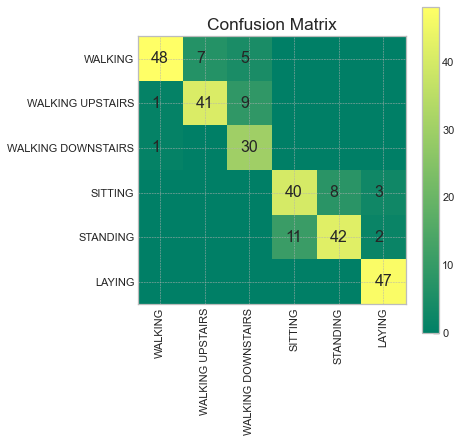

In [18]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(label, y_test[::10],
                            target_names=[l for l in labels.values()]))

conf_mat = confusion_matrix(label, y_test[::10])

fig = plt.figure(figsize=(6,6))
width = np.shape(conf_mat)[1]
height = np.shape(conf_mat)[0]

res = plt.imshow(np.array(conf_mat), cmap=plt.cm.summer, interpolation='nearest')
for i, row in enumerate(conf_mat):
    for j, c in enumerate(row):
        if c>0:
            plt.text(j-.2, i+.1, c, fontsize=16)
            
cb = fig.colorbar(res)
plt.title('Confusion Matrix')
_ = plt.xticks(range(6), [l for l in labels.values()], rotation=90)
_ = plt.yticks(range(6), [l for l in labels.values()])
